<a href="https://colab.research.google.com/github/RPAlbuquerque/Stoicism-Related-Tweets-Key-Findings-and-Insights/blob/main/Stoicism_in_Social_Media.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
##💻 Block 1 — High-Performance Filtering

In [ ]:
import os
import re
import pandas as pd
import warnings
from concurrent.futures import ProcessPoolExecutor
from tqdm import tqdm

# Suppress all pandas warnings
warnings.filterwarnings("ignore")

# Base directories
INPUT_DIR = "/n/holylabs/LABS/cga/Lab/data/geo-tweets/cga-sbg-tweets/"
OUTPUT_DIR = "/n/netscratch/cga/Lab/rpalbuquerque/Stoicism Tweets/"

# Fixed columns from the CGA Geotweet Archive v2.0
columns = [
    'message_id', 'date', 'text', 'tags', 'tweet_lang', 'source', 'place', 'geom',
    'retweets', 'tweet_favorites', 'photo_url', 'quoted_status_id', 'user_id', 'user_name',
    'user_location', 'followers', 'friends', 'user_favorites', 'status', 'user_lang',
    'latitude', 'longitude', 'data_source', 'GPS', 'spatialerror'
]

# Stoic-related search terms
stoic_terms = [
    "altrui*", "aristot*", "cosmop*", "epictet*", "epicur*", "eudaimon*", "hedon*", "philosoph*",
    "plato*", "pythago*", "socrat*", "stioc*", "stoic*", "amorfati", "aurelius", "chrysippus",
    "cicero", "cleanthes", "commongood", "dichotomyofcontrol", "diogenes", "hadot", "humandignity",
    "humanworth", "jordanpeterson", "mattis", "mementomori", "moralinjury", "moralaction",
    "moralprogress", "moralpurpose", "musoniusrufus", "nussbaum", "peripatetic", "pigliucci",
    "ryanholiday", "seneca", "stockdale", "timferriss", "zeno"
]

# Compile regex (non-capturing group to avoid warnings)
def compile_regex(keywords):
    patterns = []
    for term in keywords:
        if term.endswith("*"):
            patterns.append(rf"{re.escape(term[:-1])}\w*")
        else:
            patterns.append(re.escape(term))
    return re.compile(r"\b(?:{})\b".format("|".join(patterns)), re.IGNORECASE)

pattern = compile_regex(stoic_terms)

# Process a single hourly file
def process_hourly_file(file_path):
    try:
        df = pd.read_csv(
            file_path, sep="\t", names=columns, header=None,
            compression="gzip", quoting=3, on_bad_lines='skip', dtype=str, engine="python"
        )
        df = df[df["tweet_lang"] == "en"]
        df["text_clean"] = df["text"].str.lower().fillna("")
        filtered = df[df["text_clean"].str.contains(pattern, na=False)]
        if not filtered.empty:
            relative_path = os.path.relpath(file_path, INPUT_DIR)
            output_path = os.path.join(OUTPUT_DIR, relative_path)
            os.makedirs(os.path.dirname(output_path), exist_ok=True)
            filtered.drop(columns=["text_clean"]).to_csv(
                output_path, sep="\t", index=False, compression="gzip"
            )
            print(f"✅ Saved: {relative_path} ({len(filtered)} tweets)")
    except Exception:
        pass  # Silently skip corrupted files

# List all valid hourly files
def list_hourly_files(base_dir):
    all_files = []
    for root, _, files in os.walk(base_dir):
        for f in files:
            if re.fullmatch(r"\d{4}_\d{1,2}_\d{1,2}_\d{1,2}\.csv\.gz", f):
                all_files.append(os.path.join(root, f))
    return all_files

# Run parallel processing using all CPU cores
def run_parallel_filter():
    hourly_files = list_hourly_files(INPUT_DIR)
    print(f"📂 Total hourly files found: {len(hourly_files)}")
    with ProcessPoolExecutor(max_workers=64) as executor:
        list(tqdm(executor.map(process_hourly_file, hourly_files), total=len(hourly_files)))

# Execute
run_parallel_filter()

📂 Total hourly files found: 98584
✅ Saved: 2022/2022_2_02_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_01_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_03_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_06_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_20_11.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_01_10.csv.gz (29 tweets)
✅ Saved: 2022/2022_12_30_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_20_20.csv.gz (13 tweets)


  0%|          | 1/98584 [00:00<2:56:26,  9.31it/s]

✅ Saved: 2022/2022_7_11_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_12_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_13_11.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_08_16.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_22_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_02_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_24_09.csv.gz (7 tweets)


  0%|          | 81/98584 [00:01<26:14, 62.56it/s] 

✅ Saved: 2022/2022_11_13_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_08_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_11_05_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_16_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_03_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_15_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_19_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_04_13.csv.gz (15 tweets)


  0%|          | 86/98584 [00:02<57:59, 28.31it/s]

✅ Saved: 2022/2022_2_18_08.csv.gz (4 tweets)✅ Saved: 2022/2022_1_10_11.csv.gz (9 tweets)

✅ Saved: 2022/2022_3_20_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_17_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_24_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_04_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_10_16.csv.gz (60 tweets)


  0%|          | 96/98584 [00:03<1:08:18, 24.03it/s]

✅ Saved: 2022/2022_4_01_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_09_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_22_22.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_04_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_10_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_01_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_05_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_18_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_27_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_22_01.csv.gz (10 tweets)✅ Saved: 2022/2022_6_11_20.csv.gz (19 tweets)

✅ Saved: 2022/2022_6_19_00.csv.gz (17 tweets)✅ Saved: 2022/2022_3_16_17.csv.gz (18 tweets)

✅ Saved: 2022/2022_2_10_20.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_05_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_1_23_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_19_14.csv.gz (10 tweets)


  0%|          | 99/98584 [00:03<1:30:41, 18.10it/s]

✅ Saved: 2022/2022_3_03_23.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_25_02.csv.gz (15 tweets)✅ Saved: 2022/2022_6_15_13.csv.gz (14 tweets)

✅ Saved: 2022/2022_6_20_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_15_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_24_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_26_19.csv.gz (37 tweets)
✅ Saved: 2022/2022_5_18_11.csv.gz (19 tweets)


  0%|          | 103/98584 [00:04<1:41:52, 16.11it/s]

✅ Saved: 2022/2022_7_14_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_06_21.csv.gz (17 tweets)✅ Saved: 2022/2022_5_16_16.csv.gz (14 tweets)

✅ Saved: 2022/2022_9_19_07.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_25_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_20_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_13_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_31_10.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_20_16.csv.gz (13 tweets)✅ Saved: 2022/2022_4_27_13.csv.gz (12 tweets)

✅ Saved: 2022/2022_6_04_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_14_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_01_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_02_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_13_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_14_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_08_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_24_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_10_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_01_04.csv.gz (1 tweets)
✅ Saved: 2022/2022_2_10_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_26_14.csv.g

  0%|          | 105/98584 [00:05<3:11:59,  8.55it/s]

✅ Saved: 2022/2022_11_10_08.csv.gz (15 tweets)


  0%|          | 113/98584 [00:06<2:20:56, 11.64it/s]

✅ Saved: 2022/2022_6_29_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_23_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_13_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_20_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_09_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_27_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_27_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_12_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_19_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_15_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_09_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_01_23.csv.gz (19 tweets)


  0%|          | 118/98584 [00:07<3:07:37,  8.75it/s]

✅ Saved: 2022/2022_1_12_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_04_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_23_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_15_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_24_06.csv.gz (8 tweets)✅ Saved: 2022/2022_10_10_02.csv.gz (18 tweets)



  0%|          | 126/98584 [00:07<2:27:06, 11.15it/s]

✅ Saved: 2022/2022_7_10_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_25_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_21_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_23_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_24_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_14_20.csv.gz (18 tweets)✅ Saved: 2022/2022_9_17_22.csv.gz (27 tweets)

✅ Saved: 2022/2022_10_30_05.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_21_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_12_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_24_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_02_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_07_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_08_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_10_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_24_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_10_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_01_14.csv.gz (8 tweets)


  0%|          | 160/98584 [00:08<1:18:21, 20.94it/s]

✅ Saved: 2022/2022_4_20_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_09_00.csv.gz (14 tweets)✅ Saved: 2022/2022_3_29_19.csv.gz (15 tweets)

✅ Saved: 2022/2022_2_16_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_11_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_25_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_27_15.csv.gz (10 tweets)✅ Saved: 2022/2022_1_19_07.csv.gz (6 tweets)

✅ Saved: 2022/2022_7_26_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_17_15.csv.gz (23 tweets)


  0%|          | 178/98584 [00:08<1:03:49, 25.70it/s]

✅ Saved: 2022/2022_12_31_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_28_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_10_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_11_00.csv.gz (16 tweets)


  0%|          | 188/98584 [00:09<1:05:03, 25.21it/s]

✅ Saved: 2022/2022_11_17_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_03_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_16_08.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_10_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_20_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_04_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_10_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_11_22.csv.gz (73 tweets)
✅ Saved: 2022/2022_12_14_12.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_14_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_09_12.csv.gz (13 tweets)✅ Saved: 2022/2022_2_15_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_02_10.csv.gz (2 tweets)

✅ Saved: 2022/2022_6_10_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_10_10_14.csv.gz (23 tweets)
✅ Saved: 2022/2022_3_25_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_04_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_22_19.csv.gz (32 tweets)
✅ Saved: 2022/2022_1_25_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_28_13.csv.gz (32 tweets)
✅ Saved: 2022/2022_4_22_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_07_02.csv.g

  0%|          | 191/98584 [00:10<2:17:56, 11.89it/s]

✅ Saved: 2022/2022_1_16_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_24_14.csv.gz (39 tweets)
✅ Saved: 2022/2022_3_04_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_26_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_13_05.csv.gz (11 tweets)✅ Saved: 2022/2022_6_27_08.csv.gz (17 tweets)✅ Saved: 2022/2022_12_07_12.csv.gz (9 tweets)




  0%|          | 208/98584 [00:11<1:30:39, 18.08it/s]

✅ Saved: 2022/2022_3_26_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_23_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_05_21.csv.gz (14 tweets)✅ Saved: 2022/2022_4_27_06.csv.gz (6 tweets)✅ Saved: 2022/2022_7_27_22.csv.gz (1 tweets)


✅ Saved: 2022/2022_8_13_16.csv.gz (20 tweets)✅ Saved: 2022/2022_2_25_02.csv.gz (8 tweets)



  0%|          | 212/98584 [00:11<1:34:54, 17.27it/s]

✅ Saved: 2022/2022_6_26_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_17_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_16_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_07_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_30_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_09_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_10_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_05_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_17_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_08_10.csv.gz (13 tweets)✅ Saved: 2022/2022_11_07_00.csv.gz (20 tweets)



  0%|          | 228/98584 [00:12<1:27:51, 18.66it/s]

✅ Saved: 2022/2022_10_21_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_11_10.csv.gz (27 tweets)
✅ Saved: 2022/2022_8_17_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_21_19.csv.gz (24 tweets)✅ Saved: 2022/2022_2_12_08.csv.gz (8 tweets)

✅ Saved: 2022/2022_10_23_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_08_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_20_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_04_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_29_14.csv.gz (50 tweets)
✅ Saved: 2022/2022_8_19_15.csv.gz (27 tweets)
✅ Saved: 2022/2022_7_17_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_05_00.csv.gz (14 tweets)

  0%|          | 239/98584 [00:13<1:43:24, 15.85it/s]


✅ Saved: 2022/2022_1_25_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_02_00.csv.gz (12 tweets)✅ Saved: 2022/2022_2_01_14.csv.gz (18 tweets)

✅ Saved: 2022/2022_11_26_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_06_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_30_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_05_13.csv.gz (19 tweets)✅ Saved: 2022/2022_11_21_08.csv.gz (10 tweets)

✅ Saved: 2022/2022_1_15_03.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_10_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_31_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_13_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_16_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_12_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_03_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_27_05.csv.gz (6 tweets)✅ Saved: 2022/2022_4_23_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_21_11.csv.gz (9 tweets)

✅ Saved: 2022/2022_5_23_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_09_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_21_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_16_06.csv.gz (1

  0%|          | 242/98584 [00:15<3:27:23,  7.90it/s]

✅ Saved: 2022/2022_12_22_16.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_28_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_02_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_30_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_24_12.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_13_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_08_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_02_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_30_13.csv.gz (30 tweets)
✅ Saved: 2022/2022_10_26_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_05_09.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_31_00.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_16_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_16_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_01_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_05_06.csv.gz (9 tweets)

  0%|          | 282/98584 [00:16<1:42:25, 16.00it/s]

✅ Saved: 2022/2022_12_08_22.csv.gz (10 tweets)

✅ Saved: 2022/2022_1_24_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_14_13.csv.gz (14 tweets)✅ Saved: 2022/2022_2_03_20.csv.gz (25 tweets)

✅ Saved: 2022/2022_11_07_23.csv.gz (26 tweets)


  0%|          | 312/98584 [00:16<1:04:27, 25.41it/s]

✅ Saved: 2022/2022_6_02_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_11_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_24_17.csv.gz (19 tweets)✅ Saved: 2022/2022_1_02_15.csv.gz (15 tweets)

✅ Saved: 2022/2022_8_07_16.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_05_04.csv.gz (10 tweets)✅ Saved: 2022/2022_5_16_20.csv.gz (15 tweets)

✅ Saved: 2022/2022_9_05_07.csv.gz (67 tweets)
✅ Saved: 2022/2022_1_11_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_26_19.csv.gz (34 tweets)


  0%|          | 319/98584 [00:17<1:18:51, 20.77it/s]

✅ Saved: 2022/2022_4_09_13.csv.gz (16 tweets)✅ Saved: 2022/2022_1_10_01.csv.gz (5 tweets)

✅ Saved: 2022/2022_7_18_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_13_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_02_00.csv.gz (10 tweets)✅ Saved: 2022/2022_3_18_20.csv.gz (12 tweets)

✅ Saved: 2022/2022_9_27_19.csv.gz (36 tweets)


  0%|          | 333/98584 [00:17<1:09:18, 23.63it/s]

✅ Saved: 2022/2022_4_10_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_04_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_12_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_11_03.csv.gz (38 tweets)✅ Saved: 2022/2022_7_09_14.csv.gz (16 tweets)



  0%|          | 338/98584 [00:18<1:14:32, 21.96it/s]

✅ Saved: 2022/2022_2_21_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_10_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_02_05.csv.gz (31 tweets)
✅ Saved: 2022/2022_3_17_22.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_22_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_01_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_12_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_28_11.csv.gz (37 tweets)
✅ Saved: 2022/2022_12_16_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_17_10.csv.gz (34 tweets)✅ Saved: 2022/2022_4_29_19.csv.gz (18 tweets)

✅ Saved: 2022/2022_4_28_18.csv.gz (14 tweets)✅ Saved: 2022/2022_10_23_19.csv.gz (19 tweets)

✅ Saved: 2022/2022_4_27_10.csv.gz (7 tweets)

  0%|          | 348/98584 [00:18<1:27:20, 18.74it/s]


✅ Saved: 2022/2022_6_06_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_01_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_16_11.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_31_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_17_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_10_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_18_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_25_19.csv.gz (18 tweets)✅ Saved: 2022/2022_11_03_03.csv.gz (23 tweets)


  0%|          | 351/98584 [00:19<1:41:03, 16.20it/s]


✅ Saved: 2022/2022_4_19_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_16_00.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_25_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_08_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_22_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_11_23.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_09_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_13_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_04_02.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_30_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_12_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_24_00.csv.gz (33 tweets)✅ Saved: 2022/2022_2_25_22.csv.gz (10 tweets)

✅ Saved: 2022/2022_1_13_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_09_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_26_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_10_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_04_16.csv.gz (31 tweets)
✅ Saved: 2022/2022_6_12_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_6_09_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_10_06.csv.gz (2 tweets)✅ Saved: 2022/2022_4_26_11.csv.gz (1

  0%|          | 364/98584 [00:21<3:02:03,  8.99it/s]

✅ Saved: 2022/2022_7_28_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_18_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_18_20.csv.gz (16 tweets)✅ Saved: 2022/2022_3_28_10.csv.gz (14 tweets)

✅ Saved: 2022/2022_6_18_21.csv.gz (29 tweets)✅ Saved: 2022/2022_10_29_07.csv.gz (15 tweets)

✅ Saved: 2022/2022_8_27_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_23_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_15_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_7_30_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_23_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_23_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_18_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_22_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_26_13.csv.gz (16 tweets)✅ Saved: 2022/2022_5_15_10.csv.gz (9 tweets)

✅ Saved: 2022/2022_8_29_03.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_04_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_03_14.csv.gz (50 tweets)


  0%|          | 386/98584 [00:22<2:16:22, 12.00it/s]

✅ Saved: 2022/2022_11_26_23.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_12_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_30_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_19_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_31_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_30_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_21_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_11_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_10_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_04_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_29_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_20_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_25_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_25_14.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_31_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_21_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_06_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_13_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_28_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_27_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_05_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_29_17.csv.g

  0%|          | 416/98584 [00:25<2:22:38, 11.47it/s]

✅ Saved: 2022/2022_6_07_02.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_16_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_25_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_28_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_30_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_31_16.csv.gz (25 tweets)


  0%|          | 465/98584 [00:26<1:13:58, 22.11it/s]

✅ Saved: 2022/2022_12_30_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_04_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_14_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_04_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_07_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_8_15_05.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_09_23.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_26_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_01_00.csv.gz (60 tweets)


  0%|          | 470/98584 [00:26<1:20:14, 20.38it/s]

✅ Saved: 2022/2022_6_08_08.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_17_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_14_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_28_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_09_03.csv.gz (13 tweets)


  0%|          | 484/98584 [00:26<1:06:08, 24.72it/s]

✅ Saved: 2022/2022_7_27_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_23_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_12_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_09_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_31_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_19_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_17_18.csv.gz (30 tweets)
✅ Saved: 2022/2022_5_11_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_31_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_10_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_13_17.csv.gz (31 tweets)
✅ Saved: 2022/2022_8_19_04.csv.gz (140 tweets)
✅ Saved: 2022/2022_10_03_18.csv.gz (40 tweets)
✅ Saved: 2022/2022_6_30_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_03_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_02_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_13_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_27_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_17_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_08_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_01_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_04_22.csv.gz (108

  0%|          | 490/98584 [00:28<1:48:58, 15.00it/s]

✅ Saved: 2022/2022_10_16_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_03_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_10_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_27_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_26_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_05_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_26_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_01_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_17_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_27_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_8_28_10.csv.gz (12 tweets)✅ Saved: 2022/2022_8_21_14.csv.gz (38 tweets)

✅ Saved: 2022/2022_7_18_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_16_19.csv.gz (29 tweets)
✅ Saved: 2022/2022_9_29_09.csv.gz (29 tweets)
✅ Saved: 2022/2022_4_30_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_11_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_28_21.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_30_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_08_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_14_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_21_05.csv.g

  1%|          | 497/98584 [00:29<2:30:30, 10.86it/s]

✅ Saved: 2022/2022_12_29_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_24_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_15_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_08_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_29_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_25_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_23_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_27_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_22_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_30_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_11_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_20_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_03_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_12_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_08_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_12_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_29_20.csv.gz (80 tweets)


  1%|          | 554/98584 [00:31<1:17:28, 21.09it/s]

✅ Saved: 2022/2022_1_04_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_01_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_18_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_15_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_11_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_04_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_06_01.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_30_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_15_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_10_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_12_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_03_06.csv.gz (10 tweets)✅ Saved: 2022/2022_4_10_08.csv.gz (5 tweets)

✅ Saved: 2022/2022_8_24_21.csv.gz (40 tweets)
✅ Saved: 2022/2022_5_27_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_06_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_17_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_27_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_22_08.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_09_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_22_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_08_06.csv.gz (7 tweet

  1%|          | 561/98584 [00:33<2:00:04, 13.61it/s]

✅ Saved: 2022/2022_12_12_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_22_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_22_16.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_24_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_14_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_21_16.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_23_23.csv.gz (14 tweets)✅ Saved: 2022/2022_2_08_07.csv.gz (9 tweets)

✅ Saved: 2022/2022_10_20_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_21_07.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_15_20.csv.gz (19 tweets)


  1%|          | 590/98584 [00:33<1:24:48, 19.26it/s]

✅ Saved: 2022/2022_10_24_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_14_23.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_18_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_11_00.csv.gz (34 tweets)
✅ Saved: 2022/2022_3_15_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_09_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_17_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_09_13.csv.gz (19 tweets)


  1%|          | 604/98584 [00:34<1:23:55, 19.46it/s]

✅ Saved: 2022/2022_6_19_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_23_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_26_23.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_02_17.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_11_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_19_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_16_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_05_22.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_15_02.csv.gz (28 tweets)
✅ Saved: 2022/2022_9_18_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_26_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_04_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_17_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_24_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_18_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_30_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_20_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_19_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_24_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_04_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_15_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_11_07.csv.gz (8 t

  1%|          | 618/98584 [00:36<1:58:30, 13.78it/s]

✅ Saved: 2022/2022_12_23_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_30_13.csv.gz (44 tweets)
✅ Saved: 2022/2022_12_10_17.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_06_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_13_01.csv.gz (42 tweets)
✅ Saved: 2022/2022_10_19_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_20_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_22_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_17_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_31_17.csv.gz (65 tweets)
✅ Saved: 2022/2022_7_21_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_25_09.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_26_00.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_15_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_16.csv.gz (24 tweets)


  1%|          | 639/98584 [00:37<1:50:33, 14.76it/s]

✅ Saved: 2022/2022_7_29_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_07_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_23_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_19_05.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_08_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_04_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_17_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_25_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_15_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_01_02.csv.gz (36 tweets)
✅ Saved: 2022/2022_2_17_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_17_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_16_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_04_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_06_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_24_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_23_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_07_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_08_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_14_23.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_14_12.csv.gz (14 tweets)✅ Saved: 2022/2022_11_02_06.csv.gz (9 t

  1%|          | 670/98584 [00:39<1:45:12, 15.51it/s]

✅ Saved: 2022/2022_7_16_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_09_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_06_19.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_10_02.csv.gz (28 tweets)

  1%|          | 696/98584 [00:39<1:16:13, 21.40it/s]


✅ Saved: 2022/2022_4_27_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_15_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_23_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_05_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_05_01.csv.gz (31 tweets)
✅ Saved: 2022/2022_6_12_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_25_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_02_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_24_17.csv.gz (29 tweets)
✅ Saved: 2022/2022_6_30_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_07_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_15_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_03_13.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_31_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_26_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_11_14.csv.gz (38 tweets)
✅ Saved: 2022/2022_7_19_14.csv.gz (37 tweets)
✅ Saved: 2022/2022_6_15_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_29_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_03_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_29_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_8_15_12.csv.gz 

  1%|          | 701/98584 [00:41<1:51:01, 14.69it/s]

✅ Saved: 2022/2022_8_12_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_17_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_20_12.csv.gz (22 tweets)

  1%|          | 727/98584 [00:41<1:14:09, 21.99it/s]


✅ Saved: 2022/2022_5_20_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_02_07.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_05_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_17_10.csv.gz (9 tweets)✅ Saved: 2022/2022_5_24_03.csv.gz (13 tweets)

✅ Saved: 2022/2022_1_18_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_27_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_05_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_25_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_07_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_17_02.csv.gz (31 tweets)
✅ Saved: 2022/2022_8_23_02.csv.gz (42 tweets)
✅ Saved: 2022/2022_9_08_07.csv.gz (41 tweets)
✅ Saved: 2022/2022_3_11_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_02_02.csv.gz (22 tweets)


  1%|          | 749/98584 [00:42<1:17:05, 21.15it/s]

✅ Saved: 2022/2022_5_15_06.csv.gz (17 tweets)✅ Saved: 2022/2022_7_13_12.csv.gz (11 tweets)

✅ Saved: 2022/2022_1_10_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_04_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_24_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_24_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_28_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_28_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_03_08.csv.gz (29 tweets)✅ Saved: 2022/2022_4_08_04.csv.gz (6 tweets)

✅ Saved: 2022/2022_7_30_03.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_31_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_25_16.csv.gz (18 tweets)


  1%|          | 754/98584 [00:43<1:26:31, 18.84it/s]

✅ Saved: 2022/2022_4_22_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_23_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_03_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_10_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_21_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_13_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_13_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_14_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_01_20.csv.gz (8 tweets)


  1%|          | 762/98584 [00:44<1:39:57, 16.31it/s]

✅ Saved: 2022/2022_7_30_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_10_19.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_22_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_02_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_07_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_21_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_21_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_05_08.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_14_20.csv.gz (26 tweets)
✅ Saved: 2022/2022_3_05_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_14_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_02_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_28_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_10_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_14_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_26_22.csv.gz (41 tweets)
✅ Saved: 2022/2022_5_26_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_07_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_19_23.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_09_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_29_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_27_07.csv

  1%|          | 765/98584 [00:45<2:53:15,  9.41it/s]

✅ Saved: 2022/2022_2_07_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_18_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_15_15.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_09_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_31_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_31_23.csv.gz (39 tweets)✅ Saved: 2022/2022_7_28_14.csv.gz (24 tweets)



  1%|          | 804/98584 [00:46<1:17:51, 20.93it/s]

✅ Saved: 2022/2022_4_17_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_16_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_27_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_09_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_25_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_25_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_21_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_16_13.csv.gz (13 tweets)


  1%|          | 821/98584 [00:46<1:08:52, 23.66it/s]

✅ Saved: 2022/2022_1_02_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_23_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_09_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_21_18.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_03_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_6_22_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_20_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_02_15.csv.gz (31 tweets)
✅ Saved: 2022/2022_6_24_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_25_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_17_23.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_25_10.csv.gz (10 tweets)

  1%|          | 836/98584 [00:47<1:06:56, 24.34it/s]


✅ Saved: 2022/2022_6_04_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_15_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_15_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_24_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_21_15.csv.gz (24 tweets)✅ Saved: 2022/2022_7_05_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_31_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_11_20.csv.gz (12 tweets)

✅ Saved: 2022/2022_12_10_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_15_02.csv.gz (6 tweets)✅ Saved: 2022/2022_7_01_00.csv.gz (12 tweets)

✅ Saved: 2022/2022_5_07_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_05_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_09_22.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_27_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_30_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_11_19.csv.gz (36 tweets)
✅ Saved: 2022/2022_3_29_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_16_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_09_19.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_03_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_25_00.csv.gz (8 t

  1%|          | 852/98584 [00:48<1:38:46, 16.49it/s]

✅ Saved: 2022/2022_5_03_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_23_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_20_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_15_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_25_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_08_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_22_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_28_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_28_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_29_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_18_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_28_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_20_18.csv.gz (30 tweets)
✅ Saved: 2022/2022_5_04_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_17_19.csv.gz (33 tweets)
✅ Saved: 2022/2022_4_22_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_17_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_17_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_30_21.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_26_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_15_23.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_20_16.csv.gz (26

  1%|          | 866/98584 [00:50<2:12:21, 12.31it/s]

✅ Saved: 2022/2022_6_18_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_01_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_27_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_27_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_10_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_14_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_11_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_20_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_24_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_14_13.csv.gz (11 tweets)


  1%|          | 892/98584 [00:51<1:32:54, 17.52it/s]

✅ Saved: 2022/2022_9_09_06.csv.gz (12 tweets)✅ Saved: 2022/2022_1_11_02.csv.gz (4 tweets)

✅ Saved: 2022/2022_5_21_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_22_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_14_15.csv.gz (14 tweets)✅ Saved: 2022/2022_2_27_22.csv.gz (18 tweets)

✅ Saved: 2022/2022_2_09_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_08_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_08_18.csv.gz (21 tweets)


  1%|          | 907/98584 [00:51<1:21:40, 19.93it/s]

✅ Saved: 2022/2022_7_22_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_2_23_03.csv.gz (10 tweets)✅ Saved: 2022/2022_1_27_07.csv.gz (8 tweets)

✅ Saved: 2022/2022_5_09_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_06_07.csv.gz (20 tweets)✅ Saved: 2022/2022_4_04_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_20_19.csv.gz (15 tweets)

✅ Saved: 2022/2022_3_31_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_03_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_11_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_25_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_06_00.csv.gz (44 tweets)
✅ Saved: 2022/2022_2_21_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_12_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_02_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_03_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_13_20.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_18_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_21_06.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_25_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_30_08.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_14_11.csv.gz (1

  1%|          | 911/98584 [00:53<2:15:28, 12.02it/s]

✅ Saved: 2022/2022_1_17_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_23_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_13_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_29_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_22_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_05_11.csv.gz (16 tweets)✅ Saved: 2022/2022_2_14_14.csv.gz (9 tweets)

✅ Saved: 2022/2022_1_29_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_23_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_06_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_15_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_23_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_21_13.csv.gz (23 tweets)
✅ Saved: 2022/2022_3_23_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_16_09.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_20_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_22_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_10_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_10_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_19_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_09_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_28_16.csv.gz (2

  1%|          | 944/98584 [00:55<1:48:50, 14.95it/s]

✅ Saved: 2022/2022_10_02_13.csv.gz (31 tweets)


  1%|          | 956/98584 [00:55<1:29:29, 18.18it/s]

✅ Saved: 2022/2022_9_13_20.csv.gz (43 tweets)
✅ Saved: 2022/2022_11_18_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_31_06.csv.gz (33 tweets)
✅ Saved: 2022/2022_10_13_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_29_19.csv.gz (80 tweets)


  1%|          | 977/98584 [00:56<1:12:48, 22.34it/s]

✅ Saved: 2022/2022_11_03_23.csv.gz (12 tweets)✅ Saved: 2022/2022_4_18_09.csv.gz (6 tweets)

✅ Saved: 2022/2022_6_09_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_22_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_03_22.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_30_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_03_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_18_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_29_11.csv.gz (28 tweets)
✅ Saved: 2022/2022_12_03_19.csv.gz (14 tweets)


  1%|          | 982/98584 [00:56<1:15:29, 21.55it/s]

✅ Saved: 2022/2022_4_05_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_01_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_09_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_15_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_08_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_16_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_23_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_06_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_23_11.csv.gz (9 tweets)✅ Saved: 2022/2022_5_13_08.csv.gz (6 tweets)

✅ Saved: 2022/2022_4_19_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_30_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_01_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_20_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_12_01_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_31_02.csv.gz (32 tweets)
✅ Saved: 2022/2022_7_20_08.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_23_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_26_20.csv.gz (44 tweets)
✅ Saved: 2022/2022_11_02_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_09_19.csv.gz (15 tweets)


  1%|          | 987/98584 [00:57<1:58:10, 13.76it/s]

✅ Saved: 2022/2022_6_07_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_19_15.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_14_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_02_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_23_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_04_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_12_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_20_01.csv.gz (12 tweets)✅ Saved: 2022/2022_11_25_19.csv.gz (12 tweets)

✅ Saved: 2022/2022_5_20_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_28_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_07_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_15_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_27_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_13_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_21_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_26_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_11_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_20_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_18_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_06_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_21_06.csv.gz 

  1%|          | 997/98584 [00:59<2:56:34,  9.21it/s]

✅ Saved: 2022/2022_4_12_09.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_21_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_19_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_19_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_05_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_28_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_26_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_03_00.csv.gz (15 tweets)✅ Saved: 2022/2022_4_25_11.csv.gz (10 tweets)

✅ Saved: 2022/2022_3_31_18.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_05_13.csv.gz (29 tweets)
✅ Saved: 2022/2022_1_14_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_13_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_08_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_05_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_10_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_04_23.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_24_12.csv.gz (17 tweets)✅ Saved: 2022/2022_7_11_00.csv.gz (8 tweets)

✅ Saved: 2022/2022_7_27_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_12_18.csv.gz (13 tweets)✅ Saved: 2022/2022_5_29_13.csv.gz (17 twee

  1%|          | 1039/98584 [01:03<2:40:50, 10.11it/s]

✅ Saved: 2022/2022_3_19_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_08_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_29_17.csv.gz (20 tweets)


  1%|          | 1085/98584 [01:03<1:26:41, 18.75it/s]

✅ Saved: 2022/2022_2_12_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_21_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_04_13.csv.gz (24 tweets)


  1%|          | 1101/98584 [01:03<1:12:53, 22.29it/s]

✅ Saved: 2022/2022_5_20_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_25_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_01_04.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_23_06.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_13_06.csv.gz (13 tweets)✅ Saved: 2022/2022_12_29_19.csv.gz (15 tweets)

✅ Saved: 2022/2022_10_13_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_30_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_23_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_12_07.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_22_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_20_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_23_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_09_09.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_11_15.csv.gz (43 tweets)✅ Saved: 2022/2022_1_04_06.csv.gz (5 tweets)

✅ Saved: 2022/2022_10_05_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_30_10.csv.gz (40 tweets)
✅ Saved: 2022/2022_5_31_15.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_18_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_02_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_13_01.csv

  1%|          | 1109/98584 [01:05<1:36:54, 16.76it/s]

✅ Saved: 2022/2022_6_01_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_11_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_30_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_14_08.csv.gz (42 tweets)
✅ Saved: 2022/2022_3_03_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_16_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_01_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_7_11_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_09_15.csv.gz (67 tweets)✅ Saved: 2022/2022_7_10_02.csv.gz (11 tweets)

✅ Saved: 2022/2022_11_05_15.csv.gz (23 tweets)


  1%|          | 1123/98584 [01:05<1:22:56, 19.58it/s]

✅ Saved: 2022/2022_8_11_14.csv.gz (28 tweets)
✅ Saved: 2022/2022_12_28_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_25_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_25_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_26_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_30_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_15_20.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_09_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_15_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_12_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_10_06.csv.gz (6 tweets)✅ Saved: 2022/2022_4_14_07.csv.gz (7 tweets)

✅ Saved: 2022/2022_8_24_14.csv.gz (26 tweets)
✅ Saved: 2022/2022_3_31_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_27_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_20_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_28_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_28_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_23_18.csv.gz (26 tweets)
✅ Saved: 2022/2022_3_19_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_22_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_06_19.csv.gz (10 twe

  1%|          | 1149/98584 [01:07<1:27:19, 18.60it/s]

✅ Saved: 2022/2022_2_09_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_13_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_26_01.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_30_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_28_20.csv.gz (26 tweets)


  1%|          | 1157/98584 [01:07<1:22:23, 19.71it/s]

✅ Saved: 2022/2022_1_28_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_07_06.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_23_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_21_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_03_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_29_05.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_28_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_17_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_14_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_22_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_14_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_25_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_14_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_25_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_20_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_29_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_15_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_27_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_25_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_30_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_14_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_15_13.csv.gz (10 

  1%|          | 1171/98584 [01:11<2:58:39,  9.09it/s]

✅ Saved: 2022/2022_10_20_14.csv.gz (29 tweets)
✅ Saved: 2022/2022_9_06_14.csv.gz (33 tweets)
✅ Saved: 2022/2022_6_14_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_12_10.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_25_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_10_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_17_15.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_25_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_19_18.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_17_09.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_05_18.csv.gz (93 tweets)
✅ Saved: 2022/2022_11_19_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_02_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_28_01.csv.gz (10 tweets)


  1%|          | 1191/98584 [01:12<2:20:43, 11.54it/s]

✅ Saved: 2022/2022_10_06_01.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_22_15.csv.gz (31 tweets)
✅ Saved: 2022/2022_3_03_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_12_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_13_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_19_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_26_16.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_13_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_20_14.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_09_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_29_12.csv.gz (31 tweets)
✅ Saved: 2022/2022_10_24_15.csv.gz (24 tweets)✅ Saved: 2022/2022_6_14_00.csv.gz (9 tweets)

✅ Saved: 2022/2022_11_15_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_28_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_08_15.csv.gz (7 tweets)✅ Saved: 2022/2022_10_03_15.csv.gz (40 tweets)

✅ Saved: 2022/2022_11_18_04.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_02_20.csv.gz (44 tweets)
✅ Saved: 2022/2022_7_19_15.csv.gz (41 tweets)✅ Saved: 2022/2022_10_26_07.csv.gz (8 tweets)

✅ Saved: 2022/2022_3_19_16.csv.gz (

  1%|          | 1217/98584 [01:13<2:10:48, 12.41it/s]

✅ Saved: 2022/2022_5_21_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_17_17.csv.gz (13 tweets)


  1%|▏         | 1276/98584 [01:14<59:31, 27.24it/s]  

✅ Saved: 2022/2022_3_16_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_22_01.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_14_06.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_28_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_21_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_18_15.csv.gz (17 tweets)✅ Saved: 2022/2022_9_13_13.csv.gz (18 tweets)

✅ Saved: 2022/2022_2_13_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_26_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_07_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_04_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_08_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_24_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_27_19.csv.gz (29 tweets)✅ Saved: 2022/2022_12_21_03.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_21_13.csv.gz (15 tweets)

✅ Saved: 2022/2022_5_01_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_31_18.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_10_01.csv.gz (13 tweets)


  1%|▏         | 1291/98584 [01:15<1:10:41, 22.94it/s]

✅ Saved: 2022/2022_3_17_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_08_02.csv.gz (21 tweets)


  1%|▏         | 1302/98584 [01:15<1:03:25, 25.56it/s]

✅ Saved: 2022/2022_4_22_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_02_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_06_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_07_15.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_14_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_18_16.csv.gz (36 tweets)
✅ Saved: 2022/2022_6_10_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_07_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_13_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_11_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_13_02.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_21_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_09_11.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_22_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_26_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_20_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_26_18.csv.gz (30 tweets)
✅ Saved: 2022/2022_4_11_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_05_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_09_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_26_15.csv.gz (51 tweets)
✅ Saved: 2022/2022_11_06_04.csv.gz (13 twe

  1%|▏         | 1312/98584 [01:16<1:33:45, 17.29it/s]

✅ Saved: 2022/2022_5_20_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_14_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_31_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_05_21.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_07_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_10_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_05_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_21_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_25_12.csv.gz (14 tweets)

  1%|▏         | 1324/98584 [01:17<1:25:18, 19.00it/s]


✅ Saved: 2022/2022_10_18_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_07_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_08_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_05_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_06_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_28_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_01_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_25_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_24_06.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_30_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_18_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_02_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_25_23.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_10_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_23_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_12_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_08_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_19_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_09_12.csv.gz (14 tweets)


  1%|▏         | 1333/98584 [01:18<1:44:48, 15.46it/s]

✅ Saved: 2022/2022_7_08_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_28_02.csv.gz (14 tweets)✅ Saved: 2022/2022_6_26_04.csv.gz (5 tweets)

✅ Saved: 2022/2022_1_09_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_30_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_29_11.csv.gz (61 tweets)


  1%|▏         | 1340/98584 [01:18<1:35:18, 17.00it/s]

✅ Saved: 2022/2022_7_27_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_18_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_06_15.csv.gz (45 tweets)✅ Saved: 2022/2022_3_24_23.csv.gz (2 tweets)

✅ Saved: 2022/2022_10_29_14.csv.gz (18 tweets)

  1%|▏         | 1345/98584 [01:18<1:29:51, 18.03it/s]


✅ Saved: 2022/2022_6_26_11.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_07_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_06_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_23_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_20_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_07_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_13_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_01_22.csv.gz (15 tweets)


  1%|▏         | 1364/98584 [01:19<1:24:08, 19.26it/s]

✅ Saved: 2022/2022_10_16_22.csv.gz (29 tweets)
✅ Saved: 2022/2022_6_26_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_14_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_11_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_26_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_21_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_10_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_31_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_21_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_30_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_12_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_14_14.csv.gz (6 tweets)✅ Saved: 2022/2022_5_09_19.csv.gz (23 tweets)

✅ Saved: 2022/2022_5_07_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_22_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_05_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_16_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_25_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_21_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_12_20.csv.gz (20 tweets)✅ Saved: 2022/2022_6_07_16.csv.gz (20 tweets)

✅ Saved: 2022/2022_2_17_08.csv.gz (6 tw

  1%|▏         | 1368/98584 [01:21<2:20:36, 11.52it/s]

✅ Saved: 2022/2022_10_10_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_05_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_21_18.csv.gz (15 tweets)✅ Saved: 2022/2022_7_25_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_16_08.csv.gz (15 tweets)

✅ Saved: 2022/2022_5_08_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_14_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_03_20.csv.gz (10 tweets)✅ Saved: 2022/2022_5_22_15.csv.gz (16 tweets)

✅ Saved: 2022/2022_10_13_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_31_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_03_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_06_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_24_18.csv.gz (42 tweets)
✅ Saved: 2022/2022_10_31_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_19_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_03_15.csv.gz (46 tweets)


  1%|▏         | 1373/98584 [01:22<3:02:32,  8.88it/s]

✅ Saved: 2022/2022_3_12_01.csv.gz (8 tweets)✅ Saved: 2022/2022_8_13_13.csv.gz (43 tweets)

✅ Saved: 2022/2022_6_30_08.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_11_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_09_02.csv.gz (40 tweets)


  1%|▏         | 1399/98584 [01:22<1:31:24, 17.72it/s]

✅ Saved: 2022/2022_1_12_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_31_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_10_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_10_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_06_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_25_19.csv.gz (28 tweets)
✅ Saved: 2022/2022_1_25_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_23_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_22_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_16_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_10_19.csv.gz (36 tweets)
✅ Saved: 2022/2022_4_25_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_16_14.csv.gz (29 tweets)


  1%|▏         | 1425/98584 [01:23<1:19:55, 20.26it/s]

✅ Saved: 2022/2022_9_20_18.csv.gz (38 tweets)
✅ Saved: 2022/2022_4_24_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_4_20_06.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_24_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_06_14.csv.gz (56 tweets)
✅ Saved: 2022/2022_9_22_21.csv.gz (30 tweets)
✅ Saved: 2022/2022_7_25_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_20_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_24_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_05_02.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_15_22.csv.gz (33 tweets)✅ Saved: 2022/2022_9_09_09.csv.gz (34 tweets)



  1%|▏         | 1431/98584 [01:24<1:31:33, 17.69it/s]

✅ Saved: 2022/2022_10_04_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_06_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_14_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_22_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_14_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_12_15.csv.gz (27 tweets)
✅ Saved: 2022/2022_3_23_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_09_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_10_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_26_11.csv.gz (32 tweets)
✅ Saved: 2022/2022_1_26_13.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_30_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_03_02.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_22_00.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_04_13.csv.gz (42 tweets)
✅ Saved: 2022/2022_4_05_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_05_04.csv.gz (1 tweets)
✅ Saved: 2022/2022_7_07_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_21_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_18_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_15_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_07_14.csv.gz (13

  1%|▏         | 1441/98584 [01:25<2:13:03, 12.17it/s]


✅ Saved: 2022/2022_10_29_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_24_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_18_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_29_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_02_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_31_00.csv.gz (23 tweets)
✅ Saved: 2022/2022_6_08_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_18_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_05_10.csv.gz (15 tweets)✅ Saved: 2022/2022_5_23_21.csv.gz (13 tweets)

✅ Saved: 2022/2022_3_27_03.csv.gz (10 tweets)


  1%|▏         | 1461/98584 [01:26<1:37:56, 16.53it/s]

✅ Saved: 2022/2022_10_22_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_26_01.csv.gz (9 tweets)✅ Saved: 2022/2022_7_05_22.csv.gz (1 tweets)

✅ Saved: 2022/2022_1_24_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_11_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_18_15.csv.gz (16 tweets)✅ Saved: 2022/2022_2_01_22.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_28_21.csv.gz (27 tweets)
✅ Saved: 2022/2022_9_15_19.csv.gz (42 tweets)


  2%|▏         | 1482/98584 [01:27<1:26:47, 18.65it/s]

✅ Saved: 2022/2022_1_17_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_18_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_12_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_01_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_29_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_28_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_21_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_11_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_01_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_12_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_09_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_19_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_18_17.csv.gz (17 tweets)✅ Saved: 2022/2022_11_06_02.csv.gz (16 tweets)


  2%|▏         | 1502/98584 [01:28<1:18:09, 20.70it/s]


✅ Saved: 2022/2022_10_04_19.csv.gz (43 tweets)


  2%|▏         | 1521/98584 [01:28<57:07, 28.32it/s]  

✅ Saved: 2022/2022_8_16_11.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_08_15.csv.gz (5 tweets)✅ Saved: 2022/2022_10_06_10.csv.gz (24 tweets)

✅ Saved: 2022/2022_1_09_19.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_11_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_16_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_10_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_09_15.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_21_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_22_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_03_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_11_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_20_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_28_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_10_18.csv.gz (34 tweets)
✅ Saved: 2022/2022_1_09_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_27_04.csv.gz (10 tweets)✅ Saved: 2022/2022_3_15_11.csv.gz (11 tweets)

✅ Saved: 2022/2022_5_18_13.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_07_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_29_02.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_03_13.csv.gz 

  2%|▏         | 1528/98584 [01:32<2:56:37,  9.16it/s]

✅ Saved: 2022/2022_7_07_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_06_17.csv.gz (28 tweets)
✅ Saved: 2022/2022_1_31_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_22_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_17_11.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_11_03.csv.gz (24 tweets)


  2%|▏         | 1579/98584 [01:32<1:18:11, 20.68it/s]

✅ Saved: 2022/2022_10_31_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_26_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_6_05_09.csv.gz (5 tweets)✅ Saved: 2022/2022_1_24_04.csv.gz (6 tweets)

✅ Saved: 2022/2022_12_13_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_03_06.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_23_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_28_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_23_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_29_23.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_20_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_13_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_15_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_20_00.csv.gz (29 tweets)
✅ Saved: 2022/2022_9_28_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_6_06_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_08_11.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_13_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_04_04.csv.gz (32 tweets)
✅ Saved: 2022/2022_3_16_02.csv.gz (8 tweets)✅ Saved: 2022/2022_7_08_05.csv.gz (11 tweets)

✅ Saved: 2022/2022_10_20_15.csv.gz 

  2%|▏         | 1591/98584 [01:33<1:36:50, 16.69it/s]

✅ Saved: 2022/2022_4_01_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_30_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_15_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_06_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_02_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_23_05.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_06_16.csv.gz (16 tweets)


  2%|▏         | 1608/98584 [01:34<1:25:54, 18.81it/s]

✅ Saved: 2022/2022_7_01_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_25_19.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_09_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_22_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_17_14.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_19_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_22_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_28_17.csv.gz (14 tweets)✅ Saved: 2022/2022_9_21_07.csv.gz (4 tweets)

✅ Saved: 2022/2022_12_16_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_19_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_20_01.csv.gz (21 tweets)


  2%|▏         | 1627/98584 [01:35<1:14:46, 21.61it/s]

✅ Saved: 2022/2022_1_19_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_29_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_14_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_19_16.csv.gz (20 tweets)✅ Saved: 2022/2022_5_09_18.csv.gz (17 tweets)



  2%|▏         | 1632/98584 [01:35<1:20:38, 20.04it/s]

✅ Saved: 2022/2022_8_19_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_07_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_14_15.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_20_20.csv.gz (35 tweets)
✅ Saved: 2022/2022_8_12_10.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_17_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_01_08.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_26_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_24_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_09_09.csv.gz (11 tweets)✅ Saved: 2022/2022_4_30_17.csv.gz (14 tweets)

✅ Saved: 2022/2022_5_28_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_06_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_25_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_20_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_09_10.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_20_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_2_06_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_19_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_20_15.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_13_03.csv.gz (58 tweets)
✅ Saved: 2022/2022_1_25_21.csv.gz (1

  2%|▏         | 1642/98584 [01:37<2:21:19, 11.43it/s]

✅ Saved: 2022/2022_12_13_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_17_05.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_25_04.csv.gz (21 tweets)✅ Saved: 2022/2022_7_24_21.csv.gz (16 tweets)

✅ Saved: 2022/2022_3_05_07.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_16_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_07_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_13_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_22_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_05_16.csv.gz (42 tweets)
✅ Saved: 2022/2022_9_27_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_06_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_26_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_05_21.csv.gz (76 tweets)


  2%|▏         | 1662/98584 [01:38<1:59:17, 13.54it/s]

✅ Saved: 2022/2022_1_03_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_29_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_13_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_01_10.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_26_13.csv.gz (54 tweets)
✅ Saved: 2022/2022_8_25_11.csv.gz (45 tweets)
✅ Saved: 2022/2022_9_05_00.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_30_03.csv.gz (13 tweets)


  2%|▏         | 1690/98584 [01:39<1:30:37, 17.82it/s]

✅ Saved: 2022/2022_6_11_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_17_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_23_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_26_12.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_19_15.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_01_12.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_23_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_30_13.csv.gz (30 tweets)
✅ Saved: 2022/2022_8_17_18.csv.gz (21 tweets)


  2%|▏         | 1705/98584 [01:40<1:20:16, 20.11it/s]

✅ Saved: 2022/2022_7_03_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_27_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_19_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_16_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_26_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_26_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_06_10.csv.gz (88 tweets)
✅ Saved: 2022/2022_8_27_07.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_27_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_03_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_15_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_15_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_17_14.csv.gz (24 tweets)

  2%|▏         | 1708/98584 [01:40<1:34:32, 17.08it/s]


✅ Saved: 2022/2022_4_23_16.csv.gz (27 tweets)
✅ Saved: 2022/2022_7_27_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_18_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_18_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_31_03.csv.gz (32 tweets)


  2%|▏         | 1728/98584 [01:41<1:11:30, 22.57it/s]

✅ Saved: 2022/2022_5_08_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_12_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_15_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_18_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_18_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_04_05.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_06_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_04_02.csv.gz (11 tweets)


  2%|▏         | 1732/98584 [01:41<1:32:45, 17.40it/s]

✅ Saved: 2022/2022_3_30_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_13_07.csv.gz (25 tweets)
✅ Saved: 2022/2022_4_12_14.csv.gz (42 tweets)
✅ Saved: 2022/2022_12_20_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_15_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_14_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_26_04.csv.gz (6 tweets)✅ Saved: 2022/2022_11_23_16.csv.gz (26 tweets)

✅ Saved: 2022/2022_5_26_06.csv.gz (6 tweets)


  2%|▏         | 1735/98584 [01:42<1:38:08, 16.45it/s]

✅ Saved: 2022/2022_1_21_10.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_11_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_17_06.csv.gz (7 tweets)✅ Saved: 2022/2022_10_21_01.csv.gz (14 tweets)

✅ Saved: 2022/2022_8_19_17.csv.gz (20 tweets)


  2%|▏         | 1739/98584 [01:42<1:32:43, 17.41it/s]

✅ Saved: 2022/2022_3_18_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_30_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_20_17.csv.gz (31 tweets)


  2%|▏         | 1754/98584 [01:42<1:00:58, 26.46it/s]

✅ Saved: 2022/2022_11_03_10.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_26_18.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_10_18.csv.gz (36 tweets)


  2%|▏         | 1758/98584 [01:42<1:08:35, 23.53it/s]

✅ Saved: 2022/2022_1_21_00.csv.gz (10 tweets)✅ Saved: 2022/2022_10_13_17.csv.gz (58 tweets)

✅ Saved: 2022/2022_11_14_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_11_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_25_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_22_03.csv.gz (11 tweets)✅ Saved: 2022/2022_9_08_03.csv.gz (20 tweets)

✅ Saved: 2022/2022_7_10_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_23_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_03_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_03_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_03_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_19_00.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_09_17.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_16_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_16_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_14_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_09_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_26_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_21_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_10_18.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_27_09.csv.gz (

  2%|▏         | 1767/98584 [01:44<2:36:15, 10.33it/s]

✅ Saved: 2022/2022_7_25_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_25_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_1_29_07.csv.gz (3 tweets)✅ Saved: 2022/2022_8_25_19.csv.gz (58 tweets)

✅ Saved: 2022/2022_2_15_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_10_07.csv.gz (11 tweets)✅ Saved: 2022/2022_8_30_17.csv.gz (56 tweets)

✅ Saved: 2022/2022_11_13_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_05_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_13_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_03_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_08_01.csv.gz (36 tweets)


  2%|▏         | 1777/98584 [01:45<2:11:52, 12.23it/s]

✅ Saved: 2022/2022_5_25_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_08_12.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_23_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_18_14.csv.gz (32 tweets)
✅ Saved: 2022/2022_2_02_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_29_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_20_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_23_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_11_18.csv.gz (31 tweets)


  2%|▏         | 1793/98584 [01:45<1:46:09, 15.20it/s]

✅ Saved: 2022/2022_12_06_17.csv.gz (13 tweets)


  2%|▏         | 1796/98584 [01:46<1:45:26, 15.30it/s]

✅ Saved: 2022/2022_6_27_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_13_15.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_12_17.csv.gz (39 tweets)
✅ Saved: 2022/2022_7_24_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_05_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_29_14.csv.gz (71 tweets)


  2%|▏         | 1801/98584 [01:46<2:03:46, 13.03it/s]

✅ Saved: 2022/2022_9_14_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_14_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_14_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_11_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_24_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_03_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_16_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_23_03.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_29_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_05_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_7_16_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_20_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_21_04.csv.gz (34 tweets)
✅ Saved: 2022/2022_8_17_15.csv.gz (41 tweets)
✅ Saved: 2022/2022_8_09_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_02_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_22_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_13_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_08_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_15_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_26_06.csv.gz (22 tweets)✅ Saved: 2022/2022_8_28_19.csv.gz (31 

  2%|▏         | 1818/98584 [01:47<1:55:45, 13.93it/s]

✅ Saved: 2022/2022_2_28_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_14_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_12_19.csv.gz (36 tweets)
✅ Saved: 2022/2022_3_13_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_12_11.csv.gz (49 tweets)
✅ Saved: 2022/2022_9_04_01.csv.gz (49 tweets)


  2%|▏         | 1823/98584 [01:48<1:52:34, 14.32it/s]

✅ Saved: 2022/2022_1_16_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_06_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_21_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_05_07.csv.gz (1 tweets)
✅ Saved: 2022/2022_2_17_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_12_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_14_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_27_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_07_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_24_00.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_16_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_11_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_27_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_08_13.csv.gz (57 tweets)✅ Saved: 2022/2022_9_14_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_13_04.csv.gz (5 tweets)

✅ Saved: 2022/2022_9_24_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_31_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_08_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_19_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_21_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_31_16.csv.gz (59 tw

  2%|▏         | 1825/98584 [01:49<3:24:48,  7.87it/s]

✅ Saved: 2022/2022_2_24_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_26_17.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_02_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_20_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_27_16.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_03_23.csv.gz (19 tweets)


  2%|▏         | 1852/98584 [01:49<1:28:02, 18.31it/s]

✅ Saved: 2022/2022_12_12_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_12_06.csv.gz (4 tweets)✅ Saved: 2022/2022_10_11_16.csv.gz (29 tweets)

✅ Saved: 2022/2022_1_10_04.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_14_10.csv.gz (29 tweets)
✅ Saved: 2022/2022_2_25_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_12_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_17_14.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_13_09.csv.gz (23 tweets)
✅ Saved: 2022/2022_2_24_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_22_02.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_02_23.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_30_16.csv.gz (53 tweets)
✅ Saved: 2022/2022_7_16_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_03_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_13_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_17_03.csv.gz (22 tweets)✅ Saved: 2022/2022_1_03_01.csv.gz (10 tweets)

✅ Saved: 2022/2022_3_24_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_11_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_09_01.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_02_14.csv.gz (

  2%|▏         | 1866/98584 [01:51<1:54:24, 14.09it/s]

✅ Saved: 2022/2022_1_20_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_24_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_08_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_06_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_15_14.csv.gz (27 tweets)


  2%|▏         | 1880/98584 [01:51<1:30:17, 17.85it/s]

✅ Saved: 2022/2022_5_20_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_20_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_04_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_26_10.csv.gz (37 tweets)
✅ Saved: 2022/2022_8_29_06.csv.gz (42 tweets)
✅ Saved: 2022/2022_9_14_01.csv.gz (34 tweets)
✅ Saved: 2022/2022_1_08_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_16_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_15_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_16_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_22_01.csv.gz (8 tweets)✅ Saved: 2022/2022_2_22_04.csv.gz (5 tweets)

✅ Saved: 2022/2022_5_13_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_19_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_19_18.csv.gz (23 tweets)


  2%|▏         | 1905/98584 [01:52<1:14:31, 21.62it/s]

✅ Saved: 2022/2022_10_05_11.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_09_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_18_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_16_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_6_12_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_07_16.csv.gz (28 tweets)
✅ Saved: 2022/2022_8_12_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_21_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_07_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_10_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_29_23.csv.gz (67 tweets)
✅ Saved: 2022/2022_5_23_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_27_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_16_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_04_08.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_05_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_15_16.csv.gz (52 tweets)


  2%|▏         | 1909/98584 [01:53<1:48:55, 14.79it/s]

✅ Saved: 2022/2022_1_01_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_06_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_12_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_26_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_22_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_16_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_04_11.csv.gz (38 tweets)
✅ Saved: 2022/2022_7_23_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_7_07_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_08_20.csv.gz (39 tweets)
✅ Saved: 2022/2022_10_18_11.csv.gz (22 tweets)


  2%|▏         | 1920/98584 [01:54<2:02:23, 13.16it/s]

✅ Saved: 2022/2022_11_23_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_24_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_09_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_18_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_14_04.csv.gz (3 tweets)
✅ Saved: 2022/2022_6_20_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_11_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_30_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_15_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_05_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_08_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_21_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_14_09.csv.gz (30 tweets)
✅ Saved: 2022/2022_10_24_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_30_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_26_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_28_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_21_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_23_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_28_22.csv.gz (68 tweets)
✅ Saved: 2022/2022_4_11_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_13_17.csv.gz

  2%|▏         | 1943/98584 [01:56<2:04:01, 12.99it/s]

✅ Saved: 2022/2022_8_19_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_14_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_02_09.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_12_10.csv.gz (37 tweets)
✅ Saved: 2022/2022_8_26_16.csv.gz (33 tweets)✅ Saved: 2022/2022_5_30_16.csv.gz (17 tweets)

✅ Saved: 2022/2022_8_12_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_27_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_24_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_28_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_26_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_20_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_23_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_18_16.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_21_22.csv.gz (25 tweets)
✅ Saved: 2022/2022_11_26_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_09_12.csv.gz (61 tweets)
✅ Saved: 2022/2022_8_18_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_26_15.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_31_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_26_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_18_02.csv.gz (

  2%|▏         | 1952/98584 [01:58<2:53:44,  9.27it/s]

✅ Saved: 2022/2022_6_13_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_21_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_25_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_02_18.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_15_16.csv.gz (26 tweets)


  2%|▏         | 2010/98584 [01:59<1:10:58, 22.68it/s]

✅ Saved: 2022/2022_9_22_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_09_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_17_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_30_05.csv.gz (8 tweets)✅ Saved: 2022/2022_7_16_14.csv.gz (15 tweets)

✅ Saved: 2022/2022_1_01_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_20_10.csv.gz (30 tweets)
✅ Saved: 2022/2022_2_01_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_08_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_30_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_27_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_17_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_16_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_22_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_02_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_27_01.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_04_17.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_24_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_12_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_01_22.csv.gz (31 tweets)


  2%|▏         | 2015/98584 [02:00<1:33:01, 17.30it/s]

✅ Saved: 2022/2022_9_13_08.csv.gz (37 tweets)
✅ Saved: 2022/2022_7_13_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_11_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_29_22.csv.gz (25 tweets)
✅ Saved: 2022/2022_4_28_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_26_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_22_00.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_06_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_01_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_07_20.csv.gz (53 tweets)


  2%|▏         | 2021/98584 [02:01<1:44:08, 15.45it/s]

✅ Saved: 2022/2022_11_14_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_10_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_23_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_26_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_08_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_05_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_11_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_02_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_11_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_31_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_25_20.csv.gz (37 tweets)
✅ Saved: 2022/2022_1_23_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_16_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_29_15.csv.gz (40 tweets)
✅ Saved: 2022/2022_3_18_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_19_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_10_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_28_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_28_17.csv.gz (27 tweets)


  2%|▏         | 2042/98584 [02:02<1:35:21, 16.87it/s]

✅ Saved: 2022/2022_12_06_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_24_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_30_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_13_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_19_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_01_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_20_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_28_15.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_17_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_15_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_03_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_22_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_12_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_29_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_06_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_20_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_15_17.csv.gz (38 tweets)


  2%|▏         | 2057/98584 [02:03<1:45:07, 15.30it/s]

✅ Saved: 2022/2022_9_21_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_28_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_17_00.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_12_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_12_13.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_16_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_29_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_11_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_16_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_26_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_15_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_25_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_30_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_21_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_10_07.csv.gz (9 tweets)✅ Saved: 2022/2022_6_22_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_04_04.csv.gz (10 tweets)

✅ Saved: 2022/2022_12_10_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_25_07.csv.gz (20 tweets)✅ Saved: 2022/2022_12_11_05.csv.gz (8 tweets)

✅ Saved: 2022/2022_8_28_16.csv.gz (29 tweets)✅ Saved: 2022/2022_8_09_12.csv.gz (1 

  2%|▏         | 2082/98584 [02:04<1:41:47, 15.80it/s]

✅ Saved: 2022/2022_8_25_03.csv.gz (27 tweets)
✅ Saved: 2022/2022_7_29_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_16_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_03_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_29_10.csv.gz (60 tweets)
✅ Saved: 2022/2022_10_02_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_28_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_28_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_08_13.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_01_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_12_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_09_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_04_00.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_08_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_29_16.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_09_22.csv.gz (2 tweets)✅ Saved: 2022/2022_12_22_21.csv.gz (4 tweets)

✅ Saved: 2022/2022_10_25_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_12_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_11_14.csv.gz (29 tweets)✅ Saved: 2022/2022_10_03_21.csv.gz (33 tweets)



  2%|▏         | 2102/98584 [02:06<1:40:13, 16.04it/s]

✅ Saved: 2022/2022_8_20_22.csv.gz (31 tweets)
✅ Saved: 2022/2022_12_16_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_22_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_18_18.csv.gz (49 tweets)✅ Saved: 2022/2022_12_02_05.csv.gz (16 tweets)

✅ Saved: 2022/2022_12_21_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_25_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_16_06.csv.gz (5 tweets)✅ Saved: 2022/2022_12_17_14.csv.gz (31 tweets)

✅ Saved: 2022/2022_12_02_10.csv.gz (8 tweets)


  2%|▏         | 2119/98584 [02:06<1:27:11, 18.44it/s]

✅ Saved: 2022/2022_8_24_02.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_30_16.csv.gz (37 tweets)
✅ Saved: 2022/2022_2_17_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_21_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_11_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_11_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_13_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_11_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_25_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_31_06.csv.gz (16 tweets)✅ Saved: 2022/2022_8_24_03.csv.gz (9 tweets)

✅ Saved: 2022/2022_9_22_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_26_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_08_21.csv.gz (16 tweets)


  2%|▏         | 2148/98584 [02:07<1:09:45, 23.04it/s]

✅ Saved: 2022/2022_1_13_15.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_22_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_07_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_08_21.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_23_04.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_07_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_22_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_05_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_18_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_28_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_08_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_12_23.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_02_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_05_10.csv.gz (63 tweets)✅ Saved: 2022/2022_10_21_17.csv.gz (15 tweets)

✅ Saved: 2022/2022_1_25_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_15_04.csv.gz (1 tweets)
✅ Saved: 2022/2022_3_06_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_28_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_21_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_29_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_17_21.csv.gz (12 twe

  2%|▏         | 2151/98584 [02:09<2:23:01, 11.24it/s]

✅ Saved: 2022/2022_2_18_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_20_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_24_23.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_16_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_18_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_29_14.csv.gz (25 tweets)
✅ Saved: 2022/2022_8_14_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_02_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_25_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_13_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_31_19.csv.gz (35 tweets)


  2%|▏         | 2165/98584 [02:10<2:07:25, 12.61it/s]

✅ Saved: 2022/2022_10_16_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_12_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_21_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_19_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_14_14.csv.gz (31 tweets)
✅ Saved: 2022/2022_11_21_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_23_21.csv.gz (39 tweets)✅ Saved: 2022/2022_4_17_10.csv.gz (6 tweets)

✅ Saved: 2022/2022_1_04_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_05_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_8_14_15.csv.gz (20 tweets)


  2%|▏         | 2191/98584 [02:11<1:30:32, 17.74it/s]

✅ Saved: 2022/2022_2_11_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_23_03.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_11_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_23_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_30_11.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_23_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_30_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_29_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_22_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_01_17.csv.gz (29 tweets)


  2%|▏         | 2213/98584 [02:11<1:13:36, 21.82it/s]

✅ Saved: 2022/2022_8_19_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_18_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_06_09.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_24_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_06_09.csv.gz (13 tweets)


  2%|▏         | 2224/98584 [02:12<1:17:11, 20.81it/s]

✅ Saved: 2022/2022_11_06_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_08_13.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_24_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_22_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_31_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_09_03.csv.gz (27 tweets)✅ Saved: 2022/2022_6_17_08.csv.gz (22 tweets)

✅ Saved: 2022/2022_8_11_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_06_11.csv.gz (52 tweets)


  2%|▏         | 2227/98584 [02:12<1:26:10, 18.64it/s]

✅ Saved: 2022/2022_6_21_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_04_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_05_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_20_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_10_08.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_02_21.csv.gz (25 tweets)
✅ Saved: 2022/2022_12_03_15.csv.gz (30 tweets)
✅ Saved: 2022/2022_1_16_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_22_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_28_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_12_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_05_05.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_04_02.csv.gz (25 tweets)


  2%|▏         | 2230/98584 [02:13<2:02:22, 13.12it/s]

✅ Saved: 2022/2022_4_14_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_18_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_11_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_22_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_8_31_21.csv.gz (42 tweets)


  2%|▏         | 2232/98584 [02:14<2:19:41, 11.50it/s]

✅ Saved: 2022/2022_2_12_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_14_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_24_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_30_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_13_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_24_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_05_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_12_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_22_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_23_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_08_14.csv.gz (59 tweets)


  2%|▏         | 2239/98584 [02:14<1:53:58, 14.09it/s]

✅ Saved: 2022/2022_6_21_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_25_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_30_16.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_25_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_11_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_18_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_01_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_16_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_12_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_28_07.csv.gz (5 tweets)✅ Saved: 2022/2022_3_28_15.csv.gz (15 tweets)

✅ Saved: 2022/2022_6_15_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_3_07_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_13_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_08_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_25_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_10_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_24_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_25_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_28_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_20_21.csv.gz (37 tweets)
✅ Saved: 2022/2022_1_29_19.csv.gz (7 

  2%|▏         | 2273/98584 [02:16<1:54:14, 14.05it/s]

✅ Saved: 2022/2022_1_04_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_18_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_18_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_05_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_09_03.csv.gz (10 tweets)✅ Saved: 2022/2022_3_21_02.csv.gz (4 tweets)



  2%|▏         | 2307/98584 [02:17<1:08:41, 23.36it/s]

✅ Saved: 2022/2022_12_21_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_16_18.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_23_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_08_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_11_12.csv.gz (22 tweets)


  2%|▏         | 2311/98584 [02:17<1:20:58, 19.81it/s]

✅ Saved: 2022/2022_4_23_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_24_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_31_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_20_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_16_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_06_15.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_13_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_25_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_17_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_07_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_28_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_18_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_11_11.csv.gz (4 tweets)


  2%|▏         | 2317/98584 [02:18<1:34:28, 16.98it/s]

✅ Saved: 2022/2022_4_26_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_31_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_14_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_29_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_19_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_04_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_16_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_13_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_08_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_11_06_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_30_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_26_01.csv.gz (51 tweets)


  2%|▏         | 2320/98584 [02:19<1:57:34, 13.65it/s]

✅ Saved: 2022/2022_12_02_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_17_22.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_19_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_06_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_25_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_20_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_19_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_12_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_17_12.csv.gz (34 tweets)
✅ Saved: 2022/2022_3_09_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_03_18.csv.gz (27 tweets)✅ Saved: 2022/2022_3_27_14.csv.gz (10 tweets)

✅ Saved: 2022/2022_2_25_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_05_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_26_18.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_06_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_08_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_10_03.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_01_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_03_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_19_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_16_16.csv.gz (1

  2%|▏         | 2335/98584 [02:21<2:31:46, 10.57it/s]

✅ Saved: 2022/2022_9_04_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_14_17.csv.gz (18 tweets)


  2%|▏         | 2365/98584 [02:21<1:17:38, 20.65it/s]

✅ Saved: 2022/2022_11_07_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_03_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_20_01.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_15_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_19_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_20_15.csv.gz (14 tweets)


  2%|▏         | 2372/98584 [02:21<1:25:14, 18.81it/s]

✅ Saved: 2022/2022_10_23_07.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_19_20.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_20_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_09_14.csv.gz (9 tweets)


  2%|▏         | 2381/98584 [02:22<1:13:52, 21.70it/s]

✅ Saved: 2022/2022_2_08_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_10_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_22_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_03_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_09_19.csv.gz (45 tweets)


  2%|▏         | 2386/98584 [02:22<1:20:27, 19.93it/s]

✅ Saved: 2022/2022_7_17_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_10_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_05_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_08_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_28_23.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_17_23.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_19_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_22_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_17_22.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_09_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_06_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_05_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_03_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_11_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_28_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_19_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_06_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_11_18.csv.gz (39 tweets)
✅ Saved: 2022/2022_10_19_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_22_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_13_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_04_15.csv.gz 

  2%|▏         | 2398/98584 [02:23<1:45:05, 15.25it/s]

✅ Saved: 2022/2022_1_02_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_03_20.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_17_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_06_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_29_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_14_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_29_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_05_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_26_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_24_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_16_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_20_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_06_01.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_17_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_04_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_02_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_07_15.csv.gz (85 tweets)


  2%|▏         | 2401/98584 [02:24<2:46:45,  9.61it/s]

✅ Saved: 2022/2022_6_13_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_24_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_10_00.csv.gz (42 tweets)
✅ Saved: 2022/2022_7_17_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_13_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_17_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_05_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_30_19.csv.gz (41 tweets)


  2%|▏         | 2413/98584 [02:25<2:22:01, 11.29it/s]

✅ Saved: 2022/2022_6_29_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_03_18.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_26_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_09_14.csv.gz (38 tweets)


  2%|▏         | 2431/98584 [02:25<1:23:57, 19.09it/s]

✅ Saved: 2022/2022_7_03_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_28_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_15_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_14_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_24_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_21_10.csv.gz (30 tweets)
✅ Saved: 2022/2022_8_11_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_04_18.csv.gz (10 tweets)


  2%|▏         | 2439/98584 [02:26<1:30:29, 17.71it/s]

✅ Saved: 2022/2022_11_29_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_16_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_14_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_07_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_28_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_04_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_08_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_04_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_16_08.csv.gz (10 tweets)✅ Saved: 2022/2022_10_01_14.csv.gz (32 tweets)

✅ Saved: 2022/2022_12_04_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_30_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_01_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_28_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_21_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_24_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_13_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_06_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_20_11.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_09_09.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_25_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_11_03.

  2%|▏         | 2450/98584 [02:27<2:03:19, 12.99it/s]

✅ Saved: 2022/2022_12_10_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_30_02.csv.gz (10 tweets)


  2%|▏         | 2462/98584 [02:28<1:39:05, 16.17it/s]

✅ Saved: 2022/2022_3_11_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_18_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_12_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_30_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_05_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_21_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_03_18.csv.gz (32 tweets)
✅ Saved: 2022/2022_11_26_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_21_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_2_06_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_07_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_16_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_07_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_01_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_14_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_03_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_13_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_08_17.csv.gz (31 tweets)
✅ Saved: 2022/2022_5_02_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_10_21.csv.gz (39 tweets)
✅ Saved: 2022/2022_1_07_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_23_10.csv.gz (6

  3%|▎         | 2473/98584 [02:30<2:49:29,  9.45it/s]



✅ Saved: 2022/2022_7_09_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_07_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_26_10.csv.gz (10 tweets)

✅ Saved: 2022/2022_9_22_10.csv.gz (29 tweets)✅ Saved: 2022/2022_10_09_08.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_08_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_15_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_20_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_13_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_19_01.csv.gz (17 tweets)


  3%|▎         | 2530/98584 [02:30<1:04:24, 24.86it/s]

✅ Saved: 2022/2022_5_19_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_25_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_12_07.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_15_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_11_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_02_23.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_07_00.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_20_01.csv.gz (17 tweets)✅ Saved: 2022/2022_10_09_06.csv.gz (7 tweets)✅ Saved: 2022/2022_4_28_05.csv.gz (7 tweets)


✅ Saved: 2022/2022_11_18_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_24_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_29_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_20_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_22_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_23_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_08_12.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_01_03.csv.gz (25 tweets)
✅ Saved: 2022/2022_1_14_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_04_12.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_24_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_08_15.csv.gz (

  3%|▎         | 2535/98584 [02:32<1:33:55, 17.04it/s]

✅ Saved: 2022/2022_2_11_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_13_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_29_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_20_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_16_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_11_18.csv.gz (34 tweets)
✅ Saved: 2022/2022_3_06_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_12_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_15_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_11_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_23_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_08_08.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_21_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_20_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_29_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_16_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_18_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_30_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_19_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_12_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_14_07.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_15_06.csv.

  3%|▎         | 2541/98584 [02:35<2:52:02,  9.30it/s]

✅ Saved: 2022/2022_11_15_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_30_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_15_04.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_16_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_18_16.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_23_10.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_25_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_13_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_23_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_24_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_01_20.csv.gz (46 tweets)
✅ Saved: 2022/2022_2_09_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_17_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_13_17.csv.gz (29 tweets)


  3%|▎         | 2583/98584 [02:35<1:34:29, 16.93it/s]

✅ Saved: 2022/2022_12_26_21.csv.gz (11 tweets)✅ Saved: 2022/2022_3_14_06.csv.gz (2 tweets)

✅ Saved: 2022/2022_6_23_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_09_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_18_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_25_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_3_10_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_11_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_7_23_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_22_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_30_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_24_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_25_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_09_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_08_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_24_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_01_13.csv.gz (11 tweets)


  3%|▎         | 2605/98584 [02:36<1:20:36, 19.85it/s]

✅ Saved: 2022/2022_7_27_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_12_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_03_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_09_13.csv.gz (35 tweets)


  3%|▎         | 2628/98584 [02:36<1:02:11, 25.72it/s]

✅ Saved: 2022/2022_12_22_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_06_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_11_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_02_22.csv.gz (30 tweets)
✅ Saved: 2022/2022_6_07_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_30_17.csv.gz (29 tweets)


  3%|▎         | 2634/98584 [02:37<1:07:51, 23.56it/s]

✅ Saved: 2022/2022_1_10_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_04_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_27_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_28_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_10_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_04_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_27_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_19_14.csv.gz (15 tweets)


  3%|▎         | 2652/98584 [02:38<1:11:32, 22.35it/s]

✅ Saved: 2022/2022_4_18_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_27_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_26_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_8_28_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_04_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_31_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_09_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_22_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_14_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_01_23.csv.gz (36 tweets)


  3%|▎         | 2656/98584 [02:38<1:31:01, 17.56it/s]

✅ Saved: 2022/2022_3_10_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_21_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_02_03.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_19_19.csv.gz (42 tweets)
✅ Saved: 2022/2022_11_14_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_24_15.csv.gz (11 tweets)


  3%|▎         | 2672/98584 [02:39<1:15:35, 21.15it/s]

✅ Saved: 2022/2022_1_24_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_12_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_13_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_28_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_7_08_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_21_20.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_29_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_16_16.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_24_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_17_03.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_23_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_17_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_28_00.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_30_14.csv.gz (36 tweets)
✅ Saved: 2022/2022_7_15_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_04_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_22_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_13_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_21_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_21_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_25_06.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_25_15.csv.gz (

  3%|▎         | 2676/98584 [02:42<3:24:09,  7.83it/s]

✅ Saved: 2022/2022_2_22_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_11_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_27_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_18_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_20_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_17_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_22_05.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_03_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_06_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_04_00.csv.gz (43 tweets)
✅ Saved: 2022/2022_1_13_20.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_14_06.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_07_05.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_29_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_10_10.csv.gz (107 tweets)
✅ Saved: 2022/2022_9_23_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_30_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_31_18.csv.gz (28 tweets)


  3%|▎         | 2719/98584 [02:43<1:41:19, 15.77it/s]

✅ Saved: 2022/2022_8_18_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_16_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_20_01.csv.gz (33 tweets)
✅ Saved: 2022/2022_1_16_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_24_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_17_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_11_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_18_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_11_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_08_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_19_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_11_07.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_12_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_1_21_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_22_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_30_12.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_04_09.csv.gz (49 tweets)
✅ Saved: 2022/2022_9_04_00.csv.gz (33 tweets)
✅ Saved: 2022/2022_3_30_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_25_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_15_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_15_11.csv.gz (7 t

  3%|▎         | 2744/98584 [02:45<1:38:58, 16.14it/s]

✅ Saved: 2022/2022_8_23_11.csv.gz (27 tweets)
✅ Saved: 2022/2022_12_17_19.csv.gz (16 tweets)✅ Saved: 2022/2022_1_30_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_18_10.csv.gz (4 tweets)

✅ Saved: 2022/2022_2_09_10.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_04_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_09_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_11_15.csv.gz (49 tweets)
✅ Saved: 2022/2022_6_20_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_09_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_02_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_26_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_18_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_23_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_12_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_22_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_24_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_08_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_30_00.csv.gz (48 tweets)
✅ Saved: 2022/2022_8_31_15.csv.gz (49 tweets)


  3%|▎         | 2756/98584 [02:46<1:56:49, 13.67it/s]

✅ Saved: 2022/2022_7_21_14.csv.gz (34 tweets)
✅ Saved: 2022/2022_4_27_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_08_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_06_20.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_06_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_27_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_19_15.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_22_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_17_15.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_10_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_16_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_13_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_14_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_21_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_01_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_30_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_19_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_06_20.csv.gz (15 tweets)


  3%|▎         | 2800/98584 [02:47<1:15:33, 21.13it/s]

✅ Saved: 2022/2022_7_20_13.csv.gz (28 tweets)
✅ Saved: 2022/2022_9_11_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_08_21.csv.gz (24 tweets)


  3%|▎         | 2824/98584 [02:47<59:28, 26.83it/s]  

✅ Saved: 2022/2022_4_19_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_08_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_20_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_29_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_14_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_28_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_24_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_19_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_30_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_07_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_01_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_09_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_25_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_06_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_24_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_06_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_02_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_16_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_21_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_04_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_14_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_02_08.csv.gz (20

  3%|▎         | 2835/98584 [02:50<1:44:56, 15.21it/s]

✅ Saved: 2022/2022_12_26_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_17_15.csv.gz (44 tweets)
✅ Saved: 2022/2022_12_10_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_18_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_08_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_27_14.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_11_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_02_20.csv.gz (22 tweets)✅ Saved: 2022/2022_8_12_11.csv.gz (14 tweets)



  3%|▎         | 2866/98584 [02:50<1:11:04, 22.45it/s]

✅ Saved: 2022/2022_5_27_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_22_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_22_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_18_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_24_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_23_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_25_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_26_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_18_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_16_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_20_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_31_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_06_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_07_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_17_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_23_01.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_10_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_08_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_06_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_18_06.csv.gz (13 tweets)


  3%|▎         | 2872/98584 [02:51<1:41:03, 15.78it/s]

✅ Saved: 2022/2022_11_14_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_23_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_16_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_14_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_08_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_19_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_06_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_19_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_09_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_26_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_19_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_21_09.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_09_21.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_16_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_17_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_16_07.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_07_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_12_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_30_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_08_20.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_07_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_15_12.csv.gz (9 

  3%|▎         | 2880/98584 [02:54<2:33:35, 10.38it/s]

✅ Saved: 2022/2022_6_02_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_13_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_22_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_10_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_30_01.csv.gz (30 tweets)
✅ Saved: 2022/2022_9_06_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_15_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_16_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_16_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_09_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_31_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_15_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_13_14.csv.gz (21 tweets)


  3%|▎         | 2917/98584 [02:54<1:32:17, 17.28it/s]

✅ Saved: 2022/2022_6_02_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_30_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_02_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_29_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_31_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_08_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_15_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_07_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_26_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_18_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_19_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_05_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_25_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_12_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_07_03.csv.gz (40 tweets)
✅ Saved: 2022/2022_10_23_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_29_13.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_21_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_01_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_10_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_24_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_06_23.csv.gz (

  3%|▎         | 2927/98584 [02:56<1:47:59, 14.76it/s]

✅ Saved: 2022/2022_4_26_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_08_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_15_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_16_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_31_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_18_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_30_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_22_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_11_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_05_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_28_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_20_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_15_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_19_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_26_20.csv.gz (32 tweets)
✅ Saved: 2022/2022_5_05_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_09_17.csv.gz (23 tweets)


  3%|▎         | 2949/98584 [02:57<1:43:12, 15.44it/s]

✅ Saved: 2022/2022_4_19_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_17_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_25_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_19_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_07_16.csv.gz (62 tweets)


  3%|▎         | 2952/98584 [02:57<1:49:30, 14.56it/s]

✅ Saved: 2022/2022_7_27_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_16_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_04_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_28_16.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_19_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_15_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_20_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_01_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_09_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_18_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_25_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_06_00.csv.gz (5 tweets)✅ Saved: 2022/2022_9_03_06.csv.gz (26 tweets)

✅ Saved: 2022/2022_1_20_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_22_09.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_03_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_06_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_16_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_11_04.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_09_10.csv.gz (70 tweets)
✅ Saved: 2022/2022_12_03_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_1_27_08.csv.gz (8 t

  3%|▎         | 2976/98584 [02:59<1:43:23, 15.41it/s]

✅ Saved: 2022/2022_1_25_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_21_12.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_20_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_18_23.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_14_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_12_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_18_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_02_00.csv.gz (13 tweets)


  3%|▎         | 3006/98584 [02:59<1:13:07, 21.78it/s]

✅ Saved: 2022/2022_5_15_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_16_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_17_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_28_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_05_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_22_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_11_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_14_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_11_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_19_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_01_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_27_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_01_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_23_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_05_18.csv.gz (29 tweets)
✅ Saved: 2022/2022_2_16_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_07_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_25_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_15_21.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_02_07.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_14_01.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_03_01.csv.gz 

  3%|▎         | 3021/98584 [03:02<1:51:49, 14.24it/s]


✅ Saved: 2022/2022_7_18_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_29_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_18_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_25_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_20_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_06_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_24_11.csv.gz (21 tweets)


  3%|▎         | 3057/98584 [03:02<1:10:24, 22.61it/s]

✅ Saved: 2022/2022_12_21_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_01_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_30_13.csv.gz (24 tweets)
✅ Saved: 2022/2022_8_10_23.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_08_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_01_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_10_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_23_11.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_23_13.csv.gz (12 tweets)


  3%|▎         | 3074/98584 [03:03<1:14:05, 21.48it/s]

✅ Saved: 2022/2022_6_05_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_09_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_15_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_25_16.csv.gz (40 tweets)
✅ Saved: 2022/2022_3_18_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_14_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_09_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_24_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_07_09.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_08_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_21_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_22_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_03_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_23_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_24_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_27_00.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_09_10.csv.gz (1 tweets)
✅ Saved: 2022/2022_2_02_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_02_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_6_04_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_07_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_18_02.csv.gz

  3%|▎         | 3078/98584 [03:04<1:51:35, 14.26it/s]

✅ Saved: 2022/2022_12_13_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_15_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_17_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_30_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_02_15.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_05_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_16_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_10_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_15_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_18_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_4_13_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_23_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_10_13.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_14_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_17_00.csv.gz (21 tweets)
✅ Saved: 2022/2022_1_25_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_10_00.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_13_17.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_02_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_07_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_07_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_08_23.csv.gz

  3%|▎         | 3081/98584 [03:06<2:33:40, 10.36it/s]

✅ Saved: 2022/2022_5_23_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_24_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_10_12.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_15_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_12_09.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_01_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_19_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_18_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_07_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_14_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_15_10.csv.gz (31 tweets)
✅ Saved: 2022/2022_7_17_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_26_17.csv.gz (17 tweets)


  3%|▎         | 3130/98584 [03:07<1:15:16, 21.14it/s]

✅ Saved: 2022/2022_1_01_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_27_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_22_10.csv.gz (13 tweets)


  3%|▎         | 3143/98584 [03:07<1:05:01, 24.46it/s]

✅ Saved: 2022/2022_10_30_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_18_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_19_04.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_31_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_07_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_21_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_24_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_01_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_19_16.csv.gz (36 tweets)✅ Saved: 2022/2022_6_15_05.csv.gz (6 tweets)

✅ Saved: 2022/2022_10_10_19.csv.gz (48 tweets)
✅ Saved: 2022/2022_6_04_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_03_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_11_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_31_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_09_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_09_18.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_10_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_19_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_14_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_12_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_26_09.csv.gz (

  3%|▎         | 3148/98584 [03:09<1:56:54, 13.60it/s]

✅ Saved: 2022/2022_12_25_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_23_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_28_02.csv.gz (10 tweets)


  3%|▎         | 3186/98584 [03:09<1:10:55, 22.42it/s]

✅ Saved: 2022/2022_2_25_00.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_08_06.csv.gz (6 tweets)✅ Saved: 2022/2022_3_12_17.csv.gz (14 tweets)

✅ Saved: 2022/2022_10_09_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_04_22.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_09_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_11_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_14_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_12_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_07_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_04_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_31_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_10_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_27_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_13_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_11_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_08_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_15_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_01_16.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_18_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_03_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_13_10.csv.

  3%|▎         | 3190/98584 [03:11<1:56:13, 13.68it/s]

✅ Saved: 2022/2022_7_20_03.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_09_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_15_12.csv.gz (8 tweets)✅ Saved: 2022/2022_3_05_09.csv.gz (2 tweets)

✅ Saved: 2022/2022_3_13_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_17_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_17_05.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_04_02.csv.gz (10 tweets)✅ Saved: 2022/2022_6_29_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_09_14.csv.gz (12 tweets)

✅ Saved: 2022/2022_12_14_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_11_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_05_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_17_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_24_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_23_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_02_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_05_20.csv.gz (45 tweets)


  3%|▎         | 3203/98584 [03:12<1:53:13, 14.04it/s]

✅ Saved: 2022/2022_9_18_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_08_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_31_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_21_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_22_02.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_14_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_05_12.csv.gz (9 tweets)


  3%|▎         | 3222/98584 [03:13<1:33:15, 17.04it/s]

✅ Saved: 2022/2022_10_17_16.csv.gz (14 tweets)


  3%|▎         | 3248/98584 [03:13<1:02:32, 25.41it/s]

✅ Saved: 2022/2022_9_29_21.csv.gz (34 tweets)
✅ Saved: 2022/2022_8_24_01.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_02_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_02_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_10_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_21_08.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_24_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_27_23.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_29_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_25_09.csv.gz (9 tweets)✅ Saved: 2022/2022_5_25_03.csv.gz (14 tweets)✅ Saved: 2022/2022_10_16_13.csv.gz (11 tweets)




  3%|▎         | 3253/98584 [03:13<1:13:11, 21.71it/s]

✅ Saved: 2022/2022_8_25_18.csv.gz (21 tweets)


  3%|▎         | 3258/98584 [03:14<1:11:53, 22.10it/s]

✅ Saved: 2022/2022_1_21_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_16_14.csv.gz (28 tweets)
✅ Saved: 2022/2022_5_31_16.csv.gz (20 tweets)✅ Saved: 2022/2022_9_20_07.csv.gz (9 tweets)

✅ Saved: 2022/2022_6_07_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_08_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_25_02.csv.gz (18 tweets)


  3%|▎         | 3264/98584 [03:14<1:11:03, 22.36it/s]

✅ Saved: 2022/2022_12_27_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_22_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_11_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_18_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_2_23_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_17_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_20_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_23_23.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_21_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_01_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_12_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_06_02.csv.gz (34 tweets)
✅ Saved: 2022/2022_10_01_21.csv.gz (27 tweets)


  3%|▎         | 3270/98584 [03:15<2:01:51, 13.04it/s]

✅ Saved: 2022/2022_1_08_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_12_11.csv.gz (6 tweets)


  3%|▎         | 3286/98584 [03:15<1:14:38, 21.28it/s]

✅ Saved: 2022/2022_6_09_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_14_19.csv.gz (22 tweets)


  3%|▎         | 3293/98584 [03:15<1:04:46, 24.52it/s]

✅ Saved: 2022/2022_7_24_13.csv.gz (16 tweets)✅ Saved: 2022/2022_7_27_09.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_22_15.csv.gz (19 tweets)✅ Saved: 2022/2022_7_16_06.csv.gz (8 tweets)

✅ Saved: 2022/2022_1_23_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_25_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_14_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_13_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_01_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_11_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_30_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_27_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_20_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_11_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_26_20.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_23_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_19_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_12_20.csv.gz (39 tweets)
✅ Saved: 2022/2022_4_16_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_04_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_01_00.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_30_10.csv.gz 

  3%|▎         | 3299/98584 [03:17<2:19:36, 11.38it/s]

✅ Saved: 2022/2022_5_10_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_28_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_04_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_26_07.csv.gz (24 tweets)
✅ Saved: 2022/2022_8_18_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_13_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_05_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_24_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_01_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_15_21.csv.gz (41 tweets)
✅ Saved: 2022/2022_6_14_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_02_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_14_20.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_23_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_21_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_31_21.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_19_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_03_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_07_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_06_08.csv.gz (14 tweets)


  3%|▎         | 3311/98584 [03:19<2:46:49,  9.52it/s]

✅ Saved: 2022/2022_10_17_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_11_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_29_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_27_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_21_02.csv.gz (30 tweets)
✅ Saved: 2022/2022_1_27_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_13_18.csv.gz (46 tweets)
✅ Saved: 2022/2022_1_05_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_21_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_13_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_30_06.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_23_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_12_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_04_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_29_07.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_12_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_15_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_01_11.csv.gz (90 tweets)
✅ Saved: 2022/2022_9_08_16.csv.gz (45 tweets)


  3%|▎         | 3327/98584 [03:19<2:13:32, 11.89it/s]

✅ Saved: 2022/2022_9_07_22.csv.gz (61 tweets)

  3%|▎         | 3331/98584 [03:20<2:06:17, 12.57it/s]


✅ Saved: 2022/2022_8_10_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_13_18.csv.gz (30 tweets)
✅ Saved: 2022/2022_3_15_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_09_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_23_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_27_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_04_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_12_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_30_01.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_17_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_16_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_23_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_24_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_09_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_29_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_29_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_11_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_13_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_07_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_13_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_12_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_12_13.csv.g

  3%|▎         | 3336/98584 [03:21<3:11:18,  8.30it/s]

✅ Saved: 2022/2022_4_24_11.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_25_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_16_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_06_06.csv.gz (8 tweets)✅ Saved: 2022/2022_7_12_15.csv.gz (14 tweets)

✅ Saved: 2022/2022_3_07_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_23_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_02_18.csv.gz (31 tweets)
✅ Saved: 2022/2022_8_18_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_31_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_30_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_10_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_12_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_29_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_24_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_20_13.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_18_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_18_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_18_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_23_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_15_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_21_09.csv.gz (7 tweet

  3%|▎         | 3361/98584 [03:23<2:25:21, 10.92it/s]

✅ Saved: 2022/2022_12_15_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_26_14.csv.gz (19 tweets)✅ Saved: 2022/2022_4_18_14.csv.gz (16 tweets)

✅ Saved: 2022/2022_11_05_07.csv.gz (18 tweets)✅ Saved: 2022/2022_11_04_12.csv.gz (21 tweets)

✅ Saved: 2022/2022_5_07_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_04_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_28_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_11_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_05_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_12_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_24_06.csv.gz (11 tweets)✅ Saved: 2022/2022_6_17_22.csv.gz (2 tweets)✅ Saved: 2022/2022_2_11_03.csv.gz (6 tweets)


✅ Saved: 2022/2022_12_18_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_20_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_19_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_14_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_20_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_02_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_17_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_12_20.csv

  3%|▎         | 3392/98584 [03:25<2:05:34, 12.63it/s]

✅ Saved: 2022/2022_1_10_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_24_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_27_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_04_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_16_20.csv.gz (8 tweets)


  3%|▎         | 3410/98584 [03:25<1:36:55, 16.37it/s]

✅ Saved: 2022/2022_4_05_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_20_19.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_13_07.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_15_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_28_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_12_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_20_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_13_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_26_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_25_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_29_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_12_16.csv.gz (28 tweets)


  3%|▎         | 3441/98584 [03:26<1:10:59, 22.34it/s]

✅ Saved: 2022/2022_7_12_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_12_04.csv.gz (25 tweets)
✅ Saved: 2022/2022_3_04_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_11_01.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_19_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_10_13.csv.gz (63 tweets)
✅ Saved: 2022/2022_9_19_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_13_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_24_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_22_22.csv.gz (30 tweets)
✅ Saved: 2022/2022_6_30_14.csv.gz (30 tweets)
✅ Saved: 2022/2022_5_13_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_21_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_30_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_17_15.csv.gz (31 tweets)✅ Saved: 2022/2022_6_20_05.csv.gz (6 tweets)

✅ Saved: 2022/2022_11_12_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_17_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_01_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_06_01.csv.gz (7 tweets)


  3%|▎         | 3449/98584 [03:27<1:34:51, 16.71it/s]

✅ Saved: 2022/2022_2_06_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_28_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_14_06.csv.gz (21 tweets)
✅ Saved: 2022/2022_6_16_16.csv.gz (27 tweets)
✅ Saved: 2022/2022_3_10_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_19_21.csv.gz (34 tweets)


  4%|▎         | 3476/98584 [03:28<1:04:52, 24.44it/s]

✅ Saved: 2022/2022_1_15_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_01_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_29_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_28_13.csv.gz (36 tweets)
✅ Saved: 2022/2022_7_14_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_29_10.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_22_15.csv.gz (37 tweets)
✅ Saved: 2022/2022_3_17_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_09_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_12_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_26_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_09_15.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_19_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_18_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_15_11.csv.gz (62 tweets)
✅ Saved: 2022/2022_9_26_11.csv.gz (33 tweets)
✅ Saved: 2022/2022_2_28_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_24_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_27_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_22_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_03_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_29_07.csv.gz (2

  4%|▎         | 3481/98584 [03:30<2:18:52, 11.41it/s]

✅ Saved: 2022/2022_8_22_07.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_12_05.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_09_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_26_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_19_18.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_23_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_22_05.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_05_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_7_26_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_14_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_20_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_01_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_20_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_20_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_19_07.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_13_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_17_20.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_07_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_05_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_21_19.csv.gz (49 tweets)
✅ Saved: 2022/2022_7_06_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_27_21.csv.gz (14

  4%|▎         | 3504/98584 [03:32<2:05:56, 12.58it/s]

✅ Saved: 2022/2022_10_17_17.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_29_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_03_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_7_23_14.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_01_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_17_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_17_19.csv.gz (29 tweets)
✅ Saved: 2022/2022_10_29_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_29_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_24_23.csv.gz (35 tweets)
✅ Saved: 2022/2022_4_12_10.csv.gz (18 tweets)✅ Saved: 2022/2022_1_08_04.csv.gz (11 tweets)

✅ Saved: 2022/2022_1_26_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_04_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_21_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_16_23.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_07_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_09_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_26_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_12_16.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_19_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_03_04.csv.gz (15

  4%|▎         | 3532/98584 [03:34<2:03:24, 12.84it/s]

✅ Saved: 2022/2022_4_17_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_25_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_21_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_23_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_16_06.csv.gz (24 tweets)
✅ Saved: 2022/2022_8_18_13.csv.gz (42 tweets)✅ Saved: 2022/2022_2_14_01.csv.gz (7 tweets)



  4%|▎         | 3580/98584 [03:34<1:12:04, 21.97it/s]

✅ Saved: 2022/2022_9_26_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_14_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_15_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_26_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_21_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_01_22.csv.gz (18 tweets)✅ Saved: 2022/2022_6_26_18.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_09_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_22_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_06_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_13_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_09_20.csv.gz (27 tweets)
✅ Saved: 2022/2022_3_05_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_07_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_20_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_25_23.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_27_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_29_17.csv.gz (33 tweets)
✅ Saved: 2022/2022_6_30_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_30_21.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_29_06.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_16_21.csv.gz (

  4%|▎         | 3598/98584 [03:39<2:23:06, 11.06it/s]

✅ Saved: 2022/2022_2_05_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_23_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_06_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_23_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_23_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_25_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_09_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_04_17.csv.gz (34 tweets)
✅ Saved: 2022/2022_10_13_15.csv.gz (31 tweets)
✅ Saved: 2022/2022_5_28_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_27_18.csv.gz (32 tweets)
✅ Saved: 2022/2022_3_02_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_03_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_12_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_08_19.csv.gz (83 tweets)


  4%|▎         | 3643/98584 [03:40<1:38:07, 16.13it/s]

✅ Saved: 2022/2022_4_30_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_20_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_07_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_02_04.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_08_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_06_09.csv.gz (57 tweets)
✅ Saved: 2022/2022_11_28_14.csv.gz (17 tweets)


  4%|▎         | 3660/98584 [03:41<1:28:33, 17.87it/s]

✅ Saved: 2022/2022_2_13_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_03_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_21_12.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_16_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_29_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_13_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_18_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_24_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_03_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_09_11.csv.gz (13 tweets)


  4%|▎         | 3695/98584 [03:41<1:05:19, 24.21it/s]

✅ Saved: 2022/2022_6_25_06.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_17_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_18_22.csv.gz (13 tweets)✅ Saved: 2022/2022_10_19_09.csv.gz (8 tweets)

✅ Saved: 2022/2022_1_18_19.csv.gz (13 tweets)✅ Saved: 2022/2022_1_07_20.csv.gz (6 tweets)

✅ Saved: 2022/2022_10_29_22.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_14_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_12_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_04_11.csv.gz (32 tweets)
✅ Saved: 2022/2022_10_20_11.csv.gz (27 tweets)
✅ Saved: 2022/2022_2_05_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_04_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_25_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_28_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_25_19.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_17_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_01_03.csv.gz (28 tweets)
✅ Saved: 2022/2022_5_30_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_18_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_31_05.csv.gz (30

  4%|▍         | 3705/98584 [03:43<1:28:36, 17.85it/s]

✅ Saved: 2022/2022_9_24_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_23_11.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_20_23.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_02_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_28_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_27_14.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_18_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_10_19_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_24_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_11_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_06_10.csv.gz (6 tweets)✅ Saved: 2022/2022_1_27_12.csv.gz (6 tweets)

✅ Saved: 2022/2022_3_10_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_26_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_24_21.csv.gz (3 tweets)✅ Saved: 2022/2022_5_27_06.csv.gz (6 tweets)

✅ Saved: 2022/2022_9_04_21.csv.gz (44 tweets)
✅ Saved: 2022/2022_4_30_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_28_15.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_16_16.csv.gz (19 tweets)

  4%|▍         | 3726/98584 [03:44<1:19:55, 19.78it/s]


✅ Saved: 2022/2022_7_24_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_09_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_15_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_09_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_02_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_06_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_26_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_09_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_18_21.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_04_14.csv.gz (29 tweets)


  4%|▍         | 3744/98584 [03:44<1:19:11, 19.96it/s]

✅ Saved: 2022/2022_12_02_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_23_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_27_14.csv.gz (26 tweets)
✅ Saved: 2022/2022_3_23_07.csv.gz (11 tweets)✅ Saved: 2022/2022_11_23_14.csv.gz (9 tweets)


  4%|▍         | 3750/98584 [03:45<1:19:04, 19.99it/s]


✅ Saved: 2022/2022_2_11_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_18_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_16_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_10_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_30_08.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_24_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_14_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_03_15.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_25_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_16_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_22_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_11_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_23_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_14_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_30_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_11_13.csv.gz (16 tweets)✅ Saved: 2022/2022_6_26_06.csv.gz (9 tweets)

✅ Saved: 2022/2022_3_18_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_05_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_30_15.csv.gz (23 tweets)


  4%|▍         | 3770/98584 [03:46<1:27:07, 18.14it/s]

✅ Saved: 2022/2022_10_24_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_02_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_01_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_02_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_28_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_18_15.csv.gz (29 tweets)


  4%|▍         | 3780/98584 [03:47<1:27:41, 18.02it/s]

✅ Saved: 2022/2022_6_11_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_06_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_19_19.csv.gz (10 tweets)✅ Saved: 2022/2022_4_09_12.csv.gz (14 tweets)

✅ Saved: 2022/2022_11_06_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_22_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_21_05.csv.gz (29 tweets)
✅ Saved: 2022/2022_7_14_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_05_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_19_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_25_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_06_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_26_08.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_15_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_09_22.csv.gz (56 tweets)
✅ Saved: 2022/2022_3_11_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_08_08.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_02_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_11_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_16_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_17_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_08_06.csv.gz (

  4%|▍         | 3785/98584 [03:48<2:28:36, 10.63it/s]

✅ Saved: 2022/2022_7_14_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_28_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_07_08.csv.gz (42 tweets)
✅ Saved: 2022/2022_9_27_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_14_03.csv.gz (10 tweets)✅ Saved: 2022/2022_1_02_20.csv.gz (11 tweets)

✅ Saved: 2022/2022_7_12_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_07_14.csv.gz (18 tweets)


  4%|▍         | 3804/98584 [03:49<1:44:05, 15.17it/s]

✅ Saved: 2022/2022_10_20_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_04_11.csv.gz (1 tweets)
✅ Saved: 2022/2022_3_20_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_23_16.csv.gz (32 tweets)
✅ Saved: 2022/2022_4_18_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_27_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_16_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_29_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_11_08.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_10_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_24_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_05_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_04_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_16_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_18_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_29_18.csv.gz (75 tweets)
✅ Saved: 2022/2022_10_09_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_07_02.csv.gz (24 tweets)
✅ Saved: 2022/2022_8_16_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_15_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_10_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_19_23.csv.g

  4%|▍         | 3812/98584 [03:51<2:31:27, 10.43it/s]

✅ Saved: 2022/2022_1_09_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_06_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_13_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_26_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_05_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_28_23.csv.gz (45 tweets)
✅ Saved: 2022/2022_10_28_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_17_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_24_13.csv.gz (27 tweets)
✅ Saved: 2022/2022_7_09_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_26_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_14_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_14_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_03_22.csv.gz (23 tweets)✅ Saved: 2022/2022_12_27_19.csv.gz (13 tweets)

✅ Saved: 2022/2022_7_03_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_23_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_27_23.csv.gz (13 tweets)


  4%|▍         | 3817/98584 [03:52<3:06:22,  8.47it/s]

✅ Saved: 2022/2022_5_07_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_06_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_25_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_23_00.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_23_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_07_18.csv.gz (14 tweets)


  4%|▍         | 3865/98584 [03:52<1:07:31, 23.38it/s]

✅ Saved: 2022/2022_4_17_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_05_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_01_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_17_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_30_20.csv.gz (12 tweets)✅ Saved: 2022/2022_2_20_22.csv.gz (14 tweets)

✅ Saved: 2022/2022_11_08_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_13_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_29_02.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_27_15.csv.gz (18 tweets)


  4%|▍         | 3872/98584 [03:53<1:08:29, 23.05it/s]

✅ Saved: 2022/2022_3_06_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_07_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_24_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_10_17.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_24_17.csv.gz (35 tweets)
✅ Saved: 2022/2022_6_18_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_06_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_22_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_10_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_08_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_13_16.csv.gz (36 tweets)
✅ Saved: 2022/2022_11_04_23.csv.gz (17 tweets)

  4%|▍         | 3895/98584 [03:53<1:07:35, 23.35it/s]


✅ Saved: 2022/2022_9_19_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_22_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_28_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_7_06_16.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_16_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_25_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_24_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_18_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_04_12.csv.gz (23 tweets)


  4%|▍         | 3922/98584 [03:54<54:12, 29.11it/s]  

✅ Saved: 2022/2022_1_11_17.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_21_08.csv.gz (12 tweets)✅ Saved: 2022/2022_1_23_08.csv.gz (7 tweets)

✅ Saved: 2022/2022_12_11_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_25_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_07_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_02_17.csv.gz (62 tweets)
✅ Saved: 2022/2022_4_22_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_17_20.csv.gz (23 tweets)


  4%|▍         | 3928/98584 [03:55<1:05:24, 24.12it/s]

✅ Saved: 2022/2022_7_14_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_26_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_17_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_04_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_1_18_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_20_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_06_21.csv.gz (33 tweets)


  4%|▍         | 3932/98584 [03:55<1:23:34, 18.88it/s]

✅ Saved: 2022/2022_9_30_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_04_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_13_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_23_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_11_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_19_13.csv.gz (14 tweets)✅ Saved: 2022/2022_11_21_17.csv.gz (24 tweets)



  4%|▍         | 3938/98584 [03:56<1:30:41, 17.39it/s]

✅ Saved: 2022/2022_1_27_14.csv.gz (6 tweets)✅ Saved: 2022/2022_8_23_06.csv.gz (15 tweets)

✅ Saved: 2022/2022_8_25_08.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_03_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_17_02.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_30_19.csv.gz (45 tweets)
✅ Saved: 2022/2022_3_28_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_14_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_12_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_12_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_11_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_21_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_11_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_04_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_26_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_04_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_16_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_13_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_03_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_09_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_13_21.csv.gz (28 tweets)
✅ Saved: 2022/2022_11_14_21.csv.gz (15

  4%|▍         | 3948/98584 [03:57<1:54:34, 13.77it/s]

✅ Saved: 2022/2022_2_04_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_06_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_22_13.csv.gz (25 tweets)
✅ Saved: 2022/2022_1_28_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_26_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_09_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_05_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_19_00.csv.gz (21 tweets)


  4%|▍         | 3963/98584 [03:57<1:30:58, 17.33it/s]

✅ Saved: 2022/2022_11_07_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_31_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_04_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_11_17.csv.gz (30 tweets)
✅ Saved: 2022/2022_10_10_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_08_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_14_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_10_17.csv.gz (13 tweets)


  4%|▍         | 3966/98584 [03:58<1:47:46, 14.63it/s]

✅ Saved: 2022/2022_7_18_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_24_16.csv.gz (28 tweets)
✅ Saved: 2022/2022_12_13_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_22_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_28_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_14_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_28_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_06_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_26_17.csv.gz (30 tweets)
✅ Saved: 2022/2022_4_19_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_26_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_08_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_21_00.csv.gz (39 tweets)
✅ Saved: 2022/2022_2_15_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_07_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_06_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_07_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_15_15.csv.gz (32 tweets)✅ Saved: 2022/2022_7_14_02.csv.gz (17 tweets)



  4%|▍         | 3974/98584 [03:59<2:41:56,  9.74it/s]

✅ Saved: 2022/2022_6_30_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_27_14.csv.gz (16 tweets)


  4%|▍         | 3995/98584 [04:00<1:27:56, 17.93it/s]

✅ Saved: 2022/2022_7_01_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_25_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_21_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_24_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_28_11.csv.gz (23 tweets)
✅ Saved: 2022/2022_8_28_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_29_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_19_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_17_23.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_13_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_19_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_10_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_03_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_25_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_05_03.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_13_16.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_03_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_11_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_07_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_25_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_05_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_23_08.csv.gz

  4%|▍         | 4002/98584 [04:02<3:04:05,  8.56it/s]

✅ Saved: 2022/2022_3_14_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_11_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_11_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_18_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_06_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_04_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_05_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_09_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_13_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_18_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_20_20.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_24_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_02_21.csv.gz (51 tweets)


  4%|▍         | 4033/98584 [04:03<1:41:41, 15.50it/s]

✅ Saved: 2022/2022_9_27_18.csv.gz (33 tweets)
✅ Saved: 2022/2022_2_23_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_28_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_1_03_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_23_22.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_02_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_17_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_16_12.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_12_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_28_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_05_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_01_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_21_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_04_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_24_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_17_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_08_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_27_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_14_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_14_10.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_13_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_27_04.csv.gz (18 tw

  4%|▍         | 4047/98584 [04:05<2:06:03, 12.50it/s]

✅ Saved: 2022/2022_1_02_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_21_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_13_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_26_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_27_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_18_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_06_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_01_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_15_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_02_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_30_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_23_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_30_05.csv.gz (43 tweets)
✅ Saved: 2022/2022_5_13_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_04_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_30_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_23_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_1_12_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_28_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_13_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_16_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_06_06.csv.gz (6 tweets)

  4%|▍         | 4100/98584 [04:06<1:14:25, 21.16it/s]


✅ Saved: 2022/2022_5_08_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_07_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_16_18.csv.gz (22 tweets)✅ Saved: 2022/2022_8_20_03.csv.gz (15 tweets)

✅ Saved: 2022/2022_10_23_21.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_26_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_26_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_04_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_14_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_05_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_13_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_16_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_18_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_12_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_27_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_08_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_29_01.csv.gz (5 tweets)✅ Saved: 2022/2022_4_12_02.csv.gz (13 tweets)

✅ Saved: 2022/2022_4_23_15.csv.gz (21 tweets)✅ Saved: 2022/2022_10_28_10.csv.gz (10 tweets)

✅ Saved: 2022/2022_6_23_19.csv.gz (29 tweets)
✅ Saved: 2022/2022_10_20_10.csv.gz 

  4%|▍         | 4106/98584 [04:07<1:41:01, 15.59it/s]

✅ Saved: 2022/2022_9_21_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_2_01_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_26_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_04_23.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_25_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_28_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_20_07.csv.gz (11 tweets)✅ Saved: 2022/2022_9_23_05.csv.gz (7 tweets)

✅ Saved: 2022/2022_11_02_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_11_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_16_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_30_04.csv.gz (9 tweets)✅ Saved: 2022/2022_4_17_14.csv.gz (17 tweets)

✅ Saved: 2022/2022_10_01_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_17_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_21_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_31_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_26_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_23_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_03_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_06_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_23_07.csv.gz (6 

  4%|▍         | 4113/98584 [04:10<2:37:04, 10.02it/s]

✅ Saved: 2022/2022_3_10_19.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_06_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_22_16.csv.gz (12 tweets)


  4%|▍         | 4180/98584 [04:10<59:11, 26.58it/s]  

✅ Saved: 2022/2022_5_28_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_19_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_25_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_02_09.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_19_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_21_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_29_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_21_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_18_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_07_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_01_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_06_08.csv.gz (24 tweets)✅ Saved: 2022/2022_7_13_21.csv.gz (19 tweets)

✅ Saved: 2022/2022_11_19_15.csv.gz (20 tweets)✅ Saved: 2022/2022_10_08_13.csv.gz (16 tweets)



  4%|▍         | 4201/98584 [04:11<1:00:32, 25.98it/s]

✅ Saved: 2022/2022_5_21_13.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_12_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_07_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_29_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_12_23.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_01_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_05_09.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_23_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_14_11.csv.gz (53 tweets)
✅ Saved: 2022/2022_6_29_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_01_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_16_10.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_21_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_25_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_26_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_16_18.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_01_09.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_30_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_05_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_16_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_20_23.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_07_08.csv.gz (

  4%|▍         | 4216/98584 [04:13<1:35:37, 16.45it/s]

✅ Saved: 2022/2022_9_15_00.csv.gz (25 tweets)
✅ Saved: 2022/2022_12_27_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_16_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_30_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_21_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_17_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_07_21.csv.gz (24 tweets)


  4%|▍         | 4236/98584 [04:14<1:19:54, 19.68it/s]

✅ Saved: 2022/2022_5_06_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_23_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_31_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_12_14.csv.gz (31 tweets)
✅ Saved: 2022/2022_3_21_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_20_20.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_15_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_19_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_14_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_22_01.csv.gz (28 tweets)
✅ Saved: 2022/2022_4_04_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_20_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_05_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_12_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_18_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_25_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_26_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_28_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_24_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_09_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_03_12.csv.gz (18 tweets)


  4%|▍         | 4245/98584 [04:15<1:41:52, 15.43it/s]

✅ Saved: 2022/2022_7_20_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_1_18_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_12_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_12_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_23_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_24_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_06_11.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_30_01.csv.gz (40 tweets)✅ Saved: 2022/2022_2_02_08.csv.gz (5 tweets)

✅ Saved: 2022/2022_12_28_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_26_08.csv.gz (45 tweets)
✅ Saved: 2022/2022_8_10_09.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_15_04.csv.gz (10 tweets)✅ Saved: 2022/2022_9_06_18.csv.gz (27 tweets)



  4%|▍         | 4255/98584 [04:16<1:48:22, 14.51it/s]

✅ Saved: 2022/2022_6_08_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_02_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_09_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_18_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_27_09.csv.gz (22 tweets)
✅ Saved: 2022/2022_8_11_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_07_01.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_25_16.csv.gz (7 tweets)


  4%|▍         | 4278/98584 [04:16<1:20:46, 19.46it/s]

✅ Saved: 2022/2022_1_27_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_11_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_05_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_10_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_27_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_8_24_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_26_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_04_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_01_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_16_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_10_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_17_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_07_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_21_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_26_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_11_15.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_06_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_23_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_06_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_12_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_31_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_26_17.csv.gz (24 twee

  4%|▍         | 4287/98584 [04:18<1:47:11, 14.66it/s]

✅ Saved: 2022/2022_12_30_23.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_02_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_25_16.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_26_03.csv.gz (46 tweets)
✅ Saved: 2022/2022_12_27_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_14_04.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_01_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_14_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_12_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_31_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_12_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_17_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_19_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_13_01.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_29_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_29_23.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_23_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_28_17.csv.gz (10 tweets)


  4%|▍         | 4293/98584 [04:19<2:19:59, 11.23it/s]

✅ Saved: 2022/2022_9_24_11.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_16_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_26_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_29_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_31_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_09_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_13_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_30_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_08_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_11_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_27_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_15_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_25_05.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_14_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_09_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_01_01.csv.gz (28 tweets)


  4%|▍         | 4318/98584 [04:20<1:41:31, 15.47it/s]

✅ Saved: 2022/2022_12_11_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_27_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_19_19.csv.gz (28 tweets)
✅ Saved: 2022/2022_11_10_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_2_28_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_29_14.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_23_13.csv.gz (26 tweets)
✅ Saved: 2022/2022_12_11_14.csv.gz (25 tweets)✅ Saved: 2022/2022_12_11_23.csv.gz (12 tweets)

✅ Saved: 2022/2022_12_17_16.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_16_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_21_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_02_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_28_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_03_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_12_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_15_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_06_08.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_19_01.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_24_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_19_15.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_16_04.cs

  4%|▍         | 4330/98584 [04:21<1:55:26, 13.61it/s]

✅ Saved: 2022/2022_3_29_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_27_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_20_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_29_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_09_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_16_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_01_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_21_21.csv.gz (31 tweets)
✅ Saved: 2022/2022_8_29_12.csv.gz (21 tweets)


  4%|▍         | 4366/98584 [04:22<1:16:02, 20.65it/s]

✅ Saved: 2022/2022_2_20_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_21_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_04_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_07_03.csv.gz (3 tweets)
✅ Saved: 2022/2022_7_16_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_05_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_21_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_11_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_20_04.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_23_15.csv.gz (25 tweets)
✅ Saved: 2022/2022_12_23_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_17_20.csv.gz (28 tweets)
✅ Saved: 2022/2022_6_16_11.csv.gz (39 tweets)
✅ Saved: 2022/2022_5_02_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_03_16.csv.gz (18 tweets)


  4%|▍         | 4369/98584 [04:23<1:43:11, 15.22it/s]

✅ Saved: 2022/2022_4_07_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_01_12.csv.gz (20 tweets)✅ Saved: 2022/2022_11_29_02.csv.gz (22 tweets)

✅ Saved: 2022/2022_3_03_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_02_00.csv.gz (38 tweets)


  4%|▍         | 4375/98584 [04:23<1:35:01, 16.52it/s]

✅ Saved: 2022/2022_12_28_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_11_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_14_02.csv.gz (3 tweets)
✅ Saved: 2022/2022_6_21_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_05_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_16_19.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_18_13.csv.gz (29 tweets)
✅ Saved: 2022/2022_1_02_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_17_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_7_16_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_12_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_04_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_26_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_29_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_28_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_04_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_15_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_03_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_15_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_15_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_23_19.csv.gz (20 tweets)


  4%|▍         | 4415/98584 [04:25<1:14:30, 21.07it/s]

✅ Saved: 2022/2022_4_20_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_16_17.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_02_18.csv.gz (28 tweets)
✅ Saved: 2022/2022_4_30_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_23_13.csv.gz (25 tweets)
✅ Saved: 2022/2022_11_10_10.csv.gz (19 tweets)


  4%|▍         | 4427/98584 [04:25<1:05:55, 23.80it/s]

✅ Saved: 2022/2022_10_24_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_28_12.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_07_04.csv.gz (51 tweets)


  4%|▍         | 4433/98584 [04:25<1:04:28, 24.34it/s]

✅ Saved: 2022/2022_11_14_04.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_15_05.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_03_02.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_30_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_23_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_22_22.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_11_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_17_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_30_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_19_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_20_04.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_29_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_11_13.csv.gz (17 tweets)✅ Saved: 2022/2022_4_28_10.csv.gz (7 tweets)



  5%|▍         | 4439/98584 [04:26<1:30:55, 17.26it/s]

✅ Saved: 2022/2022_8_20_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_21_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_23_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_13_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_07_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_24_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_17_00.csv.gz (36 tweets)
✅ Saved: 2022/2022_12_19_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_20_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_09_17.csv.gz (26 tweets)


  5%|▍         | 4459/98584 [04:27<1:08:30, 22.90it/s]

✅ Saved: 2022/2022_8_06_18.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_20_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_06_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_09_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_26_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_02_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_02_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_16_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_12_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_30_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_11_16.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_15_14.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_03_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_05_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_14_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_12_17.csv.gz (24 tweets)


  5%|▍         | 4467/98584 [04:28<1:38:14, 15.97it/s]

✅ Saved: 2022/2022_9_29_01.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_29_17.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_18_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_20_00.csv.gz (23 tweets)


  5%|▍         | 4484/98584 [04:28<1:12:39, 21.59it/s]

✅ Saved: 2022/2022_12_22_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_15_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_03_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_04_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_30_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_09_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_24_19.csv.gz (39 tweets)
✅ Saved: 2022/2022_10_17_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_18_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_18_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_27_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_07_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_28_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_16_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_02_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_24_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_19_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_11_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_2_01_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_09_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_17_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_05_09.csv.gz (19 t

  5%|▍         | 4488/98584 [04:29<2:05:17, 12.52it/s]

✅ Saved: 2022/2022_9_13_23.csv.gz (39 tweets)
✅ Saved: 2022/2022_12_28_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_24_12.csv.gz (21 tweets)


  5%|▍         | 4503/98584 [04:30<1:23:39, 18.74it/s]

✅ Saved: 2022/2022_12_28_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_08_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_08_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_18_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_14_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_05_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_24_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_03_10.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_08_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_12_17.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_23_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_21_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_25_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_14_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_19_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_05_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_01_20.csv.gz (21 tweets)✅ Saved: 2022/2022_7_04_04.csv.gz (11 tweets)

✅ Saved: 2022/2022_1_23_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_23_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_06_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_12_08.csv.gz 

  5%|▍         | 4509/98584 [04:32<3:09:35,  8.27it/s]

✅ Saved: 2022/2022_5_15_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_16_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_30_23.csv.gz (61 tweets)
✅ Saved: 2022/2022_5_11_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_14_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_14_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_13_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_31_12.csv.gz (37 tweets)


  5%|▍         | 4535/98584 [04:33<1:54:35, 13.68it/s]

✅ Saved: 2022/2022_11_09_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_11_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_07_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_27_04.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_22_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_30_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_21_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_08_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_15_19.csv.gz (30 tweets)
✅ Saved: 2022/2022_8_22_23.csv.gz (31 tweets)


  5%|▍         | 4550/98584 [04:33<1:35:28, 16.41it/s]

✅ Saved: 2022/2022_7_18_16.csv.gz (29 tweets)
✅ Saved: 2022/2022_1_07_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_19_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_15_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_22_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_08_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_05_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_08_07.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_04_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_17_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_19_22.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_21_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_18_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_03_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_17_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_12_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_23_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_19_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_04_06.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_09_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_31_13.csv.gz (77 tweets)


  5%|▍         | 4554/98584 [04:35<2:10:47, 11.98it/s]

✅ Saved: 2022/2022_10_21_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_09_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_04_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_30_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_08_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_25_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_08_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_09_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_15_18.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_29_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_16_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_25_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_09_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_02_13.csv.gz (57 tweets)


  5%|▍         | 4557/98584 [04:35<2:44:58,  9.50it/s]

✅ Saved: 2022/2022_8_13_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_22_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_26_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_10_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_03_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_01_16.csv.gz (48 tweets)
✅ Saved: 2022/2022_2_15_19.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_27_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_29_18.csv.gz (33 tweets)


  5%|▍         | 4605/98584 [04:36<1:05:27, 23.93it/s]

✅ Saved: 2022/2022_3_06_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_28_04.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_21_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_09_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_27_21.csv.gz (47 tweets)
✅ Saved: 2022/2022_11_02_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_16_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_15_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_25_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_21_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_12_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_06_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_16_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_30_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_20_16.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_30_19.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_12_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_08_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_08_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_21_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_31_22.csv.gz (38 tweets)✅ Saved: 2022/2022_3_25_17.csv.gz (8

  5%|▍         | 4609/98584 [04:38<1:49:49, 14.26it/s]

✅ Saved: 2022/2022_10_02_09.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_09_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_10_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_08_08.csv.gz (33 tweets)
✅ Saved: 2022/2022_5_10_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_11_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_16_20.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_27_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_06_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_18_18.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_20_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_22_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_19_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_13_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_10_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_06_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_31_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_07_19.csv.gz (22 tweets)


  5%|▍         | 4635/98584 [04:39<1:25:16, 18.36it/s]

✅ Saved: 2022/2022_11_26_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_22_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_05_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_02_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_04_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_01_13.csv.gz (20 tweets)


  5%|▍         | 4651/98584 [04:39<1:08:36, 22.82it/s]

✅ Saved: 2022/2022_1_30_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_29_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_16_17.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_18_14.csv.gz (35 tweets)


  5%|▍         | 4659/98584 [04:39<1:07:28, 23.20it/s]

✅ Saved: 2022/2022_3_10_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_12_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_20_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_14_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_20_01.csv.gz (8 tweets)


  5%|▍         | 4670/98584 [04:40<1:12:22, 21.63it/s]

✅ Saved: 2022/2022_7_17_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_26_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_18_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_07_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_15_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_30_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_09_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_15_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_19_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_19_00.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_25_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_8_19_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_30_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_22_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_21_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_11_17_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_14_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_05_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_16_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_04_17.csv.gz (31 tweets)
✅ Saved: 2022/2022_5_27_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_10_05.csv.gz (6 twee

  5%|▍         | 4687/98584 [04:41<1:33:32, 16.73it/s]

✅ Saved: 2022/2022_1_07_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_07_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_31_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_27_10.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_27_02.csv.gz (30 tweets)
✅ Saved: 2022/2022_3_15_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_22_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_06_00.csv.gz (11 tweets)


  5%|▍         | 4690/98584 [04:42<1:53:30, 13.79it/s]

✅ Saved: 2022/2022_4_01_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_24_03.csv.gz (20 tweets)✅ Saved: 2022/2022_9_22_08.csv.gz (21 tweets)

✅ Saved: 2022/2022_10_27_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_28_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_21_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_13_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_04_00.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_09_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_17_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_09_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_28_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_22_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_16_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_22_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_05_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_16_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_06_20.csv.gz (43 tweets)
✅ Saved: 2022/2022_7_22_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_28_21.csv.gz (34 tweets)
✅ Saved: 2022/2022_4_18_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_18_06.csv.gz

  5%|▍         | 4695/98584 [04:45<4:24:27,  5.92it/s]

✅ Saved: 2022/2022_5_18_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_07_13.csv.gz (98 tweets)
✅ Saved: 2022/2022_11_01_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_09_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_16_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_08_17.csv.gz (31 tweets)


  5%|▍         | 4726/98584 [04:46<2:06:09, 12.40it/s]

✅ Saved: 2022/2022_9_10_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_15_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_21_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_01_21.csv.gz (20 tweets)


  5%|▍         | 4779/98584 [04:46<53:37, 29.15it/s]  

✅ Saved: 2022/2022_7_13_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_04_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_26_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_25_10.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_04_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_07_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_17_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_18_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_14_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_3_04_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_22_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_09_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_01_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_13_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_27_08.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_27_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_10_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_13_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_25_11.csv.gz (21 tweets)✅ Saved: 2022/2022_11_18_13.csv.gz (15 tweets)


  5%|▍         | 4797/98584 [04:47<1:07:34, 23.13it/s]


✅ Saved: 2022/2022_9_19_10.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_22_04.csv.gz (16 tweets)✅ Saved: 2022/2022_8_27_12.csv.gz (12 tweets)

✅ Saved: 2022/2022_9_20_13.csv.gz (28 tweets)
✅ Saved: 2022/2022_3_05_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_21_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_17_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_24_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_15_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_25_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_10_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_12_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_21_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_19_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_05_03.csv.gz (19 tweets)


  5%|▍         | 4810/98584 [04:48<1:19:33, 19.64it/s]

✅ Saved: 2022/2022_3_13_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_26_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_14_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_22_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_13_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_01_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_25_00.csv.gz (20 tweets)


  5%|▍         | 4819/98584 [04:49<1:26:42, 18.02it/s]

✅ Saved: 2022/2022_8_31_09.csv.gz (65 tweets)
✅ Saved: 2022/2022_7_22_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_10_11.csv.gz (13 tweets)


  5%|▍         | 4826/98584 [04:49<1:21:11, 19.25it/s]

✅ Saved: 2022/2022_3_02_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_25_14.csv.gz (28 tweets)
✅ Saved: 2022/2022_5_13_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_10_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_23_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_18_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_18_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_22_17.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_27_21.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_21_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_24_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_11_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_20_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_07_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_09_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_11_07.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_15_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_11_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_22_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_17_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_16_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_14_06.csv.

  5%|▍         | 4832/98584 [04:50<1:42:50, 15.19it/s]

✅ Saved: 2022/2022_7_13_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_31_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_02_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_21_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_30_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_03_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_28_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_28_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_18_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_11_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_15_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_29_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_06_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_15_22.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_28_01.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_01_03.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_15_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_15_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_02_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_05_16.csv.gz (16 tweets)


  5%|▍         | 4838/98584 [04:52<2:39:59,  9.77it/s]

✅ Saved: 2022/2022_10_05_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_22_07.csv.gz (9 tweets)✅ Saved: 2022/2022_10_25_16.csv.gz (14 tweets)



  5%|▍         | 4856/98584 [04:52<1:42:31, 15.24it/s]

✅ Saved: 2022/2022_3_15_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_19_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_12_16.csv.gz (34 tweets)
✅ Saved: 2022/2022_1_09_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_26_04.csv.gz (8 tweets)✅ Saved: 2022/2022_7_05_20.csv.gz (9 tweets)

✅ Saved: 2022/2022_3_22_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_06_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_14_23.csv.gz (7 tweets)✅ Saved: 2022/2022_1_30_10.csv.gz (4 tweets)

✅ Saved: 2022/2022_4_11_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_10_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_06_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_30_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_08_13.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_13_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_27_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_03_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_05_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_29_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_02_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_30_10.csv.gz (28 tweets

  5%|▍         | 4876/98584 [04:54<1:48:38, 14.38it/s]

✅ Saved: 2022/2022_1_29_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_30_19.csv.gz (19 tweets)✅ Saved: 2022/2022_7_26_12.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_10_14.csv.gz (48 tweets)
✅ Saved: 2022/2022_5_04_17.csv.gz (16 tweets)

✅ Saved: 2022/2022_8_17_07.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_24_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_21_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_01_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_24_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_12_21.csv.gz (11 tweets)✅ Saved: 2022/2022_2_19_18.csv.gz (16 tweets)

✅ Saved: 2022/2022_11_30_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_01_15.csv.gz (18 tweets)


  5%|▍         | 4889/98584 [04:54<1:41:13, 15.43it/s]

✅ Saved: 2022/2022_2_03_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_12_20.csv.gz (32 tweets)
✅ Saved: 2022/2022_6_07_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_17_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_30_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_29_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_07_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_24_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_07_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_14_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_08_09.csv.gz (83 tweets)
✅ Saved: 2022/2022_3_24_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_30_02.csv.gz (53 tweets)
✅ Saved: 2022/2022_10_10_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_23_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_04_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_28_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_09_18.csv.gz (16 tweets)✅ Saved: 2022/2022_11_28_09.csv.gz (14 tweets)

✅ Saved: 2022/2022_6_16_01.csv.gz (18 tweets)


  5%|▍         | 4902/98584 [04:56<2:14:24, 11.62it/s]

✅ Saved: 2022/2022_6_24_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_05_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_24_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_08_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_04_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_25_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_31_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_28_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_26_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_16_14.csv.gz (18 tweets)✅ Saved: 2022/2022_5_31_08.csv.gz (7 tweets)

✅ Saved: 2022/2022_5_25_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_30_20.csv.gz (25 tweets)✅ Saved: 2022/2022_6_06_09.csv.gz (6 tweets)

✅ Saved: 2022/2022_7_27_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_24_22.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_26_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_19_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_26_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_06_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_13_19.csv.gz (30 tweets)
✅ Saved: 2022/2022_5_27_13.csv.gz (2

  5%|▌         | 4938/98584 [04:58<1:49:55, 14.20it/s]

✅ Saved: 2022/2022_10_24_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_25_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_28_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_18_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_11_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_08_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_16_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_03_18.csv.gz (21 tweets)✅ Saved: 2022/2022_7_25_15.csv.gz (15 tweets)

✅ Saved: 2022/2022_12_26_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_14_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_26_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_23_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_12_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_19_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_09_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_20_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_15_12.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_13_03.csv.gz (20 tweets)

  5%|▌         | 4966/98584 [04:59<1:30:39, 17.21it/s]


✅ Saved: 2022/2022_10_20_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_25_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_12_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_14_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_26_14.csv.gz (34 tweets)


  5%|▌         | 4978/98584 [05:00<1:23:58, 18.58it/s]

✅ Saved: 2022/2022_2_04_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_30_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_29_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_10_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_19_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_19_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_03_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_23_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_30_19.csv.gz (10 tweets)


  5%|▌         | 5007/98584 [05:00<1:05:29, 23.81it/s]

✅ Saved: 2022/2022_9_28_05.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_25_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_13_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_09_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_07_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_23_13.csv.gz (33 tweets)


  5%|▌         | 5010/98584 [05:01<1:25:31, 18.24it/s]

✅ Saved: 2022/2022_4_10_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_25_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_01_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_09_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_28_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_16_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_22_11.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_27_18.csv.gz (17 tweets)✅ Saved: 2022/2022_4_26_18.csv.gz (13 tweets)

✅ Saved: 2022/2022_11_11_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_21_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_20_02.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_02_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_19_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_13_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_12_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_04_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_28_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_05_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_17_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_10_20.csv.gz (22 tweets)✅ Saved: 2022/2022_10_03_00.csv.gz (8 tw

  5%|▌         | 5014/98584 [05:03<2:30:02, 10.39it/s]

✅ Saved: 2022/2022_1_01_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_31_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_01_01.csv.gz (23 tweets)


  5%|▌         | 5043/98584 [05:03<1:21:56, 19.03it/s]

✅ Saved: 2022/2022_4_13_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_03_09.csv.gz (56 tweets)
✅ Saved: 2022/2022_9_20_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_10_22.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_30_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_12_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_17_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_18_18.csv.gz (20 tweets)✅ Saved: 2022/2022_9_29_10.csv.gz (39 tweets)

✅ Saved: 2022/2022_8_10_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_08_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_6_12_14.csv.gz (15 tweets)✅ Saved: 2022/2022_2_18_13.csv.gz (7 tweets)

✅ Saved: 2022/2022_12_17_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_20_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_24_03.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_27_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_15_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_17_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_17_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_13_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_28_00.csv.gz 

  5%|▌         | 5049/98584 [05:04<1:51:50, 13.94it/s]

✅ Saved: 2022/2022_3_25_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_31_02.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_18_14.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_16_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_19_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_24_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_27_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_29_23.csv.gz (11 tweets)✅ Saved: 2022/2022_2_15_22.csv.gz (9 tweets)

✅ Saved: 2022/2022_11_25_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_26_13.csv.gz (12 tweets)


  5%|▌         | 5053/98584 [05:06<2:25:08, 10.74it/s]

✅ Saved: 2022/2022_6_29_22.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_08_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_15_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_29_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_12_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_19_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_24_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_07_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_07_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_23_23.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_09_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_25_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_23_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_03_18.csv.gz (14 tweets)


  5%|▌         | 5088/98584 [05:06<1:20:50, 19.28it/s]

✅ Saved: 2022/2022_3_16_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_26_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_24_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_09_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_16_02.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_04_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_07_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_07_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_11_10.csv.gz (22 tweets)


  5%|▌         | 5099/98584 [05:07<1:10:50, 21.99it/s]

✅ Saved: 2022/2022_6_25_05.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_30_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_30_14.csv.gz (34 tweets)
✅ Saved: 2022/2022_5_14_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_26_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_18_03.csv.gz (14 tweets)


  5%|▌         | 5105/98584 [05:07<1:18:26, 19.86it/s]

✅ Saved: 2022/2022_12_23_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_17_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_07_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_25_03.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_26_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_01_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_23_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_22_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_18_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_28_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_05_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_27_23.csv.gz (22 tweets)


  5%|▌         | 5123/98584 [05:08<1:20:35, 19.33it/s]

✅ Saved: 2022/2022_9_12_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_17_03.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_27_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_18_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_20_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_06_09.csv.gz (9 tweets)✅ Saved: 2022/2022_9_19_17.csv.gz (19 tweets)

✅ Saved: 2022/2022_5_12_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_7_28_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_15_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_19_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_03_05.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_08_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_15_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_17_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_23_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_03_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_04_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_19_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_22_16.csv.gz (12 tweets)


  5%|▌         | 5132/98584 [05:09<1:48:49, 14.31it/s]

✅ Saved: 2022/2022_9_04_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_08_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_23_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_30_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_16_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_09_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_21_17.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_08_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_23_23.csv.gz (18 tweets)


  5%|▌         | 5141/98584 [05:10<1:37:43, 15.94it/s]

✅ Saved: 2022/2022_6_14_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_09_20.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_12_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_7_29_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_29_06.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_06_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_24_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_25_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_24_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_11_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_29_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_14_12.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_17_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_03_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_20_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_25_23.csv.gz (29 tweets)
✅ Saved: 2022/2022_5_08_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_28_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_05_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_09_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_10_01.csv.gz (42 tweets)


  5%|▌         | 5155/98584 [05:11<1:45:06, 14.82it/s]

✅ Saved: 2022/2022_5_28_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_16_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_30_19.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_09_22.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_02_02.csv.gz (8 tweets)


  5%|▌         | 5167/98584 [05:11<1:33:52, 16.58it/s]

✅ Saved: 2022/2022_11_15_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_06_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_21_21.csv.gz (18 tweets)✅ Saved: 2022/2022_12_27_18.csv.gz (12 tweets)

✅ Saved: 2022/2022_11_09_23.csv.gz (12 tweets)


  5%|▌         | 5188/98584 [05:12<1:10:43, 22.01it/s]

✅ Saved: 2022/2022_2_05_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_27_05.csv.gz (8 tweets)✅ Saved: 2022/2022_8_29_04.csv.gz (14 tweets)

✅ Saved: 2022/2022_7_29_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_14_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_11_19_19.csv.gz (15 tweets)


  5%|▌         | 5191/98584 [05:12<1:15:36, 20.59it/s]

✅ Saved: 2022/2022_1_27_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_09_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_20_05.csv.gz (23 tweets)
✅ Saved: 2022/2022_2_03_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_27_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_14_13.csv.gz (17 tweets)


  5%|▌         | 5203/98584 [05:12<1:08:43, 22.65it/s]

✅ Saved: 2022/2022_6_29_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_22_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_07_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_09_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_31_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_29_15.csv.gz (30 tweets)
✅ Saved: 2022/2022_2_01_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_28_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_11_10_00.csv.gz (13 tweets)✅ Saved: 2022/2022_1_29_12.csv.gz (5 tweets)

✅ Saved: 2022/2022_12_02_08.csv.gz (6 tweets)


  5%|▌         | 5209/98584 [05:13<1:35:17, 16.33it/s]

✅ Saved: 2022/2022_3_03_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_18_01.csv.gz (9 tweets)✅ Saved: 2022/2022_10_22_05.csv.gz (11 tweets)

✅ Saved: 2022/2022_2_21_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_07_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_01_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_15_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_28_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_19_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_29_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_30_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_09_22.csv.gz (18 tweets)


  5%|▌         | 5220/98584 [05:14<1:33:40, 16.61it/s]

✅ Saved: 2022/2022_6_19_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_10_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_22_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_24_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_12_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_14_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_19_05.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_14_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_17_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_12_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_09_08.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_04_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_27_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_13_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_14_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_23_20.csv.gz (17 tweets)✅ Saved: 2022/2022_1_03_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_12_02.csv.gz (5 tweets)

✅ Saved: 2022/2022_9_06_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_23_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_04_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_02_11.csv.

  5%|▌         | 5231/98584 [05:15<2:15:09, 11.51it/s]

✅ Saved: 2022/2022_9_12_06.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_30_11.csv.gz (59 tweets)


  5%|▌         | 5245/98584 [05:16<1:31:30, 17.00it/s]

✅ Saved: 2022/2022_11_12_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_02_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_29_18.csv.gz (32 tweets)
✅ Saved: 2022/2022_2_05_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_17_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_11_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_02_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_16_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_14_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_04_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_11_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_01_16.csv.gz (32 tweets)
✅ Saved: 2022/2022_7_04_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_02_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_11_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_12_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_02_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_10_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_10_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_16_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_17_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_27_17.csv.gz

  5%|▌         | 5257/98584 [05:19<3:14:12,  8.01it/s]

✅ Saved: 2022/2022_8_25_00.csv.gz (46 tweets)
✅ Saved: 2022/2022_10_06_00.csv.gz (49 tweets)
✅ Saved: 2022/2022_4_04_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_15_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_05_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_05_17.csv.gz (56 tweets)


  5%|▌         | 5298/98584 [05:19<1:26:44, 17.92it/s]

✅ Saved: 2022/2022_9_07_06.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_17_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_30_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_22_10.csv.gz (28 tweets)
✅ Saved: 2022/2022_9_03_19.csv.gz (44 tweets)
✅ Saved: 2022/2022_9_17_08.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_28_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_18_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_08_10.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_18_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_05_20.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_07_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_08_22.csv.gz (18 tweets)✅ Saved: 2022/2022_6_14_07.csv.gz (4 tweets)

✅ Saved: 2022/2022_2_22_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_05_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_01_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_11_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_14_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_01_21.csv.gz (17 tweets)✅ Saved: 2022/2022_2_14_23.csv.gz (1 tweets)

✅ Saved: 2022/2022_6_27_21.csv.gz (

  5%|▌         | 5304/98584 [05:21<2:05:20, 12.40it/s]

✅ Saved: 2022/2022_7_02_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_01_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_23_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_15_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_14_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_08_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_07_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_12_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_09_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_18_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_29_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_19_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_18_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_23_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_14_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_23_05.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_25_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_02_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_13_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_05_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_04_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_18_17.csv.gz (

  5%|▌         | 5346/98584 [05:23<1:42:33, 15.15it/s]

✅ Saved: 2022/2022_12_24_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_08_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_23_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_21_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_26_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_09_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_02_16.csv.gz (16 tweets)


  5%|▌         | 5370/98584 [05:24<1:20:05, 19.40it/s]

✅ Saved: 2022/2022_1_26_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_04_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_16_16.csv.gz (19 tweets)✅ Saved: 2022/2022_7_10_11.csv.gz (4 tweets)


  5%|▌         | 5387/98584 [05:24<1:09:44, 22.27it/s]


✅ Saved: 2022/2022_12_14_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_13_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_29_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_31_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_18_22.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_28_22.csv.gz (10 tweets)✅ Saved: 2022/2022_6_12_01.csv.gz (9 tweets)

✅ Saved: 2022/2022_11_12_15.csv.gz (19 tweets)


  5%|▌         | 5397/98584 [05:25<1:17:03, 20.15it/s]

✅ Saved: 2022/2022_7_16_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_23_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_3_06_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_13_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_30_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_20_02.csv.gz (35 tweets)
✅ Saved: 2022/2022_9_27_23.csv.gz (43 tweets)
✅ Saved: 2022/2022_4_21_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_23_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_09_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_11_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_29_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_22_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_15_16.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_19_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_06_15.csv.gz (34 tweets)✅ Saved: 2022/2022_1_03_13.csv.gz (16 tweets)



  5%|▌         | 5405/98584 [05:26<1:35:38, 16.24it/s]

✅ Saved: 2022/2022_2_11_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_28_14.csv.gz (17 tweets)


  5%|▌         | 5422/98584 [05:26<1:09:57, 22.20it/s]

✅ Saved: 2022/2022_9_23_11.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_13_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_22_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_03_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_13_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_26_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_13_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_14_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_22_08.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_01_10.csv.gz (87 tweets)


  6%|▌         | 5427/98584 [05:26<1:21:48, 18.98it/s]

✅ Saved: 2022/2022_11_30_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_07_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_11_03_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_17_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_02_04.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_28_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_10_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_8_17_21.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_11_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_12_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_15_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_06_12.csv.gz (9 tweets)


  6%|▌         | 5440/98584 [05:27<1:17:25, 20.05it/s]

✅ Saved: 2022/2022_5_01_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_19_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_28_06.csv.gz (27 tweets)
✅ Saved: 2022/2022_9_10_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_21_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_01_01.csv.gz (42 tweets)


  6%|▌         | 5444/98584 [05:28<1:54:12, 13.59it/s]

✅ Saved: 2022/2022_7_23_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_24_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_14_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_11_22.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_09_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_20_18.csv.gz (34 tweets)


  6%|▌         | 5455/98584 [05:28<1:23:09, 18.66it/s]

✅ Saved: 2022/2022_3_15_12.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_20_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_12_26_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_13_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_15_17.csv.gz (24 tweets)✅ Saved: 2022/2022_8_16_22.csv.gz (23 tweets)

✅ Saved: 2022/2022_6_19_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_15_23.csv.gz (36 tweets)
✅ Saved: 2022/2022_11_13_05.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_17_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_07_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_27_10.csv.gz (21 tweets)✅ Saved: 2022/2022_10_16_07.csv.gz (11 tweets)

✅ Saved: 2022/2022_1_18_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_07_23.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_28_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_30_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_08_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_24_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_23_20.csv.gz (39 tweets)
✅ Saved: 2022/2022_11_06_03.csv.gz (22 tweets)


  6%|▌         | 5466/98584 [05:29<1:45:34, 14.70it/s]

✅ Saved: 2022/2022_1_22_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_25_02.csv.gz (25 tweets)


  6%|▌         | 5470/98584 [05:29<1:43:10, 15.04it/s]

✅ Saved: 2022/2022_7_02_08.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_27_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_13_21.csv.gz (43 tweets)
✅ Saved: 2022/2022_6_05_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_10_09.csv.gz (25 tweets)


  6%|▌         | 5499/98584 [05:30<54:22, 28.54it/s]  

✅ Saved: 2022/2022_5_08_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_05_18.csv.gz (32 tweets)
✅ Saved: 2022/2022_5_23_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_04_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_10_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_27_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_12_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_06_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_27_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_30_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_20_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_15_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_22_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_16_15.csv.gz (19 tweets)


  6%|▌         | 5504/98584 [05:31<1:25:05, 18.23it/s]

✅ Saved: 2022/2022_4_07_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_20_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_15_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_21_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_18_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_13_16.csv.gz (24 tweets)


  6%|▌         | 5515/98584 [05:31<1:17:35, 19.99it/s]

✅ Saved: 2022/2022_11_17_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_01_16.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_24_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_21_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_06_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_25_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_04_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_04_00.csv.gz (18 tweets)✅ Saved: 2022/2022_7_22_03.csv.gz (16 tweets)

✅ Saved: 2022/2022_11_19_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_24_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_08_01.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_08_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_26_03.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_18_17.csv.gz (14 tweets)


  6%|▌         | 5518/98584 [05:32<1:46:18, 14.59it/s]

✅ Saved: 2022/2022_5_24_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_19_22.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_05_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_29_16.csv.gz (40 tweets)
✅ Saved: 2022/2022_10_03_20.csv.gz (37 tweets)
✅ Saved: 2022/2022_6_08_21.csv.gz (16 tweets)✅ Saved: 2022/2022_10_20_06.csv.gz (8 tweets)

✅ Saved: 2022/2022_6_01_22.csv.gz (2 tweets)✅ Saved: 2022/2022_5_18_00.csv.gz (10 tweets)

✅ Saved: 2022/2022_3_28_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_06_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_05_20.csv.gz (34 tweets)
✅ Saved: 2022/2022_6_22_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_12_18.csv.gz (34 tweets)✅ Saved: 2022/2022_7_08_12.csv.gz (9 tweets)

✅ Saved: 2022/2022_1_20_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_17_09.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_30_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_19_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_21_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_24_18.csv.gz (22 tweets)


  6%|▌         | 5529/98584 [05:33<2:01:13, 12.79it/s]

✅ Saved: 2022/2022_11_11_13.csv.gz (13 tweets)


  6%|▌         | 5532/98584 [05:33<1:53:14, 13.70it/s]

✅ Saved: 2022/2022_2_20_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_29_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_16_21.csv.gz (25 tweets)
✅ Saved: 2022/2022_12_03_23.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_27_20.csv.gz (28 tweets)
✅ Saved: 2022/2022_7_30_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_12_14.csv.gz (23 tweets)


  6%|▌         | 5548/98584 [05:34<1:27:51, 17.65it/s]

✅ Saved: 2022/2022_1_22_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_05_18.csv.gz (28 tweets)
✅ Saved: 2022/2022_2_21_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_10_06.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_23_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_08_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_15_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_05_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_28_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_14_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_12_06.csv.gz (9 tweets)✅ Saved: 2022/2022_1_12_16.csv.gz (5 tweets)

✅ Saved: 2022/2022_2_15_16.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_26_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_30_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_22_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_30_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_22_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_17_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_10_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_01_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_09_06.csv.gz (

  6%|▌         | 5558/98584 [05:35<2:16:22, 11.37it/s]

✅ Saved: 2022/2022_8_15_15.csv.gz (33 tweets)
✅ Saved: 2022/2022_8_26_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_1_11_19.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_16_13.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_06_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_01_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_24_08.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_24_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_23_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_23_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_17_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_13_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_12_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_30_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_28_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_26_18.csv.gz (23 tweets)

  6%|▌         | 5576/98584 [05:36<1:40:49, 15.37it/s]


✅ Saved: 2022/2022_2_10_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_07_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_01_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_08_04.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_20_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_10_22.csv.gz (41 tweets)
✅ Saved: 2022/2022_4_09_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_29_08.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_25_20.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_19_18.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_09_04.csv.gz (35 tweets)
✅ Saved: 2022/2022_7_04_22.csv.gz (2 tweets)✅ Saved: 2022/2022_2_09_04.csv.gz (8 tweets)

✅ Saved: 2022/2022_12_24_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_06_16.csv.gz (27 tweets)


  6%|▌         | 5581/98584 [05:37<2:06:13, 12.28it/s]

✅ Saved: 2022/2022_2_10_06.csv.gz (5 tweets)✅ Saved: 2022/2022_7_13_22.csv.gz (2 tweets)

✅ Saved: 2022/2022_12_10_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_09_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_12_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_11_09_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_02_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_18_20.csv.gz (19 tweets)


  6%|▌         | 5614/98584 [05:37<1:09:14, 22.38it/s]

✅ Saved: 2022/2022_6_21_19.csv.gz (17 tweets)

✅ Saved: 2022/2022_3_13_05.csv.gz (12 tweets)✅ Saved: 2022/2022_6_17_20.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_08_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_12_22.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_26_09.csv.gz (7 tweets)✅ Saved: 2022/2022_2_16_11.csv.gz (10 tweets)

✅ Saved: 2022/2022_6_22_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_09_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_10_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_27_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_24_01.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_18_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_25_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_14_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_20_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_20_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_07_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_02_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_29_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_07_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_18_03.csv.gz (1

  6%|▌         | 5623/98584 [05:39<1:45:06, 14.74it/s]

✅ Saved: 2022/2022_10_21_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_10_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_16_16.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_14_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_15_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_07_15.csv.gz (16 tweets)


  6%|▌         | 5645/98584 [05:40<1:20:33, 19.23it/s]

✅ Saved: 2022/2022_9_22_11.csv.gz (27 tweets)
✅ Saved: 2022/2022_12_21_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_09_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_18_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_10_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_26_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_22_18.csv.gz (24 tweets)✅ Saved: 2022/2022_5_28_09.csv.gz (12 tweets)

✅ Saved: 2022/2022_2_11_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_27_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_11_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_18_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_18_17.csv.gz (15 tweets)


  6%|▌         | 5651/98584 [05:40<1:37:34, 15.87it/s]

✅ Saved: 2022/2022_7_08_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_30_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_23_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_29_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_19_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_17_14.csv.gz (16 tweets)


  6%|▌         | 5673/98584 [05:41<1:07:04, 23.09it/s]

✅ Saved: 2022/2022_11_24_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_03_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_25_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_15_10.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_07_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_29_19.csv.gz (18 tweets)


  6%|▌         | 5679/98584 [05:41<1:25:40, 18.07it/s]

✅ Saved: 2022/2022_12_05_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_23_10.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_18_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_10_14.csv.gz (34 tweets)
✅ Saved: 2022/2022_5_09_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_29_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_18_22.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_08_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_09_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_17_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_8_17_19.csv.gz (36 tweets)
✅ Saved: 2022/2022_8_21_23.csv.gz (24 tweets)
✅ Saved: 2022/2022_7_05_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_08_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_03_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_05_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_25_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_09_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_12_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_23_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_30_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_21_10.csv.gz

  6%|▌         | 5684/98584 [05:44<2:45:28,  9.36it/s]

✅ Saved: 2022/2022_11_08_20.csv.gz (15 tweets)✅ Saved: 2022/2022_1_02_21.csv.gz (14 tweets)

✅ Saved: 2022/2022_6_26_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_20_16.csv.gz (31 tweets)
✅ Saved: 2022/2022_4_09_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_25_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_20_19.csv.gz (59 tweets)
✅ Saved: 2022/2022_11_16_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_04_15.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_21_21.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_11_20.csv.gz (29 tweets)
✅ Saved: 2022/2022_8_27_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_11_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_08_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_06_09.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_21_16.csv.gz (12 tweets)


  6%|▌         | 5695/98584 [05:44<2:09:35, 11.95it/s]

✅ Saved: 2022/2022_9_04_07.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_16_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_10_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_29_15.csv.gz (22 tweets)


  6%|▌         | 5706/98584 [05:44<1:48:14, 14.30it/s]

✅ Saved: 2022/2022_4_19_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_06_00.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_06_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_15_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_18_18.csv.gz (7 tweets)


  6%|▌         | 5716/98584 [05:45<1:24:00, 18.43it/s]

✅ Saved: 2022/2022_12_19_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_07_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_19_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_03_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_31_15.csv.gz (15 tweets)


  6%|▌         | 5747/98584 [05:45<55:20, 27.96it/s]  

✅ Saved: 2022/2022_5_19_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_11_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_29_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_27_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_11_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_20_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_12_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_25_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_19_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_25_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_25_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_03_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_28_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_30_12.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_29_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_09_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_18_16.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_08_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_17_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_08_19.csv.gz (29 tweets)✅ Saved: 2022/2022_5_31_09.csv.gz (7 tweets)

✅ Saved: 2022/2022_6_05_04.csv.gz (9 tweet

  6%|▌         | 5752/98584 [05:48<2:12:24, 11.68it/s]

✅ Saved: 2022/2022_7_05_02.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_13_22.csv.gz (24 tweets)
✅ Saved: 2022/2022_11_01_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_25_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_22_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_15_16.csv.gz (19 tweets)


  6%|▌         | 5769/98584 [05:48<1:31:10, 16.97it/s]

✅ Saved: 2022/2022_8_25_09.csv.gz (22 tweets)
✅ Saved: 2022/2022_8_28_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_19_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_10_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_27_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_03_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_15_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_24_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_30_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_21_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_26_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_27_20.csv.gz (44 tweets)


  6%|▌         | 5774/98584 [05:49<1:57:22, 13.18it/s]

✅ Saved: 2022/2022_3_22_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_19_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_29_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_01_00.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_12_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_19_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_21_22.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_13_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_30_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_29_09.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_10_12.csv.gz (44 tweets)
✅ Saved: 2022/2022_3_13_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_17_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_19_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_30_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_23_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_07_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_23_09.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_22_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_21_13.csv.gz (32 tweets)
✅ Saved: 2022/2022_2_21_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_18_11.csv.gz (9 tw

  6%|▌         | 5795/98584 [05:51<2:26:21, 10.57it/s]

✅ Saved: 2022/2022_4_25_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_25_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_13_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_16_17.csv.gz (20 tweets)✅ Saved: 2022/2022_5_14_03.csv.gz (13 tweets)

✅ Saved: 2022/2022_6_11_17.csv.gz (25 tweets)
✅ Saved: 2022/2022_11_25_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_13_04.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_04_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_15_17.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_17_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_30_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_03_03.csv.gz (34 tweets)


  6%|▌         | 5834/98584 [05:52<1:24:27, 18.30it/s]

✅ Saved: 2022/2022_11_05_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_03_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_29_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_21_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_05_18.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_26_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_10_14.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_29_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_30_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_1_24_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_09_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_11_07_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_19_11.csv.gz (10 tweets)✅ Saved: 2022/2022_3_16_23.csv.gz (1 tweets)

✅ Saved: 2022/2022_10_26_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_29_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_19_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_29_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_07_19.csv.gz (57 tweets)


  6%|▌         | 5839/98584 [05:53<1:49:26, 14.12it/s]

✅ Saved: 2022/2022_2_11_08.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_14_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_01_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_12_00.csv.gz (48 tweets)


  6%|▌         | 5890/98584 [05:53<52:03, 29.67it/s]  

✅ Saved: 2022/2022_4_19_03.csv.gz (29 tweets)
✅ Saved: 2022/2022_12_11_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_04_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_19_06.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_01_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_07_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_04_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_19_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_01_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_10_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_16_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_18_13.csv.gz (29 tweets)
✅ Saved: 2022/2022_1_11_09.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_18_18.csv.gz (28 tweets)
✅ Saved: 2022/2022_1_13_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_24_18.csv.gz (36 tweets)
✅ Saved: 2022/2022_12_09_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_13_04.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_24_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_12_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_13_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_26_13.csv.gz (18 twe

  6%|▌         | 5898/98584 [05:56<1:33:04, 16.60it/s]

✅ Saved: 2022/2022_9_10_21.csv.gz (61 tweets)
✅ Saved: 2022/2022_3_09_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_11_20.csv.gz (22 tweets)


  6%|▌         | 5908/98584 [05:56<1:22:01, 18.83it/s]

✅ Saved: 2022/2022_4_01_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_14_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_24_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_06_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_07_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_22_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_06_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_23_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_07_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_18_01.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_29_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_29_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_20_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_03_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_20_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_03_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_17_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_28_02.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_13_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_15_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_21_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_22_07.csv.gz (3

  6%|▌         | 5918/98584 [05:58<1:59:45, 12.90it/s]

✅ Saved: 2022/2022_1_16_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_15_17.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_04_18.csv.gz (43 tweets)
✅ Saved: 2022/2022_7_28_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_28_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_17_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_22_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_21_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_15_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_19_14.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_03_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_15_01.csv.gz (30 tweets)
✅ Saved: 2022/2022_7_14_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_15_03.csv.gz (23 tweets)
✅ Saved: 2022/2022_7_24_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_26_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_26_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_18_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_28_14.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_17_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_20_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_07_10.csv.

  6%|▌         | 5926/98584 [05:59<2:21:44, 10.90it/s]

✅ Saved: 2022/2022_9_21_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_30_09.csv.gz (11 tweets)


  6%|▌         | 5949/98584 [05:59<1:28:07, 17.52it/s]

✅ Saved: 2022/2022_1_19_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_30_04.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_24_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_30_16.csv.gz (18 tweets)


  6%|▌         | 5964/98584 [05:59<1:08:28, 22.55it/s]

✅ Saved: 2022/2022_1_16_18.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_22_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_08_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_08_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_20_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_13_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_19_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_13_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_15_02.csv.gz (33 tweets)
✅ Saved: 2022/2022_10_08_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_20_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_05_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_18_04.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_16_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_12_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_10_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_22_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_2_25_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_16_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_18_23.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_15_23.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_28_20.csv.gz (1

  6%|▌         | 5970/98584 [06:02<2:57:05,  8.72it/s]

✅ Saved: 2022/2022_8_28_00.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_01_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_08_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_23_09.csv.gz (11 tweets)✅ Saved: 2022/2022_2_17_17.csv.gz (18 tweets)

✅ Saved: 2022/2022_1_01_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_12_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_18_00.csv.gz (23 tweets)


  6%|▌         | 6039/98584 [06:03<58:45, 26.25it/s]  

✅ Saved: 2022/2022_4_11_11.csv.gz (30 tweets)
✅ Saved: 2022/2022_3_14_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_23_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_07_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_15_09.csv.gz (28 tweets)
✅ Saved: 2022/2022_2_03_19.csv.gz (25 tweets)
✅ Saved: 2022/2022_12_15_23.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_06_02.csv.gz (39 tweets)
✅ Saved: 2022/2022_5_02_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_06_03.csv.gz (27 tweets)
✅ Saved: 2022/2022_9_29_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_19_20.csv.gz (15 tweets)


  6%|▌         | 6049/98584 [06:04<1:07:16, 22.92it/s]

✅ Saved: 2022/2022_5_19_08.csv.gz (5 tweets)✅ Saved: 2022/2022_1_07_06.csv.gz (4 tweets)

✅ Saved: 2022/2022_6_15_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_06_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_26_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_17_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_04_14.csv.gz (32 tweets)
✅ Saved: 2022/2022_4_20_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_20_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_15_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_8_16_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_30_22.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_28_11.csv.gz (32 tweets)
✅ Saved: 2022/2022_7_27_14.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_14_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_04_10.csv.gz (33 tweets)
✅ Saved: 2022/2022_12_21_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_22_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_01_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_23_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_14_00.csv.gz (17 tweets)✅ Saved: 2022/2022_4_11_19.csv.gz (20 t

  6%|▌         | 6057/98584 [06:06<1:55:47, 13.32it/s]

✅ Saved: 2022/2022_5_24_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_23_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_24_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_19_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_16_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_19_12.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_08_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_08_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_19_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_19_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_10_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_25_00.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_14_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_17_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_05_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_28_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_25_05.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_11_14.csv.gz (10 tweets)✅ Saved: 2022/2022_11_17_16.csv.gz (21 tweets)

✅ Saved: 2022/2022_4_21_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_1_29_16.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_13_22.csv.gz

  6%|▌         | 6080/98584 [06:09<2:23:25, 10.75it/s]

✅ Saved: 2022/2022_10_28_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_15_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_22_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_14_02.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_07_20.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_25_04.csv.gz (2 tweets)
✅ Saved: 2022/2022_2_25_14.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_11_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_05_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_09_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_02_15.csv.gz (24 tweets)
✅ Saved: 2022/2022_1_04_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_30_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_16_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_15_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_06_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_16_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_29_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_12_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_12_17.csv.gz (29 tweets)
✅ Saved: 2022/2022_12_29_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_09_12.csv.gz (1

  6%|▌         | 6116/98584 [06:12<2:12:12, 11.66it/s]

✅ Saved: 2022/2022_2_06_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_28_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_04_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_01_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_17_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_16_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_14_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_28_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_14_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_03_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_15_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_28_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_13_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_14_15.csv.gz (11 tweets)


  6%|▋         | 6173/98584 [06:12<1:17:59, 19.75it/s]

✅ Saved: 2022/2022_1_22_20.csv.gz (27 tweets)
✅ Saved: 2022/2022_4_23_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_20_08.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_24_20.csv.gz (21 tweets)✅ Saved: 2022/2022_9_10_15.csv.gz (43 tweets)



  6%|▋         | 6191/98584 [06:13<1:08:21, 22.52it/s]

✅ Saved: 2022/2022_3_06_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_25_11.csv.gz (19 tweets)✅ Saved: 2022/2022_3_20_10.csv.gz (6 tweets)

✅ Saved: 2022/2022_5_01_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_27_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_04_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_24_11.csv.gz (7 tweets)✅ Saved: 2022/2022_10_11_00.csv.gz (12 tweets)

✅ Saved: 2022/2022_6_07_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_19_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_16_01.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_17_00.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_28_20.csv.gz (45 tweets)


  6%|▋         | 6196/98584 [06:14<1:22:47, 18.60it/s]

✅ Saved: 2022/2022_3_20_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_05_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_24_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_16_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_11_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_24_18.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_31_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_25_13.csv.gz (28 tweets)✅ Saved: 2022/2022_1_13_19.csv.gz (7 tweets)



  6%|▋         | 6209/98584 [06:14<1:15:18, 20.44it/s]

✅ Saved: 2022/2022_8_27_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_31_00.csv.gz (73 tweets)✅ Saved: 2022/2022_6_03_22.csv.gz (1 tweets)



  6%|▋         | 6213/98584 [06:14<1:18:51, 19.52it/s]

✅ Saved: 2022/2022_10_30_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_24_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_17_06.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_16_19.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_20_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_30_20.csv.gz (37 tweets)
✅ Saved: 2022/2022_2_11_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_07_14.csv.gz (17 tweets)✅ Saved: 2022/2022_2_17_09.csv.gz (8 tweets)

✅ Saved: 2022/2022_11_16_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_19_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_27_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_05_22.csv.gz (9 tweets)✅ Saved: 2022/2022_3_15_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_02_00.csv.gz (16 tweets)

✅ Saved: 2022/2022_3_22_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_31_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_28_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_08_06.csv.gz (9 tweets)✅ Saved: 2022/2022_8_26_05.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_23_12.csv.gz (15 tweets)

✅ Saved: 2022/2022_6_13_19.csv.gz (21 

  6%|▋         | 6234/98584 [06:17<2:06:20, 12.18it/s]



✅ Saved: 2022/2022_1_03_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_13_08.csv.gz (8 tweets)✅ Saved: 2022/2022_3_21_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_22_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_03_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_18_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_31_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_08_12.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_02_10.csv.gz (72 tweets)


  6%|▋         | 6248/98584 [06:18<1:51:24, 13.81it/s]

✅ Saved: 2022/2022_3_05_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_08_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_03_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_15_20.csv.gz (37 tweets)
✅ Saved: 2022/2022_8_20_17.csv.gz (42 tweets)


  6%|▋         | 6257/98584 [06:18<1:41:12, 15.20it/s]

✅ Saved: 2022/2022_9_10_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_31_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_01_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_18_07.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_21_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_05_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_19_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_01_05.csv.gz (25 tweets)✅ Saved: 2022/2022_11_14_19.csv.gz (24 tweets)

✅ Saved: 2022/2022_10_29_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_04_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_30_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_11_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_03_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_23_13.csv.gz (12 tweets)


  6%|▋         | 6293/98584 [06:19<1:10:24, 21.85it/s]

✅ Saved: 2022/2022_2_17_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_03_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_08_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_21_14.csv.gz (19 tweets)


  6%|▋         | 6309/98584 [06:20<1:00:48, 25.29it/s]

✅ Saved: 2022/2022_11_07_04.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_25_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_31_12.csv.gz (10 tweets)✅ Saved: 2022/2022_6_16_22.csv.gz (1 tweets)

✅ Saved: 2022/2022_11_20_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_20_13.csv.gz (6 tweets)

  6%|▋         | 6320/98584 [06:20<55:51, 27.53it/s]  


✅ Saved: 2022/2022_3_21_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_12_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_05_19.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_30_10.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_17_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_22_13.csv.gz (25 tweets)✅ Saved: 2022/2022_2_16_15.csv.gz (13 tweets)

✅ Saved: 2022/2022_4_18_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_6_18_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_05_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_05_10.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_07_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_10_09.csv.gz (10 tweets)✅ Saved: 2022/2022_6_06_15.csv.gz (13 tweets)

✅ Saved: 2022/2022_6_25_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_04_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_07_05.csv.gz (9 tweets)✅ Saved: 2022/2022_4_05_17.csv.gz (12 tweets)✅ Saved: 2022/2022_7_10_18.csv.gz (22 tweets)


✅ Saved: 2022/2022_5_08_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_28_07.csv.gz (27 tweets)
✅ Saved: 2022/2022_9_11_17.csv.gz (28

  6%|▋         | 6324/98584 [06:21<1:50:03, 13.97it/s]

✅ Saved: 2022/2022_7_20_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_03_12.csv.gz (44 tweets)✅ Saved: 2022/2022_11_24_18.csv.gz (13 tweets)


  6%|▋         | 6333/98584 [06:22<1:33:54, 16.37it/s]


✅ Saved: 2022/2022_10_21_09.csv.gz (6 tweets)✅ Saved: 2022/2022_12_22_00.csv.gz (16 tweets)

✅ Saved: 2022/2022_9_16_07.csv.gz (19 tweets)✅ Saved: 2022/2022_8_14_07.csv.gz (16 tweets)

✅ Saved: 2022/2022_2_05_20.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_29_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_08_10.csv.gz (78 tweets)


  6%|▋         | 6336/98584 [06:22<1:40:49, 15.25it/s]

✅ Saved: 2022/2022_4_27_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_15_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_07_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_03_14.csv.gz (14 tweets)


  6%|▋         | 6352/98584 [06:22<1:12:23, 21.23it/s]

✅ Saved: 2022/2022_2_23_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_20_01.csv.gz (19 tweets)

  6%|▋         | 6359/98584 [06:23<1:04:49, 23.71it/s]


✅ Saved: 2022/2022_10_20_23.csv.gz (12 tweets)✅ Saved: 2022/2022_7_04_05.csv.gz (11 tweets)

✅ Saved: 2022/2022_9_11_04.csv.gz (25 tweets)
✅ Saved: 2022/2022_1_25_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_23_17.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_03_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_01_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_07_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_06_10.csv.gz (12 tweets)✅ Saved: 2022/2022_9_05_04.csv.gz (54 tweets)

✅ Saved: 2022/2022_12_06_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_10_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_22_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_17_22.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_05_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_29_03.csv.gz (12 tweets)✅ Saved: 2022/2022_1_05_14.csv.gz (14 tweets)

✅ Saved: 2022/2022_7_16_18.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_13_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_03_10.csv.gz (64 tweets)


  6%|▋         | 6363/98584 [06:23<1:45:16, 14.60it/s]

✅ Saved: 2022/2022_1_17_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_22_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_03_16.csv.gz (17 tweets)✅ Saved: 2022/2022_1_13_02.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_26_14.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_26_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_1_13_03.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_13_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_29_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_31_02.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_03_12.csv.gz (3 tweets)
✅ Saved: 2022/2022_6_17_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_03_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_18_22.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_01_01.csv.gz (40 tweets)


  6%|▋         | 6385/98584 [06:24<1:26:40, 17.73it/s]

✅ Saved: 2022/2022_8_11_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_10_23.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_28_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_16_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_14_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_10_03.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_20_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_11_15.csv.gz (32 tweets)✅ Saved: 2022/2022_3_10_13.csv.gz (16 tweets)

✅ Saved: 2022/2022_3_20_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_04_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_09_18.csv.gz (50 tweets)


  6%|▋         | 6388/98584 [06:25<2:02:06, 12.58it/s]

✅ Saved: 2022/2022_12_28_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_05_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_10_19.csv.gz (12 tweets)✅ Saved: 2022/2022_6_07_03.csv.gz (14 tweets)

✅ Saved: 2022/2022_12_17_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_01_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_22_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_31_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_27_05.csv.gz (9 tweets)


  7%|▋         | 6414/98584 [06:26<1:09:30, 22.10it/s]

✅ Saved: 2022/2022_7_29_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_21_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_03_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_13_23.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_14_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_13_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_19_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_14_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_04_15.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_17_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_16_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_23_00.csv.gz (18 tweets)


  7%|▋         | 6419/98584 [06:26<1:31:03, 16.87it/s]

✅ Saved: 2022/2022_6_30_06.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_15_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_07_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_04_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_13_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_23_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_17_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_28_21.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_22_03.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_29_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_03_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_05_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_6_02_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_27_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_14_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_24_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_06_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_21_10.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_16_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_09_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_08_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_22_05.csv.gz (

  7%|▋         | 6431/98584 [06:30<3:33:59,  7.18it/s]

✅ Saved: 2022/2022_5_27_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_02_10.csv.gz (39 tweets)
✅ Saved: 2022/2022_7_28_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_24_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_06_12.csv.gz (36 tweets)
✅ Saved: 2022/2022_1_05_16.csv.gz (21 tweets)

  7%|▋         | 6491/98584 [06:31<1:12:32, 21.16it/s]


✅ Saved: 2022/2022_2_22_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_14_15.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_07_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_12_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_14_15.csv.gz (50 tweets)


  7%|▋         | 6498/98584 [06:31<1:16:26, 20.08it/s]

✅ Saved: 2022/2022_11_25_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_19_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_03_16.csv.gz (38 tweets)
✅ Saved: 2022/2022_6_05_16.csv.gz (23 tweets)
✅ Saved: 2022/2022_10_28_02.csv.gz (13 tweets)


  7%|▋         | 6507/98584 [06:31<1:12:16, 21.23it/s]

✅ Saved: 2022/2022_7_25_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_12_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_16_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_09_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_02_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_21_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_29_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_11_04_22.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_13_10.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_14_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_22_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_15_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_18_09.csv.gz (29 tweets)
✅ Saved: 2022/2022_2_11_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_11_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_02_17.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_23_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_25_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_09_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_06_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_26_02.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_01_08.csv.gz (

  7%|▋         | 6516/98584 [06:34<2:04:15, 12.35it/s]

✅ Saved: 2022/2022_5_21_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_03_05.csv.gz (9 tweets)✅ Saved: 2022/2022_3_10_11.csv.gz (4 tweets)

✅ Saved: 2022/2022_5_28_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_28_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_12_23.csv.gz (29 tweets)
✅ Saved: 2022/2022_2_14_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_24_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_24_16.csv.gz (19 tweets)✅ Saved: 2022/2022_2_10_17.csv.gz (10 tweets)

✅ Saved: 2022/2022_1_26_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_13_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_27_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_04_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_04_16.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_01_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_14_22.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_13_13.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_12_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_28_10.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_01_16.csv.gz (9 tweets)


  7%|▋         | 6525/98584 [06:35<2:21:00, 10.88it/s]

✅ Saved: 2022/2022_10_02_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_01_18.csv.gz (34 tweets)
✅ Saved: 2022/2022_1_25_05.csv.gz (7 tweets)


  7%|▋         | 6530/98584 [06:35<2:10:45, 11.73it/s]

✅ Saved: 2022/2022_7_19_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_11_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_20_05.csv.gz (22 tweets)
✅ Saved: 2022/2022_8_26_00.csv.gz (26 tweets)
✅ Saved: 2022/2022_1_28_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_10_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_16_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_29_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_11_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_28_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_26_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_08_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_30_18.csv.gz (31 tweets)
✅ Saved: 2022/2022_1_05_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_2_08_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_24_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_20_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_15_03.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_17_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_22_12.csv.gz (23 tweets)
✅ Saved: 2022/2022_9_11_08.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_02_14.csv.gz

  7%|▋         | 6550/98584 [06:37<2:13:09, 11.52it/s]

✅ Saved: 2022/2022_5_23_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_27_16.csv.gz (30 tweets)
✅ Saved: 2022/2022_7_25_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_04_21.csv.gz (23 tweets)✅ Saved: 2022/2022_6_25_00.csv.gz (29 tweets)

✅ Saved: 2022/2022_12_09_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_07_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_15_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_21_23.csv.gz (52 tweets)
✅ Saved: 2022/2022_12_21_22.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_28_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_21_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_02_16.csv.gz (53 tweets)


  7%|▋         | 6553/98584 [06:37<2:27:01, 10.43it/s]

✅ Saved: 2022/2022_9_28_08.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_25_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_18_09.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_21_10.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_09_00.csv.gz (34 tweets)
✅ Saved: 2022/2022_5_20_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_13_06.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_25_18.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_19_22.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_16_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_17_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_7_08_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_19_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_06_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_03_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_27_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_23_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_02_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_11_01.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_14_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_15_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_30_10.csv.gz (

  7%|▋         | 6602/98584 [06:39<1:21:16, 18.86it/s]

✅ Saved: 2022/2022_12_12_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_30_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_18_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_20_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_13_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_14_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_16_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_12_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_27_07.csv.gz (3 tweets)
✅ Saved: 2022/2022_10_27_11.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_22_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_05_01.csv.gz (15 tweets)


  7%|▋         | 6628/98584 [06:40<1:11:39, 21.39it/s]

✅ Saved: 2022/2022_2_18_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_16_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_29_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_07_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_14_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_06_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_16_14.csv.gz (27 tweets)
✅ Saved: 2022/2022_9_27_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_23_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_10_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_02_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_06_14.csv.gz (19 tweets)


  7%|▋         | 6631/98584 [06:40<1:27:50, 17.45it/s]

✅ Saved: 2022/2022_5_31_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_25_15.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_11_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_19_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_04_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_10_03.csv.gz (2 tweets)
✅ Saved: 2022/2022_2_19_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_27_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_18_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_10_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_05_19.csv.gz (17 tweets)✅ Saved: 2022/2022_5_01_19.csv.gz (10 tweets)

✅ Saved: 2022/2022_12_07_08.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_25_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_01_15.csv.gz (27 tweets)
✅ Saved: 2022/2022_1_04_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_25_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_31_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_18_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_24_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_29_20.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_18_09.csv.gz (1

  7%|▋         | 6636/98584 [06:42<2:14:35, 11.39it/s]

✅ Saved: 2022/2022_10_01_18.csv.gz (52 tweets)
✅ Saved: 2022/2022_7_07_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_29_00.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_14_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_31_13.csv.gz (12 tweets)


  7%|▋         | 6682/98584 [06:42<56:44, 26.99it/s]  

✅ Saved: 2022/2022_2_23_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_22_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_13_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_13_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_11_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_04_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_15_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_21_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_15_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_03_07.csv.gz (65 tweets)
✅ Saved: 2022/2022_5_11_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_02_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_9_12_22.csv.gz (66 tweets)
✅ Saved: 2022/2022_3_06_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_21_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_03_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_15_19.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_03_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_27_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_21_16.csv.gz (25 tweets)
✅ Saved: 2022/2022_7_13_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_22_14.csv.gz (18 twee

  7%|▋         | 6696/98584 [06:45<1:44:10, 14.70it/s]

✅ Saved: 2022/2022_10_14_22.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_17_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_25_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_10_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_30_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_12_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_10_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_01_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_12_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_29_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_15_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_22_08.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_21_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_21_03.csv.gz (40 tweets)
✅ Saved: 2022/2022_6_24_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_08_03.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_31_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_07_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_14_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_20_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_03_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_03_18.csv.g

  7%|▋         | 6706/98584 [06:47<2:33:53,  9.95it/s]

✅ Saved: 2022/2022_6_29_02.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_15_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_13_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_02_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_27_22.csv.gz (36 tweets)
✅ Saved: 2022/2022_12_08_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_19_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_03_12.csv.gz (44 tweets)


  7%|▋         | 6744/98584 [06:48<1:31:38, 16.70it/s]

✅ Saved: 2022/2022_5_19_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_01_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_03_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_26_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_26_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_14_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_28_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_09_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_24_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_22_05.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_29_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_13_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_28_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_15_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_09_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_24_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_14_04.csv.gz (27 tweets)
✅ Saved: 2022/2022_11_28_18.csv.gz (25 tweets)


  7%|▋         | 6763/98584 [06:49<1:35:12, 16.07it/s]

✅ Saved: 2022/2022_1_15_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_17_01.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_19_13.csv.gz (14 tweets)

  7%|▋         | 6794/98584 [06:50<1:04:08, 23.85it/s]


✅ Saved: 2022/2022_7_10_10.csv.gz (6 tweets)✅ Saved: 2022/2022_12_28_01.csv.gz (20 tweets)

✅ Saved: 2022/2022_7_08_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_05_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_13_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_29_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_09_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_27_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_19_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_16_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_20_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_7_08_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_05_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_12_12_08.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_08_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_11_17.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_28_21.csv.gz (25 tweets)
✅ Saved: 2022/2022_9_06_01.csv.gz (63 tweets)
✅ Saved: 2022/2022_3_30_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_21_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_21_21.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_12_06.cs

  7%|▋         | 6802/98584 [06:52<1:50:43, 13.82it/s]

✅ Saved: 2022/2022_7_19_20.csv.gz (38 tweets)
✅ Saved: 2022/2022_1_27_22.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_28_08.csv.gz (31 tweets)✅ Saved: 2022/2022_7_29_05.csv.gz (11 tweets)

✅ Saved: 2022/2022_1_19_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_09_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_05_15.csv.gz (28 tweets)
✅ Saved: 2022/2022_10_01_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_21_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_14_02.csv.gz (34 tweets)
✅ Saved: 2022/2022_4_07_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_19_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_04_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_27_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_17_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_16_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_22_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_27_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_03_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_30_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_24_15.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_01_19.csv.

  7%|▋         | 6831/98584 [06:53<1:37:11, 15.73it/s]

✅ Saved: 2022/2022_2_28_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_05_02.csv.gz (23 tweets)
✅ Saved: 2022/2022_3_07_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_19_23.csv.gz (40 tweets)
✅ Saved: 2022/2022_2_24_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_15_18.csv.gz (30 tweets)
✅ Saved: 2022/2022_6_26_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_23_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_01_15.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_22_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_21_21.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_14_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_21_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_17_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_02_17.csv.gz (15 tweets)


  7%|▋         | 6868/98584 [06:54<1:11:57, 21.24it/s]

✅ Saved: 2022/2022_4_08_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_2_04_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_13_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_20_11.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_10_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_6_19_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_10_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_2_15_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_28_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_17_03.csv.gz (12 tweets)✅ Saved: 2022/2022_2_02_21.csv.gz (11 tweets)

✅ Saved: 2022/2022_12_28_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_05_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_06_05.csv.gz (11 tweets)✅ Saved: 2022/2022_11_13_03.csv.gz (9 tweets)

✅ Saved: 2022/2022_12_20_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_08_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_18_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_21_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_30_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_14_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_11_03.csv.gz

  7%|▋         | 6873/98584 [06:57<2:15:20, 11.29it/s]

✅ Saved: 2022/2022_2_04_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_23_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_14_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_07_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_11_02.csv.gz (13 tweets)


  7%|▋         | 6913/98584 [06:57<1:15:57, 20.11it/s]

✅ Saved: 2022/2022_1_12_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_29_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_7_07_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_2_24_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_06_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_22_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_28_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_29_13.csv.gz (32 tweets)
✅ Saved: 2022/2022_6_03_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_17_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_01_19.csv.gz (37 tweets)


  7%|▋         | 6931/98584 [06:58<1:16:49, 19.88it/s]

✅ Saved: 2022/2022_11_20_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_27_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_11_13_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_6_16_13.csv.gz (26 tweets)
✅ Saved: 2022/2022_4_12_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_24_19.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_16_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_10_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_10_13.csv.gz (10 tweets)


  7%|▋         | 6945/98584 [06:59<1:13:46, 20.70it/s]

✅ Saved: 2022/2022_2_24_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_12_10.csv.gz (14 tweets)✅ Saved: 2022/2022_5_19_09.csv.gz (16 tweets)

✅ Saved: 2022/2022_5_25_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_08_09.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_18_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_10_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_23_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_18_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_22_06.csv.gz (11 tweets)✅ Saved: 2022/2022_2_16_18.csv.gz (18 tweets)

✅ Saved: 2022/2022_11_24_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_15_16.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_26_00.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_12_21.csv.gz (27 tweets)
✅ Saved: 2022/2022_12_22_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_07_09.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_07_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_04_20.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_25_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_21_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_25_03.csv.gz

  7%|▋         | 6952/98584 [07:01<2:12:18, 11.54it/s]

✅ Saved: 2022/2022_8_27_17.csv.gz (29 tweets)


  7%|▋         | 6979/98584 [07:02<1:20:41, 18.92it/s]

✅ Saved: 2022/2022_8_22_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_09_05.csv.gz (4 tweets)✅ Saved: 2022/2022_1_01_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_04_01.csv.gz (36 tweets)

✅ Saved: 2022/2022_4_24_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_19_11.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_03_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_08_17.csv.gz (16 tweets)✅ Saved: 2022/2022_1_03_05.csv.gz (7 tweets)

✅ Saved: 2022/2022_5_31_19.csv.gz (26 tweets)✅ Saved: 2022/2022_4_25_14.csv.gz (11 tweets)

✅ Saved: 2022/2022_4_20_03.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_04_13.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_14_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_04_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_02_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_21_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_11_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_20_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_24_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_04_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_8_09_13.csv.gz (1 t

  7%|▋         | 6998/98584 [07:03<1:22:54, 18.41it/s]

✅ Saved: 2022/2022_7_26_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_06_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_21_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_12_16.csv.gz (26 tweets)


  7%|▋         | 7010/98584 [07:03<1:15:30, 20.21it/s]

✅ Saved: 2022/2022_6_21_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_11_11_20.csv.gz (56 tweets)
✅ Saved: 2022/2022_3_16_15.csv.gz (12 tweets)


  7%|▋         | 7027/98584 [07:03<1:00:17, 25.31it/s]

✅ Saved: 2022/2022_6_11_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_29_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_09_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_16_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_15_06.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_02_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_31_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_16_10.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_20_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_12_22.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_22_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_30_17.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_26_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_04_22.csv.gz (8 tweets)

  7%|▋         | 7034/98584 [07:04<1:22:09, 18.57it/s]


✅ Saved: 2022/2022_9_13_11.csv.gz (47 tweets)
✅ Saved: 2022/2022_9_18_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_24_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_22_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_27_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_16_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_30_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_25_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_04_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_5_29_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_28_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_08_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_18_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_11_22.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_25_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_08_08.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_10_20.csv.gz (45 tweets)
✅ Saved: 2022/2022_9_24_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_03_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_7_22_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_10_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_17_00.csv.gz (11

  7%|▋         | 7041/98584 [07:06<2:13:33, 11.42it/s]

✅ Saved: 2022/2022_9_25_21.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_23_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_04_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_15_01.csv.gz (11 tweets)


  7%|▋         | 7077/98584 [07:06<1:01:33, 24.78it/s]

✅ Saved: 2022/2022_12_25_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_01_00.csv.gz (25 tweets)
✅ Saved: 2022/2022_2_21_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_07_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_18_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_21_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_12_23.csv.gz (53 tweets)
✅ Saved: 2022/2022_6_20_02.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_24_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_14_17.csv.gz (24 tweets)
✅ Saved: 2022/2022_1_01_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_28_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_13_15.csv.gz (29 tweets)
✅ Saved: 2022/2022_3_08_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_03_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_14_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_3_12_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_16_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_08_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_17_18.csv.gz (33 tweets)
✅ Saved: 2022/2022_6_08_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_12_15.csv.gz (14 tw

  7%|▋         | 7088/98584 [07:08<1:48:56, 14.00it/s]


✅ Saved: 2022/2022_3_19_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_15_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_25_15.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_24_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_27_10.csv.gz (25 tweets)
✅ Saved: 2022/2022_10_25_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_09_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_18_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_21_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_17_20.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_05_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_25_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_12_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_02_18.csv.gz (28 tweets)

  7%|▋         | 7096/98584 [07:09<1:51:49, 13.64it/s]


✅ Saved: 2022/2022_5_11_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_05_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_9_23_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_21_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_10_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_16_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_07_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_15_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_26_12.csv.gz (35 tweets)

  7%|▋         | 7111/98584 [07:09<1:26:18, 17.66it/s]


✅ Saved: 2022/2022_6_15_01.csv.gz (10 tweets)✅ Saved: 2022/2022_6_30_03.csv.gz (13 tweets)

✅ Saved: 2022/2022_3_04_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_21_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_14_22.csv.gz (36 tweets)
✅ Saved: 2022/2022_10_24_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_5_20_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_9_11_11.csv.gz (69 tweets)
✅ Saved: 2022/2022_1_05_13.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_25_19.csv.gz (32 tweets)
✅ Saved: 2022/2022_2_08_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_03_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_20_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_2_27_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_05_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_19_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_22_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_08_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_18_17.csv.gz (15 tweets)


  7%|▋         | 7118/98584 [07:11<2:09:41, 11.75it/s]

✅ Saved: 2022/2022_3_08_18.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_16_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_21_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_02_01.csv.gz (26 tweets)


  7%|▋         | 7134/98584 [07:11<1:30:43, 16.80it/s]

✅ Saved: 2022/2022_12_13_02.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_23_21.csv.gz (27 tweets)
✅ Saved: 2022/2022_12_24_14.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_08_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_10_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_21_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_14_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_09_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_22_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_04_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_09_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_24_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_15_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_26_14.csv.gz (14 tweets)


  7%|▋         | 7142/98584 [07:12<1:53:12, 13.46it/s]

✅ Saved: 2022/2022_6_11_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_19_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_20_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_29_18.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_22_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_25_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_01_19.csv.gz (22 tweets)


  7%|▋         | 7158/98584 [07:12<1:21:24, 18.72it/s]

✅ Saved: 2022/2022_2_09_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_06_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_07_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_01_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_01_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_12_31_02.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_18_22.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_07_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_28_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_27_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_08_08.csv.gz (53 tweets)
✅ Saved: 2022/2022_8_12_14.csv.gz (23 tweets)


  7%|▋         | 7171/98584 [07:13<1:13:59, 20.59it/s]

✅ Saved: 2022/2022_7_04_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_01_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_25_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_12_09.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_10_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_28_23.csv.gz (15 tweets)


  7%|▋         | 7176/98584 [07:13<1:19:12, 19.23it/s]

✅ Saved: 2022/2022_11_20_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_29_14.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_16_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_27_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_04_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_13_17.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_29_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_23_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_11_20_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_06_22.csv.gz (69 tweets)


  7%|▋         | 7187/98584 [07:14<1:36:21, 15.81it/s]

✅ Saved: 2022/2022_9_29_12.csv.gz (31 tweets)
✅ Saved: 2022/2022_6_16_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_3_24_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_18_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_19_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_19_09.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_28_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_8_18_08.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_26_16.csv.gz (43 tweets)


  7%|▋         | 7200/98584 [07:15<1:25:03, 17.90it/s]

✅ Saved: 2022/2022_5_27_11.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_01_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_29_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_26_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_28_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_13_21.csv.gz (7 tweets)
✅ Saved: 2022/2022_8_16_07.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_20_20.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_10_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_11_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_15_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_16_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_17_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_03_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_18_09.csv.gz (3 tweets)✅ Saved: 2022/2022_7_24_00.csv.gz (16 tweets)

✅ Saved: 2022/2022_4_26_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_12_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_22_01.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_15_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_26_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_05_01.csv.gz (8 twe

  7%|▋         | 7205/98584 [07:17<2:43:28,  9.32it/s]

✅ Saved: 2022/2022_2_21_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_13_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_28_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_03_17.csv.gz (25 tweets)
✅ Saved: 2022/2022_6_05_15.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_12_01.csv.gz (9 tweets)✅ Saved: 2022/2022_8_14_18.csv.gz (23 tweets)

✅ Saved: 2022/2022_9_02_08.csv.gz (50 tweets)
✅ Saved: 2022/2022_8_27_21.csv.gz (35 tweets)


  7%|▋         | 7230/98584 [07:17<1:38:11, 15.51it/s]

✅ Saved: 2022/2022_7_23_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_08_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_17_04.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_31_22.csv.gz (12 tweets)


  7%|▋         | 7259/98584 [07:17<56:20, 27.01it/s]  

✅ Saved: 2022/2022_10_06_11.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_05_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_13_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_25_01.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_17_17.csv.gz (31 tweets)✅ Saved: 2022/2022_3_20_22.csv.gz (15 tweets)

✅ Saved: 2022/2022_12_31_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_01_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_25_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_15_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_24_23.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_07_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_7_17_19.csv.gz (21 tweets)
✅ Saved: 2022/2022_6_30_05.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_10_08.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_03_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_27_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_11_10.csv.gz (19 tweets)


  7%|▋         | 7266/98584 [07:19<1:29:05, 17.08it/s]

✅ Saved: 2022/2022_12_15_14.csv.gz (24 tweets)
✅ Saved: 2022/2022_4_30_11.csv.gz (18 tweets)
✅ Saved: 2022/2022_5_06_02.csv.gz (15 tweets)✅ Saved: 2022/2022_11_13_20.csv.gz (28 tweets)

✅ Saved: 2022/2022_7_27_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_15_13.csv.gz (19 tweets)


  7%|▋         | 7271/98584 [07:19<1:33:36, 16.26it/s]

✅ Saved: 2022/2022_7_26_13.csv.gz (28 tweets)
✅ Saved: 2022/2022_4_21_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_25_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_10_03.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_21_14.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_11_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_6_04_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_24_13.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_20_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_10_16.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_01_15.csv.gz (20 tweets)


  7%|▋         | 7293/98584 [07:20<1:15:57, 20.03it/s]

✅ Saved: 2022/2022_6_12_20.csv.gz (19 tweets)✅ Saved: 2022/2022_6_28_13.csv.gz (23 tweets)

✅ Saved: 2022/2022_6_22_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_02_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_18_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_09_03.csv.gz (1 tweets)
✅ Saved: 2022/2022_2_22_15.csv.gz (10 tweets)✅ Saved: 2022/2022_7_18_07.csv.gz (7 tweets)

✅ Saved: 2022/2022_11_21_04.csv.gz (9 tweets)


  7%|▋         | 7301/98584 [07:20<1:15:34, 20.13it/s]

✅ Saved: 2022/2022_7_22_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_16_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_30_00.csv.gz (39 tweets)
✅ Saved: 2022/2022_8_08_12.csv.gz (1 tweets)
✅ Saved: 2022/2022_5_24_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_14_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_06_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_17_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_07_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_29_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_17_06.csv.gz (6 tweets)✅ Saved: 2022/2022_7_23_21.csv.gz (15 tweets)

✅ Saved: 2022/2022_5_25_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_8_24_09.csv.gz (29 tweets)
✅ Saved: 2022/2022_6_09_20.csv.gz (50 tweets)
✅ Saved: 2022/2022_3_29_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_12_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_09_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_7_21_09.csv.gz (10 tweets)✅ Saved: 2022/2022_4_18_04.csv.gz (10 tweets)

✅ Saved: 2022/2022_6_03_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_27_03.csv.gz (

  7%|▋         | 7305/98584 [07:22<2:13:34, 11.39it/s]

✅ Saved: 2022/2022_1_08_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_10_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_16_03.csv.gz (8 tweets)✅ Saved: 2022/2022_12_02_06.csv.gz (6 tweets)

✅ Saved: 2022/2022_11_30_08.csv.gz (11 tweets)


  7%|▋         | 7309/98584 [07:22<2:20:11, 10.85it/s]

✅ Saved: 2022/2022_10_27_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_24_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_24_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_23_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_11_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_2_03_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_30_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_12_15.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_16_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_14_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_09_16.csv.gz (38 tweets)✅ Saved: 2022/2022_4_07_01.csv.gz (11 tweets)

✅ Saved: 2022/2022_3_19_00.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_10_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_13_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_22_10.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_15_00.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_06_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_10_08.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_27_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_17_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_16_03.csv.gz (29

  7%|▋         | 7317/98584 [07:24<3:11:03,  7.96it/s]

✅ Saved: 2022/2022_4_29_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_28_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_17_01.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_14_21.csv.gz (28 tweets)
✅ Saved: 2022/2022_5_21_19.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_07_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_25_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_03_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_09_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_31_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_07_23.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_20_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_13_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_29_22.csv.gz (30 tweets)
✅ Saved: 2022/2022_11_27_01.csv.gz (36 tweets)


  7%|▋         | 7336/98584 [07:25<2:13:20, 11.40it/s]

✅ Saved: 2022/2022_1_19_13.csv.gz (8 tweets)✅ Saved: 2022/2022_7_13_00.csv.gz (12 tweets)✅ Saved: 2022/2022_2_17_23.csv.gz (3 tweets)

✅ Saved: 2022/2022_6_19_17.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_05_17.csv.gz (17 tweets)

✅ Saved: 2022/2022_3_24_00.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_02_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_13_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_03_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_18_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_07_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_29_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_25_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_17_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_30_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_05_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_03_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_22_17.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_03_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_22_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_02_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_27_07.csv.gz (4 tweets)

  7%|▋         | 7354/98584 [07:28<2:59:25,  8.47it/s]

✅ Saved: 2022/2022_12_14_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_07_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_07_11.csv.gz (74 tweets)
✅ Saved: 2022/2022_12_17_22.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_04_16.csv.gz (10 tweets)


  8%|▊         | 7400/98584 [07:28<1:16:03, 19.98it/s]

✅ Saved: 2022/2022_6_12_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_06_12.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_01_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_06_18.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_05_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_04_20.csv.gz (39 tweets)


  8%|▊         | 7409/98584 [07:28<1:11:34, 21.23it/s]

✅ Saved: 2022/2022_5_03_11.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_24_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_3_20_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_10_15.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_09_10.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_01_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_13_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_20_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_14_18.csv.gz (9 tweets)✅ Saved: 2022/2022_7_09_00.csv.gz (10 tweets)

✅ Saved: 2022/2022_1_24_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_30_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_26_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_22_00.csv.gz (29 tweets)
✅ Saved: 2022/2022_9_28_02.csv.gz (43 tweets)


  8%|▊         | 7427/98584 [07:29<1:14:26, 20.41it/s]

✅ Saved: 2022/2022_6_18_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_07_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_22_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_19_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_03_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_13_11.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_29_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_12_20.csv.gz (32 tweets)


  8%|▊         | 7459/98584 [07:30<55:44, 27.25it/s]  

✅ Saved: 2022/2022_5_17_01.csv.gz (13 tweets)✅ Saved: 2022/2022_5_04_15.csv.gz (20 tweets)

✅ Saved: 2022/2022_1_10_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_11_19.csv.gz (16 tweets)
✅ Saved: 2022/2022_11_01_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_16_13.csv.gz (35 tweets)


  8%|▊         | 7469/98584 [07:30<51:02, 29.75it/s]

✅ Saved: 2022/2022_7_06_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_07_11.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_17_10.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_06_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_23_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_05_20.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_15_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_09_21.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_10_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_12_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_13_13.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_12_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_05_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_20_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_25_23.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_23_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_15_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_20_21.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_16_02.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_23_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_16_15.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_06_07.csv.gz 

  8%|▊         | 7479/98584 [07:33<2:07:30, 11.91it/s]

✅ Saved: 2022/2022_10_08_16.csv.gz (29 tweets)
✅ Saved: 2022/2022_3_24_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_18_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_27_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_07_10.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_24_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_06_15.csv.gz (15 tweets)


  8%|▊         | 7504/98584 [07:33<1:21:48, 18.55it/s]

✅ Saved: 2022/2022_10_12_19.csv.gz (31 tweets)
✅ Saved: 2022/2022_5_01_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_22_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_02_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_31_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_05_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_19_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_30_13.csv.gz (3 tweets)
✅ Saved: 2022/2022_11_29_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_2_07_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_9_28_19.csv.gz (71 tweets)
✅ Saved: 2022/2022_7_07_14.csv.gz (20 tweets)


  8%|▊         | 7527/98584 [07:34<1:07:28, 22.49it/s]

✅ Saved: 2022/2022_10_10_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_26_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_4_22_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_9_18_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_18_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_02_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_26_21.csv.gz (17 tweets)
✅ Saved: 2022/2022_1_17_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_09_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_10_21_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_03_01.csv.gz (29 tweets)
✅ Saved: 2022/2022_7_11_19.csv.gz (26 tweets)
✅ Saved: 2022/2022_7_17_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_06_11.csv.gz (5 tweets)
✅ Saved: 2022/2022_6_12_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_01_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_28_03.csv.gz (5 tweets)
✅ Saved: 2022/2022_12_02_11.csv.gz (6 tweets)


  8%|▊         | 7535/98584 [07:35<1:31:44, 16.54it/s]

✅ Saved: 2022/2022_10_15_04.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_15_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_05_02.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_08_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_14_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_07_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_8_20_14.csv.gz (24 tweets)


  8%|▊         | 7541/98584 [07:36<1:35:50, 15.83it/s]

✅ Saved: 2022/2022_7_19_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_28_07.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_07_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_11_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_19_00.csv.gz (6 tweets)✅ Saved: 2022/2022_10_10_00.csv.gz (16 tweets)

✅ Saved: 2022/2022_2_07_13.csv.gz (9 tweets)✅ Saved: 2022/2022_5_02_17.csv.gz (23 tweets)

✅ Saved: 2022/2022_2_02_19.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_03_02.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_05_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_10_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_08_20.csv.gz (20 tweets)
✅ Saved: 2022/2022_7_12_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_15_05.csv.gz (2 tweets)✅ Saved: 2022/2022_5_30_10.csv.gz (4 tweets)

✅ Saved: 2022/2022_11_02_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_23_02.csv.gz (37 tweets)
✅ Saved: 2022/2022_1_01_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_29_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_13_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_4_09_07.csv.gz (11 

  8%|▊         | 7569/98584 [07:38<1:50:28, 13.73it/s]

✅ Saved: 2022/2022_2_15_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_14_23.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_30_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_16_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_02_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_24_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_02_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_04_03.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_04_16.csv.gz (23 tweets)✅ Saved: 2022/2022_1_26_09.csv.gz (6 tweets)



  8%|▊         | 7588/98584 [07:39<1:29:37, 16.92it/s]

✅ Saved: 2022/2022_12_03_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_11_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_02_13.csv.gz (38 tweets)
✅ Saved: 2022/2022_4_09_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_06_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_12_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_07_00.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_18_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_11_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_21_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_12_03_09.csv.gz (7 tweets)


  8%|▊         | 7606/98584 [07:39<1:23:05, 18.25it/s]

✅ Saved: 2022/2022_7_19_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_09_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_11_02.csv.gz (21 tweets)

  8%|▊         | 7610/98584 [07:40<1:22:16, 18.43it/s]


✅ Saved: 2022/2022_2_14_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_7_16_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_28_14.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_29_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_15_16.csv.gz (28 tweets)


  8%|▊         | 7623/98584 [07:40<1:11:14, 21.28it/s]

✅ Saved: 2022/2022_5_21_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_30_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_08_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_19_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_06_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_29_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_18_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_06_22.csv.gz (24 tweets)
✅ Saved: 2022/2022_6_07_18.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_31_12.csv.gz (3 tweets)
✅ Saved: 2022/2022_8_23_07.csv.gz (25 tweets)
✅ Saved: 2022/2022_5_13_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_23_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_13_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_15_05.csv.gz (8 tweets)
✅ Saved: 2022/2022_3_22_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_12_05_21.csv.gz (7 tweets)


  8%|▊         | 7629/98584 [07:41<1:54:58, 13.18it/s]

✅ Saved: 2022/2022_11_24_11.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_24_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_14_01.csv.gz (17 tweets)✅ Saved: 2022/2022_7_15_08.csv.gz (11 tweets)

✅ Saved: 2022/2022_12_28_23.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_13_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_21_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_24_22.csv.gz (27 tweets)
✅ Saved: 2022/2022_2_12_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_05_22.csv.gz (69 tweets)
✅ Saved: 2022/2022_11_17_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_26_12.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_07_01.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_18_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_31_13.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_04_03.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_13_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_07_04.csv.gz (10 tweets)✅ Saved: 2022/2022_9_07_14.csv.gz (81 tweets)



  8%|▊         | 7638/98584 [07:42<1:56:56, 12.96it/s]

✅ Saved: 2022/2022_3_08_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_28_12.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_10_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_24_22.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_18_10.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_29_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_21_04.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_02_16.csv.gz (32 tweets)
✅ Saved: 2022/2022_2_16_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_02_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_3_06_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_14_19.csv.gz (46 tweets)
✅ Saved: 2022/2022_2_11_22.csv.gz (16 tweets)✅ Saved: 2022/2022_5_05_08.csv.gz (8 tweets)

✅ Saved: 2022/2022_6_24_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_10_14.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_13_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_24_01.csv.gz (12 tweets)✅ Saved: 2022/2022_10_22_20.csv.gz (9 tweets)

✅ Saved: 2022/2022_12_02_12.csv.gz (9 tweets)


  8%|▊         | 7663/98584 [07:43<1:40:27, 15.08it/s]

✅ Saved: 2022/2022_1_31_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_19_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_04_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_17_12.csv.gz (26 tweets)
✅ Saved: 2022/2022_2_22_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_11_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_11_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_25_03.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_23_12.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_31_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_06_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_14_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_20_16.csv.gz (36 tweets)


  8%|▊         | 7681/98584 [07:44<1:35:08, 15.92it/s]

✅ Saved: 2022/2022_11_09_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_29_06.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_15_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_12_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_07_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_08_11.csv.gz (68 tweets)


  8%|▊         | 7693/98584 [07:45<1:18:01, 19.41it/s]

✅ Saved: 2022/2022_5_27_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_13_13.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_10_06.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_22_06.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_06_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_26_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_30_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_14_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_09_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_09_23.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_24_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_02_14.csv.gz (27 tweets)
✅ Saved: 2022/2022_2_23_18.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_17_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_30_01.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_20_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_1_28_18.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_12_17.csv.gz (22 tweets)
✅ Saved: 2022/2022_12_11_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_23_12.csv.gz (19 tweets)
✅ Saved: 2022/2022_9_02_09.csv.gz (48 tweets)
✅ Saved: 2022/2022_4_12_16.csv.gz 

  8%|▊         | 7712/98584 [07:48<2:36:21,  9.69it/s]

✅ Saved: 2022/2022_10_16_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_30_21.csv.gz (82 tweets)
✅ Saved: 2022/2022_8_30_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_11_21_18.csv.gz (12 tweets)
✅ Saved: 2022/2022_7_10_15.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_17_15.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_22_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_24_10.csv.gz (35 tweets)
✅ Saved: 2022/2022_10_10_15.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_04_10.csv.gz (15 tweets)✅ Saved: 2022/2022_1_24_08.csv.gz (4 tweets)

✅ Saved: 2022/2022_6_15_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_30_00.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_02_23.csv.gz (39 tweets)
✅ Saved: 2022/2022_7_06_13.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_08_19.csv.gz (23 tweets)
✅ Saved: 2022/2022_1_02_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_18_00.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_21_09.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_28_21.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_18_16.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_28_10.csv.

  8%|▊         | 7755/98584 [07:52<2:14:59, 11.21it/s]

✅ Saved: 2022/2022_12_07_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_10_23.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_15_17.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_04_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_11_19_21.csv.gz (21 tweets)
✅ Saved: 2022/2022_8_28_08.csv.gz (15 tweets)✅ Saved: 2022/2022_7_21_20.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_20_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_24_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_07_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_19_01.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_09_11.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_07_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_10_06.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_01_00.csv.gz (13 tweets)


  8%|▊         | 7801/98584 [07:52<1:23:45, 18.07it/s]

✅ Saved: 2022/2022_8_30_18.csv.gz (53 tweets)

  8%|▊         | 7805/98584 [07:53<1:22:12, 18.40it/s]


✅ Saved: 2022/2022_2_08_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_28_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_16_04.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_12_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_10_02.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_28_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_29_16.csv.gz (14 tweets)✅ Saved: 2022/2022_7_12_03.csv.gz (14 tweets)

✅ Saved: 2022/2022_12_19_23.csv.gz (7 tweets)
✅ Saved: 2022/2022_3_16_08.csv.gz (23 tweets)
✅ Saved: 2022/2022_4_06_21.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_23_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_06_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_23_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_01_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_13_12.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_01_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_11_22.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_21_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_01_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_07_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_11_06_07.cs

  8%|▊         | 7821/98584 [07:55<1:50:58, 13.63it/s]

✅ Saved: 2022/2022_3_15_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_3_10_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_14_09.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_25_11.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_07_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_30_16.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_16_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_7_06_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_23_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_30_01.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_18_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_4_18_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_07_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_23_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_18_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_7_08_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_03_19.csv.gz (26 tweets)✅ Saved: 2022/2022_11_24_13.csv.gz (9 tweets)

✅ Saved: 2022/2022_3_29_00.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_06_13.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_25_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_6_17_07.csv.gz 

  8%|▊         | 7833/98584 [07:56<2:13:24, 11.34it/s]

✅ Saved: 2022/2022_6_16_05.csv.gz (14 tweets)✅ Saved: 2022/2022_3_17_09.csv.gz (9 tweets)

✅ Saved: 2022/2022_11_07_10.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_19_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_26_20.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_04_21.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_15_16.csv.gz (12 tweets)✅ Saved: 2022/2022_10_14_13.csv.gz (14 tweets)✅ Saved: 2022/2022_12_06_07.csv.gz (6 tweets)


✅ Saved: 2022/2022_8_25_10.csv.gz (24 tweets)
✅ Saved: 2022/2022_7_03_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_04_22.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_13_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_17_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_05_16.csv.gz (34 tweets)
✅ Saved: 2022/2022_4_11_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_28_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_29_21.csv.gz (47 tweets)


  8%|▊         | 7884/98584 [07:58<1:27:18, 17.32it/s]

✅ Saved: 2022/2022_4_08_00.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_21_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_2_03_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_25_17.csv.gz (33 tweets)
✅ Saved: 2022/2022_3_26_11.csv.gz (9 tweets)✅ Saved: 2022/2022_10_11_01.csv.gz (15 tweets)

✅ Saved: 2022/2022_6_26_07.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_21_16.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_15_17.csv.gz (9 tweets)
✅ Saved: 2022/2022_2_16_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_6_02_21.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_01_22.csv.gz (28 tweets)
✅ Saved: 2022/2022_7_24_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_14_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_28_03.csv.gz (9 tweets)
✅ Saved: 2022/2022_12_07_09.csv.gz (28 tweets)
✅ Saved: 2022/2022_9_30_09.csv.gz (20 tweets)
✅ Saved: 2022/2022_9_16_10.csv.gz (12 tweets)✅ Saved: 2022/2022_5_05_02.csv.gz (13 tweets)

✅ Saved: 2022/2022_8_12_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_31_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_01_19.csv.gz (25

  8%|▊         | 7901/98584 [08:01<2:06:06, 11.99it/s]

✅ Saved: 2022/2022_8_15_04.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_24_06.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_22_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_19_20.csv.gz (19 tweets)


  8%|▊         | 7959/98584 [08:01<1:05:57, 22.90it/s]

✅ Saved: 2022/2022_8_17_01.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_13_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_22_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_1_19_09.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_21_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_07_16.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_09_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_12_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_19_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_14_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_06_16.csv.gz (20 tweets)


  8%|▊         | 7968/98584 [08:02<1:05:37, 23.01it/s]

✅ Saved: 2022/2022_8_30_10.csv.gz (47 tweets)
✅ Saved: 2022/2022_4_04_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_11_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_17_17.csv.gz (13 tweets)
✅ Saved: 2022/2022_1_31_05.csv.gz (2 tweets)
✅ Saved: 2022/2022_10_16_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_05_04.csv.gz (4 tweets)
✅ Saved: 2022/2022_7_20_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_21_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_15_12.csv.gz (12 tweets)
✅ Saved: 2022/2022_4_29_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_26_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_18_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_18_21.csv.gz (22 tweets)
✅ Saved: 2022/2022_7_15_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_03_08.csv.gz (57 tweets)


  8%|▊         | 7990/98584 [08:03<1:08:55, 21.91it/s]

✅ Saved: 2022/2022_4_10_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_10_12.csv.gz (3 tweets)
✅ Saved: 2022/2022_12_26_23.csv.gz (16 tweets)
✅ Saved: 2022/2022_5_27_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_6_04_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_6_20_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_19_17.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_18_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_1_28_20.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_26_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_31_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_13_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_12_17_01.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_27_15.csv.gz (23 tweets)
✅ Saved: 2022/2022_12_12_20.csv.gz (9 tweets)
✅ Saved: 2022/2022_5_17_19.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_17_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_14_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_02_04.csv.gz (7 tweets)✅ Saved: 2022/2022_2_10_05.csv.gz (6 tweets)

✅ Saved: 2022/2022_2_03_05.csv.gz (4 tweets)
✅ Saved: 2022/2022_2_27_21.csv.gz (16 tw

  8%|▊         | 8003/98584 [08:05<1:39:40, 15.15it/s]

✅ Saved: 2022/2022_2_20_12.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_02_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_18_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_01_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_20_20.csv.gz (31 tweets)
✅ Saved: 2022/2022_9_26_09.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_01_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_01_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_20_12.csv.gz (20 tweets)
✅ Saved: 2022/2022_10_08_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_10_05_12.csv.gz (22 tweets)
✅ Saved: 2022/2022_4_28_19.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_09_15.csv.gz (27 tweets)
✅ Saved: 2022/2022_2_24_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_6_15_03.csv.gz (14 tweets)✅ Saved: 2022/2022_1_05_05.csv.gz (8 tweets)

✅ Saved: 2022/2022_1_01_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_05_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_09_19.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_15_10.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_23_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_08_23.csv.gz (

  8%|▊         | 8029/98584 [08:08<1:59:52, 12.59it/s]

✅ Saved: 2022/2022_3_22_06.csv.gz (11 tweets)
✅ Saved: 2022/2022_12_03_08.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_05_14.csv.gz (22 tweets)
✅ Saved: 2022/2022_9_15_08.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_21_21.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_28_01.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_09_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_6_25_08.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_01_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_8_22_10.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_27_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_11_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_3_18_17.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_22_20.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_25_12.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_09_14.csv.gz (7 tweets)
✅ Saved: 2022/2022_7_21_17.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_22_13.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_06_13.csv.gz (18 tweets)


  8%|▊         | 8072/98584 [08:09<1:19:57, 18.87it/s]

✅ Saved: 2022/2022_10_23_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_12_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_12_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_6_01_12.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_26_13.csv.gz (13 tweets)


  8%|▊         | 8090/98584 [08:09<1:07:38, 22.30it/s]

✅ Saved: 2022/2022_5_19_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_08_00.csv.gz (26 tweets)
✅ Saved: 2022/2022_10_11_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_24_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_3_18_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_04_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_03_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_26_17.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_06_19.csv.gz (39 tweets)
✅ Saved: 2022/2022_8_25_14.csv.gz (28 tweets)


  8%|▊         | 8095/98584 [08:10<1:17:43, 19.40it/s]

✅ Saved: 2022/2022_10_26_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_08_06.csv.gz (4 tweets)
✅ Saved: 2022/2022_3_23_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_14_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_09_01.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_07_22.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_04_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_14_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_24_20.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_09_17.csv.gz (5 tweets)
✅ Saved: 2022/2022_4_19_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_05_15.csv.gz (23 tweets)✅ Saved: 2022/2022_3_20_13.csv.gz (9 tweets)

✅ Saved: 2022/2022_12_30_08.csv.gz (1 tweets)
✅ Saved: 2022/2022_1_09_21.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_06_14.csv.gz (9 tweets)


  8%|▊         | 8104/98584 [08:11<1:34:44, 15.92it/s]

✅ Saved: 2022/2022_10_21_07.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_14_03.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_28_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_4_13_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_23_15.csv.gz (14 tweets)
✅ Saved: 2022/2022_1_12_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_23_14.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_04_18.csv.gz (48 tweets)


  8%|▊         | 8119/98584 [08:11<1:24:52, 17.76it/s]

✅ Saved: 2022/2022_12_19_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_10_00.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_25_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_05_20.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_08_22.csv.gz (65 tweets)
✅ Saved: 2022/2022_5_12_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_10_10_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_12_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_3_19_12.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_07_03.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_29_15.csv.gz (75 tweets)


  8%|▊         | 8124/98584 [08:12<1:50:53, 13.60it/s]

✅ Saved: 2022/2022_3_09_08.csv.gz (2 tweets)
✅ Saved: 2022/2022_1_09_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_17_01.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_14_16.csv.gz (20 tweets)✅ Saved: 2022/2022_10_20_09.csv.gz (11 tweets)


  8%|▊         | 8140/98584 [08:13<1:23:16, 18.10it/s]

✅ Saved: 2022/2022_11_16_21.csv.gz (18 tweets)

✅ Saved: 2022/2022_2_13_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_03_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_21_19.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_08_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_07_22.csv.gz (26 tweets)
✅ Saved: 2022/2022_12_25_07.csv.gz (10 tweets)
✅ Saved: 2022/2022_8_16_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_07_08.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_17_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_02_04.csv.gz (17 tweets)
✅ Saved: 2022/2022_9_19_08.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_29_00.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_24_16.csv.gz (24 tweets)
✅ Saved: 2022/2022_12_05_13.csv.gz (17 tweets)


  8%|▊         | 8144/98584 [08:13<1:41:12, 14.89it/s]

✅ Saved: 2022/2022_10_11_19.csv.gz (27 tweets)
✅ Saved: 2022/2022_6_12_18.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_16_01.csv.gz (8 tweets)
✅ Saved: 2022/2022_9_11_15.csv.gz (27 tweets)


  8%|▊         | 8162/98584 [08:13<1:04:49, 23.25it/s]

✅ Saved: 2022/2022_1_01_23.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_17_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_8_21_20.csv.gz (26 tweets)
✅ Saved: 2022/2022_8_14_23.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_02_13.csv.gz (9 tweets)
✅ Saved: 2022/2022_4_29_16.csv.gz (20 tweets)
✅ Saved: 2022/2022_12_18_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_13_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_9_21_15.csv.gz (20 tweets)
✅ Saved: 2022/2022_5_05_18.csv.gz (19 tweets)
✅ Saved: 2022/2022_3_26_10.csv.gz (4 tweets)
✅ Saved: 2022/2022_12_30_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_4_06_02.csv.gz (19 tweets)
✅ Saved: 2022/2022_7_12_08.csv.gz (10 tweets)
✅ Saved: 2022/2022_2_06_16.csv.gz (13 tweets)✅ Saved: 2022/2022_8_19_16.csv.gz (21 tweets)

✅ Saved: 2022/2022_9_17_04.csv.gz (24 tweets)
✅ Saved: 2022/2022_9_30_07.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_30_12.csv.gz (28 tweets)
✅ Saved: 2022/2022_3_08_08.csv.gz (14 tweets)
✅ Saved: 2022/2022_7_04_13.csv.gz (22 tweets)
✅ Saved: 2022/2022_1_05_10.csv.gz (

  8%|▊         | 8167/98584 [08:17<3:24:47,  7.36it/s]

✅ Saved: 2022/2022_4_22_01.csv.gz (21 tweets)
✅ Saved: 2022/2022_10_27_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_12_31_20.csv.gz (15 tweets)
✅ Saved: 2022/2022_9_07_18.csv.gz (56 tweets)


  8%|▊         | 8194/98584 [08:17<1:42:05, 14.76it/s]

✅ Saved: 2022/2022_11_20_06.csv.gz (10 tweets)✅ Saved: 2022/2022_2_02_23.csv.gz (1 tweets)

✅ Saved: 2022/2022_12_27_20.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_18_21.csv.gz (26 tweets)
✅ Saved: 2022/2022_7_14_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_9_28_13.csv.gz (18 tweets)✅ Saved: 2022/2022_5_09_07.csv.gz (5 tweets)

✅ Saved: 2022/2022_6_15_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_01_18.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_26_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_02_03.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_13_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_7_11_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_5_25_16.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_22_11.csv.gz (25 tweets)✅ Saved: 2022/2022_7_17_11.csv.gz (9 tweets)

✅ Saved: 2022/2022_3_07_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_06_21.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_16_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_2_24_04.csv.gz (10 tweets)
✅ Saved: 2022/2022_9_08_12.csv.gz (74 tweets)


  8%|▊         | 8223/98584 [08:18<1:27:22, 17.24it/s]

✅ Saved: 2022/2022_12_10_05.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_12_00.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_28_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_11_14.csv.gz (30 tweets)

  8%|▊         | 8239/98584 [08:19<1:09:37, 21.63it/s]

✅ Saved: 2022/2022_10_02_19.csv.gz (16 tweets)

✅ Saved: 2022/2022_2_05_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_12_24_04.csv.gz (13 tweets)
✅ Saved: 2022/2022_2_27_20.csv.gz (19 tweets)
✅ Saved: 2022/2022_1_20_16.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_01_23.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_20_17.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_20_05.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_09_11.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_11_17.csv.gz (10 tweets)
✅ Saved: 2022/2022_10_12_08.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_06_12.csv.gz (16 tweets)


  8%|▊         | 8254/98584 [08:19<1:13:46, 20.41it/s]

✅ Saved: 2022/2022_3_13_09.csv.gz (6 tweets)
✅ Saved: 2022/2022_11_29_14.csv.gz (15 tweets)


  8%|▊         | 8260/98584 [08:20<1:08:44, 21.90it/s]

✅ Saved: 2022/2022_3_25_20.csv.gz (28 tweets)
✅ Saved: 2022/2022_1_20_13.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_17_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_01_21.csv.gz (23 tweets)
✅ Saved: 2022/2022_5_31_11.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_11_17.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_30_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_6_15_18.csv.gz (26 tweets)✅ Saved: 2022/2022_6_24_07.csv.gz (12 tweets)

✅ Saved: 2022/2022_4_19_13.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_19_19.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_26_14.csv.gz (14 tweets)
✅ Saved: 2022/2022_2_20_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_18_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_9_16_09.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_17_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_6_07_19.csv.gz (25 tweets)
✅ Saved: 2022/2022_8_15_18.csv.gz (30 tweets)


  8%|▊         | 8278/98584 [08:21<1:20:50, 18.62it/s]

✅ Saved: 2022/2022_8_10_15.csv.gz (26 tweets)
✅ Saved: 2022/2022_5_11_16.csv.gz (25 tweets)✅ Saved: 2022/2022_10_08_17.csv.gz (37 tweets)



  8%|▊         | 8284/98584 [08:21<1:13:10, 20.57it/s]

✅ Saved: 2022/2022_7_27_18.csv.gz (28 tweets)
✅ Saved: 2022/2022_4_15_02.csv.gz (21 tweets)
✅ Saved: 2022/2022_9_20_05.csv.gz (15 tweets)
✅ Saved: 2022/2022_11_13_09.csv.gz (14 tweets)
✅ Saved: 2022/2022_5_25_09.csv.gz (10 tweets)✅ Saved: 2022/2022_1_07_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_12_10_13.csv.gz (20 tweets)

✅ Saved: 2022/2022_4_06_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_5_25_20.csv.gz (26 tweets)
✅ Saved: 2022/2022_6_01_14.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_28_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_8_29_08.csv.gz (9 tweets)
✅ Saved: 2022/2022_11_18_22.csv.gz (14 tweets)
✅ Saved: 2022/2022_8_18_23.csv.gz (26 tweets)
✅ Saved: 2022/2022_12_04_08.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_04_19.csv.gz (18 tweets)✅ Saved: 2022/2022_1_15_19.csv.gz (9 tweets)

✅ Saved: 2022/2022_5_10_12.csv.gz (16 tweets)
✅ Saved: 2022/2022_4_15_18.csv.gz (15 tweets)
✅ Saved: 2022/2022_7_30_07.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_24_07.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_11_17.csv.gz 

  8%|▊         | 8297/98584 [08:23<2:15:52, 11.07it/s]

✅ Saved: 2022/2022_10_17_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_6_15_00.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_12_17.csv.gz (21 tweets)
✅ Saved: 2022/2022_7_12_16.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_21_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_24_04.csv.gz (20 tweets)
✅ Saved: 2022/2022_2_08_15.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_07_02.csv.gz (24 tweets)✅ Saved: 2022/2022_5_19_14.csv.gz (22 tweets)



  8%|▊         | 8334/98584 [08:24<1:13:05, 20.58it/s]

✅ Saved: 2022/2022_1_05_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_14_13.csv.gz (8 tweets)✅ Saved: 2022/2022_2_02_10.csv.gz (3 tweets)

✅ Saved: 2022/2022_4_05_08.csv.gz (3 tweets)
✅ Saved: 2022/2022_7_25_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_5_25_21.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_28_21.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_10_18.csv.gz (24 tweets)
✅ Saved: 2022/2022_10_19_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_30_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_24_18.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_16_19.csv.gz (18 tweets)
✅ Saved: 2022/2022_8_23_14.csv.gz (32 tweets)


  8%|▊         | 8339/98584 [08:25<1:31:22, 16.46it/s]

✅ Saved: 2022/2022_1_03_06.csv.gz (6 tweets)
✅ Saved: 2022/2022_8_12_22.csv.gz (43 tweets)
✅ Saved: 2022/2022_2_17_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_1_31_21.csv.gz (16 tweets)✅ Saved: 2022/2022_7_19_07.csv.gz (4 tweets)

✅ Saved: 2022/2022_6_27_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_7_25_16.csv.gz (21 tweets)
✅ Saved: 2022/2022_4_23_14.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_14_18.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_13_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_12_03.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_15_14.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_03_11.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_12_06.csv.gz (22 tweets)
✅ Saved: 2022/2022_3_24_02.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_16_05.csv.gz (10 tweets)
✅ Saved: 2022/2022_5_11_17.csv.gz (17 tweets)
✅ Saved: 2022/2022_4_05_11.csv.gz (4 tweets)
✅ Saved: 2022/2022_11_24_02.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_08_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_4_26_13.csv.gz (15 tweets)
✅ Saved: 2022/2022_1_05_07.csv.gz (

  8%|▊         | 8360/98584 [08:26<1:33:39, 16.06it/s]

✅ Saved: 2022/2022_8_10_17.csv.gz (45 tweets)
✅ Saved: 2022/2022_7_19_00.csv.gz (15 tweets)
✅ Saved: 2022/2022_8_13_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_6_03_19.csv.gz (29 tweets)
✅ Saved: 2022/2022_3_15_02.csv.gz (5 tweets)✅ Saved: 2022/2022_12_28_10.csv.gz (8 tweets)

✅ Saved: 2022/2022_9_27_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_2_06_13.csv.gz (4 tweets)
✅ Saved: 2022/2022_10_27_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_3_14_21.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_15_10.csv.gz (30 tweets)
✅ Saved: 2022/2022_1_19_16.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_18_04.csv.gz (11 tweets)
✅ Saved: 2022/2022_10_12_16.csv.gz (19 tweets)
✅ Saved: 2022/2022_2_21_12.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_06_05.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_20_21.csv.gz (14 tweets)
✅ Saved: 2022/2022_4_26_02.csv.gz (8 tweets)
✅ Saved: 2022/2022_4_22_16.csv.gz (27 tweets)
✅ Saved: 2022/2022_5_13_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_21_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_09_11.csv.gz (7 t

  9%|▊         | 8383/98584 [08:28<1:36:27, 15.59it/s]

✅ Saved: 2022/2022_4_14_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_11_16_15.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_02_04.csv.gz (18 tweets)
✅ Saved: 2022/2022_10_26_03.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_24_13.csv.gz (13 tweets)
✅ Saved: 2022/2022_10_07_01.csv.gz (14 tweets)✅ Saved: 2022/2022_9_13_19.csv.gz (70 tweets)



  9%|▊         | 8401/98584 [08:28<1:15:59, 19.78it/s]

✅ Saved: 2022/2022_3_14_00.csv.gz (10 tweets)
✅ Saved: 2022/2022_3_09_21.csv.gz (26 tweets)
✅ Saved: 2022/2022_1_13_18.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_18_04.csv.gz (18 tweets)
✅ Saved: 2022/2022_12_27_01.csv.gz (9 tweets)
✅ Saved: 2022/2022_3_30_14.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_25_02.csv.gz (18 tweets)
✅ Saved: 2022/2022_1_18_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_11_11_23.csv.gz (74 tweets)
✅ Saved: 2022/2022_2_02_14.csv.gz (11 tweets)
✅ Saved: 2022/2022_8_25_15.csv.gz (31 tweets)


  9%|▊         | 8405/98584 [08:29<1:36:02, 15.65it/s]

✅ Saved: 2022/2022_10_10_06.csv.gz (8 tweets)
✅ Saved: 2022/2022_1_09_16.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_31_13.csv.gz (28 tweets)
✅ Saved: 2022/2022_2_14_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_12_11_16.csv.gz (16 tweets)
✅ Saved: 2022/2022_3_28_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_5_07_04.csv.gz (9 tweets)
✅ Saved: 2022/2022_10_18_07.csv.gz (15 tweets)
✅ Saved: 2022/2022_5_31_06.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_20_07.csv.gz (5 tweets)
✅ Saved: 2022/2022_11_05_20.csv.gz (13 tweets)
✅ Saved: 2022/2022_5_04_10.csv.gz (6 tweets)
✅ Saved: 2022/2022_4_29_05.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_11_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_9_25_22.csv.gz (18 tweets)
✅ Saved: 2022/2022_3_25_11.csv.gz (10 tweets)
✅ Saved: 2022/2022_1_28_19.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_02_23.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_13_07.csv.gz (8 tweets)
✅ Saved: 2022/2022_7_12_00.csv.gz (8 tweets)
✅ Saved: 2022/2022_10_15_17.csv.gz (12 tweets)


  9%|▊         | 8433/98584 [08:30<1:27:49, 17.11it/s]

✅ Saved: 2022/2022_8_11_11.csv.gz (12 tweets)
✅ Saved: 2022/2022_8_13_08.csv.gz (18 tweets)
✅ Saved: 2022/2022_2_04_22.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_31_10.csv.gz (7 tweets)
✅ Saved: 2022/2022_5_07_11.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_05_10.csv.gz (12 tweets)
✅ Saved: 2022/2022_11_20_13.csv.gz (19 tweets)
✅ Saved: 2022/2022_4_12_11.csv.gz (24 tweets)
✅ Saved: 2022/2022_2_04_12.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_19_12.csv.gz (17 tweets)
✅ Saved: 2022/2022_2_10_01.csv.gz (10 tweets)
✅ Saved: 2022/2022_7_22_14.csv.gz (26 tweets)
✅ Saved: 2022/2022_11_05_00.csv.gz (18 tweets)


  9%|▊         | 8444/98584 [08:31<1:25:48, 17.51it/s]

✅ Saved: 2022/2022_5_08_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_1_31_16.csv.gz (17 tweets)
✅ Saved: 2022/2022_10_14_14.csv.gz (10 tweets)


  9%|▊         | 8452/98584 [08:31<1:16:12, 19.71it/s]

✅ Saved: 2022/2022_12_05_09.csv.gz (10 tweets)
✅ Saved: 2022/2022_6_26_09.csv.gz (15 tweets)✅ Saved: 2022/2022_5_09_20.csv.gz (22 tweets)

✅ Saved: 2022/2022_4_18_07.csv.gz (11 tweets)
✅ Saved: 2022/2022_7_11_02.csv.gz (13 tweets)
✅ Saved: 2022/2022_12_09_00.csv.gz (16 tweets)
✅ Saved: 2022/2022_1_06_05.csv.gz (16 tweets)
✅ Saved: 2022/2022_9_03_21.csv.gz (53 tweets)


  9%|▊         | 8458/98584 [08:32<1:29:36, 16.76it/s]

✅ Saved: 2022/2022_5_12_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_3_23_19.csv.gz (20 tweets)
✅ Saved: 2022/2022_4_11_13.csv.gz (17 tweets)
✅ Saved: 2022/2022_8_31_01.csv.gz (23 tweets)


  9%|▊         | 8467/98584 [08:32<1:17:50, 19.29it/s]

✅ Saved: 2022/2022_11_29_03.csv.gz (6 tweets)
✅ Saved: 2022/2022_3_13_10.csv.gz (9 tweets)
✅ Saved: 2022/2022_1_21_23.csv.gz (2 tweets)
✅ Saved: 2022/2022_6_08_15.csv.gz (19 tweets)
✅ Saved: 2022/2022_5_25_04.csv.gz (12 tweets)
✅ Saved: 2022/2022_1_07_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_9_13_22.csv.gz (39 tweets)
✅ Saved: 2022/2022_11_03_02.csv.gz (17 tweets)


  9%|▊         | 8470/98584 [08:32<1:33:35, 16.05it/s]

✅ Saved: 2022/2022_2_17_14.csv.gz (8 tweets)
✅ Saved: 2022/2022_5_10_14.csv.gz (12 tweets)
✅ Saved: 2022/2022_10_02_21.csv.gz (19 tweets)
✅ Saved: 2022/2022_10_07_14.csv.gz (15 tweets)


  9%|▊         | 8483/98584 [08:32<1:01:08, 24.56it/s]

✅ Saved: 2022/2022_2_10_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_4_05_07.csv.gz (6 tweets)
✅ Saved: 2022/2022_6_10_10.csv.gz (11 tweets)
✅ Saved: 2022/2022_5_18_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_10_19_20.csv.gz (32 tweets)


  9%|▊         | 8489/98584 [08:33<1:07:49, 22.14it/s]

✅ Saved: 2022/2022_9_13_05.csv.gz (11 tweets)
✅ Saved: 2022/2022_1_05_01.csv.gz (13 tweets)✅ Saved: 2022/2022_9_29_04.csv.gz (4 tweets)

✅ Saved: 2022/2022_7_16_22.csv.gz (2 tweets)
✅ Saved: 2022/2022_3_18_22.csv.gz (15 tweets)
✅ Saved: 2022/2022_10_02_01.csv.gz (20 tweets)


  9%|▊         | 8494/98584 [08:33<1:11:17, 21.06it/s]

✅ Saved: 2022/2022_6_04_13.csv.gz (16 tweets)
✅ Saved: 2022/2022_10_25_17.csv.gz (17 tweets)


  9%|▊         | 8498/98584 [08:33<1:13:28, 20.43it/s]

✅ Saved: 2022/2022_9_26_12.csv.gz (35 tweets)
✅ Saved: 2022/2022_12_23_09.csv.gz (3 tweets)
✅ Saved: 2022/2022_5_21_14.csv.gz (55 tweets)
✅ Saved: 2018/2018_10_10_05.csv.gz (1 tweets)
✅ Saved: 2022/2022_4_23_10.csv.gz (13 tweets)
✅ Saved: 2022/2022_6_29_03.csv.gz (27 tweets)
✅ Saved: 2022/2022_10_06_07.csv.gz (9 tweets)
✅ Saved: 2022/2022_6_06_20.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_01_06.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_06_23.csv.gz (8 tweets)
✅ Saved: 2022/2022_2_11_19.csv.gz (14 tweets)
✅ Saved: 2022/2022_12_27_11.csv.gz (13 tweets)
✅ Saved: 2022/2022_8_22_12.csv.gz (11 tweets)


  9%|▊         | 8507/98584 [08:34<1:32:44, 16.19it/s]

✅ Saved: 2022/2022_7_12_05.csv.gz (5 tweets)
✅ Saved: 2022/2022_3_24_01.csv.gz (22 tweets)
✅ Saved: 2022/2022_5_08_04.csv.gz (6 tweets)
✅ Saved: 2022/2022_1_02_09.csv.gz (7 tweets)
✅ Saved: 2022/2022_4_17_01.csv.gz (11 tweets)
✅ Saved: 2018/2018_3_14_17.csv.gz (5 tweets)
✅ Saved: 2022/2022_9_09_20.csv.gz (41 tweets)
✅ Saved: 2022/2022_5_11_02.csv.gz (11 tweets)
✅ Saved: 2022/2022_11_04_09.csv.gz (10 tweets)
✅ Saved: 2018/2018_4_19_20.csv.gz (3 tweets)
✅ Saved: 2022/2022_3_17_06.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_29_20.csv.gz (2 tweets)
✅ Saved: 2022/2022_8_15_14.csv.gz (15 tweets)


  9%|▊         | 8514/98584 [08:35<1:47:04, 14.02it/s]

✅ Saved: 2018/2018_6_25_17.csv.gz (2 tweets)
✅ Saved: 2022/2022_4_09_16.csv.gz (10 tweets)
✅ Saved: 2022/2022_12_23_13.csv.gz (14 tweets)
✅ Saved: 2022/2022_10_18_02.csv.gz (17 tweets)✅ Saved: 2022/2022_7_18_08.csv.gz (4 tweets)

✅ Saved: 2022/2022_1_07_12.csv.gz (7 tweets)
✅ Saved: 2022/2022_2_21_07.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_01_14.csv.gz (8 tweets)✅ Saved: 2022/2022_5_20_03.csv.gz (15 tweets)

✅ Saved: 2022/2022_5_05_15.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_27_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_05_23.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_26_14.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_01_07.csv.gz (3 tweets)
✅ Saved: 2022/2022_1_27_06.csv.gz (3 tweets)
✅ Saved: 2022/2022_9_19_18.csv.gz (21 tweets)
✅ Saved: 2022/2022_5_15_13.csv.gz (18 tweets)
✅ Saved: 2018/2018_11_04_02.csv.gz (2 tweets)
✅ Saved: 2022/2022_5_10_01.csv.gz (10 tweets)
✅ Saved: 2018/2018_1_15_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_24_18.csv.gz (8 tweets)
✅ Saved: 2022/2022_12_27_23.csv.gz (10 twe

  9%|▊         | 8519/98584 [08:37<3:39:17,  6.84it/s]

✅ Saved: 2018/2018_5_23_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_16_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_06_20.csv.gz (2 tweets)
✅ Saved: 2022/2022_11_06_19.csv.gz (18 tweets)✅ Saved: 2022/2022_10_03_04.csv.gz (8 tweets)

✅ Saved: 2018/2018_7_05_14.csv.gz (2 tweets)✅ Saved: 2018/2018_2_04_13.csv.gz (2 tweets)

✅ Saved: 2018/2018_1_13_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_24_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_12_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_19_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_31_00.csv.gz (2 tweets)
✅ Saved: 2022/2022_12_03_02.csv.gz (15 tweets)


  9%|▊         | 8533/98584 [08:37<2:09:44, 11.57it/s]

✅ Saved: 2018/2018_1_18_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_02_06.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_31_11.csv.gz (14 tweets)
✅ Saved: 2018/2018_8_23_11.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_18_15.csv.gz (1 tweets)
✅ Saved: 2022/2022_7_03_16.csv.gz (35 tweets)
✅ Saved: 2018/2018_9_28_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_09_09.csv.gz (1 tweets)
✅ Saved: 2022/2022_10_06_19.csv.gz (20 tweets)
✅ Saved: 2018/2018_11_17_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_12_03.csv.gz (1 tweets)
✅ Saved: 2022/2022_9_15_13.csv.gz (33 tweets)


  9%|▊         | 8554/98584 [08:37<1:20:54, 18.55it/s]

✅ Saved: 2022/2022_4_24_21.csv.gz (11 tweets)
✅ Saved: 2018/2018_1_22_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_01_19.csv.gz (1 tweets)
✅ Saved: 2022/2022_8_23_19.csv.gz (41 tweets)


  9%|▊         | 8565/98584 [08:38<1:03:13, 23.73it/s]

✅ Saved: 2018/2018_5_29_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_02_01.csv.gz (8 tweets)
✅ Saved: 2018/2018_9_22_09.csv.gz (17 tweets)
✅ Saved: 2022/2022_11_01_13.csv.gz (10 tweets)
✅ Saved: 2018/2018_5_09_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_15_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_04_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_06_07.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_17_06.csv.gz (26 tweets)
✅ Saved: 2018/2018_1_23_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_10_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_15.csv.gz (1 tweets)
✅ Saved: 2022/2022_12_05_01.csv.gz (16 tweets)
✅ Saved: 2018/2018_7_17_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_21_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_10_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_07_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_14_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_05_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_12_15.csv.gz (2 tweets)
✅ Saved: 2022/2022_9_07_09.csv.gz (83 tweets)✅ 

  9%|▊         | 8570/98584 [08:39<1:48:56, 13.77it/s]

✅ Saved: 2018/2018_3_09_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_29_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_15_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_19_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_08_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_10_05_01.csv.gz (29 tweets)
✅ Saved: 2018/2018_1_18_18.csv.gz (2 tweets)✅ Saved: 2018/2018_7_22_17.csv.gz (42 tweets)

✅ Saved: 2018/2018_4_23_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_02_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_31_16.csv.gz (45 tweets)
✅ Saved: 2018/2018_7_28_19.csv.gz (37 tweets)
✅ Saved: 2022/2022_12_02_13.csv.gz (15 tweets)


  9%|▊         | 8574/98584 [08:40<2:13:12, 11.26it/s]

✅ Saved: 2018/2018_8_27_22.csv.gz (46 tweets)
✅ Saved: 2018/2018_9_26_06.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_17_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_11_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_31_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_24_12.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_12_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_28_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_8_30_13.csv.gz (49 tweets)✅ Saved: 2018/2018_5_28_22.csv.gz (1 tweets)



  9%|▊         | 8599/98584 [08:40<1:17:17, 19.40it/s]

✅ Saved: 2018/2018_6_13_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_22.csv.gz (101 tweets)✅ Saved: 2018/2018_12_20_14.csv.gz (44 tweets)



  9%|▊         | 8618/98584 [08:40<55:05, 27.22it/s]  

✅ Saved: 2018/2018_3_31_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_2_13_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_18_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_07.csv.gz (29 tweets)
✅ Saved: 2018/2018_5_11_22.csv.gz (1 tweets)✅ Saved: 2018/2018_8_05_22.csv.gz (37 tweets)✅ Saved: 2018/2018_8_16_17.csv.gz (28 tweets)


✅ Saved: 2018/2018_9_13_20.csv.gz (42 tweets)
✅ Saved: 2018/2018_12_18_16.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_25_19.csv.gz (4 tweets)✅ Saved: 2018/2018_12_31_00.csv.gz (35 tweets)



  9%|▊         | 8624/98584 [08:41<58:14, 25.75it/s]

✅ Saved: 2018/2018_5_04_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_11_03.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_17_21.csv.gz (30 tweets)
✅ Saved: 2018/2018_4_30_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_10_11.csv.gz (33 tweets)
✅ Saved: 2018/2018_8_30_20.csv.gz (53 tweets)
✅ Saved: 2018/2018_7_29_22.csv.gz (41 tweets)
✅ Saved: 2018/2018_4_25_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_11_02.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_05_13.csv.gz (61 tweets)
✅ Saved: 2018/2018_12_25_14.csv.gz (29 tweets)


  9%|▉         | 8630/98584 [08:41<1:10:08, 21.37it/s]

✅ Saved: 2018/2018_6_10_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_15_15.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_11_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_27_20.csv.gz (7 tweets)
✅ Saved: 2018/2018_2_18_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_31_22.csv.gz (38 tweets)

  9%|▉         | 8656/98584 [08:41<39:22, 38.07it/s]  


✅ Saved: 2018/2018_7_22_03.csv.gz (35 tweets)
✅ Saved: 2018/2018_9_09_09.csv.gz (11 tweets)
✅ Saved: 2018/2018_3_07_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_22_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_31_01.csv.gz (31 tweets)


  9%|▉         | 8680/98584 [08:42<28:52, 51.91it/s]

✅ Saved: 2018/2018_2_16_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_05.csv.gz (22 tweets)✅ Saved: 2018/2018_4_22_00.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_07_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_11.csv.gz (16 tweets)
✅ Saved: 2018/2018_7_02_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_06_12.csv.gz (32 tweets)
✅ Saved: 2018/2018_11_17_15.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_09_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_07.csv.gz (88 tweets)
✅ Saved: 2018/2018_9_23_08.csv.gz (18 tweets)
✅ Saved: 2018/2018_1_22_17.csv.gz (9 tweets)
✅ Saved: 2018/2018_4_03_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_22_15.csv.gz (25 tweets)


  9%|▉         | 8697/98584 [08:42<39:35, 37.84it/s]

✅ Saved: 2018/2018_6_04_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_28_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_07_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_24_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_17_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_07_17.csv.gz (1 tweets)✅ Saved: 2018/2018_7_24_11.csv.gz (22 tweets)

✅ Saved: 2018/2018_12_09_13.csv.gz (18 tweets)


  9%|▉         | 8720/98584 [08:43<34:25, 43.51it/s]

✅ Saved: 2018/2018_11_01_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_22_13.csv.gz (25 tweets)✅ Saved: 2018/2018_12_14_14.csv.gz (34 tweets)

✅ Saved: 2018/2018_11_21_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_05_05.csv.gz (16 tweets)
✅ Saved: 2018/2018_9_27_02.csv.gz (39 tweets)


  9%|▉         | 8727/98584 [08:43<35:11, 42.56it/s]

✅ Saved: 2018/2018_1_28_05.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_18_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_07_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_19_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_06_01.csv.gz (35 tweets)
✅ Saved: 2018/2018_6_08_22.csv.gz (3 tweets)✅ Saved: 2018/2018_1_07_03.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_31_12.csv.gz (43 tweets)
✅ Saved: 2018/2018_3_12_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_23_20.csv.gz (8 tweets)
✅ Saved: 2018/2018_12_04_20.csv.gz (47 tweets)
✅ Saved: 2018/2018_5_22_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_16.csv.gz (35 tweets)
✅ Saved: 2018/2018_4_26_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_07_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_21_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_21.csv.gz (40 tweets)


  9%|▉         | 8742/98584 [08:44<49:13, 30.42it/s]

✅ Saved: 2018/2018_12_26_12.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_29_21.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_02_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_04_22.csv.gz (33 tweets)


  9%|▉         | 8772/98584 [08:44<33:07, 45.18it/s]

✅ Saved: 2018/2018_8_10_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_5_20_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_19_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_10_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_23_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_02_04.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_14_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_22_08.csv.gz (27 tweets)
✅ Saved: 2018/2018_9_09_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_16_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_18_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_25_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_11_06.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_22_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_5_01_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_25_22.csv.gz (39 tweets)


  9%|▉         | 8786/98584 [08:45<41:18, 36.22it/s]

✅ Saved: 2018/2018_8_01_20.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_08_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_18_00.csv.gz (36 tweets)


  9%|▉         | 8799/98584 [08:45<40:09, 37.27it/s]

✅ Saved: 2018/2018_6_07_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_23_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_27_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_05_14.csv.gz (31 tweets)
✅ Saved: 2018/2018_1_29_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_13_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_24_19.csv.gz (9 tweets)
✅ Saved: 2018/2018_5_07_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_20_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_23_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_23_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_10_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_28_00.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_22_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_06_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_05_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_06_10.csv.gz (2 tweets)✅ Saved: 2018/2018_8_01_00.csv.gz (35 tweets)

✅ Saved: 2018/2018_4_10_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_01_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_10_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_10_15.csv.gz (6 tweets)
✅ Sa

  9%|▉         | 8804/98584 [08:46<1:20:54, 18.50it/s]

✅ Saved: 2018/2018_10_16_17.csv.gz (6 tweets)✅ Saved: 2018/2018_12_28_15.csv.gz (39 tweets)

✅ Saved: 2018/2018_8_17_21.csv.gz (38 tweets)
✅ Saved: 2018/2018_11_22_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_16_23.csv.gz (18 tweets)
✅ Saved: 2018/2018_7_24_08.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_09_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_21_13.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_16_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_30_15.csv.gz (36 tweets)
✅ Saved: 2018/2018_2_03_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_09_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_19_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_26_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_03_02.csv.gz (21 tweets)
✅ Saved: 2018/2018_1_22_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_22_05.csv.gz (28 tweets)
✅ Saved: 2018/2018_3_07_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_17_14.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_15_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_29_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_06.csv.gz (21

  9%|▉         | 8820/98584 [08:47<1:12:38, 20.59it/s]

✅ Saved: 2018/2018_3_03_10.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_19_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_31_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_22_20.csv.gz (68 tweets)
✅ Saved: 2018/2018_2_07_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_12_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_16_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_01_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_06_13.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_24_13.csv.gz (48 tweets)
✅ Saved: 2018/2018_5_06_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_07_13.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_02_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_05_22.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_04_00.csv.gz (38 tweets)
✅ Saved: 2018/2018_3_11_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_18.csv.gz (39 tweets)


  9%|▉         | 8861/98584 [08:47<41:09, 36.34it/s]  

✅ Saved: 2018/2018_4_30_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_17_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_19_16.csv.gz (43 tweets)

  9%|▉         | 8867/98584 [08:47<39:49, 37.55it/s]


✅ Saved: 2018/2018_11_13_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_30_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_27_13.csv.gz (33 tweets)
✅ Saved: 2018/2018_3_10_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_13_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_19_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_13_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_24_07.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_03_08.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_07_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_22_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_29_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_08_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_03_00.csv.gz (21 tweets)


  9%|▉         | 8885/98584 [08:48<43:30, 34.37it/s]

✅ Saved: 2018/2018_8_14_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_25_07.csv.gz (2 tweets)✅ Saved: 2018/2018_2_12_07.csv.gz (2 tweets)

✅ Saved: 2018/2018_4_09_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_07_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_22_23.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_25_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_21_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_10_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_19_05.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_08_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_30_08.csv.gz (28 tweets)✅ Saved: 2018/2018_5_02_04.csv.gz (4 tweets)✅ Saved: 2018/2018_5_16_01.csv.gz (4 tweets)


✅ Saved: 2018/2018_9_17_13.csv.gz (11 tweets)


  9%|▉         | 8907/98584 [08:49<40:48, 36.63it/s]

✅ Saved: 2018/2018_12_08_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_10_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_6_03_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_29_04.csv.gz (23 tweets)
✅ Saved: 2018/2018_11_12_06.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_07_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_20_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_05_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_17_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_30_06.csv.gz (15 tweets)
✅ Saved: 2018/2018_9_10_14.csv.gz (39 tweets)


  9%|▉         | 8917/98584 [08:49<45:14, 33.04it/s]

✅ Saved: 2018/2018_2_21_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_13_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_07.csv.gz (39 tweets)
✅ Saved: 2018/2018_7_30_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_01_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_12_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_02_04.csv.gz (24 tweets)


  9%|▉         | 8922/98584 [08:49<52:38, 28.38it/s]

✅ Saved: 2018/2018_6_23_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_05_23.csv.gz (82 tweets)


  9%|▉         | 8948/98584 [08:50<32:02, 46.63it/s]

✅ Saved: 2018/2018_5_06_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_09_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_21_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_03_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_06.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_24_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_10_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_16.csv.gz (2 tweets)✅ Saved: 2018/2018_5_01_21.csv.gz (2 tweets)

✅ Saved: 2018/2018_11_18_23.csv.gz (6 tweets)
✅ Saved: 2018/2018_2_22_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_06_15.csv.gz (21 tweets)
✅ Saved: 2018/2018_3_09_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_21_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_2_03_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_03.csv.gz (20 tweets)


  9%|▉         | 8956/98584 [08:50<53:34, 27.88it/s]

✅ Saved: 2018/2018_11_28_08.csv.gz (13 tweets)
✅ Saved: 2018/2018_5_16_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_20_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_29_08.csv.gz (18 tweets)
✅ Saved: 2018/2018_5_31_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_30_04.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_23_07.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_07_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_10_18.csv.gz (1 tweets)✅ Saved: 2018/2018_8_07_17.csv.gz (36 tweets)
✅ Saved: 2018/2018_9_29_11.csv.gz (28 tweets)



  9%|▉         | 8969/98584 [08:51<1:00:43, 24.60it/s]

✅ Saved: 2018/2018_9_06_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_09_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_30_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_24_11.csv.gz (37 tweets)✅ Saved: 2018/2018_10_10_12.csv.gz (30 tweets)

✅ Saved: 2018/2018_6_30_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_27_04.csv.gz (41 tweets)✅ Saved: 2018/2018_2_08_22.csv.gz (3 tweets)

✅ Saved: 2018/2018_9_28_11.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_16_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_28_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_12_23.csv.gz (33 tweets)
✅ Saved: 2018/2018_7_18_11.csv.gz (22 tweets)
✅ Saved: 2018/2018_3_31_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_04_23.csv.gz (79 tweets)
✅ Saved: 2018/2018_3_31_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_22_18.csv.gz (28 tweets)✅ Saved: 2018/2018_5_09_18.csv.gz (3 tweets)



  9%|▉         | 8986/98584 [08:52<1:02:18, 23.97it/s]

✅ Saved: 2018/2018_5_14_01.csv.gz (1 tweets)✅ Saved: 2018/2018_9_11_03.csv.gz (39 tweets)

✅ Saved: 2018/2018_12_20_00.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_05_05.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_09_00.csv.gz (31 tweets)
✅ Saved: 2018/2018_10_04_10.csv.gz (19 tweets)✅ Saved: 2018/2018_3_20_18.csv.gz (2 tweets)

✅ Saved: 2018/2018_4_30_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_24_16.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_03_07.csv.gz (34 tweets)✅ Saved: 2018/2018_7_29_09.csv.gz (22 tweets)

✅ Saved: 2018/2018_1_23_01.csv.gz (3 tweets)✅ Saved: 2018/2018_1_15_15.csv.gz (1 tweets)

✅ Saved: 2018/2018_6_24_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_21_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_26_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_15.csv.gz (38 tweets)


  9%|▉         | 9016/98584 [08:53<49:47, 29.99it/s]  

✅ Saved: 2018/2018_8_02_13.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_27_09.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_03_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_15_19.csv.gz (36 tweets)
✅ Saved: 2018/2018_4_13_22.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_09_00.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_12_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_03_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_05_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_09_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_01_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_7_19_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_8_27_10.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_30_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_19_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_01_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_30_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_07_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_18_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_16.csv.gz (42 tweets)
✅ Saved: 2018/2018_11_08_19.csv.gz (4 tweet

  9%|▉         | 9056/98584 [08:53<42:55, 34.77it/s]

✅ Saved: 2018/2018_3_04_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_26_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_24_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_25_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_26_21.csv.gz (5 tweets)✅ Saved: 2018/2018_6_03_15.csv.gz (4 tweets)

✅ Saved: 2018/2018_4_20_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_14_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_25_15.csv.gz (33 tweets)✅ Saved: 2018/2018_7_31_18.csv.gz (40 tweets)

✅ Saved: 2018/2018_1_06_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_19.csv.gz (42 tweets)


  9%|▉         | 9088/98584 [08:54<35:15, 42.30it/s]

✅ Saved: 2018/2018_11_09_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_25_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_18_23.csv.gz (55 tweets)


  9%|▉         | 9105/98584 [08:54<31:57, 46.67it/s]

✅ Saved: 2018/2018_7_01_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_04_12.csv.gz (36 tweets)
✅ Saved: 2018/2018_12_09_11.csv.gz (14 tweets)
✅ Saved: 2018/2018_5_13_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_05_16.csv.gz (58 tweets)
✅ Saved: 2018/2018_9_04_00.csv.gz (40 tweets)
✅ Saved: 2018/2018_6_09_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_17_19.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_04_14.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_02_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_06_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_29_10.csv.gz (22 tweets)✅ Saved: 2018/2018_6_11_01.csv.gz (5 tweets)

✅ Saved: 2018/2018_5_12_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_07_02.csv.gz (32 tweets)
✅ Saved: 2018/2018_4_27_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_03_17.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_15_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_13_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_31_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_03_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_24_21.csv.gz (6 tweets

  9%|▉         | 9117/98584 [08:55<46:48, 31.86it/s]


✅ Saved: 2018/2018_3_31_18.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_15_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_13_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_03_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_2_11_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_25_18.csv.gz (8 tweets)
✅ Saved: 2018/2018_3_07_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_08_12.csv.gz (26 tweets)
✅ Saved: 2018/2018_11_29_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_11_26_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_26_01.csv.gz (36 tweets)


  9%|▉         | 9155/98584 [08:56<37:22, 39.88it/s]

✅ Saved: 2018/2018_8_11_16.csv.gz (28 tweets)
✅ Saved: 2018/2018_2_20_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_12.csv.gz (33 tweets)
✅ Saved: 2018/2018_8_22_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_11_08.csv.gz (11 tweets)
✅ Saved: 2018/2018_12_30_21.csv.gz (40 tweets)


  9%|▉         | 9167/98584 [08:56<41:03, 36.30it/s]

✅ Saved: 2018/2018_10_02_19.csv.gz (40 tweets)
✅ Saved: 2018/2018_7_29_21.csv.gz (36 tweets)
✅ Saved: 2018/2018_5_21_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_18_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_10.csv.gz (37 tweets)✅ Saved: 2018/2018_12_19_05.csv.gz (16 tweets)

✅ Saved: 2018/2018_3_18_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_04_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_07.csv.gz (10 tweets)
✅ Saved: 2018/2018_12_29_15.csv.gz (33 tweets)


  9%|▉         | 9197/98584 [08:57<35:46, 41.65it/s]

✅ Saved: 2018/2018_11_22_09.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_03_12.csv.gz (37 tweets)
✅ Saved: 2018/2018_1_02_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_29_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_18_20.csv.gz (42 tweets)


  9%|▉         | 9202/98584 [08:57<37:49, 39.38it/s]

✅ Saved: 2018/2018_2_11_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_04.csv.gz (44 tweets)
✅ Saved: 2018/2018_5_09_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_01_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_9_01_03.csv.gz (29 tweets)
✅ Saved: 2018/2018_6_29_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_19_09.csv.gz (26 tweets)
✅ Saved: 2018/2018_3_17_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_06_16.csv.gz (51 tweets)


  9%|▉         | 9207/98584 [08:57<47:17, 31.49it/s]

✅ Saved: 2018/2018_8_14_00.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_12_15.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_28_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_05_23.csv.gz (40 tweets)
✅ Saved: 2018/2018_11_04_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_05_21.csv.gz (45 tweets)
✅ Saved: 2018/2018_2_07_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_15_13.csv.gz (36 tweets)


  9%|▉         | 9211/98584 [08:58<56:55, 26.17it/s]

✅ Saved: 2018/2018_12_28_00.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_21_22.csv.gz (33 tweets)
✅ Saved: 2018/2018_4_25_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_09_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_03_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_16_11.csv.gz (22 tweets)
✅ Saved: 2018/2018_4_24_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_15_19.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_21_16.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_03_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_09.csv.gz (21 tweets)✅ Saved: 2018/2018_9_11_19.csv.gz (1 tweets)

✅ Saved: 2018/2018_2_19_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_22_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_26_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_17_16.csv.gz (34 tweets)


  9%|▉         | 9221/98584 [08:59<1:12:52, 20.44it/s]

✅ Saved: 2018/2018_3_31_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_13_20.csv.gz (8 tweets)
✅ Saved: 2018/2018_7_22_19.csv.gz (31 tweets)
✅ Saved: 2018/2018_10_16_08.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_05_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_16_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_23_11.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_11_05.csv.gz (24 tweets)
✅ Saved: 2018/2018_7_18_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_10_10_13.csv.gz (34 tweets)
✅ Saved: 2018/2018_4_29_01.csv.gz (1 tweets)✅ Saved: 2018/2018_6_18_12.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_11_23.csv.gz (32 tweets)


  9%|▉         | 9291/98584 [08:59<30:26, 48.89it/s]  

✅ Saved: 2018/2018_12_10_04.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_11_04.csv.gz (21 tweets)
✅ Saved: 2018/2018_5_09_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_13.csv.gz (30 tweets)


  9%|▉         | 9299/98584 [08:59<29:10, 50.99it/s]

✅ Saved: 2018/2018_2_20_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_13_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_06_16.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_22_12.csv.gz (16 tweets)
✅ Saved: 2018/2018_9_09_21.csv.gz (27 tweets)
✅ Saved: 2018/2018_9_15_15.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_08_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_20_09.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_04_15.csv.gz (36 tweets)


  9%|▉         | 9305/98584 [09:00<42:36, 34.93it/s]

✅ Saved: 2018/2018_9_13_13.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_28_21.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_03_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_22_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_16_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_20_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_09.csv.gz (14 tweets)
✅ Saved: 2018/2018_4_13_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_30_14.csv.gz (26 tweets)
✅ Saved: 2018/2018_4_19_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_12_02.csv.gz (8 tweets)
✅ Saved: 2018/2018_7_17_10.csv.gz (20 tweets)
✅ Saved: 2018/2018_2_22_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_08_13.csv.gz (8 tweets)✅ Saved: 2018/2018_5_10_10.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_08_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_28_13.csv.gz (46 tweets)
✅ Saved: 2018/2018_7_26_06.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_28_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_11_19_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_01_04.csv.gz (21 tweets)
✅ Saved: 2018/2018_7_25_16.csv.gz (23 t

  9%|▉         | 9326/98584 [09:01<54:16, 27.41it/s]

✅ Saved: 2018/2018_7_21_04.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_03_17.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_24_14.csv.gz (78 tweets)
✅ Saved: 2018/2018_6_02_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_27_21.csv.gz (23 tweets)


  9%|▉         | 9343/98584 [09:01<45:41, 32.56it/s]

✅ Saved: 2018/2018_3_29_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_21_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_03_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_09_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_15_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_08_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_04.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_02_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_07_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_06_15.csv.gz (39 tweets)✅ Saved: 2018/2018_9_29_19.csv.gz (37 tweets)


  9%|▉         | 9365/98584 [09:02<48:41, 30.54it/s]


✅ Saved: 2018/2018_1_17_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_05.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_31_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_08_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_15_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_12_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_08.csv.gz (7 tweets)
✅ Saved: 2018/2018_8_03_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_12_07_12.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_06_17.csv.gz (32 tweets)


 10%|▉         | 9381/98584 [09:03<50:45, 29.29it/s]

✅ Saved: 2018/2018_9_11_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_5_31_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_07_18.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_02_09.csv.gz (21 tweets)


 10%|▉         | 9394/98584 [09:03<44:04, 33.73it/s]

✅ Saved: 2018/2018_2_03_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_24_03.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_28_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_27_17.csv.gz (42 tweets)✅ Saved: 2018/2018_12_08_16.csv.gz (33 tweets)

✅ Saved: 2018/2018_1_15_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_26_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_30_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_20_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_02_15.csv.gz (32 tweets)


 10%|▉         | 9403/98584 [09:03<51:19, 28.96it/s]

✅ Saved: 2018/2018_8_11_21.csv.gz (36 tweets)
✅ Saved: 2018/2018_9_24_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_6_21_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_09_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_10_21.csv.gz (25 tweets)
✅ Saved: 2018/2018_3_08_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_17.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_03_16.csv.gz (45 tweets)


 10%|▉         | 9407/98584 [09:04<58:50, 25.26it/s]

✅ Saved: 2018/2018_6_15_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_07_03.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_30_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_12_12.csv.gz (17 tweets)
✅ Saved: 2018/2018_1_16_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_16.csv.gz (46 tweets)


 10%|▉         | 9421/98584 [09:04<53:11, 27.94it/s]

✅ Saved: 2018/2018_2_25_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_26_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_5_17_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_11_06.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_29_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_10_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_01_22.csv.gz (31 tweets)


 10%|▉         | 9430/98584 [09:04<49:07, 30.25it/s]

✅ Saved: 2018/2018_1_27_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_24_07.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_07_09.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_11_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_14_22.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_12_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_02_00.csv.gz (2 tweets)✅ Saved: 2018/2018_9_08_20.csv.gz (31 tweets)



 10%|▉         | 9448/98584 [09:05<37:58, 39.12it/s]

✅ Saved: 2018/2018_9_04_10.csv.gz (34 tweets)
✅ Saved: 2018/2018_9_29_20.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_26_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_23_22.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_17_18.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_30_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_1_16_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_09_03.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_02_15.csv.gz (36 tweets)


 10%|▉         | 9453/98584 [09:05<52:40, 28.20it/s]

✅ Saved: 2018/2018_6_15_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_30_15.csv.gz (24 tweets)


 10%|▉         | 9476/98584 [09:05<32:15, 46.03it/s]

✅ Saved: 2018/2018_4_21_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_26_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_30_13.csv.gz (21 tweets)
✅ Saved: 2018/2018_6_05_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_06_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_15_16.csv.gz (46 tweets)
✅ Saved: 2018/2018_8_28_23.csv.gz (39 tweets)
✅ Saved: 2018/2018_1_23_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_02.csv.gz (35 tweets)


 10%|▉         | 9483/98584 [09:06<43:58, 33.78it/s]

✅ Saved: 2018/2018_12_13_13.csv.gz (21 tweets)


 10%|▉         | 9490/98584 [09:06<44:36, 33.29it/s]

✅ Saved: 2018/2018_9_26_10.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_09_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_03_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_04_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_16_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_13_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_02_23.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_22_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_26_04.csv.gz (34 tweets)
✅ Saved: 2018/2018_11_27_15.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_18_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_02.csv.gz (18 tweets)✅ Saved: 2018/2018_9_09_05.csv.gz (23 tweets)

✅ Saved: 2018/2018_7_10_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_01_15.csv.gz (34 tweets)✅ Saved: 2018/2018_1_05_00.csv.gz (1 tweets)


 10%|▉         | 9496/98584 [09:06<56:52, 26.10it/s]


✅ Saved: 2018/2018_6_22_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_06_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_10.csv.gz (17 tweets)
✅ Saved: 2018/2018_6_22_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_08_04.csv.gz (22 tweets)
✅ Saved: 2018/2018_3_20_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_13_12.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_19_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_03_10.csv.gz (38 tweets)
✅ Saved: 2018/2018_10_06_21.csv.gz (44 tweets)
✅ Saved: 2018/2018_3_21_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_14_10.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_22_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_16_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_10_01_14.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_13_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_09_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_01_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_11_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_27_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_18_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_07_23.csv.gz (3 tweet

 10%|▉         | 9511/98584 [09:07<1:08:39, 21.62it/s]

✅ Saved: 2018/2018_4_12_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_14_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_30_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_03.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_22_14.csv.gz (71 tweets)
✅ Saved: 2018/2018_3_08_17.csv.gz (12 tweets)
✅ Saved: 2018/2018_7_12_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_10_04.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_28_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_04_20.csv.gz (73 tweets)


 10%|▉         | 9532/98584 [09:08<45:02, 32.96it/s]  

✅ Saved: 2018/2018_5_01_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_28_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_27_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_04_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_23_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_01.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_27_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_26_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_11_05_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_14_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_06_10.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_28_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_15_03.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_13_06.csv.gz (11 tweets)
✅ Saved: 2018/2018_8_29_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_22_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_05_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_04_09.csv.gz (1 tweets)✅ Saved: 2018/2018_8_07_09.csv.gz (15 tweets)

✅ Saved: 2018/2018_9_10_05.csv.gz (15 tweets)
✅ Saved: 2018/2018_3_21_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_07_10.csv.gz (1 tweets

 10%|▉         | 9559/98584 [09:09<52:00, 28.53it/s]

✅ Saved: 2018/2018_8_24_02.csv.gz (22 tweets)
✅ Saved: 2018/2018_6_09_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_07_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_17_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_15_15.csv.gz (10 tweets)
✅ Saved: 2018/2018_12_28_19.csv.gz (45 tweets)


 10%|▉         | 9581/98584 [09:09<40:49, 36.34it/s]

✅ Saved: 2018/2018_2_26_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_13_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_16_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_25_20.csv.gz (35 tweets)


 10%|▉         | 9587/98584 [09:09<40:46, 36.38it/s]

✅ Saved: 2018/2018_9_09_12.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_12_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_15_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_21_00.csv.gz (2 tweets)✅ Saved: 2018/2018_1_12_01.csv.gz (1 tweets)

✅ Saved: 2018/2018_6_03_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_18_06.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_20_08.csv.gz (18 tweets)
✅ Saved: 2018/2018_5_18_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_26_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_05_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_28_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_03_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_13_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_23_05.csv.gz (17 tweets)
✅ Saved: 2018/2018_9_17_08.csv.gz (12 tweets)
✅ Saved: 2018/2018_5_29_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_21.csv.gz (32 tweets)✅ Saved: 2018/2018_5_03_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_23_07.csv.gz (2 tweets)

✅ Saved: 2018/2018_12_05_04.csv.gz (47 tweets)
✅ Saved: 2018/2018_3_03_03.csv.gz (2 tweets)


 10%|▉         | 9602/98584 [09:10<56:49, 26.10it/s]

✅ Saved: 2018/2018_3_22_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_05_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_05_14.csv.gz (53 tweets)
✅ Saved: 2018/2018_4_22_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_02_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_04_19.csv.gz (46 tweets)
✅ Saved: 2018/2018_7_16_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_13_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_04_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_21_17.csv.gz (35 tweets)


 10%|▉         | 9613/98584 [09:11<59:04, 25.10it/s]

✅ Saved: 2018/2018_5_09_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_17_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_06_05.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_10_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_20_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_04_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_17_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_08_08.csv.gz (21 tweets)
✅ Saved: 2018/2018_10_18_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_16_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_08_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_25_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_12_14.csv.gz (1 tweets)✅ Saved: 2018/2018_7_17_20.csv.gz (39 tweets)


 10%|▉         | 9623/98584 [09:11<1:13:10, 20.26it/s]


✅ Saved: 2018/2018_4_09_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_16_04.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_24_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_20_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_14_23.csv.gz (2 tweets)✅ Saved: 2018/2018_9_06_09.csv.gz (45 tweets)

✅ Saved: 2018/2018_4_14_15.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_27_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_22_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_14_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_02_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_02_16.csv.gz (36 tweets)✅ Saved: 2018/2018_5_15_13.csv.gz (1 tweets)


 10%|▉         | 9669/98584 [09:12<44:41, 33.16it/s]  


✅ Saved: 2018/2018_8_24_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_4_22_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_02_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_23_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_27_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_03_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_06_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_27_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_13_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_05_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_03_07.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_28_22.csv.gz (54 tweets)
✅ Saved: 2018/2018_8_07_15.csv.gz (35 tweets)
✅ Saved: 2018/2018_6_01_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_03_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_18.csv.gz (140 tweets)✅ Saved: 2018/2018_9_21_10.csv.gz (39 tweets)

 10%|▉         | 9697/98584 [09:13<44:29, 33.29it/s]


✅ Saved: 2018/2018_7_23_01.csv.gz (26 tweets)

✅ Saved: 2018/2018_11_02_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_03_22.csv.gz (31 tweets)
✅ Saved: 2018/2018_10_24_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_26_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_11_10.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_08_18.csv.gz (45 tweets)


 10%|▉         | 9723/98584 [09:13<33:39, 43.99it/s]

✅ Saved: 2018/2018_4_16_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_06_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_27_18.csv.gz (27 tweets)


 10%|▉         | 9730/98584 [09:13<33:16, 44.51it/s]

✅ Saved: 2018/2018_9_10_15.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_19_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_04_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_12_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_05_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_31_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_11_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_23_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_11_01.csv.gz (25 tweets)
✅ Saved: 2018/2018_6_29_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_21_10.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_30_23.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_19_04.csv.gz (21 tweets)✅ Saved: 2018/2018_2_12_03.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_18_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_29_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_20_18.csv.gz (41 tweets)


 10%|▉         | 9743/98584 [09:14<47:47, 30.98it/s]

✅ Saved: 2018/2018_6_17_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_23_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_13_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_02.csv.gz (26 tweets)
✅ Saved: 2018/2018_3_05_18.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_13_17.csv.gz (48 tweets)
✅ Saved: 2018/2018_12_21_01.csv.gz (418 tweets)
✅ Saved: 2018/2018_6_23_06.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_05_07.csv.gz (25 tweets)✅ Saved: 2018/2018_9_01_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_03_00.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_26_22.csv.gz (56 tweets)


 10%|▉         | 9785/98584 [09:15<31:59, 46.26it/s]

✅ Saved: 2018/2018_8_22_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_02_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_24_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_22_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_17_09.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_10_23.csv.gz (28 tweets)✅ Saved: 2018/2018_11_20_22.csv.gz (7 tweets)

✅ Saved: 2018/2018_9_07_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_15_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_02.csv.gz (28 tweets)


 10%|▉         | 9792/98584 [09:15<35:11, 42.06it/s]

✅ Saved: 2018/2018_6_23_14.csv.gz (7 tweets)
✅ Saved: 2018/2018_10_27_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_26_13.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_02_23.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_23_20.csv.gz (126 tweets)


 10%|▉         | 9811/98584 [09:15<30:55, 47.84it/s]

✅ Saved: 2018/2018_5_15_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_16_12.csv.gz (32 tweets)
✅ Saved: 2018/2018_5_31_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_01_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_18_12.csv.gz (50 tweets)
✅ Saved: 2018/2018_12_31_13.csv.gz (34 tweets)


 10%|▉         | 9817/98584 [09:15<32:38, 45.33it/s]

✅ Saved: 2018/2018_4_22_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_27_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_21_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_26_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_14_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_11_30_20.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_24_17.csv.gz (24 tweets)


 10%|▉         | 9822/98584 [09:16<51:09, 28.92it/s]

✅ Saved: 2018/2018_12_02_20.csv.gz (41 tweets)


 10%|▉         | 9857/98584 [09:16<25:55, 57.04it/s]

✅ Saved: 2018/2018_2_26_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_09_06.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_14_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_10_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_26_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_01_12.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_14_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_22_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_18_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_25_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_19_15.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_16_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_09_14.csv.gz (45 tweets)
✅ Saved: 2018/2018_7_28_04.csv.gz (17 tweets)✅ Saved: 2018/2018_12_27_06.csv.gz (26 tweets)

✅ Saved: 2018/2018_9_29_07.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_11_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_7_06_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_08_10.csv.gz (16 tweets)
✅ Saved: 2018/2018_11_23_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_24_08.csv.gz (3 twee

 10%|█         | 9868/98584 [09:17<50:48, 29.11it/s]


✅ Saved: 2018/2018_12_29_17.csv.gz (36 tweets)
✅ Saved: 2018/2018_11_20_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_00.csv.gz (40 tweets)
✅ Saved: 2018/2018_5_09_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_29_00.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_22_15.csv.gz (8 tweets)

 10%|█         | 9907/98584 [09:17<27:31, 53.71it/s]

✅ Saved: 2018/2018_7_19_03.csv.gz (29 tweets)

✅ Saved: 2018/2018_12_04_07.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_17_10.csv.gz (18 tweets)✅ Saved: 2018/2018_7_27_13.csv.gz (32 tweets)

✅ Saved: 2018/2018_1_04_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_24_19.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_24_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_15_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_12_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_10.csv.gz (40 tweets)
✅ Saved: 2018/2018_6_21_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_16.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_21_12.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_22_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_03_06.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_10_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_02_20.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_03_04.csv.gz (41 tweets)
✅ Saved: 2018/2018_10_26_04.csv.gz (3 tweets)✅ Saved: 2018/2018_8_13_21.csv.gz (33 tweets)

✅ Saved: 2018/2018_8_03_07.csv.gz (18 

 10%|█         | 9923/98584 [09:19<47:53, 30.86it/s]

✅ Saved: 2018/2018_7_26_09.csv.gz (29 tweets)
✅ Saved: 2018/2018_1_17_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_15_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_02_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_05_04.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_11_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_10_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_3_20_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_25_20.csv.gz (9 tweets)✅ Saved: 2018/2018_7_28_09.csv.gz (20 tweets)

✅ Saved: 2018/2018_9_15_00.csv.gz (32 tweets)


 10%|█         | 9942/98584 [09:19<44:55, 32.88it/s]

✅ Saved: 2018/2018_10_18_19.csv.gz (9 tweets)
✅ Saved: 2018/2018_12_22_21.csv.gz (67 tweets)


 10%|█         | 9956/98584 [09:19<41:42, 35.42it/s]

✅ Saved: 2018/2018_8_16_14.csv.gz (34 tweets)
✅ Saved: 2018/2018_3_02_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_11_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_21.csv.gz (35 tweets)✅ Saved: 2018/2018_6_22_01.csv.gz (3 tweets)



 10%|█         | 9964/98584 [09:20<43:28, 33.97it/s]

✅ Saved: 2018/2018_9_29_10.csv.gz (21 tweets)
✅ Saved: 2018/2018_1_31_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_09_11.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_07_18.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_19_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_09_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_09_08.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_23_21.csv.gz (29 tweets)
✅ Saved: 2018/2018_8_26_23.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_28_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_18_09.csv.gz (16 tweets)
✅ Saved: 2018/2018_7_30_17.csv.gz (36 tweets)


 10%|█         | 9973/98584 [09:20<57:19, 25.76it/s]

✅ Saved: 2018/2018_1_23_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_26_06.csv.gz (31 tweets)
✅ Saved: 2018/2018_1_25_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_08_14.csv.gz (33 tweets)
✅ Saved: 2018/2018_3_08_10.csv.gz (3 tweets)


 10%|█         | 9982/98584 [09:21<56:39, 26.06it/s]

✅ Saved: 2018/2018_12_30_02.csv.gz (19 tweets)
✅ Saved: 2018/2018_10_17_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_15_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_06_20.csv.gz (18 tweets)
✅ Saved: 2018/2018_9_26_02.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_07_14.csv.gz (30 tweets)


 10%|█         | 9993/98584 [09:21<48:06, 30.69it/s]

✅ Saved: 2018/2018_3_20_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_09_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_20_15.csv.gz (40 tweets)
✅ Saved: 2018/2018_12_16_17.csv.gz (14 tweets)
✅ Saved: 2018/2018_11_04_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_23_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_24_14.csv.gz (31 tweets)


 10%|█         | 10001/98584 [09:22<1:00:37, 24.35it/s]

✅ Saved: 2018/2018_2_01_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_21_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_22_14.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_03_18.csv.gz (25 tweets)


 10%|█         | 10032/98584 [09:22<33:21, 44.25it/s]  

✅ Saved: 2018/2018_12_01_08.csv.gz (21 tweets)
✅ Saved: 2018/2018_4_06_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_09.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_10_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_23_11.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_18_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_01_22.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_12_00.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_11_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_10_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_17_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_27_17.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_17_15.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_15_12.csv.gz (23 tweets)
✅ Saved: 2018/2018_5_11_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_30_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_24_15.csv.gz (109 tweets)
✅ Saved: 2018/2018_2_24_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_03_22.csv.gz (39 tweets)
✅ Saved: 2018/2018_11_22_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_12_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_13_14.csv.gz (

 10%|█         | 10044/98584 [09:23<55:53, 26.40it/s]

✅ Saved: 2018/2018_7_21_09.csv.gz (33 tweets)
✅ Saved: 2018/2018_12_29_12.csv.gz (56 tweets)
✅ Saved: 2018/2018_6_27_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_29_09.csv.gz (38 tweets)
✅ Saved: 2018/2018_1_03_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_14_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_11_14.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_05_02.csv.gz (66 tweets)
✅ Saved: 2018/2018_8_31_21.csv.gz (35 tweets)
✅ Saved: 2018/2018_4_27_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_02_11.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_26_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_10_03_20.csv.gz (39 tweets)


 10%|█         | 10051/98584 [09:23<1:02:51, 23.47it/s]

✅ Saved: 2018/2018_12_20_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_15_17.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_22_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_05_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_16_12.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_16_00.csv.gz (35 tweets)✅ Saved: 2018/2018_8_20_23.csv.gz (42 tweets)

✅ Saved: 2018/2018_3_22_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_18.csv.gz (43 tweets)


 10%|█         | 10081/98584 [09:24<47:33, 31.02it/s]  

✅ Saved: 2018/2018_3_02_19.csv.gz (8 tweets)
✅ Saved: 2018/2018_12_22_19.csv.gz (80 tweets)


 10%|█         | 10095/98584 [09:24<39:48, 37.06it/s]

✅ Saved: 2018/2018_6_19_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_03_10.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_19_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_08_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_5_08_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_4_10_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_17_19.csv.gz (3 tweets)✅ Saved: 2018/2018_12_25_05.csv.gz (29 tweets)

✅ Saved: 2018/2018_7_10_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_23_18.csv.gz (32 tweets)✅ Saved: 2018/2018_2_04_01.csv.gz (1 tweets)


 10%|█         | 10110/98584 [09:25<43:43, 33.72it/s]


✅ Saved: 2018/2018_8_14_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_10_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_18_06.csv.gz (16 tweets)
✅ Saved: 2018/2018_8_10_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_7_25_02.csv.gz (19 tweets)
✅ Saved: 2018/2018_3_03_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_13_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_20.csv.gz (41 tweets)
✅ Saved: 2018/2018_1_04_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_14_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_25_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_19_00.csv.gz (25 tweets)


 10%|█         | 10125/98584 [09:25<47:27, 31.06it/s]

✅ Saved: 2018/2018_5_22_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_10_13.csv.gz (48 tweets)
✅ Saved: 2018/2018_3_31_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_31_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_10_03_04.csv.gz (15 tweets)
✅ Saved: 2018/2018_7_28_15.csv.gz (25 tweets)


 10%|█         | 10132/98584 [09:25<48:11, 30.59it/s]

✅ Saved: 2018/2018_9_24_22.csv.gz (42 tweets)
✅ Saved: 2018/2018_6_18_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_17_20.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_15_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_13_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_09_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_23_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_14_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_12_23.csv.gz (37 tweets)
✅ Saved: 2018/2018_3_01_00.csv.gz (1 tweets)✅ Saved: 2018/2018_5_21_10.csv.gz (3 tweets)

✅ Saved: 2018/2018_11_25_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_31_07.csv.gz (20 tweets)✅ Saved: 2018/2018_12_25_01.csv.gz (34 tweets)

✅ Saved: 2018/2018_10_27_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_18_15.csv.gz (34 tweets)


 10%|█         | 10153/98584 [09:26<56:11, 26.23it/s]

✅ Saved: 2018/2018_7_20_08.csv.gz (21 tweets)
✅ Saved: 2018/2018_1_15_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_28_16.csv.gz (7 tweets)
✅ Saved: 2018/2018_4_20_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_19_01.csv.gz (25 tweets)✅ Saved: 2018/2018_12_24_19.csv.gz (77 tweets)

✅ Saved: 2018/2018_8_12_21.csv.gz (30 tweets)


 10%|█         | 10159/98584 [09:27<53:17, 27.65it/s]

✅ Saved: 2018/2018_2_17_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_09_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_17_05.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_15_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_28_09.csv.gz (16 tweets)
✅ Saved: 2018/2018_3_01_03.csv.gz (4 tweets)✅ Saved: 2018/2018_3_04_00.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_03_05.csv.gz (15 tweets)
✅ Saved: 2018/2018_2_27_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_06_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_09.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_14_13.csv.gz (25 tweets)


 10%|█         | 10178/98584 [09:27<48:18, 30.50it/s]

✅ Saved: 2018/2018_2_20_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_07_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_20_22.csv.gz (27 tweets)
✅ Saved: 2018/2018_9_03_03.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_20_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_12_18_20.csv.gz (26 tweets)

 10%|█         | 10192/98584 [09:27<40:48, 36.10it/s]


✅ Saved: 2018/2018_3_22_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_26_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_13_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_02_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_19_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_10_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_04_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_27_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_15_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_30_12.csv.gz (36 tweets)
✅ Saved: 2018/2018_3_17_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_02_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_06_02.csv.gz (36 tweets)
✅ Saved: 2018/2018_4_29_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_03_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_12_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_27_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_26_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_23_07.csv.gz (12 tweets)
✅ Saved: 2018/2018_12_14_16.csv.gz (40 tweets)


 10%|█         | 10199/98584 [09:28<1:07:33, 21.80it/s]

✅ Saved: 2018/2018_10_11_09.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_24_01.csv.gz (92 tweets)
✅ Saved: 2018/2018_8_16_16.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_12_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_05.csv.gz (43 tweets)
✅ Saved: 2018/2018_5_13_11.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_19_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_08_17.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_08_02.csv.gz (33 tweets)
✅ Saved: 2018/2018_8_17_17.csv.gz (36 tweets)


 10%|█         | 10219/98584 [09:29<51:56, 28.35it/s]  

✅ Saved: 2018/2018_9_03_15.csv.gz (42 tweets)
✅ Saved: 2018/2018_3_09_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_14_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_20_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_06_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_18_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_05_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_04.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_31_20.csv.gz (30 tweets)


 10%|█         | 10235/98584 [09:29<45:54, 32.08it/s]

✅ Saved: 2018/2018_12_25_21.csv.gz (32 tweets)
✅ Saved: 2018/2018_8_25_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_29_14.csv.gz (35 tweets)
✅ Saved: 2018/2018_11_26_14.csv.gz (3 tweets)✅ Saved: 2018/2018_9_09_20.csv.gz (24 tweets)

✅ Saved: 2018/2018_11_21_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_13_00.csv.gz (37 tweets)
✅ Saved: 2018/2018_7_17_13.csv.gz (23 tweets)


 10%|█         | 10244/98584 [09:29<49:41, 29.63it/s]

✅ Saved: 2018/2018_4_01_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_07_14.csv.gz (2 tweets)✅ Saved: 2018/2018_4_29_16.csv.gz (7 tweets)

✅ Saved: 2018/2018_7_21_18.csv.gz (25 tweets)


 10%|█         | 10264/98584 [09:30<35:25, 41.55it/s]

✅ Saved: 2018/2018_9_20_01.csv.gz (7 tweets)
✅ Saved: 2018/2018_1_06_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_09.csv.gz (16 tweets)✅ Saved: 2018/2018_5_19_16.csv.gz (3 tweets)

✅ Saved: 2018/2018_3_17_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_31_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_31_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_29_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_04_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_07_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_17.csv.gz (34 tweets)


 10%|█         | 10270/98584 [09:30<49:21, 29.82it/s]

✅ Saved: 2018/2018_12_22_07.csv.gz (31 tweets)
✅ Saved: 2018/2018_6_18_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_24_09.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_03_10.csv.gz (7 tweets)
✅ Saved: 2018/2018_2_06_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_19_02.csv.gz (45 tweets)
✅ Saved: 2018/2018_12_29_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_28_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_28_17.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_31_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_20_08.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_09_03.csv.gz (12 tweets)
✅ Saved: 2018/2018_12_11_18.csv.gz (40 tweets)✅ Saved: 2018/2018_5_16_03.csv.gz (1 tweets)



 10%|█         | 10275/98584 [09:31<1:00:48, 24.21it/s]

✅ Saved: 2018/2018_8_22_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_09_21.csv.gz (48 tweets)


 10%|█         | 10304/98584 [09:31<31:43, 46.38it/s]  

✅ Saved: 2018/2018_12_03_07.csv.gz (16 tweets)
✅ Saved: 2018/2018_8_14_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_21_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_03_19.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_05_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_12_00.csv.gz (36 tweets)


 10%|█         | 10312/98584 [09:31<33:49, 43.48it/s]

✅ Saved: 2018/2018_7_05_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_07.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_21_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_01_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_20_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_24_03.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_18_00.csv.gz (29 tweets)✅ Saved: 2018/2018_6_02_16.csv.gz (3 tweets)

✅ Saved: 2018/2018_7_10_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_23_13.csv.gz (2 tweets)✅ Saved: 2018/2018_1_17_00.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_22_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_14_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_28_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_30_08.csv.gz (16 tweets)
✅ Saved: 2018/2018_2_19_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_01_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_10.csv.gz (88 tweets)
✅ Saved: 2018/2018_11_22_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_23_13.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_14_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_29_01.csv.gz (2 tweets)
✅

 10%|█         | 10321/98584 [09:33<1:28:11, 16.68it/s]

✅ Saved: 2018/2018_1_16_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_11_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_00.csv.gz (27 tweets)✅ Saved: 2018/2018_12_26_23.csv.gz (42 tweets)

✅ Saved: 2018/2018_9_04_02.csv.gz (40 tweets)
✅ Saved: 2018/2018_3_06_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_16_01.csv.gz (2 tweets)✅ Saved: 2018/2018_8_06_11.csv.gz (27 tweets)

✅ Saved: 2018/2018_4_05_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_31_06.csv.gz (27 tweets)
✅ Saved: 2018/2018_4_13_03.csv.gz (3 tweets)✅ Saved: 2018/2018_5_23_16.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_23_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_03_06.csv.gz (15 tweets)✅ Saved: 2018/2018_7_28_07.csv.gz (17 tweets)

✅ Saved: 2018/2018_12_13_16.csv.gz (38 tweets)


 11%|█         | 10371/98584 [09:33<44:40, 32.91it/s]  

✅ Saved: 2018/2018_12_11_16.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_28_14.csv.gz (44 tweets)
✅ Saved: 2018/2018_7_18_12.csv.gz (25 tweets)


 11%|█         | 10393/98584 [09:34<35:56, 40.90it/s]

✅ Saved: 2018/2018_10_08_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_9_18_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_5_12_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_20_09.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_10_13.csv.gz (27 tweets)
✅ Saved: 2018/2018_4_01_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_26_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_05.csv.gz (21 tweets)✅ Saved: 2018/2018_7_24_12.csv.gz (31 tweets)

✅ Saved: 2018/2018_2_13_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_03_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_18_14.csv.gz (31 tweets)


 11%|█         | 10400/98584 [09:34<50:16, 29.24it/s]

✅ Saved: 2018/2018_11_29_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_8_04_10.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_01_20.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_04_00.csv.gz (35 tweets)
✅ Saved: 2018/2018_11_29_18.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_23_00.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_25_17.csv.gz (38 tweets)✅ Saved: 2018/2018_8_29_15.csv.gz (38 tweets)



 11%|█         | 10418/98584 [09:35<42:25, 34.63it/s]

✅ Saved: 2018/2018_6_22_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_30_00.csv.gz (25 tweets)✅ Saved: 2018/2018_8_28_02.csv.gz (30 tweets)



 11%|█         | 10430/98584 [09:35<38:12, 38.46it/s]

✅ Saved: 2018/2018_12_30_04.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_30_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_06_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_17_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_2_15_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_31_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_30_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_05_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_12_04.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_23_22.csv.gz (8 tweets)
✅ Saved: 2018/2018_9_01_06.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_22_17.csv.gz (1 tweets)✅ Saved: 2018/2018_8_27_15.csv.gz (29 tweets)

 11%|█         | 10451/98584 [09:35<37:44, 38.92it/s]



✅ Saved: 2018/2018_10_26_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_16_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_29_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_15_14.csv.gz (40 tweets)


 11%|█         | 10468/98584 [09:36<32:28, 45.22it/s]

✅ Saved: 2018/2018_9_24_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_29_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_17_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_14_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_09_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_10_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_18.csv.gz (38 tweets)✅ Saved: 2018/2018_8_30_15.csv.gz (46 tweets)✅ Saved: 2018/2018_9_09_17.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_26_07.csv.gz (17 tweets)




 11%|█         | 10474/98584 [09:36<45:17, 32.42it/s]

✅ Saved: 2018/2018_10_09_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_10_09_16.csv.gz (36 tweets)


 11%|█         | 10495/98584 [09:36<38:22, 38.26it/s]

✅ Saved: 2018/2018_6_10_19.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_02_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_25_17.csv.gz (34 tweets)


 11%|█         | 10504/98584 [09:37<37:40, 38.96it/s]

✅ Saved: 2018/2018_9_08_08.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_13_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_10.csv.gz (12 tweets)✅ Saved: 2018/2018_11_07_14.csv.gz (4 tweets)

✅ Saved: 2018/2018_9_07_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_02_05.csv.gz (13 tweets)
✅ Saved: 2018/2018_5_21_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_23_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_02_22.csv.gz (32 tweets)


 11%|█         | 10517/98584 [09:37<39:20, 37.30it/s]

✅ Saved: 2018/2018_5_31_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_13.csv.gz (44 tweets)
✅ Saved: 2018/2018_12_28_14.csv.gz (31 tweets)
✅ Saved: 2018/2018_6_18_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_18.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_14_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_20_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_5_02_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_03_14.csv.gz (26 tweets)


 11%|█         | 10522/98584 [09:38<53:40, 27.34it/s]

✅ Saved: 2018/2018_9_14_12.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_17_16.csv.gz (37 tweets)
✅ Saved: 2018/2018_11_28_01.csv.gz (20 tweets)
✅ Saved: 2018/2018_3_15_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_30_09.csv.gz (24 tweets)
✅ Saved: 2018/2018_1_04_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_01.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_26_20.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_19_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_01_23.csv.gz (1 tweets)✅ Saved: 2018/2018_5_03_15.csv.gz (1 tweets)

✅ Saved: 2018/2018_5_06_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_09.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_18_13.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_03_10.csv.gz (14 tweets)
✅ Saved: 2018/2018_3_23_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_30_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_9_20_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_10_16_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_28_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_26_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_18.csv.gz (43 twee

 11%|█         | 10541/98584 [09:38<1:00:07, 24.41it/s]

✅ Saved: 2018/2018_12_26_16.csv.gz (33 tweets)
✅ Saved: 2018/2018_8_17_06.csv.gz (22 tweets)✅ Saved: 2018/2018_8_25_21.csv.gz (29 tweets)

✅ Saved: 2018/2018_12_07_19.csv.gz (37 tweets)
✅ Saved: 2018/2018_2_09_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_16_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_12_14_06.csv.gz (13 tweets)✅ Saved: 2018/2018_1_22_22.csv.gz (8 tweets)

✅ Saved: 2018/2018_9_11_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_02_08.csv.gz (7 tweets)✅ Saved: 2018/2018_4_18_06.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_24_23.csv.gz (34 tweets)
✅ Saved: 2018/2018_7_20_14.csv.gz (38 tweets)
✅ Saved: 2018/2018_10_09_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_05_10.csv.gz (40 tweets)
✅ Saved: 2018/2018_8_01_19.csv.gz (29 tweets)


 11%|█         | 10571/98584 [09:39<49:44, 29.49it/s]  

✅ Saved: 2018/2018_4_19_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_24_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_01_23.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_18_22.csv.gz (44 tweets)
✅ Saved: 2018/2018_12_04_23.csv.gz (36 tweets)
✅ Saved: 2018/2018_6_26_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_13_06.csv.gz (16 tweets)
✅ Saved: 2018/2018_4_13_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_27_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_19_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_21_16.csv.gz (195 tweets)


 11%|█         | 10579/98584 [09:40<52:22, 28.01it/s]

✅ Saved: 2018/2018_11_28_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_17_11.csv.gz (33 tweets)
✅ Saved: 2018/2018_12_15_22.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_04_19.csv.gz (45 tweets)
✅ Saved: 2018/2018_12_10_23.csv.gz (43 tweets)


 11%|█         | 10592/98584 [09:40<46:47, 31.34it/s]

✅ Saved: 2018/2018_7_06_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_03_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_03_11.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_30_15.csv.gz (27 tweets)✅ Saved: 2018/2018_4_29_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_06_12.csv.gz (7 tweets)

✅ Saved: 2018/2018_8_01_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_26_17.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_22_13.csv.gz (3 tweets)✅ Saved: 2018/2018_9_29_09.csv.gz (20 tweets)

✅ Saved: 2018/2018_7_22_15.csv.gz (32 tweets)


 11%|█         | 10608/98584 [09:40<40:10, 36.50it/s]

✅ Saved: 2018/2018_7_19_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_6_24_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_02_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_25_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_14_16.csv.gz (9 tweets)
✅ Saved: 2018/2018_3_25_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_10_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_13_14.csv.gz (35 tweets)
✅ Saved: 2018/2018_2_15_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_23.csv.gz (38 tweets)
✅ Saved: 2018/2018_4_08_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_01_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_20.csv.gz (28 tweets)


 11%|█         | 10629/98584 [09:41<43:54, 33.38it/s]

✅ Saved: 2018/2018_6_25_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_09_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_01_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_22_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_24_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_05_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_15_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_24_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_01_12.csv.gz (18 tweets)
✅ Saved: 2018/2018_2_21_05.csv.gz (1 tweets)✅ Saved: 2018/2018_7_22_10.csv.gz (18 tweets)

✅ Saved: 2018/2018_3_05_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_16_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_5_02_15.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_23_15.csv.gz (42 tweets)


 11%|█         | 10655/98584 [09:42<52:27, 27.94it/s]

✅ Saved: 2018/2018_9_11_06.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_13_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_19_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_04.csv.gz (3 tweets)✅ Saved: 2018/2018_3_29_13.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_19_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_22_11.csv.gz (23 tweets)✅ Saved: 2018/2018_7_04_19.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_17_08.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_01_06.csv.gz (21 tweets)
✅ Saved: 2018/2018_5_24_17.csv.gz (3 tweets)✅ Saved: 2018/2018_11_18_00.csv.gz (3 tweets)

✅ Saved: 2018/2018_8_24_01.csv.gz (31 tweets)


 11%|█         | 10671/98584 [09:43<50:09, 29.22it/s]

✅ Saved: 2018/2018_12_05_07.csv.gz (32 tweets)
✅ Saved: 2018/2018_7_19_01.csv.gz (27 tweets)
✅ Saved: 2018/2018_9_12_14.csv.gz (34 tweets)


 11%|█         | 10675/98584 [09:43<54:53, 26.69it/s]

✅ Saved: 2018/2018_12_13_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_1_05_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_23_20.csv.gz (1 tweets)✅ Saved: 2018/2018_7_28_06.csv.gz (17 tweets)

✅ Saved: 2018/2018_4_15_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_20_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_28_05.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_06_18.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_20_11.csv.gz (27 tweets)
✅ Saved: 2018/2018_11_29_17.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_13_08.csv.gz (25 tweets)
✅ Saved: 2018/2018_3_02_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_28_08.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_24_00.csv.gz (88 tweets)
✅ Saved: 2018/2018_10_02_09.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_12_19.csv.gz (30 tweets)
✅ Saved: 2018/2018_10_02_11.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_02_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_24_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_21_18.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_25_19.csv.gz (40 tweets)


 11%|█         | 10687/98584 [09:44<1:08:01, 21.54it/s]

✅ Saved: 2018/2018_10_08_20.csv.gz (29 tweets)
✅ Saved: 2018/2018_10_27_16.csv.gz (9 tweets)
✅ Saved: 2018/2018_12_03_03.csv.gz (25 tweets)


 11%|█         | 10719/98584 [09:44<37:19, 39.24it/s]  

✅ Saved: 2018/2018_7_14_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_12_03.csv.gz (20 tweets)✅ Saved: 2018/2018_1_26_17.csv.gz (2 tweets)

✅ Saved: 2018/2018_2_10_14.csv.gz (2 tweets)✅ Saved: 2018/2018_9_19_13.csv.gz (20 tweets)✅ Saved: 2018/2018_1_21_00.csv.gz (6 tweets)




 11%|█         | 10727/98584 [09:44<37:57, 38.57it/s]

✅ Saved: 2018/2018_12_13_09.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_18_21.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_17_04.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_18_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_06.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_14_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_07_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_05_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_00.csv.gz (22 tweets)
✅ Saved: 2018/2018_4_11_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_01_23.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_26_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_18_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_15.csv.gz (27 tweets)


 11%|█         | 10747/98584 [09:45<41:43, 35.08it/s]

✅ Saved: 2018/2018_9_26_13.csv.gz (40 tweets)
✅ Saved: 2018/2018_6_26_23.csv.gz (5 tweets)✅ Saved: 2018/2018_12_15_09.csv.gz (17 tweets)

✅ Saved: 2018/2018_12_30_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_01_04.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_01_01.csv.gz (34 tweets)


 11%|█         | 10756/98584 [09:45<38:01, 38.50it/s]

✅ Saved: 2018/2018_1_03_21.csv.gz (1 tweets)✅ Saved: 2018/2018_4_11_21.csv.gz (2 tweets)

✅ Saved: 2018/2018_12_19_12.csv.gz (17 tweets)
✅ Saved: 2018/2018_1_24_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_29_06.csv.gz (26 tweets)
✅ Saved: 2018/2018_4_28_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_20_17.csv.gz (29 tweets)


 11%|█         | 10774/98584 [09:45<30:36, 47.81it/s]

✅ Saved: 2018/2018_3_23_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_08_15.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_02_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_01_21.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_03_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_24_06.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_13_22.csv.gz (29 tweets)
✅ Saved: 2018/2018_2_24_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_03_16.csv.gz (39 tweets)
✅ Saved: 2018/2018_5_30_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_26_16.csv.gz (38 tweets)


 11%|█         | 10781/98584 [09:46<49:18, 29.67it/s]

✅ Saved: 2018/2018_2_18_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_22_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_08_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_12_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_01_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_23_02.csv.gz (128 tweets)
✅ Saved: 2018/2018_9_07_08.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_30_14.csv.gz (28 tweets)
✅ Saved: 2018/2018_3_03_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_10_13.csv.gz (28 tweets)


 11%|█         | 10803/98584 [09:46<41:05, 35.61it/s]

✅ Saved: 2018/2018_4_27_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_20_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_26_15.csv.gz (4 tweets)✅ Saved: 2018/2018_5_22_18.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_27_06.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_21_11.csv.gz (119 tweets)
✅ Saved: 2018/2018_12_31_12.csv.gz (56 tweets)
✅ Saved: 2018/2018_11_24_23.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_17_03.csv.gz (35 tweets)


 11%|█         | 10813/98584 [09:47<47:38, 30.70it/s]

✅ Saved: 2018/2018_8_03_18.csv.gz (36 tweets)✅ Saved: 2018/2018_6_16_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_23_12.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_14_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_11_18.csv.gz (22 tweets)
✅ Saved: 2018/2018_6_04_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_17.csv.gz (53 tweets)


 11%|█         | 10828/98584 [09:47<41:40, 35.10it/s]

✅ Saved: 2018/2018_11_25_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_11_15.csv.gz (40 tweets)
✅ Saved: 2018/2018_5_21_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_26_08.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_14_23.csv.gz (2 tweets)✅ Saved: 2018/2018_4_24_22.csv.gz (2 tweets)

✅ Saved: 2018/2018_7_26_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_04_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_04_19.csv.gz (47 tweets)


 11%|█         | 10833/98584 [09:47<50:44, 28.82it/s]

✅ Saved: 2018/2018_5_31_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_15_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_24_05.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_21_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_22_20.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_26_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_31_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_11_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_15_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_25_01.csv.gz (7 tweets)✅ Saved: 2018/2018_7_23_18.csv.gz (26 tweets)


 11%|█         | 10838/98584 [09:48<1:00:43, 24.08it/s]


✅ Saved: 2018/2018_8_04_15.csv.gz (39 tweets)
✅ Saved: 2018/2018_4_29_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_09_14.csv.gz (24 tweets)
✅ Saved: 2018/2018_7_28_23.csv.gz (33 tweets)


 11%|█         | 10853/98584 [09:48<40:56, 35.72it/s]  

✅ Saved: 2018/2018_3_14_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_08_19.csv.gz (2 tweets)✅ Saved: 2018/2018_12_05_09.csv.gz (30 tweets)

✅ Saved: 2018/2018_3_02_18.csv.gz (7 tweets)
✅ Saved: 2018/2018_3_12_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_22_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_24_08.csv.gz (20 tweets)
✅ Saved: 2018/2018_5_02_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_05_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_02_00.csv.gz (21 tweets)✅ Saved: 2018/2018_5_03_18.csv.gz (5 tweets)



 11%|█         | 10859/98584 [09:48<55:55, 26.15it/s]

✅ Saved: 2018/2018_1_26_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_30_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_25_08.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_18_07.csv.gz (9 tweets)
✅ Saved: 2018/2018_10_17_00.csv.gz (4 tweets)✅ Saved: 2018/2018_8_24_18.csv.gz (48 tweets)

✅ Saved: 2018/2018_1_04_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_19_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_18.csv.gz (38 tweets)


 11%|█         | 10866/98584 [09:49<49:06, 29.78it/s]

✅ Saved: 2018/2018_8_28_09.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_28_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_18_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_12_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_05_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_31_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_16_03.csv.gz (14 tweets)
✅ Saved: 2018/2018_2_15_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_09_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_02_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_13_14.csv.gz (29 tweets)
✅ Saved: 2018/2018_10_01_08.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_05_22.csv.gz (70 tweets)


 11%|█         | 10877/98584 [09:49<1:04:56, 22.51it/s]

✅ Saved: 2018/2018_5_11_04.csv.gz (1 tweets)✅ Saved: 2018/2018_8_16_13.csv.gz (40 tweets)

✅ Saved: 2018/2018_4_18_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_02_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_24_08.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_11_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_11_29_22.csv.gz (35 tweets)
✅ Saved: 2018/2018_7_01_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_13_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_07_01.csv.gz (7 tweets)
✅ Saved: 2018/2018_12_07_21.csv.gz (48 tweets)
✅ Saved: 2018/2018_10_06_02.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_21_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_01_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_05_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_23_15.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_28_12.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_01_16.csv.gz (30 tweets)


 11%|█         | 10881/98584 [09:50<1:29:47, 16.28it/s]

✅ Saved: 2018/2018_11_18_01.csv.gz (9 tweets)
✅ Saved: 2018/2018_4_14_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_20_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_17_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_20_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_27_01.csv.gz (26 tweets)
✅ Saved: 2018/2018_1_29_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_04_01.csv.gz (8 tweets)
✅ Saved: 2018/2018_8_08_03.csv.gz (34 tweets)
✅ Saved: 2018/2018_2_03_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_11_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_30_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_19_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_24_18.csv.gz (70 tweets)
✅ Saved: 2018/2018_1_21_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_26_18.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_26_03.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_06_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_17.csv.gz (35 tweets)


 11%|█         | 10908/98584 [09:51<57:40, 25.34it/s]  

✅ Saved: 2018/2018_8_15_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_14_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_15_06.csv.gz (23 tweets)✅ Saved: 2018/2018_12_22_16.csv.gz (87 tweets)
✅ Saved: 2018/2018_1_26_16.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_31_11.csv.gz (46 tweets)
✅ Saved: 2018/2018_11_27_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_17.csv.gz (26 tweets)


 11%|█         | 10912/98584 [09:51<1:00:44, 24.06it/s]

✅ Saved: 2018/2018_4_13_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_01_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_17_18.csv.gz (64 tweets)
✅ Saved: 2018/2018_12_12_16.csv.gz (38 tweets)
✅ Saved: 2018/2018_8_06_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_10_05.csv.gz (1 tweets)✅ Saved: 2018/2018_6_08_12.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_28_13.csv.gz (36 tweets)


 11%|█         | 10949/98584 [09:51<29:05, 50.21it/s]  

✅ Saved: 2018/2018_3_15_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_20_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_24_17.csv.gz (30 tweets)


 11%|█         | 10957/98584 [09:51<33:36, 43.46it/s]

✅ Saved: 2018/2018_6_05_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_06_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_27_12.csv.gz (1 tweets)✅ Saved: 2018/2018_7_12_13.csv.gz (2 tweets)

✅ Saved: 2018/2018_5_08_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_07_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_16_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_08_09.csv.gz (21 tweets)✅ Saved: 2018/2018_4_08_20.csv.gz (4 tweets)

✅ Saved: 2018/2018_9_03_20.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_27_08.csv.gz (16 tweets)
✅ Saved: 2018/2018_6_09_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_02_23.csv.gz (26 tweets)


 11%|█         | 10977/98584 [09:52<37:21, 39.08it/s]

✅ Saved: 2018/2018_11_04_08.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_21_00.csv.gz (632 tweets)
✅ Saved: 2018/2018_2_02_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_13_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_22_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_04_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_20_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_01_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_23_21.csv.gz (2 tweets)✅ Saved: 2018/2018_8_25_16.csv.gz (33 tweets)

✅ Saved: 2018/2018_9_18_18.csv.gz (44 tweets)


 11%|█         | 10996/98584 [09:53<50:55, 28.67it/s]

✅ Saved: 2018/2018_7_20_15.csv.gz (43 tweets)
✅ Saved: 2018/2018_9_13_23.csv.gz (35 tweets)
✅ Saved: 2018/2018_7_23_06.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_22_12.csv.gz (58 tweets)
✅ Saved: 2018/2018_8_24_19.csv.gz (55 tweets)
✅ Saved: 2018/2018_8_11_02.csv.gz (17 tweets)
✅ Saved: 2018/2018_7_18_08.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_09_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_11_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_22_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_29_00.csv.gz (50 tweets)
✅ Saved: 2018/2018_11_07_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_17_16.csv.gz (39 tweets)
✅ Saved: 2018/2018_11_27_19.csv.gz (33 tweets)
✅ Saved: 2018/2018_10_02_18.csv.gz (43 tweets)


 11%|█         | 11047/98584 [09:54<38:20, 38.05it/s]

✅ Saved: 2018/2018_3_04_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_01.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_17_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_24_05.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_14_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_06_04.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_04_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_30_23.csv.gz (37 tweets)
✅ Saved: 2018/2018_2_21_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_03_11.csv.gz (15 tweets)
✅ Saved: 2018/2018_12_19_07.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_02_05.csv.gz (33 tweets)
✅ Saved: 2018/2018_12_18_22.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_12_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_30_16.csv.gz (45 tweets)


 11%|█         | 11065/98584 [09:54<40:03, 36.42it/s]

✅ Saved: 2018/2018_8_25_14.csv.gz (35 tweets)
✅ Saved: 2018/2018_9_15_21.csv.gz (44 tweets)


 11%|█▏        | 11091/98584 [09:55<30:33, 47.73it/s]

✅ Saved: 2018/2018_8_01_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_20_13.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_25_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_20_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_20.csv.gz (91 tweets)
✅ Saved: 2018/2018_9_20_19.csv.gz (41 tweets)
✅ Saved: 2018/2018_4_16_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_30_13.csv.gz (30 tweets)


 11%|█▏        | 11099/98584 [09:55<31:35, 46.14it/s]

✅ Saved: 2018/2018_1_04_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_31_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_18_13.csv.gz (41 tweets)
✅ Saved: 2018/2018_11_19_16.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_03_14.csv.gz (24 tweets)


 11%|█▏        | 11119/98584 [09:55<31:55, 45.65it/s]

✅ Saved: 2018/2018_1_17_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_06.csv.gz (14 tweets)
✅ Saved: 2018/2018_4_27_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_17_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_06_17.csv.gz (44 tweets)


 11%|█▏        | 11125/98584 [09:56<39:22, 37.01it/s]

✅ Saved: 2018/2018_11_13_12.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_02_17.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_30_20.csv.gz (24 tweets)


 11%|█▏        | 11145/98584 [09:56<28:59, 50.26it/s]

✅ Saved: 2018/2018_7_27_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_24_06.csv.gz (3 tweets)✅ Saved: 2018/2018_7_16_20.csv.gz (5 tweets)

✅ Saved: 2018/2018_3_31_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_13_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_28_07.csv.gz (13 tweets)
✅ Saved: 2018/2018_12_23_14.csv.gz (70 tweets)
✅ Saved: 2018/2018_5_10_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_07.csv.gz (3 tweets)✅ Saved: 2018/2018_8_16_09.csv.gz (37 tweets)

✅ Saved: 2018/2018_3_23_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_03_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_14_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_15.csv.gz (35 tweets)
✅ Saved: 2018/2018_2_28_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_22_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_19.csv.gz (25 tweets)✅ Saved: 2018/2018_4_14_21.csv.gz (6 tweets)

✅ Saved: 2018/2018_8_23_18.csv.gz (67 tweets)
✅ Saved: 2018/2018_11_04_19.csv.gz (3 tweets)✅ Saved: 2018/2018_12_09_19.csv.gz (17 tweets)

✅ Saved: 2018/2018_12_01_03.csv.gz (33 tweet

 11%|█▏        | 11165/98584 [09:57<38:56, 37.41it/s]

✅ Saved: 2018/2018_10_02_13.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_12_22.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_14_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_8_22_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_22_14.csv.gz (40 tweets)


 11%|█▏        | 11175/98584 [09:57<39:31, 36.86it/s]

✅ Saved: 2018/2018_4_30_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_23_23.csv.gz (38 tweets)✅ Saved: 2018/2018_10_26_11.csv.gz (2 tweets)

✅ Saved: 2018/2018_5_15_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_25_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_01_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_19_00.csv.gz (34 tweets)
✅ Saved: 2018/2018_11_29_19.csv.gz (36 tweets)✅ Saved: 2018/2018_1_24_16.csv.gz (6 tweets)

✅ Saved: 2018/2018_6_13_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_13_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_19.csv.gz (24 tweets)


 11%|█▏        | 11199/98584 [09:57<35:25, 41.12it/s]

✅ Saved: 2018/2018_10_07_04.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_24_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_24_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_16_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_04_02.csv.gz (33 tweets)


 11%|█▏        | 11210/98584 [09:58<34:19, 42.43it/s]

✅ Saved: 2018/2018_7_24_10.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_16_11.csv.gz (8 tweets)
✅ Saved: 2018/2018_10_11_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_20_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_29_04.csv.gz (26 tweets)
✅ Saved: 2018/2018_4_20_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_16_15.csv.gz (30 tweets)


 11%|█▏        | 11227/98584 [09:58<32:00, 45.50it/s]

✅ Saved: 2018/2018_10_28_14.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_31_22.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_26_00.csv.gz (34 tweets)✅ Saved: 2018/2018_8_19_17.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_12_16.csv.gz (2 tweets)

 11%|█▏        | 11234/98584 [09:58<31:09, 46.72it/s]


✅ Saved: 2018/2018_11_16_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_30_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_31_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_17_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_10_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_23_09.csv.gz (35 tweets)
✅ Saved: 2018/2018_1_08_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_17_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_01.csv.gz (26 tweets)
✅ Saved: 2018/2018_8_21_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_16_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_18_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_13_05.csv.gz (19 tweets)
✅ Saved: 2018/2018_5_23_01.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_25_18.csv.gz (28 tweets)


 11%|█▏        | 11240/98584 [09:59<49:02, 29.69it/s]

✅ Saved: 2018/2018_4_06_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_03_00.csv.gz (35 tweets)
✅ Saved: 2018/2018_5_20_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_02_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_25_03.csv.gz (29 tweets)
✅ Saved: 2018/2018_3_04_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_04_04.csv.gz (7 tweets)
✅ Saved: 2018/2018_8_13_23.csv.gz (24 tweets)
✅ Saved: 2018/2018_2_27_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_26_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_14_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_01_18.csv.gz (24 tweets)


 11%|█▏        | 11253/98584 [09:59<56:58, 25.54it/s]

✅ Saved: 2018/2018_11_12_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_03_08.csv.gz (26 tweets)
✅ Saved: 2018/2018_11_19_22.csv.gz (11 tweets)
✅ Saved: 2018/2018_2_28_17.csv.gz (2 tweets)✅ Saved: 2018/2018_8_08_04.csv.gz (22 tweets)

✅ Saved: 2018/2018_5_06_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_16_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_01_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_08_23.csv.gz (46 tweets)
✅ Saved: 2018/2018_8_27_20.csv.gz (49 tweets)


 11%|█▏        | 11267/98584 [10:00<50:28, 28.83it/s]

✅ Saved: 2018/2018_1_18_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_15_23.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_16_22.csv.gz (14 tweets)
✅ Saved: 2018/2018_1_10_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_12_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_30_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_30_00.csv.gz (33 tweets)
✅ Saved: 2018/2018_4_04_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_22_11.csv.gz (17 tweets)✅ Saved: 2018/2018_12_25_11.csv.gz (18 tweets)

✅ Saved: 2018/2018_11_22_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_14_07.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_13_09.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_04_21.csv.gz (84 tweets)✅ Saved: 2018/2018_5_08_10.csv.gz (1 tweets)

✅ Saved: 2018/2018_1_21_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_06_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_29_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_14_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_12_11.csv.gz (25 tweets)✅ Saved: 2018/2018_12_18_07.csv.gz (20 tweets)✅ Saved: 2018/2018_6_24_17.csv.gz (1 t

 11%|█▏        | 11275/98584 [10:01<1:13:59, 19.67it/s]

✅ Saved: 2018/2018_9_28_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_5_20_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_31_11.csv.gz (37 tweets)✅ Saved: 2018/2018_3_25_07.csv.gz (2 tweets)

✅ Saved: 2018/2018_3_08_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_01_13.csv.gz (32 tweets)


 11%|█▏        | 11299/98584 [10:01<45:53, 31.69it/s]  

✅ Saved: 2018/2018_12_30_00.csv.gz (35 tweets)
✅ Saved: 2018/2018_2_07_06.csv.gz (1 tweets)✅ Saved: 2018/2018_3_05_04.csv.gz (3 tweets)

✅ Saved: 2018/2018_6_09_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_24_04.csv.gz (21 tweets)
✅ Saved: 2018/2018_4_10_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_04_19.csv.gz (46 tweets)


 11%|█▏        | 11304/98584 [10:01<56:45, 25.63it/s]

✅ Saved: 2018/2018_12_30_20.csv.gz (48 tweets)
✅ Saved: 2018/2018_4_28_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_08_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_18_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_29_15.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_02_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_05_19.csv.gz (37 tweets)
✅ Saved: 2018/2018_10_03_09.csv.gz (29 tweets)
✅ Saved: 2018/2018_5_13_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_10_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_30_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_23_21.csv.gz (45 tweets)
✅ Saved: 2018/2018_4_15_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_02_23.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_21_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_03_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_21_20.csv.gz (48 tweets)


 11%|█▏        | 11326/98584 [10:02<55:23, 26.26it/s]

✅ Saved: 2018/2018_12_03_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_1_25_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_19.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_09_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_11.csv.gz (47 tweets)✅ Saved: 2018/2018_3_14_18.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_04_01.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_15_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_16_19.csv.gz (22 tweets)


 12%|█▏        | 11340/98584 [10:02<48:13, 30.15it/s]

✅ Saved: 2018/2018_7_14_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_21_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_19_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_28_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_26_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_25_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_31_14.csv.gz (42 tweets)


 12%|█▏        | 11358/98584 [10:03<40:35, 35.81it/s]

✅ Saved: 2018/2018_6_16_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_22_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_18_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_24_02.csv.gz (79 tweets)


 12%|█▏        | 11384/98584 [10:03<28:38, 50.73it/s]

✅ Saved: 2018/2018_4_06_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_18_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_5_28_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_08_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_23_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_16.csv.gz (35 tweets)


 12%|█▏        | 11396/98584 [10:03<32:31, 44.68it/s]

✅ Saved: 2018/2018_6_14_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_20.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_23_09.csv.gz (13 tweets)
✅ Saved: 2018/2018_5_10_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_17_07.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_22_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_22_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_08_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_29_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_04_17.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_13_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_22_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_04_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_25_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_23_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_27_03.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_23_17.csv.gz (34 tweets)
✅ Saved: 2018/2018_11_24_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_07_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_16_00.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_11_20.csv.gz (39 tweets)


 12%|█▏        | 11420/98584 [10:05<49:38, 29.26it/s]


✅ Saved: 2018/2018_7_21_23.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_23_13.csv.gz (28 tweets)


 12%|█▏        | 11450/98584 [10:05<33:36, 43.21it/s]

✅ Saved: 2018/2018_7_21_01.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_03_04.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_31_22.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_15_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_14_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_14_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_15_04.csv.gz (30 tweets)✅ Saved: 2018/2018_12_02_05.csv.gz (20 tweets)

✅ Saved: 2018/2018_7_29_17.csv.gz (27 tweets)
✅ Saved: 2018/2018_11_22_19.csv.gz (7 tweets)
✅ Saved: 2018/2018_8_23_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_15_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_30_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_3_29_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_11_11.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_18_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_13_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_04_18.csv.gz (40 tweets)
✅ Saved: 2018/2018_12_27_23.csv.gz (41 tweets)
✅ Saved: 2018/2018_7_17_23.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_23_05.csv.gz (2 t

 12%|█▏        | 11463/98584 [10:06<56:20, 25.77it/s]

✅ Saved: 2018/2018_7_05_13.csv.gz (2 tweets)✅ Saved: 2018/2018_5_02_05.csv.gz (5 tweets)

✅ Saved: 2018/2018_10_01_07.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_08_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_14_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_19_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_21_18.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_20_05.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_25_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_25_19.csv.gz (58 tweets)
✅ Saved: 2018/2018_1_28_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_09_12.csv.gz (32 tweets)
✅ Saved: 2018/2018_1_29_06.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_13_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_17_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_21_22.csv.gz (37 tweets)
✅ Saved: 2018/2018_7_18_19.csv.gz (34 tweets)


 12%|█▏        | 11487/98584 [10:07<47:17, 30.70it/s]

✅ Saved: 2018/2018_6_07_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_09_05.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_02_06.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_08_17.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_25_16.csv.gz (33 tweets)


 12%|█▏        | 11509/98584 [10:07<36:38, 39.61it/s]

✅ Saved: 2018/2018_11_29_01.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_03_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_19_12.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_04_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_20_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_20_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_20_04.csv.gz (3 tweets)✅ Saved: 2018/2018_1_30_19.csv.gz (2 tweets)

✅ Saved: 2018/2018_3_19_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_24_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_23_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_05_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_13_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_24_23.csv.gz (1 tweets)✅ Saved: 2018/2018_12_16_12.csv.gz (2 tweets)

✅ Saved: 2018/2018_2_28_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_29_14.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_25_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_6_29_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_16_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_05_16.csv.gz (39 tweets)
✅

 12%|█▏        | 11527/98584 [10:08<46:31, 31.19it/s]

✅ Saved: 2018/2018_7_02_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_10_23.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_10_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_05_03.csv.gz (42 tweets)✅ Saved: 2018/2018_1_11_03.csv.gz (1 tweets)



 12%|█▏        | 11549/98584 [10:08<34:46, 41.70it/s]

✅ Saved: 2018/2018_10_01_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_02_10.csv.gz (17 tweets)
✅ Saved: 2018/2018_2_06_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_18_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_05_12.csv.gz (16 tweets)
✅ Saved: 2018/2018_5_22_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_01_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_02_12.csv.gz (2 tweets)✅ Saved: 2018/2018_10_13_04.csv.gz (4 tweets)

✅ Saved: 2018/2018_11_26_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_28_16.csv.gz (54 tweets)


 12%|█▏        | 11570/98584 [10:08<32:49, 44.19it/s]

✅ Saved: 2018/2018_7_30_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_02_02.csv.gz (13 tweets)
✅ Saved: 2018/2018_7_17_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_11_02.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_30_02.csv.gz (1 tweets)✅ Saved: 2018/2018_3_23_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_09_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_08_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_19_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_28_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_21_20.csv.gz (24 tweets)


 12%|█▏        | 11585/98584 [10:09<38:48, 37.37it/s]

✅ Saved: 2018/2018_5_16_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_24_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_21_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_10_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_11_14.csv.gz (11 tweets)
✅ Saved: 2018/2018_3_09_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_23_01.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_21_03.csv.gz (306 tweets)
✅ Saved: 2018/2018_9_01_21.csv.gz (42 tweets)


 12%|█▏        | 11591/98584 [10:09<42:51, 33.82it/s]

✅ Saved: 2018/2018_6_19_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_16_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_14_17.csv.gz (29 tweets)


 12%|█▏        | 11606/98584 [10:09<37:11, 38.98it/s]

✅ Saved: 2018/2018_6_06_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_27_18.csv.gz (10 tweets)
✅ Saved: 2018/2018_5_10_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_29_16.csv.gz (40 tweets)
✅ Saved: 2018/2018_5_15_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_23_20.csv.gz (3 tweets)✅ Saved: 2018/2018_5_12_06.csv.gz (1 tweets)

✅ Saved: 2018/2018_2_01_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_18_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_19_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_22_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_08_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_09_02.csv.gz (26 tweets)
✅ Saved: 2018/2018_3_30_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_18_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_11_22.csv.gz (31 tweets)✅ Saved: 2018/2018_1_28_14.csv.gz (5 tweets)

✅ Saved: 2018/2018_5_12_16.csv.gz (5 tweets)

 12%|█▏        | 11612/98584 [10:10<1:00:13, 24.07it/s]


✅ Saved: 2018/2018_6_08_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_22_22.csv.gz (24 tweets)
✅ Saved: 2018/2018_10_05_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_31_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_18.csv.gz (29 tweets)
✅ Saved: 2018/2018_1_24_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_11_23.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_06_15.csv.gz (41 tweets)


 12%|█▏        | 11640/98584 [10:11<41:57, 34.54it/s]  

✅ Saved: 2018/2018_12_04_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_13_20.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_25_18.csv.gz (36 tweets)
✅ Saved: 2018/2018_8_13_15.csv.gz (39 tweets)


 12%|█▏        | 11645/98584 [10:11<47:01, 30.82it/s]

✅ Saved: 2018/2018_10_06_14.csv.gz (40 tweets)
✅ Saved: 2018/2018_8_31_19.csv.gz (42 tweets)
✅ Saved: 2018/2018_3_26_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_13.csv.gz (40 tweets)


 12%|█▏        | 11660/98584 [10:11<41:42, 34.74it/s]

✅ Saved: 2018/2018_6_25_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_11_11.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_20_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_20_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_23_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_12_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_18_19.csv.gz (31 tweets)


 12%|█▏        | 11665/98584 [10:12<46:36, 31.08it/s]

✅ Saved: 2018/2018_12_21_15.csv.gz (177 tweets)
✅ Saved: 2018/2018_4_13_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_04_09.csv.gz (31 tweets)
✅ Saved: 2018/2018_3_21_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_06_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_20_00.csv.gz (26 tweets)


 12%|█▏        | 11677/98584 [10:12<45:13, 32.02it/s]

✅ Saved: 2018/2018_12_25_00.csv.gz (32 tweets)
✅ Saved: 2018/2018_3_12_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_10_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_12_07.csv.gz (23 tweets)
✅ Saved: 2018/2018_4_01_14.csv.gz (5 tweets)✅ Saved: 2018/2018_5_05_03.csv.gz (2 tweets)✅ Saved: 2018/2018_8_04_23.csv.gz (32 tweets)✅ Saved: 2018/2018_12_15_21.csv.gz (37 tweets)





 12%|█▏        | 11705/98584 [10:12<28:53, 50.12it/s]

✅ Saved: 2018/2018_11_30_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_25_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_20_01.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_17_14.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_21_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_05_18.csv.gz (36 tweets)
✅ Saved: 2018/2018_6_02_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_25_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_25_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_13.csv.gz (32 tweets)✅ Saved: 2018/2018_1_19_23.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_20_14.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_30_02.csv.gz (47 tweets)✅ Saved: 2018/2018_7_23_17.csv.gz (32 tweets)



 12%|█▏        | 11711/98584 [10:13<45:12, 32.03it/s]

✅ Saved: 2018/2018_11_16_12.csv.gz (2 tweets)✅ Saved: 2018/2018_5_13_18.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_27_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_08_14.csv.gz (44 tweets)
✅ Saved: 2018/2018_9_07_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_14_14.csv.gz (26 tweets)


 12%|█▏        | 11718/98584 [10:13<44:04, 32.85it/s]

✅ Saved: 2018/2018_8_18_01.csv.gz (17 tweets)
✅ Saved: 2018/2018_6_13_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_05_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_21_08.csv.gz (77 tweets)
✅ Saved: 2018/2018_3_03_23.csv.gz (1 tweets)✅ Saved: 2018/2018_5_22_20.csv.gz (2 tweets)

✅ Saved: 2018/2018_5_08_09.csv.gz (1 tweets)✅ Saved: 2018/2018_10_09_09.csv.gz (20 tweets)

✅ Saved: 2018/2018_3_05_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_12_03.csv.gz (25 tweets)


 12%|█▏        | 11750/98584 [10:13<32:32, 44.46it/s]

✅ Saved: 2018/2018_6_23_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_20_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_06_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_30_15.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_07_00.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_03_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_21_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_07_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_25_23.csv.gz (25 tweets)
✅ Saved: 2018/2018_6_28_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_21_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_17_21.csv.gz (21 tweets)


 12%|█▏        | 11758/98584 [10:14<40:38, 35.61it/s]

✅ Saved: 2018/2018_9_16_16.csv.gz (24 tweets)
✅ Saved: 2018/2018_2_20_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_08_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_15.csv.gz (39 tweets)
✅ Saved: 2018/2018_11_30_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_6_07_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_17_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_7_20_02.csv.gz (34 tweets)
✅ Saved: 2018/2018_7_26_18.csv.gz (45 tweets)


 12%|█▏        | 11774/98584 [10:14<35:59, 40.19it/s]

✅ Saved: 2018/2018_12_20_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_10_08_12.csv.gz (1 tweets)✅ Saved: 2018/2018_12_02_13.csv.gz (26 tweets)

✅ Saved: 2018/2018_8_26_12.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_20_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_20_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_13.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_25_19.csv.gz (23 tweets)

 12%|█▏        | 11801/98584 [10:15<35:25, 40.84it/s]


✅ Saved: 2018/2018_5_09_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_29_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_01_02.csv.gz (7 tweets)✅ Saved: 2018/2018_4_08_17.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_12_04.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_21_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_21_02.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_03_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_04_18.csv.gz (51 tweets)


 12%|█▏        | 11813/98584 [10:15<43:06, 33.54it/s]

✅ Saved: 2018/2018_4_18_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_20_18.csv.gz (34 tweets)
✅ Saved: 2018/2018_9_14_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_1_22_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_15_03.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_31_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_05_03.csv.gz (35 tweets)
✅ Saved: 2018/2018_11_12_10.csv.gz (2 tweets)✅ Saved: 2018/2018_7_19_08.csv.gz (35 tweets)

✅ Saved: 2018/2018_11_30_04.csv.gz (37 tweets)


 12%|█▏        | 11852/98584 [10:16<30:03, 48.09it/s]

✅ Saved: 2018/2018_5_20_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_24_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_03_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_07_07.csv.gz (20 tweets)
✅ Saved: 2018/2018_8_23_12.csv.gz (30 tweets)
✅ Saved: 2018/2018_11_23_09.csv.gz (8 tweets)
✅ Saved: 2018/2018_6_17_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_24_12.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_25_22.csv.gz (33 tweets)
✅ Saved: 2018/2018_7_31_19.csv.gz (37 tweets)
✅ Saved: 2018/2018_9_09_00.csv.gz (35 tweets)
✅ Saved: 2018/2018_6_08_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_11.csv.gz (31 tweets)
✅ Saved: 2018/2018_11_29_23.csv.gz (41 tweets)


 12%|█▏        | 11858/98584 [10:17<42:34, 33.94it/s]

✅ Saved: 2018/2018_9_08_18.csv.gz (46 tweets)
✅ Saved: 2018/2018_2_27_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_19_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_04_18.csv.gz (2 tweets)✅ Saved: 2018/2018_12_31_06.csv.gz (38 tweets)

✅ Saved: 2018/2018_12_03_02.csv.gz (34 tweets)
✅ Saved: 2018/2018_2_20_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_16.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_30_01.csv.gz (31 tweets)✅ Saved: 2018/2018_1_25_17.csv.gz (3 tweets)



 12%|█▏        | 11867/98584 [10:17<45:33, 31.73it/s]

✅ Saved: 2018/2018_5_13_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_11_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_02_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_29_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_07_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_20_05.csv.gz (32 tweets)
✅ Saved: 2018/2018_11_09_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_28_18.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_17_00.csv.gz (11 tweets)
✅ Saved: 2018/2018_12_18_04.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_05_17.csv.gz (38 tweets)


 12%|█▏        | 11886/98584 [10:18<48:50, 29.58it/s]

✅ Saved: 2018/2018_4_03_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_24_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_29_13.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_16_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_6_23_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_07_16.csv.gz (33 tweets)


 12%|█▏        | 11890/98584 [10:18<58:21, 24.76it/s]

✅ Saved: 2018/2018_4_24_01.csv.gz (7 tweets)
✅ Saved: 2018/2018_12_19_20.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_16_01.csv.gz (30 tweets)✅ Saved: 2018/2018_12_26_14.csv.gz (37 tweets)


 12%|█▏        | 11915/98584 [10:18<37:01, 39.02it/s]


✅ Saved: 2018/2018_11_18_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_07_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_31_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_21_13.csv.gz (30 tweets)✅ Saved: 2018/2018_7_10_01.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_01_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_31_20.csv.gz (39 tweets)


 12%|█▏        | 11927/98584 [10:19<37:17, 38.73it/s]

✅ Saved: 2018/2018_2_18_02.csv.gz (1 tweets)✅ Saved: 2018/2018_3_02_15.csv.gz (5 tweets)

✅ Saved: 2018/2018_10_27_01.csv.gz (11 tweets)
✅ Saved: 2018/2018_3_01_01.csv.gz (8 tweets)
✅ Saved: 2018/2018_4_03_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_24_23.csv.gz (9 tweets)
✅ Saved: 2018/2018_9_16_07.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_14_18.csv.gz (27 tweets)
✅ Saved: 2018/2018_11_30_18.csv.gz (43 tweets)


 12%|█▏        | 11938/98584 [10:19<38:21, 37.65it/s]

✅ Saved: 2018/2018_9_01_04.csv.gz (32 tweets)
✅ Saved: 2018/2018_4_11_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_13_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_11_15.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_08_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_25_15.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_21_23.csv.gz (115 tweets)


 12%|█▏        | 11944/98584 [10:19<41:30, 34.78it/s]

✅ Saved: 2018/2018_8_22_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_14_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_01_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_05_00.csv.gz (32 tweets)


 12%|█▏        | 11948/98584 [10:19<50:04, 28.84it/s]

✅ Saved: 2018/2018_8_26_02.csv.gz (37 tweets)
✅ Saved: 2018/2018_5_30_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_09_22.csv.gz (38 tweets)
✅ Saved: 2018/2018_2_27_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_04.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_06_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_24_05.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_15_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_10_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_07_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_15_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_27_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_26_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_24_08.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_30_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_30_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_30_15.csv.gz (43 tweets)
✅ Saved: 2018/2018_8_12_14.csv.gz (24 tweets)
✅ Saved: 2018/2018_6_09_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_17_17.csv.gz (31 tweets)


 12%|█▏        | 11968/98584 [10:20<53:59, 26.73it/s]

✅ Saved: 2018/2018_11_23_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_05_04.csv.gz (66 tweets)
✅ Saved: 2018/2018_8_10_12.csv.gz (35 tweets)✅ Saved: 2018/2018_5_28_00.csv.gz (1 tweets)✅ Saved: 2018/2018_12_29_02.csv.gz (25 tweets)


✅ Saved: 2018/2018_2_27_05.csv.gz (1 tweets)

 12%|█▏        | 11979/98584 [10:20<45:19, 31.85it/s]


✅ Saved: 2018/2018_6_19_03.csv.gz (8 tweets)
✅ Saved: 2018/2018_2_12_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_31_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_7_02_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_06_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_13_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_28_21.csv.gz (28 tweets)


 12%|█▏        | 12005/98584 [10:21<37:12, 38.79it/s]

✅ Saved: 2018/2018_10_06_12.csv.gz (22 tweets)
✅ Saved: 2018/2018_6_10_08.csv.gz (1 tweets)✅ Saved: 2018/2018_12_12_11.csv.gz (19 tweets)

✅ Saved: 2018/2018_5_28_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_02.csv.gz (25 tweets)


 12%|█▏        | 12010/98584 [10:21<38:52, 37.12it/s]

✅ Saved: 2018/2018_11_25_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_10_16_21.csv.gz (7 tweets)
✅ Saved: 2018/2018_12_14_09.csv.gz (20 tweets)✅ Saved: 2018/2018_4_21_07.csv.gz (1 tweets)

✅ Saved: 2018/2018_5_19_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_22.csv.gz (42 tweets)
✅ Saved: 2018/2018_2_27_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_04_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_03.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_13_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_26_02.csv.gz (24 tweets)✅ Saved: 2018/2018_4_01_16.csv.gz (3 tweets)



 12%|█▏        | 12016/98584 [10:22<54:56, 26.26it/s]

✅ Saved: 2018/2018_6_21_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_29_01.csv.gz (36 tweets)✅ Saved: 2018/2018_4_07_02.csv.gz (1 tweets)



 12%|█▏        | 12022/98584 [10:22<55:47, 25.86it/s]

✅ Saved: 2018/2018_7_20_21.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_07_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_12_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_01_01.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_16_23.csv.gz (32 tweets)


 12%|█▏        | 12030/98584 [10:22<47:53, 30.12it/s]

✅ Saved: 2018/2018_11_24_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_19_21.csv.gz (37 tweets)✅ Saved: 2018/2018_4_11_23.csv.gz (1 tweets)✅ Saved: 2018/2018_3_05_17.csv.gz (5 tweets)


✅ Saved: 2018/2018_5_02_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_17_00.csv.gz (25 tweets)


 12%|█▏        | 12034/98584 [10:22<48:19, 29.85it/s]

✅ Saved: 2018/2018_7_28_00.csv.gz (27 tweets)
✅ Saved: 2018/2018_5_14_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_01_00.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_29_00.csv.gz (40 tweets)✅ Saved: 2018/2018_9_16_09.csv.gz (18 tweets)

✅ Saved: 2018/2018_5_30_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_04_07.csv.gz (10 tweets)
✅ Saved: 2018/2018_1_21_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_04_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_21_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_08_07.csv.gz (15 tweets)✅ Saved: 2018/2018_3_22_14.csv.gz (2 tweets)

✅ Saved: 2018/2018_6_07_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_08_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_26_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_05.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_01_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_3_18_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_28_19.csv.gz (28 tweets)


 12%|█▏        | 12052/98584 [10:23<55:50, 25.83it/s]

✅ Saved: 2018/2018_10_08_14.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_14_21.csv.gz (2 tweets)✅ Saved: 2018/2018_12_12_12.csv.gz (27 tweets)

✅ Saved: 2018/2018_4_20_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_04_04.csv.gz (39 tweets)
✅ Saved: 2018/2018_9_23_01.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_01_22.csv.gz (41 tweets)
✅ Saved: 2018/2018_12_21_22.csv.gz (88 tweets)


 12%|█▏        | 12062/98584 [10:23<59:38, 24.18it/s]

✅ Saved: 2018/2018_1_24_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_16_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_07_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_07_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_17_20.csv.gz (1 tweets)✅ Saved: 2018/2018_2_14_02.csv.gz (5 tweets)

✅ Saved: 2018/2018_6_25_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_07_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_04_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_23_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_26_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_10_21.csv.gz (45 tweets)


 12%|█▏        | 12069/98584 [10:24<1:03:32, 22.69it/s]

✅ Saved: 2018/2018_4_13_18.csv.gz (2 tweets)✅ Saved: 2018/2018_5_24_11.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_13_04.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_26_20.csv.gz (2 tweets)✅ Saved: 2018/2018_6_27_17.csv.gz (1 tweets)

✅ Saved: 2018/2018_2_10_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_10_10.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_02_12.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_01_09.csv.gz (13 tweets)✅ Saved: 2018/2018_12_01_14.csv.gz (48 tweets)

✅ Saved: 2018/2018_6_04_10.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_21_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_22_06.csv.gz (1 tweets)✅ Saved: 2018/2018_3_30_00.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_27_19.csv.gz (34 tweets)


 12%|█▏        | 12082/98584 [10:24<55:23, 26.03it/s]  

✅ Saved: 2018/2018_5_31_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_21_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_24_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_08_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_17_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_11_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_14_14.csv.gz (1 tweets)✅ Saved: 2018/2018_5_07_02.csv.gz (2 tweets)

✅ Saved: 2018/2018_3_09_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_01_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_23_12.csv.gz (13 tweets)
✅ Saved: 2018/2018_4_26_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_22_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_15_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_18_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_06_22.csv.gz (32 tweets)


 12%|█▏        | 12114/98584 [10:25<43:30, 33.12it/s]

✅ Saved: 2018/2018_2_10_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_21_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_20_15.csv.gz (28 tweets)


 12%|█▏        | 12118/98584 [10:25<45:43, 31.52it/s]

✅ Saved: 2018/2018_9_12_22.csv.gz (41 tweets)
✅ Saved: 2018/2018_8_24_14.csv.gz (29 tweets)
✅ Saved: 2018/2018_1_10_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_10_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_04_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_13_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_12_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_18_15.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_28_18.csv.gz (47 tweets)
✅ Saved: 2018/2018_12_03_06.csv.gz (26 tweets)
✅ Saved: 2018/2018_3_24_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_20_07.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_23_15.csv.gz (46 tweets)
✅ Saved: 2018/2018_5_23_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_27_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_25_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_25_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_13_10.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_23_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_19_19.csv.gz (1 tweet

 12%|█▏        | 12143/98584 [10:27<59:39, 24.15it/s]

✅ Saved: 2018/2018_5_19_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_16_18.csv.gz (45 tweets)
✅ Saved: 2018/2018_10_10_15.csv.gz (37 tweets)


 12%|█▏        | 12165/98584 [10:27<40:54, 35.20it/s]

✅ Saved: 2018/2018_3_10_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_13_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_27_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_29_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_11_04_22.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_06_23.csv.gz (41 tweets)
✅ Saved: 2018/2018_3_19_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_16_18.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_21_04.csv.gz (2 tweets)


 12%|█▏        | 12175/98584 [10:27<42:02, 34.26it/s]

✅ Saved: 2018/2018_7_07_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_14_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_24_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_10_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_12_18.csv.gz (32 tweets)
✅ Saved: 2018/2018_2_28_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_04_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_08.csv.gz (13 tweets)
✅ Saved: 2018/2018_3_28_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_11_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_09_10.csv.gz (32 tweets)
✅ Saved: 2018/2018_4_16_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_13_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_22.csv.gz (23 tweets)
✅ Saved: 2018/2018_8_25_00.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_04_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_30_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_02_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_16_19.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_24_16.csv.gz (35 tweets)
✅ Saved: 2018/2018_5_03_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_03_11.csv.gz (4 tweets)
✅

 12%|█▏        | 12205/98584 [10:28<49:44, 28.94it/s]

✅ Saved: 2018/2018_7_18_02.csv.gz (21 tweets)


 12%|█▏        | 12216/98584 [10:28<43:04, 33.42it/s]

✅ Saved: 2018/2018_6_18_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_17_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_06_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_16_04.csv.gz (20 tweets)
✅ Saved: 2018/2018_8_08_15.csv.gz (31 tweets)

 12%|█▏        | 12229/98584 [10:29<38:19, 37.56it/s]


✅ Saved: 2018/2018_2_27_07.csv.gz (1 tweets)✅ Saved: 2018/2018_12_25_12.csv.gz (26 tweets)

✅ Saved: 2018/2018_9_03_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_1_17_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_09_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_4_03_03.csv.gz (7 tweets)
✅ Saved: 2018/2018_5_21_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_28_03.csv.gz (19 tweets)✅ Saved: 2018/2018_1_31_19.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_18_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_25_02.csv.gz (36 tweets)
✅ Saved: 2018/2018_9_24_19.csv.gz (29 tweets)✅ Saved: 2018/2018_9_21_04.csv.gz (15 tweets)
✅ Saved: 2018/2018_1_25_07.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_23_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_15_21.csv.gz (25 tweets)


 12%|█▏        | 12251/98584 [10:29<43:32, 33.04it/s]

✅ Saved: 2018/2018_2_15_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_22_11.csv.gz (42 tweets)
✅ Saved: 2018/2018_1_22_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_18_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_28_22.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_28_15.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_11_23.csv.gz (1 tweets)✅ Saved: 2018/2018_8_08_06.csv.gz (23 tweets)

✅ Saved: 2018/2018_5_03_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_10_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_11.csv.gz (23 tweets)✅ Saved: 2018/2018_8_23_14.csv.gz (53 tweets)



 12%|█▏        | 12270/98584 [10:30<40:22, 35.63it/s]

✅ Saved: 2018/2018_9_26_01.csv.gz (37 tweets)
✅ Saved: 2018/2018_6_24_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_23_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_20_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_29_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_01_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_10_20.csv.gz (47 tweets)
✅ Saved: 2018/2018_11_28_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_22_16.csv.gz (37 tweets)


 12%|█▏        | 12275/98584 [10:30<40:49, 35.24it/s]

✅ Saved: 2018/2018_8_05_00.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_30_09.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_23_02.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_09_20.csv.gz (29 tweets)


 12%|█▏        | 12282/98584 [10:30<41:55, 34.30it/s]

✅ Saved: 2018/2018_6_23_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_23_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_22_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_02_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_07_01.csv.gz (1 tweets)✅ Saved: 2018/2018_4_12_06.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_16_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_11_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_10_25_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_17_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_11_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_4_20_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_01_16.csv.gz (39 tweets)


 13%|█▎        | 12327/98584 [10:31<29:50, 48.18it/s]

✅ Saved: 2018/2018_9_15_14.csv.gz (30 tweets)✅ Saved: 2018/2018_11_14_18.csv.gz (5 tweets)



 13%|█▎        | 12332/98584 [10:31<29:56, 48.00it/s]

✅ Saved: 2018/2018_11_17_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_09_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_01_09.csv.gz (12 tweets)
✅ Saved: 2018/2018_7_04_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_02_07.csv.gz (19 tweets)
✅ Saved: 2018/2018_1_10_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_26_06.csv.gz (18 tweets)
✅ Saved: 2018/2018_9_22_11.csv.gz (15 tweets)
✅ Saved: 2018/2018_5_01_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_07.csv.gz (13 tweets)
✅ Saved: 2018/2018_1_20_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_08_22.csv.gz (32 tweets)


 13%|█▎        | 12357/98584 [10:32<36:27, 39.42it/s]

✅ Saved: 2018/2018_8_26_18.csv.gz (31 tweets)
✅ Saved: 2018/2018_1_14_18.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_20_08.csv.gz (10 tweets)
✅ Saved: 2018/2018_4_30_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_25_15.csv.gz (4 tweets)✅ Saved: 2018/2018_4_20_07.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_25_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_28_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_08_10.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_07_00.csv.gz (27 tweets)✅ Saved: 2018/2018_8_08_19.csv.gz (27 tweets)

✅ Saved: 2018/2018_11_30_12.csv.gz (25 tweets)


 13%|█▎        | 12371/98584 [10:32<37:37, 38.19it/s]

✅ Saved: 2018/2018_3_08_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_01_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_21_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_04_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_21_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_04_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_08_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_22_16.csv.gz (1 tweets)✅ Saved: 2018/2018_6_14_11.csv.gz (3 tweets)

✅ Saved: 2018/2018_2_05_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_17_19.csv.gz (49 tweets)


 13%|█▎        | 12380/98584 [10:33<49:05, 29.26it/s]

✅ Saved: 2018/2018_6_19_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_24_16.csv.gz (66 tweets)


 13%|█▎        | 12384/98584 [10:33<48:13, 29.79it/s]

✅ Saved: 2018/2018_9_10_04.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_19_22.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_26_22.csv.gz (41 tweets)✅ Saved: 2018/2018_8_18_15.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_29_14.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_14_11.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_22_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_27_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_02_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_03_21.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_29_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_31_12.csv.gz (36 tweets)✅ Saved: 2018/2018_5_09_21.csv.gz (2 tweets)



 13%|█▎        | 12408/98584 [10:33<37:17, 38.52it/s]

✅ Saved: 2018/2018_5_14_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_19_09.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_06_08.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_13_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_29_18.csv.gz (34 tweets)✅ Saved: 2018/2018_3_24_23.csv.gz (3 tweets)

✅ Saved: 2018/2018_1_14_22.csv.gz (1 tweets)✅ Saved: 2018/2018_4_09_01.csv.gz (3 tweets)

✅ Saved: 2018/2018_5_07_10.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_19_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_25_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_14.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_24_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_17_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_26_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_00.csv.gz (29 tweets)
✅ Saved: 2018/2018_7_13_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_16_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_02_09.csv.gz (21 tweets)
✅ Saved: 2018/2018_4_25_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_24_22.csv.gz (18 tweets)


 13%|█▎        | 12413/98584 [10:34<1:00:00, 23.94it/s]

✅ Saved: 2018/2018_9_19_05.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_23_08.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_31_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_20_03.csv.gz (26 tweets)✅ Saved: 2018/2018_11_23_03.csv.gz (4 tweets)



 13%|█▎        | 12429/98584 [10:34<44:19, 32.40it/s]  

✅ Saved: 2018/2018_4_27_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_06.csv.gz (43 tweets)
✅ Saved: 2018/2018_3_02_16.csv.gz (8 tweets)
✅ Saved: 2018/2018_1_20_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_25_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_19_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_05_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_27_21.csv.gz (12 tweets)
✅ Saved: 2018/2018_2_17_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_28_21.csv.gz (45 tweets)
✅ Saved: 2018/2018_1_06_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_24_16.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_15_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_18_04.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_31_17.csv.gz (58 tweets)


 13%|█▎        | 12434/98584 [10:35<1:00:59, 23.54it/s]

✅ Saved: 2018/2018_12_27_10.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_06_16.csv.gz (10 tweets)
✅ Saved: 2018/2018_12_23_19.csv.gz (157 tweets)
✅ Saved: 2018/2018_10_28_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_08_12.csv.gz (2 tweets)✅ Saved: 2018/2018_4_27_16.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_16_20.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_23_19.csv.gz (39 tweets)


 13%|█▎        | 12450/98584 [10:35<53:05, 27.04it/s]  

✅ Saved: 2018/2018_8_10_02.csv.gz (20 tweets)
✅ Saved: 2018/2018_3_11_12.csv.gz (3 tweets)✅ Saved: 2018/2018_8_09_18.csv.gz (32 tweets)

✅ Saved: 2018/2018_12_11_19.csv.gz (33 tweets)✅ Saved: 2018/2018_8_07_03.csv.gz (25 tweets)

✅ Saved: 2018/2018_10_28_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_03_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_26_14.csv.gz (26 tweets)
✅ Saved: 2018/2018_5_07_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_06_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_28_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_03_12.csv.gz (21 tweets)
✅ Saved: 2018/2018_3_25_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_14.csv.gz (44 tweets)

 13%|█▎        | 12459/98584 [10:36<51:53, 27.67it/s]


✅ Saved: 2018/2018_4_21_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_07_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_14.csv.gz (233 tweets)


 13%|█▎        | 12485/98584 [10:36<28:58, 49.52it/s]

✅ Saved: 2018/2018_11_27_23.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_07_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_09_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_07.csv.gz (6 tweets)
✅ Saved: 2018/2018_1_13_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_25_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_28_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_25_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_20_04.csv.gz (34 tweets)
✅ Saved: 2018/2018_7_13_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_04_18.csv.gz (36 tweets)


 13%|█▎        | 12498/98584 [10:36<37:03, 38.72it/s]

✅ Saved: 2018/2018_5_23_07.csv.gz (1 tweets)✅ Saved: 2018/2018_7_08_20.csv.gz (3 tweets)✅ Saved: 2018/2018_4_29_22.csv.gz (1 tweets)


✅ Saved: 2018/2018_7_29_15.csv.gz (31 tweets)
✅ Saved: 2018/2018_2_17_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_27_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_6_21_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_26_04.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_14_07.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_08_20.csv.gz (6 tweets)
✅ Saved: 2018/2018_2_18_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_16_14.csv.gz (7 tweets)
✅ Saved: 2018/2018_12_12_13.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_20_10.csv.gz (32 tweets)
✅ Saved: 2018/2018_11_15_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_26_13.csv.gz (23 tweets)
✅ Saved: 2018/2018_1_10_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_16_22.csv.gz (7 tweets)
✅ Saved: 2018/2018_11_27_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_17_09.csv.gz (15 tweets)
✅ Saved: 2018/2018_8_31_02.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_24_13.csv.gz (27 tw

 13%|█▎        | 12521/98584 [10:37<42:32, 33.71it/s]

✅ Saved: 2018/2018_5_22_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_16_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_22_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_23_12.csv.gz (11 tweets)
✅ Saved: 2018/2018_6_22_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_03_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_01.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_02_02.csv.gz (17 tweets)
✅ Saved: 2018/2018_4_26_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_17_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_27_14.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_27_15.csv.gz (7 tweets)
✅ Saved: 2018/2018_1_21_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_19_10.csv.gz (58 tweets)
✅ Saved: 2018/2018_9_15_22.csv.gz (37 tweets)✅ Saved: 2018/2018_12_27_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_1_20_20.csv.gz (2 tweets)



 13%|█▎        | 12545/98584 [10:38<47:03, 30.48it/s]

✅ Saved: 2018/2018_6_21_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_08_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_17_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_5_14_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_01_11.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_12_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_03_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_21_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_16_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_12_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_04_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_13_07.csv.gz (12 tweets)
✅ Saved: 2018/2018_12_05_20.csv.gz (8 tweets)
✅ Saved: 2018/2018_12_19_06.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_31_00.csv.gz (38 tweets)
✅ Saved: 2018/2018_11_27_22.csv.gz (48 tweets)


 13%|█▎        | 12579/98584 [10:39<48:07, 29.78it/s]

✅ Saved: 2018/2018_12_23_03.csv.gz (85 tweets)
✅ Saved: 2018/2018_7_20_20.csv.gz (40 tweets)
✅ Saved: 2018/2018_12_29_11.csv.gz (39 tweets)
✅ Saved: 2018/2018_12_09_12.csv.gz (19 tweets)
✅ Saved: 2018/2018_4_02_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_03_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_27_08.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_23_17.csv.gz (305 tweets)
✅ Saved: 2018/2018_3_01_09.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_21_13.csv.gz (219 tweets)
✅ Saved: 2018/2018_9_18_14.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_19_19.csv.gz (44 tweets)✅ Saved: 2018/2018_1_20_00.csv.gz (1 tweets)



 13%|█▎        | 12596/98584 [10:40<47:06, 30.42it/s]

✅ Saved: 2018/2018_11_15_16.csv.gz (8 tweets)
✅ Saved: 2018/2018_2_26_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_10_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_07_11.csv.gz (35 tweets)
✅ Saved: 2018/2018_3_02_22.csv.gz (8 tweets)
✅ Saved: 2018/2018_12_24_12.csv.gz (56 tweets)
✅ Saved: 2018/2018_12_11_08.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_25_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_16_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_28_17.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_12_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_06_04.csv.gz (41 tweets)
✅ Saved: 2018/2018_1_30_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_10_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_8_27_19.csv.gz (43 tweets)
✅ Saved: 2018/2018_9_01_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_28_01.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_06_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_08_15.csv.gz (34 tweets)


 13%|█▎        | 12639/98584 [10:41<38:57, 36.76it/s]

✅ Saved: 2018/2018_10_29_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_27_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_25_23.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_07_21.csv.gz (7 tweets)
✅ Saved: 2018/2018_8_23_17.csv.gz (57 tweets)


 13%|█▎        | 12644/98584 [10:41<39:37, 36.14it/s]

✅ Saved: 2018/2018_6_14_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_03_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_07_14.csv.gz (36 tweets)


 13%|█▎        | 12653/98584 [10:41<37:50, 37.84it/s]

✅ Saved: 2018/2018_9_11_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_11_09_12.csv.gz (9 tweets)
✅ Saved: 2018/2018_12_23_21.csv.gz (117 tweets)
✅ Saved: 2018/2018_4_25_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_11_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_25_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_29_05.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_02_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_02.csv.gz (19 tweets)


 13%|█▎        | 12671/98584 [10:41<38:57, 36.76it/s]

✅ Saved: 2018/2018_9_28_21.csv.gz (25 tweets)✅ Saved: 2018/2018_8_01_23.csv.gz (18 tweets)

✅ Saved: 2018/2018_9_27_14.csv.gz (19 tweets)✅ Saved: 2018/2018_9_15_06.csv.gz (14 tweets)

✅ Saved: 2018/2018_3_30_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_10_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_26_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_29_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_08_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_05_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_06_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_04_12.csv.gz (21 tweets)✅ Saved: 2018/2018_12_23_16.csv.gz (140 tweets)

✅ Saved: 2018/2018_9_14_11.csv.gz (29 tweets)
✅ Saved: 2018/2018_8_06_19.csv.gz (39 tweets)


 13%|█▎        | 12681/98584 [10:42<44:21, 32.28it/s]

✅ Saved: 2018/2018_8_28_17.csv.gz (47 tweets)
✅ Saved: 2018/2018_6_03_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_31_08.csv.gz (26 tweets)
✅ Saved: 2018/2018_1_15_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_29_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_31_08.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_23_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_19_19.csv.gz (3 tweets)✅ Saved: 2018/2018_7_12_19.csv.gz (2 tweets)

✅ Saved: 2018/2018_12_10_05.csv.gz (16 tweets)✅ Saved: 2018/2018_5_01_01.csv.gz (1 tweets)

✅ Saved: 2018/2018_6_18_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_01.csv.gz (4 tweets)✅ Saved: 2018/2018_8_14_19.csv.gz (7 tweets)

✅ Saved: 2018/2018_12_04_15.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_15_19.csv.gz (2 tweets)


 13%|█▎        | 12710/98584 [10:43<42:28, 33.69it/s]

✅ Saved: 2018/2018_4_15_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_19_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_23.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_22_01.csv.gz (38 tweets)


 13%|█▎        | 12727/98584 [10:43<34:29, 41.48it/s]

✅ Saved: 2018/2018_4_24_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_07_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_27_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_10_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_14_20.csv.gz (37 tweets)
✅ Saved: 2018/2018_10_26_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_21_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_08_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_20_22.csv.gz (43 tweets)
✅ Saved: 2018/2018_10_01_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_3_17_15.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_03_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_12_08_11.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_11_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_15_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_30_18.csv.gz (49 tweets)
✅ Saved: 2018/2018_8_14_05.csv.gz (2 tweets)

 13%|█▎        | 12741/98584 [10:44<46:17, 30.91it/s]


✅ Saved: 2018/2018_12_12_22.csv.gz (68 tweets)
✅ Saved: 2018/2018_8_20_11.csv.gz (15 tweets)
✅ Saved: 2018/2018_2_06_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_28_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_24_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_09_04.csv.gz (25 tweets)
✅ Saved: 2018/2018_6_15_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_30_07.csv.gz (14 tweets)
✅ Saved: 2018/2018_7_24_02.csv.gz (24 tweets)


 13%|█▎        | 12755/98584 [10:44<44:55, 31.84it/s]

✅ Saved: 2018/2018_7_02_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_13_22.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_10_10.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_02_01.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_02_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_01.csv.gz (33 tweets)


 13%|█▎        | 12770/98584 [10:44<39:57, 35.80it/s]

✅ Saved: 2018/2018_12_07_00.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_05_11.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_17_07.csv.gz (15 tweets)
✅ Saved: 2018/2018_4_12_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_05_21.csv.gz (80 tweets)
✅ Saved: 2018/2018_2_19_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_29_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_12_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_8_05_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_14_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_21_20.csv.gz (38 tweets)✅ Saved: 2018/2018_6_04_16.csv.gz (1 tweets)



 13%|█▎        | 12785/98584 [10:45<42:23, 33.74it/s]

✅ Saved: 2018/2018_7_15_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_19_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_20_23.csv.gz (41 tweets)
✅ Saved: 2018/2018_5_17_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_12_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_23.csv.gz (23 tweets)
✅ Saved: 2018/2018_4_29_08.csv.gz (2 tweets)

 13%|█▎        | 12798/98584 [10:45<39:53, 35.85it/s]


✅ Saved: 2018/2018_1_24_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_08_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_3_05_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_24_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_03_04.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_08_16.csv.gz (32 tweets)


 13%|█▎        | 12815/98584 [10:46<35:33, 40.21it/s]

✅ Saved: 2018/2018_1_06_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_15_23.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_12_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_03.csv.gz (34 tweets)
✅ Saved: 2018/2018_4_15_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_10_12.csv.gz (30 tweets)✅ Saved: 2018/2018_5_11_17.csv.gz (8 tweets)
✅ Saved: 2018/2018_9_25_04.csv.gz (27 tweets)

✅ Saved: 2018/2018_9_22_21.csv.gz (28 tweets)


 13%|█▎        | 12820/98584 [10:46<45:17, 31.56it/s]

✅ Saved: 2018/2018_8_07_05.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_16_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_19_17.csv.gz (42 tweets)


 13%|█▎        | 12841/98584 [10:46<30:34, 46.73it/s]

✅ Saved: 2018/2018_7_13_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_19_03.csv.gz (47 tweets)
✅ Saved: 2018/2018_3_17_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_23_13.csv.gz (34 tweets)
✅ Saved: 2018/2018_11_08_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_25_04.csv.gz (1 tweets)✅ Saved: 2018/2018_5_19_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_25_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_07_08.csv.gz (16 tweets)
✅ Saved: 2018/2018_7_16_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_19.csv.gz (37 tweets)


 13%|█▎        | 12848/98584 [10:47<51:10, 27.93it/s]

✅ Saved: 2018/2018_8_26_10.csv.gz (15 tweets)✅ Saved: 2018/2018_4_12_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_16_10.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_18_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_24_00.csv.gz (49 tweets)
✅ Saved: 2018/2018_7_17_22.csv.gz (38 tweets)


 13%|█▎        | 12855/98584 [10:47<49:55, 28.62it/s]

✅ Saved: 2018/2018_3_31_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_15_07.csv.gz (10 tweets)
✅ Saved: 2018/2018_5_12_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_28_10.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_01_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_11_12.csv.gz (43 tweets)


 13%|█▎        | 12878/98584 [10:47<38:50, 36.78it/s]

✅ Saved: 2018/2018_7_25_01.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_06_01.csv.gz (56 tweets)✅ Saved: 2018/2018_12_20_18.csv.gz (33 tweets)

 13%|█▎        | 12883/98584 [10:48<42:04, 33.95it/s]



✅ Saved: 2018/2018_12_15_13.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_14_03.csv.gz (21 tweets)
✅ Saved: 2018/2018_2_08_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_01_14.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_10_01.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_11_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_18_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_25_18.csv.gz (31 tweets)


 13%|█▎        | 12890/98584 [10:48<53:07, 26.89it/s]

✅ Saved: 2018/2018_9_10_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_06_04.csv.gz (18 tweets)
✅ Saved: 2018/2018_10_09_05.csv.gz (15 tweets)
✅ Saved: 2018/2018_8_15_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_24_13.csv.gz (37 tweets)✅ Saved: 2018/2018_5_30_00.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_05_17.csv.gz (3 tweets)


 13%|█▎        | 12905/98584 [10:48<41:52, 34.10it/s]

✅ Saved: 2018/2018_6_03_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_13_17.csv.gz (34 tweets)


 13%|█▎        | 12912/98584 [10:49<40:20, 35.40it/s]

✅ Saved: 2018/2018_4_21_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_12_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_3_07_08.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_06_15.csv.gz (26 tweets)
✅ Saved: 2018/2018_11_26_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_28_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_8_10_00.csv.gz (41 tweets)


 13%|█▎        | 12917/98584 [10:49<54:55, 25.99it/s]

✅ Saved: 2018/2018_2_20_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_02_19.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_10_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_04_06.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_23_15.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_23_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_18_01.csv.gz (25 tweets)


 13%|█▎        | 12933/98584 [10:50<51:52, 27.52it/s]

✅ Saved: 2018/2018_6_04_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_03_22.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_23_04.csv.gz (87 tweets)
✅ Saved: 2018/2018_2_08_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_07_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_08_22.csv.gz (36 tweets)
✅ Saved: 2018/2018_5_31_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_15_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_14.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_22_09.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_14_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_18_01.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_02_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_23_16.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_22_08.csv.gz (16 tweets)


 13%|█▎        | 12940/98584 [10:50<1:09:07, 20.65it/s]

✅ Saved: 2018/2018_5_29_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_05_18.csv.gz (54 tweets)
✅ Saved: 2018/2018_5_03_01.csv.gz (4 tweets)✅ Saved: 2018/2018_9_27_11.csv.gz (26 tweets)

✅ Saved: 2018/2018_4_13_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_14_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_11_16.csv.gz (44 tweets)
✅ Saved: 2018/2018_11_28_22.csv.gz (44 tweets)
✅ Saved: 2018/2018_7_17_21.csv.gz (38 tweets)
✅ Saved: 2018/2018_2_16_20.csv.gz (3 tweets)


 13%|█▎        | 12950/98584 [10:50<57:15, 24.92it/s]  

✅ Saved: 2018/2018_9_11_00.csv.gz (42 tweets)
✅ Saved: 2018/2018_5_11_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_16_20.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_17_02.csv.gz (49 tweets)
✅ Saved: 2018/2018_11_12_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_10_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_11.csv.gz (29 tweets)
✅ Saved: 2018/2018_3_21_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_03_21.csv.gz (35 tweets)


 13%|█▎        | 12979/98584 [10:51<40:23, 35.32it/s]

✅ Saved: 2018/2018_5_30_05.csv.gz (3 tweets)✅ Saved: 2018/2018_9_27_21.csv.gz (14 tweets)✅ Saved: 2018/2018_8_22_15.csv.gz (35 tweets)


✅ Saved: 2018/2018_8_06_03.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_06_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_02_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_16_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_02_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_11_00.csv.gz (1 tweets)✅ Saved: 2018/2018_5_31_19.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_13_20.csv.gz (26 tweets)


 13%|█▎        | 12993/98584 [10:51<37:29, 38.06it/s]

✅ Saved: 2018/2018_12_29_01.csv.gz (33 tweets)
✅ Saved: 2018/2018_10_04_17.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_17_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_03_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_07_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_16.csv.gz (37 tweets)


 13%|█▎        | 13010/98584 [10:51<29:38, 48.11it/s]

✅ Saved: 2018/2018_6_05_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_07_17.csv.gz (11 tweets)
✅ Saved: 2018/2018_9_29_23.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_27_23.csv.gz (29 tweets)


 13%|█▎        | 13017/98584 [10:52<36:20, 39.24it/s]

✅ Saved: 2018/2018_6_23_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_13_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_16_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_05_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_15_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_29_14.csv.gz (1 tweets)✅ Saved: 2018/2018_2_05_16.csv.gz (3 tweets)

✅ Saved: 2018/2018_7_30_06.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_25_23.csv.gz (44 tweets)✅ Saved: 2018/2018_1_19_13.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_27_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_16_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_14_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_02_20.csv.gz (41 tweets)
✅ Saved: 2018/2018_12_28_08.csv.gz (29 tweets)
✅ Saved: 2018/2018_1_16_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_02_00.csv.gz (23 tweets)✅ Saved: 2018/2018_9_16_17.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_26_02.csv.gz (3 tweets)

✅ Saved: 2018/2018_2_15_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_31_04.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_31_14.csv.gz (31 twe

 13%|█▎        | 13046/98584 [10:53<44:47, 31.83it/s]

✅ Saved: 2018/2018_7_03_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_17.csv.gz (37 tweets)


 13%|█▎        | 13054/98584 [10:53<41:47, 34.11it/s]

✅ Saved: 2018/2018_6_11_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_13_21.csv.gz (45 tweets)
✅ Saved: 2018/2018_8_07_19.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_26_15.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_05_02.csv.gz (44 tweets)
✅ Saved: 2018/2018_11_05_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_10_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_08_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_29_01.csv.gz (47 tweets)
✅ Saved: 2018/2018_7_25_17.csv.gz (27 tweets)✅ Saved: 2018/2018_5_01_10.csv.gz (1 tweets)



 13%|█▎        | 13060/98584 [10:53<50:19, 28.32it/s]

✅ Saved: 2018/2018_7_01_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_29_05.csv.gz (4 tweets)✅ Saved: 2018/2018_12_25_03.csv.gz (25 tweets)

✅ Saved: 2018/2018_4_06_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_06_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_06_23.csv.gz (33 tweets)✅ Saved: 2018/2018_5_20_07.csv.gz (2 tweets)



 13%|█▎        | 13070/98584 [10:54<53:25, 26.68it/s]

✅ Saved: 2018/2018_11_24_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_26_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_05_22.csv.gz (1 tweets)✅ Saved: 2018/2018_3_10_19.csv.gz (4 tweets)

✅ Saved: 2018/2018_12_10_03.csv.gz (21 tweets)
✅ Saved: 2018/2018_5_26_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_04_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_4_01_08.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_26_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_12_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_24_04.csv.gz (12 tweets)
✅ Saved: 2018/2018_7_19_12.csv.gz (36 tweets)
✅ Saved: 2018/2018_11_26_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_20_06.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_20_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_6_04_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_26_23.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_16_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_18_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_26_21.csv.gz (44 tweets)
✅ Saved: 2018/2018_9_02_06.csv.gz (18 twee

 13%|█▎        | 13093/98584 [10:55<55:42, 25.57it/s]

✅ Saved: 2018/2018_12_27_12.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_25_13.csv.gz (36 tweets)
✅ Saved: 2018/2018_12_05_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_05_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_25_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_31_05.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_22_19.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_10_15.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_15_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_06_14.csv.gz (28 tweets)


 13%|█▎        | 13101/98584 [10:55<58:29, 24.36it/s]

✅ Saved: 2018/2018_10_01_23.csv.gz (26 tweets)

 13%|█▎        | 13111/98584 [10:55<49:15, 28.92it/s]


✅ Saved: 2018/2018_11_20_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_03_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_16_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_10_02.csv.gz (13 tweets)✅ Saved: 2018/2018_9_30_05.csv.gz (15 tweets)
✅ Saved: 2018/2018_9_17_12.csv.gz (31 tweets)

✅ Saved: 2018/2018_6_10_15.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_16_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_03_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_11_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_25_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_11_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_09_15.csv.gz (4 tweets)✅ Saved: 2018/2018_2_19_23.csv.gz (3 tweets)

✅ Saved: 2018/2018_1_30_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_25_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_22_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_15_23.csv.gz (2 tweets)✅ Saved: 2018/2018_9_02_03.csv.gz (23 tweets)

✅ Saved: 2018/2018_6_24_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_11_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_03.csv.gz (2 tweets)
✅

 13%|█▎        | 13122/98584 [10:56<1:16:21, 18.66it/s]


✅ Saved: 2018/2018_7_27_16.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_12_15.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_12_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_11.csv.gz (25 tweets)✅ Saved: 2018/2018_9_21_21.csv.gz (33 tweets)

✅ Saved: 2018/2018_7_21_21.csv.gz (38 tweets)✅ Saved: 2018/2018_8_30_06.csv.gz (22 tweets)



 13%|█▎        | 13153/98584 [10:57<40:01, 35.58it/s]  

✅ Saved: 2018/2018_12_02_22.csv.gz (33 tweets)
✅ Saved: 2018/2018_2_28_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_13_21.csv.gz (1 tweets)✅ Saved: 2018/2018_8_29_03.csv.gz (35 tweets)

✅ Saved: 2018/2018_9_09_15.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_01_02.csv.gz (35 tweets)
✅ Saved: 2018/2018_10_03_19.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_23_19.csv.gz (22 tweets)
✅ Saved: 2018/2018_4_14_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_05_17.csv.gz (9 tweets)
✅ Saved: 2018/2018_3_27_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_01_17.csv.gz (45 tweets)✅ Saved: 2018/2018_12_28_03.csv.gz (43 tweets)



 13%|█▎        | 13166/98584 [10:57<43:13, 32.94it/s]

✅ Saved: 2018/2018_6_05_01.csv.gz (1 tweets)✅ Saved: 2018/2018_3_23_07.csv.gz (1 tweets)

✅ Saved: 2018/2018_5_29_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_14_02.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_08_14.csv.gz (31 tweets)


 13%|█▎        | 13196/98584 [10:57<27:21, 52.03it/s]

✅ Saved: 2018/2018_12_07_01.csv.gz (18 tweets)
✅ Saved: 2018/2018_2_14_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_07_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_7_16_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_06_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_10_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_04_07.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_06_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_28_20.csv.gz (7 tweets)
✅ Saved: 2018/2018_5_03_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_12_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_28_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_09_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_29_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_14.csv.gz (29 tweets)✅ Saved: 2018/2018_9_05_09.csv.gz (36 tweets)✅ Saved: 2018/2018_6_30_03.csv.gz (3 tweets)




 13%|█▎        | 13206/98584 [10:58<49:38, 28.66it/s]

✅ Saved: 2018/2018_3_18_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_17_23.csv.gz (26 tweets)
✅ Saved: 2018/2018_8_04_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_4_18_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_06_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_20_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_25_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_17_00.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_28_01.csv.gz (33 tweets)
✅ Saved: 2018/2018_12_20_04.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_02_08.csv.gz (1 tweets)✅ Saved: 2018/2018_7_05_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_30_10.csv.gz (15 tweets)

✅ Saved: 2018/2018_12_25_07.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_22_20.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_29_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_24_05.csv.gz (55 tweets)


 13%|█▎        | 13214/98584 [10:59<56:39, 25.11it/s]

✅ Saved: 2018/2018_4_12_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_27_02.csv.gz (37 tweets)
✅ Saved: 2018/2018_5_13_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_09_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_31_16.csv.gz (8 tweets)
✅ Saved: 2018/2018_7_13_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_21_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_03_06.csv.gz (10 tweets)✅ Saved: 2018/2018_10_12_19.csv.gz (10 tweets)

✅ Saved: 2018/2018_1_11_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_30_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_19.csv.gz (36 tweets)
✅ Saved: 2018/2018_8_12_01.csv.gz (36 tweets)
✅ Saved: 2018/2018_8_03_21.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_02_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_01_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_13.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_06_01.csv.gz (27 tweets)
✅ Saved: 2018/2018_5_05_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_04_16.csv.gz (41 tweets)
✅ Saved: 2018/2018_1_31_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_16_09.csv.gz (1 twee

 13%|█▎        | 13242/98584 [11:00<59:05, 24.07it/s]

✅ Saved: 2018/2018_5_11_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_25_16.csv.gz (37 tweets)✅ Saved: 2018/2018_4_24_18.csv.gz (4 tweets)



 13%|█▎        | 13251/98584 [11:00<51:58, 27.36it/s]

✅ Saved: 2018/2018_4_07_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_19_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_06_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_19.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_10_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_01_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_29_22.csv.gz (48 tweets)


 13%|█▎        | 13270/98584 [11:01<47:55, 29.67it/s]

✅ Saved: 2018/2018_7_24_15.csv.gz (51 tweets)
✅ Saved: 2018/2018_12_22_08.csv.gz (28 tweets)✅ Saved: 2018/2018_3_04_13.csv.gz (1 tweets)



 13%|█▎        | 13281/98584 [11:01<43:17, 32.84it/s]

✅ Saved: 2018/2018_12_30_14.csv.gz (36 tweets)
✅ Saved: 2018/2018_6_09_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_26_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_29_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_01_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_22.csv.gz (45 tweets)✅ Saved: 2018/2018_4_01_18.csv.gz (6 tweets)

✅ Saved: 2018/2018_9_17_14.csv.gz (40 tweets)
✅ Saved: 2018/2018_3_18_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_27_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_23_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_10_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_14_02.csv.gz (28 tweets)✅ Saved: 2018/2018_7_27_04.csv.gz (17 tweets)



 13%|█▎        | 13296/98584 [11:02<47:47, 29.74it/s]

✅ Saved: 2018/2018_12_01_23.csv.gz (42 tweets)
✅ Saved: 2018/2018_5_17_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_11_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_03_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_05_07.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_15_16.csv.gz (30 tweets)✅ Saved: 2018/2018_10_28_15.csv.gz (11 tweets)



 13%|█▎        | 13304/98584 [11:02<48:08, 29.52it/s]

✅ Saved: 2018/2018_12_26_18.csv.gz (28 tweets)
✅ Saved: 2018/2018_3_11_06.csv.gz (1 tweets)✅ Saved: 2018/2018_11_23_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_03_18.csv.gz (36 tweets)


 13%|█▎        | 13308/98584 [11:02<50:10, 28.33it/s]

✅ Saved: 2018/2018_8_06_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_08_01.csv.gz (32 tweets)✅ Saved: 2018/2018_11_20_05.csv.gz (2 tweets)✅ Saved: 2018/2018_1_19_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_26_15.csv.gz (28 tweets)✅ Saved: 2018/2018_7_24_21.csv.gz (28 tweets)


✅ Saved: 2018/2018_5_02_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_13_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_24_03.csv.gz (87 tweets)
✅ Saved: 2018/2018_6_15_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_28_20.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_29_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_03_01.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_02_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_00.csv.gz (22 tweets)✅ Saved: 2018/2018_9_20_10.csv.gz (33 tweets)

✅ Saved: 2018/2018_6_28_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_20_06.csv.gz (29 tweets)
✅ Saved: 2018/2018_12_08_08.csv.gz (13 tweets)
✅ Saved: 2018/2018_2_12_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_11_09.csv.gz (26 tweets)
✅ Saved: 2018/2018_1_09_18.csv.gz (2 twe

 14%|█▎        | 13313/98584 [11:03<1:36:58, 14.65it/s]


✅ Saved: 2018/2018_1_26_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_16.csv.gz (47 tweets)


 14%|█▎        | 13360/98584 [11:03<31:15, 45.45it/s]  

✅ Saved: 2018/2018_7_01_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_30_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_02_01.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_30_00.csv.gz (27 tweets)
✅ Saved: 2018/2018_3_03_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_20_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_09_07.csv.gz (18 tweets)✅ Saved: 2018/2018_10_06_06.csv.gz (21 tweets)

✅ Saved: 2018/2018_12_23_00.csv.gz (56 tweets)
✅ Saved: 2018/2018_5_13_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_18_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_15_20.csv.gz (35 tweets)
✅ Saved: 2018/2018_9_16_04.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_28_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_18_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_05_12.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_18_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_15_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_03_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_03_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_00.csv.gz (35 twe

 14%|█▎        | 13376/98584 [11:04<44:37, 31.82it/s]

✅ Saved: 2018/2018_6_25_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_13_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_20_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_10_21.csv.gz (49 tweets)
✅ Saved: 2018/2018_7_04_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_02_21.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_09_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_16_03.csv.gz (34 tweets)


 14%|█▎        | 13408/98584 [11:04<30:13, 46.96it/s]

✅ Saved: 2018/2018_6_14_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_08_11.csv.gz (27 tweets)
✅ Saved: 2018/2018_5_29_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_09_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_14_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_20_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_21_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_04_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_03.csv.gz (23 tweets)
✅ Saved: 2018/2018_11_21_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_25_18.csv.gz (39 tweets)


 14%|█▎        | 13433/98584 [11:05<29:44, 47.73it/s]

✅ Saved: 2018/2018_6_29_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_25_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_04_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_24_23.csv.gz (30 tweets)


 14%|█▎        | 13445/98584 [11:05<27:58, 50.72it/s]

✅ Saved: 2018/2018_3_15_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_07.csv.gz (15 tweets)
✅ Saved: 2018/2018_2_19_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_31_06.csv.gz (11 tweets)
✅ Saved: 2018/2018_7_06_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_19_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_18_00.csv.gz (32 tweets)
✅ Saved: 2018/2018_3_27_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_21_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_23_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_11_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_22_22.csv.gz (52 tweets)


 14%|█▎        | 13455/98584 [11:06<36:12, 39.19it/s]

✅ Saved: 2018/2018_2_07_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_12_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_18_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_10_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_18_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_27_17.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_26_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_22_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_07_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_30_07.csv.gz (21 tweets)
✅ Saved: 2018/2018_1_29_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_14_02.csv.gz (9 tweets)
✅ Saved: 2018/2018_7_07_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_10_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_22_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_23_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_28_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_05_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_06_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_23_04.csv.gz (25 tweets)


 14%|█▎        | 13492/98584 [11:07<38:28, 36.85it/s]

✅ Saved: 2018/2018_3_01_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_24_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_02_12.csv.gz (29 tweets)✅ Saved: 2018/2018_10_15_19.csv.gz (10 tweets)

✅ Saved: 2018/2018_7_14_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_14_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_12_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_02.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_26_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_06_21.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_30_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_19.csv.gz (114 tweets)


 14%|█▎        | 13498/98584 [11:07<51:59, 27.28it/s]

✅ Saved: 2018/2018_12_09_06.csv.gz (18 tweets)
✅ Saved: 2018/2018_9_02_22.csv.gz (25 tweets)
✅ Saved: 2018/2018_1_14_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_24_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_10_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_18_10.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_28_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_07_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_08_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_19_16.csv.gz (35 tweets)


 14%|█▎        | 13503/98584 [11:08<56:20, 25.17it/s]

✅ Saved: 2018/2018_4_01_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_15_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_21_03.csv.gz (23 tweets)
✅ Saved: 2018/2018_8_03_23.csv.gz (49 tweets)


 14%|█▎        | 13521/98584 [11:08<40:30, 34.99it/s]

✅ Saved: 2018/2018_5_25_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_16_23.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_08_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_28_12.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_16_22.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_28_16.csv.gz (25 tweets)
✅ Saved: 2018/2018_8_13_13.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_16_22.csv.gz (33 tweets)


 14%|█▎        | 13528/98584 [11:08<44:20, 31.97it/s]

✅ Saved: 2018/2018_7_22_12.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_22_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_2_02_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_04_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_24_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_3_29_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_22_16.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_13_19.csv.gz (26 tweets)


 14%|█▎        | 13533/98584 [11:09<48:05, 29.47it/s]

✅ Saved: 2018/2018_2_24_03.csv.gz (1 tweets)✅ Saved: 2018/2018_11_17_14.csv.gz (8 tweets)

✅ Saved: 2018/2018_4_27_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_18_15.csv.gz (36 tweets)
✅ Saved: 2018/2018_8_24_15.csv.gz (29 tweets)


 14%|█▎        | 13549/98584 [11:09<35:56, 39.44it/s]

✅ Saved: 2018/2018_11_28_20.csv.gz (48 tweets)
✅ Saved: 2018/2018_12_27_07.csv.gz (25 tweets)✅ Saved: 2018/2018_4_01_17.csv.gz (5 tweets)

✅ Saved: 2018/2018_2_26_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_28_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_28_07.csv.gz (15 tweets)
✅ Saved: 2018/2018_9_06_06.csv.gz (31 tweets)
✅ Saved: 2018/2018_6_09_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_10_14.csv.gz (34 tweets)
✅ Saved: 2018/2018_6_17_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_23_16.csv.gz (48 tweets)
✅ Saved: 2018/2018_4_10_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_01.csv.gz (32 tweets)✅ Saved: 2018/2018_5_16_10.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_27_21.csv.gz (55 tweets)
✅ Saved: 2018/2018_2_13_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_04_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_13_16.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_30_19.csv.gz (32 tweets)


 14%|█▍        | 13558/98584 [11:09<40:00, 35.42it/s]

✅ Saved: 2018/2018_5_01_07.csv.gz (1 tweets)✅ Saved: 2018/2018_8_28_15.csv.gz (57 tweets)

✅ Saved: 2018/2018_6_02_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_03_01.csv.gz (35 tweets)


 14%|█▍        | 13591/98584 [11:09<20:44, 68.29it/s]

✅ Saved: 2018/2018_1_28_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_01_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_18_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_17_03.csv.gz (7 tweets)
✅ Saved: 2018/2018_3_16_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_15_09.csv.gz (7 tweets)
✅ Saved: 2018/2018_3_02_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_27_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_25_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_09_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_16_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_28_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_26_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_21_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_21.csv.gz (40 tweets)
✅ Saved: 2018/2018_6_03_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_14_00.csv.gz (1 tweets)✅ Saved: 2018/2018_5_07_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_19_11.csv.gz (3 tweets)

✅ Saved: 2018/2018_12_15_18.csv.gz (35 tweets)✅ Saved: 2018/2018_7_01_16.csv.gz (2 tweets)



 14%|█▍        | 13602/98584 [11:10<37:28, 37.79it/s]

✅ Saved: 2018/2018_12_29_13.csv.gz (45 tweets)
✅ Saved: 2018/2018_1_27_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_08_05.csv.gz (21 tweets)
✅ Saved: 2018/2018_6_29_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_03_11.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_04_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_27_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_16_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_20_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_10_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_03_21.csv.gz (47 tweets)
✅ Saved: 2018/2018_6_02_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_19_21.csv.gz (40 tweets)


 14%|█▍        | 13618/98584 [11:11<43:57, 32.22it/s]

✅ Saved: 2018/2018_8_08_23.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_29_17.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_07_16.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_05_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_17_08.csv.gz (16 tweets)
✅ Saved: 2018/2018_7_04_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_23.csv.gz (45 tweets)


 14%|█▍        | 13642/98584 [11:11<34:33, 40.98it/s]

✅ Saved: 2018/2018_1_06_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_03_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_14_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_08_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_30_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_15_20.csv.gz (34 tweets)

 14%|█▍        | 13662/98584 [11:11<31:15, 45.29it/s]


✅ Saved: 2018/2018_11_04_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_05_13.csv.gz (39 tweets)
✅ Saved: 2018/2018_9_09_13.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_02_11.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_27_06.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_08_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_02_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_23_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_22_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_03_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_15_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_28_04.csv.gz (25 tweets)✅ Saved: 2018/2018_4_20_15.csv.gz (2 tweets)

✅ Saved: 2018/2018_4_26_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_29_23.csv.gz (37 tweets)
✅ Saved: 2018/2018_1_13_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_02_23.csv.gz (3 tweets)✅ Saved: 2018/2018_9_14_15.csv.gz (41 tweets)



 14%|█▍        | 13678/98584 [11:12<45:42, 30.95it/s]

✅ Saved: 2018/2018_4_01_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_11.csv.gz (46 tweets)
✅ Saved: 2018/2018_6_05_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_11.csv.gz (17 tweets)
✅ Saved: 2018/2018_9_11_01.csv.gz (35 tweets)
✅ Saved: 2018/2018_11_29_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_10_16_13.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_06_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_31_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_04_13.csv.gz (40 tweets)

 14%|█▍        | 13704/98584 [11:13<42:11, 33.53it/s]


✅ Saved: 2018/2018_12_16_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_01_14.csv.gz (7 tweets)
✅ Saved: 2018/2018_2_24_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_17_01.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_17_10.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_05_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_8_29_11.csv.gz (26 tweets)

 14%|█▍        | 13721/98584 [11:13<42:14, 33.48it/s]


✅ Saved: 2018/2018_1_20_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_30_12.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_12_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_16_15.csv.gz (27 tweets)
✅ Saved: 2018/2018_6_14_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_10_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_28_02.csv.gz (1 tweets)✅ Saved: 2018/2018_8_01_07.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_10_11.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_02_08.csv.gz (3 tweets)

✅ Saved: 2018/2018_3_15_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_03_19.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_24_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_27_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_16_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_13_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_21_00.csv.gz (33 tweets)
✅ Saved: 2018/2018_12_08_15.csv.gz (51 tweets)
✅ Saved: 2018/2018_7_22_13.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_18_18.csv.gz (49 tweets)


 14%|█▍        | 13726/98584 [11:14<1:05:24, 21.62it/s]

✅ Saved: 2018/2018_8_03_00.csv.gz (23 tweets)
✅ Saved: 2018/2018_4_30_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_03_01.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_28_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_1_03_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_22_22.csv.gz (9 tweets)
✅ Saved: 2018/2018_6_17_09.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_21_17.csv.gz (171 tweets)


 14%|█▍        | 13752/98584 [11:15<46:02, 30.71it/s]  

✅ Saved: 2018/2018_3_06_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_24_21.csv.gz (29 tweets)
✅ Saved: 2018/2018_3_22_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_02_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_15_13.csv.gz (31 tweets)
✅ Saved: 2018/2018_8_04_21.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_18_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_14_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_24_20.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_13_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_15_11.csv.gz (14 tweets)✅ Saved: 2018/2018_12_22_10.csv.gz (30 tweets)

✅ Saved: 2018/2018_1_19_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_20_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_29_19.csv.gz (9 tweets)
✅ Saved: 2018/2018_9_23_22.csv.gz (23 tweets)


 14%|█▍        | 13800/98584 [11:15<28:21, 49.83it/s]

✅ Saved: 2018/2018_2_17_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_26_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_09_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_24_01.csv.gz (58 tweets)


 14%|█▍        | 13818/98584 [11:16<28:22, 49.78it/s]

✅ Saved: 2018/2018_8_15_04.csv.gz (2 tweets)✅ Saved: 2018/2018_8_16_01.csv.gz (19 tweets)

✅ Saved: 2018/2018_11_11_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_28_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_12_15_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_12_12_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_1_25_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_25_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_01_19.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_21_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_05_15.csv.gz (41 tweets)
✅ Saved: 2018/2018_3_10_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_31_05.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_08_20.csv.gz (37 tweets)


 14%|█▍        | 13824/98584 [11:16<33:33, 42.09it/s]

✅ Saved: 2018/2018_6_14_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_22_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_16_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_06_22.csv.gz (7 tweets)
✅ Saved: 2018/2018_3_30_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_29_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_08_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_13_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_29_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_28_12.csv.gz (31 tweets)
✅ Saved: 2018/2018_5_30_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_30_11.csv.gz (20 tweets)✅ Saved: 2018/2018_5_07_01.csv.gz (1 tweets)


✅ Saved: 2018/2018_6_16_05.csv.gz (1 tweets)✅ Saved: 2018/2018_12_15_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_12_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_12_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_15_22.csv.gz (22 tweets)✅ Saved: 2018/2018_12_20_20.csv.gz (40 tweets)



 14%|█▍        | 13853/98584 [11:17<36:42, 38.48it/s]

✅ Saved: 2018/2018_11_27_20.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_12_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_12_06.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_06_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_20_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_12_01.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_28_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_08_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_17_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_04_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_20_17.csv.gz (45 tweets)


 14%|█▍        | 13871/98584 [11:17<36:26, 38.74it/s]

✅ Saved: 2018/2018_3_15_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_08_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_23_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_20_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_03_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_15_18.csv.gz (35 tweets)


 14%|█▍        | 13878/98584 [11:17<37:10, 37.97it/s]

✅ Saved: 2018/2018_5_31_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_11_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_20_18.csv.gz (35 tweets)
✅ Saved: 2018/2018_4_29_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_24_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_01_17.csv.gz (40 tweets)
✅ Saved: 2018/2018_11_15_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_25_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_6_18_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_03_17.csv.gz (34 tweets)


 14%|█▍        | 13882/98584 [11:18<47:04, 29.99it/s]

✅ Saved: 2018/2018_8_29_13.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_27_18.csv.gz (45 tweets)✅ Saved: 2018/2018_2_18_15.csv.gz (3 tweets)

✅ Saved: 2018/2018_7_21_16.csv.gz (29 tweets)
✅ Saved: 2018/2018_8_29_18.csv.gz (37 tweets)
✅ Saved: 2018/2018_10_04_13.csv.gz (20 tweets)
✅ Saved: 2018/2018_11_22_01.csv.gz (30 tweets)
✅ Saved: 2018/2018_6_22_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_13.csv.gz (33 tweets)
✅ Saved: 2018/2018_3_19_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_28_08.csv.gz (22 tweets)
✅ Saved: 2018/2018_10_31_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_28_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_07_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_15_17.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_31_03.csv.gz (45 tweets)
✅ Saved: 2018/2018_11_05_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_12_03.csv.gz (1 tweets)✅ Saved: 2018/2018_5_10_08.csv.gz (3 tweets)

✅ Saved: 2018/2018_4_25_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_11_04.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_24_17.csv.gz (36

 14%|█▍        | 13904/98584 [11:19<48:14, 29.26it/s]

✅ Saved: 2018/2018_4_07_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_07.csv.gz (2 tweets)✅ Saved: 2018/2018_6_19_10.csv.gz (1 tweets)

✅ Saved: 2018/2018_6_10_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_15_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_26_10.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_14_10.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_20_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_02_03.csv.gz (31 tweets)


 14%|█▍        | 13944/98584 [11:19<30:33, 46.17it/s]

✅ Saved: 2018/2018_2_26_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_25_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_18_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_24_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_22_15.csv.gz (9 tweets)
✅ Saved: 2018/2018_1_15_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_11_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_23_22.csv.gz (28 tweets)


 14%|█▍        | 13950/98584 [11:20<38:11, 36.93it/s]

✅ Saved: 2018/2018_2_20_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_14_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_28_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_08_02.csv.gz (30 tweets)


 14%|█▍        | 13954/98584 [11:20<43:38, 32.32it/s]

✅ Saved: 2018/2018_7_04_20.csv.gz (2 tweets)✅ Saved: 2018/2018_7_06_16.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_28_20.csv.gz (32 tweets)
✅ Saved: 2018/2018_7_28_20.csv.gz (45 tweets)
✅ Saved: 2018/2018_11_13_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_28_20.csv.gz (48 tweets)
✅ Saved: 2018/2018_8_31_05.csv.gz (26 tweets)
✅ Saved: 2018/2018_3_06_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_11_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_26_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_13_19.csv.gz (53 tweets)
✅ Saved: 2018/2018_9_30_11.csv.gz (23 tweets)
✅ Saved: 2018/2018_10_17_04.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_21_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_19_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_27_20.csv.gz (20 tweets)


 14%|█▍        | 13958/98584 [11:20<1:00:06, 23.46it/s]

✅ Saved: 2018/2018_5_28_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_16_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_15_23.csv.gz (2 tweets)✅ Saved: 2018/2018_3_02_03.csv.gz (7 tweets)

✅ Saved: 2018/2018_9_27_10.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_11_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_03_13.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_26_19.csv.gz (39 tweets)


 14%|█▍        | 13977/98584 [11:21<48:27, 29.10it/s]  

✅ Saved: 2018/2018_9_27_00.csv.gz (27 tweets)✅ Saved: 2018/2018_4_14_12.csv.gz (2 tweets)

✅ Saved: 2018/2018_10_01_00.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_11_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_30_18.csv.gz (33 tweets)


 14%|█▍        | 13993/98584 [11:21<39:29, 35.70it/s]

✅ Saved: 2018/2018_12_01_06.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_13_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_11_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_10_16.csv.gz (31 tweets)
✅ Saved: 2018/2018_6_16_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_21.csv.gz (44 tweets)


 14%|█▍        | 14000/98584 [11:21<47:36, 29.61it/s]

✅ Saved: 2018/2018_9_20_13.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_27_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_03_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_26_16.csv.gz (25 tweets)
✅ Saved: 2018/2018_12_26_11.csv.gz (13 tweets)

 14%|█▍        | 14004/98584 [11:22<50:56, 27.67it/s]


✅ Saved: 2018/2018_4_12_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_25_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_24_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_10_12.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_05_08.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_13_23.csv.gz (43 tweets)
✅ Saved: 2018/2018_12_28_17.csv.gz (41 tweets)


 14%|█▍        | 14013/98584 [11:22<49:58, 28.20it/s]

✅ Saved: 2018/2018_4_16_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_17_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_10_18.csv.gz (38 tweets)✅ Saved: 2018/2018_9_20_17.csv.gz (45 tweets)


 14%|█▍        | 14022/98584 [11:22<41:14, 34.18it/s]

✅ Saved: 2018/2018_11_22_00.csv.gz (30 tweets)

✅ Saved: 2018/2018_3_26_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_28_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_10_22.csv.gz (38 tweets)


 14%|█▍        | 14050/98584 [11:22<23:14, 60.60it/s]

✅ Saved: 2018/2018_3_14_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_13_05.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_15_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_06_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_05_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_16_15.csv.gz (8 tweets)
✅ Saved: 2018/2018_2_05_22.csv.gz (2 tweets)✅ Saved: 2018/2018_2_08_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_08_01.csv.gz (27 tweets)

✅ Saved: 2018/2018_8_25_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_16_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_04_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_6_28_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_24_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_23.csv.gz (26 tweets)


 14%|█▍        | 14062/98584 [11:23<37:00, 38.07it/s]

✅ Saved: 2018/2018_10_13_01.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_29_12.csv.gz (30 tweets)
✅ Saved: 2018/2018_1_31_02.csv.gz (1 tweets)✅ Saved: 2018/2018_6_19_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_06_00.csv.gz (29 tweets)

✅ Saved: 2018/2018_9_18_01.csv.gz (21 tweets)
✅ Saved: 2018/2018_4_02_20.csv.gz (8 tweets)

 14%|█▍        | 14072/98584 [11:23<35:47, 39.36it/s]


✅ Saved: 2018/2018_12_17_16.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_19_00.csv.gz (31 tweets)


 14%|█▍        | 14087/98584 [11:23<28:25, 49.55it/s]

✅ Saved: 2018/2018_12_13_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_6_16_01.csv.gz (4 tweets)✅ Saved: 2018/2018_3_26_23.csv.gz (1 tweets)✅ Saved: 2018/2018_5_26_06.csv.gz (1 tweets)


✅ Saved: 2018/2018_4_19_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_20.csv.gz (28 tweets)
✅ Saved: 2018/2018_2_18_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_30_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_21_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_26_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_24_22.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_20_11.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_29_20.csv.gz (57 tweets)


 14%|█▍        | 14094/98584 [11:24<43:18, 32.51it/s]

✅ Saved: 2018/2018_12_09_22.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_02_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_03_20.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_15_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_20_16.csv.gz (36 tweets)
✅ Saved: 2018/2018_12_12_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_26_19.csv.gz (33 tweets)
✅ Saved: 2018/2018_3_08_11.csv.gz (6 tweets)
✅ Saved: 2018/2018_2_23_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_11_14.csv.gz (19 tweets)


 14%|█▍        | 14114/98584 [11:24<29:59, 46.93it/s]

✅ Saved: 2018/2018_7_12_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_28_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_17_20.csv.gz (30 tweets)


 14%|█▍        | 14123/98584 [11:24<27:04, 51.99it/s]

✅ Saved: 2018/2018_6_05_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_24_10.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_28_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_16_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_18_09.csv.gz (59 tweets)
✅ Saved: 2018/2018_6_24_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_01_05.csv.gz (31 tweets)
✅ Saved: 2018/2018_5_03_05.csv.gz (4 tweets)


 14%|█▍        | 14131/98584 [11:24<30:51, 45.61it/s]

✅ Saved: 2018/2018_9_20_12.csv.gz (26 tweets)✅ Saved: 2018/2018_4_23_15.csv.gz (2 tweets)

✅ Saved: 2018/2018_3_04_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_22_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_06_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_06.csv.gz (24 tweets)
✅ Saved: 2018/2018_6_03_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_14_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_08_07.csv.gz (16 tweets)
✅ Saved: 2018/2018_10_04_12.csv.gz (23 tweets)
✅ Saved: 2018/2018_1_21_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_24_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_06_13.csv.gz (25 tweets)


 14%|█▍        | 14139/98584 [11:25<44:34, 31.58it/s]

✅ Saved: 2018/2018_3_09_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_23_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_01_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_19_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_03_14.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_03_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_10_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_28_18.csv.gz (2 tweets)✅ Saved: 2018/2018_7_19_11.csv.gz (24 tweets)

✅ Saved: 2018/2018_8_08_13.csv.gz (41 tweets)
✅ Saved: 2018/2018_7_15_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_28_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_23.csv.gz (48 tweets)


 14%|█▍        | 14162/98584 [11:25<39:05, 36.00it/s]

✅ Saved: 2018/2018_11_24_21.csv.gz (11 tweets)
✅ Saved: 2018/2018_6_08_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_04_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_17_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_17_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_00.csv.gz (27 tweets)✅ Saved: 2018/2018_5_28_23.csv.gz (1 tweets)



 14%|█▍        | 14167/98584 [11:26<42:34, 33.05it/s]

✅ Saved: 2018/2018_4_15_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_15_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_13_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_06_20.csv.gz (11 tweets)
✅ Saved: 2018/2018_1_24_09.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_25_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_01.csv.gz (31 tweets)
✅ Saved: 2018/2018_3_13_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_22_23.csv.gz (10 tweets)
✅ Saved: 2018/2018_5_04_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_16_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_20_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_02.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_20_22.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_07_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_29_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_12_05.csv.gz (1 tweets)

 14%|█▍        | 14186/98584 [11:26<43:59, 31.98it/s]

✅ Saved: 2018/2018_8_02_18.csv.gz (47 tweets)

✅ Saved: 2018/2018_6_30_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_25_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_09_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_17_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_19_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_00.csv.gz (35 tweets)
✅ Saved: 2018/2018_6_20_16.csv.gz (1 tweets)✅ Saved: 2018/2018_9_05_12.csv.gz (42 tweets)

✅ Saved: 2018/2018_10_13_10.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_04_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_25_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_04_17.csv.gz (54 tweets)


 14%|█▍        | 14192/98584 [11:27<59:53, 23.48it/s]

✅ Saved: 2018/2018_5_09_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_09_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_17_11.csv.gz (12 tweets)
✅ Saved: 2018/2018_1_09_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_28_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_20_22.csv.gz (784 tweets)✅ Saved: 2018/2018_1_08_23.csv.gz (1 tweets)



 14%|█▍        | 14222/98584 [11:27<40:02, 35.11it/s]

✅ Saved: 2018/2018_5_21_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_02.csv.gz (37 tweets)
✅ Saved: 2018/2018_3_22_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_05.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_24_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_08_21.csv.gz (26 tweets)


 14%|█▍        | 14230/98584 [11:28<43:44, 32.14it/s]

✅ Saved: 2018/2018_9_20_16.csv.gz (36 tweets)✅ Saved: 2018/2018_11_17_18.csv.gz (4 tweets)

✅ Saved: 2018/2018_6_22_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_19.csv.gz (27 tweets)
✅ Saved: 2018/2018_6_24_18.csv.gz (2 tweets)

 14%|█▍        | 14234/98584 [11:28<44:44, 31.42it/s]


✅ Saved: 2018/2018_1_13_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_13_07.csv.gz (14 tweets)
✅ Saved: 2018/2018_4_14_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_25_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_13_17.csv.gz (2 tweets)✅ Saved: 2018/2018_1_23_00.csv.gz (5 tweets)

✅ Saved: 2018/2018_7_19_13.csv.gz (32 tweets)✅ Saved: 2018/2018_3_13_20.csv.gz (2 tweets)

✅ Saved: 2018/2018_8_23_23.csv.gz (34 tweets)
✅ Saved: 2018/2018_2_25_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_02_13.csv.gz (25 tweets)


 14%|█▍        | 14260/98584 [11:29<41:27, 33.91it/s]

✅ Saved: 2018/2018_9_23_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_18_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_09_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_11_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_23_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_09_01.csv.gz (3 tweets)✅ Saved: 2018/2018_12_08_22.csv.gz (37 tweets)

✅ Saved: 2018/2018_12_27_03.csv.gz (43 tweets)
✅ Saved: 2018/2018_12_03_15.csv.gz (38 tweets)


 14%|█▍        | 14267/98584 [11:29<42:52, 32.78it/s]

✅ Saved: 2018/2018_4_21_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_08_11.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_04_04.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_12_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_02_02.csv.gz (35 tweets)
✅ Saved: 2018/2018_3_01_20.csv.gz (12 tweets)
✅ Saved: 2018/2018_12_14_12.csv.gz (9 tweets)
✅ Saved: 2018/2018_10_06_22.csv.gz (27 tweets)✅ Saved: 2018/2018_12_30_12.csv.gz (31 tweets)


 14%|█▍        | 14275/98584 [11:29<43:52, 32.03it/s]


✅ Saved: 2018/2018_3_06_15.csv.gz (1 tweets)✅ Saved: 2018/2018_1_26_01.csv.gz (2 tweets)

✅ Saved: 2018/2018_12_01_05.csv.gz (34 tweets)
✅ Saved: 2018/2018_9_16_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_4_06_11.csv.gz (1 tweets)✅ Saved: 2018/2018_4_21_20.csv.gz (5 tweets)

✅ Saved: 2018/2018_5_16_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_25_17.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_05_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_2_16_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_15_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_06_03.csv.gz (55 tweets)
✅ Saved: 2018/2018_9_30_16.csv.gz (28 tweets)
✅ Saved: 2018/2018_11_21_17.csv.gz (28 tweets)


 14%|█▍        | 14284/98584 [11:30<55:20, 25.39it/s]

✅ Saved: 2018/2018_10_04_14.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_25_02.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_29_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_30_02.csv.gz (19 tweets)


 15%|█▍        | 14307/98584 [11:30<34:11, 41.08it/s]

✅ Saved: 2018/2018_6_01_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_29_14.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_22_19.csv.gz (1 tweets)


 15%|█▍        | 14328/98584 [11:30<26:19, 53.35it/s]

✅ Saved: 2018/2018_2_02_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_22_04.csv.gz (62 tweets)
✅ Saved: 2018/2018_5_13_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_16_09.csv.gz (1 tweets)✅ Saved: 2018/2018_6_17_22.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_17_16.csv.gz (7 tweets)
✅ Saved: 2018/2018_8_31_13.csv.gz (39 tweets)
✅ Saved: 2018/2018_4_02_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_29_00.csv.gz (10 tweets)
✅ Saved: 2018/2018_1_18_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_14_11.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_24_20.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_23_08.csv.gz (34 tweets)
✅ Saved: 2018/2018_11_13_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_01_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_19_23.csv.gz (21 tweets)


 15%|█▍        | 14351/98584 [11:31<36:01, 38.97it/s]

✅ Saved: 2018/2018_10_06_00.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_09_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_28_11.csv.gz (20 tweets)✅ Saved: 2018/2018_12_10_18.csv.gz (35 tweets)

✅ Saved: 2018/2018_3_05_14.csv.gz (11 tweets)
✅ Saved: 2018/2018_7_19_23.csv.gz (41 tweets)
✅ Saved: 2018/2018_1_29_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_06_18.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_17_12.csv.gz (22 tweets)
✅ Saved: 2018/2018_3_08_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_23_10.csv.gz (14 tweets)
✅ Saved: 2018/2018_7_19_17.csv.gz (47 tweets)


 15%|█▍        | 14357/98584 [11:31<46:33, 30.15it/s]

✅ Saved: 2018/2018_8_15_12.csv.gz (32 tweets)
✅ Saved: 2018/2018_5_23_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_03_20.csv.gz (39 tweets)
✅ Saved: 2018/2018_4_23_23.csv.gz (7 tweets)
✅ Saved: 2018/2018_5_23_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_22.csv.gz (34 tweets)


 15%|█▍        | 14364/98584 [11:32<45:22, 30.93it/s]

✅ Saved: 2018/2018_8_29_17.csv.gz (43 tweets)
✅ Saved: 2018/2018_8_11_01.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_30_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_25_04.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_17_19.csv.gz (32 tweets)

 15%|█▍        | 14396/98584 [11:32<28:35, 49.09it/s]


✅ Saved: 2018/2018_8_23_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_01_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_16_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_05_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_19_22.csv.gz (22 tweets)
✅ Saved: 2018/2018_3_18_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_08_21.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_04_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_03_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_26_14.csv.gz (36 tweets)
✅ Saved: 2018/2018_4_14_01.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_30_22.csv.gz (43 tweets)


 15%|█▍        | 14407/98584 [11:32<33:27, 41.92it/s]

✅ Saved: 2018/2018_6_19_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_31_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_2_03_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_21_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_05_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_15_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_20_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_19_23.csv.gz (24 tweets)
✅ Saved: 2018/2018_1_14_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_05_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_01_21.csv.gz (40 tweets)


 15%|█▍        | 14413/98584 [11:33<46:52, 29.93it/s]

✅ Saved: 2018/2018_8_05_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_04_22.csv.gz (76 tweets)
✅ Saved: 2018/2018_11_13_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_12.csv.gz (45 tweets)


 15%|█▍        | 14438/98584 [11:33<35:33, 39.44it/s]

✅ Saved: 2018/2018_10_14_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_18_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_13_00.csv.gz (31 tweets)
✅ Saved: 2018/2018_2_13_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_09_01.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_01_14.csv.gz (28 tweets)


 15%|█▍        | 14443/98584 [11:34<39:34, 35.43it/s]

✅ Saved: 2018/2018_4_24_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_29_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_30_07.csv.gz (13 tweets)
✅ Saved: 2018/2018_5_11_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_18_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_17_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_22_02.csv.gz (97 tweets)


 15%|█▍        | 14460/98584 [11:34<35:41, 39.28it/s]

✅ Saved: 2018/2018_9_25_05.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_25_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_13_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_06_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_05_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_04_13.csv.gz (5 tweets)✅ Saved: 2018/2018_3_02_23.csv.gz (4 tweets)

✅ Saved: 2018/2018_11_18_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_03_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_19_13.csv.gz (24 tweets)
✅ Saved: 2018/2018_11_24_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_30_16.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_19_11.csv.gz (15 tweets)
✅ Saved: 2018/2018_6_27_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_21_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_8_01_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_30_03.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_24_09.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_13_14.csv.gz (31 tweets)


 15%|█▍        | 14465/98584 [11:35<54:53, 25.54it/s]

✅ Saved: 2018/2018_5_19_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_21_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_12_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_15_10.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_25_20.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_14_04.csv.gz (16 tweets)
✅ Saved: 2018/2018_1_24_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_24_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_03_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_26_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_20_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_03_10.csv.gz (20 tweets)
✅ Saved: 2018/2018_1_28_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_23_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_25_22.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_13_08.csv.gz (10 tweets)
✅ Saved: 2018/2018_12_31_19.csv.gz (43 tweets)


 15%|█▍        | 14472/98584 [11:35<1:13:57, 18.96it/s]

✅ Saved: 2018/2018_4_24_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_26_03.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_22_17.csv.gz (78 tweets)


 15%|█▍        | 14479/98584 [11:35<1:03:11, 22.18it/s]

✅ Saved: 2018/2018_4_13_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_20_19.csv.gz (32 tweets)
✅ Saved: 2018/2018_6_03_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_08_22.csv.gz (24 tweets)


 15%|█▍        | 14509/98584 [11:36<30:20, 46.18it/s]  

✅ Saved: 2018/2018_12_29_10.csv.gz (40 tweets)
✅ Saved: 2018/2018_4_08_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_10_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_15_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_02_06.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_24_06.csv.gz (87 tweets)
✅ Saved: 2018/2018_2_26_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_20_02.csv.gz (34 tweets)
✅ Saved: 2018/2018_10_02_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_26_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_14_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_23_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_23_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_31_20.csv.gz (40 tweets)
✅ Saved: 2018/2018_2_23_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_13_00.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_26_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_03_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_26_17.csv.gz (31 tweets)


 15%|█▍        | 14539/98584 [11:36<33:06, 42.31it/s]

✅ Saved: 2018/2018_2_24_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_14.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_04_09.csv.gz (23 tweets)
✅ Saved: 2018/2018_5_24_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_11_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_17_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_11_23_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_05_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_11_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_09_21.csv.gz (41 tweets)


 15%|█▍        | 14551/98584 [11:37<36:21, 38.51it/s]

✅ Saved: 2018/2018_5_08_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_25_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_20_20.csv.gz (43 tweets)
✅ Saved: 2018/2018_9_09_04.csv.gz (15 tweets)
✅ Saved: 2018/2018_6_19_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_19_18.csv.gz (1 tweets)✅ Saved: 2018/2018_4_19_14.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_25_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_09_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_06_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_01_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_11_13.csv.gz (29 tweets)
✅ Saved: 2018/2018_5_24_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_22.csv.gz (24 tweets)
✅ Saved: 2018/2018_10_02_17.csv.gz (52 tweets)


 15%|█▍        | 14557/98584 [11:37<46:40, 30.01it/s]

✅ Saved: 2018/2018_11_12_23.csv.gz (3 tweets)✅ Saved: 2018/2018_8_05_09.csv.gz (15 tweets)

✅ Saved: 2018/2018_12_24_20.csv.gz (47 tweets)


 15%|█▍        | 14578/98584 [11:37<32:32, 43.02it/s]

✅ Saved: 2018/2018_6_11_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_01_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_12_21.csv.gz (74 tweets)


 15%|█▍        | 14586/98584 [11:38<32:29, 43.08it/s]

✅ Saved: 2018/2018_7_15_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_15_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_14_09.csv.gz (11 tweets)
✅ Saved: 2018/2018_8_26_22.csv.gz (48 tweets)
✅ Saved: 2018/2018_7_10_19.csv.gz (5 tweets)

✅ Saved: 2018/2018_3_02_05.csv.gz (1 tweets)✅ Saved: 2018/2018_4_29_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_23.csv.gz (125 tweets)
✅ Saved: 2018/2018_5_09_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_17_20.csv.gz (29 tweets)


 15%|█▍        | 14598/98584 [11:38<46:59, 29.79it/s]

✅ Saved: 2018/2018_8_07_06.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_10_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_02_08.csv.gz (20 tweets)
✅ Saved: 2018/2018_11_24_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_23_00.csv.gz (26 tweets)


 15%|█▍        | 14610/98584 [11:39<45:21, 30.86it/s]

✅ Saved: 2018/2018_2_22_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_03_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_22_22.csv.gz (1 tweets)✅ Saved: 2018/2018_12_11_06.csv.gz (16 tweets)

✅ Saved: 2018/2018_12_25_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_8_09_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_02_18.csv.gz (40 tweets)


 15%|█▍        | 14641/98584 [11:39<31:15, 44.76it/s]

✅ Saved: 2018/2018_3_02_20.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_16_21.csv.gz (36 tweets)
✅ Saved: 2018/2018_11_29_07.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_21_17.csv.gz (29 tweets)
✅ Saved: 2018/2018_12_06_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_09_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_01_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_13_05.csv.gz (34 tweets)
✅ Saved: 2018/2018_9_12_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_21_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_10_31_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_04_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_17_23.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_17_20.csv.gz (34 tweets)✅ Saved: 2018/2018_6_29_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_11_12.csv.gz (23 tweets)

✅ Saved: 2018/2018_4_20_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_21_21.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_16_13.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_11_20.csv.gz (25 tweets)


 15%|█▍        | 14655/98584 [11:40<49:58, 27.99it/s]

✅ Saved: 2018/2018_7_29_08.csv.gz (21 tweets)
✅ Saved: 2018/2018_6_10_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_11_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_30_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_05.csv.gz (16 tweets)
✅ Saved: 2018/2018_2_03_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_07_03.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_30_18.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_19_09.csv.gz (16 tweets)
✅ Saved: 2018/2018_4_14_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_17_01.csv.gz (9 tweets)
✅ Saved: 2018/2018_5_07_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_22_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_19_10.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_28_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_14_01.csv.gz (40 tweets)
✅ Saved: 2018/2018_5_02_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_30_08.csv.gz (11 tweets)
✅ Saved: 2018/2018_8_20_15.csv.gz (35 tweets)
✅ Saved: 2018/2018_5_20_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_27_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_12_22_15.csv.gz (64 t

 15%|█▍        | 14688/98584 [11:41<42:59, 32.52it/s]

✅ Saved: 2018/2018_12_30_01.csv.gz (31 tweets)
✅ Saved: 2018/2018_6_09_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_21_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_07_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_17_03.csv.gz (53 tweets)
✅ Saved: 2018/2018_9_09_23.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_17_04.csv.gz (40 tweets)
✅ Saved: 2018/2018_4_12_00.csv.gz (1 tweets)✅ Saved: 2018/2018_1_28_10.csv.gz (2 tweets)

✅ Saved: 2018/2018_12_27_22.csv.gz (44 tweets)


 15%|█▍        | 14708/98584 [11:42<40:48, 34.25it/s]

✅ Saved: 2018/2018_3_18_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_13_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_10_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_09_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_04_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_05_14.csv.gz (2 tweets)✅ Saved: 2018/2018_6_18_16.csv.gz (4 tweets)

✅ Saved: 2018/2018_12_29_23.csv.gz (36 tweets)
✅ Saved: 2018/2018_4_05_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_14_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_2_16_21.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_16_21.csv.gz (35 tweets)
✅ Saved: 2018/2018_1_28_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_21_05.csv.gz (32 tweets)
✅ Saved: 2018/2018_10_02_14.csv.gz (25 tweets)


 15%|█▍        | 14729/98584 [11:42<39:47, 35.12it/s]

✅ Saved: 2018/2018_7_23_05.csv.gz (32 tweets)
✅ Saved: 2018/2018_10_11_13.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_21_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_10.csv.gz (39 tweets)
✅ Saved: 2018/2018_6_01_11.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_07_17.csv.gz (4 tweets)✅ Saved: 2018/2018_1_01_20.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_10_19.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_23_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_29_17.csv.gz (25 tweets)✅ Saved: 2018/2018_1_02_15.csv.gz (2 tweets)



 15%|█▍        | 14743/98584 [11:42<40:04, 34.86it/s]

✅ Saved: 2018/2018_10_25_07.csv.gz (2 tweets)✅ Saved: 2018/2018_1_02_19.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_13_03.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_13_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_15_23.csv.gz (1 tweets)✅ Saved: 2018/2018_8_19_11.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_14_02.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_06_19.csv.gz (31 tweets)


 15%|█▍        | 14764/98584 [11:43<30:37, 45.63it/s]

✅ Saved: 2018/2018_7_27_12.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_05_03.csv.gz (56 tweets)
✅ Saved: 2018/2018_11_13_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_31_10.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_07_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_28_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_30_18.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_16_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_19_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_23.csv.gz (36 tweets)
✅ Saved: 2018/2018_3_08_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_13_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_27_14.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_09_14.csv.gz (22 tweets)
✅ Saved: 2018/2018_1_12_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_10_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_02_22.csv.gz (35 tweets)
✅ Saved: 2018/2018_1_20_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_27_13.csv.gz (30 tweets)✅ Saved: 2018/2018_12_12_01.csv.gz (28 tweets)

✅ Saved: 2018/2018_2_24_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_29_02.csv.gz (3 twe

 15%|█▍        | 14777/98584 [11:44<53:20, 26.19it/s]

✅ Saved: 2018/2018_2_18_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_18_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_10_14.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_20_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_23_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_09_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_15_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_03_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_30_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_21_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_21_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_06_06.csv.gz (16 tweets)
✅ Saved: 2018/2018_5_28_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_17_22.csv.gz (39 tweets)✅ Saved: 2018/2018_5_13_22.csv.gz (5 tweets)



 15%|█▌        | 14813/98584 [11:44<34:46, 40.14it/s]

✅ Saved: 2018/2018_3_05_19.csv.gz (8 tweets)
✅ Saved: 2018/2018_9_14_01.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_04_01.csv.gz (40 tweets)


 15%|█▌        | 14820/98584 [11:44<34:08, 40.89it/s]

✅ Saved: 2018/2018_3_12_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_07_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_13_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_17_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_06_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_07_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_09_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_01_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_27_03.csv.gz (21 tweets)


 15%|█▌        | 14836/98584 [11:45<37:43, 37.00it/s]

✅ Saved: 2018/2018_10_01_06.csv.gz (16 tweets)
✅ Saved: 2018/2018_8_25_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_22_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_20_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_20_04.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_13_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_28_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_23.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_26_01.csv.gz (23 tweets)
✅ Saved: 2018/2018_10_01_20.csv.gz (41 tweets)

 15%|█▌        | 14842/98584 [11:46<52:48, 26.43it/s]


✅ Saved: 2018/2018_5_23_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_23_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_17_03.csv.gz (33 tweets)
✅ Saved: 2018/2018_4_28_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_01_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_25_20.csv.gz (1 tweets)✅ Saved: 2018/2018_7_21_19.csv.gz (46 tweets)

✅ Saved: 2018/2018_12_16_01.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_24_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_25_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_07_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_28_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_01_00.csv.gz (37 tweets)
✅ Saved: 2018/2018_7_26_21.csv.gz (38 tweets)
✅ Saved: 2018/2018_9_24_07.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_04_14.csv.gz (37 tweets)


 15%|█▌        | 14853/98584 [11:46<57:43, 24.18it/s]

✅ Saved: 2018/2018_2_09_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_27_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_23_12.csv.gz (52 tweets)
✅ Saved: 2018/2018_8_03_15.csv.gz (30 tweets)


 15%|█▌        | 14867/98584 [11:46<44:39, 31.24it/s]

✅ Saved: 2018/2018_4_12_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_27_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_16_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_18_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_30_00.csv.gz (19 tweets)
✅ Saved: 2018/2018_2_18_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_01_13.csv.gz (23 tweets)


 15%|█▌        | 14872/98584 [11:47<51:22, 27.16it/s]

✅ Saved: 2018/2018_9_15_01.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_15_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_04_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_15.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_29_21.csv.gz (43 tweets)


 15%|█▌        | 14886/98584 [11:47<43:01, 32.42it/s]

✅ Saved: 2018/2018_4_18_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_16_19.csv.gz (24 tweets)
✅ Saved: 2018/2018_7_31_21.csv.gz (37 tweets)✅ Saved: 2018/2018_9_25_12.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_08_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_04_08.csv.gz (19 tweets)


 15%|█▌        | 14891/98584 [11:47<44:00, 31.69it/s]


✅ Saved: 2018/2018_6_09_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_17_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_30_19.csv.gz (35 tweets)


 15%|█▌        | 14895/98584 [11:47<46:06, 30.25it/s]

✅ Saved: 2018/2018_12_02_00.csv.gz (55 tweets)
✅ Saved: 2018/2018_11_06_15.csv.gz (7 tweets)
✅ Saved: 2018/2018_5_03_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_09_01.csv.gz (1 tweets)✅ Saved: 2018/2018_6_07_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_31_04.csv.gz (49 tweets)
✅ Saved: 2018/2018_4_28_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_04_13.csv.gz (27 tweets)


 15%|█▌        | 14918/98584 [11:48<41:41, 33.44it/s]

✅ Saved: 2018/2018_3_19_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_21_02.csv.gz (333 tweets)
✅ Saved: 2018/2018_6_15_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_15_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_11_21.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_19_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_17_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_12_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_25_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_11_20.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_02_04.csv.gz (29 tweets)
✅ Saved: 2018/2018_6_16_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_13.csv.gz (31 tweets)
✅ Saved: 2018/2018_11_19_12.csv.gz (8 tweets)
✅ Saved: 2018/2018_11_21_22.csv.gz (35 tweets)
✅ Saved: 2018/2018_5_20_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_28_13.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_26_23.csv.gz (33 tweets)
✅ Saved: 2018/2018_6_15_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_12_15.csv.gz (32 tweets)


 15%|█▌        | 14937/98584 [11:49<46:04, 30.26it/s]

✅ Saved: 2018/2018_8_26_04.csv.gz (24 tweets)✅ Saved: 2018/2018_8_12_13.csv.gz (33 tweets)

✅ Saved: 2018/2018_11_30_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_24_20.csv.gz (30 tweets)


 15%|█▌        | 14956/98584 [11:49<33:02, 42.17it/s]

✅ Saved: 2018/2018_12_20_11.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_17_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_15_14.csv.gz (28 tweets)


 15%|█▌        | 14981/98584 [11:49<26:17, 53.01it/s]

✅ Saved: 2018/2018_12_04_22.csv.gz (32 tweets)✅ Saved: 2018/2018_6_29_10.csv.gz (3 tweets)

✅ Saved: 2018/2018_8_23_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_16_02.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_22_03.csv.gz (28 tweets)


 15%|█▌        | 14989/98584 [11:49<26:34, 52.42it/s]

✅ Saved: 2018/2018_1_25_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_02_01.csv.gz (31 tweets)
✅ Saved: 2018/2018_7_20_05.csv.gz (24 tweets)
✅ Saved: 2018/2018_6_30_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_26_23.csv.gz (2 tweets)✅ Saved: 2018/2018_10_27_15.csv.gz (6 tweets)

✅ Saved: 2018/2018_5_08_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_15_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_03_11.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_05_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_17_02.csv.gz (37 tweets)


 15%|█▌        | 15011/98584 [11:50<30:42, 45.35it/s]

✅ Saved: 2018/2018_4_10_22.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_04_01.csv.gz (4 tweets)✅ Saved: 2018/2018_3_11_00.csv.gz (3 tweets)

✅ Saved: 2018/2018_6_17_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_07_02.csv.gz (19 tweets)✅ Saved: 2018/2018_4_20_14.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_02_19.csv.gz (1 tweets)

 15%|█▌        | 15017/98584 [11:50<37:48, 36.83it/s]



✅ Saved: 2018/2018_5_28_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_7_13_00.csv.gz (1 tweets)✅ Saved: 2018/2018_12_22_23.csv.gz (62 tweets)

✅ Saved: 2018/2018_8_02_14.csv.gz (45 tweets)


 15%|█▌        | 15024/98584 [11:50<38:35, 36.08it/s]

✅ Saved: 2018/2018_4_09_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_22_01.csv.gz (1 tweets)✅ Saved: 2018/2018_7_30_20.csv.gz (41 tweets)

✅ Saved: 2018/2018_9_22_05.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_16_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_28_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_12_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_20_12.csv.gz (19 tweets)


 15%|█▌        | 15044/98584 [11:51<33:59, 40.97it/s]

✅ Saved: 2018/2018_7_23_11.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_24_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_28_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_07_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_06_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_03_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_19_04.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_14_08.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_19_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_10_09.csv.gz (22 tweets)
✅ Saved: 2018/2018_10_05_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_02_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_24_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_17_22.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_31_11.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_16_22.csv.gz (21 tweets)


 15%|█▌        | 15053/98584 [11:52<50:19, 27.67it/s]

✅ Saved: 2018/2018_12_01_11.csv.gz (19 tweets)
✅ Saved: 2018/2018_3_27_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_10_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_20_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_10_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_23_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_5_05_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_10_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_16_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_28_10.csv.gz (18 tweets)
✅ Saved: 2018/2018_1_15_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_25_15.csv.gz (25 tweets)✅ Saved: 2018/2018_9_09_10.csv.gz (24 tweets)✅ Saved: 2018/2018_8_02_04.csv.gz (25 tweets)


✅ Saved: 2018/2018_8_05_06.csv.gz (22 tweets)✅ Saved: 2018/2018_6_11_11.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_26_15.csv.gz (33 tweets)
✅ Saved: 2018/2018_1_23_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_03_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_15_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_17_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_23_11.csv.gz (1 tweets)
✅ 

 15%|█▌        | 15063/98584 [11:52<1:08:19, 20.37it/s]


✅ Saved: 2018/2018_9_22_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_09_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_08_03.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_03_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_21_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_11_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_29_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_07_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_27_07.csv.gz (28 tweets)✅ Saved: 2018/2018_6_02_18.csv.gz (2 tweets)

✅ Saved: 2018/2018_2_23_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_06_20.csv.gz (37 tweets)


 15%|█▌        | 15109/98584 [11:53<37:22, 37.22it/s]  

✅ Saved: 2018/2018_3_19_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_12_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_21_23.csv.gz (42 tweets)


 15%|█▌        | 15119/98584 [11:53<34:57, 39.79it/s]

✅ Saved: 2018/2018_11_05_08.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_02_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_29_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_18_17.csv.gz (41 tweets)
✅ Saved: 2018/2018_9_24_14.csv.gz (30 tweets)

 15%|█▌        | 15124/98584 [11:53<40:10, 34.62it/s]


✅ Saved: 2018/2018_4_06_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_20_19.csv.gz (41 tweets)
✅ Saved: 2018/2018_8_23_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_15_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_24_00.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_29_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_06_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_29_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_11_11.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_18_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_19.csv.gz (38 tweets)
✅ Saved: 2018/2018_8_29_22.csv.gz (32 tweets)


 15%|█▌        | 15131/98584 [11:54<45:30, 30.56it/s]

✅ Saved: 2018/2018_5_01_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_10_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_01_17.csv.gz (44 tweets)
✅ Saved: 2018/2018_8_09_13.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_05_23.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_31_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_13_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_04_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_21.csv.gz (4 tweets)✅ Saved: 2018/2018_10_03_22.csv.gz (7 tweets)

✅ Saved: 2018/2018_10_26_14.csv.gz (1 tweets)✅ Saved: 2018/2018_2_03_20.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_24_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_11.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_01_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_24_07.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_06_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_02_00.csv.gz (3 tweets)✅ Saved: 2018/2018_4_18_00.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_26_12.csv.gz (19 tweets)
✅ Saved: 2018/2018_8_24_00.csv.gz (46 tweets)
✅ Saved: 2018/2018_10_03_05.csv.gz (35 tweets)

 15%|█▌        | 15142/98584 [11:55<58:41, 23.70it/s]

✅ Saved: 2018/2018_12_25_13.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_09_01.csv.gz (29 tweets)✅ Saved: 2018/2018_4_10_19.csv.gz (1 tweets)

✅ Saved: 2018/2018_2_22_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_03_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_29_05.csv.gz (33 tweets)
✅ Saved: 2018/2018_4_05_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_13_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_08_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_05_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_22_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_14.csv.gz (32 tweets)


 15%|█▌        | 15182/98584 [11:55<35:12, 39.47it/s]

✅ Saved: 2018/2018_1_28_19.csv.gz (4 tweets)

✅ Saved: 2018/2018_8_13_10.csv.gz (20 tweets)✅ Saved: 2018/2018_6_22_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_24_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_11_26_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_03_12.csv.gz (5 tweets)✅ Saved: 2018/2018_3_01_23.csv.gz (11 tweets)

✅ Saved: 2018/2018_12_21_04.csv.gz (252 tweets)


 15%|█▌        | 15198/98584 [11:55<30:55, 44.93it/s]

✅ Saved: 2018/2018_1_21_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_12_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_26_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_7_25_21.csv.gz (37 tweets)


 15%|█▌        | 15204/98584 [11:56<34:55, 39.79it/s]

✅ Saved: 2018/2018_4_02_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_28_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_26_09.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_29_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_06_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_21.csv.gz (71 tweets)


 15%|█▌        | 15209/98584 [11:56<37:03, 37.50it/s]

✅ Saved: 2018/2018_8_30_05.csv.gz (27 tweets)
✅ Saved: 2018/2018_4_03_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_21_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_03_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_25_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_14_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_28_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_13_11.csv.gz (7 tweets)
✅ Saved: 2018/2018_6_19_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_02_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_18_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_17.csv.gz (39 tweets)✅ Saved: 2018/2018_8_16_10.csv.gz (24 tweets)


 15%|█▌        | 15213/98584 [11:56<55:37, 24.98it/s]


✅ Saved: 2018/2018_8_07_22.csv.gz (29 tweets)
✅ Saved: 2018/2018_8_29_19.csv.gz (40 tweets)


 15%|█▌        | 15225/98584 [11:56<42:54, 32.38it/s]

✅ Saved: 2018/2018_6_05_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_01_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_31_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_05_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_13_11.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_05_18.csv.gz (33 tweets)
✅ Saved: 2018/2018_3_01_11.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_23_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_06_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_23_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_05_17.csv.gz (52 tweets)
✅ Saved: 2018/2018_5_23_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_09_01.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_25_15.csv.gz (40 tweets)✅ Saved: 2018/2018_12_18_08.csv.gz (13 tweets)



 15%|█▌        | 15230/98584 [11:57<1:09:23, 20.02it/s]

✅ Saved: 2018/2018_6_06_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_04_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_21_08.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_08_19.csv.gz (40 tweets)
✅ Saved: 2018/2018_1_24_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_30_19.csv.gz (41 tweets)


 15%|█▌        | 15240/98584 [11:57<57:52, 24.00it/s]  

✅ Saved: 2018/2018_4_11_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_02_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_11.csv.gz (13 tweets)
✅ Saved: 2018/2018_8_09_14.csv.gz (28 tweets)
✅ Saved: 2018/2018_4_17_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_18_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_12.csv.gz (185 tweets)
✅ Saved: 2018/2018_2_24_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_05_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_21_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_08_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_09_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_13_15.csv.gz (8 tweets)
✅ Saved: 2018/2018_2_13_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_10_16.csv.gz (39 tweets)
✅ Saved: 2018/2018_8_11_15.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_18_02.csv.gz (36 tweets)
✅ Saved: 2018/2018_10_07_01.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_29_16.csv.gz (39 tweets)


 15%|█▌        | 15262/98584 [11:58<54:08, 25.65it/s]

✅ Saved: 2018/2018_8_26_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_11_30_07.csv.gz (15 tweets)
✅ Saved: 2018/2018_8_14_18.csv.gz (6 tweets)
✅ Saved: 2018/2018_8_04_20.csv.gz (26 tweets)


 16%|█▌        | 15299/98584 [11:58<28:56, 47.97it/s]

✅ Saved: 2018/2018_4_19_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_02_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_02_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_06_03.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_16_19.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_10_00.csv.gz (30 tweets)

 16%|█▌        | 15314/98584 [11:59<25:49, 53.75it/s]


✅ Saved: 2018/2018_1_23_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_13_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_19.csv.gz (47 tweets)
✅ Saved: 2018/2018_1_30_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_18_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_07_12.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_22_06.csv.gz (45 tweets)
✅ Saved: 2018/2018_1_23_07.csv.gz (1 tweets)✅ Saved: 2018/2018_4_08_23.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_11_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_07_13.csv.gz (36 tweets)


 16%|█▌        | 15323/98584 [11:59<31:45, 43.70it/s]

✅ Saved: 2018/2018_6_29_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_23_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_12.csv.gz (43 tweets)
✅ Saved: 2018/2018_10_01_18.csv.gz (37 tweets)


 16%|█▌        | 15330/98584 [11:59<31:30, 44.03it/s]

✅ Saved: 2018/2018_7_25_00.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_16_09.csv.gz (1 tweets)✅ Saved: 2018/2018_2_15_14.csv.gz (1 tweets)

✅ Saved: 2018/2018_8_10_05.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_30_21.csv.gz (41 tweets)
✅ Saved: 2018/2018_5_24_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_13_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_06_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_02_19.csv.gz (37 tweets)
✅ Saved: 2018/2018_5_01_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_22_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_01_18.csv.gz (32 tweets)
✅ Saved: 2018/2018_4_20_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_31_22.csv.gz (37 tweets)
✅ Saved: 2018/2018_8_06_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_15_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_20_00.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_23_02.csv.gz (13 tweets)
✅ Saved: 2018/2018_4_13_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_28_23.csv.gz (43 tweets)
✅ Saved: 2018/2018_12_15_19.csv.gz (30 tweets)


 16%|█▌        | 15341/98584 [12:00<1:04:58, 21.35it/s]

✅ Saved: 2018/2018_11_12_21.csv.gz (7 tweets)
✅ Saved: 2018/2018_11_27_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_12_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_3_04_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_13_03.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_03_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_12_18_17.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_04_16.csv.gz (36 tweets)


 16%|█▌        | 15374/98584 [12:01<38:08, 36.35it/s]  

✅ Saved: 2018/2018_5_27_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_30_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_13_17.csv.gz (45 tweets)
✅ Saved: 2018/2018_12_01_13.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_11_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_11_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_04_03.csv.gz (36 tweets)✅ Saved: 2018/2018_5_28_20.csv.gz (3 tweets)

✅ Saved: 2018/2018_8_15_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_25_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_22_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_12_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_19_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_20_13.csv.gz (41 tweets)
✅ Saved: 2018/2018_7_24_20.csv.gz (27 tweets)


 16%|█▌        | 15388/98584 [12:01<43:13, 32.08it/s]

✅ Saved: 2018/2018_12_07_23.csv.gz (33 tweets)


 16%|█▌        | 15406/98584 [12:02<32:52, 42.17it/s]

✅ Saved: 2018/2018_5_08_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_15_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_12_30_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_11_28_06.csv.gz (24 tweets)
✅ Saved: 2018/2018_11_12_12.csv.gz (10 tweets)
✅ Saved: 2018/2018_7_05_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_04_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_12_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_29_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_08_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_24_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_28_14.csv.gz (19 tweets)


 16%|█▌        | 15423/98584 [12:02<38:02, 36.43it/s]

✅ Saved: 2018/2018_3_20_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_07_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_01_03.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_04_15.csv.gz (10 tweets)
✅ Saved: 2018/2018_4_09_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_19_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_2_18_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_14_15.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_26_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_23_19.csv.gz (54 tweets)✅ Saved: 2018/2018_1_11_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_10_17_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_04_17.csv.gz (35 tweets)


 16%|█▌        | 15437/98584 [12:03<44:46, 30.95it/s]

✅ Saved: 2018/2018_12_28_01.csv.gz (34 tweets)
✅ Saved: 2018/2018_10_28_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_10_08_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_18_07.csv.gz (27 tweets)
✅ Saved: 2018/2018_9_10_07.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_10_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_10_16.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_02_17.csv.gz (31 tweets)


 16%|█▌        | 15462/98584 [12:03<37:30, 36.94it/s]

✅ Saved: 2018/2018_6_23_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_24_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_03_01.csv.gz (21 tweets)✅ Saved: 2018/2018_8_01_17.csv.gz (39 tweets)

✅ Saved: 2018/2018_7_15_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_15.csv.gz (36 tweets)
✅ Saved: 2018/2018_12_23_15.csv.gz (73 tweets)


 16%|█▌        | 15468/98584 [12:04<40:18, 34.37it/s]

✅ Saved: 2018/2018_9_04_03.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_26_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_10_18.csv.gz (39 tweets)
✅ Saved: 2018/2018_3_25_16.csv.gz (4 tweets)✅ Saved: 2018/2018_9_19_21.csv.gz (8 tweets)

✅ Saved: 2018/2018_7_21_15.csv.gz (38 tweets)


 16%|█▌        | 15473/98584 [12:04<42:13, 32.81it/s]

✅ Saved: 2018/2018_9_15_09.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_11_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_23_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_08_17.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_13_01.csv.gz (39 tweets)

 16%|█▌        | 15482/98584 [12:04<38:32, 35.93it/s]


✅ Saved: 2018/2018_12_07_15.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_27_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_01_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_14_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_11_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_8_15_15.csv.gz (38 tweets)


 16%|█▌        | 15491/98584 [12:04<42:31, 32.57it/s]

✅ Saved: 2018/2018_7_23_14.csv.gz (53 tweets)
✅ Saved: 2018/2018_9_11_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_12_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_29_19.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_04_12.csv.gz (38 tweets)
✅ Saved: 2018/2018_5_01_20.csv.gz (1 tweets)✅ Saved: 2018/2018_2_06_20.csv.gz (2 tweets)

✅ Saved: 2018/2018_11_21_16.csv.gz (26 tweets)


 16%|█▌        | 15512/98584 [12:05<34:32, 40.09it/s]

✅ Saved: 2018/2018_7_22_02.csv.gz (32 tweets)
✅ Saved: 2018/2018_8_13_12.csv.gz (30 tweets)
✅ Saved: 2018/2018_5_30_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_22_01.csv.gz (104 tweets)
✅ Saved: 2018/2018_6_18_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_03_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_08_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_18.csv.gz (177 tweets)


 16%|█▌        | 15536/98584 [12:05<24:41, 56.05it/s]

✅ Saved: 2018/2018_7_13_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_10_09.csv.gz (12 tweets)
✅ Saved: 2018/2018_9_02_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_23_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_1_17_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_24_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_16_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_19_08.csv.gz (2 tweets)✅ Saved: 2018/2018_10_29_18.csv.gz (1 tweets)

✅ Saved: 2018/2018_1_06_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_13_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_05_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_17_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_12_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_06_23.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_07_23.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_28_12.csv.gz (4 tweets)✅ Saved: 2018/2018_4_30_16.csv.gz (4 tweets)

✅ Saved: 2018/2018_6_11_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_27_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_30_04.csv.gz (15 tweets)✅ Saved: 2018/2018_8_17_09.csv.gz (29 tweets)

✅

 16%|█▌        | 15553/98584 [12:06<47:36, 29.06it/s]

✅ Saved: 2018/2018_4_05_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_21_01.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_12_20.csv.gz (58 tweets)


 16%|█▌        | 15558/98584 [12:06<49:01, 28.23it/s]

✅ Saved: 2018/2018_10_25_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_28_02.csv.gz (36 tweets)✅ Saved: 2018/2018_12_19_18.csv.gz (27 tweets)

✅ Saved: 2018/2018_10_14_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_24_10.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_12_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_11_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_11_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_27_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_16_14.csv.gz (29 tweets)


 16%|█▌        | 15585/98584 [12:07<35:12, 39.28it/s]

✅ Saved: 2018/2018_1_13_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_04_13.csv.gz (10 tweets)
✅ Saved: 2018/2018_5_19_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_30_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_19_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_02.csv.gz (32 tweets)
✅ Saved: 2018/2018_8_06_07.csv.gz (14 tweets)
✅ Saved: 2018/2018_8_15_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_14_21.csv.gz (23 tweets)
✅ Saved: 2018/2018_2_07_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_24_21.csv.gz (6 tweets)
✅ Saved: 2018/2018_11_27_16.csv.gz (40 tweets)✅ Saved: 2018/2018_3_14_16.csv.gz (3 tweets)

✅ Saved: 2018/2018_5_28_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_13_02.csv.gz (35 tweets)


 16%|█▌        | 15594/98584 [12:07<43:08, 32.06it/s]

✅ Saved: 2018/2018_3_23_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_25_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_15_05.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_09_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_26_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_26_04.csv.gz (16 tweets)
✅ Saved: 2018/2018_5_19_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_20_01.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_25_11.csv.gz (28 tweets)✅ Saved: 2018/2018_12_09_15.csv.gz (32 tweets)

✅ Saved: 2018/2018_2_05_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_04_14.csv.gz (32 tweets)


 16%|█▌        | 15615/98584 [12:08<40:07, 34.47it/s]

✅ Saved: 2018/2018_2_10_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_09_07.csv.gz (13 tweets)
✅ Saved: 2018/2018_2_04_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_29_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_23_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_25_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_6_27_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_18_23.csv.gz (2 tweets)✅ Saved: 2018/2018_12_13_18.csv.gz (29 tweets)
✅ Saved: 2018/2018_7_10_22.csv.gz (1 tweets)



 16%|█▌        | 15620/98584 [12:08<50:06, 27.60it/s]

✅ Saved: 2018/2018_2_09_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_28_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_6_14_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_21_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_01_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_11_22_12.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_24_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_08_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_17_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_29_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_10_06_23.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_30_04.csv.gz (20 tweets)✅ Saved: 2018/2018_10_24_22.csv.gz (5 tweets)

✅ Saved: 2018/2018_7_29_16.csv.gz (30 tweets)
✅ Saved: 2018/2018_7_25_12.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_02_21.csv.gz (29 tweets)
✅ Saved: 2018/2018_11_17_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_26_03.csv.gz (29 tweets)
✅ Saved: 2018/2018_10_09_06.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_26_20.csv.gz (33 tweets)


 16%|█▌        | 15657/98584 [12:09<41:27, 33.34it/s]

✅ Saved: 2018/2018_5_31_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_09_19.csv.gz (49 tweets)
✅ Saved: 2018/2018_8_08_18.csv.gz (26 tweets)
✅ Saved: 2018/2018_6_03_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_28_03.csv.gz (27 tweets)
✅ Saved: 2018/2018_4_03_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_14_05.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_05_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_17_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_23_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_01_16.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_29_02.csv.gz (37 tweets)
✅ Saved: 2018/2018_10_04_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_2_27_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_09_02.csv.gz (31 tweets)


 16%|█▌        | 15693/98584 [12:10<36:24, 37.95it/s]

✅ Saved: 2018/2018_7_07_16.csv.gz (4 tweets)✅ Saved: 2018/2018_4_03_04.csv.gz (1 tweets)

✅ Saved: 2018/2018_11_27_18.csv.gz (39 tweets)
✅ Saved: 2018/2018_12_10_00.csv.gz (17 tweets)✅ Saved: 2018/2018_8_11_22.csv.gz (34 tweets)

✅ Saved: 2018/2018_9_03_14.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_07_17.csv.gz (39 tweets)


 16%|█▌        | 15698/98584 [12:10<43:14, 31.95it/s]

✅ Saved: 2018/2018_7_14_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_16_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_19_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_27_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_04_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_27_20.csv.gz (43 tweets)✅ Saved: 2018/2018_5_04_08.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_18_17.csv.gz (63 tweets)


 16%|█▌        | 15719/98584 [12:11<36:28, 37.87it/s]

✅ Saved: 2018/2018_12_10_21.csv.gz (33 tweets)
✅ Saved: 2018/2018_4_10_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_18_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_8_04_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_2_02_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_26_12.csv.gz (44 tweets)
✅ Saved: 2018/2018_7_18_23.csv.gz (48 tweets)
✅ Saved: 2018/2018_5_18_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_31_09.csv.gz (25 tweets)
✅ Saved: 2018/2018_10_01_01.csv.gz (17 tweets)
✅ Saved: 2018/2018_7_02_13.csv.gz (2 tweets)


 16%|█▌        | 15744/98584 [12:11<33:31, 41.18it/s]

✅ Saved: 2018/2018_8_05_08.csv.gz (15 tweets)
✅ Saved: 2018/2018_1_27_16.csv.gz (7 tweets)
✅ Saved: 2018/2018_1_12_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_26_07.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_12_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_22_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_00.csv.gz (1 tweets)✅ Saved: 2018/2018_7_13_08.csv.gz (1 tweets)

✅ Saved: 2018/2018_10_08_23.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_27_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_16.csv.gz (35 tweets)
✅ Saved: 2018/2018_8_09_20.csv.gz (50 tweets)

 16%|█▌        | 15769/98584 [12:12<33:54, 40.71it/s]


✅ Saved: 2018/2018_9_17_11.csv.gz (36 tweets)
✅ Saved: 2018/2018_6_11_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_30_22.csv.gz (45 tweets)


 16%|█▌        | 15780/98584 [12:12<31:42, 43.53it/s]

✅ Saved: 2018/2018_10_10_11.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_23_12.csv.gz (42 tweets)✅ Saved: 2018/2018_12_23_01.csv.gz (57 tweets)

✅ Saved: 2018/2018_12_20_07.csv.gz (20 tweets)
✅ Saved: 2018/2018_2_08_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_15_14.csv.gz (9 tweets)
✅ Saved: 2018/2018_11_01_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_10_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_11_14.csv.gz (29 tweets)
✅ Saved: 2018/2018_5_10_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_25_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_5_05_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_02_11.csv.gz (29 tweets)
✅ Saved: 2018/2018_10_04_21.csv.gz (42 tweets)


 16%|█▌        | 15785/98584 [12:13<52:59, 26.04it/s]

✅ Saved: 2018/2018_9_08_17.csv.gz (47 tweets)
✅ Saved: 2018/2018_6_13_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_12_14.csv.gz (6 tweets)
✅ Saved: 2018/2018_10_02_00.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_18_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_26_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_15_20.csv.gz (9 tweets)
✅ Saved: 2018/2018_9_04_01.csv.gz (48 tweets)
✅ Saved: 2018/2018_4_10_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_13_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_20_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_09_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_12_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_04_03.csv.gz (26 tweets)
✅ Saved: 2018/2018_12_11_12.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_31_13.csv.gz (20 tweets)✅ Saved: 2018/2018_10_01_15.csv.gz (34 tweets)

✅ Saved: 2018/2018_2_21_17.csv.gz (1 tweets)

 16%|█▌        | 15812/98584 [12:13<42:40, 32.33it/s]

✅ Saved: 2018/2018_5_11_23.csv.gz (3 tweets)

✅ Saved: 2018/2018_9_13_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_9_21_18.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_03_00.csv.gz (37 tweets)
✅ Saved: 2018/2018_5_12_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_31_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_20_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_15.csv.gz (58 tweets)


 16%|█▌        | 15830/98584 [12:14<35:33, 38.78it/s]

✅ Saved: 2018/2018_8_31_03.csv.gz (38 tweets)
✅ Saved: 2018/2018_3_16_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_03.csv.gz (27 tweets)✅ Saved: 2018/2018_6_02_14.csv.gz (4 tweets)

✅ Saved: 2018/2018_9_13_02.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_20_11.csv.gz (1 tweets)✅ Saved: 2018/2018_10_13_18.csv.gz (6 tweets)

✅ Saved: 2018/2018_8_27_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_10_01_19.csv.gz (32 tweets)


 16%|█▌        | 15843/98584 [12:14<35:39, 38.67it/s]

✅ Saved: 2018/2018_12_03_09.csv.gz (14 tweets)
✅ Saved: 2018/2018_1_06_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_09_08.csv.gz (12 tweets)
✅ Saved: 2018/2018_6_01_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_21_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_10_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_4_20_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_23_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_06_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_03.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_22_14.csv.gz (30 tweets)


 16%|█▌        | 15848/98584 [12:14<47:31, 29.02it/s]

✅ Saved: 2018/2018_11_14_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_13_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_29_04.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_23_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_20_03.csv.gz (24 tweets)
✅ Saved: 2018/2018_4_11_02.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_12_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_31_18.csv.gz (55 tweets)


 16%|█▌        | 15854/98584 [12:15<54:12, 25.44it/s]

✅ Saved: 2018/2018_9_10_17.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_21_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_28_11.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_13_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_30_01.csv.gz (28 tweets)
✅ Saved: 2018/2018_1_16_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_01_19.csv.gz (39 tweets)
✅ Saved: 2018/2018_3_25_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_08_23.csv.gz (43 tweets)
✅ Saved: 2018/2018_1_23_23.csv.gz (6 tweets)
✅ Saved: 2018/2018_7_25_20.csv.gz (28 tweets)
✅ Saved: 2018/2018_6_15_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_9_07_18.csv.gz (7 tweets)
✅ Saved: 2018/2018_7_31_17.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_24_18.csv.gz (40 tweets)


 16%|█▌        | 15868/98584 [12:16<1:00:00, 22.97it/s]

✅ Saved: 2018/2018_5_05_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_13_22.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_03_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_14_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_17_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_10_19.csv.gz (49 tweets)
✅ Saved: 2018/2018_1_12_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_05_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_31_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_23_23.csv.gz (36 tweets)✅ Saved: 2018/2018_9_06_07.csv.gz (39 tweets)
✅ Saved: 2018/2018_4_09_18.csv.gz (1 tweets)


 16%|█▌        | 15891/98584 [12:16<47:51, 28.80it/s]  


✅ Saved: 2018/2018_1_13_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_16_18.csv.gz (2 tweets)✅ Saved: 2018/2018_9_12_16.csv.gz (20 tweets)

✅ Saved: 2018/2018_7_07_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_09_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_06_21.csv.gz (37 tweets)


 16%|█▌        | 15895/98584 [12:16<49:41, 27.73it/s]

✅ Saved: 2018/2018_9_14_06.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_04_07.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_02_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_08_18.csv.gz (33 tweets)


 16%|█▌        | 15919/98584 [12:17<34:11, 40.29it/s]

✅ Saved: 2018/2018_11_14_17.csv.gz (7 tweets)
✅ Saved: 2018/2018_4_17_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_03_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_30_12.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_27_18.csv.gz (5 tweets)✅ Saved: 2018/2018_9_26_14.csv.gz (25 tweets)

✅ Saved: 2018/2018_5_31_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_06_17.csv.gz (28 tweets)


 16%|█▌        | 15925/98584 [12:17<40:32, 33.99it/s]

✅ Saved: 2018/2018_8_25_23.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_05_08.csv.gz (30 tweets)
✅ Saved: 2018/2018_3_29_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_25_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_30_23.csv.gz (29 tweets)


 16%|█▌        | 15932/98584 [12:17<45:12, 30.47it/s]

✅ Saved: 2018/2018_9_25_08.csv.gz (24 tweets)✅ Saved: 2018/2018_7_27_08.csv.gz (18 tweets)

✅ Saved: 2018/2018_9_01_10.csv.gz (31 tweets)
✅ Saved: 2018/2018_5_18_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_02_10.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_22_08.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_13_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_02_21.csv.gz (27 tweets)
✅ Saved: 2018/2018_10_20_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_18_06.csv.gz (25 tweets)
✅ Saved: 2018/2018_1_27_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_22_00.csv.gz (85 tweets)
✅ Saved: 2018/2018_11_29_16.csv.gz (29 tweets)


 16%|█▌        | 15940/98584 [12:18<57:43, 23.86it/s]

✅ Saved: 2018/2018_9_25_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_29_20.csv.gz (36 tweets)


 16%|█▌        | 15950/98584 [12:18<48:11, 28.58it/s]

✅ Saved: 2018/2018_11_26_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_21_09.csv.gz (89 tweets)
✅ Saved: 2018/2018_9_25_06.csv.gz (11 tweets)
✅ Saved: 2018/2018_1_30_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_20_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_30_13.csv.gz (26 tweets)
✅ Saved: 2018/2018_10_04_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_28_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_04_11.csv.gz (26 tweets)
✅ Saved: 2018/2018_4_19_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_13_15.csv.gz (37 tweets)


 16%|█▌        | 15955/98584 [12:19<1:07:20, 20.45it/s]

✅ Saved: 2018/2018_8_08_16.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_16_06.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_21_06.csv.gz (123 tweets)
✅ Saved: 2018/2018_8_15_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_17_12.csv.gz (20 tweets)
✅ Saved: 2018/2018_12_18_18.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_26_21.csv.gz (39 tweets)
✅ Saved: 2018/2018_10_13_16.csv.gz (7 tweets)✅ Saved: 2018/2018_6_10_12.csv.gz (2 tweets)

✅ Saved: 2018/2018_6_15_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_11_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_12_20.csv.gz (45 tweets)
✅ Saved: 2018/2018_10_02_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_23_05.csv.gz (57 tweets)
✅ Saved: 2018/2018_9_17_15.csv.gz (32 tweets)


 16%|█▌        | 15978/98584 [12:19<57:56, 23.76it/s]  

✅ Saved: 2018/2018_12_31_15.csv.gz (21 tweets)
✅ Saved: 2018/2018_6_24_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_01_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_14.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_17_18.csv.gz (46 tweets)


 16%|█▌        | 15995/98584 [12:20<44:10, 31.16it/s]

✅ Saved: 2018/2018_3_04_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_28_06.csv.gz (17 tweets)
✅ Saved: 2018/2018_8_09_15.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_05_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_03_13.csv.gz (27 tweets)


 16%|█▌        | 16006/98584 [12:20<36:33, 37.65it/s]

✅ Saved: 2018/2018_4_29_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_28_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_29_05.csv.gz (17 tweets)
✅ Saved: 2018/2018_3_30_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_24_18.csv.gz (34 tweets)
✅ Saved: 2018/2018_7_08_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_12_21.csv.gz (52 tweets)


 16%|█▋        | 16022/98584 [12:20<34:39, 39.71it/s]

✅ Saved: 2018/2018_5_20_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_24_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_31_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_26_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_26_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_19_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_11_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_22.csv.gz (34 tweets)
✅ Saved: 2018/2018_6_26_17.csv.gz (2 tweets)


 16%|█▋        | 16037/98584 [12:21<35:08, 39.15it/s]

✅ Saved: 2018/2018_9_10_09.csv.gz (12 tweets)
✅ Saved: 2018/2018_4_11_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_23_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_13_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_27_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_2_06_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_17_15.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_10_17.csv.gz (28 tweets)
✅ Saved: 2018/2018_2_19_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_19_11.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_19_14.csv.gz (11 tweets)
✅ Saved: 2018/2018_12_22_03.csv.gz (84 tweets)
✅ Saved: 2018/2018_6_04_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_17_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_04_20.csv.gz (10 tweets)✅ Saved: 2018/2018_5_29_17.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_31_23.csv.gz (21 tweets)
✅ Saved: 2018/2018_3_05_20.csv.gz (7 tweets)
✅ Saved: 2018/2018_10_10_17.csv.gz (52 tweets)


 16%|█▋        | 16053/98584 [12:21<47:45, 28.80it/s]

✅ Saved: 2018/2018_12_30_23.csv.gz (26 tweets)
✅ Saved: 2018/2018_9_10_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_10_03_03.csv.gz (23 tweets)


 16%|█▋        | 16071/98584 [12:22<35:32, 38.68it/s]

✅ Saved: 2018/2018_10_07_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_08_09.csv.gz (13 tweets)
✅ Saved: 2018/2018_8_24_09.csv.gz (20 tweets)
✅ Saved: 2018/2018_7_17_11.csv.gz (12 tweets)


 16%|█▋        | 16078/98584 [12:22<33:21, 41.21it/s]

✅ Saved: 2018/2018_3_14_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_01_09.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_02_12.csv.gz (3 tweets)✅ Saved: 2018/2018_3_02_02.csv.gz (4 tweets)

✅ Saved: 2018/2018_12_26_02.csv.gz (34 tweets)
✅ Saved: 2018/2018_1_25_03.csv.gz (5 tweets)✅ Saved: 2018/2018_7_03_14.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_22_13.csv.gz (60 tweets)
✅ Saved: 2018/2018_9_26_19.csv.gz (26 tweets)
✅ Saved: 2018/2018_11_28_15.csv.gz (30 tweets)


 16%|█▋        | 16085/98584 [12:22<44:46, 30.71it/s]

✅ Saved: 2018/2018_8_03_04.csv.gz (22 tweets)✅ Saved: 2018/2018_9_11_09.csv.gz (12 tweets)

✅ Saved: 2018/2018_9_05_07.csv.gz (23 tweets)
✅ Saved: 2018/2018_2_26_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_16_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_15_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_11.csv.gz (27 tweets)
✅ Saved: 2018/2018_8_08_07.csv.gz (19 tweets)✅ Saved: 2018/2018_5_02_17.csv.gz (3 tweets)

✅ Saved: 2018/2018_3_26_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_10_20.csv.gz (47 tweets)
✅ Saved: 2018/2018_9_25_21.csv.gz (34 tweets)
✅ Saved: 2018/2018_5_21_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_28_11.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_02_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_30_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_19_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_20_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_26_00.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_04_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_01_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_01_05.csv.gz (1 tweets)
✅

 16%|█▋        | 16094/98584 [12:23<1:01:02, 22.53it/s]


✅ Saved: 2018/2018_5_01_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_24_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_30_17.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_11_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_00.csv.gz (25 tweets)✅ Saved: 2018/2018_12_16_20.csv.gz (39 tweets)



 16%|█▋        | 16098/98584 [12:23<1:08:14, 20.14it/s]

✅ Saved: 2018/2018_5_08_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_26_17.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_05_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_27_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_23_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_26_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_05_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_14_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_21_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_09_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_03_23.csv.gz (40 tweets)
✅ Saved: 2018/2018_4_16_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_06_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_03_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_04_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_02_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_09_16.csv.gz (38 tweets)
✅ Saved: 2018/2018_10_29_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_9_27_03.csv.gz (20 tweets)


 16%|█▋        | 16133/98584 [12:24<45:21, 30.29it/s]  

✅ Saved: 2018/2018_2_17_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_07_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_27_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_5_26_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_24_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_08.csv.gz (28 tweets)
✅ Saved: 2018/2018_7_22_23.csv.gz (22 tweets)
✅ Saved: 2018/2018_5_17_00.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_07_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_02_08.csv.gz (12 tweets)
✅ Saved: 2018/2018_10_08_21.csv.gz (34 tweets)
✅ Saved: 2018/2018_12_20_02.csv.gz (36 tweets)


 16%|█▋        | 16163/98584 [12:25<40:03, 34.30it/s]

✅ Saved: 2018/2018_12_26_08.csv.gz (19 tweets)
✅ Saved: 2018/2018_4_10_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_10_01.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_08_13.csv.gz (25 tweets)
✅ Saved: 2018/2018_11_24_12.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_17_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_02_17.csv.gz (37 tweets)


 16%|█▋        | 16167/98584 [12:25<44:21, 30.97it/s]

✅ Saved: 2018/2018_9_30_17.csv.gz (25 tweets)
✅ Saved: 2018/2018_9_11_04.csv.gz (42 tweets)
✅ Saved: 2018/2018_3_03_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_30_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_29_02.csv.gz (31 tweets)


 16%|█▋        | 16190/98584 [12:25<32:22, 42.42it/s]

✅ Saved: 2018/2018_9_14_16.csv.gz (33 tweets)
✅ Saved: 2018/2018_8_07_23.csv.gz (9 tweets)
✅ Saved: 2018/2018_9_22_07.csv.gz (26 tweets)
✅ Saved: 2018/2018_2_02_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_11_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_29_06.csv.gz (20 tweets)✅ Saved: 2018/2018_6_14_07.csv.gz (1 tweets)

✅ Saved: 2018/2018_2_18_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_05_19.csv.gz (45 tweets)
✅ Saved: 2018/2018_2_07_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_05_22.csv.gz (31 tweets)


 16%|█▋        | 16196/98584 [12:26<44:11, 31.07it/s]

✅ Saved: 2018/2018_5_08_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_09.csv.gz (12 tweets)
✅ Saved: 2018/2018_6_12_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_19_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_13_21.csv.gz (29 tweets)
✅ Saved: 2018/2018_3_22_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_14_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_29_20.csv.gz (36 tweets)
✅ Saved: 2018/2018_12_06_17.csv.gz (56 tweets)
✅ Saved: 2018/2018_7_19_15.csv.gz (35 tweets)


 16%|█▋        | 16201/98584 [12:26<1:00:06, 22.85it/s]

✅ Saved: 2018/2018_7_29_00.csv.gz (29 tweets)
✅ Saved: 2018/2018_4_06_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_09.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_06_18.csv.gz (38 tweets)
✅ Saved: 2018/2018_6_22_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_27_20.csv.gz (8 tweets)✅ Saved: 2018/2018_12_02_11.csv.gz (28 tweets)

✅ Saved: 2018/2018_10_08_15.csv.gz (34 tweets)


 16%|█▋        | 16225/98584 [12:27<42:49, 32.05it/s]  

✅ Saved: 2018/2018_5_23_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_06_01.csv.gz (41 tweets)✅ Saved: 2018/2018_12_15_07.csv.gz (14 tweets)

✅ Saved: 2018/2018_3_12_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_22_03.csv.gz (24 tweets)
✅ Saved: 2018/2018_8_26_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_2_17_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_07_22.csv.gz (34 tweets)


 16%|█▋        | 16245/98584 [12:27<31:45, 43.21it/s]

✅ Saved: 2018/2018_10_06_05.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_03_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_25_08.csv.gz (13 tweets)
✅ Saved: 2018/2018_8_29_07.csv.gz (15 tweets)
✅ Saved: 2018/2018_8_20_14.csv.gz (34 tweets)


 16%|█▋        | 16260/98584 [12:27<29:11, 46.99it/s]

✅ Saved: 2018/2018_11_06_23.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_13_04.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_14_08.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_21_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_3_08_01.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_08_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_11_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_22_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_23_11.csv.gz (14 tweets)
✅ Saved: 2018/2018_5_29_15.csv.gz (8 tweets)
✅ Saved: 2018/2018_3_20_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_22_04.csv.gz (19 tweets)
✅ Saved: 2018/2018_12_26_05.csv.gz (35 tweets)
✅ Saved: 2018/2018_1_13_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_20_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_26_08.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_19_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_08_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_09_17.csv.gz (39 tweets)
✅ Saved: 2018/2018_11_24_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_16_18.csv.gz (34 tweets)
✅ Saved: 2018/2018_10_06_11.csv.gz (16 

 17%|█▋        | 16275/98584 [12:28<46:58, 29.20it/s]

✅ Saved: 2018/2018_6_28_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_26_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_16_06.csv.gz (11 tweets)
✅ Saved: 2018/2018_4_14_04.csv.gz (5 tweets)✅ Saved: 2018/2018_4_11_04.csv.gz (1 tweets)

✅ Saved: 2018/2018_4_18_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_23_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_27_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_11_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_07_20.csv.gz (32 tweets)
✅ Saved: 2018/2018_5_10_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_08_02.csv.gz (6 tweets)
✅ Saved: 2018/2018_5_10_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_22_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_02_01.csv.gz (19 tweets)

 17%|█▋        | 16300/98584 [12:29<36:23, 37.69it/s]


✅ Saved: 2018/2018_1_27_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_04_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_01.csv.gz (53 tweets)
✅ Saved: 2018/2018_3_21_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_25_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_08.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_27_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_22_07.csv.gz (24 tweets)
✅ Saved: 2018/2018_10_25_22.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_15_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_01_12.csv.gz (7 tweets)
✅ Saved: 2018/2018_5_02_10.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_19_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_15_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_14_10.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_05_08.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_12_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_15_09.csv.gz (12 tweets)
✅ Saved: 2018/2018_3_13_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_31_01.csv.gz (36 tweets)


 17%|█▋        | 16348/98584 [12:29<29:21, 46.70it/s]

✅ Saved: 2018/2018_9_07_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_31_15.csv.gz (9 tweets)
✅ Saved: 2018/2018_2_17_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_12_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_15_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_14_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_17_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_09_14.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_28_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_3_11_22.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_02_19.csv.gz (57 tweets)
✅ Saved: 2018/2018_10_16_20.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_06_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_31_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_26_17.csv.gz (42 tweets)✅ Saved: 2018/2018_12_05_23.csv.gz (42 tweets)



 17%|█▋        | 16354/98584 [12:30<38:35, 35.52it/s]

✅ Saved: 2018/2018_1_03_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_29_02.csv.gz (36 tweets)
✅ Saved: 2018/2018_1_26_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_14.csv.gz (30 tweets)


 17%|█▋        | 16361/98584 [12:30<40:35, 33.76it/s]

✅ Saved: 2018/2018_4_03_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_30_14.csv.gz (59 tweets)
✅ Saved: 2018/2018_2_21_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_09_11.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_08_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_19_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_13_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_21_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_26_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_11_01.csv.gz (4 tweets)
✅ Saved: 2018/2018_11_14_05.csv.gz (1 tweets)✅ Saved: 2018/2018_12_12_05.csv.gz (14 tweets)

✅ Saved: 2018/2018_9_14_17.csv.gz (24 tweets)
✅ Saved: 2018/2018_12_13_11.csv.gz (20 tweets)
✅ Saved: 2018/2018_3_01_16.csv.gz (5 tweets)✅ Saved: 2018/2018_9_29_16.csv.gz (27 tweets)



 17%|█▋        | 16377/98584 [12:31<44:55, 30.50it/s]

✅ Saved: 2018/2018_9_09_08.csv.gz (20 tweets)✅ Saved: 2018/2018_5_14_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_19_07.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_15_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_03_08.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_01_02.csv.gz (23 tweets)
✅ Saved: 2018/2018_3_30_21.csv.gz (9 tweets)
✅ Saved: 2018/2018_8_27_12.csv.gz (33 tweets)✅ Saved: 2018/2018_1_20_05.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_16_21.csv.gz (19 tweets)


 17%|█▋        | 16385/98584 [12:31<51:59, 26.35it/s]

✅ Saved: 2018/2018_8_25_13.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_23_09.csv.gz (14 tweets)
✅ Saved: 2018/2018_12_18_10.csv.gz (35 tweets)
✅ Saved: 2018/2018_3_11_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_09_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_08_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_03_04.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_06_08.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_23_16.csv.gz (30 tweets)


 17%|█▋        | 16397/98584 [12:32<55:27, 24.70it/s]

✅ Saved: 2018/2018_4_15_11.csv.gz (1 tweets)✅ Saved: 2018/2018_10_13_23.csv.gz (6 tweets)

✅ Saved: 2018/2018_5_11_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_10_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_2_01_22.csv.gz (3 tweets)✅ Saved: 2018/2018_12_24_17.csv.gz (68 tweets)



 17%|█▋        | 16400/98584 [12:32<59:03, 23.19it/s]

✅ Saved: 2018/2018_8_20_05.csv.gz (20 tweets)
✅ Saved: 2018/2018_9_01_08.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_05_01.csv.gz (74 tweets)


 17%|█▋        | 16436/98584 [12:32<26:42, 51.26it/s]

✅ Saved: 2018/2018_9_13_01.csv.gz (34 tweets)
✅ Saved: 2018/2018_4_05_17.csv.gz (4 tweets)

 17%|█▋        | 16446/98584 [12:33<31:46, 43.09it/s]


✅ Saved: 2018/2018_10_10_08.csv.gz (15 tweets)✅ Saved: 2018/2018_5_14_11.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_18_12.csv.gz (34 tweets)


 17%|█▋        | 16454/98584 [12:33<30:20, 45.13it/s]

✅ Saved: 2018/2018_10_10_19.csv.gz (27 tweets)
✅ Saved: 2018/2018_1_21_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_22_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_11_04_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_06_02.csv.gz (32 tweets)
✅ Saved: 2018/2018_1_25_02.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_11_03.csv.gz (35 tweets)
✅ Saved: 2018/2018_1_27_22.csv.gz (8 tweets)
✅ Saved: 2018/2018_1_24_03.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_31_01.csv.gz (45 tweets)
✅ Saved: 2018/2018_9_23_14.csv.gz (28 tweets)
✅ Saved: 2018/2018_8_10_20.csv.gz (41 tweets)✅ Saved: 2018/2018_12_20_13.csv.gz (24 tweets)



 17%|█▋        | 16478/98584 [12:34<40:03, 34.16it/s]

✅ Saved: 2018/2018_4_16_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_17_14.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_18_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_26_03.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_26_03.csv.gz (28 tweets)


 17%|█▋        | 16490/98584 [12:34<39:54, 34.28it/s]

✅ Saved: 2018/2018_8_12_02.csv.gz (31 tweets)
✅ Saved: 2018/2018_9_30_21.csv.gz (39 tweets)✅ Saved: 2018/2018_5_11_18.csv.gz (3 tweets)

✅ Saved: 2018/2018_12_01_22.csv.gz (29 tweets)✅ Saved: 2018/2018_6_02_08.csv.gz (1 tweets)

✅ Saved: 2018/2018_9_11_17.csv.gz (42 tweets)


 17%|█▋        | 16500/98584 [12:35<40:52, 33.47it/s]

✅ Saved: 2018/2018_12_23_13.csv.gz (66 tweets)
✅ Saved: 2018/2018_3_30_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_14_15.csv.gz (12 tweets)
✅ Saved: 2018/2018_12_28_16.csv.gz (52 tweets)
✅ Saved: 2018/2018_2_04_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_08_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_22_00.csv.gz (25 tweets)
✅ Saved: 2018/2018_5_20_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_21_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_07_20.csv.gz (38 tweets)
✅ Saved: 2018/2018_8_04_11.csv.gz (25 tweets)
✅ Saved: 2018/2018_11_20_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_13_03.csv.gz (19 tweets)
✅ Saved: 2018/2018_11_15_13.csv.gz (4 tweets)
✅ Saved: 2018/2018_3_03_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_26_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_3_24_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_22_05.csv.gz (51 tweets)
✅ Saved: 2018/2018_8_12_19.csv.gz (34 tweets)
✅ Saved: 2018/2018_6_04_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_14_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_30_21.csv.gz (40 t

 17%|█▋        | 16553/98584 [12:36<37:53, 36.08it/s]

✅ Saved: 2018/2018_6_22_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_08.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_24_22.csv.gz (37 tweets)
✅ Saved: 2018/2018_5_16_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_06_00.csv.gz (76 tweets)
✅ Saved: 2018/2018_11_21_15.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_20_01.csv.gz (32 tweets)
✅ Saved: 2018/2018_1_14_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_25_03.csv.gz (21 tweets)
✅ Saved: 2018/2018_8_05_01.csv.gz (36 tweets)
✅ Saved: 2018/2018_7_29_20.csv.gz (31 tweets)
✅ Saved: 2018/2018_11_23_10.csv.gz (19 tweets)
✅ Saved: 2018/2018_9_30_18.csv.gz (29 tweets)


 17%|█▋        | 16581/98584 [12:36<34:08, 40.04it/s]

✅ Saved: 2018/2018_8_23_20.csv.gz (65 tweets)
✅ Saved: 2018/2018_7_18_21.csv.gz (39 tweets)
✅ Saved: 2018/2018_4_28_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_11_00.csv.gz (5 tweets)
✅ Saved: 2018/2018_3_23_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_23_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_30_18.csv.gz (39 tweets)
✅ Saved: 2018/2018_6_16_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_15_03.csv.gz (37 tweets)
✅ Saved: 2018/2018_12_14_23.csv.gz (25 tweets)
✅ Saved: 2018/2018_11_22_08.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_13_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_11_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_04_23.csv.gz (31 tweets)
✅ Saved: 2018/2018_5_20_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_02_17.csv.gz (1 tweets)✅ Saved: 2018/2018_8_24_13.csv.gz (33 tweets)

✅ Saved: 2018/2018_1_23_06.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_24_21.csv.gz (45 tweets)
✅ Saved: 2018/2018_10_28_11.csv.gz (4 tweets)
✅ Saved: 2018/2018_5_07_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_29_13.csv.gz (2 twe

 17%|█▋        | 16612/98584 [12:37<36:54, 37.01it/s]

✅ Saved: 2018/2018_3_24_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_10_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_20_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_25_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_28_14.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_24_23.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_02_16.csv.gz (38 tweets)


 17%|█▋        | 16632/98584 [12:38<30:50, 44.29it/s]

✅ Saved: 2018/2018_5_10_03.csv.gz (2 tweets)✅ Saved: 2018/2018_10_10_06.csv.gz (9 tweets)✅ Saved: 2018/2018_6_15_19.csv.gz (4 tweets)


✅ Saved: 2018/2018_7_28_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_2_05_17.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_05_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_16_05.csv.gz (12 tweets)
✅ Saved: 2018/2018_11_30_01.csv.gz (21 tweets)
✅ Saved: 2018/2018_9_30_19.csv.gz (29 tweets)


 17%|█▋        | 16644/98584 [12:38<34:01, 40.14it/s]

✅ Saved: 2018/2018_8_02_15.csv.gz (39 tweets)
✅ Saved: 2018/2018_2_02_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_06_11.csv.gz (32 tweets)
✅ Saved: 2018/2018_1_29_14.csv.gz (4 tweets)✅ Saved: 2018/2018_5_19_00.csv.gz (2 tweets)

✅ Saved: 2018/2018_9_27_05.csv.gz (23 tweets)
✅ Saved: 2018/2018_2_22_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_03_09.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_03_20.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_17_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_09_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_25_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_07_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_16_10.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_20_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_14_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_05_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_10_03.csv.gz (25 tweets)
✅ Saved: 2018/2018_3_06_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_01_05.csv.gz (21 tweets)
✅ Saved: 2018/2018_12_02_10.csv.gz (14 tweets)
✅ Saved: 2018/2018_9_08_13.csv.gz (32 tweet

 17%|█▋        | 16659/98584 [12:39<50:37, 26.97it/s]


✅ Saved: 2018/2018_7_19_06.csv.gz (13 tweets)
✅ Saved: 2018/2018_9_26_00.csv.gz (25 tweets)


 17%|█▋        | 16698/98584 [12:39<30:28, 44.78it/s]

✅ Saved: 2018/2018_3_14_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_18_11.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_26_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_06_19.csv.gz (3 tweets)✅ Saved: 2018/2018_3_01_19.csv.gz (13 tweets)

✅ Saved: 2018/2018_8_29_21.csv.gz (48 tweets)
✅ Saved: 2018/2018_12_29_21.csv.gz (55 tweets)
✅ Saved: 2018/2018_9_22_04.csv.gz (20 tweets)✅ Saved: 2018/2018_1_07_00.csv.gz (1 tweets)

✅ Saved: 2018/2018_7_19_19.csv.gz (45 tweets)


 17%|█▋        | 16707/98584 [12:40<41:23, 32.97it/s]

✅ Saved: 2018/2018_9_28_23.csv.gz (25 tweets)
✅ Saved: 2018/2018_2_07_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_07_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_05_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_01_10.csv.gz (19 tweets)
✅ Saved: 2018/2018_6_15_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_24_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_6_28_12.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_18_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_20_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_00.csv.gz (47 tweets)

 17%|█▋        | 16725/98584 [12:41<43:19, 31.49it/s]


✅ Saved: 2018/2018_9_29_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_2_27_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_11_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_01_15.csv.gz (13 tweets)
✅ Saved: 2018/2018_1_26_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_23_07.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_08_03.csv.gz (9 tweets)
✅ Saved: 2018/2018_9_29_12.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_30_21.csv.gz (33 tweets)


 17%|█▋        | 16745/98584 [12:41<39:37, 34.43it/s]

✅ Saved: 2018/2018_7_07_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_14_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_18_09.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_20_05.csv.gz (8 tweets)
✅ Saved: 2018/2018_3_31_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_06_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_20_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_31_10.csv.gz (5 tweets)
✅ Saved: 2018/2018_8_07_12.csv.gz (39 tweets)
✅ Saved: 2018/2018_12_07_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_21_23.csv.gz (42 tweets)


 17%|█▋        | 16751/98584 [12:42<44:34, 30.60it/s]

✅ Saved: 2018/2018_9_15_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_6_29_18.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_23_21.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_08_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_14_20.csv.gz (37 tweets)
✅ Saved: 2018/2018_4_14_14.csv.gz (5 tweets)

 17%|█▋        | 16758/98584 [12:42<44:57, 30.33it/s]

✅ Saved: 2018/2018_3_29_21.csv.gz (1 tweets)

✅ Saved: 2018/2018_12_17_18.csv.gz (30 tweets)
✅ Saved: 2018/2018_10_03_02.csv.gz (28 tweets)
✅ Saved: 2018/2018_9_01_14.csv.gz (33 tweets)


 17%|█▋        | 16769/98584 [12:42<38:43, 35.22it/s]

✅ Saved: 2018/2018_7_09_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_07_22.csv.gz (5 tweets)
✅ Saved: 2018/2018_7_21_07.csv.gz (21 tweets)
✅ Saved: 2018/2018_4_30_12.csv.gz (7 tweets)
✅ Saved: 2018/2018_9_30_22.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_24_08.csv.gz (26 tweets)
✅ Saved: 2018/2018_5_17_09.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_22_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_07_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_22_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_06_02.csv.gz (54 tweets)
✅ Saved: 2018/2018_8_04_14.csv.gz (23 tweets)


 17%|█▋        | 16780/98584 [12:42<44:28, 30.65it/s]

✅ Saved: 2018/2018_3_04_02.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_26_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_12_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_14_19.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_26_21.csv.gz (26 tweets)
✅ Saved: 2018/2018_5_06_00.csv.gz (2 tweets)✅ Saved: 2018/2018_9_11_05.csv.gz (23 tweets)

✅ Saved: 2018/2018_9_18_21.csv.gz (25 tweets)


 17%|█▋        | 16789/98584 [12:43<45:04, 30.25it/s]

✅ Saved: 2018/2018_4_15_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_04_22.csv.gz (28 tweets)✅ Saved: 2018/2018_4_14_10.csv.gz (2 tweets)

✅ Saved: 2018/2018_6_30_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_26_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_15_17.csv.gz (41 tweets)
✅ Saved: 2018/2018_4_30_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_13_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_26_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_11.csv.gz (2 tweets)
✅ Saved: 2018/2018_11_30_16.csv.gz (30 tweets)


 17%|█▋        | 16794/98584 [12:43<48:23, 28.17it/s]

✅ Saved: 2018/2018_8_03_11.csv.gz (17 tweets)
✅ Saved: 2018/2018_7_28_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_6_25_14.csv.gz (7 tweets)
✅ Saved: 2018/2018_4_21_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_6_28_19.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_07_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_10_09.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_19_22.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_19_02.csv.gz (26 tweets)✅ Saved: 2018/2018_2_02_13.csv.gz (3 tweets)

✅ Saved: 2018/2018_9_02_16.csv.gz (31 tweets)
✅ Saved: 2018/2018_12_01_18.csv.gz (44 tweets)
✅ Saved: 2018/2018_5_13_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_20_09.csv.gz (26 tweets)
✅ Saved: 2018/2018_7_07_15.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_09_22.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_23_20.csv.gz (27 tweets)
✅ Saved: 2018/2018_7_23_20.csv.gz (41 tweets)✅ Saved: 2018/2018_6_18_03.csv.gz (2 tweets)



 17%|█▋        | 16808/98584 [12:44<1:04:35, 21.10it/s]

✅ Saved: 2018/2018_12_09_05.csv.gz (18 tweets)
✅ Saved: 2018/2018_6_04_02.csv.gz (5 tweets)
✅ Saved: 2018/2018_4_21_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_10_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_17_13.csv.gz (34 tweets)
✅ Saved: 2018/2018_1_25_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_31_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_19_14.csv.gz (33 tweets)
✅ Saved: 2018/2018_11_24_19.csv.gz (8 tweets)
✅ Saved: 2018/2018_6_16_16.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_06_16.csv.gz (34 tweets)✅ Saved: 2018/2018_9_18_16.csv.gz (37 tweets)
✅ Saved: 2018/2018_3_21_00.csv.gz (1 tweets)



 17%|█▋        | 16831/98584 [12:44<43:48, 31.10it/s]  

✅ Saved: 2018/2018_12_09_03.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_27_11.csv.gz (23 tweets)
✅ Saved: 2018/2018_12_14_21.csv.gz (62 tweets)
✅ Saved: 2018/2018_1_26_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_07_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_27_17.csv.gz (40 tweets)


 17%|█▋        | 16848/98584 [12:45<35:24, 38.46it/s]

✅ Saved: 2018/2018_5_15_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_04_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_18_03.csv.gz (21 tweets)
✅ Saved: 2018/2018_2_18_10.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_05_06.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_14_05.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_20_03.csv.gz (35 tweets)


 17%|█▋        | 16883/98584 [12:45<23:47, 57.23it/s]

✅ Saved: 2018/2018_5_14_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_28_15.csv.gz (4 tweets)
✅ Saved: 2018/2018_4_03_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_12_09.csv.gz (20 tweets)
✅ Saved: 2018/2018_11_05_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_4_14_03.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_23_00.csv.gz (29 tweets)


 17%|█▋        | 16890/98584 [12:45<25:51, 52.66it/s]

✅ Saved: 2018/2018_5_12_13.csv.gz (5 tweets)
✅ Saved: 2018/2018_10_26_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_6_08_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_07_10.csv.gz (24 tweets)
✅ Saved: 2018/2018_5_05_00.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_12_13.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_18_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_16_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_21_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_07_20.csv.gz (5 tweets)
✅ Saved: 2018/2018_1_12_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_26_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_26_22.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_11_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_10_01_12.csv.gz (26 tweets)


 17%|█▋        | 16911/98584 [12:46<30:57, 43.96it/s]

✅ Saved: 2018/2018_4_16_19.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_17_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_7_16_05.csv.gz (1 tweets)
✅ Saved: 2018/2018_2_01_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_19_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_22_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_24_07.csv.gz (48 tweets)
✅ Saved: 2018/2018_7_09_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_15_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_10_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_21_05.csv.gz (150 tweets)
✅ Saved: 2018/2018_9_28_14.csv.gz (25 tweets)
✅ Saved: 2018/2018_7_14_19.csv.gz (3 tweets)✅ Saved: 2018/2018_5_27_20.csv.gz (1 tweets)

✅ Saved: 2018/2018_3_05_06.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_22_04.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_22_06.csv.gz (20 tweets)
✅ Saved: 2018/2018_6_28_00.csv.gz (10 tweets)
✅ Saved: 2018/2018_9_06_05.csv.gz (30 tweets)
✅ Saved: 2018/2018_1_28_20.csv.gz (3 tweets)
✅ Saved: 2018/2018_3_03_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_29_12.csv.gz (3 tweets

 17%|█▋        | 16920/98584 [12:47<1:05:16, 20.85it/s]

✅ Saved: 2018/2018_12_07_06.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_08_12.csv.gz (30 tweets)
✅ Saved: 2018/2018_2_06_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_11_06_19.csv.gz (9 tweets)
✅ Saved: 2018/2018_12_04_21.csv.gz (66 tweets)


 17%|█▋        | 16955/98584 [12:48<40:48, 33.34it/s]  

✅ Saved: 2018/2018_2_22_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_15_12.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_22_00.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_20_01.csv.gz (3 tweets)
✅ Saved: 2018/2018_8_14_04.csv.gz (5 tweets)
✅ Saved: 2018/2018_9_22_18.csv.gz (35 tweets)


 17%|█▋        | 16962/98584 [12:48<42:17, 32.17it/s]

✅ Saved: 2018/2018_7_25_07.csv.gz (17 tweets)
✅ Saved: 2018/2018_10_02_15.csv.gz (38 tweets)

 17%|█▋        | 16967/98584 [12:48<42:22, 32.10it/s]


✅ Saved: 2018/2018_4_20_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_20_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_11_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_08_21.csv.gz (30 tweets)


 17%|█▋        | 16974/98584 [12:48<40:46, 33.36it/s]

✅ Saved: 2018/2018_7_09_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_30_14.csv.gz (29 tweets)
✅ Saved: 2018/2018_9_19_07.csv.gz (19 tweets)
✅ Saved: 2018/2018_5_02_02.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_25_17.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_26_16.csv.gz (5 tweets)
✅ Saved: 2018/2018_12_21_21.csv.gz (112 tweets)
✅ Saved: 2018/2018_12_06_03.csv.gz (30 tweets)
✅ Saved: 2018/2018_8_07_21.csv.gz (27 tweets)


 17%|█▋        | 16979/98584 [12:49<1:02:42, 21.69it/s]

✅ Saved: 2018/2018_9_27_01.csv.gz (32 tweets)
✅ Saved: 2018/2018_12_14_03.csv.gz (24 tweets)
✅ Saved: 2018/2018_10_06_16.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_24_12.csv.gz (4 tweets)
✅ Saved: 2018/2018_2_03_18.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_05_21.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_01_21.csv.gz (41 tweets)
✅ Saved: 2018/2018_7_26_20.csv.gz (34 tweets)
✅ Saved: 2018/2018_1_07_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_19_04.csv.gz (18 tweets)
✅ Saved: 2018/2018_4_29_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_9_04_18.csv.gz (50 tweets)
✅ Saved: 2018/2018_11_26_03.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_30_21.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_14_15.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_06_09.csv.gz (19 tweets)
✅ Saved: 2018/2018_7_19_20.csv.gz (45 tweets)
✅ Saved: 2018/2018_4_12_14.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_28_03.csv.gz (23 tweets)
✅ Saved: 2018/2018_7_21_14.csv.gz (41 tweets)
✅ Saved: 2018/2018_12_23_06.csv.gz (32 tweets)
✅ Saved: 2018/2018_10_08_16.csv.gz (2

 17%|█▋        | 17005/98584 [12:50<52:02, 26.13it/s]  

✅ Saved: 2018/2018_3_28_03.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_05_00.csv.gz (69 tweets)
✅ Saved: 2018/2018_12_21_20.csv.gz (102 tweets)
✅ Saved: 2018/2018_8_30_23.csv.gz (50 tweets)
✅ Saved: 2018/2018_11_05_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_2_03_23.csv.gz (3 tweets)
✅ Saved: 2018/2018_10_23_08.csv.gz (1 tweets)
✅ Saved: 2018/2018_3_01_21.csv.gz (4 tweets)
✅ Saved: 2018/2018_10_08_19.csv.gz (31 tweets)


 17%|█▋        | 17024/98584 [12:50<41:19, 32.89it/s]

✅ Saved: 2018/2018_9_12_19.csv.gz (35 tweets)
✅ Saved: 2018/2018_3_04_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_20_21.csv.gz (33 tweets)
✅ Saved: 2018/2018_9_30_02.csv.gz (25 tweets)
✅ Saved: 2018/2018_6_06_18.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_23_05.csv.gz (2 tweets)
✅ Saved: 2018/2018_4_01_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_19_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_8_23_06.csv.gz (4 tweets)
✅ Saved: 2018/2018_7_10_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_05_19.csv.gz (54 tweets)


 17%|█▋        | 17040/98584 [12:50<37:16, 36.46it/s]

✅ Saved: 2018/2018_8_26_05.csv.gz (25 tweets)
✅ Saved: 2018/2018_4_25_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_12_04_05.csv.gz (32 tweets)
✅ Saved: 2018/2018_3_11_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_08_23.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_19_00.csv.gz (4 tweets)
✅ Saved: 2018/2018_12_06_10.csv.gz (32 tweets)
✅ Saved: 2018/2018_6_22_21.csv.gz (3 tweets)
✅ Saved: 2018/2018_5_08_19.csv.gz (1 tweets)
✅ Saved: 2018/2018_5_21_12.csv.gz (1 tweets)
✅ Saved: 2018/2018_6_25_13.csv.gz (3 tweets)
✅ Saved: 2018/2018_2_27_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_3_12_16.csv.gz (1 tweets)
✅ Saved: 2018/2018_4_12_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_1_10_22.csv.gz (2 tweets)
✅ Saved: 2018/2018_5_15_18.csv.gz (2 tweets)✅ Saved: 2018/2018_11_27_21.csv.gz (31 tweets)



 17%|█▋        | 17074/98584 [12:51<30:58, 43.87it/s]

✅ Saved: 2018/2018_11_07_04.csv.gz (4 tweets)
✅ Saved: 2018/2018_1_18_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_6_29_11.csv.gz (1 tweets)
✅ Saved: 2018/2018_12_08_12.csv.gz (22 tweets)
✅ Saved: 2018/2018_8_26_17.csv.gz (34 tweets)


 17%|█▋        | 17083/98584 [12:51<30:43, 44.20it/s]

✅ Saved: 2018/2018_7_31_07.csv.gz (32 tweets)
✅ Saved: 2018/2018_4_24_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_26_19.csv.gz (39 tweets)
✅ Saved: 2018/2018_2_23_16.csv.gz (3 tweets)
✅ Saved: 2018/2018_1_27_19.csv.gz (11 tweets)
✅ Saved: 2018/2018_8_22_18.csv.gz (2 tweets)
✅ Saved: 2018/2018_12_02_14.csv.gz (38 tweets)
✅ Saved: 2018/2018_6_15_13.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_09_19.csv.gz (38 tweets)


 17%|█▋        | 17089/98584 [12:51<37:12, 36.51it/s]

✅ Saved: 2018/2018_5_03_22.csv.gz (1 tweets)✅ Saved: 2018/2018_5_04_06.csv.gz (1 tweets)

✅ Saved: 2018/2018_10_10_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_12_09_08.csv.gz (14 tweets)
✅ Saved: 2018/2018_1_28_07.csv.gz (2 tweets)
✅ Saved: 2018/2018_10_15_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_21_12.csv.gz (31 tweets)
✅ Saved: 2018/2018_11_05_16.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_14_16.csv.gz (10 tweets)
✅ Saved: 2018/2018_11_19_20.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_01_16.csv.gz (33 tweets)


 17%|█▋        | 17121/98584 [12:52<27:46, 48.88it/s]

✅ Saved: 2018/2018_12_02_18.csv.gz (39 tweets)
✅ Saved: 2018/2018_12_09_23.csv.gz (29 tweets)

 17%|█▋        | 17126/98584 [12:52<29:25, 46.14it/s]


✅ Saved: 2018/2018_8_02_20.csv.gz (36 tweets)
✅ Saved: 2018/2018_6_18_09.csv.gz (1 tweets)
✅ Saved: 2018/2018_11_30_06.csv.gz (18 tweets)
✅ Saved: 2018/2018_3_23_23.csv.gz (1 tweets)
✅ Saved: 2018/2018_7_29_10.csv.gz (20 tweets)
✅ Saved: 2018/2018_4_30_01.csv.gz (1 tweets)
✅ Saved: 2018/2018_1_20_17.csv.gz (6 tweets)
✅ Saved: 2018/2018_4_21_16.csv.gz (4 tweets)
✅ Saved: 2018/2018_8_03_19.csv.gz (31 tweets)
✅ Saved: 2018/2018_4_11_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_7_07_04.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_28_21.csv.gz (28 tweets)
✅ Saved: 2018/2018_10_03_14.csv.gz (25 tweets)
✅ Saved: 2018/2018_12_22_18.csv.gz (79 tweets)
✅ Saved: 2018/2018_4_18_22.csv.gz (1 tweets)


 17%|█▋        | 17135/98584 [12:53<52:05, 26.06it/s]

✅ Saved: 2018/2018_3_12_17.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_27_17.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_31_14.csv.gz (27 tweets)
✅ Saved: 2018/2018_2_17_15.csv.gz (2 tweets)
✅ Saved: 2018/2018_8_08_11.csv.gz (21 tweets)
✅ Saved: 2018/2018_10_04_11.csv.gz (21 tweets)
✅ Saved: 2018/2018_6_13_01.csv.gz (2 tweets)
✅ Saved: 2018/2018_9_29_08.csv.gz (7 tweets)
✅ Saved: 2018/2018_10_03_16.csv.gz (38 tweets)
✅ Saved: 2018/2018_7_19_14.csv.gz (30 tweets)


 17%|█▋        | 17167/98584 [12:54<43:26, 31.24it/s]

✅ Saved: 2018/2018_8_27_00.csv.gz (42 tweets)
✅ Saved: 2018/2018_4_23_17.csv.gz (3 tweets)
✅ Saved: 2018/2018_7_22_21.csv.gz (24 tweets)
✅ Saved: 2018/2018_9_21_03.csv.gz (30 tweets)
✅ Saved: 2018/2018_12_02_03.csv.gz (40 tweets)
✅ Saved: 2018/2018_9_03_13.csv.gz (35 tweets)


 17%|█▋        | 17202/98584 [12:54<33:44, 40.19it/s]

✅ Saved: 2018/2018_8_20_21.csv.gz (29 tweets)


 17%|█▋        | 17210/98584 [12:55<37:06, 36.54it/s]

✅ Saved: 2018/2018_8_09_04.csv.gz (28 tweets)
✅ Saved: 2018/2018_12_10_14.csv.gz (27 tweets)
✅ Saved: 2018/2018_12_14_10.csv.gz (40 tweets)
✅ Saved: 2018/2018_8_11_10.csv.gz (22 tweets)
✅ Saved: 2018/2018_9_08_09.csv.gz (16 tweets)
✅ Saved: 2018/2018_12_27_16.csv.gz (39 tweets)

 17%|█▋        | 17222/98584 [12:55<43:31, 31.15it/s]


✅ Saved: 2018/2018_8_31_23.csv.gz (31 tweets)


 17%|█▋        | 17244/98584 [12:55<30:33, 44.36it/s]

✅ Saved: 2018/2018_9_09_18.csv.gz (33 tweets)


 17%|█▋        | 17252/98584 [12:56<29:13, 46.39it/s]

✅ Saved: 2018/2018_12_11_00.csv.gz (22 tweets)
✅ Saved: 2018/2018_12_03_16.csv.gz (32 tweets)
✅ Saved: 2018/2018_9_14_13.csv.gz (26 tweets)


 18%|█▊        | 17260/98584 [12:56<30:38, 44.23it/s]

✅ Saved: 2018/2018_12_14_08.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_24_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_19_07.csv.gz (18 tweets)
✅ Saved: 2018/2018_12_08_00.csv.gz (29 tweets)


 18%|█▊        | 17276/98584 [12:56<35:37, 38.04it/s]

✅ Saved: 2019/2019_3_30_07.csv.gz (16 tweets)
✅ Saved: 2018/2018_8_10_14.csv.gz (34 tweets)
✅ Saved: 2018/2018_8_07_01.csv.gz (22 tweets)✅ Saved: 2018/2018_7_31_02.csv.gz (30 tweets)


 18%|█▊        | 17283/98584 [12:57<35:02, 38.67it/s]

✅ Saved: 2018/2018_7_30_03.csv.gz (30 tweets)✅ Saved: 2019/2019_5_26_08.csv.gz (10 tweets)


✅ Saved: 2018/2018_8_28_00.csv.gz (30 tweets)
✅ Saved: 2018/2018_9_22_17.csv.gz (37 tweets)


 18%|█▊        | 17293/98584 [12:57<30:05, 45.02it/s]

✅ Saved: 2018/2018_12_20_16.csv.gz (47 tweets)
✅ Saved: 2018/2018_9_09_16.csv.gz (23 tweets)
✅ Saved: 2018/2018_9_29_22.csv.gz (48 tweets)
✅ Saved: 2019/2019_12_12_10.csv.gz (16 tweets)
✅ Saved: 2018/2018_8_09_17.csv.gz (31 tweets)
✅ Saved: 2018/2018_10_05_00.csv.gz (42 tweets)
✅ Saved: 2018/2018_12_12_17.csv.gz (46 tweets)


 18%|█▊        | 17299/98584 [12:57<36:18, 37.31it/s]

✅ Saved: 2019/2019_1_21_06.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_26_10.csv.gz (13 tweets)
✅ Saved: 2018/2018_9_22_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_01_10.csv.gz (24 tweets)✅ Saved: 2019/2019_3_11_11.csv.gz (21 tweets)

✅ Saved: 2019/2019_12_27_12.csv.gz (17 tweets)
✅ Saved: 2018/2018_12_12_18.csv.gz (40 tweets)


 18%|█▊        | 17305/98584 [12:57<46:17, 29.27it/s]

✅ Saved: 2019/2019_9_26_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_10_11.csv.gz (14 tweets)
✅ Saved: 2018/2018_12_03_17.csv.gz (48 tweets)


 18%|█▊        | 17318/98584 [12:58<47:12, 28.69it/s]

✅ Saved: 2019/2019_4_09_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_06_06.csv.gz (6 tweets)
✅ Saved: 2018/2018_9_18_20.csv.gz (24 tweets)


 18%|█▊        | 17332/98584 [12:58<38:10, 35.47it/s]

✅ Saved: 2019/2019_2_08_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_11_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_18_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_03_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_26_09.csv.gz (17 tweets)✅ Saved: 2019/2019_8_21_01.csv.gz (20 tweets)

✅ Saved: 2019/2019_5_23_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_06_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_24_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_13_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_15_16.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_26_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_16_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_08_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_19_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_07_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_04_18.csv.gz (24 tweets)


 18%|█▊        | 17347/98584 [12:59<1:10:43, 19.15it/s]

✅ Saved: 2019/2019_10_16_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_28_17.csv.gz (16 tweets)


 18%|█▊        | 17370/98584 [13:00<43:44, 30.94it/s]  

✅ Saved: 2019/2019_11_04_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_17_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_22_12.csv.gz (15 tweets)


 18%|█▊        | 17377/98584 [13:00<45:10, 29.96it/s]

✅ Saved: 2019/2019_4_04_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_16_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_12_17_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_18_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_04_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_22_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_19_10.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_31_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_23_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_21_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_23_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_05_16.csv.gz (27 tweets)


 18%|█▊        | 17383/98584 [13:01<1:30:11, 15.01it/s]

✅ Saved: 2019/2019_4_19_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_04_10.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_20_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_27_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_28_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_22_03.csv.gz (20 tweets)


 18%|█▊        | 17389/98584 [13:02<1:40:36, 13.45it/s]

✅ Saved: 2019/2019_11_27_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_06_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_24_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_19_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_04_19.csv.gz (36 tweets)✅ Saved: 2019/2019_12_12_03.csv.gz (21 tweets)

✅ Saved: 2019/2019_4_10_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_14_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_06_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_14_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_30_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_13_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_29_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_01_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_19_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_31_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_07_20.csv.gz (25 tweets)✅ Saved: 2019/2019_2_08_02.csv.gz (26 tweets)

✅ Saved: 2019/2019_9_08_17.csv.gz (28 tweets)


 18%|█▊        | 17392/98584 [13:03<2:09:56, 10.41it/s]

✅ Saved: 2019/2019_10_10_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_09_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_21_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_11_16.csv.gz (28 tweets)


 18%|█▊        | 17406/98584 [13:03<1:27:50, 15.40it/s]

✅ Saved: 2019/2019_11_04_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_1_31_22.csv.gz (40 tweets)


 18%|█▊        | 17414/98584 [13:03<1:09:33, 19.45it/s]

✅ Saved: 2019/2019_7_23_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_09_11.csv.gz (14 tweets)


 18%|█▊        | 17419/98584 [13:03<1:07:05, 20.16it/s]

✅ Saved: 2019/2019_9_15_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_19_17.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_30_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_12_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_06_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_12_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_30_21.csv.gz (34 tweets)


 18%|█▊        | 17423/98584 [13:04<1:54:54, 11.77it/s]

✅ Saved: 2019/2019_1_01_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_19_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_09_22.csv.gz (25 tweets)


 18%|█▊        | 17426/98584 [13:05<1:59:25, 11.33it/s]

✅ Saved: 2019/2019_8_26_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_08_02.csv.gz (22 tweets)


 18%|█▊        | 17431/98584 [13:05<1:37:46, 13.83it/s]

✅ Saved: 2019/2019_9_08_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_27_17.csv.gz (39 tweets)


 18%|█▊        | 17434/98584 [13:05<1:32:08, 14.68it/s]

✅ Saved: 2019/2019_2_22_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_15_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_05_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_08_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_21_14.csv.gz (26 tweets)


 18%|█▊        | 17437/98584 [13:05<1:45:19, 12.84it/s]

✅ Saved: 2019/2019_1_13_05.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_20_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_27_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_10_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_02_17.csv.gz (23 tweets)

 18%|█▊        | 17444/98584 [13:06<1:57:46, 11.48it/s]


✅ Saved: 2019/2019_1_15_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_29_20.csv.gz (35 tweets)


 18%|█▊        | 17446/98584 [13:06<2:13:44, 10.11it/s]

✅ Saved: 2019/2019_3_29_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_01_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_09_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_23_04.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_22_18.csv.gz (23 tweets)


 18%|█▊        | 17449/98584 [13:07<2:35:05,  8.72it/s]

✅ Saved: 2019/2019_4_02_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_07_08.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_31_13.csv.gz (22 tweets)


 18%|█▊        | 17452/98584 [13:07<2:15:57,  9.95it/s]

✅ Saved: 2019/2019_2_08_18.csv.gz (35 tweets)
✅ Saved: 2019/2019_5_06_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_16_18.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_18_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_02_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_05_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_09_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_23_19.csv.gz (39 tweets)
✅ Saved: 2019/2019_2_18_16.csv.gz (36 tweets)
✅ Saved: 2019/2019_9_22_19.csv.gz (25 tweets)


 18%|█▊        | 17457/98584 [13:07<2:15:14, 10.00it/s]

✅ Saved: 2019/2019_1_30_02.csv.gz (43 tweets)
✅ Saved: 2019/2019_8_23_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_13_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_26_09.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_25_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_04_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_11_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_15_23.csv.gz (16 tweets)


 18%|█▊        | 17465/98584 [13:08<1:58:49, 11.38it/s]

✅ Saved: 2019/2019_6_01_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_07_07.csv.gz (1 tweets)
✅ Saved: 2019/2019_9_22_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_20_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_02_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_28_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_20_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_20_19.csv.gz (30 tweets)


 18%|█▊        | 17468/98584 [13:08<1:57:22, 11.52it/s]

✅ Saved: 2019/2019_5_12_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_25_17.csv.gz (29 tweets)


 18%|█▊        | 17470/98584 [13:08<1:51:26, 12.13it/s]

✅ Saved: 2019/2019_8_26_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_01_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_11_16.csv.gz (28 tweets)


 18%|█▊        | 17481/98584 [13:09<1:10:50, 19.08it/s]

✅ Saved: 2019/2019_4_10_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_06_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_15_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_5_20_03.csv.gz (19 tweets)


 18%|█▊        | 17487/98584 [13:09<59:39, 22.65it/s]  

✅ Saved: 2019/2019_8_21_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_09_05.csv.gz (34 tweets)
✅ Saved: 2019/2019_12_25_16.csv.gz (10 tweets)


 18%|█▊        | 17490/98584 [13:09<1:08:54, 19.62it/s]

✅ Saved: 2019/2019_11_19_03.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_01_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_10_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_06_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_06_12.csv.gz (1 tweets)
✅ Saved: 2019/2019_7_14_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_13_05.csv.gz (5 tweets)
✅ Saved: 2019/2019_4_24_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_07_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_27_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_30_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_01_15.csv.gz (24 tweets)


 18%|█▊        | 17495/98584 [13:10<2:18:18,  9.77it/s]

✅ Saved: 2019/2019_11_14_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_21_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_01_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_25_16.csv.gz (22 tweets)


 18%|█▊        | 17499/98584 [13:10<2:01:21, 11.14it/s]

✅ Saved: 2019/2019_11_28_23.csv.gz (19 tweets)


 18%|█▊        | 17512/98584 [13:11<1:18:07, 17.29it/s]

✅ Saved: 2019/2019_5_06_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_26_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_08_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_05_00.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_04_00.csv.gz (26 tweets)


 18%|█▊        | 17516/98584 [13:12<2:06:39, 10.67it/s]

✅ Saved: 2019/2019_4_13_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_04_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_22_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_28_03.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_07_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_03_17.csv.gz (44 tweets)


 18%|█▊        | 17520/98584 [13:13<2:35:20,  8.70it/s]

✅ Saved: 2019/2019_8_26_00.csv.gz (33 tweets)✅ Saved: 2019/2019_10_30_20.csv.gz (23 tweets)

✅ Saved: 2019/2019_4_28_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_03_01.csv.gz (35 tweets)
✅ Saved: 2019/2019_6_02_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_27_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_20_02.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_07_21.csv.gz (47 tweets)
✅ Saved: 2019/2019_1_29_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_12_22.csv.gz (35 tweets)✅ Saved: 2019/2019_12_31_14.csv.gz (10 tweets)



 18%|█▊        | 17529/98584 [13:14<2:25:41,  9.27it/s]

✅ Saved: 2019/2019_12_10_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_20_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_12_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_11_04.csv.gz (21 tweets)✅ Saved: 2019/2019_9_22_16.csv.gz (40 tweets)

✅ Saved: 2019/2019_12_17_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_11_17.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_07_15.csv.gz (19 tweets)


 18%|█▊        | 17533/98584 [13:14<2:16:13,  9.92it/s]

✅ Saved: 2019/2019_5_01_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_02_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_20_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_18_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_20_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_02_02.csv.gz (20 tweets)✅ Saved: 2019/2019_3_06_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_07_21.csv.gz (30 tweets)

 18%|█▊        | 17546/98584 [13:14<1:31:30, 14.76it/s]



✅ Saved: 2019/2019_5_30_06.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_16_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_05_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_30_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_04_12.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_01_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_11_27_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_17_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_18_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_14_15.csv.gz (25 tweets)


 18%|█▊        | 17550/98584 [13:15<1:52:02, 12.05it/s]

✅ Saved: 2019/2019_9_20_20.csv.gz (37 tweets)
✅ Saved: 2019/2019_1_10_16.csv.gz (38 tweets)
✅ Saved: 2019/2019_4_20_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_03_18.csv.gz (30 tweets)


 18%|█▊        | 17564/98584 [13:15<1:13:13, 18.44it/s]

✅ Saved: 2019/2019_2_16_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_19_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_02_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_17_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_14_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_16_20.csv.gz (57 tweets)


 18%|█▊        | 17567/98584 [13:15<1:16:31, 17.65it/s]

✅ Saved: 2019/2019_1_24_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_26_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_30_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_04_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_18_12.csv.gz (49 tweets)
✅ Saved: 2019/2019_6_28_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_28_17.csv.gz (38 tweets)
✅ Saved: 2019/2019_12_06_17.csv.gz (30 tweets)


 18%|█▊        | 17579/98584 [13:17<1:46:33, 12.67it/s]

✅ Saved: 2019/2019_1_10_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_05_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_01_17.csv.gz (29 tweets)


 18%|█▊        | 17588/98584 [13:17<1:35:17, 14.17it/s]

✅ Saved: 2019/2019_6_24_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_15_15.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_29_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_10_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_24_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_24_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_13_21.csv.gz (64 tweets)


 18%|█▊        | 17590/98584 [13:18<1:57:47, 11.46it/s]

✅ Saved: 2019/2019_5_06_02.csv.gz (17 tweets)


 18%|█▊        | 17592/98584 [13:18<1:55:46, 11.66it/s]

✅ Saved: 2019/2019_2_01_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_03_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_24_01.csv.gz (23 tweets)✅ Saved: 2019/2019_9_29_06.csv.gz (7 tweets)

✅ Saved: 2019/2019_11_25_03.csv.gz (23 tweets)


 18%|█▊        | 17595/98584 [13:18<1:49:41, 12.30it/s]

✅ Saved: 2019/2019_1_21_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_25_08.csv.gz (22 tweets)✅ Saved: 2019/2019_4_15_04.csv.gz (26 tweets)

✅ Saved: 2019/2019_8_18_02.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_09_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_22_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_31_20.csv.gz (55 tweets)
✅ Saved: 2019/2019_2_10_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_30_05.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_05_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_12_04_20.csv.gz (21 tweets)


 18%|█▊        | 17597/98584 [13:19<2:48:28,  8.01it/s]

✅ Saved: 2019/2019_2_14_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_08_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_29_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_23_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_19_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_18_18.csv.gz (27 tweets)


 18%|█▊        | 17604/98584 [13:19<2:11:39, 10.25it/s]

✅ Saved: 2019/2019_4_17_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_08_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_21_17.csv.gz (43 tweets)
✅ Saved: 2019/2019_9_27_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_29_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_03_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_28_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_17_16.csv.gz (26 tweets)✅ Saved: 2019/2019_5_22_17.csv.gz (24 tweets)✅ Saved: 2019/2019_8_20_16.csv.gz (25 tweets)



 18%|█▊        | 17612/98584 [13:20<2:17:07,  9.84it/s]


✅ Saved: 2019/2019_11_26_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_16_00.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_21_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_06_20.csv.gz (21 tweets)✅ Saved: 2019/2019_2_24_00.csv.gz (26 tweets)


 18%|█▊        | 17626/98584 [13:20<1:22:05, 16.44it/s]


✅ Saved: 2019/2019_7_27_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_18_16.csv.gz (21 tweets)


 18%|█▊        | 17631/98584 [13:21<1:22:24, 16.37it/s]

✅ Saved: 2019/2019_10_08_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_30_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_25_18.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_24_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_04_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_25_01.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_13_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_11_13.csv.gz (13 tweets)


 18%|█▊        | 17639/98584 [13:21<1:29:17, 15.11it/s]

✅ Saved: 2019/2019_11_10_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_23_02.csv.gz (24 tweets)


 18%|█▊        | 17649/98584 [13:21<1:07:39, 19.93it/s]

✅ Saved: 2019/2019_3_22_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_11_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_19_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_06_23.csv.gz (34 tweets)


 18%|█▊        | 17653/98584 [13:22<1:02:58, 21.42it/s]

✅ Saved: 2019/2019_7_08_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_07_15.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_20_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_06_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_26_01.csv.gz (33 tweets)
✅ Saved: 2019/2019_5_05_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_11_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_16_02.csv.gz (12 tweets)✅ Saved: 2019/2019_12_22_23.csv.gz (19 tweets)

✅ Saved: 2019/2019_8_14_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_12_19.csv.gz (21 tweets)


 18%|█▊        | 17656/98584 [13:23<2:32:43,  8.83it/s]

✅ Saved: 2019/2019_9_12_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_21_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_20_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_12_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_15_22.csv.gz (28 tweets)


 18%|█▊        | 17664/98584 [13:24<2:12:46, 10.16it/s]

✅ Saved: 2019/2019_8_21_22.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_10_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_21_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_28_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_08_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_06_16.csv.gz (29 tweets)


 18%|█▊        | 17666/98584 [13:24<2:15:25,  9.96it/s]

✅ Saved: 2019/2019_2_04_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_9_10_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_26_05.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_29_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_26_22.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_18_16.csv.gz (18 tweets)


 18%|█▊        | 17670/98584 [13:24<2:23:34,  9.39it/s]

✅ Saved: 2019/2019_5_14_02.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_12_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_16_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_22_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_24_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_30_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_16_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_22_17.csv.gz (43 tweets)
✅ Saved: 2019/2019_5_15_21.csv.gz (29 tweets)


 18%|█▊        | 17679/98584 [13:25<1:37:26, 13.84it/s]

✅ Saved: 2019/2019_9_19_08.csv.gz (1 tweets)
✅ Saved: 2019/2019_4_17_17.csv.gz (27 tweets)


 18%|█▊        | 17682/98584 [13:25<1:36:03, 14.04it/s]

✅ Saved: 2019/2019_1_14_14.csv.gz (32 tweets)


 18%|█▊        | 17691/98584 [13:25<1:03:26, 21.25it/s]

✅ Saved: 2019/2019_1_18_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_01_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_20_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_13_00.csv.gz (9 tweets)✅ Saved: 2019/2019_12_16_06.csv.gz (7 tweets)

✅ Saved: 2019/2019_2_10_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_03_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_20_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_12_16.csv.gz (22 tweets)


 18%|█▊        | 17695/98584 [13:26<1:40:22, 13.43it/s]

✅ Saved: 2019/2019_8_24_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_04_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_05_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_12_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_22_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_19_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_30_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_10_22.csv.gz (27 tweets)


 18%|█▊        | 17704/98584 [13:26<1:33:53, 14.36it/s]

✅ Saved: 2019/2019_3_21_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_20_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_01_17.csv.gz (28 tweets)


 18%|█▊        | 17707/98584 [13:26<1:31:51, 14.67it/s]

✅ Saved: 2019/2019_5_15_22.csv.gz (27 tweets)


 18%|█▊        | 17713/98584 [13:27<1:17:09, 17.47it/s]

✅ Saved: 2019/2019_5_14_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_26_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_24_13.csv.gz (20 tweets)

 18%|█▊        | 17720/98584 [13:27<1:18:54, 17.08it/s]


✅ Saved: 2019/2019_5_18_17.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_15_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_13_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_20_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_17_21.csv.gz (36 tweets)
✅ Saved: 2019/2019_5_23_20.csv.gz (14 tweets)


 18%|█▊        | 17726/98584 [13:28<1:48:15, 12.45it/s]

✅ Saved: 2019/2019_3_24_06.csv.gz (14 tweets)✅ Saved: 2019/2019_2_16_07.csv.gz (17 tweets)

✅ Saved: 2019/2019_3_15_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_08_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_09_18.csv.gz (21 tweets)


 18%|█▊        | 17729/98584 [13:28<1:53:27, 11.88it/s]

✅ Saved: 2019/2019_10_20_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_04_17.csv.gz (28 tweets)


 18%|█▊        | 17731/98584 [13:28<2:04:40, 10.81it/s]

✅ Saved: 2019/2019_7_13_10.csv.gz (4 tweets)
✅ Saved: 2019/2019_4_27_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_09_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_11_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_13_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_10_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_04_19.csv.gz (24 tweets)


 18%|█▊        | 17734/98584 [13:29<2:41:59,  8.32it/s]

✅ Saved: 2019/2019_2_19_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_31_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_06_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_26_23.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_10_22.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_01_07.csv.gz (16 tweets)✅ Saved: 2019/2019_11_29_20.csv.gz (24 tweets)

✅ Saved: 2019/2019_9_05_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_06_03.csv.gz (16 tweets)


 18%|█▊        | 17740/98584 [13:30<2:42:26,  8.29it/s]

✅ Saved: 2019/2019_4_28_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_06_01.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_17_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_20_18.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_31_18.csv.gz (23 tweets)


 18%|█▊        | 17751/98584 [13:30<1:40:31, 13.40it/s]

✅ Saved: 2019/2019_8_31_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_19_22.csv.gz (44 tweets)
✅ Saved: 2019/2019_12_13_21.csv.gz (25 tweets)✅ Saved: 2019/2019_5_27_15.csv.gz (25 tweets)

✅ Saved: 2019/2019_2_06_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_08_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_01_17.csv.gz (23 tweets)


 18%|█▊        | 17755/98584 [13:30<1:43:44, 12.99it/s]

✅ Saved: 2019/2019_4_11_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_09_23.csv.gz (40 tweets)
✅ Saved: 2019/2019_4_05_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_14_18.csv.gz (21 tweets)✅ Saved: 2019/2019_3_11_20.csv.gz (21 tweets)



 18%|█▊        | 17760/98584 [13:31<1:36:51, 13.91it/s]

✅ Saved: 2019/2019_7_18_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_16_19.csv.gz (20 tweets)


 18%|█▊        | 17770/98584 [13:31<1:10:29, 19.11it/s]

✅ Saved: 2019/2019_7_10_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_07_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_05_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_17_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_03_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_29_18.csv.gz (22 tweets)


 18%|█▊        | 17773/98584 [13:31<1:28:40, 15.19it/s]

✅ Saved: 2019/2019_9_28_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_15_04.csv.gz (39 tweets)
✅ Saved: 2019/2019_4_07_21.csv.gz (37 tweets)
✅ Saved: 2019/2019_1_29_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_16_14.csv.gz (12 tweets)


 18%|█▊        | 17776/98584 [13:32<1:35:40, 14.08it/s]

✅ Saved: 2019/2019_7_29_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_16_01.csv.gz (1 tweets)
✅ Saved: 2019/2019_12_27_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_18_03.csv.gz (21 tweets)✅ Saved: 2019/2019_7_29_06.csv.gz (14 tweets)

✅ Saved: 2019/2019_2_20_10.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_24_19.csv.gz (23 tweets)


 18%|█▊        | 17786/98584 [13:32<1:28:37, 15.20it/s]

✅ Saved: 2019/2019_7_28_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_23_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_15_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_29_23.csv.gz (16 tweets)


 18%|█▊        | 17791/98584 [13:33<1:28:36, 15.20it/s]

✅ Saved: 2019/2019_11_03_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_18_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_05_13.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_01_03.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_19_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_04_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_19_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_12_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_24_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_04_02.csv.gz (38 tweets)
✅ Saved: 2019/2019_7_04_14.csv.gz (23 tweets)


 18%|█▊        | 17795/98584 [13:34<2:36:59,  8.58it/s]

✅ Saved: 2019/2019_12_19_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_21_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_23_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_27_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_12_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_15_03.csv.gz (21 tweets)


 18%|█▊        | 17801/98584 [13:34<2:26:12,  9.21it/s]

✅ Saved: 2019/2019_12_12_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_11_19.csv.gz (5 tweets)
✅ Saved: 2019/2019_12_28_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_05_09.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_05_16.csv.gz (35 tweets)


 18%|█▊        | 17808/98584 [13:35<2:00:03, 11.21it/s]

✅ Saved: 2019/2019_5_14_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_23_13.csv.gz (20 tweets)✅ Saved: 2019/2019_11_09_05.csv.gz (12 tweets)

✅ Saved: 2019/2019_10_26_21.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_09_13.csv.gz (28 tweets)


 18%|█▊        | 17813/98584 [13:35<2:03:27, 10.90it/s]

✅ Saved: 2019/2019_1_24_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_21_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_09_06.csv.gz (21 tweets)✅ Saved: 2019/2019_7_01_08.csv.gz (10 tweets)

✅ Saved: 2019/2019_12_12_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_18_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_07_02.csv.gz (18 tweets)


 18%|█▊        | 17816/98584 [13:36<2:13:50, 10.06it/s]

✅ Saved: 2019/2019_8_31_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_08_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_17_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_23_20.csv.gz (34 tweets)


 18%|█▊        | 17821/98584 [13:36<1:57:54, 11.42it/s]

✅ Saved: 2019/2019_8_05_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_16_15.csv.gz (20 tweets)


 18%|█▊        | 17824/98584 [13:36<2:00:09, 11.20it/s]

✅ Saved: 2019/2019_1_06_19.csv.gz (41 tweets)
✅ Saved: 2019/2019_9_07_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_27_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_21_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_14_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_15_22.csv.gz (18 tweets)


 18%|█▊        | 17831/98584 [13:36<1:31:27, 14.72it/s]

✅ Saved: 2019/2019_2_17_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_24_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_12_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_27_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_19_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_12_12.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_07_21.csv.gz (17 tweets)


 18%|█▊        | 17841/98584 [13:37<1:30:59, 14.79it/s]

✅ Saved: 2019/2019_7_22_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_17_16.csv.gz (22 tweets)


 18%|█▊        | 17849/98584 [13:37<1:09:47, 19.28it/s]

✅ Saved: 2019/2019_12_06_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_16_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_19_22.csv.gz (17 tweets)


 18%|█▊        | 17858/98584 [13:38<59:13, 22.72it/s]  

✅ Saved: 2019/2019_12_09_00.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_12_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_24_17.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_22_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_16_18.csv.gz (35 tweets)


 18%|█▊        | 17861/98584 [13:38<1:14:30, 18.06it/s]

✅ Saved: 2019/2019_7_19_16.csv.gz (37 tweets)
✅ Saved: 2019/2019_10_21_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_30_09.csv.gz (13 tweets)✅ Saved: 2019/2019_8_19_18.csv.gz (24 tweets)



 18%|█▊        | 17866/98584 [13:38<1:21:12, 16.57it/s]

✅ Saved: 2019/2019_5_28_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_06_02.csv.gz (18 tweets)✅ Saved: 2019/2019_2_10_03.csv.gz (27 tweets)

✅ Saved: 2019/2019_3_05_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_09_02.csv.gz (26 tweets)


 18%|█▊        | 17869/98584 [13:39<1:34:38, 14.21it/s]

✅ Saved: 2019/2019_11_04_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_19_00.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_29_15.csv.gz (32 tweets)


 18%|█▊        | 17871/98584 [13:39<1:57:50, 11.42it/s]

✅ Saved: 2019/2019_10_09_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_18_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_21_23.csv.gz (23 tweets)


 18%|█▊        | 17875/98584 [13:39<1:53:13, 11.88it/s]

✅ Saved: 2019/2019_12_23_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_26_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_24_02.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_12_19.csv.gz (26 tweets)


 18%|█▊        | 17881/98584 [13:40<1:21:37, 16.48it/s]

✅ Saved: 2019/2019_3_02_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_06_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_25_19.csv.gz (19 tweets)✅ Saved: 2019/2019_8_14_00.csv.gz (29 tweets)

✅ Saved: 2019/2019_4_08_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_18_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_24_20.csv.gz (24 tweets)✅ Saved: 2019/2019_5_16_14.csv.gz (24 tweets)



 18%|█▊        | 17884/98584 [13:40<2:24:00,  9.34it/s]

✅ Saved: 2019/2019_1_30_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_30_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_13_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_09_09.csv.gz (15 tweets)✅ Saved: 2019/2019_11_11_10.csv.gz (9 tweets)

✅ Saved: 2019/2019_11_01_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_09_00.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_24_11.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_18_14.csv.gz (43 tweets)
✅ Saved: 2019/2019_8_29_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_01_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_16_16.csv.gz (36 tweets)
✅ Saved: 2019/2019_12_04_15.csv.gz (14 tweets)


 18%|█▊        | 17894/98584 [13:41<2:15:55,  9.89it/s]

✅ Saved: 2019/2019_10_01_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_16_19.csv.gz (20 tweets)


 18%|█▊        | 17896/98584 [13:41<2:07:14, 10.57it/s]

✅ Saved: 2019/2019_3_31_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_14_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_21_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_07_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_26_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_10_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_11_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_25_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_22_15.csv.gz (16 tweets)


 18%|█▊        | 17899/98584 [13:42<2:49:38,  7.93it/s]

✅ Saved: 2019/2019_3_30_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_07_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_09_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_14_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_18_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_14_19.csv.gz (23 tweets)


 18%|█▊        | 17913/98584 [13:43<1:33:27, 14.39it/s]

✅ Saved: 2019/2019_8_03_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_10_23.csv.gz (39 tweets)


 18%|█▊        | 17920/98584 [13:43<1:19:06, 16.99it/s]

✅ Saved: 2019/2019_6_29_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_14_23.csv.gz (17 tweets)


 18%|█▊        | 17925/98584 [13:43<1:08:22, 19.66it/s]

✅ Saved: 2019/2019_11_17_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_21_19.csv.gz (23 tweets)


 18%|█▊        | 17928/98584 [13:43<1:18:19, 17.16it/s]

✅ Saved: 2019/2019_4_09_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_31_16.csv.gz (12 tweets)


 18%|█▊        | 17933/98584 [13:43<1:14:12, 18.11it/s]

✅ Saved: 2019/2019_7_11_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_21_05.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_15_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_17_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_14_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_15_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_01_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_27_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_05_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_13_17.csv.gz (27 tweets)


 18%|█▊        | 17936/98584 [13:44<2:13:00, 10.11it/s]

✅ Saved: 2019/2019_3_12_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_12_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_25_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_23_03.csv.gz (17 tweets)✅ Saved: 2019/2019_3_04_18.csv.gz (22 tweets)


 18%|█▊        | 17941/98584 [13:45<2:12:02, 10.18it/s]


✅ Saved: 2019/2019_2_13_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_21_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_04_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_04_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_12_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_24_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_14_20.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_22_13.csv.gz (26 tweets)


 18%|█▊        | 17951/98584 [13:45<1:40:23, 13.39it/s]

✅ Saved: 2019/2019_7_21_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_20_05.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_19_14.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_25_10.csv.gz (12 tweets)✅ Saved: 2019/2019_5_26_21.csv.gz (21 tweets)

✅ Saved: 2019/2019_7_12_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_12_19.csv.gz (40 tweets)


 18%|█▊        | 17954/98584 [13:46<1:52:20, 11.96it/s]

✅ Saved: 2019/2019_11_08_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_02_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_02_17.csv.gz (28 tweets)


 18%|█▊        | 17958/98584 [13:46<1:45:18, 12.76it/s]

✅ Saved: 2019/2019_8_31_23.csv.gz (18 tweets)


 18%|█▊        | 17960/98584 [13:46<1:41:01, 13.30it/s]

✅ Saved: 2019/2019_4_24_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_04_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_25_01.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_09_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_24_16.csv.gz (11 tweets)


 18%|█▊        | 17962/98584 [13:46<2:12:18, 10.16it/s]

✅ Saved: 2019/2019_7_16_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_04_13.csv.gz (23 tweets)


 18%|█▊        | 17972/98584 [13:47<1:11:58, 18.67it/s]

✅ Saved: 2019/2019_5_11_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_10_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_14_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_14_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_23_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_07_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_25_16.csv.gz (36 tweets)


 18%|█▊        | 17975/98584 [13:47<1:49:24, 12.28it/s]

✅ Saved: 2019/2019_3_10_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_29_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_28_17.csv.gz (28 tweets)


 18%|█▊        | 17977/98584 [13:47<2:03:18, 10.89it/s]

✅ Saved: 2019/2019_4_14_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_25_21.csv.gz (17 tweets)✅ Saved: 2019/2019_5_14_00.csv.gz (17 tweets)



 18%|█▊        | 17985/98584 [13:48<1:17:38, 17.30it/s]

✅ Saved: 2019/2019_3_06_15.csv.gz (24 tweets)


 18%|█▊        | 17993/98584 [13:48<1:03:13, 21.24it/s]

✅ Saved: 2019/2019_5_29_09.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_04_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_27_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_28_22.csv.gz (29 tweets)


 18%|█▊        | 17998/98584 [13:48<59:17, 22.65it/s]  

✅ Saved: 2019/2019_7_04_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_07_00.csv.gz (23 tweets)


 18%|█▊        | 18001/98584 [13:48<1:04:48, 20.72it/s]

✅ Saved: 2019/2019_3_06_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_13_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_14_06.csv.gz (5 tweets)
✅ Saved: 2019/2019_2_18_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_27_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_22_15.csv.gz (31 tweets)✅ Saved: 2019/2019_9_02_21.csv.gz (16 tweets)


 18%|█▊        | 18004/98584 [13:49<1:54:01, 11.78it/s]


✅ Saved: 2019/2019_3_05_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_17_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_22_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_30_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_16_02.csv.gz (12 tweets)


 18%|█▊        | 18008/98584 [13:49<1:52:37, 11.92it/s]

✅ Saved: 2019/2019_3_19_04.csv.gz (4 tweets)
✅ Saved: 2019/2019_10_24_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_26_12.csv.gz (18 tweets)


 18%|█▊        | 18011/98584 [13:49<1:37:24, 13.79it/s]

✅ Saved: 2019/2019_9_07_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_20_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_15_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_21_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_02_06.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_08_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_18_15.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_17_21.csv.gz (23 tweets)


 18%|█▊        | 18014/98584 [13:50<2:13:49, 10.03it/s]

✅ Saved: 2019/2019_9_05_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_16_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_25_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_17_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_28_19.csv.gz (39 tweets)


 18%|█▊        | 18022/98584 [13:50<1:43:21, 12.99it/s]

✅ Saved: 2019/2019_9_01_21.csv.gz (19 tweets)✅ Saved: 2019/2019_1_08_11.csv.gz (24 tweets)

✅ Saved: 2019/2019_9_19_11.csv.gz (3 tweets)
✅ Saved: 2019/2019_11_25_21.csv.gz (14 tweets)


 18%|█▊        | 18025/98584 [13:51<2:12:26, 10.14it/s]

✅ Saved: 2019/2019_12_12_21.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_24_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_10_16.csv.gz (17 tweets)


 18%|█▊        | 18027/98584 [13:51<2:14:39,  9.97it/s]

✅ Saved: 2019/2019_3_27_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_11_08.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_12_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_31_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_24_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_12_05.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_01_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_24_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_29_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_22_16.csv.gz (15 tweets)


 18%|█▊        | 18033/98584 [13:52<2:12:36, 10.12it/s]

✅ Saved: 2019/2019_1_18_04.csv.gz (30 tweets)
✅ Saved: 2019/2019_7_23_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_17_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_29_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_15_23.csv.gz (53 tweets)
✅ Saved: 2019/2019_10_22_20.csv.gz (36 tweets)


 18%|█▊        | 18050/98584 [13:52<1:21:42, 16.43it/s]

✅ Saved: 2019/2019_11_02_06.csv.gz (5 tweets)
✅ Saved: 2019/2019_12_15_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_24_13.csv.gz (35 tweets)


 18%|█▊        | 18052/98584 [13:52<1:26:27, 15.52it/s]

✅ Saved: 2019/2019_8_12_17.csv.gz (26 tweets)


 18%|█▊        | 18056/98584 [13:53<1:32:08, 14.57it/s]

✅ Saved: 2019/2019_11_04_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_13_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_30_22.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_25_17.csv.gz (20 tweets)


 18%|█▊        | 18058/98584 [13:53<1:50:13, 12.18it/s]

✅ Saved: 2019/2019_9_18_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_10_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_07_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_05_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_26_23.csv.gz (10 tweets)


 18%|█▊        | 18066/98584 [13:53<1:22:22, 16.29it/s]

✅ Saved: 2019/2019_7_20_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_23_22.csv.gz (14 tweets)


 18%|█▊        | 18069/98584 [13:54<1:22:51, 16.19it/s]

✅ Saved: 2019/2019_10_30_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_24_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_20_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_09_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_22_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_28_15.csv.gz (26 tweets)


 18%|█▊        | 18074/98584 [13:54<1:47:59, 12.43it/s]

✅ Saved: 2019/2019_1_02_01.csv.gz (43 tweets)


 18%|█▊        | 18079/98584 [13:54<1:29:47, 14.94it/s]

✅ Saved: 2019/2019_12_06_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_15_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_05_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_21_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_15_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_12_14.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_25_15.csv.gz (30 tweets)


 18%|█▊        | 18081/98584 [13:55<2:28:37,  9.03it/s]

✅ Saved: 2019/2019_11_06_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_09_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_22_18.csv.gz (17 tweets)✅ Saved: 2019/2019_9_14_17.csv.gz (26 tweets)

✅ Saved: 2019/2019_7_16_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_16_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_28_13.csv.gz (17 tweets)


 18%|█▊        | 18090/98584 [13:55<1:39:16, 13.51it/s]

✅ Saved: 2019/2019_11_27_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_26_18.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_09_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_11_01.csv.gz (28 tweets)


 18%|█▊        | 18093/98584 [13:56<1:34:21, 14.22it/s]

✅ Saved: 2019/2019_1_30_01.csv.gz (47 tweets)
✅ Saved: 2019/2019_11_06_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_22_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_23_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_05_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_30_14.csv.gz (18 tweets)


 18%|█▊        | 18100/98584 [13:56<1:47:25, 12.49it/s]

✅ Saved: 2019/2019_1_13_23.csv.gz (39 tweets)
✅ Saved: 2019/2019_12_04_16.csv.gz (20 tweets)


 18%|█▊        | 18105/98584 [13:56<1:31:59, 14.58it/s]

✅ Saved: 2019/2019_2_16_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_07_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_03_14.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_11_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_22_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_26_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_02_01.csv.gz (20 tweets)


 18%|█▊        | 18114/98584 [13:57<1:23:23, 16.08it/s]

✅ Saved: 2019/2019_12_18_10.csv.gz (11 tweets)✅ Saved: 2019/2019_5_27_20.csv.gz (18 tweets)

✅ Saved: 2019/2019_5_12_14.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_22_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_28_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_12_03.csv.gz (38 tweets)
✅ Saved: 2019/2019_12_09_17.csv.gz (21 tweets)


 18%|█▊        | 18117/98584 [13:58<1:54:27, 11.72it/s]

✅ Saved: 2019/2019_4_05_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_27_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_21_13.csv.gz (24 tweets)


 18%|█▊        | 18124/98584 [13:58<1:33:24, 14.36it/s]

✅ Saved: 2019/2019_5_17_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_10_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_14_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_18_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_07_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_30_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_26_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_8_29_16.csv.gz (30 tweets)


 18%|█▊        | 18128/98584 [13:58<1:43:39, 12.94it/s]

✅ Saved: 2019/2019_12_07_18.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_25_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_20_16.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_21_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_09_14.csv.gz (20 tweets)


 18%|█▊        | 18134/98584 [13:59<1:52:28, 11.92it/s]

✅ Saved: 2019/2019_8_30_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_15_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_01_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_20_20.csv.gz (23 tweets)


 18%|█▊        | 18137/98584 [13:59<1:53:31, 11.81it/s]

✅ Saved: 2019/2019_12_24_15.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_10_15.csv.gz (37 tweets)
✅ Saved: 2019/2019_5_02_22.csv.gz (31 tweets)


 18%|█▊        | 18139/98584 [13:59<1:50:00, 12.19it/s]

✅ Saved: 2019/2019_8_12_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_16_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_23_20.csv.gz (28 tweets)


 18%|█▊        | 18145/98584 [13:59<1:16:17, 17.57it/s]

✅ Saved: 2019/2019_3_20_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_24_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_11_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_28_20.csv.gz (22 tweets)


 18%|█▊        | 18154/98584 [14:00<1:33:04, 14.40it/s]

✅ Saved: 2019/2019_2_07_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_10_05.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_22_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_01_15.csv.gz (27 tweets)


 18%|█▊        | 18157/98584 [14:00<1:36:48, 13.85it/s]

✅ Saved: 2019/2019_3_30_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_01_00.csv.gz (27 tweets)


 18%|█▊        | 18159/98584 [14:01<1:42:29, 13.08it/s]

✅ Saved: 2019/2019_8_12_21.csv.gz (18 tweets)


 18%|█▊        | 18161/98584 [14:01<1:49:15, 12.27it/s]

✅ Saved: 2019/2019_1_18_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_17_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_22_14.csv.gz (10 tweets)


 18%|█▊        | 18163/98584 [14:01<1:53:20, 11.83it/s]

✅ Saved: 2019/2019_11_10_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_12_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_05_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_22_19.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_05_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_25_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_19_23.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_15_17.csv.gz (16 tweets)✅ Saved: 2019/2019_5_21_15.csv.gz (20 tweets)



 18%|█▊        | 18165/98584 [14:01<2:16:42,  9.80it/s]

✅ Saved: 2019/2019_4_16_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_30_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_03_18.csv.gz (26 tweets)


 18%|█▊        | 18167/98584 [14:02<2:32:31,  8.79it/s]

✅ Saved: 2019/2019_5_03_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_19_14.csv.gz (21 tweets)


 18%|█▊        | 18176/98584 [14:02<1:20:58, 16.55it/s]

✅ Saved: 2019/2019_1_05_22.csv.gz (34 tweets)


 18%|█▊        | 18178/98584 [14:02<1:31:12, 14.69it/s]

✅ Saved: 2019/2019_3_15_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_11_06.csv.gz (3 tweets)
✅ Saved: 2019/2019_7_02_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_06_05.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_28_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_20_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_30_13.csv.gz (28 tweets)


 18%|█▊        | 18183/98584 [14:03<1:59:20, 11.23it/s]

✅ Saved: 2019/2019_9_06_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_26_21.csv.gz (26 tweets)


 18%|█▊        | 18185/98584 [14:03<1:54:44, 11.68it/s]

✅ Saved: 2019/2019_11_09_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_28_07.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_08_15.csv.gz (22 tweets)


 18%|█▊        | 18187/98584 [14:03<2:03:29, 10.85it/s]

✅ Saved: 2019/2019_7_16_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_12_15.csv.gz (33 tweets)


 18%|█▊        | 18192/98584 [14:03<1:30:50, 14.75it/s]

✅ Saved: 2019/2019_8_09_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_14_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_10_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_02_19.csv.gz (42 tweets)

 18%|█▊        | 18194/98584 [14:04<2:02:59, 10.89it/s]


✅ Saved: 2019/2019_1_15_18.csv.gz (49 tweets)
✅ Saved: 2019/2019_9_17_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_23_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_20_01.csv.gz (21 tweets)


 18%|█▊        | 18197/98584 [14:04<2:12:53, 10.08it/s]

✅ Saved: 2019/2019_10_14_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_16_09.csv.gz (1 tweets)
✅ Saved: 2019/2019_7_16_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_01_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_06_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_30_16.csv.gz (24 tweets)


 18%|█▊        | 18205/98584 [14:04<1:35:24, 14.04it/s]

✅ Saved: 2019/2019_10_09_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_12_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_05_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_19_21.csv.gz (25 tweets)


 18%|█▊        | 18208/98584 [14:05<1:45:59, 12.64it/s]

✅ Saved: 2019/2019_5_27_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_13_00.csv.gz (37 tweets)

 18%|█▊        | 18211/98584 [14:05<1:31:28, 14.64it/s]


✅ Saved: 2019/2019_10_28_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_02_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_09_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_13_22.csv.gz (24 tweets)✅ Saved: 2019/2019_1_02_14.csv.gz (28 tweets)

✅ Saved: 2019/2019_5_15_13.csv.gz (20 tweets)


 18%|█▊        | 18213/98584 [14:05<2:10:59, 10.23it/s]

✅ Saved: 2019/2019_1_17_04.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_05_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_14_16.csv.gz (22 tweets)


 18%|█▊        | 18227/98584 [14:05<59:49, 22.39it/s]  

✅ Saved: 2019/2019_1_26_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_08_15.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_08_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_14_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_09_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_05_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_02_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_20_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_15_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_28_18.csv.gz (23 tweets)


 18%|█▊        | 18230/98584 [14:07<2:14:51,  9.93it/s]

✅ Saved: 2019/2019_4_17_01.csv.gz (17 tweets)✅ Saved: 2019/2019_3_07_18.csv.gz (28 tweets)

✅ Saved: 2019/2019_2_11_05.csv.gz (28 tweets)


 18%|█▊        | 18235/98584 [14:07<1:46:53, 12.53it/s]

✅ Saved: 2019/2019_1_26_14.csv.gz (40 tweets)
✅ Saved: 2019/2019_1_03_17.csv.gz (45 tweets)


 19%|█▊        | 18239/98584 [14:07<1:43:36, 12.92it/s]

✅ Saved: 2019/2019_2_19_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_21_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_11_22.csv.gz (21 tweets)


 19%|█▊        | 18242/98584 [14:07<1:36:56, 13.81it/s]

✅ Saved: 2019/2019_3_25_21.csv.gz (27 tweets)✅ Saved: 2019/2019_8_14_06.csv.gz (23 tweets)

✅ Saved: 2019/2019_3_06_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_29_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_15_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_06_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_31_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_14_18.csv.gz (32 tweets)


 19%|█▊        | 18246/98584 [14:08<2:11:32, 10.18it/s]

✅ Saved: 2019/2019_8_19_12.csv.gz (18 tweets)


 19%|█▊        | 18257/98584 [14:08<1:15:46, 17.67it/s]

✅ Saved: 2019/2019_2_06_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_21_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_25_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_29_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_25_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_18_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_20_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_06_18.csv.gz (22 tweets)


 19%|█▊        | 18260/98584 [14:09<1:50:27, 12.12it/s]

✅ Saved: 2019/2019_8_31_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_20_10.csv.gz (5 tweets)
✅ Saved: 2019/2019_10_23_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_28_19.csv.gz (24 tweets)


 19%|█▊        | 18265/98584 [14:09<1:41:11, 13.23it/s]

✅ Saved: 2019/2019_8_02_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_01_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_15_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_29_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_16_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_25_03.csv.gz (17 tweets)


 19%|█▊        | 18268/98584 [14:09<1:37:56, 13.67it/s]

✅ Saved: 2019/2019_1_07_05.csv.gz (38 tweets)
✅ Saved: 2019/2019_6_27_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_25_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_25_01.csv.gz (17 tweets)


 19%|█▊        | 18270/98584 [14:09<1:53:15, 11.82it/s]

✅ Saved: 2019/2019_1_07_13.csv.gz (48 tweets)
✅ Saved: 2019/2019_3_05_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_13_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_11_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_19_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_25_21.csv.gz (24 tweets)


 19%|█▊        | 18272/98584 [14:10<2:20:36,  9.52it/s]

✅ Saved: 2019/2019_11_11_06.csv.gz (16 tweets)✅ Saved: 2019/2019_6_05_18.csv.gz (42 tweets)

✅ Saved: 2019/2019_7_14_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_05_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_29_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_16_13.csv.gz (17 tweets)


 19%|█▊        | 18274/98584 [14:10<2:40:59,  8.31it/s]

✅ Saved: 2019/2019_7_17_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_08_15.csv.gz (23 tweets)


 19%|█▊        | 18279/98584 [14:10<1:53:17, 11.81it/s]

✅ Saved: 2019/2019_5_31_15.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_12_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_07_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_03_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_19_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_18_14.csv.gz (29 tweets)✅ Saved: 2019/2019_9_24_04.csv.gz (17 tweets)



 19%|█▊        | 18292/98584 [14:11<1:22:20, 16.25it/s]

✅ Saved: 2019/2019_7_31_21.csv.gz (19 tweets)


 19%|█▊        | 18298/98584 [14:12<1:34:06, 14.22it/s]

✅ Saved: 2019/2019_1_06_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_29_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_19_05.csv.gz (18 tweets)✅ Saved: 2019/2019_4_22_11.csv.gz (20 tweets)

✅ Saved: 2019/2019_10_11_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_24_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_15_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_23_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_22_22.csv.gz (38 tweets)
✅ Saved: 2019/2019_4_10_01.csv.gz (26 tweets)✅ Saved: 2019/2019_9_15_16.csv.gz (38 tweets)



 19%|█▊        | 18303/98584 [14:12<2:01:01, 11.06it/s]

✅ Saved: 2019/2019_9_05_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_31_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_28_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_09_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_19_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_25_15.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_25_15.csv.gz (29 tweets)


 19%|█▊        | 18313/98584 [14:13<2:00:44, 11.08it/s]

✅ Saved: 2019/2019_3_13_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_25_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_06_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_03_18.csv.gz (31 tweets)


 19%|█▊        | 18315/98584 [14:13<2:00:06, 11.14it/s]

✅ Saved: 2019/2019_11_18_22.csv.gz (34 tweets)✅ Saved: 2019/2019_5_13_05.csv.gz (21 tweets)

✅ Saved: 2019/2019_11_16_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_02_11.csv.gz (1 tweets)
✅ Saved: 2019/2019_5_02_20.csv.gz (23 tweets)


 19%|█▊        | 18323/98584 [14:14<1:32:41, 14.43it/s]

✅ Saved: 2019/2019_3_15_21.csv.gz (1 tweets)
✅ Saved: 2019/2019_3_27_11.csv.gz (10 tweets)✅ Saved: 2019/2019_7_19_10.csv.gz (18 tweets)

✅ Saved: 2019/2019_11_05_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_06_22.csv.gz (29 tweets)✅ Saved: 2019/2019_6_01_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_23_15.csv.gz (26 tweets)


 19%|█▊        | 18327/98584 [14:14<1:51:48, 11.96it/s]


✅ Saved: 2019/2019_4_03_13.csv.gz (28 tweets)


 19%|█▊        | 18329/98584 [14:14<1:51:24, 12.01it/s]

✅ Saved: 2019/2019_2_16_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_11_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_02_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_28_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_12_21_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_12_06_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_27_21.csv.gz (28 tweets)


 19%|█▊        | 18331/98584 [14:15<2:10:12, 10.27it/s]

✅ Saved: 2019/2019_12_17_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_20_03.csv.gz (18 tweets)


 19%|█▊        | 18342/98584 [14:15<1:07:37, 19.77it/s]

✅ Saved: 2019/2019_4_12_18.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_27_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_15_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_15_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_12_14_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_10_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_29_03.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_14_21.csv.gz (27 tweets)


 19%|█▊        | 18346/98584 [14:15<1:38:09, 13.62it/s]

✅ Saved: 2019/2019_3_22_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_23_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_27_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_06_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_31_18.csv.gz (36 tweets)
✅ Saved: 2019/2019_9_29_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_05_18.csv.gz (37 tweets)


 19%|█▊        | 18352/98584 [14:16<1:39:43, 13.41it/s]

✅ Saved: 2019/2019_2_18_20.csv.gz (36 tweets)
✅ Saved: 2019/2019_2_20_17.csv.gz (30 tweets)

 19%|█▊        | 18362/98584 [14:16<1:07:07, 19.92it/s]


✅ Saved: 2019/2019_7_20_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_31_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_22_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_05_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_22_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_26_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_23_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_12_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_28_04.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_28_05.csv.gz (12 tweets)✅ Saved: 2019/2019_12_07_19.csv.gz (37 tweets)

✅ Saved: 2019/2019_7_15_21.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_02_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_30_23.csv.gz (8 tweets)


 19%|█▊        | 18366/98584 [14:17<2:00:32, 11.09it/s]

✅ Saved: 2019/2019_8_16_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_19_22.csv.gz (15 tweets)


 19%|█▊        | 18373/98584 [14:18<2:06:04, 10.60it/s]

✅ Saved: 2019/2019_9_21_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_12_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_02_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_05_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_02_21.csv.gz (69 tweets)


 19%|█▊        | 18380/98584 [14:18<1:53:04, 11.82it/s]

✅ Saved: 2019/2019_1_18_11.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_01_18.csv.gz (24 tweets)


 19%|█▊        | 18382/98584 [14:18<1:51:53, 11.95it/s]

✅ Saved: 2019/2019_4_09_02.csv.gz (22 tweets)


 19%|█▊        | 18386/98584 [14:19<1:37:16, 13.74it/s]

✅ Saved: 2019/2019_5_20_15.csv.gz (38 tweets)
✅ Saved: 2019/2019_9_08_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_30_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_27_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_07_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_06_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_19_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_9_13_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_01_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_19_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_17_19.csv.gz (29 tweets)✅ Saved: 2019/2019_8_31_08.csv.gz (9 tweets)✅ Saved: 2019/2019_10_07_07.csv.gz (8 tweets)


✅ Saved: 2019/2019_5_23_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_02_19.csv.gz (34 tweets)


 19%|█▊        | 18391/98584 [14:20<2:24:20,  9.26it/s]

✅ Saved: 2019/2019_3_23_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_05_01.csv.gz (15 tweets)


 19%|█▊        | 18398/98584 [14:20<1:37:21, 13.73it/s]

✅ Saved: 2019/2019_5_09_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_02_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_16_23.csv.gz (23 tweets)


 19%|█▊        | 18401/98584 [14:20<1:41:34, 13.16it/s]

✅ Saved: 2019/2019_5_19_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_04_18.csv.gz (36 tweets)
✅ Saved: 2019/2019_5_19_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_30_14.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_09_20.csv.gz (27 tweets)


 19%|█▊        | 18404/98584 [14:20<2:03:37, 10.81it/s]

✅ Saved: 2019/2019_10_24_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_03_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_26_07.csv.gz (12 tweets)✅ Saved: 2019/2019_8_24_19.csv.gz (26 tweets)

✅ Saved: 2019/2019_8_04_20.csv.gz (28 tweets)


 19%|█▊        | 18410/98584 [14:21<1:41:29, 13.17it/s]

✅ Saved: 2019/2019_2_09_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_02_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_16_03.csv.gz (20 tweets)

 19%|█▊        | 18419/98584 [14:21<1:09:43, 19.16it/s]


✅ Saved: 2019/2019_11_22_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_14_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_17_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_31_19.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_19_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_16_03.csv.gz (30 tweets)


 19%|█▊        | 18422/98584 [14:21<1:34:25, 14.15it/s]

✅ Saved: 2019/2019_2_05_14.csv.gz (49 tweets)
✅ Saved: 2019/2019_4_26_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_22_14.csv.gz (35 tweets)
✅ Saved: 2019/2019_2_26_17.csv.gz (37 tweets)


 19%|█▊        | 18425/98584 [14:22<1:59:17, 11.20it/s]

✅ Saved: 2019/2019_1_09_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_17_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_04_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_01_22.csv.gz (43 tweets)✅ Saved: 2019/2019_4_15_02.csv.gz (16 tweets)


 19%|█▊        | 18434/98584 [14:22<1:15:04, 17.79it/s]


✅ Saved: 2019/2019_2_25_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_12_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_09_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_16_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_29_04.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_19_20.csv.gz (32 tweets)


 19%|█▊        | 18442/98584 [14:23<1:33:14, 14.33it/s]

✅ Saved: 2019/2019_8_08_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_14_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_20_21.csv.gz (32 tweets)


 19%|█▊        | 18449/98584 [14:23<1:20:46, 16.54it/s]

✅ Saved: 2019/2019_11_18_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_23_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_09_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_21_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_04_20.csv.gz (20 tweets)


 19%|█▊        | 18452/98584 [14:24<1:48:37, 12.30it/s]

✅ Saved: 2019/2019_12_22_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_9_05_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_23_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_08_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_10_15.csv.gz (15 tweets)


 19%|█▊        | 18454/98584 [14:24<2:17:19,  9.72it/s]

✅ Saved: 2019/2019_7_29_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_27_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_23_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_17_05.csv.gz (9 tweets)✅ Saved: 2019/2019_2_03_21.csv.gz (27 tweets)

✅ Saved: 2019/2019_2_14_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_10_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_25_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_21_16.csv.gz (23 tweets)


 19%|█▊        | 18459/98584 [14:25<2:19:01,  9.61it/s]

✅ Saved: 2019/2019_3_10_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_18_22.csv.gz (42 tweets)


 19%|█▊        | 18462/98584 [14:25<2:04:50, 10.70it/s]

✅ Saved: 2019/2019_6_03_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_23_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_25_01.csv.gz (20 tweets)


 19%|█▊        | 18464/98584 [14:25<2:02:11, 10.93it/s]

✅ Saved: 2019/2019_11_24_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_26_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_06_04.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_28_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_12_17.csv.gz (24 tweets)


 19%|█▊        | 18466/98584 [14:25<1:58:17, 11.29it/s]

✅ Saved: 2019/2019_9_02_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_09_01.csv.gz (19 tweets)

 19%|█▊        | 18474/98584 [14:25<1:19:40, 16.76it/s]


✅ Saved: 2019/2019_3_24_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_23_14.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_12_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_16_01.csv.gz (43 tweets)
✅ Saved: 2019/2019_2_19_18.csv.gz (22 tweets)✅ Saved: 2019/2019_8_04_10.csv.gz (8 tweets)



 19%|█▊        | 18477/98584 [14:26<1:50:36, 12.07it/s]

✅ Saved: 2019/2019_8_14_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_17_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_14_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_13_15.csv.gz (19 tweets)


 19%|█▊        | 18479/98584 [14:26<1:48:39, 12.29it/s]

✅ Saved: 2019/2019_7_12_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_19_14.csv.gz (12 tweets)


 19%|█▉        | 18485/98584 [14:26<1:18:48, 16.94it/s]

✅ Saved: 2019/2019_10_01_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_16_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_18_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_24_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_01_19.csv.gz (45 tweets)


 19%|█▉        | 18491/98584 [14:26<1:09:01, 19.34it/s]

✅ Saved: 2019/2019_12_31_10.csv.gz (5 tweets)
✅ Saved: 2019/2019_2_23_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_01_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_24_06.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_19_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_16_23.csv.gz (15 tweets)


 19%|█▉        | 18498/98584 [14:27<1:38:02, 13.61it/s]

✅ Saved: 2019/2019_1_01_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_9_08_01.csv.gz (41 tweets)
✅ Saved: 2019/2019_9_28_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_01_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_01_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_10_18.csv.gz (25 tweets)


 19%|█▉        | 18504/98584 [14:27<1:30:46, 14.70it/s]

✅ Saved: 2019/2019_9_09_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_30_20.csv.gz (31 tweets)


 19%|█▉        | 18508/98584 [14:28<1:30:32, 14.74it/s]

✅ Saved: 2019/2019_3_13_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_15_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_28_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_03_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_12_21.csv.gz (24 tweets)


 19%|█▉        | 18513/98584 [14:28<2:01:00, 11.03it/s]

✅ Saved: 2019/2019_1_13_09.csv.gz (38 tweets)
✅ Saved: 2019/2019_12_20_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_05_22.csv.gz (36 tweets)


 19%|█▉        | 18516/98584 [14:29<2:07:38, 10.46it/s]

✅ Saved: 2019/2019_2_09_06.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_08_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_13_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_22_16.csv.gz (28 tweets)


 19%|█▉        | 18520/98584 [14:29<2:18:38,  9.63it/s]

✅ Saved: 2019/2019_5_13_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_04_22.csv.gz (37 tweets)
✅ Saved: 2019/2019_12_19_03.csv.gz (24 tweets)✅ Saved: 2019/2019_4_30_04.csv.gz (19 tweets)

✅ Saved: 2019/2019_5_27_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_14_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_01_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_22_04.csv.gz (22 tweets)✅ Saved: 2019/2019_10_07_12.csv.gz (20 tweets)

✅ Saved: 2019/2019_10_29_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_12_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_04_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_18_19.csv.gz (49 tweets)

 19%|█▉        | 18524/98584 [14:30<2:41:13,  8.28it/s]

✅ Saved: 2019/2019_4_12_08.csv.gz (14 tweets)

✅ Saved: 2019/2019_9_22_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_31_00.csv.gz (26 tweets)


 19%|█▉        | 18535/98584 [14:30<1:23:58, 15.89it/s]

✅ Saved: 2019/2019_7_26_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_02_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_01_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_13_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_15_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_21_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_25_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_26_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_04_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_10_06.csv.gz (37 tweets)
✅ Saved: 2019/2019_1_23_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_10_16.csv.gz (26 tweets)


 19%|█▉        | 18539/98584 [14:31<2:02:20, 10.90it/s]

✅ Saved: 2019/2019_6_04_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_10_07.csv.gz (4 tweets)
✅ Saved: 2019/2019_8_04_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_06_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_19_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_14_15.csv.gz (35 tweets)


 19%|█▉        | 18546/98584 [14:31<1:41:02, 13.20it/s]

✅ Saved: 2019/2019_1_31_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_29_03.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_17_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_18_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_21_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_21_00.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_19_15.csv.gz (30 tweets)


 19%|█▉        | 18554/98584 [14:32<1:34:28, 14.12it/s]

✅ Saved: 2019/2019_5_03_15.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_02_20.csv.gz (68 tweets)


 19%|█▉        | 18559/98584 [14:32<1:28:01, 15.15it/s]

✅ Saved: 2019/2019_7_24_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_05_10.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_28_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_28_21.csv.gz (20 tweets)


 19%|█▉        | 18567/98584 [14:32<1:14:02, 18.01it/s]

✅ Saved: 2019/2019_5_04_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_12_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_02_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_14_16.csv.gz (37 tweets)


 19%|█▉        | 18570/98584 [14:33<1:49:42, 12.16it/s]

✅ Saved: 2019/2019_3_30_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_18_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_08_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_31_19.csv.gz (26 tweets)


 19%|█▉        | 18583/98584 [14:33<1:16:43, 17.38it/s]

✅ Saved: 2019/2019_8_08_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_25_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_30_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_11_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_22_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_14_19.csv.gz (31 tweets)


 19%|█▉        | 18587/98584 [14:34<1:46:46, 12.49it/s]

✅ Saved: 2019/2019_11_29_19.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_01_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_03_22.csv.gz (19 tweets)


 19%|█▉        | 18593/98584 [14:34<1:26:16, 15.45it/s]

✅ Saved: 2019/2019_5_22_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_27_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_07_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_16_16.csv.gz (26 tweets)


 19%|█▉        | 18596/98584 [14:34<1:28:07, 15.13it/s]

✅ Saved: 2019/2019_12_13_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_28_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_08_06.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_23_16.csv.gz (29 tweets)


 19%|█▉        | 18599/98584 [14:35<2:05:45, 10.60it/s]

✅ Saved: 2019/2019_6_03_17.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_20_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_19_23.csv.gz (19 tweets)


 19%|█▉        | 18601/98584 [14:35<1:57:22, 11.36it/s]

✅ Saved: 2019/2019_8_20_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_21_21.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_26_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_29_12.csv.gz (32 tweets)


 19%|█▉        | 18603/98584 [14:35<2:10:51, 10.19it/s]

✅ Saved: 2019/2019_3_15_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_08_01.csv.gz (21 tweets)


 19%|█▉        | 18609/98584 [14:36<1:32:29, 14.41it/s]

✅ Saved: 2019/2019_9_03_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_12_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_18_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_15_18.csv.gz (1 tweets)
✅ Saved: 2019/2019_5_23_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_21_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_08_10.csv.gz (14 tweets)✅ Saved: 2019/2019_4_29_12.csv.gz (22 tweets)

✅ Saved: 2019/2019_2_01_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_19_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_19_18.csv.gz (27 tweets)✅ Saved: 2019/2019_3_07_03.csv.gz (16 tweets)



 19%|█▉        | 18611/98584 [14:36<2:03:12, 10.82it/s]

✅ Saved: 2019/2019_9_10_18.csv.gz (32 tweets)


 19%|█▉        | 18613/98584 [14:36<2:02:30, 10.88it/s]

✅ Saved: 2019/2019_2_20_05.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_02_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_28_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_31_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_03_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_28_14.csv.gz (21 tweets)


 19%|█▉        | 18620/98584 [14:37<1:32:43, 14.37it/s]

✅ Saved: 2019/2019_11_12_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_15_15.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_24_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_16_20.csv.gz (23 tweets)


 19%|█▉        | 18622/98584 [14:37<1:52:18, 11.87it/s]

✅ Saved: 2019/2019_10_25_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_10_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_30_14.csv.gz (26 tweets)


 19%|█▉        | 18630/98584 [14:37<1:19:25, 16.78it/s]

✅ Saved: 2019/2019_11_06_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_23_02.csv.gz (43 tweets)
✅ Saved: 2019/2019_8_17_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_05_17.csv.gz (30 tweets)

 19%|█▉        | 18633/98584 [14:37<1:28:44, 15.02it/s]


✅ Saved: 2019/2019_3_29_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_19_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_28_02.csv.gz (24 tweets)


 19%|█▉        | 18643/98584 [14:38<59:17, 22.47it/s]  

✅ Saved: 2019/2019_3_29_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_10_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_23_18.csv.gz (26 tweets)


 19%|█▉        | 18646/98584 [14:38<1:32:57, 14.33it/s]

✅ Saved: 2019/2019_4_30_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_23_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_12_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_26_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_26_18.csv.gz (21 tweets)


 19%|█▉        | 18650/98584 [14:39<1:54:43, 11.61it/s]

✅ Saved: 2019/2019_1_19_23.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_02_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_18_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_27_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_13_22.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_12_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_30_18.csv.gz (17 tweets)


 19%|█▉        | 18653/98584 [14:39<2:32:52,  8.71it/s]

✅ Saved: 2019/2019_9_07_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_30_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_03_22.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_29_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_17_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_18_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_09_17.csv.gz (29 tweets)


 19%|█▉        | 18659/98584 [14:40<2:18:50,  9.59it/s]

✅ Saved: 2019/2019_4_07_09.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_17_09.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_25_05.csv.gz (20 tweets)✅ Saved: 2019/2019_5_29_00.csv.gz (30 tweets)

✅ Saved: 2019/2019_3_05_14.csv.gz (24 tweets)


 19%|█▉        | 18661/98584 [14:40<2:47:41,  7.94it/s]

✅ Saved: 2019/2019_10_12_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_27_13.csv.gz (30 tweets)


 19%|█▉        | 18667/98584 [14:41<2:02:42, 10.85it/s]

✅ Saved: 2019/2019_4_20_23.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_27_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_07_19.csv.gz (22 tweets)


 19%|█▉        | 18670/98584 [14:41<1:45:51, 12.58it/s]

✅ Saved: 2019/2019_10_29_01.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_14_21.csv.gz (23 tweets)


 19%|█▉        | 18677/98584 [14:41<1:19:31, 16.75it/s]

✅ Saved: 2019/2019_8_09_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_22_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_17_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_24_13.csv.gz (24 tweets)


 19%|█▉        | 18680/98584 [14:41<1:42:46, 12.96it/s]

✅ Saved: 2019/2019_5_29_03.csv.gz (17 tweets)✅ Saved: 2019/2019_4_26_15.csv.gz (19 tweets)

✅ Saved: 2019/2019_1_26_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_10_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_19_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_07_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_15_03.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_12_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_06_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_05_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_03_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_26_13.csv.gz (31 tweets)


 19%|█▉        | 18686/98584 [14:42<1:39:51, 13.33it/s]

✅ Saved: 2019/2019_4_24_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_03_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_16_15.csv.gz (25 tweets)


 19%|█▉        | 18695/98584 [14:42<1:19:46, 16.69it/s]

✅ Saved: 2019/2019_9_07_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_13_13.csv.gz (20 tweets)


 19%|█▉        | 18703/98584 [14:42<1:03:49, 20.86it/s]

✅ Saved: 2019/2019_8_15_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_8_31_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_02_00.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_05_15.csv.gz (26 tweets)


 19%|█▉        | 18710/98584 [14:43<1:01:38, 21.60it/s]

✅ Saved: 2019/2019_5_09_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_01_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_12_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_05_14.csv.gz (18 tweets)


 19%|█▉        | 18713/98584 [14:43<1:29:34, 14.86it/s]

✅ Saved: 2019/2019_3_11_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_02_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_27_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_10_15.csv.gz (36 tweets)


 19%|█▉        | 18718/98584 [14:44<1:30:37, 14.69it/s]

✅ Saved: 2019/2019_11_18_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_11_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_06_09.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_31_17.csv.gz (27 tweets)


 19%|█▉        | 18720/98584 [14:44<1:53:51, 11.69it/s]

✅ Saved: 2019/2019_5_02_19.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_23_18.csv.gz (15 tweets)


 19%|█▉        | 18722/98584 [14:44<1:52:18, 11.85it/s]

✅ Saved: 2019/2019_11_09_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_23_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_21_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_16_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_09_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_26_08.csv.gz (20 tweets)


 19%|█▉        | 18726/98584 [14:45<1:50:04, 12.09it/s]

✅ Saved: 2019/2019_11_01_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_01_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_14_23.csv.gz (35 tweets)


 19%|█▉        | 18732/98584 [14:45<1:20:35, 16.51it/s]

✅ Saved: 2019/2019_2_08_04.csv.gz (34 tweets)
✅ Saved: 2019/2019_8_26_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_10_14.csv.gz (36 tweets)


 19%|█▉        | 18734/98584 [14:45<1:32:26, 14.40it/s]

✅ Saved: 2019/2019_3_19_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_04_04.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_10_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_05_20.csv.gz (38 tweets)


 19%|█▉        | 18736/98584 [14:46<2:32:48,  8.71it/s]

✅ Saved: 2019/2019_5_30_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_13_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_03_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_25_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_15_16.csv.gz (32 tweets)

 19%|█▉        | 18739/98584 [14:46<2:16:13,  9.77it/s]


✅ Saved: 2019/2019_5_01_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_01_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_09_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_27_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_01_17.csv.gz (33 tweets)


 19%|█▉        | 18748/98584 [14:46<1:36:02, 13.85it/s]

✅ Saved: 2019/2019_4_08_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_03_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_27_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_03_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_27_14.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_23_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_11_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_18_05.csv.gz (15 tweets)

 19%|█▉        | 18756/98584 [14:47<1:50:46, 12.01it/s]


✅ Saved: 2019/2019_3_09_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_31_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_18_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_02_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_05_23.csv.gz (13 tweets)


 19%|█▉        | 18764/98584 [14:48<1:41:52, 13.06it/s]

✅ Saved: 2019/2019_4_08_20.csv.gz (32 tweets)


 19%|█▉        | 18766/98584 [14:48<1:39:56, 13.31it/s]

✅ Saved: 2019/2019_7_29_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_02_18.csv.gz (18 tweets)✅ Saved: 2019/2019_9_14_11.csv.gz (15 tweets)

✅ Saved: 2019/2019_1_15_03.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_09_21.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_21_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_01_20.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_22_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_06_21.csv.gz (21 tweets)


 19%|█▉        | 18771/98584 [14:48<2:08:08, 10.38it/s]

✅ Saved: 2019/2019_1_27_19.csv.gz (38 tweets)


 19%|█▉        | 18782/98584 [14:49<1:15:53, 17.52it/s]

✅ Saved: 2019/2019_8_24_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_04_22.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_27_16.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_12_23.csv.gz (28 tweets)

 19%|█▉        | 18785/98584 [14:49<1:31:12, 14.58it/s]


✅ Saved: 2019/2019_5_04_02.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_12_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_03_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_19_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_21_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_25_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_13_12.csv.gz (31 tweets)
✅ Saved: 2019/2019_6_02_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_09_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_23_17.csv.gz (28 tweets)


 19%|█▉        | 18791/98584 [14:50<1:53:04, 11.76it/s]

✅ Saved: 2019/2019_5_30_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_04_16.csv.gz (41 tweets)
✅ Saved: 2019/2019_8_13_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_25_17.csv.gz (31 tweets)


 19%|█▉        | 18794/98584 [14:50<1:49:25, 12.15it/s]

✅ Saved: 2019/2019_10_22_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_05_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_12_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_22_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_04_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_08_01.csv.gz (26 tweets)


 19%|█▉        | 18801/98584 [14:50<1:36:06, 13.83it/s]

✅ Saved: 2019/2019_3_23_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_31_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_15_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_17_04.csv.gz (19 tweets)✅ Saved: 2019/2019_8_05_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_30_08.csv.gz (14 tweets)

✅ Saved: 2019/2019_4_23_14.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_24_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_12_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_30_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_04_18.csv.gz (28 tweets)

 19%|█▉        | 18805/98584 [14:51<2:05:53, 10.56it/s]


✅ Saved: 2019/2019_6_02_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_29_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_17_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_25_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_24_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_10_21.csv.gz (34 tweets)


 19%|█▉        | 18815/98584 [14:51<1:17:54, 17.07it/s]

✅ Saved: 2019/2019_10_18_23.csv.gz (36 tweets)


 19%|█▉        | 18818/98584 [14:51<1:12:55, 18.23it/s]

✅ Saved: 2019/2019_9_13_02.csv.gz (17 tweets)


 19%|█▉        | 18821/98584 [14:51<1:12:32, 18.32it/s]

✅ Saved: 2019/2019_10_10_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_09_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_10_08.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_01_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_24_11.csv.gz (18 tweets)


 19%|█▉        | 18828/98584 [14:52<1:33:18, 14.24it/s]

✅ Saved: 2019/2019_3_03_04.csv.gz (16 tweets)


 19%|█▉        | 18834/98584 [14:52<1:18:03, 17.03it/s]

✅ Saved: 2019/2019_9_11_02.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_12_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_08_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_05_16.csv.gz (1 tweets)
✅ Saved: 2019/2019_10_09_16.csv.gz (22 tweets)


 19%|█▉        | 18837/98584 [14:53<2:13:09,  9.98it/s]

✅ Saved: 2019/2019_5_03_12.csv.gz (44 tweets)
✅ Saved: 2019/2019_7_01_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_24_23.csv.gz (41 tweets)
✅ Saved: 2019/2019_2_26_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_14_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_20_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_08_13.csv.gz (31 tweets)✅ Saved: 2019/2019_8_29_09.csv.gz (16 tweets)

✅ Saved: 2019/2019_11_25_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_16_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_01_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_13_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_11_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_31_14.csv.gz (35 tweets)
✅ Saved: 2019/2019_6_26_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_19_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_22_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_30_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_25_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_09_01.csv.gz (20 tweets)


 19%|█▉        | 18841/98584 [14:54<3:36:23,  6.14it/s]

✅ Saved: 2019/2019_3_03_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_14_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_06_16.csv.gz (30 tweets)✅ Saved: 2019/2019_4_28_22.csv.gz (28 tweets)

✅ Saved: 2019/2019_10_24_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_30_00.csv.gz (17 tweets)


 19%|█▉        | 18857/98584 [14:55<1:43:25, 12.85it/s]

✅ Saved: 2019/2019_9_16_07.csv.gz (19 tweets)✅ Saved: 2019/2019_12_03_05.csv.gz (13 tweets)

✅ Saved: 2019/2019_10_06_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_26_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_19_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_25_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_29_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_19_21.csv.gz (31 tweets)


 19%|█▉        | 18862/98584 [14:55<1:56:54, 11.37it/s]

✅ Saved: 2019/2019_3_31_17.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_22_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_22_06.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_09_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_08_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_20_22.csv.gz (32 tweets)


 19%|█▉        | 18864/98584 [14:56<2:23:20,  9.27it/s]

✅ Saved: 2019/2019_9_03_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_13_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_03_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_06_01.csv.gz (40 tweets)
✅ Saved: 2019/2019_7_24_00.csv.gz (31 tweets)


 19%|█▉        | 18876/98584 [14:56<1:31:31, 14.51it/s]

✅ Saved: 2019/2019_4_21_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_20_04.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_27_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_12_00.csv.gz (25 tweets)


 19%|█▉        | 18887/98584 [14:56<1:07:48, 19.59it/s]

✅ Saved: 2019/2019_11_06_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_24_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_17_18.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_13_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_24_22.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_04_15.csv.gz (24 tweets)


 19%|█▉        | 18890/98584 [14:57<1:30:58, 14.60it/s]

✅ Saved: 2019/2019_10_20_18.csv.gz (16 tweets)


 19%|█▉        | 18894/98584 [14:57<1:24:20, 15.75it/s]

✅ Saved: 2019/2019_1_15_13.csv.gz (38 tweets)
✅ Saved: 2019/2019_9_21_16.csv.gz (21 tweets)


 19%|█▉        | 18899/98584 [14:57<1:21:40, 16.26it/s]

✅ Saved: 2019/2019_8_27_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_02_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_13_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_20_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_11_19.csv.gz (26 tweets)✅ Saved: 2019/2019_8_24_05.csv.gz (9 tweets)

✅ Saved: 2019/2019_9_28_16.csv.gz (26 tweets)


 19%|█▉        | 18903/98584 [14:58<2:01:33, 10.92it/s]

✅ Saved: 2019/2019_12_21_23.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_07_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_16_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_18_20.csv.gz (24 tweets)

 19%|█▉        | 18907/98584 [14:59<2:01:06, 10.96it/s]


✅ Saved: 2019/2019_10_29_16.csv.gz (17 tweets)


 19%|█▉        | 18913/98584 [14:59<1:32:56, 14.29it/s]

✅ Saved: 2019/2019_8_03_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_24_17.csv.gz (20 tweets)


 19%|█▉        | 18916/98584 [15:00<2:20:50,  9.43it/s]

✅ Saved: 2019/2019_6_05_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_19_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_28_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_09_05.csv.gz (27 tweets)
✅ Saved: 2019/2019_6_28_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_26_00.csv.gz (30 tweets)✅ Saved: 2019/2019_1_29_03.csv.gz (32 tweets)

✅ Saved: 2019/2019_8_17_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_24_14.csv.gz (21 tweets)


 19%|█▉        | 18918/98584 [15:00<2:46:34,  7.97it/s]

✅ Saved: 2019/2019_2_03_02.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_05_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_12_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_25_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_23_21.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_12_07.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_01_19.csv.gz (20 tweets)


 19%|█▉        | 18930/98584 [15:00<1:28:34, 14.99it/s]

✅ Saved: 2019/2019_1_08_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_12_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_16_10.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_27_12.csv.gz (18 tweets)✅ Saved: 2019/2019_1_11_16.csv.gz (40 tweets)

✅ Saved: 2019/2019_4_24_14.csv.gz (33 tweets)


 19%|█▉        | 18933/98584 [15:01<1:38:14, 13.51it/s]

✅ Saved: 2019/2019_12_15_21.csv.gz (25 tweets)✅ Saved: 2019/2019_2_05_08.csv.gz (18 tweets)

✅ Saved: 2019/2019_9_01_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_17_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_22_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_24_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_26_14.csv.gz (23 tweets)✅ Saved: 2019/2019_6_30_00.csv.gz (17 tweets)✅ Saved: 2019/2019_8_06_16.csv.gz (23 tweets)




 19%|█▉        | 18935/98584 [15:01<1:57:36, 11.29it/s]

✅ Saved: 2019/2019_8_18_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_12_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_29_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_30_14.csv.gz (35 tweets)


 19%|█▉        | 18945/98584 [15:01<1:24:40, 15.68it/s]

✅ Saved: 2019/2019_5_09_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_03_19.csv.gz (44 tweets)
✅ Saved: 2019/2019_4_01_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_21_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_15_14.csv.gz (24 tweets)


 19%|█▉        | 18950/98584 [15:02<1:26:22, 15.37it/s]

✅ Saved: 2019/2019_8_03_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_30_16.csv.gz (38 tweets)


 19%|█▉        | 18954/98584 [15:02<1:31:26, 14.51it/s]

✅ Saved: 2019/2019_9_19_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_08_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_09_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_03_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_16_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_30_03.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_11_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_26_22.csv.gz (28 tweets)


 19%|█▉        | 18964/98584 [15:03<1:31:38, 14.48it/s]

✅ Saved: 2019/2019_2_03_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_29_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_11_22.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_26_19.csv.gz (14 tweets)


 19%|█▉        | 18969/98584 [15:03<1:16:39, 17.31it/s]

✅ Saved: 2019/2019_8_27_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_14_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_26_08.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_25_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_18_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_26_15.csv.gz (21 tweets)


 19%|█▉        | 18976/98584 [15:04<1:40:10, 13.24it/s]

✅ Saved: 2019/2019_12_03_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_04_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_30_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_29_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_27_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_19_16.csv.gz (30 tweets)


 19%|█▉        | 18981/98584 [15:05<2:23:16,  9.26it/s]

✅ Saved: 2019/2019_10_06_11.csv.gz (3 tweets)
✅ Saved: 2019/2019_8_15_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_17_16.csv.gz (28 tweets)


 19%|█▉        | 18986/98584 [15:05<1:57:00, 11.34it/s]

✅ Saved: 2019/2019_7_17_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_10_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_14_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_31_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_06_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_02_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_19_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_23_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_14_22.csv.gz (38 tweets)
✅ Saved: 2019/2019_2_13_09.csv.gz (15 tweets)


 19%|█▉        | 18990/98584 [15:06<2:39:12,  8.33it/s]

✅ Saved: 2019/2019_2_03_18.csv.gz (42 tweets)
✅ Saved: 2019/2019_7_18_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_23_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_14_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_17_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_11_16.csv.gz (18 tweets)


 19%|█▉        | 18994/98584 [15:06<2:31:11,  8.77it/s]

✅ Saved: 2019/2019_1_21_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_28_05.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_29_13.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_03_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_26_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_03_13.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_04_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_06_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_23_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_25_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_19_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_12_20.csv.gz (22 tweets)


 19%|█▉        | 19006/98584 [15:07<1:40:59, 13.13it/s]

✅ Saved: 2019/2019_8_11_14.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_22_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_23_13.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_08_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_04_21.csv.gz (22 tweets)


 19%|█▉        | 19013/98584 [15:07<1:31:17, 14.53it/s]

✅ Saved: 2019/2019_5_02_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_25_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_23_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_04_20.csv.gz (33 tweets)


 19%|█▉        | 19023/98584 [15:07<1:10:47, 18.73it/s]

✅ Saved: 2019/2019_5_08_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_09_11.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_13_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_11_01.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_24_19.csv.gz (28 tweets)


 19%|█▉        | 19026/98584 [15:08<1:26:01, 15.42it/s]

✅ Saved: 2019/2019_3_23_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_30_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_14_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_10_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_14_15.csv.gz (27 tweets)


 19%|█▉        | 19033/98584 [15:08<1:30:17, 14.68it/s]

✅ Saved: 2019/2019_1_31_00.csv.gz (38 tweets)
✅ Saved: 2019/2019_8_01_21.csv.gz (21 tweets)


 19%|█▉        | 19040/98584 [15:08<1:20:42, 16.43it/s]

✅ Saved: 2019/2019_1_26_13.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_29_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_09_17.csv.gz (43 tweets)


 19%|█▉        | 19042/98584 [15:09<1:36:47, 13.70it/s]

✅ Saved: 2019/2019_4_06_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_28_13.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_17_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_23_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_16_11.csv.gz (8 tweets)✅ Saved: 2019/2019_1_13_20.csv.gz (52 tweets)


 19%|█▉        | 19048/98584 [15:09<1:51:50, 11.85it/s]


✅ Saved: 2019/2019_3_25_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_26_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_29_03.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_23_17.csv.gz (30 tweets)


 19%|█▉        | 19050/98584 [15:10<1:58:18, 11.20it/s]

✅ Saved: 2019/2019_10_15_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_14_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_28_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_07_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_06_22.csv.gz (37 tweets)


 19%|█▉        | 19060/98584 [15:10<1:39:25, 13.33it/s]

✅ Saved: 2019/2019_5_25_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_28_22.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_08_17.csv.gz (26 tweets)


 19%|█▉        | 19062/98584 [15:10<1:35:27, 13.88it/s]

✅ Saved: 2019/2019_4_08_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_19_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_24_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_22_05.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_18_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_11_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_21_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_18_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_01_19.csv.gz (27 tweets)


 19%|█▉        | 19065/98584 [15:11<2:36:15,  8.48it/s]

✅ Saved: 2019/2019_10_04_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_19_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_06_14.csv.gz (14 tweets)


 19%|█▉        | 19068/98584 [15:12<2:23:00,  9.27it/s]

✅ Saved: 2019/2019_11_07_13.csv.gz (21 tweets)


 19%|█▉        | 19070/98584 [15:12<2:09:17, 10.25it/s]

✅ Saved: 2019/2019_2_24_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_29_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_15_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_27_14.csv.gz (28 tweets)


 19%|█▉        | 19076/98584 [15:12<1:56:09, 11.41it/s]

✅ Saved: 2019/2019_2_28_17.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_24_20.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_01_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_29_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_19_18.csv.gz (24 tweets)


 19%|█▉        | 19081/98584 [15:12<1:39:05, 13.37it/s]

✅ Saved: 2019/2019_9_20_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_27_19.csv.gz (23 tweets)


 19%|█▉        | 19083/98584 [15:13<1:45:55, 12.51it/s]

✅ Saved: 2019/2019_7_09_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_13_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_02_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_10_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_11_18.csv.gz (27 tweets)


 19%|█▉        | 19088/98584 [15:13<1:30:46, 14.59it/s]

✅ Saved: 2019/2019_1_29_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_03_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_22_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_03_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_04_22.csv.gz (17 tweets)


 19%|█▉        | 19092/98584 [15:13<1:25:04, 15.57it/s]

✅ Saved: 2019/2019_9_21_21.csv.gz (21 tweets)


 19%|█▉        | 19099/98584 [15:13<59:35, 22.23it/s]  

✅ Saved: 2019/2019_1_23_15.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_29_13.csv.gz (29 tweets)
✅ Saved: 2019/2019_2_28_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_04_08.csv.gz (22 tweets)✅ Saved: 2019/2019_11_14_09.csv.gz (16 tweets)

✅ Saved: 2019/2019_12_19_02.csv.gz (15 tweets)


 19%|█▉        | 19102/98584 [15:14<1:33:14, 14.21it/s]

✅ Saved: 2019/2019_5_06_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_16_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_02_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_05_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_27_14.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_26_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_28_20.csv.gz (22 tweets)


 19%|█▉        | 19110/98584 [15:14<1:36:41, 13.70it/s]

✅ Saved: 2019/2019_10_05_20.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_06_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_21_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_27_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_24_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_03_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_19_10.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_05_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_21_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_07_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_04_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_01_16.csv.gz (27 tweets)


 19%|█▉        | 19121/98584 [15:16<2:03:05, 10.76it/s]

✅ Saved: 2019/2019_1_09_13.csv.gz (36 tweets)
✅ Saved: 2019/2019_2_13_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_7_11_21.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_08_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_28_13.csv.gz (28 tweets)


 19%|█▉        | 19126/98584 [15:16<1:46:39, 12.42it/s]

✅ Saved: 2019/2019_8_30_12.csv.gz (25 tweets)


 19%|█▉        | 19135/98584 [15:16<1:12:51, 18.18it/s]

✅ Saved: 2019/2019_2_28_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_22_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_19_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_14_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_23_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_25_23.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_03_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_18_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_13_02.csv.gz (36 tweets)

 19%|█▉        | 19139/98584 [15:17<1:52:12, 11.80it/s]


✅ Saved: 2019/2019_7_26_11.csv.gz (20 tweets)✅ Saved: 2019/2019_10_24_00.csv.gz (22 tweets)

✅ Saved: 2019/2019_8_28_22.csv.gz (28 tweets)


 19%|█▉        | 19142/98584 [15:17<1:49:02, 12.14it/s]

✅ Saved: 2019/2019_3_31_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_06_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_08_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_19_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_11_07.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_25_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_13_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_20_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_15_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_21_14.csv.gz (29 tweets)


 19%|█▉        | 19151/98584 [15:18<1:57:48, 11.24it/s]

✅ Saved: 2019/2019_3_23_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_23_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_26_14.csv.gz (27 tweets)


 19%|█▉        | 19155/98584 [15:18<1:44:56, 12.61it/s]

✅ Saved: 2019/2019_2_26_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_16_13.csv.gz (21 tweets)


 19%|█▉        | 19158/98584 [15:18<1:34:52, 13.95it/s]

✅ Saved: 2019/2019_6_05_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_23_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_12_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_12_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_13_01.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_07_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_12_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_20_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_15_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_21_21.csv.gz (40 tweets)


 19%|█▉        | 19164/98584 [15:19<2:06:57, 10.43it/s]

✅ Saved: 2019/2019_2_10_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_03_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_12_16.csv.gz (22 tweets)✅ Saved: 2019/2019_8_09_19.csv.gz (32 tweets)



 19%|█▉        | 19171/98584 [15:19<1:50:38, 11.96it/s]

✅ Saved: 2019/2019_7_08_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_03_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_03_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_27_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_3_14_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_28_14.csv.gz (11 tweets)✅ Saved: 2019/2019_10_31_14.csv.gz (22 tweets)


✅ Saved: 2019/2019_9_28_10.csv.gz (12 tweets)✅ Saved: 2019/2019_2_14_17.csv.gz (19 tweets)


 19%|█▉        | 19174/98584 [15:20<2:03:19, 10.73it/s]

✅ Saved: 2019/2019_5_15_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_10_19.csv.gz (31 tweets)


 19%|█▉        | 19188/98584 [15:20<1:01:55, 21.37it/s]

✅ Saved: 2019/2019_7_17_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_22_08.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_14_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_26_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_31_05.csv.gz (20 tweets)✅ Saved: 2019/2019_5_11_12.csv.gz (26 tweets)

✅ Saved: 2019/2019_11_07_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_10_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_15_00.csv.gz (44 tweets)
✅ Saved: 2019/2019_7_12_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_19_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_05_02.csv.gz (11 tweets)✅ Saved: 2019/2019_2_05_03.csv.gz (26 tweets)

✅ Saved: 2019/2019_12_03_15.csv.gz (20 tweets)


 19%|█▉        | 19193/98584 [15:21<1:54:30, 11.56it/s]

✅ Saved: 2019/2019_10_06_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_14_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_30_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_22_01.csv.gz (23 tweets)


 19%|█▉        | 19204/98584 [15:22<1:40:07, 13.21it/s]

✅ Saved: 2019/2019_12_29_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_01_15.csv.gz (25 tweets)

 19%|█▉        | 19207/98584 [15:22<1:36:47, 13.67it/s]


✅ Saved: 2019/2019_2_13_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_6_28_11.csv.gz (53 tweets)
✅ Saved: 2019/2019_2_13_03.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_09_17.csv.gz (16 tweets)✅ Saved: 2019/2019_2_11_09.csv.gz (22 tweets)



 19%|█▉        | 19210/98584 [15:22<1:47:37, 12.29it/s]

✅ Saved: 2019/2019_3_09_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_10_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_21_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_22_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_04_01.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_23_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_20_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_18_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_13_20.csv.gz (19 tweets)


 19%|█▉        | 19212/98584 [15:23<2:25:04,  9.12it/s]

✅ Saved: 2019/2019_8_10_00.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_02_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_15_14.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_01_15.csv.gz (19 tweets)


 19%|█▉        | 19220/98584 [15:23<1:52:51, 11.72it/s]

✅ Saved: 2019/2019_4_17_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_04_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_15_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_26_03.csv.gz (18 tweets)


 20%|█▉        | 19227/98584 [15:23<1:28:26, 14.95it/s]

✅ Saved: 2019/2019_12_03_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_26_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_16_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_26_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_17_05.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_28_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_26_08.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_14_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_29_19.csv.gz (28 tweets)


 20%|█▉        | 19234/98584 [15:24<1:45:39, 12.52it/s]

✅ Saved: 2019/2019_1_02_12.csv.gz (38 tweets)
✅ Saved: 2019/2019_8_23_15.csv.gz (30 tweets)


 20%|█▉        | 19240/98584 [15:24<1:26:04, 15.36it/s]

✅ Saved: 2019/2019_9_10_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_06_14.csv.gz (32 tweets)


 20%|█▉        | 19243/98584 [15:25<1:33:24, 14.16it/s]

✅ Saved: 2019/2019_8_03_15.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_25_20.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_31_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_12_22.csv.gz (25 tweets)


 20%|█▉        | 19246/98584 [15:25<1:30:42, 14.58it/s]

✅ Saved: 2019/2019_5_04_20.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_28_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_22_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_01_20.csv.gz (42 tweets)
✅ Saved: 2019/2019_9_10_20.csv.gz (35 tweets)


 20%|█▉        | 19251/98584 [15:25<1:37:54, 13.50it/s]

✅ Saved: 2019/2019_8_27_16.csv.gz (20 tweets)


 20%|█▉        | 19253/98584 [15:26<1:49:08, 12.11it/s]

✅ Saved: 2019/2019_9_18_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_17_20.csv.gz (29 tweets)


 20%|█▉        | 19260/98584 [15:26<1:34:00, 14.06it/s]

✅ Saved: 2019/2019_3_06_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_01_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_17_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_31_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_21_18.csv.gz (34 tweets)


 20%|█▉        | 19262/98584 [15:26<1:52:58, 11.70it/s]

✅ Saved: 2019/2019_12_08_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_10_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_29_12.csv.gz (21 tweets)


 20%|█▉        | 19271/98584 [15:26<1:15:54, 17.41it/s]

✅ Saved: 2019/2019_12_25_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_19_03.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_01_20.csv.gz (44 tweets)
✅ Saved: 2019/2019_11_14_20.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_24_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_12_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_25_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_28_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_04_20.csv.gz (45 tweets)
✅ Saved: 2019/2019_2_16_19.csv.gz (33 tweets)


 20%|█▉        | 19273/98584 [15:27<2:00:20, 10.98it/s]

✅ Saved: 2019/2019_6_30_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_20_19.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_10_02.csv.gz (25 tweets)


 20%|█▉        | 19278/98584 [15:27<1:40:20, 13.17it/s]

✅ Saved: 2019/2019_1_09_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_05_21.csv.gz (22 tweets)


 20%|█▉        | 19280/98584 [15:28<1:41:45, 12.99it/s]

✅ Saved: 2019/2019_1_23_05.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_04_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_23_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_07_13.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_29_15.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_30_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_04_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_11_17.csv.gz (23 tweets)

 20%|█▉        | 19282/98584 [15:28<2:46:35,  7.93it/s]

✅ Saved: 2019/2019_12_05_17.csv.gz (23 tweets)

✅ Saved: 2019/2019_1_17_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_06_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_08_21.csv.gz (27 tweets)


 20%|█▉        | 19294/98584 [15:28<1:22:15, 16.07it/s]

✅ Saved: 2019/2019_1_28_22.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_21_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_28_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_18_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_18_13.csv.gz (18 tweets)


 20%|█▉        | 19300/98584 [15:29<1:35:31, 13.83it/s]

✅ Saved: 2019/2019_1_06_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_17_07.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_15_10.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_21_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_28_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_01_20.csv.gz (40 tweets)


 20%|█▉        | 19303/98584 [15:29<1:41:27, 13.02it/s]

✅ Saved: 2019/2019_1_24_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_13_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_01_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_14_22.csv.gz (23 tweets)


 20%|█▉        | 19309/98584 [15:30<1:32:00, 14.36it/s]

✅ Saved: 2019/2019_5_28_21.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_25_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_14_10.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_24_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_10_20.csv.gz (22 tweets)


 20%|█▉        | 19311/98584 [15:30<1:44:45, 12.61it/s]

✅ Saved: 2019/2019_3_16_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_05_08.csv.gz (9 tweets)✅ Saved: 2019/2019_1_08_07.csv.gz (24 tweets)

✅ Saved: 2019/2019_10_17_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_08_19.csv.gz (27 tweets)

 20%|█▉        | 19313/98584 [15:30<2:12:12,  9.99it/s]


✅ Saved: 2019/2019_5_05_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_11_15.csv.gz (26 tweets)✅ Saved: 2019/2019_8_09_18.csv.gz (28 tweets)

✅ Saved: 2019/2019_1_27_23.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_17_13.csv.gz (21 tweets)


 20%|█▉        | 19320/98584 [15:31<1:39:29, 13.28it/s]

✅ Saved: 2019/2019_3_07_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_18_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_14_22.csv.gz (21 tweets)


 20%|█▉        | 19330/98584 [15:31<1:34:45, 13.94it/s]

✅ Saved: 2019/2019_12_30_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_15_23.csv.gz (32 tweets)


 20%|█▉        | 19332/98584 [15:32<1:39:46, 13.24it/s]

✅ Saved: 2019/2019_4_03_17.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_19_10.csv.gz (13 tweets)✅ Saved: 2019/2019_11_25_18.csv.gz (24 tweets)✅ Saved: 2019/2019_7_10_12.csv.gz (17 tweets)




 20%|█▉        | 19337/98584 [15:32<1:26:48, 15.22it/s]

✅ Saved: 2019/2019_10_06_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_11_08.csv.gz (2 tweets)
✅ Saved: 2019/2019_1_12_12.csv.gz (42 tweets)
✅ Saved: 2019/2019_8_06_19.csv.gz (36 tweets)✅ Saved: 2019/2019_3_01_02.csv.gz (25 tweets)



 20%|█▉        | 19342/98584 [15:32<1:20:18, 16.45it/s]

✅ Saved: 2019/2019_7_12_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_02_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_05_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_08_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_24_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_07_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_10_09.csv.gz (10 tweets)✅ Saved: 2019/2019_1_25_02.csv.gz (25 tweets)



 20%|█▉        | 19346/98584 [15:33<2:11:15, 10.06it/s]

✅ Saved: 2019/2019_8_04_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_18_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_04_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_26_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_24_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_18_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_04_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_05_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_31_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_16_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_23_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_21_16.csv.gz (35 tweets)


 20%|█▉        | 19348/98584 [15:34<3:20:49,  6.58it/s]

✅ Saved: 2019/2019_8_21_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_18_21.csv.gz (22 tweets)


 20%|█▉        | 19363/98584 [15:34<1:27:54, 15.02it/s]

✅ Saved: 2019/2019_3_26_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_18_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_09_22.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_10_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_19_03.csv.gz (23 tweets)✅ Saved: 2019/2019_1_25_09.csv.gz (16 tweets)

✅ Saved: 2019/2019_7_15_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_28_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_14_23.csv.gz (23 tweets)✅ Saved: 2019/2019_4_25_22.csv.gz (21 tweets)

✅ Saved: 2019/2019_6_25_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_04_11.csv.gz (16 tweets)


 20%|█▉        | 19366/98584 [15:34<1:44:55, 12.58it/s]

✅ Saved: 2019/2019_11_13_20.csv.gz (28 tweets)


 20%|█▉        | 19374/98584 [15:35<1:13:46, 17.89it/s]

✅ Saved: 2019/2019_1_31_06.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_01_16.csv.gz (20 tweets)


 20%|█▉        | 19378/98584 [15:35<1:22:47, 15.94it/s]

✅ Saved: 2019/2019_7_04_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_01_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_15_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_06_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_26_09.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_26_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_05_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_12_02.csv.gz (19 tweets)


 20%|█▉        | 19381/98584 [15:35<1:36:28, 13.68it/s]

✅ Saved: 2019/2019_7_15_20.csv.gz (25 tweets)


 20%|█▉        | 19384/98584 [15:36<1:45:49, 12.47it/s]

✅ Saved: 2019/2019_9_24_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_16_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_11_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_04_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_26_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_03_15.csv.gz (14 tweets)


 20%|█▉        | 19390/98584 [15:36<1:47:46, 12.25it/s]

✅ Saved: 2019/2019_2_15_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_08_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_25_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_10_22.csv.gz (18 tweets)✅ Saved: 2019/2019_1_12_10.csv.gz (49 tweets)

✅ Saved: 2019/2019_5_10_15.csv.gz (30 tweets)


 20%|█▉        | 19397/98584 [15:37<1:46:16, 12.42it/s]

✅ Saved: 2019/2019_5_08_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_11_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_07_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_24_17.csv.gz (24 tweets)


 20%|█▉        | 19405/98584 [15:37<1:29:17, 14.78it/s]

✅ Saved: 2019/2019_8_26_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_24_20.csv.gz (21 tweets)


 20%|█▉        | 19407/98584 [15:37<1:53:07, 11.67it/s]

✅ Saved: 2019/2019_10_23_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_23_01.csv.gz (19 tweets)


 20%|█▉        | 19409/98584 [15:38<1:59:22, 11.05it/s]

✅ Saved: 2019/2019_11_30_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_31_20.csv.gz (28 tweets)


 20%|█▉        | 19412/98584 [15:38<2:14:49,  9.79it/s]

✅ Saved: 2019/2019_12_03_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_09_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_18_23.csv.gz (25 tweets)

 20%|█▉        | 19420/98584 [15:38<1:22:05, 16.07it/s]


✅ Saved: 2019/2019_12_30_18.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_17_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_29_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_22_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_26_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_22_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_16_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_24_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_03_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_22_21.csv.gz (27 tweets)


 20%|█▉        | 19423/98584 [15:39<2:26:03,  9.03it/s]

✅ Saved: 2019/2019_11_18_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_15_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_07_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_19_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_19_20.csv.gz (25 tweets)


 20%|█▉        | 19426/98584 [15:39<2:16:57,  9.63it/s]

✅ Saved: 2019/2019_12_11_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_15_01.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_14_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_10_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_23_18.csv.gz (22 tweets)


 20%|█▉        | 19428/98584 [15:40<2:30:26,  8.77it/s]

✅ Saved: 2019/2019_3_09_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_25_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_04_15.csv.gz (46 tweets)
✅ Saved: 2019/2019_3_11_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_03_23.csv.gz (23 tweets)


 20%|█▉        | 19440/98584 [15:40<1:12:16, 18.25it/s]

✅ Saved: 2019/2019_8_24_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_25_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_02_03.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_26_05.csv.gz (18 tweets)✅ Saved: 2019/2019_12_02_04.csv.gz (13 tweets)

✅ Saved: 2019/2019_8_01_01.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_17_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_03_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_11_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_21_18.csv.gz (17 tweets)


 20%|█▉        | 19443/98584 [15:40<1:38:05, 13.45it/s]

✅ Saved: 2019/2019_6_27_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_26_00.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_17_18.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_05_18.csv.gz (43 tweets)


 20%|█▉        | 19455/98584 [15:41<1:29:05, 14.80it/s]

✅ Saved: 2019/2019_2_02_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_29_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_12_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_17_20.csv.gz (23 tweets)


 20%|█▉        | 19458/98584 [15:41<1:29:57, 14.66it/s]

✅ Saved: 2019/2019_7_03_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_15_22.csv.gz (1 tweets)
✅ Saved: 2019/2019_5_24_02.csv.gz (38 tweets)
✅ Saved: 2019/2019_3_21_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_04_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_25_17.csv.gz (14 tweets)


 20%|█▉        | 19467/98584 [15:42<1:34:19, 13.98it/s]

✅ Saved: 2019/2019_7_12_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_19_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_21_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_13_00.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_22_22.csv.gz (42 tweets)


 20%|█▉        | 19477/98584 [15:42<1:16:06, 17.32it/s]

✅ Saved: 2019/2019_11_01_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_24_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_26_02.csv.gz (47 tweets)
✅ Saved: 2019/2019_1_11_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_21_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_11_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_28_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_23_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_11_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_14_13.csv.gz (20 tweets)


 20%|█▉        | 19480/98584 [15:43<2:05:50, 10.48it/s]

✅ Saved: 2019/2019_3_29_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_6_29_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_02_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_13_17.csv.gz (30 tweets)


 20%|█▉        | 19487/98584 [15:44<1:36:59, 13.59it/s]

✅ Saved: 2019/2019_12_25_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_30_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_20_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_3_10_03.csv.gz (8 tweets)
✅ Saved: 2019/2019_6_06_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_11_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_16_22.csv.gz (24 tweets)


 20%|█▉        | 19496/98584 [15:44<1:25:41, 15.38it/s]

✅ Saved: 2019/2019_4_15_05.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_24_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_11_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_13_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_05_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_15_21.csv.gz (17 tweets)

 20%|█▉        | 19499/98584 [15:45<2:01:53, 10.81it/s]

✅ Saved: 2019/2019_12_28_21.csv.gz (23 tweets)

✅ Saved: 2019/2019_3_01_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_15_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_02_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_19_18.csv.gz (23 tweets)


 20%|█▉        | 19503/98584 [15:45<2:07:20, 10.35it/s]

✅ Saved: 2019/2019_12_14_00.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_29_19.csv.gz (23 tweets)


 20%|█▉        | 19506/98584 [15:45<1:58:59, 11.08it/s]

✅ Saved: 2019/2019_10_16_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_02_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_17_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_20_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_02_00.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_23_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_03_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_27_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_27_17.csv.gz (24 tweets)


 20%|█▉        | 19511/98584 [15:46<1:51:49, 11.79it/s]

✅ Saved: 2019/2019_5_27_08.csv.gz (11 tweets)✅ Saved: 2019/2019_4_08_18.csv.gz (19 tweets)

✅ Saved: 2019/2019_9_18_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_23_21.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_21_14.csv.gz (44 tweets)
✅ Saved: 2019/2019_4_13_14.csv.gz (27 tweets)


 20%|█▉        | 19516/98584 [15:46<1:40:52, 13.06it/s]

✅ Saved: 2019/2019_11_01_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_10_17.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_06_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_15_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_30_03.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_12_21.csv.gz (28 tweets)

 20%|█▉        | 19535/98584 [15:47<1:20:58, 16.27it/s]


✅ Saved: 2019/2019_6_23_18.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_09_02.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_09_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_12_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_03_03.csv.gz (16 tweets)


 20%|█▉        | 19539/98584 [15:47<1:20:18, 16.41it/s]

✅ Saved: 2019/2019_3_15_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_30_00.csv.gz (26 tweets)


 20%|█▉        | 19542/98584 [15:47<1:24:02, 15.68it/s]

✅ Saved: 2019/2019_5_22_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_24_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_17_15.csv.gz (24 tweets)


 20%|█▉        | 19545/98584 [15:48<1:39:01, 13.30it/s]

✅ Saved: 2019/2019_8_23_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_19_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_15_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_09_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_29_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_13_13.csv.gz (25 tweets)


 20%|█▉        | 19550/98584 [15:48<1:55:17, 11.43it/s]

✅ Saved: 2019/2019_10_05_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_13_18.csv.gz (21 tweets)


 20%|█▉        | 19552/98584 [15:49<1:55:25, 11.41it/s]

✅ Saved: 2019/2019_11_20_14.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_19_00.csv.gz (16 tweets)✅ Saved: 2019/2019_4_06_22.csv.gz (23 tweets)

✅ Saved: 2019/2019_4_28_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_08_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_30_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_4_04_18.csv.gz (20 tweets)


 20%|█▉        | 19558/98584 [15:49<1:42:12, 12.89it/s]

✅ Saved: 2019/2019_10_12_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_24_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_29_01.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_30_18.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_12_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_31_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_22_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_30_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_22_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_11_12.csv.gz (19 tweets)

 20%|█▉        | 19564/98584 [15:50<2:13:01,  9.90it/s]


✅ Saved: 2019/2019_10_20_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_03_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_04_04.csv.gz (38 tweets)
✅ Saved: 2019/2019_3_06_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_07_00.csv.gz (22 tweets)


 20%|█▉        | 19577/98584 [15:50<1:26:45, 15.18it/s]

✅ Saved: 2019/2019_1_05_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_31_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_6_28_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_21_15.csv.gz (23 tweets)


 20%|█▉        | 19579/98584 [15:50<1:25:21, 15.43it/s]

✅ Saved: 2019/2019_1_22_21.csv.gz (37 tweets)


 20%|█▉        | 19582/98584 [15:51<1:39:52, 13.18it/s]

✅ Saved: 2019/2019_5_26_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_12_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_21_01.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_26_17.csv.gz (27 tweets)✅ Saved: 2019/2019_1_07_17.csv.gz (38 tweets)



 20%|█▉        | 19584/98584 [15:51<2:14:28,  9.79it/s]

✅ Saved: 2019/2019_7_13_16.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_24_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_2_06_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_10_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_11_22.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_04_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_18_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_28_17.csv.gz (27 tweets)


 20%|█▉        | 19587/98584 [15:52<2:20:48,  9.35it/s]

✅ Saved: 2019/2019_6_23_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_02_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_08_22.csv.gz (18 tweets)


 20%|█▉        | 19591/98584 [15:52<1:49:18, 12.04it/s]

✅ Saved: 2019/2019_12_24_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_07_01.csv.gz (1 tweets)
✅ Saved: 2019/2019_2_17_19.csv.gz (25 tweets)✅ Saved: 2019/2019_4_28_21.csv.gz (19 tweets)



 20%|█▉        | 19603/98584 [15:52<1:02:08, 21.18it/s]

✅ Saved: 2019/2019_10_26_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_24_00.csv.gz (18 tweets)


 20%|█▉        | 19607/98584 [15:52<1:04:39, 20.36it/s]

✅ Saved: 2019/2019_4_16_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_11_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_09_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_07_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_01_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_15_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_24_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_28_14.csv.gz (33 tweets)✅ Saved: 2019/2019_7_13_12.csv.gz (16 tweets)

✅ Saved: 2019/2019_10_29_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_27_21.csv.gz (33 tweets)
✅ Saved: 2019/2019_11_17_15.csv.gz (16 tweets)


 20%|█▉        | 19610/98584 [15:53<2:24:00,  9.14it/s]

✅ Saved: 2019/2019_8_12_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_20_03.csv.gz (11 tweets)


 20%|█▉        | 19615/98584 [15:54<1:49:15, 12.05it/s]

✅ Saved: 2019/2019_10_08_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_01_20.csv.gz (32 tweets)


 20%|█▉        | 19618/98584 [15:54<1:43:00, 12.78it/s]

✅ Saved: 2019/2019_3_11_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_14_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_15_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_18_12.csv.gz (56 tweets)
✅ Saved: 2019/2019_5_08_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_29_15.csv.gz (34 tweets)


 20%|█▉        | 19621/98584 [15:54<2:33:08,  8.59it/s]

✅ Saved: 2019/2019_10_10_00.csv.gz (34 tweets)✅ Saved: 2019/2019_10_15_15.csv.gz (25 tweets)


 20%|█▉        | 19623/98584 [15:55<2:25:18,  9.06it/s]


✅ Saved: 2019/2019_1_18_13.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_26_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_27_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_17_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_03_16.csv.gz (25 tweets)


 20%|█▉        | 19628/98584 [15:55<2:10:15, 10.10it/s]

✅ Saved: 2019/2019_11_21_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_26_23.csv.gz (25 tweets)


 20%|█▉        | 19632/98584 [15:55<1:45:32, 12.47it/s]

✅ Saved: 2019/2019_10_17_09.csv.gz (18 tweets)✅ Saved: 2019/2019_12_24_03.csv.gz (16 tweets)

✅ Saved: 2019/2019_2_07_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_09_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_07_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_10_06.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_24_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_27_15.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_25_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_20_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_24_19.csv.gz (21 tweets)


 20%|█▉        | 19639/98584 [15:56<2:19:22,  9.44it/s]

✅ Saved: 2019/2019_7_17_16.csv.gz (28 tweets)


 20%|█▉        | 19649/98584 [15:56<1:20:37, 16.32it/s]

✅ Saved: 2019/2019_1_11_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_29_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_25_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_03_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_28_16.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_25_14.csv.gz (18 tweets)


 20%|█▉        | 19653/98584 [15:57<1:37:36, 13.48it/s]

✅ Saved: 2019/2019_6_02_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_21_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_06_00.csv.gz (22 tweets)✅ Saved: 2019/2019_1_01_14.csv.gz (20 tweets)


 20%|█▉        | 19657/98584 [15:57<1:29:06, 14.76it/s]


✅ Saved: 2019/2019_10_26_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_20_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_04_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_02_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_10_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_24_08.csv.gz (13 tweets)✅ Saved: 2019/2019_7_21_15.csv.gz (22 tweets)



 20%|█▉        | 19660/98584 [15:58<2:02:47, 10.71it/s]

✅ Saved: 2019/2019_7_30_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_07_18.csv.gz (22 tweets)


 20%|█▉        | 19666/98584 [15:58<1:31:03, 14.45it/s]

✅ Saved: 2019/2019_11_10_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_04_15.csv.gz (34 tweets)


 20%|█▉        | 19670/98584 [15:58<1:26:29, 15.21it/s]

✅ Saved: 2019/2019_1_07_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_14_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_07_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_02_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_17_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_22_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_18_17.csv.gz (31 tweets)


 20%|█▉        | 19676/98584 [15:59<1:45:36, 12.45it/s]

✅ Saved: 2019/2019_10_14_18.csv.gz (36 tweets)


 20%|█▉        | 19682/98584 [15:59<1:17:42, 16.92it/s]

✅ Saved: 2019/2019_12_11_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_28_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_08_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_22_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_26_20.csv.gz (25 tweets)


 20%|█▉        | 19686/98584 [15:59<1:40:40, 13.06it/s]

✅ Saved: 2019/2019_4_26_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_03_02.csv.gz (29 tweets)✅ Saved: 2019/2019_9_25_07.csv.gz (17 tweets)

✅ Saved: 2019/2019_11_02_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_05_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_26_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_23_21.csv.gz (30 tweets)


 20%|█▉        | 19690/98584 [15:59<1:41:45, 12.92it/s]

✅ Saved: 2019/2019_5_22_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_27_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_19_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_23_14.csv.gz (23 tweets)


 20%|█▉        | 19696/98584 [16:00<1:34:46, 13.87it/s]

✅ Saved: 2019/2019_1_15_12.csv.gz (44 tweets)
✅ Saved: 2019/2019_6_30_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_01_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_29_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_24_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_01_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_26_20.csv.gz (25 tweets)


 20%|█▉        | 19701/98584 [16:00<1:56:53, 11.25it/s]

✅ Saved: 2019/2019_4_18_17.csv.gz (19 tweets)


 20%|█▉        | 19710/98584 [16:01<1:13:51, 17.80it/s]

✅ Saved: 2019/2019_3_28_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_17_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_29_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_24_17.csv.gz (22 tweets)


 20%|█▉        | 19714/98584 [16:01<1:48:05, 12.16it/s]

✅ Saved: 2019/2019_4_08_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_22_21.csv.gz (29 tweets)


 20%|██        | 19717/98584 [16:02<1:44:04, 12.63it/s]

✅ Saved: 2019/2019_10_02_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_20_00.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_23_00.csv.gz (15 tweets)✅ Saved: 2019/2019_5_15_14.csv.gz (24 tweets)


 20%|██        | 19720/98584 [16:02<1:48:54, 12.07it/s]


✅ Saved: 2019/2019_12_19_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_10_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_19_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_14_01.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_28_01.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_06_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_09_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_07_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_20_18.csv.gz (20 tweets)✅ Saved: 2019/2019_12_20_09.csv.gz (10 tweets)

✅ Saved: 2019/2019_11_16_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_26_16.csv.gz (34 tweets)


 20%|██        | 19722/98584 [16:02<2:35:49,  8.43it/s]

✅ Saved: 2019/2019_6_29_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_17_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_21_00.csv.gz (16 tweets)


 20%|██        | 19731/98584 [16:03<1:32:14, 14.25it/s]

✅ Saved: 2019/2019_4_22_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_13_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_12_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_04_14.csv.gz (16 tweets)


 20%|██        | 19734/98584 [16:03<1:32:27, 14.21it/s]

✅ Saved: 2019/2019_11_03_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_02_19.csv.gz (38 tweets)


 20%|██        | 19738/98584 [16:03<1:34:51, 13.85it/s]

✅ Saved: 2019/2019_7_30_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_21_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_21_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_24_13.csv.gz (35 tweets)


 20%|██        | 19740/98584 [16:03<1:47:01, 12.28it/s]

✅ Saved: 2019/2019_9_11_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_13_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_17_19.csv.gz (32 tweets)


 20%|██        | 19743/98584 [16:04<1:50:13, 11.92it/s]

✅ Saved: 2019/2019_5_10_01.csv.gz (21 tweets)


 20%|██        | 19745/98584 [16:04<1:41:50, 12.90it/s]

✅ Saved: 2019/2019_5_05_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_29_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_12_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_07_19.csv.gz (32 tweets)


 20%|██        | 19751/98584 [16:04<1:59:34, 10.99it/s]

✅ Saved: 2019/2019_4_02_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_04_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_20_15.csv.gz (20 tweets)


 20%|██        | 19757/98584 [16:05<1:32:47, 14.16it/s]

✅ Saved: 2019/2019_7_26_03.csv.gz (19 tweets)


 20%|██        | 19760/98584 [16:05<1:22:08, 15.99it/s]

✅ Saved: 2019/2019_4_06_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_14_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_30_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_29_17.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_08_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_09_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_30_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_16_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_29_22.csv.gz (30 tweets)


 20%|██        | 19763/98584 [16:05<2:01:20, 10.83it/s]

✅ Saved: 2019/2019_2_08_12.csv.gz (36 tweets)
✅ Saved: 2019/2019_8_03_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_17_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_19_17.csv.gz (45 tweets)
✅ Saved: 2019/2019_3_10_11.csv.gz (11 tweets)

 20%|██        | 19765/98584 [16:05<2:00:27, 10.91it/s]


✅ Saved: 2019/2019_5_26_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_16_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_28_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_06_18.csv.gz (31 tweets)


 20%|██        | 19767/98584 [16:06<2:01:36, 10.80it/s]

✅ Saved: 2019/2019_10_01_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_16_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_4_21_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_18_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_13_01.csv.gz (10 tweets)


 20%|██        | 19776/98584 [16:06<1:09:46, 18.83it/s]

✅ Saved: 2019/2019_11_26_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_10_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_28_06.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_25_19.csv.gz (30 tweets)


 20%|██        | 19782/98584 [16:07<1:34:31, 13.89it/s]

✅ Saved: 2019/2019_7_08_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_23_00.csv.gz (22 tweets)


 20%|██        | 19784/98584 [16:07<1:47:03, 12.27it/s]

✅ Saved: 2019/2019_6_04_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_06_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_02_05.csv.gz (5 tweets)
✅ Saved: 2019/2019_3_18_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_15_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_26_09.csv.gz (70 tweets)
✅ Saved: 2019/2019_7_09_15.csv.gz (21 tweets)


 20%|██        | 19787/98584 [16:07<2:26:02,  8.99it/s]

✅ Saved: 2019/2019_9_09_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_01_11.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_09_14.csv.gz (67 tweets)
✅ Saved: 2019/2019_7_23_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_21_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_14_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_22_17.csv.gz (15 tweets)


 20%|██        | 19789/98584 [16:08<3:02:26,  7.20it/s]

✅ Saved: 2019/2019_6_27_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_04_03.csv.gz (26 tweets)

 20%|██        | 19800/98584 [16:08<1:31:22, 14.37it/s]


✅ Saved: 2019/2019_4_24_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_23_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_11_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_10_01.csv.gz (31 tweets)


 20%|██        | 19803/98584 [16:08<1:28:49, 14.78it/s]

✅ Saved: 2019/2019_5_31_02.csv.gz (22 tweets)


 20%|██        | 19808/98584 [16:09<1:21:53, 16.03it/s]

✅ Saved: 2019/2019_3_09_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_14_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_14_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_09_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_11_18.csv.gz (32 tweets)


 20%|██        | 19813/98584 [16:09<1:32:13, 14.24it/s]

✅ Saved: 2019/2019_10_03_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_08_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_07_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_6_25_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_11_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_25_00.csv.gz (22 tweets)


 20%|██        | 19815/98584 [16:09<1:35:44, 13.71it/s]

✅ Saved: 2019/2019_5_30_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_10_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_15_20.csv.gz (22 tweets)


 20%|██        | 19817/98584 [16:10<1:49:54, 11.94it/s]

✅ Saved: 2019/2019_2_15_16.csv.gz (22 tweets)


 20%|██        | 19823/98584 [16:10<1:30:54, 14.44it/s]

✅ Saved: 2019/2019_2_19_04.csv.gz (18 tweets)


 20%|██        | 19827/98584 [16:10<1:17:01, 17.04it/s]

✅ Saved: 2019/2019_9_01_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_07_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_18_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_07_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_21_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_05_05.csv.gz (22 tweets)✅ Saved: 2019/2019_3_17_00.csv.gz (13 tweets)

✅ Saved: 2019/2019_11_21_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_6_05_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_26_02.csv.gz (17 tweets)


 20%|██        | 19829/98584 [16:11<2:11:20,  9.99it/s]

✅ Saved: 2019/2019_3_14_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_02_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_17_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_02_16.csv.gz (17 tweets)


 20%|██        | 19834/98584 [16:11<1:35:27, 13.75it/s]

✅ Saved: 2019/2019_11_27_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_01_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_02_14.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_24_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_20_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_29_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_13_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_07_00.csv.gz (22 tweets)


 20%|██        | 19842/98584 [16:11<1:46:05, 12.37it/s]

✅ Saved: 2019/2019_11_12_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_24_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_15_09.csv.gz (22 tweets)✅ Saved: 2019/2019_7_30_21.csv.gz (21 tweets)

✅ Saved: 2019/2019_10_26_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_24_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_01_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_05_17.csv.gz (41 tweets)


 20%|██        | 19852/98584 [16:12<1:29:30, 14.66it/s]

✅ Saved: 2019/2019_2_15_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_26_15.csv.gz (46 tweets)


 20%|██        | 19856/98584 [16:12<1:34:18, 13.91it/s]

✅ Saved: 2019/2019_7_21_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_26_02.csv.gz (20 tweets)


 20%|██        | 19860/98584 [16:13<1:36:37, 13.58it/s]

✅ Saved: 2019/2019_12_17_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_02_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_26_12.csv.gz (22 tweets)


 20%|██        | 19864/98584 [16:13<1:47:27, 12.21it/s]

✅ Saved: 2019/2019_8_10_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_10_02.csv.gz (12 tweets)


 20%|██        | 19866/98584 [16:13<1:49:44, 11.96it/s]

✅ Saved: 2019/2019_4_20_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_28_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_27_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_03_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_25_21.csv.gz (40 tweets)


 20%|██        | 19868/98584 [16:14<2:27:39,  8.88it/s]

✅ Saved: 2019/2019_7_26_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_08_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_06_13.csv.gz (18 tweets)


 20%|██        | 19873/98584 [16:14<1:43:28, 12.68it/s]

✅ Saved: 2019/2019_8_13_02.csv.gz (21 tweets)✅ Saved: 2019/2019_3_19_09.csv.gz (11 tweets)

✅ Saved: 2019/2019_1_21_15.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_01_03.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_07_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_19_23.csv.gz (21 tweets)


 20%|██        | 19875/98584 [16:14<1:46:16, 12.34it/s]

✅ Saved: 2019/2019_6_05_17.csv.gz (48 tweets)


 20%|██        | 19883/98584 [16:14<1:23:36, 15.69it/s]

✅ Saved: 2019/2019_4_26_11.csv.gz (20 tweets)✅ Saved: 2019/2019_2_20_06.csv.gz (14 tweets)

✅ Saved: 2019/2019_10_01_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_14_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_22_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_19_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_18_16.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_16_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_04_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_04_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_03_16.csv.gz (49 tweets)
✅ Saved: 2019/2019_10_20_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_01_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_28_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_11_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_20_00.csv.gz (42 tweets)

 20%|██        | 19886/98584 [16:16<3:10:56,  6.87it/s]


✅ Saved: 2019/2019_7_23_13.csv.gz (15 tweets)✅ Saved: 2019/2019_11_23_20.csv.gz (14 tweets)

✅ Saved: 2019/2019_12_11_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_24_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_20_21.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_15_16.csv.gz (22 tweets)✅ Saved: 2019/2019_8_01_10.csv.gz (15 tweets)

 20%|██        | 19902/98584 [16:16<1:41:17, 12.95it/s]



✅ Saved: 2019/2019_10_17_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_11_18.csv.gz (45 tweets)
✅ Saved: 2019/2019_3_22_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_19_00.csv.gz (11 tweets)


 20%|██        | 19908/98584 [16:17<1:27:02, 15.07it/s]

✅ Saved: 2019/2019_2_08_00.csv.gz (33 tweets)✅ Saved: 2019/2019_4_27_00.csv.gz (11 tweets)

✅ Saved: 2019/2019_10_21_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_26_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_17_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_31_14.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_04_14.csv.gz (16 tweets)


 20%|██        | 19914/98584 [16:17<1:28:40, 14.79it/s]

✅ Saved: 2019/2019_10_25_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_07_14.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_08_21.csv.gz (33 tweets)
✅ Saved: 2019/2019_12_05_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_20_22.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_13_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_02_22.csv.gz (45 tweets)
✅ Saved: 2019/2019_7_21_17.csv.gz (28 tweets)


 20%|██        | 19924/98584 [16:18<1:26:58, 15.07it/s]

✅ Saved: 2019/2019_5_31_10.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_15_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_27_06.csv.gz (4 tweets)
✅ Saved: 2019/2019_9_19_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_24_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_09_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_05_20.csv.gz (39 tweets)


 20%|██        | 19930/98584 [16:18<1:44:08, 12.59it/s]

✅ Saved: 2019/2019_9_01_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_04_18.csv.gz (27 tweets)


 20%|██        | 19940/98584 [16:19<1:20:57, 16.19it/s]

✅ Saved: 2019/2019_7_22_02.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_22_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_09_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_24_00.csv.gz (18 tweets)


 20%|██        | 19943/98584 [16:19<1:32:30, 14.17it/s]

✅ Saved: 2019/2019_5_06_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_30_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_27_12.csv.gz (30 tweets)


 20%|██        | 19945/98584 [16:19<1:45:07, 12.47it/s]

✅ Saved: 2019/2019_6_27_18.csv.gz (33 tweets)


 20%|██        | 19948/98584 [16:19<1:36:06, 13.64it/s]

✅ Saved: 2019/2019_3_07_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_26_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_19_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_6_01_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_27_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_09_23.csv.gz (33 tweets)

 20%|██        | 19952/98584 [16:20<1:57:39, 11.14it/s]


✅ Saved: 2019/2019_11_22_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_29_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_16_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_21_23.csv.gz (17 tweets)


 20%|██        | 19956/98584 [16:20<1:39:41, 13.15it/s]

✅ Saved: 2019/2019_5_03_19.csv.gz (38 tweets)
✅ Saved: 2019/2019_2_15_21.csv.gz (23 tweets)


 20%|██        | 19959/98584 [16:21<2:12:28,  9.89it/s]

✅ Saved: 2019/2019_10_17_20.csv.gz (35 tweets)
✅ Saved: 2019/2019_7_14_05.csv.gz (12 tweets)✅ Saved: 2019/2019_7_02_06.csv.gz (12 tweets)

✅ Saved: 2019/2019_1_17_06.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_09_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_21_00.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_20_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_18_20.csv.gz (25 tweets)


 20%|██        | 19961/98584 [16:21<2:27:21,  8.89it/s]

✅ Saved: 2019/2019_4_10_16.csv.gz (31 tweets)


 20%|██        | 19963/98584 [16:21<2:22:33,  9.19it/s]

✅ Saved: 2019/2019_12_10_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_22_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_17_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_15_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_20_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_21_19.csv.gz (36 tweets)✅ Saved: 2019/2019_12_31_20.csv.gz (12 tweets)

✅ Saved: 2019/2019_5_08_23.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_10_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_10_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_28_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_23_19.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_12_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_22_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_25_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_12_13.csv.gz (14 tweets)


 20%|██        | 19969/98584 [16:22<3:13:39,  6.77it/s]

✅ Saved: 2019/2019_12_10_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_03_14.csv.gz (32 tweets)


 20%|██        | 19983/98584 [16:22<1:23:38, 15.66it/s]

✅ Saved: 2019/2019_9_10_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_23_17.csv.gz (4 tweets)
✅ Saved: 2019/2019_7_29_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_06_15.csv.gz (28 tweets)


 20%|██        | 19989/98584 [16:23<1:10:41, 18.53it/s]

✅ Saved: 2019/2019_12_28_03.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_04_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_02_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_15_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_08_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_08_04.csv.gz (24 tweets)


 20%|██        | 19993/98584 [16:23<1:27:32, 14.96it/s]

✅ Saved: 2019/2019_10_08_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_03_08.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_31_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_02_22.csv.gz (39 tweets)✅ Saved: 2019/2019_9_09_00.csv.gz (29 tweets)

✅ Saved: 2019/2019_7_29_14.csv.gz (24 tweets)


 20%|██        | 19999/98584 [16:24<1:28:19, 14.83it/s]

✅ Saved: 2019/2019_7_26_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_10_17.csv.gz (28 tweets)


 20%|██        | 20002/98584 [16:24<1:25:45, 15.27it/s]

✅ Saved: 2019/2019_11_13_21.csv.gz (24 tweets)

 20%|██        | 20005/98584 [16:24<1:37:08, 13.48it/s]


✅ Saved: 2019/2019_9_29_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_13_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_5_24_20.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_29_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_17_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_30_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_23_14.csv.gz (20 tweets)


 20%|██        | 20011/98584 [16:25<2:02:48, 10.66it/s]

✅ Saved: 2019/2019_11_19_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_29_23.csv.gz (31 tweets)


 20%|██        | 20019/98584 [16:25<1:22:33, 15.86it/s]

✅ Saved: 2019/2019_8_01_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_21_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_30_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_1_22_00.csv.gz (31 tweets)
✅ Saved: 2019/2019_4_29_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_02_18.csv.gz (27 tweets)✅ Saved: 2019/2019_10_20_03.csv.gz (17 tweets)



 20%|██        | 20022/98584 [16:26<2:10:06, 10.06it/s]

✅ Saved: 2019/2019_1_23_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_14_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_26_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_02_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_21_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_22_13.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_11_13.csv.gz (40 tweets)
✅ Saved: 2019/2019_12_24_17.csv.gz (23 tweets)


 20%|██        | 20028/98584 [16:27<2:26:11,  8.96it/s]

✅ Saved: 2019/2019_12_11_07.csv.gz (20 tweets)✅ Saved: 2019/2019_10_04_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_30_21.csv.gz (27 tweets)



 20%|██        | 20034/98584 [16:27<1:45:40, 12.39it/s]

✅ Saved: 2019/2019_4_12_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_30_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_07_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_26_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_10_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_05_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_28_18.csv.gz (29 tweets)


 20%|██        | 20037/98584 [16:27<2:11:37,  9.95it/s]

✅ Saved: 2019/2019_4_07_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_03_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_21_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_27_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_27_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_26_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_31_08.csv.gz (7 tweets)

 20%|██        | 20047/98584 [16:27<1:26:33, 15.12it/s]


✅ Saved: 2019/2019_5_11_18.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_20_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_25_17.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_02_13.csv.gz (42 tweets)
✅ Saved: 2019/2019_9_10_22.csv.gz (26 tweets)


 20%|██        | 20050/98584 [16:28<1:37:21, 13.44it/s]

✅ Saved: 2019/2019_3_30_14.csv.gz (32 tweets)
✅ Saved: 2019/2019_4_11_03.csv.gz (18 tweets)✅ Saved: 2019/2019_8_16_12.csv.gz (27 tweets)

✅ Saved: 2019/2019_1_05_18.csv.gz (55 tweets)
✅ Saved: 2019/2019_5_30_17.csv.gz (17 tweets)


 20%|██        | 20057/98584 [16:28<1:31:49, 14.25it/s]

✅ Saved: 2019/2019_1_13_14.csv.gz (52 tweets)
✅ Saved: 2019/2019_10_28_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_05_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_20_21.csv.gz (23 tweets)


 20%|██        | 20067/98584 [16:29<1:15:53, 17.24it/s]

✅ Saved: 2019/2019_12_04_14.csv.gz (20 tweets)


 20%|██        | 20070/98584 [16:29<1:11:15, 18.36it/s]

✅ Saved: 2019/2019_1_09_16.csv.gz (43 tweets)
✅ Saved: 2019/2019_10_06_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_29_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_30_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_13_14.csv.gz (39 tweets)
✅ Saved: 2019/2019_4_24_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_25_04.csv.gz (6 tweets)
✅ Saved: 2019/2019_12_27_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_24_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_10_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_28_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_29_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_20_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_24_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_22_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_18_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_12_14.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_09_20.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_13_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_20_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_13_04.csv.gz (16 tweets)✅ Saved: 2019/2019_9_17_17.cs

 20%|██        | 20074/98584 [16:31<3:20:32,  6.52it/s]


✅ Saved: 2019/2019_5_01_16.csv.gz (23 tweets)


 20%|██        | 20091/98584 [16:31<1:30:31, 14.45it/s]

✅ Saved: 2019/2019_8_27_18.csv.gz (30 tweets)✅ Saved: 2019/2019_7_12_11.csv.gz (11 tweets)

✅ Saved: 2019/2019_10_12_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_10_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_18_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_14_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_20_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_09_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_30_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_01_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_22_05.csv.gz (7 tweets)✅ Saved: 2019/2019_1_28_06.csv.gz (16 tweets)

✅ Saved: 2019/2019_1_24_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_15_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_29_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_25_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_04_17.csv.gz (23 tweets)


 20%|██        | 20101/98584 [16:32<1:49:48, 11.91it/s]

✅ Saved: 2019/2019_10_27_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_21_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_27_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_16_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_01_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_11_19.csv.gz (24 tweets)✅ Saved: 2019/2019_3_10_23.csv.gz (14 tweets)

✅ Saved: 2019/2019_8_17_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_14_18.csv.gz (49 tweets)


 20%|██        | 20110/98584 [16:33<1:37:48, 13.37it/s]

✅ Saved: 2019/2019_11_14_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_25_20.csv.gz (55 tweets)
✅ Saved: 2019/2019_12_26_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_11_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_02_21.csv.gz (21 tweets)


 20%|██        | 20118/98584 [16:33<1:35:12, 13.73it/s]

✅ Saved: 2019/2019_7_26_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_10_22.csv.gz (37 tweets)
✅ Saved: 2019/2019_4_04_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_04_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_28_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_02_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_27_18.csv.gz (35 tweets)


 20%|██        | 20130/98584 [16:34<1:31:55, 14.22it/s]

✅ Saved: 2019/2019_9_17_11.csv.gz (14 tweets)


 20%|██        | 20140/98584 [16:34<1:09:51, 18.71it/s]

✅ Saved: 2019/2019_5_12_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_08_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_13_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_27_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_20_14.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_28_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_06_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_08_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_21_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_13_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_29_19.csv.gz (15 tweets)


 20%|██        | 20144/98584 [16:35<1:36:08, 13.60it/s]

✅ Saved: 2019/2019_1_06_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_18_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_01_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_21_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_14_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_11_14.csv.gz (20 tweets)

 20%|██        | 20147/98584 [16:35<1:46:31, 12.27it/s]


✅ Saved: 2019/2019_4_21_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_25_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_11_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_08_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_20_11.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_14_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_31_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_10_16.csv.gz (36 tweets)

 20%|██        | 20160/98584 [16:36<1:34:33, 13.82it/s]


✅ Saved: 2019/2019_7_15_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_24_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_04_17.csv.gz (30 tweets)


 20%|██        | 20163/98584 [16:36<1:39:38, 13.12it/s]

✅ Saved: 2019/2019_5_21_18.csv.gz (29 tweets)


 20%|██        | 20165/98584 [16:36<1:39:32, 13.13it/s]

✅ Saved: 2019/2019_12_12_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_19_16.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_06_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_11_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_09_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_21_12.csv.gz (18 tweets)


 20%|██        | 20175/98584 [16:37<1:35:31, 13.68it/s]

✅ Saved: 2019/2019_7_14_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_24_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_13_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_24_21.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_08_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_16_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_25_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_30_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_26_01.csv.gz (33 tweets)✅ Saved: 2019/2019_5_14_21.csv.gz (47 tweets)

✅ Saved: 2019/2019_12_03_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_26_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_17_16.csv.gz (18 tweets)

 20%|██        | 20177/98584 [16:38<2:17:41,  9.49it/s]


✅ Saved: 2019/2019_2_15_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_09_22.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_30_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_18_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_02_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_09_13.csv.gz (25 tweets)


 20%|██        | 20187/98584 [16:38<1:37:23, 13.42it/s]

✅ Saved: 2019/2019_5_15_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_04_19.csv.gz (18 tweets)


 20%|██        | 20194/98584 [16:38<1:21:19, 16.06it/s]

✅ Saved: 2019/2019_12_06_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_19_01.csv.gz (18 tweets)✅ Saved: 2019/2019_2_01_15.csv.gz (32 tweets)



 20%|██        | 20202/98584 [16:39<1:19:19, 16.47it/s]

✅ Saved: 2019/2019_4_08_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_27_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_22_23.csv.gz (19 tweets)


 20%|██        | 20204/98584 [16:39<1:18:38, 16.61it/s]

✅ Saved: 2019/2019_6_06_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_29_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_28_14.csv.gz (20 tweets)


 20%|██        | 20206/98584 [16:39<1:48:40, 12.02it/s]

✅ Saved: 2019/2019_11_18_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_03_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_12_14.csv.gz (33 tweets)


 20%|██        | 20208/98584 [16:40<2:01:57, 10.71it/s]

✅ Saved: 2019/2019_8_15_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_24_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_04_12.csv.gz (14 tweets)


 21%|██        | 20212/98584 [16:40<2:01:43, 10.73it/s]

✅ Saved: 2019/2019_9_23_19.csv.gz (38 tweets)
✅ Saved: 2019/2019_11_30_15.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_24_15.csv.gz (32 tweets)


 21%|██        | 20214/98584 [16:40<2:16:08,  9.59it/s]

✅ Saved: 2019/2019_11_16_12.csv.gz (19 tweets)✅ Saved: 2019/2019_11_26_01.csv.gz (16 tweets)

✅ Saved: 2019/2019_5_13_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_10_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_07_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_28_12.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_08_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_05_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_22_21.csv.gz (22 tweets)✅ Saved: 2019/2019_11_09_20.csv.gz (10 tweets)✅ Saved: 2019/2019_2_19_08.csv.gz (19 tweets)


✅ Saved: 2019/2019_3_07_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_12_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_27_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_24_22.csv.gz (28 tweets)


 21%|██        | 20216/98584 [16:41<2:54:21,  7.49it/s]

✅ Saved: 2019/2019_2_07_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_19_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_3_07_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_10_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_02_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_25_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_18_18.csv.gz (21 tweets)


 21%|██        | 20235/98584 [16:42<1:33:19, 13.99it/s]

✅ Saved: 2019/2019_10_29_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_02_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_08_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_27_13.csv.gz (32 tweets)


 21%|██        | 20245/98584 [16:42<1:16:10, 17.14it/s]

✅ Saved: 2019/2019_2_15_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_18_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_28_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_24_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_06_19.csv.gz (23 tweets)

 21%|██        | 20247/98584 [16:43<1:39:46, 13.09it/s]


✅ Saved: 2019/2019_9_03_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_22_20.csv.gz (19 tweets)


 21%|██        | 20249/98584 [16:43<1:47:29, 12.15it/s]

✅ Saved: 2019/2019_3_18_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_14_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_29_14.csv.gz (22 tweets)


 21%|██        | 20251/98584 [16:43<1:41:34, 12.85it/s]

✅ Saved: 2019/2019_3_20_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_27_15.csv.gz (35 tweets)
✅ Saved: 2019/2019_6_04_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_08_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_01_19.csv.gz (32 tweets)


 21%|██        | 20253/98584 [16:43<2:00:22, 10.85it/s]

✅ Saved: 2019/2019_5_02_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_29_13.csv.gz (35 tweets)


 21%|██        | 20259/98584 [16:44<1:20:57, 16.12it/s]

✅ Saved: 2019/2019_5_28_19.csv.gz (35 tweets)


 21%|██        | 20263/98584 [16:44<1:29:54, 14.52it/s]

✅ Saved: 2019/2019_5_20_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_28_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_26_13.csv.gz (24 tweets)


 21%|██        | 20268/98584 [16:44<1:23:33, 15.62it/s]

✅ Saved: 2019/2019_3_31_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_17_12.csv.gz (24 tweets)


 21%|██        | 20272/98584 [16:44<1:10:53, 18.41it/s]

✅ Saved: 2019/2019_1_20_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_02_16.csv.gz (1 tweets)
✅ Saved: 2019/2019_10_09_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_15_22.csv.gz (32 tweets)


 21%|██        | 20275/98584 [16:45<1:24:23, 15.47it/s]

✅ Saved: 2019/2019_10_10_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_5_27_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_08_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_04_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_27_18.csv.gz (15 tweets)


 21%|██        | 20277/98584 [16:45<1:50:00, 11.86it/s]

✅ Saved: 2019/2019_7_23_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_18_11.csv.gz (54 tweets)
✅ Saved: 2019/2019_10_16_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_30_22.csv.gz (18 tweets)

 21%|██        | 20283/98584 [16:45<1:29:51, 14.52it/s]


✅ Saved: 2019/2019_10_15_00.csv.gz (20 tweets)


 21%|██        | 20285/98584 [16:46<2:00:40, 10.81it/s]

✅ Saved: 2019/2019_8_12_16.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_13_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_23_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_30_13.csv.gz (26 tweets)


 21%|██        | 20287/98584 [16:46<2:06:26, 10.32it/s]

✅ Saved: 2019/2019_5_19_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_14_20.csv.gz (63 tweets)
✅ Saved: 2019/2019_1_11_09.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_30_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_02_02.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_17_08.csv.gz (10 tweets)✅ Saved: 2019/2019_3_05_04.csv.gz (24 tweets)

✅ Saved: 2019/2019_12_13_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_03_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_26_00.csv.gz (42 tweets)✅ Saved: 2019/2019_12_05_14.csv.gz (17 tweets)

✅ Saved: 2019/2019_11_09_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_17_20.csv.gz (25 tweets)


 21%|██        | 20291/98584 [16:47<3:07:39,  6.95it/s]

✅ Saved: 2019/2019_6_26_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_27_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_05_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_4_24_02.csv.gz (24 tweets)


 21%|██        | 20305/98584 [16:47<1:13:40, 17.71it/s]

✅ Saved: 2019/2019_11_14_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_30_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_01_15.csv.gz (27 tweets)


 21%|██        | 20310/98584 [16:47<1:21:56, 15.92it/s]

✅ Saved: 2019/2019_5_28_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_18_21.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_09_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_29_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_02_17.csv.gz (38 tweets)✅ Saved: 2019/2019_6_01_20.csv.gz (32 tweets)


 21%|██        | 20314/98584 [16:48<1:32:17, 14.13it/s]


✅ Saved: 2019/2019_6_25_11.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_21_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_30_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_14_00.csv.gz (19 tweets)✅ Saved: 2019/2019_1_25_03.csv.gz (38 tweets)

✅ Saved: 2019/2019_4_02_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_06_14.csv.gz (22 tweets)


 21%|██        | 20317/98584 [16:48<1:47:28, 12.14it/s]

✅ Saved: 2019/2019_8_05_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_22_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_15_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_23_22.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_16_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_25_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_27_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_25_15.csv.gz (21 tweets)✅ Saved: 2019/2019_6_25_13.csv.gz (18 tweets)


 21%|██        | 20320/98584 [16:48<2:05:01, 10.43it/s]


✅ Saved: 2019/2019_6_06_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_14_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_22_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_25_17.csv.gz (20 tweets)


 21%|██        | 20330/98584 [16:49<1:25:52, 15.19it/s]

✅ Saved: 2019/2019_3_26_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_16_21.csv.gz (36 tweets)
✅ Saved: 2019/2019_3_18_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_28_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_24_23.csv.gz (23 tweets)


 21%|██        | 20333/98584 [16:49<1:49:07, 11.95it/s]

✅ Saved: 2019/2019_5_18_20.csv.gz (19 tweets)


 21%|██        | 20335/98584 [16:50<1:59:43, 10.89it/s]

✅ Saved: 2019/2019_7_20_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_14_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_08_19.csv.gz (22 tweets)


 21%|██        | 20342/98584 [16:50<1:56:25, 11.20it/s]

✅ Saved: 2019/2019_12_09_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_30_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_17_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_17_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_02_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_24_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_17_14.csv.gz (21 tweets)


 21%|██        | 20350/98584 [16:51<2:14:52,  9.67it/s]

✅ Saved: 2019/2019_9_02_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_07_20.csv.gz (150 tweets)✅ Saved: 2019/2019_1_10_12.csv.gz (34 tweets)
✅ Saved: 2019/2019_7_15_18.csv.gz (35 tweets)

✅ Saved: 2019/2019_7_28_07.csv.gz (8 tweets)

 21%|██        | 20353/98584 [16:51<2:01:54, 10.70it/s]


✅ Saved: 2019/2019_1_01_04.csv.gz (22 tweets)


 21%|██        | 20357/98584 [16:51<1:40:13, 13.01it/s]

✅ Saved: 2019/2019_9_04_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_15_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_28_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_11_05.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_19_21.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_19_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_03_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_22_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_18_03.csv.gz (52 tweets)
✅ Saved: 2019/2019_7_28_14.csv.gz (23 tweets)


 21%|██        | 20360/98584 [16:52<2:13:40,  9.75it/s]

✅ Saved: 2019/2019_4_29_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_16_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_07_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_21_10.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_01_17.csv.gz (28 tweets)


 21%|██        | 20367/98584 [16:52<1:34:28, 13.80it/s]

✅ Saved: 2019/2019_10_11_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_07_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_04_13.csv.gz (19 tweets)✅ Saved: 2019/2019_1_09_10.csv.gz (29 tweets)

✅ Saved: 2019/2019_6_02_16.csv.gz (29 tweets)


 21%|██        | 20371/98584 [16:53<1:35:01, 13.72it/s]

✅ Saved: 2019/2019_8_04_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_19_20.csv.gz (29 tweets)✅ Saved: 2019/2019_2_04_04.csv.gz (15 tweets)

✅ Saved: 2019/2019_11_19_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_14_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_02_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_08_16.csv.gz (21 tweets)


 21%|██        | 20373/98584 [16:53<1:57:14, 11.12it/s]

✅ Saved: 2019/2019_4_10_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_08_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_14_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_09_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_29_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_15_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_02_14.csv.gz (28 tweets)


 21%|██        | 20392/98584 [16:54<1:06:20, 19.64it/s]

✅ Saved: 2019/2019_6_02_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_10_21.csv.gz (36 tweets)


 21%|██        | 20394/98584 [16:54<1:15:22, 17.29it/s]

✅ Saved: 2019/2019_7_24_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_09_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_20_19.csv.gz (28 tweets)


 21%|██        | 20400/98584 [16:54<1:33:14, 13.97it/s]

✅ Saved: 2019/2019_6_27_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_16_14.csv.gz (21 tweets)


 21%|██        | 20406/98584 [16:55<1:18:22, 16.62it/s]

✅ Saved: 2019/2019_10_21_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_17_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_12_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_08_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_30_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_23_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_29_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_11_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_27_16.csv.gz (29 tweets)


 21%|██        | 20411/98584 [16:55<1:26:49, 15.01it/s]

✅ Saved: 2019/2019_8_31_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_10_16.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_31_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_08_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_18_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_04_01.csv.gz (25 tweets)


 21%|██        | 20421/98584 [16:56<1:38:12, 13.26it/s]

✅ Saved: 2019/2019_4_02_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_09_18.csv.gz (36 tweets)
✅ Saved: 2019/2019_4_21_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_04_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_14_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_30_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_28_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_29_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_03_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_12_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_04_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_06_20.csv.gz (36 tweets)


 21%|██        | 20426/98584 [16:57<2:11:43,  9.89it/s]

✅ Saved: 2019/2019_11_15_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_31_18.csv.gz (21 tweets)


 21%|██        | 20428/98584 [16:57<2:12:46,  9.81it/s]

✅ Saved: 2019/2019_7_22_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_04_04.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_01_08.csv.gz (27 tweets)
✅ Saved: 2019/2019_6_01_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_30_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_07_20.csv.gz (39 tweets)
✅ Saved: 2019/2019_10_24_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_02_22.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_09_04.csv.gz (12 tweets)✅ Saved: 2019/2019_12_30_16.csv.gz (28 tweets)



 21%|██        | 20430/98584 [16:57<2:28:32,  8.77it/s]

✅ Saved: 2019/2019_9_04_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_12_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_29_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_20_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_09_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_08_16.csv.gz (17 tweets)


 21%|██        | 20434/98584 [16:58<2:20:05,  9.30it/s]

✅ Saved: 2019/2019_3_05_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_26_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_31_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_14_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_04_21.csv.gz (27 tweets)


 21%|██        | 20445/98584 [16:58<1:29:03, 14.62it/s]

✅ Saved: 2019/2019_5_30_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_13_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_03_02.csv.gz (9 tweets)


 21%|██        | 20453/98584 [16:58<1:04:44, 20.11it/s]

✅ Saved: 2019/2019_10_08_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_17_03.csv.gz (41 tweets)
✅ Saved: 2019/2019_10_25_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_05_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_22_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_15_12.csv.gz (18 tweets)


 21%|██        | 20467/98584 [16:59<56:13, 23.15it/s]  

✅ Saved: 2019/2019_10_28_21.csv.gz (21 tweets)


 21%|██        | 20470/98584 [16:59<58:50, 22.13it/s]

✅ Saved: 2019/2019_5_15_03.csv.gz (26 tweets)✅ Saved: 2019/2019_5_20_11.csv.gz (28 tweets)

✅ Saved: 2019/2019_8_13_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_23_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_05_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_9_13_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_06_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_31_02.csv.gz (29 tweets)


 21%|██        | 20473/98584 [16:59<1:18:14, 16.64it/s]

✅ Saved: 2019/2019_7_21_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_02_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_25_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_06_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_16_11.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_20_04.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_12_16.csv.gz (20 tweets)


 21%|██        | 20476/98584 [17:01<2:41:51,  8.04it/s]

✅ Saved: 2019/2019_8_13_15.csv.gz (19 tweets)✅ Saved: 2019/2019_3_11_09.csv.gz (8 tweets)

✅ Saved: 2019/2019_4_03_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_29_22.csv.gz (12 tweets)


 21%|██        | 20482/98584 [17:01<2:16:18,  9.55it/s]

✅ Saved: 2019/2019_4_24_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_14_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_21_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_23_22.csv.gz (32 tweets)


 21%|██        | 20485/98584 [17:01<2:04:58, 10.42it/s]

✅ Saved: 2019/2019_3_26_17.csv.gz (44 tweets)
✅ Saved: 2019/2019_2_07_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_12_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_06_20.csv.gz (20 tweets)✅ Saved: 2019/2019_4_23_17.csv.gz (32 tweets)


 21%|██        | 20488/98584 [17:02<2:05:05, 10.41it/s]


✅ Saved: 2019/2019_1_18_03.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_06_18.csv.gz (32 tweets)


 21%|██        | 20498/98584 [17:02<1:35:04, 13.69it/s]

✅ Saved: 2019/2019_8_09_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_17_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_25_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_01_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_23_18.csv.gz (38 tweets)


 21%|██        | 20502/98584 [17:03<1:52:59, 11.52it/s]

✅ Saved: 2019/2019_9_08_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_30_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_23_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_28_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_01_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_05_02.csv.gz (18 tweets)


 21%|██        | 20509/98584 [17:03<1:42:28, 12.70it/s]

✅ Saved: 2019/2019_6_27_22.csv.gz (28 tweets)✅ Saved: 2019/2019_8_30_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_30_16.csv.gz (35 tweets)

✅ Saved: 2019/2019_1_16_05.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_22_22.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_12_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_31_13.csv.gz (26 tweets)


 21%|██        | 20511/98584 [17:03<1:57:42, 11.05it/s]

✅ Saved: 2019/2019_5_16_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_05_13.csv.gz (17 tweets)✅ Saved: 2019/2019_7_13_22.csv.gz (20 tweets)



 21%|██        | 20516/98584 [17:04<1:35:59, 13.55it/s]

✅ Saved: 2019/2019_8_30_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_18_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_17_19.csv.gz (26 tweets)


 21%|██        | 20519/98584 [17:04<1:25:57, 15.14it/s]

✅ Saved: 2019/2019_7_15_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_15_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_08_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_04_19.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_31_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_02_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_31_18.csv.gz (21 tweets)


 21%|██        | 20523/98584 [17:04<1:48:31, 11.99it/s]

✅ Saved: 2019/2019_2_06_04.csv.gz (34 tweets)
✅ Saved: 2019/2019_7_26_16.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_11_14.csv.gz (43 tweets)
✅ Saved: 2019/2019_6_28_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_13_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_15_16.csv.gz (21 tweets)


 21%|██        | 20528/98584 [17:05<1:39:05, 13.13it/s]

✅ Saved: 2019/2019_4_20_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_01_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_20_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_29_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_30_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_04_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_03_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_29_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_01_14.csv.gz (24 tweets)


 21%|██        | 20540/98584 [17:05<1:24:09, 15.46it/s]

✅ Saved: 2019/2019_8_20_01.csv.gz (18 tweets)✅ Saved: 2019/2019_7_17_18.csv.gz (24 tweets)


 21%|██        | 20544/98584 [17:05<1:18:59, 16.46it/s]


✅ Saved: 2019/2019_10_10_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_25_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_12_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_30_22.csv.gz (36 tweets)


 21%|██        | 20552/98584 [17:06<1:13:36, 17.67it/s]

✅ Saved: 2019/2019_11_20_15.csv.gz (1 tweets)
✅ Saved: 2019/2019_8_28_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_22_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_05_01.csv.gz (27 tweets)


 21%|██        | 20554/98584 [17:06<1:56:02, 11.21it/s]

✅ Saved: 2019/2019_7_03_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_02_22.csv.gz (39 tweets)
✅ Saved: 2019/2019_7_11_14.csv.gz (19 tweets)


 21%|██        | 20556/98584 [17:07<1:58:26, 10.98it/s]

✅ Saved: 2019/2019_1_11_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_27_16.csv.gz (26 tweets)


 21%|██        | 20559/98584 [17:07<2:00:06, 10.83it/s]

✅ Saved: 2019/2019_4_18_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_19_00.csv.gz (22 tweets)


 21%|██        | 20565/98584 [17:07<1:21:48, 15.89it/s]

✅ Saved: 2019/2019_9_09_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_29_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_03_09.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_21_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_26_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_24_09.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_28_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_20_21.csv.gz (43 tweets)


 21%|██        | 20568/98584 [17:08<1:49:23, 11.89it/s]

✅ Saved: 2019/2019_9_29_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_25_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_18_21.csv.gz (21 tweets)✅ Saved: 2019/2019_1_06_13.csv.gz (48 tweets)

✅ Saved: 2019/2019_9_27_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_24_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_17_19.csv.gz (19 tweets)


 21%|██        | 20574/98584 [17:08<2:10:32,  9.96it/s]

✅ Saved: 2019/2019_3_05_19.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_23_15.csv.gz (14 tweets)

 21%|██        | 20577/98584 [17:08<1:56:06, 11.20it/s]


✅ Saved: 2019/2019_12_29_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_01_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_30_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_28_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_26_02.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_03_16.csv.gz (21 tweets)


 21%|██        | 20579/98584 [17:09<2:28:05,  8.78it/s]

✅ Saved: 2019/2019_5_01_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_18_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_04_18.csv.gz (22 tweets)✅ Saved: 2019/2019_4_08_14.csv.gz (23 tweets)

✅ Saved: 2019/2019_10_20_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_11_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_14_17.csv.gz (21 tweets)✅ Saved: 2019/2019_4_25_09.csv.gz (17 tweets)



 21%|██        | 20585/98584 [17:09<2:01:03, 10.74it/s]

✅ Saved: 2019/2019_7_27_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_08_20.csv.gz (27 tweets)


 21%|██        | 20590/98584 [17:10<1:44:00, 12.50it/s]

✅ Saved: 2019/2019_1_14_08.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_30_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_16_14.csv.gz (2 tweets)✅ Saved: 2019/2019_10_30_23.csv.gz (27 tweets)

✅ Saved: 2019/2019_4_28_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_01_01.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_29_14.csv.gz (34 tweets)


 21%|██        | 20596/98584 [17:10<1:35:19, 13.64it/s]

✅ Saved: 2019/2019_1_16_02.csv.gz (51 tweets)
✅ Saved: 2019/2019_7_06_11.csv.gz (1 tweets)
✅ Saved: 2019/2019_12_06_13.csv.gz (14 tweets)

 21%|██        | 20605/98584 [17:10<1:06:32, 19.53it/s]


✅ Saved: 2019/2019_11_17_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_02_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_02_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_28_15.csv.gz (23 tweets)


 21%|██        | 20608/98584 [17:10<1:08:57, 18.84it/s]

✅ Saved: 2019/2019_3_21_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_08_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_19_03.csv.gz (1 tweets)
✅ Saved: 2019/2019_2_06_13.csv.gz (26 tweets)


 21%|██        | 20615/98584 [17:11<57:04, 22.77it/s]  

✅ Saved: 2019/2019_11_25_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_07_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_22_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_10_03_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_31_12.csv.gz (19 tweets)


 21%|██        | 20618/98584 [17:11<1:14:58, 17.33it/s]

✅ Saved: 2019/2019_7_09_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_09_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_12_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_14_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_07_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_11_18.csv.gz (25 tweets)


 21%|██        | 20624/98584 [17:12<2:04:10, 10.46it/s]

✅ Saved: 2019/2019_7_18_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_19_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_27_12.csv.gz (23 tweets)


 21%|██        | 20632/98584 [17:12<1:24:02, 15.46it/s]

✅ Saved: 2019/2019_9_06_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_01_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_19_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_17_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_28_12.csv.gz (15 tweets)


 21%|██        | 20635/98584 [17:12<1:30:22, 14.38it/s]

✅ Saved: 2019/2019_3_14_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_21_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_28_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_08_15.csv.gz (30 tweets)✅ Saved: 2019/2019_11_01_03.csv.gz (11 tweets)

✅ Saved: 2019/2019_4_13_19.csv.gz (15 tweets)


 21%|██        | 20638/98584 [17:13<2:17:53,  9.42it/s]

✅ Saved: 2019/2019_10_01_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_04_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_14_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_15_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_8_07_07.csv.gz (11 tweets)✅ Saved: 2019/2019_1_06_00.csv.gz (24 tweets)


 21%|██        | 20646/98584 [17:14<1:56:20, 11.17it/s]


✅ Saved: 2019/2019_11_02_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_28_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_27_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_29_15.csv.gz (24 tweets)


 21%|██        | 20649/98584 [17:14<1:43:00, 12.61it/s]

✅ Saved: 2019/2019_5_12_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_14_20.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_23_06.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_17_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_9_22_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_28_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_17_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_27_19.csv.gz (22 tweets)


 21%|██        | 20652/98584 [17:14<2:14:04,  9.69it/s]

✅ Saved: 2019/2019_3_16_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_05_05.csv.gz (40 tweets)
✅ Saved: 2019/2019_4_18_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_01_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_14_15.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_14_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_27_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_07_22.csv.gz (33 tweets)


 21%|██        | 20655/98584 [17:15<3:14:14,  6.69it/s]

✅ Saved: 2019/2019_12_26_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_07_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_28_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_30_18.csv.gz (22 tweets)


 21%|██        | 20664/98584 [17:15<1:47:45, 12.05it/s]

✅ Saved: 2019/2019_12_12_20.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_30_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_26_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_12_15.csv.gz (34 tweets)


 21%|██        | 20674/98584 [17:16<1:27:21, 14.87it/s]

✅ Saved: 2019/2019_1_18_21.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_04_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_07_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_07_14.csv.gz (17 tweets)


 21%|██        | 20683/98584 [17:16<1:13:47, 17.59it/s]

✅ Saved: 2019/2019_5_31_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_11_14.csv.gz (39 tweets)
✅ Saved: 2019/2019_8_20_17.csv.gz (31 tweets)


 21%|██        | 20687/98584 [17:16<1:11:54, 18.05it/s]

✅ Saved: 2019/2019_12_30_12.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_16_21.csv.gz (22 tweets)


 21%|██        | 20691/98584 [17:17<1:16:54, 16.88it/s]

✅ Saved: 2019/2019_8_02_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_03_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_15_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_16_15.csv.gz (30 tweets)


 21%|██        | 20694/98584 [17:17<1:12:57, 17.79it/s]

✅ Saved: 2019/2019_2_19_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_27_01.csv.gz (22 tweets)


 21%|██        | 20697/98584 [17:17<1:18:55, 16.45it/s]

✅ Saved: 2019/2019_9_11_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_23_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_09_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_04_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_18_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_12_04.csv.gz (13 tweets)


 21%|██        | 20705/98584 [17:17<1:19:55, 16.24it/s]

✅ Saved: 2019/2019_4_18_00.csv.gz (29 tweets)


 21%|██        | 20707/98584 [17:18<1:20:57, 16.03it/s]

✅ Saved: 2019/2019_7_15_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_06_07.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_14_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_21_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_18_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_18_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_30_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_25_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_31_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_30_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_17_17.csv.gz (25 tweets)


 21%|██        | 20709/98584 [17:18<2:28:24,  8.75it/s]

✅ Saved: 2019/2019_12_18_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_09_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_17_15.csv.gz (21 tweets)


 21%|██        | 20716/98584 [17:19<1:37:26, 13.32it/s]

✅ Saved: 2019/2019_3_27_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_02_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_26_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_14_16.csv.gz (19 tweets)


 21%|██        | 20719/98584 [17:19<1:58:03, 10.99it/s]

✅ Saved: 2019/2019_12_27_22.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_20_18.csv.gz (35 tweets)


 21%|██        | 20728/98584 [17:19<1:13:12, 17.72it/s]

✅ Saved: 2019/2019_4_19_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_19_15.csv.gz (33 tweets)


 21%|██        | 20731/98584 [17:19<1:21:35, 15.90it/s]

✅ Saved: 2019/2019_4_10_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_11_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_11_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_10_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_16_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_27_17.csv.gz (26 tweets)


 21%|██        | 20735/98584 [17:20<1:40:50, 12.87it/s]

✅ Saved: 2019/2019_11_28_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_10_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_18_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_09_22.csv.gz (32 tweets)


 21%|██        | 20738/98584 [17:20<1:40:27, 12.92it/s]

✅ Saved: 2019/2019_9_19_14.csv.gz (25 tweets)


 21%|██        | 20741/98584 [17:20<1:31:59, 14.10it/s]

✅ Saved: 2019/2019_12_02_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_01_08.csv.gz (4 tweets)
✅ Saved: 2019/2019_6_27_00.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_31_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_6_29_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_30_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_14_08.csv.gz (8 tweets)✅ Saved: 2019/2019_7_25_00.csv.gz (16 tweets)

✅ Saved: 2019/2019_1_04_11.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_08_17.csv.gz (34 tweets)


 21%|██        | 20746/98584 [17:21<2:11:15,  9.88it/s]

✅ Saved: 2019/2019_8_05_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_07_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_20_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_16_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_05_15.csv.gz (33 tweets)
✅ Saved: 2019/2019_11_08_17.csv.gz (26 tweets)

 21%|██        | 20748/98584 [17:21<2:31:57,  8.54it/s]


✅ Saved: 2019/2019_7_09_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_01_10.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_09_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_16_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_16_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_21_13.csv.gz (29 tweets)


 21%|██        | 20761/98584 [17:22<1:24:48, 15.29it/s]

✅ Saved: 2019/2019_5_23_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_27_03.csv.gz (19 tweets)


 21%|██        | 20765/98584 [17:22<1:16:22, 16.98it/s]

✅ Saved: 2019/2019_3_27_02.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_27_09.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_07_10.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_01_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_27_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_25_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_11_20.csv.gz (32 tweets)


 21%|██        | 20768/98584 [17:23<1:59:49, 10.82it/s]

✅ Saved: 2019/2019_6_02_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_08_15.csv.gz (15 tweets)


 21%|██        | 20770/98584 [17:23<2:05:36, 10.32it/s]

✅ Saved: 2019/2019_9_14_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_13_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_04_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_22_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_20_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_26_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_06_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_29_15.csv.gz (21 tweets)✅ Saved: 2019/2019_9_24_23.csv.gz (25 tweets)



 21%|██        | 20776/98584 [17:24<2:28:52,  8.71it/s]

✅ Saved: 2019/2019_3_06_17.csv.gz (38 tweets)


 21%|██        | 20784/98584 [17:24<1:42:29, 12.65it/s]

✅ Saved: 2019/2019_4_03_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_17_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_31_22.csv.gz (18 tweets)


 21%|██        | 20790/98584 [17:24<1:29:22, 14.51it/s]

✅ Saved: 2019/2019_12_20_17.csv.gz (19 tweets)


 21%|██        | 20794/98584 [17:25<1:21:38, 15.88it/s]

✅ Saved: 2019/2019_10_22_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_28_13.csv.gz (21 tweets)


 21%|██        | 20797/98584 [17:25<1:20:56, 16.02it/s]

✅ Saved: 2019/2019_1_17_13.csv.gz (30 tweets)


 21%|██        | 20799/98584 [17:25<1:20:01, 16.20it/s]

✅ Saved: 2019/2019_2_14_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_10_19.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_03_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_14_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_23_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_08_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_04_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_26_15.csv.gz (28 tweets)


 21%|██        | 20801/98584 [17:26<2:21:57,  9.13it/s]

✅ Saved: 2019/2019_8_16_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_14_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_05_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_01_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_14_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_29_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_26_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_15_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_11_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_16_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_05_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_03_17.csv.gz (17 tweets)


 21%|██        | 20803/98584 [17:26<3:37:21,  5.96it/s]

✅ Saved: 2019/2019_5_28_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_07_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_04_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_24_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_29_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_04_17.csv.gz (39 tweets)


 21%|██        | 20813/98584 [17:27<1:52:07, 11.56it/s]

✅ Saved: 2019/2019_2_12_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_20_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_29_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_22_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_05_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_02_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_25_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_06_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_08_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_25_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_08_00.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_05_19.csv.gz (44 tweets)
✅ Saved: 2019/2019_3_22_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_24_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_31_17.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_31_16.csv.gz (36 tweets)


 21%|██        | 20821/98584 [17:28<2:14:21,  9.65it/s]

✅ Saved: 2019/2019_8_12_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_30_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_21_20.csv.gz (21 tweets)


 21%|██        | 20831/98584 [17:28<1:36:57, 13.37it/s]

✅ Saved: 2019/2019_3_10_01.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_24_17.csv.gz (46 tweets)

 21%|██        | 20843/98584 [17:28<1:07:50, 19.10it/s]


✅ Saved: 2019/2019_6_29_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_19_21.csv.gz (19 tweets)✅ Saved: 2019/2019_1_23_06.csv.gz (13 tweets)

✅ Saved: 2019/2019_2_25_13.csv.gz (34 tweets)


 21%|██        | 20846/98584 [17:29<1:16:43, 16.89it/s]

✅ Saved: 2019/2019_4_28_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_20_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_30_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_24_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_10_20.csv.gz (45 tweets)


 21%|██        | 20851/98584 [17:29<1:34:47, 13.67it/s]

✅ Saved: 2019/2019_4_19_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_04_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_30_23.csv.gz (23 tweets)


 21%|██        | 20853/98584 [17:30<1:58:16, 10.95it/s]

✅ Saved: 2019/2019_12_25_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_04_02.csv.gz (27 tweets)


 21%|██        | 20857/98584 [17:30<1:49:36, 11.82it/s]

✅ Saved: 2019/2019_8_29_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_05_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_03_09.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_26_10.csv.gz (56 tweets)
✅ Saved: 2019/2019_5_10_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_07_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_31_16.csv.gz (26 tweets)


 21%|██        | 20862/98584 [17:30<2:04:25, 10.41it/s]

✅ Saved: 2019/2019_5_12_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_29_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_25_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_30_21.csv.gz (42 tweets)


 21%|██        | 20869/98584 [17:31<1:36:14, 13.46it/s]

✅ Saved: 2019/2019_8_11_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_17_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_25_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_19_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_27_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_30_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_08_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_16_22.csv.gz (37 tweets)


 21%|██        | 20871/98584 [17:31<2:02:13, 10.60it/s]

✅ Saved: 2019/2019_7_12_17.csv.gz (20 tweets)


 21%|██        | 20873/98584 [17:31<2:01:09, 10.69it/s]

✅ Saved: 2019/2019_12_01_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_09_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_06_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_26_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_18_15.csv.gz (28 tweets)


 21%|██        | 20875/98584 [17:32<2:36:34,  8.27it/s]

✅ Saved: 2019/2019_12_28_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_05_21.csv.gz (36 tweets)
✅ Saved: 2019/2019_6_04_21.csv.gz (31 tweets)


 21%|██        | 20880/98584 [17:32<1:51:36, 11.60it/s]

✅ Saved: 2019/2019_1_31_15.csv.gz (46 tweets)
✅ Saved: 2019/2019_8_01_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_04_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_28_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_22_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_13_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_25_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_22_15.csv.gz (17 tweets)✅ Saved: 2019/2019_1_31_21.csv.gz (34 tweets)

✅ Saved: 2019/2019_4_09_20.csv.gz (30 tweets)


 21%|██        | 20884/98584 [17:33<2:11:08,  9.88it/s]

✅ Saved: 2019/2019_5_08_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_12_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_05_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_29_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_15_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_05_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_28_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_10_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_20_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_07_02.csv.gz (27 tweets)✅ Saved: 2019/2019_11_21_13.csv.gz (18 tweets)

✅ Saved: 2019/2019_2_24_17.csv.gz (31 tweets)


 21%|██        | 20898/98584 [17:33<1:39:53, 12.96it/s]

✅ Saved: 2019/2019_5_22_12.csv.gz (18 tweets)


 21%|██        | 20907/98584 [17:34<1:12:55, 17.75it/s]

✅ Saved: 2019/2019_1_11_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_26_14.csv.gz (24 tweets)


 21%|██        | 20910/98584 [17:34<1:13:34, 17.60it/s]

✅ Saved: 2019/2019_2_23_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_25_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_20_14.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_30_14.csv.gz (14 tweets)


 21%|██        | 20915/98584 [17:34<1:37:23, 13.29it/s]

✅ Saved: 2019/2019_12_23_17.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_13_21.csv.gz (28 tweets)


 21%|██        | 20920/98584 [17:35<1:34:23, 13.71it/s]

✅ Saved: 2019/2019_10_01_12.csv.gz (22 tweets)


 21%|██        | 20923/98584 [17:35<1:25:13, 15.19it/s]

✅ Saved: 2019/2019_2_01_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_20_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_30_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_19_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_07_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_03_02.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_04_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_12_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_29_18.csv.gz (38 tweets)
✅ Saved: 2019/2019_11_30_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_08_19.csv.gz (52 tweets)
✅ Saved: 2019/2019_5_29_17.csv.gz (20 tweets)


 21%|██        | 20926/98584 [17:36<2:29:49,  8.64it/s]

✅ Saved: 2019/2019_8_20_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_17_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_19_14.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_12_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_16_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_02_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_26_04.csv.gz (17 tweets)

 21%|██        | 20930/98584 [17:36<2:22:37,  9.07it/s]


✅ Saved: 2019/2019_5_04_07.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_11_02.csv.gz (14 tweets)


 21%|██        | 20936/98584 [17:36<1:36:38, 13.39it/s]

✅ Saved: 2019/2019_12_18_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_26_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_01_01.csv.gz (15 tweets)✅ Saved: 2019/2019_12_24_11.csv.gz (9 tweets)

✅ Saved: 2019/2019_1_29_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_02_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_06_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_24_16.csv.gz (20 tweets)


 21%|██        | 20939/98584 [17:37<2:13:49,  9.67it/s]

✅ Saved: 2019/2019_12_16_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_22_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_04_17.csv.gz (19 tweets)


 21%|██        | 20942/98584 [17:37<1:54:06, 11.34it/s]

✅ Saved: 2019/2019_7_21_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_28_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_08_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_22_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_21_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_05_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_22_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_23_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_06_00.csv.gz (27 tweets)


 21%|██▏       | 20952/98584 [17:38<1:56:02, 11.15it/s]

✅ Saved: 2019/2019_2_16_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_03_16.csv.gz (25 tweets)


 21%|██▏       | 20958/98584 [17:38<1:44:13, 12.41it/s]

✅ Saved: 2019/2019_12_20_20.csv.gz (26 tweets)✅ Saved: 2019/2019_12_27_23.csv.gz (16 tweets)

✅ Saved: 2019/2019_4_22_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_01_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_09_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_13_06.csv.gz (4 tweets)
✅ Saved: 2019/2019_4_19_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_26_13.csv.gz (27 tweets)


 21%|██▏       | 20963/98584 [17:39<1:44:11, 12.42it/s]

✅ Saved: 2019/2019_3_20_01.csv.gz (33 tweets)
✅ Saved: 2019/2019_12_02_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_02_18.csv.gz (48 tweets)✅ Saved: 2019/2019_7_14_06.csv.gz (10 tweets)

✅ Saved: 2019/2019_12_06_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_13_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_06_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_11_08.csv.gz (32 tweets)✅ Saved: 2019/2019_10_31_15.csv.gz (34 tweets)



 21%|██▏       | 20971/98584 [17:40<2:07:09, 10.17it/s]

✅ Saved: 2019/2019_5_05_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_25_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_20_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_11_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_11_03.csv.gz (24 tweets)


 21%|██▏       | 20986/98584 [17:40<1:09:45, 18.54it/s]

✅ Saved: 2019/2019_2_12_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_04_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_08_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_03_06.csv.gz (1 tweets)
✅ Saved: 2019/2019_12_10_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_07_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_15_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_07_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_16_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_05_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_07_15.csv.gz (20 tweets)


 21%|██▏       | 20993/98584 [17:41<1:39:59, 12.93it/s]

✅ Saved: 2019/2019_11_14_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_08_18.csv.gz (51 tweets)
✅ Saved: 2019/2019_12_23_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_02_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_01_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_29_14.csv.gz (24 tweets)


 21%|██▏       | 20996/98584 [17:41<1:59:27, 10.83it/s]

✅ Saved: 2019/2019_10_24_17.csv.gz (35 tweets)
✅ Saved: 2019/2019_4_28_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_23_03.csv.gz (20 tweets)


 21%|██▏       | 21008/98584 [17:42<1:21:29, 15.87it/s]

✅ Saved: 2019/2019_11_29_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_23_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_6_05_21.csv.gz (44 tweets)
✅ Saved: 2019/2019_3_30_08.csv.gz (14 tweets)


 21%|██▏       | 21011/98584 [17:42<1:31:04, 14.20it/s]

✅ Saved: 2019/2019_2_13_06.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_18_23.csv.gz (38 tweets)
✅ Saved: 2019/2019_5_06_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_14_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_26_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_28_17.csv.gz (17 tweets)


 21%|██▏       | 21018/98584 [17:43<1:31:30, 14.13it/s]

✅ Saved: 2019/2019_1_21_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_08_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_30_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_22_16.csv.gz (19 tweets)


 21%|██▏       | 21023/98584 [17:43<1:20:42, 16.02it/s]

✅ Saved: 2019/2019_9_19_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_31_21.csv.gz (31 tweets)


 21%|██▏       | 21026/98584 [17:43<1:21:22, 15.88it/s]

✅ Saved: 2019/2019_9_02_00.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_21_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_27_22.csv.gz (44 tweets)
✅ Saved: 2019/2019_5_23_18.csv.gz (35 tweets)


 21%|██▏       | 21028/98584 [17:43<1:33:43, 13.79it/s]

✅ Saved: 2019/2019_11_13_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_03_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_07_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_01_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_22_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_05_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_23_13.csv.gz (23 tweets)


 21%|██▏       | 21034/98584 [17:44<1:45:15, 12.28it/s]

✅ Saved: 2019/2019_4_02_14.csv.gz (27 tweets)


 21%|██▏       | 21039/98584 [17:44<1:29:32, 14.43it/s]

✅ Saved: 2019/2019_2_23_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_26_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_08_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_11_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_07_19.csv.gz (21 tweets)


 21%|██▏       | 21043/98584 [17:44<1:41:33, 12.72it/s]

✅ Saved: 2019/2019_3_04_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_19_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_16_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_20_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_08_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_23_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_28_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_20_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_01_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_24_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_05_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_04_13.csv.gz (27 tweets)✅ Saved: 2019/2019_10_11_06.csv.gz (10 tweets)



 21%|██▏       | 21048/98584 [17:45<2:08:03, 10.09it/s]

✅ Saved: 2019/2019_5_02_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_29_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_16_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_1_29_02.csv.gz (44 tweets)
✅ Saved: 2019/2019_6_25_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_03_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_17_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_22_00.csv.gz (21 tweets)


 21%|██▏       | 21057/98584 [17:46<1:49:58, 11.75it/s]

✅ Saved: 2019/2019_3_23_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_05_18.csv.gz (19 tweets)


 21%|██▏       | 21062/98584 [17:46<1:37:12, 13.29it/s]

✅ Saved: 2019/2019_5_17_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_23_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_21_09.csv.gz (23 tweets)

 21%|██▏       | 21070/98584 [17:46<1:25:18, 15.14it/s]


✅ Saved: 2019/2019_10_14_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_29_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_30_18.csv.gz (20 tweets)


 21%|██▏       | 21072/98584 [17:47<1:42:05, 12.65it/s]

✅ Saved: 2019/2019_2_02_00.csv.gz (39 tweets)


 21%|██▏       | 21082/98584 [17:47<1:02:50, 20.55it/s]

✅ Saved: 2019/2019_10_04_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_25_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_01_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_28_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_27_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_13_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_22_16.csv.gz (23 tweets)


 21%|██▏       | 21086/98584 [17:47<1:27:22, 14.78it/s]

✅ Saved: 2019/2019_3_19_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_06_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_08_23.csv.gz (21 tweets)✅ Saved: 2019/2019_9_04_11.csv.gz (25 tweets)


 21%|██▏       | 21089/98584 [17:48<1:39:01, 13.04it/s]


✅ Saved: 2019/2019_1_17_15.csv.gz (43 tweets)
✅ Saved: 2019/2019_2_18_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_21_09.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_18_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_19_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_27_00.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_01_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_04_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_10_18.csv.gz (24 tweets)


 21%|██▏       | 21092/98584 [17:48<2:18:34,  9.32it/s]

✅ Saved: 2019/2019_12_21_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_28_19.csv.gz (30 tweets)


 21%|██▏       | 21098/98584 [17:49<1:58:34, 10.89it/s]

✅ Saved: 2019/2019_7_16_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_13_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_17_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_02_17.csv.gz (33 tweets)


 21%|██▏       | 21100/98584 [17:49<1:59:08, 10.84it/s]

✅ Saved: 2019/2019_3_18_21.csv.gz (37 tweets)
✅ Saved: 2019/2019_8_20_23.csv.gz (26 tweets)

 21%|██▏       | 21104/98584 [17:49<1:35:47, 13.48it/s]


✅ Saved: 2019/2019_7_10_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_20_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_26_22.csv.gz (39 tweets)
✅ Saved: 2019/2019_7_27_15.csv.gz (40 tweets)
✅ Saved: 2019/2019_10_01_17.csv.gz (30 tweets)


 21%|██▏       | 21106/98584 [17:50<2:21:24,  9.13it/s]

✅ Saved: 2019/2019_4_28_16.csv.gz (24 tweets)


 21%|██▏       | 21110/98584 [17:50<1:51:32, 11.58it/s]

✅ Saved: 2019/2019_1_05_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_31_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_08_14.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_27_04.csv.gz (31 tweets)✅ Saved: 2019/2019_3_14_10.csv.gz (6 tweets)✅ Saved: 2019/2019_12_25_05.csv.gz (9 tweets)


✅ Saved: 2019/2019_1_15_19.csv.gz (49 tweets)
✅ Saved: 2019/2019_5_04_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_18_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_24_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_30_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_12_21.csv.gz (27 tweets)


 21%|██▏       | 21114/98584 [17:50<2:05:06, 10.32it/s]

✅ Saved: 2019/2019_3_10_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_11_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_19_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_25_21.csv.gz (38 tweets)


 21%|██▏       | 21119/98584 [17:51<1:44:22, 12.37it/s]

✅ Saved: 2019/2019_4_25_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_29_17.csv.gz (36 tweets)


 21%|██▏       | 21122/98584 [17:51<2:01:00, 10.67it/s]

✅ Saved: 2019/2019_8_08_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_26_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_22_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_09_20.csv.gz (36 tweets)


 21%|██▏       | 21130/98584 [17:51<1:21:09, 15.90it/s]

✅ Saved: 2019/2019_11_10_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_30_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_21_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_22_08.csv.gz (15 tweets)


 21%|██▏       | 21135/98584 [17:52<1:23:00, 15.55it/s]

✅ Saved: 2019/2019_10_07_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_04_14.csv.gz (35 tweets)


 21%|██▏       | 21138/98584 [17:52<1:21:36, 15.82it/s]

✅ Saved: 2019/2019_7_30_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_01_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_24_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_29_22.csv.gz (23 tweets)


 21%|██▏       | 21146/98584 [17:52<1:27:43, 14.71it/s]

✅ Saved: 2019/2019_4_03_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_29_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_19_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_21_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_03_23.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_15_02.csv.gz (11 tweets)


 21%|██▏       | 21148/98584 [17:53<2:10:01,  9.93it/s]

✅ Saved: 2019/2019_2_02_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_22_12.csv.gz (25 tweets)


 21%|██▏       | 21152/98584 [17:53<1:45:26, 12.24it/s]

✅ Saved: 2019/2019_9_29_21.csv.gz (28 tweets)


 21%|██▏       | 21154/98584 [17:53<1:59:50, 10.77it/s]

✅ Saved: 2019/2019_3_05_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_6_04_16.csv.gz (25 tweets)


 21%|██▏       | 21156/98584 [17:54<2:08:27, 10.05it/s]

✅ Saved: 2019/2019_11_17_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_09_18.csv.gz (38 tweets)


 21%|██▏       | 21158/98584 [17:54<2:04:14, 10.39it/s]

✅ Saved: 2019/2019_12_07_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_23_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_15_18.csv.gz (29 tweets)


 21%|██▏       | 21161/98584 [17:54<1:59:29, 10.80it/s]

✅ Saved: 2019/2019_7_28_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_17_14.csv.gz (25 tweets)✅ Saved: 2019/2019_12_08_12.csv.gz (11 tweets)



 21%|██▏       | 21164/98584 [17:54<1:43:59, 12.41it/s]

✅ Saved: 2019/2019_11_04_12.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_14_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_08_15.csv.gz (20 tweets)


 21%|██▏       | 21167/98584 [17:54<1:37:30, 13.23it/s]

✅ Saved: 2019/2019_11_13_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_22_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_02_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_29_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_10_21.csv.gz (19 tweets)

 21%|██▏       | 21169/98584 [17:55<1:49:42, 11.76it/s]


✅ Saved: 2019/2019_4_25_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_20_04.csv.gz (17 tweets)✅ Saved: 2019/2019_7_14_12.csv.gz (14 tweets)

✅ Saved: 2019/2019_4_05_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_14_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_09_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_02_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_02_19.csv.gz (26 tweets)


 21%|██▏       | 21171/98584 [17:55<2:21:30,  9.12it/s]

✅ Saved: 2019/2019_2_13_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_25_18.csv.gz (23 tweets)


 21%|██▏       | 21175/98584 [17:55<1:42:40, 12.56it/s]

✅ Saved: 2019/2019_8_12_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_18_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_27_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_30_13.csv.gz (10 tweets)


 21%|██▏       | 21177/98584 [17:55<1:44:54, 12.30it/s]

✅ Saved: 2019/2019_7_04_00.csv.gz (34 tweets)
✅ Saved: 2019/2019_9_18_13.csv.gz (23 tweets)


 21%|██▏       | 21182/98584 [17:56<1:24:32, 15.26it/s]

✅ Saved: 2019/2019_5_11_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_11_03_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_15_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_17_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_04_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_31_17.csv.gz (23 tweets)


 21%|██▏       | 21185/98584 [17:56<2:19:33,  9.24it/s]

✅ Saved: 2019/2019_3_17_14.csv.gz (9 tweets)


 21%|██▏       | 21191/98584 [17:56<1:31:35, 14.08it/s]

✅ Saved: 2019/2019_9_06_20.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_23_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_25_04.csv.gz (21 tweets)✅ Saved: 2019/2019_8_30_07.csv.gz (17 tweets)

✅ Saved: 2019/2019_2_27_03.csv.gz (22 tweets)


 22%|██▏       | 21199/98584 [17:57<1:43:06, 12.51it/s]

✅ Saved: 2019/2019_8_20_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_09_13.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_18_17.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_15_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_15_22.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_27_01.csv.gz (22 tweets)


 22%|██▏       | 21205/98584 [17:57<1:28:11, 14.62it/s]

✅ Saved: 2019/2019_1_07_18.csv.gz (64 tweets)
✅ Saved: 2019/2019_11_29_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_14_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_01_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_03_20.csv.gz (15 tweets)


 22%|██▏       | 21212/98584 [17:58<1:10:18, 18.34it/s]

✅ Saved: 2019/2019_7_08_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_09_08.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_25_00.csv.gz (19 tweets)


 22%|██▏       | 21218/98584 [17:58<1:02:02, 20.78it/s]

✅ Saved: 2019/2019_9_06_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_29_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_11_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_16_17.csv.gz (32 tweets)


 22%|██▏       | 21221/98584 [17:59<1:43:50, 12.42it/s]

✅ Saved: 2019/2019_1_03_03.csv.gz (36 tweets)
✅ Saved: 2019/2019_3_12_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_16_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_28_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_21_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_28_16.csv.gz (52 tweets)


 22%|██▏       | 21224/98584 [17:59<2:24:33,  8.92it/s]

✅ Saved: 2019/2019_2_01_01.csv.gz (34 tweets)


 22%|██▏       | 21232/98584 [17:59<1:31:00, 14.17it/s]

✅ Saved: 2019/2019_4_12_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_13_18.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_25_21.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_02_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_13_15.csv.gz (36 tweets)
✅ Saved: 2019/2019_3_24_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_01_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_23_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_14_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_20_08.csv.gz (12 tweets)✅ Saved: 2019/2019_6_02_21.csv.gz (24 tweets)

✅ Saved: 2019/2019_10_13_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_19_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_01_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_31_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_07_16.csv.gz (28 tweets)✅ Saved: 2019/2019_10_07_03.csv.gz (23 tweets)



 22%|██▏       | 21235/98584 [18:01<3:13:53,  6.65it/s]

✅ Saved: 2019/2019_11_12_21.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_27_17.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_27_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_03_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_15_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_02_08.csv.gz (35 tweets)
✅ Saved: 2019/2019_2_07_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_25_16.csv.gz (19 tweets)✅ Saved: 2019/2019_3_18_14.csv.gz (20 tweets)

✅ Saved: 2019/2019_11_19_16.csv.gz (24 tweets)✅ Saved: 2019/2019_6_04_12.csv.gz (19 tweets)

✅ Saved: 2019/2019_2_22_19.csv.gz (18 tweets)


 22%|██▏       | 21246/98584 [18:01<1:54:52, 11.22it/s]

✅ Saved: 2019/2019_12_28_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_03_19.csv.gz (6 tweets)
✅ Saved: 2019/2019_12_30_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_02_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_13_14.csv.gz (21 tweets)


 22%|██▏       | 21253/98584 [18:02<1:43:36, 12.44it/s]

✅ Saved: 2019/2019_11_10_19.csv.gz (25 tweets)


 22%|██▏       | 21262/98584 [18:02<1:22:51, 15.55it/s]

✅ Saved: 2019/2019_2_28_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_04_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_12_17.csv.gz (24 tweets)


 22%|██▏       | 21265/98584 [18:02<1:27:13, 14.77it/s]

✅ Saved: 2019/2019_4_20_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_18_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_05_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_22_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_13_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_26_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_08_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_12_18.csv.gz (42 tweets)


 22%|██▏       | 21268/98584 [18:03<1:53:34, 11.35it/s]

✅ Saved: 2019/2019_4_29_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_10_01.csv.gz (15 tweets)


 22%|██▏       | 21274/98584 [18:03<1:36:18, 13.38it/s]

✅ Saved: 2019/2019_10_26_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_19_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_25_08.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_24_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_25_01.csv.gz (21 tweets)


 22%|██▏       | 21277/98584 [18:03<1:40:20, 12.84it/s]

✅ Saved: 2019/2019_10_19_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_14_16.csv.gz (31 tweets)


 22%|██▏       | 21283/98584 [18:04<1:38:28, 13.08it/s]

✅ Saved: 2019/2019_6_20_22.csv.gz (1 tweets)
✅ Saved: 2019/2019_12_20_21.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_20_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_07_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_04_23.csv.gz (27 tweets)


 22%|██▏       | 21292/98584 [18:04<1:15:39, 17.03it/s]

✅ Saved: 2019/2019_3_22_10.csv.gz (13 tweets)✅ Saved: 2019/2019_4_21_19.csv.gz (26 tweets)

✅ Saved: 2019/2019_12_14_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_06_00.csv.gz (19 tweets)✅ Saved: 2019/2019_5_03_07.csv.gz (22 tweets)

✅ Saved: 2019/2019_9_12_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_31_03.csv.gz (11 tweets)


 22%|██▏       | 21294/98584 [18:05<1:45:50, 12.17it/s]

✅ Saved: 2019/2019_2_23_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_15_19.csv.gz (1 tweets)
✅ Saved: 2019/2019_4_15_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_18_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_22_17.csv.gz (26 tweets)


 22%|██▏       | 21297/98584 [18:05<2:21:20,  9.11it/s]

✅ Saved: 2019/2019_2_21_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_26_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_05_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_25_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_01_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_13_16.csv.gz (18 tweets)


 22%|██▏       | 21299/98584 [18:06<2:42:40,  7.92it/s]

✅ Saved: 2019/2019_11_23_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_14_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_09_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_23_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_21_18.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_28_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_28_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_25_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_14_02.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_07_15.csv.gz (35 tweets)


 22%|██▏       | 21301/98584 [18:06<3:33:47,  6.03it/s]

✅ Saved: 2019/2019_1_16_13.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_24_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_25_14.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_02_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_22_19.csv.gz (30 tweets)


 22%|██▏       | 21308/98584 [18:07<2:12:27,  9.72it/s]

✅ Saved: 2019/2019_8_23_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_11_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_18_00.csv.gz (15 tweets)


 22%|██▏       | 21312/98584 [18:07<1:43:57, 12.39it/s]

✅ Saved: 2019/2019_2_05_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_31_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_16_09.csv.gz (38 tweets)
✅ Saved: 2019/2019_11_01_20.csv.gz (39 tweets)
✅ Saved: 2019/2019_8_17_15.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_21_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_03_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_18_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_08_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_23_21.csv.gz (25 tweets)


 22%|██▏       | 21319/98584 [18:07<1:41:27, 12.69it/s]

✅ Saved: 2019/2019_9_18_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_13_18.csv.gz (33 tweets)


 22%|██▏       | 21325/98584 [18:07<1:18:17, 16.45it/s]

✅ Saved: 2019/2019_6_05_07.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_21_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_25_23.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_26_02.csv.gz (19 tweets)


 22%|██▏       | 21336/98584 [18:08<1:13:45, 17.45it/s]

✅ Saved: 2019/2019_4_22_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_16_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_15_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_25_15.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_29_18.csv.gz (32 tweets)


 22%|██▏       | 21339/98584 [18:08<1:28:16, 14.58it/s]

✅ Saved: 2019/2019_5_16_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_13_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_18_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_31_03.csv.gz (22 tweets)


 22%|██▏       | 21342/98584 [18:08<1:27:24, 14.73it/s]

✅ Saved: 2019/2019_7_13_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_18_15.csv.gz (72 tweets)


 22%|██▏       | 21347/98584 [18:09<1:14:11, 17.35it/s]

✅ Saved: 2019/2019_8_24_09.csv.gz (18 tweets)✅ Saved: 2019/2019_10_14_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_22_10.csv.gz (13 tweets)

✅ Saved: 2019/2019_1_09_03.csv.gz (38 tweets)


 22%|██▏       | 21350/98584 [18:09<1:42:42, 12.53it/s]

✅ Saved: 2019/2019_7_27_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_03_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_20_14.csv.gz (17 tweets)


 22%|██▏       | 21360/98584 [18:10<1:51:13, 11.57it/s]

✅ Saved: 2019/2019_2_25_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_01_21.csv.gz (21 tweets)


 22%|██▏       | 21364/98584 [18:10<1:36:51, 13.29it/s]

✅ Saved: 2019/2019_10_01_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_07_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_14_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_03_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_08_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_12_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_13_15.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_28_23.csv.gz (26 tweets)✅ Saved: 2019/2019_9_14_14.csv.gz (25 tweets)



 22%|██▏       | 21367/98584 [18:11<2:00:22, 10.69it/s]

✅ Saved: 2019/2019_2_12_05.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_30_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_09_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_13_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_27_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_31_14.csv.gz (23 tweets)


 22%|██▏       | 21371/98584 [18:11<2:00:01, 10.72it/s]

✅ Saved: 2019/2019_2_23_07.csv.gz (16 tweets)✅ Saved: 2019/2019_12_31_05.csv.gz (10 tweets)

✅ Saved: 2019/2019_2_02_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_01_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_23_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_1_06_21.csv.gz (46 tweets)
✅ Saved: 2019/2019_5_15_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_24_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_04_21.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_06_15.csv.gz (17 tweets)


 22%|██▏       | 21379/98584 [18:12<2:17:06,  9.38it/s]

✅ Saved: 2019/2019_1_06_16.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_12_22.csv.gz (38 tweets)


 22%|██▏       | 21385/98584 [18:12<1:49:43, 11.73it/s]

✅ Saved: 2019/2019_5_22_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_15_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_21_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_29_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_12_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_07_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_10_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_13_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_08_21.csv.gz (22 tweets)


 22%|██▏       | 21395/98584 [18:13<1:28:21, 14.56it/s]

✅ Saved: 2019/2019_10_21_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_09_19.csv.gz (36 tweets)
✅ Saved: 2019/2019_1_20_21.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_18_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_22_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_25_17.csv.gz (32 tweets)


 22%|██▏       | 21401/98584 [18:13<1:30:29, 14.22it/s]

✅ Saved: 2019/2019_5_05_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_18_15.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_13_16.csv.gz (23 tweets)


 22%|██▏       | 21408/98584 [18:13<1:10:38, 18.21it/s]

✅ Saved: 2019/2019_9_18_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_05_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_27_22.csv.gz (24 tweets)


 22%|██▏       | 21413/98584 [18:14<1:04:21, 19.98it/s]

✅ Saved: 2019/2019_4_02_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_08_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_11_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_24_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_29_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_05_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_30_13.csv.gz (21 tweets)


 22%|██▏       | 21422/98584 [18:14<1:18:28, 16.39it/s]

✅ Saved: 2019/2019_9_27_15.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_04_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_05_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_11_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_23_16.csv.gz (21 tweets)


 22%|██▏       | 21425/98584 [18:15<1:37:35, 13.18it/s]

✅ Saved: 2019/2019_4_03_15.csv.gz (17 tweets)


 22%|██▏       | 21434/98584 [18:15<1:26:35, 14.85it/s]

✅ Saved: 2019/2019_10_22_22.csv.gz (25 tweets)

 22%|██▏       | 21439/98584 [18:16<1:28:49, 14.48it/s]


✅ Saved: 2019/2019_2_26_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_12_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_10_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_25_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_13_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_18_09.csv.gz (13 tweets)✅ Saved: 2019/2019_12_11_00.csv.gz (25 tweets)✅ Saved: 2019/2019_9_16_06.csv.gz (14 tweets)


✅ Saved: 2019/2019_10_19_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_07_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_21_20.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_19_02.csv.gz (17 tweets)

 22%|██▏       | 21441/98584 [18:16<2:07:10, 10.11it/s]


✅ Saved: 2019/2019_12_16_13.csv.gz (21 tweets)


 22%|██▏       | 21447/98584 [18:16<1:34:50, 13.55it/s]

✅ Saved: 2019/2019_3_26_21.csv.gz (26 tweets)✅ Saved: 2019/2019_4_28_23.csv.gz (15 tweets)

✅ Saved: 2019/2019_12_28_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_04_23.csv.gz (9 tweets)


 22%|██▏       | 21450/98584 [18:17<1:26:31, 14.86it/s]

✅ Saved: 2019/2019_1_08_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_23_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_25_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_02_16.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_17_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_31_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_11_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_11_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_14_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_25_00.csv.gz (16 tweets)


 22%|██▏       | 21453/98584 [18:17<2:13:15,  9.65it/s]

✅ Saved: 2019/2019_9_29_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_19_17.csv.gz (25 tweets)✅ Saved: 2019/2019_4_12_05.csv.gz (16 tweets)

✅ Saved: 2019/2019_5_19_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_11_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_27_14.csv.gz (19 tweets)


 22%|██▏       | 21459/98584 [18:17<1:42:26, 12.55it/s]

✅ Saved: 2019/2019_5_20_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_09_15.csv.gz (37 tweets)


 22%|██▏       | 21466/98584 [18:18<1:14:35, 17.23it/s]

✅ Saved: 2019/2019_3_10_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_30_03.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_15_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_23_03.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_26_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_14_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_09_03.csv.gz (19 tweets)


 22%|██▏       | 21472/98584 [18:18<1:38:20, 13.07it/s]

✅ Saved: 2019/2019_5_18_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_11_17.csv.gz (29 tweets)


 22%|██▏       | 21479/98584 [18:18<1:11:37, 17.94it/s]

✅ Saved: 2019/2019_10_22_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_30_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_02_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_15_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_13_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_02_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_26_13.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_27_21.csv.gz (24 tweets)


 22%|██▏       | 21483/98584 [18:19<1:32:38, 13.87it/s]

✅ Saved: 2019/2019_1_15_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_22_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_12_17.csv.gz (37 tweets)

 22%|██▏       | 21488/98584 [18:19<1:24:59, 15.12it/s]


✅ Saved: 2019/2019_2_08_09.csv.gz (14 tweets)✅ Saved: 2019/2019_4_08_23.csv.gz (20 tweets)

✅ Saved: 2019/2019_8_28_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_17_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_19_13.csv.gz (20 tweets)


 22%|██▏       | 21492/98584 [18:20<1:53:39, 11.31it/s]

✅ Saved: 2019/2019_7_27_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_28_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_24_14.csv.gz (21 tweets)


 22%|██▏       | 21497/98584 [18:20<1:59:28, 10.75it/s]

✅ Saved: 2019/2019_9_14_05.csv.gz (11 tweets)✅ Saved: 2019/2019_3_01_21.csv.gz (27 tweets)

✅ Saved: 2019/2019_9_04_05.csv.gz (31 tweets)
✅ Saved: 2019/2019_4_26_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_11_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_04_21.csv.gz (39 tweets)


 22%|██▏       | 21500/98584 [18:21<2:08:47,  9.98it/s]

✅ Saved: 2019/2019_7_28_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_23_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_21_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_04_14.csv.gz (30 tweets)


 22%|██▏       | 21503/98584 [18:21<2:05:18, 10.25it/s]

✅ Saved: 2019/2019_1_30_04.csv.gz (36 tweets)
✅ Saved: 2019/2019_8_26_04.csv.gz (5 tweets)
✅ Saved: 2019/2019_5_20_17.csv.gz (29 tweets)✅ Saved: 2019/2019_9_03_18.csv.gz (28 tweets)



 22%|██▏       | 21509/98584 [18:22<2:03:37, 10.39it/s]

✅ Saved: 2019/2019_6_28_23.csv.gz (21 tweets)


 22%|██▏       | 21511/98584 [18:22<1:55:24, 11.13it/s]

✅ Saved: 2019/2019_11_19_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_15_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_30_01.csv.gz (35 tweets)
✅ Saved: 2019/2019_1_06_18.csv.gz (45 tweets)
✅ Saved: 2019/2019_5_11_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_14_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_24_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_20_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_24_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_19_18.csv.gz (35 tweets)✅ Saved: 2019/2019_7_07_16.csv.gz (2 tweets)

✅ Saved: 2019/2019_4_26_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_21_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_15_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_18_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_21_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_11_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_24_15.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_09_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_05_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_17_13.csv.gz (22 tweets)


 22%|██▏       | 21514/98584 [18:23<4:06:54,  5.20it/s]

✅ Saved: 2019/2019_5_15_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_13_16.csv.gz (35 tweets)
✅ Saved: 2019/2019_5_11_11.csv.gz (18 tweets)✅ Saved: 2019/2019_11_22_20.csv.gz (41 tweets)


 22%|██▏       | 21532/98584 [18:24<1:36:55, 13.25it/s]


✅ Saved: 2019/2019_7_19_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_11_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_13_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_21_14.csv.gz (26 tweets)


 22%|██▏       | 21544/98584 [18:24<1:13:32, 17.46it/s]

✅ Saved: 2019/2019_8_29_21.csv.gz (27 tweets)✅ Saved: 2019/2019_1_11_15.csv.gz (32 tweets)

✅ Saved: 2019/2019_10_19_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_29_20.csv.gz (31 tweets)


 22%|██▏       | 21547/98584 [18:24<1:19:04, 16.24it/s]

✅ Saved: 2019/2019_4_23_03.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_26_19.csv.gz (45 tweets)


 22%|██▏       | 21550/98584 [18:24<1:18:44, 16.31it/s]

✅ Saved: 2019/2019_9_23_10.csv.gz (31 tweets)
✅ Saved: 2019/2019_4_01_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_15_18.csv.gz (20 tweets)


 22%|██▏       | 21553/98584 [18:25<1:30:27, 14.19it/s]

✅ Saved: 2019/2019_3_26_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_22_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_04_17.csv.gz (31 tweets)


 22%|██▏       | 21557/98584 [18:25<1:26:39, 14.81it/s]

✅ Saved: 2019/2019_8_02_10.csv.gz (4 tweets)
✅ Saved: 2019/2019_9_26_15.csv.gz (30 tweets)


 22%|██▏       | 21559/98584 [18:25<1:23:35, 15.36it/s]

✅ Saved: 2019/2019_8_24_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_30_22.csv.gz (14 tweets)


 22%|██▏       | 21563/98584 [18:25<1:21:07, 15.82it/s]

✅ Saved: 2019/2019_12_18_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_27_16.csv.gz (30 tweets)


 22%|██▏       | 21565/98584 [18:25<1:26:07, 14.90it/s]

✅ Saved: 2019/2019_2_17_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_03_16.csv.gz (22 tweets)


 22%|██▏       | 21567/98584 [18:26<1:35:54, 13.38it/s]

✅ Saved: 2019/2019_2_20_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_17_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_16_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_15_05.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_27_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_02_16.csv.gz (16 tweets)


 22%|██▏       | 21569/98584 [18:26<2:00:12, 10.68it/s]

✅ Saved: 2019/2019_4_03_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_05_20.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_03_15.csv.gz (28 tweets)


 22%|██▏       | 21571/98584 [18:26<2:14:06,  9.57it/s]

✅ Saved: 2019/2019_2_17_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_08_23.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_30_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_10_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_05_06.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_22_20.csv.gz (29 tweets)


 22%|██▏       | 21578/98584 [18:27<2:07:02, 10.10it/s]

✅ Saved: 2019/2019_10_06_16.csv.gz (14 tweets)


 22%|██▏       | 21580/98584 [18:27<1:56:21, 11.03it/s]

✅ Saved: 2019/2019_11_30_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_05_09.csv.gz (3 tweets)
✅ Saved: 2019/2019_10_27_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_18_03.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_24_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_04_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_02_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_30_15.csv.gz (35 tweets)


 22%|██▏       | 21584/98584 [18:28<2:47:50,  7.65it/s]

✅ Saved: 2019/2019_1_26_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_12_04.csv.gz (12 tweets)✅ Saved: 2019/2019_9_21_18.csv.gz (27 tweets)

✅ Saved: 2019/2019_3_04_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_01_18.csv.gz (42 tweets)
✅ Saved: 2019/2019_2_10_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_13_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_22_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_25_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_11_19.csv.gz (28 tweets)


 22%|██▏       | 21593/98584 [18:28<2:05:29, 10.23it/s]

✅ Saved: 2019/2019_9_23_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_12_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_02_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_05_15.csv.gz (22 tweets)


 22%|██▏       | 21595/98584 [18:29<2:06:17, 10.16it/s]

✅ Saved: 2019/2019_8_03_17.csv.gz (23 tweets)


 22%|██▏       | 21605/98584 [18:29<1:10:50, 18.11it/s]

✅ Saved: 2019/2019_12_27_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_20_17.csv.gz (35 tweets)


 22%|██▏       | 21609/98584 [18:29<1:25:32, 15.00it/s]

✅ Saved: 2019/2019_9_25_16.csv.gz (38 tweets)
✅ Saved: 2019/2019_5_09_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_24_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_19_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_06_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_23_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_30_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_24_02.csv.gz (27 tweets)


 22%|██▏       | 21612/98584 [18:30<1:54:24, 11.21it/s]

✅ Saved: 2019/2019_2_17_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_03_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_10_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_10_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_04_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_02_21.csv.gz (22 tweets)


 22%|██▏       | 21623/98584 [18:30<1:12:52, 17.60it/s]

✅ Saved: 2019/2019_8_02_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_02_01.csv.gz (20 tweets)✅ Saved: 2019/2019_3_27_22.csv.gz (23 tweets)

✅ Saved: 2019/2019_5_18_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_29_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_22_21.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_10_15.csv.gz (20 tweets)


 22%|██▏       | 21626/98584 [18:30<1:30:03, 14.24it/s]

✅ Saved: 2019/2019_7_18_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_07_23.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_04_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_10_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_24_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_24_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_31_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_24_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_09_12.csv.gz (16 tweets)✅ Saved: 2019/2019_3_14_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_20_17.csv.gz (16 tweets)



 22%|██▏       | 21635/98584 [18:31<1:38:46, 12.98it/s]

✅ Saved: 2019/2019_1_23_22.csv.gz (29 tweets)


 22%|██▏       | 21648/98584 [18:32<1:09:08, 18.54it/s]

✅ Saved: 2019/2019_12_21_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_24_23.csv.gz (15 tweets)

 22%|██▏       | 21651/98584 [18:32<1:25:24, 15.01it/s]


✅ Saved: 2019/2019_7_20_08.csv.gz (13 tweets)✅ Saved: 2019/2019_6_24_23.csv.gz (23 tweets)

✅ Saved: 2019/2019_11_01_21.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_16_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_28_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_26_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_23_22.csv.gz (16 tweets)


 22%|██▏       | 21654/98584 [18:33<1:48:20, 11.83it/s]

✅ Saved: 2019/2019_1_19_15.csv.gz (38 tweets)
✅ Saved: 2019/2019_1_24_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_06_03.csv.gz (16 tweets)✅ Saved: 2019/2019_2_24_19.csv.gz (20 tweets)



 22%|██▏       | 21656/98584 [18:33<1:52:59, 11.35it/s]

✅ Saved: 2019/2019_9_06_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_23_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_31_15.csv.gz (18 tweets)


 22%|██▏       | 21662/98584 [18:33<1:37:13, 13.19it/s]

✅ Saved: 2019/2019_4_27_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_04_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_30_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_14_02.csv.gz (18 tweets)


 22%|██▏       | 21664/98584 [18:34<2:08:49,  9.95it/s]

✅ Saved: 2019/2019_6_24_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_25_11.csv.gz (6 tweets)
✅ Saved: 2019/2019_9_28_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_31_04.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_04_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_02_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_18_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_16_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_20_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_16_17.csv.gz (25 tweets)


 22%|██▏       | 21669/98584 [18:34<2:19:14,  9.21it/s]

✅ Saved: 2019/2019_5_25_16.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_01_13.csv.gz (14 tweets)


 22%|██▏       | 21675/98584 [18:34<1:35:50, 13.37it/s]

✅ Saved: 2019/2019_1_25_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_19_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_28_22.csv.gz (20 tweets)✅ Saved: 2019/2019_12_10_07.csv.gz (10 tweets)



 22%|██▏       | 21678/98584 [18:35<1:35:15, 13.46it/s]

✅ Saved: 2019/2019_5_30_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_29_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_14_15.csv.gz (26 tweets)


 22%|██▏       | 21685/98584 [18:35<1:29:40, 14.29it/s]

✅ Saved: 2019/2019_2_12_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_29_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_3_11_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_05_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_05_12.csv.gz (43 tweets)
✅ Saved: 2019/2019_9_11_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_20_17.csv.gz (29 tweets)


 22%|██▏       | 21690/98584 [18:36<1:46:00, 12.09it/s]

✅ Saved: 2019/2019_4_11_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_03_19.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_15_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_28_15.csv.gz (16 tweets)✅ Saved: 2019/2019_12_29_01.csv.gz (19 tweets)

✅ Saved: 2019/2019_7_01_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_11_02_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_29_16.csv.gz (22 tweets)

 22%|██▏       | 21694/98584 [18:36<2:00:32, 10.63it/s]


✅ Saved: 2019/2019_4_10_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_22_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_09_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_28_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_25_03.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_25_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_27_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_07_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_12_22.csv.gz (23 tweets)


 22%|██▏       | 21697/98584 [18:37<2:22:01,  9.02it/s]

✅ Saved: 2019/2019_4_30_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_4_13_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_16_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_20_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_28_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_19_20.csv.gz (28 tweets)


 22%|██▏       | 21716/98584 [18:37<1:05:50, 19.46it/s]

✅ Saved: 2019/2019_3_13_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_8_28_14.csv.gz (27 tweets)


 22%|██▏       | 21719/98584 [18:37<1:21:40, 15.69it/s]

✅ Saved: 2019/2019_6_25_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_01_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_18_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_31_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_01_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_17_20.csv.gz (25 tweets)


 22%|██▏       | 21727/98584 [18:38<1:12:29, 17.67it/s]

✅ Saved: 2019/2019_4_13_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_06_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_16_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_19_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_08_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_07_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_11_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_06_17.csv.gz (19 tweets)


 22%|██▏       | 21729/98584 [18:39<1:58:19, 10.83it/s]

✅ Saved: 2019/2019_1_25_14.csv.gz (26 tweets)


 22%|██▏       | 21736/98584 [18:39<1:28:23, 14.49it/s]

✅ Saved: 2019/2019_9_22_20.csv.gz (29 tweets)


 22%|██▏       | 21739/98584 [18:39<1:25:47, 14.93it/s]

✅ Saved: 2019/2019_7_19_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_21_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_31_00.csv.gz (24 tweets)


 22%|██▏       | 21743/98584 [18:39<1:40:29, 12.74it/s]

✅ Saved: 2019/2019_5_04_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_30_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_11_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_05_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_28_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_14_13.csv.gz (18 tweets)


 22%|██▏       | 21745/98584 [18:40<2:00:39, 10.61it/s]

✅ Saved: 2019/2019_8_09_01.csv.gz (18 tweets)✅ Saved: 2019/2019_8_17_17.csv.gz (19 tweets)

✅ Saved: 2019/2019_8_06_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_30_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_31_19.csv.gz (37 tweets)


 22%|██▏       | 21750/98584 [18:40<1:45:49, 12.10it/s]

✅ Saved: 2019/2019_8_22_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_12_13.csv.gz (23 tweets)


 22%|██▏       | 21752/98584 [18:40<1:49:57, 11.65it/s]

✅ Saved: 2019/2019_3_15_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_24_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_11_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_7_19_13.csv.gz (19 tweets)


 22%|██▏       | 21758/98584 [18:40<1:25:12, 15.03it/s]

✅ Saved: 2019/2019_3_17_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_06_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_13_00.csv.gz (14 tweets)


 22%|██▏       | 21764/98584 [18:41<1:05:25, 19.57it/s]

✅ Saved: 2019/2019_8_14_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_22_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_28_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_07_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_26_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_11_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_05_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_29_13.csv.gz (28 tweets)

 22%|██▏       | 21769/98584 [18:41<1:52:05, 11.42it/s]


✅ Saved: 2019/2019_1_25_00.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_05_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_09_12.csv.gz (30 tweets)
✅ Saved: 2019/2019_6_05_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_24_16.csv.gz (24 tweets)


 22%|██▏       | 21773/98584 [18:42<2:02:48, 10.42it/s]

✅ Saved: 2019/2019_7_11_13.csv.gz (23 tweets)


 22%|██▏       | 21778/98584 [18:42<1:34:16, 13.58it/s]

✅ Saved: 2019/2019_11_29_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_23_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_16_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_13_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_05_13.csv.gz (19 tweets)


 22%|██▏       | 21781/98584 [18:42<1:39:26, 12.87it/s]

✅ Saved: 2019/2019_11_18_23.csv.gz (24 tweets)


 22%|██▏       | 21789/98584 [18:42<1:02:20, 20.53it/s]

✅ Saved: 2019/2019_1_12_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_27_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_16_21.csv.gz (48 tweets)
✅ Saved: 2019/2019_7_22_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_08_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_22_19.csv.gz (22 tweets)


 22%|██▏       | 21793/98584 [18:43<1:15:51, 16.87it/s]

✅ Saved: 2019/2019_3_28_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_07_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_29_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_11_02.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_30_23.csv.gz (37 tweets)


 22%|██▏       | 21797/98584 [18:43<1:36:16, 13.29it/s]

✅ Saved: 2019/2019_12_29_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_17_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_15_14.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_25_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_19_23.csv.gz (22 tweets)

 22%|██▏       | 21801/98584 [18:43<1:25:44, 14.93it/s]


✅ Saved: 2019/2019_2_22_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_31_23.csv.gz (23 tweets)


 22%|██▏       | 21804/98584 [18:44<1:19:47, 16.04it/s]

✅ Saved: 2019/2019_10_02_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_16_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_07_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_08_01.csv.gz (14 tweets)


 22%|██▏       | 21811/98584 [18:44<53:48, 23.78it/s]  

✅ Saved: 2019/2019_12_12_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_04_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_29_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_17_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_16_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_25_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_10_22_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_05_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_23_11.csv.gz (20 tweets)✅ Saved: 2019/2019_1_17_09.csv.gz (17 tweets)



 22%|██▏       | 21815/98584 [18:45<1:44:21, 12.26it/s]

✅ Saved: 2019/2019_6_30_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_28_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_27_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_30_12.csv.gz (24 tweets)


 22%|██▏       | 21819/98584 [18:45<2:26:06,  8.76it/s]

✅ Saved: 2019/2019_3_25_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_14_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_24_01.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_12_18.csv.gz (27 tweets)


 22%|██▏       | 21822/98584 [18:46<2:13:26,  9.59it/s]

✅ Saved: 2019/2019_1_31_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_05_03.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_18_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_27_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_27_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_22_18.csv.gz (19 tweets)


 22%|██▏       | 21828/98584 [18:46<2:10:52,  9.77it/s]

✅ Saved: 2019/2019_10_05_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_23_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_03_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_28_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_18_07.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_26_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_04_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_09_13.csv.gz (18 tweets)


 22%|██▏       | 21833/98584 [18:47<2:05:33, 10.19it/s]

✅ Saved: 2019/2019_10_13_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_28_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_22_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_16_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_28_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_07_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_23_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_15_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_29_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_27_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_04_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_11_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_14_22.csv.gz (28 tweets)


 22%|██▏       | 21844/98584 [18:47<1:48:11, 11.82it/s]

✅ Saved: 2019/2019_2_15_18.csv.gz (30 tweets)


 22%|██▏       | 21851/98584 [18:48<1:23:22, 15.34it/s]

✅ Saved: 2019/2019_2_07_18.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_10_14.csv.gz (24 tweets)


 22%|██▏       | 21854/98584 [18:48<1:34:44, 13.50it/s]

✅ Saved: 2019/2019_10_30_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_26_02.csv.gz (30 tweets)


 22%|██▏       | 21859/98584 [18:48<1:23:19, 15.35it/s]

✅ Saved: 2019/2019_4_04_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_14_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_15_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_07_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_02_02.csv.gz (23 tweets)✅ Saved: 2019/2019_1_11_04.csv.gz (35 tweets)



 22%|██▏       | 21865/98584 [18:49<1:37:22, 13.13it/s]

✅ Saved: 2019/2019_9_01_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_03_03.csv.gz (18 tweets)


 22%|██▏       | 21872/98584 [18:49<1:16:34, 16.70it/s]

✅ Saved: 2019/2019_7_28_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_08_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_15_14.csv.gz (54 tweets)
✅ Saved: 2019/2019_2_03_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_15_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_07_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_13_19.csv.gz (21 tweets)✅ Saved: 2019/2019_5_19_03.csv.gz (19 tweets)

✅ Saved: 2019/2019_10_30_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_5_20_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_27_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_26_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_07_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_09_01.csv.gz (31 tweets)✅ Saved: 2019/2019_3_05_23.csv.gz (27 tweets)

✅ Saved: 2019/2019_10_28_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_07_22.csv.gz (15 tweets)✅ Saved: 2019/2019_11_19_09.csv.gz (12 tweets)

✅ Saved: 2019/2019_1_11_17.csv.gz (38 tweets)


 22%|██▏       | 21875/98584 [18:50<2:46:08,  7.70it/s]

✅ Saved: 2019/2019_2_03_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_17_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_08_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_27_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_23_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_24_19.csv.gz (25 tweets)


 22%|██▏       | 21893/98584 [18:51<1:21:10, 15.75it/s]

✅ Saved: 2019/2019_7_07_18.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_24_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_16_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_04_13.csv.gz (36 tweets)✅ Saved: 2019/2019_7_14_04.csv.gz (11 tweets)



 22%|██▏       | 21896/98584 [18:51<1:31:30, 13.97it/s]

✅ Saved: 2019/2019_3_10_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_22_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_09_02.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_12_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_12_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_17_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_03_20.csv.gz (38 tweets)
✅ Saved: 2019/2019_9_25_20.csv.gz (22 tweets)✅ Saved: 2019/2019_5_08_07.csv.gz (9 tweets)



 22%|██▏       | 21901/98584 [18:52<1:51:05, 11.50it/s]

✅ Saved: 2019/2019_11_02_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_29_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_10_00.csv.gz (15 tweets)✅ Saved: 2019/2019_9_02_08.csv.gz (9 tweets)


 22%|██▏       | 21912/98584 [18:52<1:23:27, 15.31it/s]


✅ Saved: 2019/2019_7_11_18.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_18_23.csv.gz (18 tweets)


 22%|██▏       | 21916/98584 [18:52<1:27:19, 14.63it/s]

✅ Saved: 2019/2019_7_11_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_14_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_04_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_30_20.csv.gz (35 tweets)
✅ Saved: 2019/2019_7_06_00.csv.gz (1 tweets)
✅ Saved: 2019/2019_10_30_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_15_15.csv.gz (19 tweets)


 22%|██▏       | 21918/98584 [18:53<2:00:03, 10.64it/s]

✅ Saved: 2019/2019_7_27_11.csv.gz (14 tweets)✅ Saved: 2019/2019_11_30_12.csv.gz (10 tweets)

✅ Saved: 2019/2019_12_24_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_08_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_17_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_10_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_22_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_27_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_02_15.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_27_10.csv.gz (14 tweets)✅ Saved: 2019/2019_11_13_07.csv.gz (22 tweets)✅ Saved: 2019/2019_10_10_23.csv.gz (17 tweets)✅ Saved: 2019/2019_10_14_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_12_12.csv.gz (24 tweets)



✅ Saved: 2019/2019_12_06_16.csv.gz (20 tweets)


 22%|██▏       | 21929/98584 [18:54<1:55:37, 11.05it/s]

✅ Saved: 2019/2019_5_28_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_19_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_07_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_14_02.csv.gz (12 tweets)✅ Saved: 2019/2019_2_08_06.csv.gz (13 tweets)

✅ Saved: 2019/2019_6_03_13.csv.gz (30 tweets)


 22%|██▏       | 21944/98584 [18:55<1:30:01, 14.19it/s]

✅ Saved: 2019/2019_1_20_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_26_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_11_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_20_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_29_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_05_19.csv.gz (43 tweets)


 22%|██▏       | 21953/98584 [18:55<1:28:43, 14.39it/s]

✅ Saved: 2019/2019_12_08_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_26_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_09_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_12_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_02_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_04_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_04_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_10_15.csv.gz (27 tweets)


 22%|██▏       | 21959/98584 [18:56<1:30:53, 14.05it/s]

✅ Saved: 2019/2019_3_10_14.csv.gz (21 tweets)✅ Saved: 2019/2019_3_18_10.csv.gz (15 tweets)

✅ Saved: 2019/2019_2_12_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_02_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_18_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_08_15.csv.gz (24 tweets)


 22%|██▏       | 21962/98584 [18:56<1:46:58, 11.94it/s]

✅ Saved: 2019/2019_9_05_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_19_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_02_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_05_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_26_22.csv.gz (31 tweets)


 22%|██▏       | 21969/98584 [18:56<1:20:21, 15.89it/s]

✅ Saved: 2019/2019_2_01_05.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_21_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_19_20.csv.gz (19 tweets)


 22%|██▏       | 21977/98584 [18:57<1:16:19, 16.73it/s]

✅ Saved: 2019/2019_6_29_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_25_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_27_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_17_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_26_14.csv.gz (28 tweets)


 22%|██▏       | 21980/98584 [18:57<1:42:03, 12.51it/s]

✅ Saved: 2019/2019_4_14_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_27_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_28_05.csv.gz (5 tweets)
✅ Saved: 2019/2019_4_12_19.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_21_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_31_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_12_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_25_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_26_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_07_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_21_19.csv.gz (29 tweets)


 22%|██▏       | 21984/98584 [18:58<2:19:12,  9.17it/s]

✅ Saved: 2019/2019_8_28_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_25_01.csv.gz (17 tweets)


 22%|██▏       | 21998/98584 [18:58<1:13:25, 17.39it/s]

✅ Saved: 2019/2019_7_31_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_29_08.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_07_01.csv.gz (38 tweets)
✅ Saved: 2019/2019_4_10_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_17_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_18_20.csv.gz (25 tweets)


 22%|██▏       | 22003/98584 [18:59<1:30:58, 14.03it/s]

✅ Saved: 2019/2019_12_17_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_14_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_22_14.csv.gz (14 tweets)


 22%|██▏       | 22007/98584 [18:59<1:25:08, 14.99it/s]

✅ Saved: 2019/2019_12_28_19.csv.gz (32 tweets)
✅ Saved: 2019/2019_10_21_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_22_11.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_29_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_02_23.csv.gz (20 tweets)


 22%|██▏       | 22016/98584 [18:59<1:08:33, 18.61it/s]

✅ Saved: 2019/2019_9_27_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_05_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_01_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_25_12.csv.gz (13 tweets)


 22%|██▏       | 22019/98584 [19:00<1:25:28, 14.93it/s]

✅ Saved: 2019/2019_11_15_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_18_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_06_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_25_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_28_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_31_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_15_18.csv.gz (25 tweets)


 22%|██▏       | 22022/98584 [19:00<1:32:46, 13.75it/s]

✅ Saved: 2019/2019_2_06_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_11_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_07_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_17_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_14_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_23_00.csv.gz (27 tweets)


 22%|██▏       | 22030/98584 [19:01<1:47:59, 11.81it/s]

✅ Saved: 2019/2019_8_03_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_17_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_07_20.csv.gz (33 tweets)


 22%|██▏       | 22036/98584 [19:01<1:31:43, 13.91it/s]

✅ Saved: 2019/2019_8_09_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_25_11.csv.gz (5 tweets)
✅ Saved: 2019/2019_12_14_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_3_16_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_18_03.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_13_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_25_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_5_07_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_28_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_30_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_24_02.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_22_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_28_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_12_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_28_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_17_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_30_00.csv.gz (14 tweets)


 22%|██▏       | 22044/98584 [19:03<2:11:41,  9.69it/s]

✅ Saved: 2019/2019_7_20_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_28_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_23_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_21_15.csv.gz (30 tweets)


 22%|██▏       | 22057/98584 [19:03<1:31:43, 13.91it/s]

✅ Saved: 2019/2019_5_11_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_27_16.csv.gz (30 tweets)


 22%|██▏       | 22064/98584 [19:03<1:14:00, 17.23it/s]

✅ Saved: 2019/2019_10_18_10.csv.gz (36 tweets)
✅ Saved: 2019/2019_1_02_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_18_22.csv.gz (40 tweets)
✅ Saved: 2019/2019_7_18_19.csv.gz (35 tweets)


 22%|██▏       | 22067/98584 [19:03<1:19:59, 15.94it/s]

✅ Saved: 2019/2019_12_30_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_23_15.csv.gz (26 tweets)


 22%|██▏       | 22070/98584 [19:04<1:23:39, 15.24it/s]

✅ Saved: 2019/2019_12_11_14.csv.gz (21 tweets)


 22%|██▏       | 22074/98584 [19:04<1:31:01, 14.01it/s]

✅ Saved: 2019/2019_11_21_06.csv.gz (2 tweets)
✅ Saved: 2019/2019_9_28_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_30_20.csv.gz (36 tweets)


 22%|██▏       | 22076/98584 [19:04<1:28:42, 14.37it/s]

✅ Saved: 2019/2019_12_26_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_3_08_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_05_21.csv.gz (46 tweets)


 22%|██▏       | 22078/98584 [19:04<1:34:02, 13.56it/s]

✅ Saved: 2019/2019_11_26_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_25_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_18_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_17_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_22_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_24_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_05_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_29_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_19_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_04_13.csv.gz (19 tweets)

 22%|██▏       | 22085/98584 [19:05<1:52:24, 11.34it/s]


✅ Saved: 2019/2019_3_21_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_09_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_02_20.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_27_13.csv.gz (22 tweets)


 22%|██▏       | 22087/98584 [19:05<1:57:31, 10.85it/s]

✅ Saved: 2019/2019_1_16_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_09_00.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_06_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_13_19.csv.gz (26 tweets)


 22%|██▏       | 22091/98584 [19:05<1:39:13, 12.85it/s]

✅ Saved: 2019/2019_7_28_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_16_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_17_01.csv.gz (24 tweets)


 22%|██▏       | 22094/98584 [19:06<1:34:38, 13.47it/s]

✅ Saved: 2019/2019_2_18_00.csv.gz (14 tweets)


 22%|██▏       | 22100/98584 [19:06<1:05:41, 19.41it/s]

✅ Saved: 2019/2019_4_29_03.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_10_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_20_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_07_02.csv.gz (44 tweets)


 22%|██▏       | 22104/98584 [19:06<1:19:30, 16.03it/s]

✅ Saved: 2019/2019_10_01_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_13_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_02_13.csv.gz (18 tweets)


 22%|██▏       | 22107/98584 [19:06<1:24:03, 15.16it/s]

✅ Saved: 2019/2019_3_08_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_03_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_07_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_24_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_14_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_20_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_01_16.csv.gz (29 tweets)


 22%|██▏       | 22110/98584 [19:07<2:09:49,  9.82it/s]

✅ Saved: 2019/2019_3_03_21.csv.gz (28 tweets)


 22%|██▏       | 22116/98584 [19:07<1:25:24, 14.92it/s]

✅ Saved: 2019/2019_7_30_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_13_07.csv.gz (5 tweets)
✅ Saved: 2019/2019_9_23_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_15_21.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_24_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_30_19.csv.gz (25 tweets)


 22%|██▏       | 22119/98584 [19:08<2:14:12,  9.50it/s]

✅ Saved: 2019/2019_1_19_19.csv.gz (40 tweets)✅ Saved: 2019/2019_4_23_02.csv.gz (30 tweets)✅ Saved: 2019/2019_3_14_00.csv.gz (24 tweets)


✅ Saved: 2019/2019_7_21_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_20_14.csv.gz (41 tweets)
✅ Saved: 2019/2019_1_20_02.csv.gz (38 tweets)
✅ Saved: 2019/2019_1_24_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_27_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_27_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_7_01_19.csv.gz (18 tweets)


 22%|██▏       | 22121/98584 [19:08<2:50:32,  7.47it/s]

✅ Saved: 2019/2019_12_11_13.csv.gz (17 tweets)


 22%|██▏       | 22131/98584 [19:08<1:22:49, 15.38it/s]

✅ Saved: 2019/2019_7_16_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_04_00.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_26_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_26_15.csv.gz (24 tweets)


 22%|██▏       | 22135/98584 [19:09<1:25:25, 14.92it/s]

✅ Saved: 2019/2019_3_13_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_4_18_07.csv.gz (25 tweets)✅ Saved: 2019/2019_5_17_05.csv.gz (21 tweets)

✅ Saved: 2019/2019_1_23_01.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_06_21.csv.gz (19 tweets)


 22%|██▏       | 22141/98584 [19:09<1:42:40, 12.41it/s]

✅ Saved: 2019/2019_12_22_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_23_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_21_14.csv.gz (18 tweets)


 22%|██▏       | 22144/98584 [19:10<1:36:00, 13.27it/s]

✅ Saved: 2019/2019_10_29_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_27_01.csv.gz (37 tweets)
✅ Saved: 2019/2019_3_03_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_14_02.csv.gz (16 tweets)


 22%|██▏       | 22149/98584 [19:10<1:24:21, 15.10it/s]

✅ Saved: 2019/2019_10_15_04.csv.gz (6 tweets)
✅ Saved: 2019/2019_9_04_14.csv.gz (31 tweets)


 22%|██▏       | 22155/98584 [19:10<1:13:57, 17.22it/s]

✅ Saved: 2019/2019_5_12_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_12_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_16_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_03_21.csv.gz (15 tweets)


 22%|██▏       | 22160/98584 [19:11<1:42:36, 12.41it/s]

✅ Saved: 2019/2019_7_26_01.csv.gz (24 tweets)✅ Saved: 2019/2019_12_06_09.csv.gz (7 tweets)



 22%|██▏       | 22165/98584 [19:11<1:21:58, 15.54it/s]

✅ Saved: 2019/2019_3_28_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_14_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_16_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_6_24_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_20_23.csv.gz (28 tweets)


 22%|██▏       | 22168/98584 [19:11<1:26:45, 14.68it/s]

✅ Saved: 2019/2019_7_08_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_04_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_02_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_28_20.csv.gz (40 tweets)


 22%|██▏       | 22171/98584 [19:11<1:23:43, 15.21it/s]

✅ Saved: 2019/2019_3_17_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_11_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_17_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_25_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_28_20.csv.gz (18 tweets)


 22%|██▏       | 22173/98584 [19:12<1:48:49, 11.70it/s]

✅ Saved: 2019/2019_10_18_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_20_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_27_19.csv.gz (32 tweets)
✅ Saved: 2019/2019_3_01_22.csv.gz (18 tweets)

 22%|██▏       | 22175/98584 [19:12<2:14:46,  9.45it/s]


✅ Saved: 2019/2019_3_26_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_29_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_26_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_25_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_12_15.csv.gz (24 tweets)


 23%|██▎       | 22183/98584 [19:13<1:55:02, 11.07it/s]

✅ Saved: 2019/2019_11_04_02.csv.gz (21 tweets)✅ Saved: 2019/2019_12_03_00.csv.gz (21 tweets)

✅ Saved: 2019/2019_1_20_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_17_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_18_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_25_04.csv.gz (12 tweets)✅ Saved: 2019/2019_4_26_10.csv.gz (16 tweets)

✅ Saved: 2019/2019_12_27_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_23_20.csv.gz (26 tweets)


 23%|██▎       | 22190/98584 [19:13<1:55:46, 11.00it/s]

✅ Saved: 2019/2019_12_04_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_11_14.csv.gz (26 tweets)


 23%|██▎       | 22197/98584 [19:13<1:28:13, 14.43it/s]

✅ Saved: 2019/2019_7_20_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_12_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_20_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_16_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_20_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_17_17.csv.gz (32 tweets)


 23%|██▎       | 22199/98584 [19:14<1:50:22, 11.53it/s]

✅ Saved: 2019/2019_8_22_01.csv.gz (16 tweets)✅ Saved: 2019/2019_1_21_03.csv.gz (14 tweets)

✅ Saved: 2019/2019_4_09_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_13_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_07_17.csv.gz (27 tweets)


 23%|██▎       | 22205/98584 [19:14<1:33:01, 13.68it/s]

✅ Saved: 2019/2019_11_22_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_28_12.csv.gz (32 tweets)


 23%|██▎       | 22216/98584 [19:14<54:50, 23.21it/s]  

✅ Saved: 2019/2019_3_25_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_15_13.csv.gz (17 tweets)✅ Saved: 2019/2019_8_11_15.csv.gz (23 tweets)

✅ Saved: 2019/2019_11_25_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_26_23.csv.gz (37 tweets)


 23%|██▎       | 22220/98584 [19:15<1:28:08, 14.44it/s]

✅ Saved: 2019/2019_4_15_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_23_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_24_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_16_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_05_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_12_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_09_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_20_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_04_13.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_11_14.csv.gz (27 tweets)


 23%|██▎       | 22226/98584 [19:16<1:59:26, 10.65it/s]

✅ Saved: 2019/2019_11_28_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_28_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_18_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_11_15.csv.gz (28 tweets)


 23%|██▎       | 22229/98584 [19:16<2:00:21, 10.57it/s]

✅ Saved: 2019/2019_10_17_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_27_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_14_23.csv.gz (48 tweets)✅ Saved: 2019/2019_8_14_18.csv.gz (27 tweets)

✅ Saved: 2019/2019_8_11_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_02_00.csv.gz (21 tweets)


 23%|██▎       | 22235/98584 [19:16<1:43:50, 12.25it/s]

✅ Saved: 2019/2019_9_12_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_05_16.csv.gz (39 tweets)

 23%|██▎       | 22239/98584 [19:17<1:32:51, 13.70it/s]


✅ Saved: 2019/2019_7_10_17.csv.gz (33 tweets)


 23%|██▎       | 22243/98584 [19:17<1:22:58, 15.33it/s]

✅ Saved: 2019/2019_3_31_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_25_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_31_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_01_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_17_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_03_01.csv.gz (39 tweets)✅ Saved: 2019/2019_1_27_18.csv.gz (34 tweets)



 23%|██▎       | 22246/98584 [19:17<1:55:36, 11.01it/s]

✅ Saved: 2019/2019_3_09_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_11_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_11_06.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_29_14.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_05_18.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_20_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_06_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_23_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_07_17.csv.gz (42 tweets)


 23%|██▎       | 22254/98584 [19:18<1:56:40, 10.90it/s]

✅ Saved: 2019/2019_5_16_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_11_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_5_04_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_06_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_09_10.csv.gz (3 tweets)
✅ Saved: 2019/2019_7_19_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_23_04.csv.gz (25 tweets)✅ Saved: 2019/2019_9_27_17.csv.gz (32 tweets)



 23%|██▎       | 22261/98584 [19:19<1:57:03, 10.87it/s]

✅ Saved: 2019/2019_12_31_02.csv.gz (13 tweets)


 23%|██▎       | 22269/98584 [19:19<1:22:28, 15.42it/s]

✅ Saved: 2019/2019_11_21_05.csv.gz (2 tweets)
✅ Saved: 2019/2019_1_15_22.csv.gz (40 tweets)
✅ Saved: 2019/2019_10_08_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_26_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_01_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_10_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_16_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_26_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_05_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_7_25_14.csv.gz (22 tweets)


 23%|██▎       | 22272/98584 [19:20<1:54:27, 11.11it/s]

✅ Saved: 2019/2019_7_28_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_11_10_17.csv.gz (23 tweets)


 23%|██▎       | 22275/98584 [19:20<1:42:42, 12.38it/s]

✅ Saved: 2019/2019_9_20_09.csv.gz (12 tweets)✅ Saved: 2019/2019_3_28_02.csv.gz (13 tweets)

✅ Saved: 2019/2019_10_11_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_20_19.csv.gz (32 tweets)


 23%|██▎       | 22280/98584 [19:20<1:37:58, 12.98it/s]

✅ Saved: 2019/2019_6_04_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_13_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_05_15.csv.gz (29 tweets)✅ Saved: 2019/2019_6_26_12.csv.gz (23 tweets)

✅ Saved: 2019/2019_7_28_16.csv.gz (22 tweets)


 23%|██▎       | 22292/98584 [19:21<1:30:48, 14.00it/s]

✅ Saved: 2019/2019_9_17_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_26_23.csv.gz (22 tweets)✅ Saved: 2019/2019_9_07_07.csv.gz (15 tweets)

✅ Saved: 2019/2019_1_08_09.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_17_14.csv.gz (22 tweets)✅ Saved: 2019/2019_2_15_17.csv.gz (39 tweets)



 23%|██▎       | 22296/98584 [19:21<1:33:16, 13.63it/s]

✅ Saved: 2019/2019_5_09_15.csv.gz (23 tweets)✅ Saved: 2019/2019_1_11_13.csv.gz (33 tweets)

✅ Saved: 2019/2019_5_12_22.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_07_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_10_06.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_02_13.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_31_10.csv.gz (15 tweets)✅ Saved: 2019/2019_12_13_02.csv.gz (32 tweets)

✅ Saved: 2019/2019_5_10_17.csv.gz (34 tweets)


 23%|██▎       | 22303/98584 [19:22<1:44:29, 12.17it/s]

✅ Saved: 2019/2019_10_22_14.csv.gz (18 tweets)


 23%|██▎       | 22309/98584 [19:22<1:24:24, 15.06it/s]

✅ Saved: 2019/2019_3_05_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_22_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_04_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_01_10.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_18_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_28_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_23_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_12_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_17_15.csv.gz (33 tweets)


 23%|██▎       | 22312/98584 [19:23<1:50:13, 11.53it/s]

✅ Saved: 2019/2019_8_16_00.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_10_17.csv.gz (41 tweets)
✅ Saved: 2019/2019_2_11_16.csv.gz (35 tweets)
✅ Saved: 2019/2019_4_02_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_06_15.csv.gz (35 tweets)


 23%|██▎       | 22314/98584 [19:23<1:55:16, 11.03it/s]

✅ Saved: 2019/2019_4_27_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_18_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_12_11.csv.gz (5 tweets)
✅ Saved: 2019/2019_10_06_20.csv.gz (17 tweets)✅ Saved: 2019/2019_2_20_15.csv.gz (32 tweets)



 23%|██▎       | 22321/98584 [19:23<1:31:45, 13.85it/s]

✅ Saved: 2019/2019_4_01_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_05_18.csv.gz (35 tweets)


 23%|██▎       | 22324/98584 [19:23<1:30:24, 14.06it/s]

✅ Saved: 2019/2019_4_21_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_06_03.csv.gz (30 tweets)


 23%|██▎       | 22327/98584 [19:23<1:21:43, 15.55it/s]

✅ Saved: 2019/2019_2_09_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_05_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_01_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_14_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_28_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_27_02.csv.gz (22 tweets)


 23%|██▎       | 22333/98584 [19:24<1:24:11, 15.09it/s]

✅ Saved: 2019/2019_3_14_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_07_00.csv.gz (21 tweets)


 23%|██▎       | 22337/98584 [19:24<1:11:46, 17.70it/s]

✅ Saved: 2019/2019_7_15_12.csv.gz (18 tweets)


 23%|██▎       | 22341/98584 [19:24<1:00:45, 20.91it/s]

✅ Saved: 2019/2019_1_01_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_16_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_14_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_27_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_04_15.csv.gz (28 tweets)


 23%|██▎       | 22344/98584 [19:25<1:31:30, 13.89it/s]

✅ Saved: 2019/2019_7_09_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_21_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_18_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_24_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_14_14.csv.gz (34 tweets)


 23%|██▎       | 22347/98584 [19:25<2:04:04, 10.24it/s]

✅ Saved: 2019/2019_6_29_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_17_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_04_22.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_02_17.csv.gz (29 tweets)


 23%|██▎       | 22358/98584 [19:26<1:32:08, 13.79it/s]

✅ Saved: 2019/2019_12_03_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_08_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_21_17.csv.gz (43 tweets)


 23%|██▎       | 22364/98584 [19:26<1:32:51, 13.68it/s]

✅ Saved: 2019/2019_1_19_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_16_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_07_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_29_19.csv.gz (35 tweets)


 23%|██▎       | 22369/98584 [19:27<1:42:11, 12.43it/s]

✅ Saved: 2019/2019_3_31_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_23_01.csv.gz (6 tweets)
✅ Saved: 2019/2019_12_13_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_13_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_28_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_22_21.csv.gz (20 tweets)✅ Saved: 2019/2019_2_09_21.csv.gz (28 tweets)

✅ Saved: 2019/2019_4_13_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_25_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_14_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_05_17.csv.gz (34 tweets)✅ Saved: 2019/2019_11_06_12.csv.gz (16 tweets)

✅ Saved: 2019/2019_4_07_14.csv.gz (17 tweets)


 23%|██▎       | 22371/98584 [19:27<2:25:11,  8.75it/s]

✅ Saved: 2019/2019_3_14_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_16_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_09_17.csv.gz (31 tweets)


 23%|██▎       | 22377/98584 [19:28<1:55:52, 10.96it/s]

✅ Saved: 2019/2019_2_28_02.csv.gz (26 tweets)


 23%|██▎       | 22384/98584 [19:28<1:19:45, 15.92it/s]

✅ Saved: 2019/2019_7_25_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_04_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_23_12.csv.gz (15 tweets)✅ Saved: 2019/2019_10_31_18.csv.gz (29 tweets)


 23%|██▎       | 22387/98584 [19:28<1:42:28, 12.39it/s]

✅ Saved: 2019/2019_10_21_11.csv.gz (23 tweets)

✅ Saved: 2019/2019_1_15_20.csv.gz (52 tweets)
✅ Saved: 2019/2019_4_20_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_04_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_17_00.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_23_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_10_17.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_17_17.csv.gz (33 tweets)


 23%|██▎       | 22390/98584 [19:29<2:04:14, 10.22it/s]

✅ Saved: 2019/2019_8_28_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_22_23.csv.gz (27 tweets)


 23%|██▎       | 22400/98584 [19:29<1:14:20, 17.08it/s]

✅ Saved: 2019/2019_11_01_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_03_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_29_21.csv.gz (25 tweets)


 23%|██▎       | 22403/98584 [19:29<1:28:53, 14.28it/s]

✅ Saved: 2019/2019_4_09_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_28_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_15_23.csv.gz (14 tweets)


 23%|██▎       | 22409/98584 [19:29<1:09:02, 18.39it/s]

✅ Saved: 2019/2019_3_29_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_23_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_11_21.csv.gz (34 tweets)


 23%|██▎       | 22412/98584 [19:30<1:25:03, 14.93it/s]

✅ Saved: 2019/2019_11_05_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_19_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_19_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_10_18_17.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_29_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_28_05.csv.gz (39 tweets)
✅ Saved: 2019/2019_2_04_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_4_22_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_07_03.csv.gz (41 tweets)
✅ Saved: 2019/2019_3_11_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_27_20.csv.gz (22 tweets)✅ Saved: 2019/2019_11_29_16.csv.gz (17 tweets)

✅ Saved: 2019/2019_10_24_16.csv.gz (29 tweets)


 23%|██▎       | 22415/98584 [19:30<2:02:10, 10.39it/s]

✅ Saved: 2019/2019_9_05_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_25_02.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_18_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_03_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_17_13.csv.gz (19 tweets)


 23%|██▎       | 22426/98584 [19:31<1:22:40, 15.35it/s]

✅ Saved: 2019/2019_12_16_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_26_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_23_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_01_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_06_20.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_10_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_19_22.csv.gz (31 tweets)


 23%|██▎       | 22430/98584 [19:32<2:06:21, 10.04it/s]

✅ Saved: 2019/2019_11_23_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_29_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_02_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_18_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_11_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_28_17.csv.gz (44 tweets)


 23%|██▎       | 22436/98584 [19:32<2:09:32,  9.80it/s]

✅ Saved: 2019/2019_3_08_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_02_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_23_11.csv.gz (13 tweets)✅ Saved: 2019/2019_5_29_06.csv.gz (9 tweets)

✅ Saved: 2019/2019_9_21_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_02_02.csv.gz (34 tweets)
✅ Saved: 2019/2019_12_04_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_28_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_20_20.csv.gz (25 tweets)


 23%|██▎       | 22442/98584 [19:33<2:02:58, 10.32it/s]

✅ Saved: 2019/2019_4_27_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_05_22.csv.gz (46 tweets)
✅ Saved: 2019/2019_10_09_20.csv.gz (29 tweets)


 23%|██▎       | 22445/98584 [19:33<1:54:11, 11.11it/s]

✅ Saved: 2019/2019_2_28_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_16_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_16_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_03_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_10_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_03_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_19_15.csv.gz (22 tweets)


 23%|██▎       | 22450/98584 [19:33<1:56:26, 10.90it/s]

✅ Saved: 2019/2019_12_13_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_18_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_15_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_24_14.csv.gz (23 tweets)


 23%|██▎       | 22452/98584 [19:34<2:06:28, 10.03it/s]

✅ Saved: 2019/2019_4_17_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_24_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_29_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_11_15.csv.gz (27 tweets)


 23%|██▎       | 22458/98584 [19:34<1:40:55, 12.57it/s]

✅ Saved: 2019/2019_6_01_07.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_20_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_09_19.csv.gz (23 tweets)


 23%|██▎       | 22460/98584 [19:34<1:50:53, 11.44it/s]

✅ Saved: 2019/2019_5_12_12.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_28_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_11_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_04_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_25_21.csv.gz (20 tweets)


 23%|██▎       | 22469/98584 [19:35<1:22:11, 15.43it/s]

✅ Saved: 2019/2019_1_02_19.csv.gz (72 tweets)
✅ Saved: 2019/2019_8_15_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_20_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_21_15.csv.gz (37 tweets)


 23%|██▎       | 22475/98584 [19:35<1:40:01, 12.68it/s]

✅ Saved: 2019/2019_6_28_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_21_05.csv.gz (10 tweets)

 23%|██▎       | 22483/98584 [19:35<1:08:27, 18.53it/s]


✅ Saved: 2019/2019_12_22_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_15_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_27_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_1_06_22.csv.gz (44 tweets)✅ Saved: 2019/2019_9_11_04.csv.gz (18 tweets)

✅ Saved: 2019/2019_7_25_19.csv.gz (40 tweets)
✅ Saved: 2019/2019_11_13_19.csv.gz (16 tweets)✅ Saved: 2019/2019_5_16_16.csv.gz (25 tweets)



 23%|██▎       | 22487/98584 [19:36<1:39:46, 12.71it/s]

✅ Saved: 2019/2019_4_23_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_01_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_04_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_14_13.csv.gz (20 tweets)


 23%|██▎       | 22493/98584 [19:36<1:17:00, 16.47it/s]

✅ Saved: 2019/2019_3_21_06.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_10_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_12_22.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_15_11.csv.gz (46 tweets)
✅ Saved: 2019/2019_11_29_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_07_02.csv.gz (19 tweets)


 23%|██▎       | 22500/98584 [19:37<1:20:32, 15.75it/s]

✅ Saved: 2019/2019_1_04_21.csv.gz (40 tweets)


 23%|██▎       | 22507/98584 [19:37<1:14:35, 17.00it/s]

✅ Saved: 2019/2019_7_08_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_14_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_05_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_08_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_18_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_21_05.csv.gz (15 tweets)


 23%|██▎       | 22510/98584 [19:37<1:29:43, 14.13it/s]

✅ Saved: 2019/2019_10_08_02.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_30_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_08_13.csv.gz (37 tweets)


 23%|██▎       | 22512/98584 [19:38<1:40:56, 12.56it/s]

✅ Saved: 2019/2019_9_22_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_16_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_25_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_23_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_14_00.csv.gz (23 tweets)


 23%|██▎       | 22516/98584 [19:38<2:18:56,  9.12it/s]

✅ Saved: 2019/2019_1_01_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_06_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_25_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_27_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_30_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_24_19.csv.gz (38 tweets)
✅ Saved: 2019/2019_12_25_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_19_16.csv.gz (29 tweets)


 23%|██▎       | 22523/98584 [19:39<2:05:52, 10.07it/s]

✅ Saved: 2019/2019_12_17_19.csv.gz (18 tweets)✅ Saved: 2019/2019_5_24_08.csv.gz (15 tweets)

✅ Saved: 2019/2019_7_13_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_03_22.csv.gz (31 tweets)✅ Saved: 2019/2019_10_19_02.csv.gz (24 tweets)

✅ Saved: 2019/2019_2_14_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_16_16.csv.gz (52 tweets)
✅ Saved: 2019/2019_4_26_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_14_16.csv.gz (20 tweets)


 23%|██▎       | 22532/98584 [19:39<1:33:02, 13.62it/s]

✅ Saved: 2019/2019_9_27_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_04_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_22_13.csv.gz (14 tweets)✅ Saved: 2019/2019_5_20_06.csv.gz (7 tweets)

✅ Saved: 2019/2019_1_30_19.csv.gz (39 tweets)
✅ Saved: 2019/2019_10_27_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_23_23.csv.gz (32 tweets)✅ Saved: 2019/2019_8_31_17.csv.gz (25 tweets)

✅ Saved: 2019/2019_3_12_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_06_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_14_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_06_20.csv.gz (32 tweets)✅ Saved: 2019/2019_10_28_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_08_03.csv.gz (14 tweets)

 23%|██▎       | 22546/98584 [19:40<1:22:59, 15.27it/s]



✅ Saved: 2019/2019_12_15_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_13_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_05_08.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_13_17.csv.gz (42 tweets)


 23%|██▎       | 22554/98584 [19:41<1:25:48, 14.77it/s]

✅ Saved: 2019/2019_7_15_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_6_04_07.csv.gz (9 tweets)✅ Saved: 2019/2019_7_16_11.csv.gz (18 tweets)

✅ Saved: 2019/2019_11_29_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_04_22.csv.gz (37 tweets)


 23%|██▎       | 22561/98584 [19:41<1:25:43, 14.78it/s]

✅ Saved: 2019/2019_11_21_04.csv.gz (3 tweets)
✅ Saved: 2019/2019_12_26_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_05_20.csv.gz (1 tweets)
✅ Saved: 2019/2019_5_18_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_20_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_17_01.csv.gz (20 tweets)


 23%|██▎       | 22565/98584 [19:42<1:32:13, 13.74it/s]

✅ Saved: 2019/2019_5_10_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_24_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_05_03.csv.gz (24 tweets)

 23%|██▎       | 22568/98584 [19:42<1:31:36, 13.83it/s]


✅ Saved: 2019/2019_9_02_15.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_21_09.csv.gz (1 tweets)
✅ Saved: 2019/2019_7_19_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_13_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_24_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_20_15.csv.gz (19 tweets)


 23%|██▎       | 22570/98584 [19:42<1:45:15, 12.04it/s]

✅ Saved: 2019/2019_6_30_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_13_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_21_03.csv.gz (18 tweets)


 23%|██▎       | 22574/98584 [19:42<1:39:16, 12.76it/s]

✅ Saved: 2019/2019_5_22_02.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_04_01.csv.gz (13 tweets)✅ Saved: 2019/2019_5_08_17.csv.gz (26 tweets)



 23%|██▎       | 22578/98584 [19:43<1:44:47, 12.09it/s]

✅ Saved: 2019/2019_4_23_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_07_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_22_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_29_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_03_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_23_23.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_16_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_26_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_07_15.csv.gz (27 tweets)


 23%|██▎       | 22583/98584 [19:43<2:02:11, 10.37it/s]

✅ Saved: 2019/2019_8_03_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_07_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_07_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_20_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_31_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_05_00.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_06_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_09_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_04_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_22_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_16_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_01_03.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_30_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_08_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_26_16.csv.gz (38 tweets)


 23%|██▎       | 22597/98584 [19:45<2:11:05,  9.66it/s]

✅ Saved: 2019/2019_7_04_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_08_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_23_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_15_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_17_05.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_24_13.csv.gz (23 tweets)


 23%|██▎       | 22604/98584 [19:45<1:43:57, 12.18it/s]

✅ Saved: 2019/2019_2_12_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_03_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_31_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_13_15.csv.gz (20 tweets)✅ Saved: 2019/2019_11_13_03.csv.gz (15 tweets)



 23%|██▎       | 22609/98584 [19:46<1:39:58, 12.66it/s]

✅ Saved: 2019/2019_5_27_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_02_20.csv.gz (21 tweets)


 23%|██▎       | 22619/98584 [19:46<1:11:10, 17.79it/s]

✅ Saved: 2019/2019_5_28_18.csv.gz (29 tweets)


 23%|██▎       | 22623/98584 [19:46<1:12:35, 17.44it/s]

✅ Saved: 2019/2019_10_02_07.csv.gz (4 tweets)
✅ Saved: 2019/2019_1_02_05.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_09_12.csv.gz (12 tweets)


 23%|██▎       | 22626/98584 [19:46<1:12:03, 17.57it/s]

✅ Saved: 2019/2019_1_31_01.csv.gz (33 tweets)
✅ Saved: 2019/2019_11_07_18.csv.gz (21 tweets)


 23%|██▎       | 22630/98584 [19:46<1:21:44, 15.49it/s]

✅ Saved: 2019/2019_10_06_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_3_30_18.csv.gz (35 tweets)


 23%|██▎       | 22632/98584 [19:47<1:34:45, 13.36it/s]

✅ Saved: 2019/2019_9_08_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_24_01.csv.gz (20 tweets)


 23%|██▎       | 22640/98584 [19:47<1:00:11, 21.03it/s]

✅ Saved: 2019/2019_3_08_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_26_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_01_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_11_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_26_23.csv.gz (36 tweets)
✅ Saved: 2019/2019_4_02_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_30_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_05_19.csv.gz (37 tweets)
✅ Saved: 2019/2019_9_20_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_9_16_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_31_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_20_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_26_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_17_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_06_19.csv.gz (1 tweets)
✅ Saved: 2019/2019_2_06_17.csv.gz (24 tweets)


 23%|██▎       | 22644/98584 [19:48<2:13:20,  9.49it/s]

✅ Saved: 2019/2019_8_09_14.csv.gz (13 tweets)


 23%|██▎       | 22649/98584 [19:48<1:50:10, 11.49it/s]

✅ Saved: 2019/2019_1_23_07.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_06_03.csv.gz (36 tweets)
✅ Saved: 2019/2019_9_20_06.csv.gz (14 tweets)


 23%|██▎       | 22653/98584 [19:48<1:32:30, 13.68it/s]

✅ Saved: 2019/2019_9_09_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_24_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_08_08.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_19_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_02_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_23_16.csv.gz (19 tweets)✅ Saved: 2019/2019_12_30_02.csv.gz (17 tweets)



 23%|██▎       | 22656/98584 [19:49<1:43:09, 12.27it/s]

✅ Saved: 2019/2019_5_23_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_17_21.csv.gz (18 tweets)


 23%|██▎       | 22659/98584 [19:49<1:32:04, 13.74it/s]

✅ Saved: 2019/2019_7_25_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_03_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_14_21.csv.gz (29 tweets)


 23%|██▎       | 22662/98584 [19:49<1:33:03, 13.60it/s]

✅ Saved: 2019/2019_11_17_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_27_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_26_01.csv.gz (25 tweets)


 23%|██▎       | 22664/98584 [19:49<1:40:43, 12.56it/s]

✅ Saved: 2019/2019_11_03_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_10_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_11_20.csv.gz (29 tweets)


 23%|██▎       | 22667/98584 [19:50<2:04:11, 10.19it/s]

✅ Saved: 2019/2019_1_14_07.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_16_04.csv.gz (37 tweets)
✅ Saved: 2019/2019_11_08_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_12_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_19_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_25_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_09_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_13_23.csv.gz (24 tweets)


 23%|██▎       | 22672/98584 [19:50<2:26:03,  8.66it/s]

✅ Saved: 2019/2019_2_09_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_25_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_10_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_09_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_25_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_02_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_24_18.csv.gz (16 tweets)


 23%|██▎       | 22676/98584 [19:51<2:07:16,  9.94it/s]

✅ Saved: 2019/2019_2_21_22.csv.gz (35 tweets)


 23%|██▎       | 22692/98584 [19:51<50:48, 24.89it/s]  

✅ Saved: 2019/2019_8_26_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_20_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_18_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_12_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_17_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_20_20.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_31_22.csv.gz (27 tweets)

 23%|██▎       | 22698/98584 [19:51<1:13:07, 17.30it/s]


✅ Saved: 2019/2019_10_22_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_23_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_07_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_28_18.csv.gz (23 tweets)


 23%|██▎       | 22702/98584 [19:52<1:23:36, 15.13it/s]

✅ Saved: 2019/2019_12_08_11.csv.gz (4 tweets)
✅ Saved: 2019/2019_7_10_03.csv.gz (21 tweets)


 23%|██▎       | 22708/98584 [19:52<1:31:01, 13.89it/s]

✅ Saved: 2019/2019_9_08_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_28_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_06_06.csv.gz (2 tweets)
✅ Saved: 2019/2019_1_21_23.csv.gz (28 tweets)


 23%|██▎       | 22711/98584 [19:53<1:49:06, 11.59it/s]

✅ Saved: 2019/2019_10_01_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_15_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_01_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_07_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_11_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_08_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_08_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_12_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_04_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_01_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_16_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_15_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_19_15.csv.gz (30 tweets)


 23%|██▎       | 22713/98584 [19:54<3:05:50,  6.80it/s]

✅ Saved: 2019/2019_1_12_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_23_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_22_16.csv.gz (31 tweets)


 23%|██▎       | 22723/98584 [19:54<1:39:04, 12.76it/s]

✅ Saved: 2019/2019_3_26_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_3_30_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_18_01.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_04_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_14_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_05_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_31_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_26_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_02_10.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_24_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_07_13.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_31_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_25_16.csv.gz (30 tweets)


 23%|██▎       | 22731/98584 [19:55<1:47:01, 11.81it/s]

✅ Saved: 2019/2019_2_03_23.csv.gz (29 tweets)


 23%|██▎       | 22741/98584 [19:55<1:15:29, 16.74it/s]

✅ Saved: 2019/2019_11_16_22.csv.gz (32 tweets)✅ Saved: 2019/2019_2_17_17.csv.gz (31 tweets)

✅ Saved: 2019/2019_12_22_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_01_19.csv.gz (27 tweets)

 23%|██▎       | 22745/98584 [19:55<1:18:54, 16.02it/s]


✅ Saved: 2019/2019_10_10_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_30_17.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_01_17.csv.gz (45 tweets)


 23%|██▎       | 22750/98584 [19:56<1:21:31, 15.50it/s]

✅ Saved: 2019/2019_6_02_22.csv.gz (23 tweets)


 23%|██▎       | 22753/98584 [19:56<1:18:18, 16.14it/s]

✅ Saved: 2019/2019_10_15_21.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_08_19.csv.gz (23 tweets)


 23%|██▎       | 22756/98584 [19:56<1:29:49, 14.07it/s]

✅ Saved: 2019/2019_5_04_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_07_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_02_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_06_18.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_12_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_07_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_05_16.csv.gz (18 tweets)


 23%|██▎       | 22758/98584 [19:56<1:44:43, 12.07it/s]

✅ Saved: 2019/2019_4_05_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_13_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_31_13.csv.gz (16 tweets)


 23%|██▎       | 22760/98584 [19:57<1:50:43, 11.41it/s]

✅ Saved: 2019/2019_7_31_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_05_08.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_14_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_28_15.csv.gz (22 tweets)


 23%|██▎       | 22765/98584 [19:57<1:58:31, 10.66it/s]

✅ Saved: 2019/2019_5_07_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_15_19.csv.gz (26 tweets)


 23%|██▎       | 22770/98584 [19:57<1:26:58, 14.53it/s]

✅ Saved: 2019/2019_2_15_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_21_13.csv.gz (29 tweets)


 23%|██▎       | 22776/98584 [19:57<1:07:02, 18.85it/s]

✅ Saved: 2019/2019_11_15_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_22_01.csv.gz (16 tweets)


 23%|██▎       | 22779/98584 [19:57<1:01:50, 20.43it/s]

✅ Saved: 2019/2019_7_01_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_13_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_18_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_06_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_18_13.csv.gz (46 tweets)
✅ Saved: 2019/2019_1_10_11.csv.gz (29 tweets)

 23%|██▎       | 22782/98584 [19:58<1:38:08, 12.87it/s]


✅ Saved: 2019/2019_2_01_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_16_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_30_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_16_22.csv.gz (43 tweets)


 23%|██▎       | 22787/98584 [19:58<1:44:54, 12.04it/s]

✅ Saved: 2019/2019_12_02_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_03_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_29_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_14_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_20_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_31_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_16_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_10_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_03_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_01_19.csv.gz (19 tweets)


 23%|██▎       | 22791/98584 [19:59<2:27:38,  8.56it/s]

✅ Saved: 2019/2019_1_03_00.csv.gz (53 tweets)
✅ Saved: 2019/2019_5_25_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_22_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_14_05.csv.gz (10 tweets)

 23%|██▎       | 22801/98584 [19:59<1:19:21, 15.91it/s]


✅ Saved: 2019/2019_5_05_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_21_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_14_15.csv.gz (25 tweets)


 23%|██▎       | 22805/98584 [20:00<1:13:37, 17.15it/s]

✅ Saved: 2019/2019_8_10_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_27_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_12_10.csv.gz (15 tweets)✅ Saved: 2019/2019_10_27_03.csv.gz (26 tweets)

✅ Saved: 2019/2019_4_22_13.csv.gz (18 tweets)


 23%|██▎       | 22809/98584 [20:00<1:46:37, 11.84it/s]

✅ Saved: 2019/2019_7_28_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_10_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_04_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_29_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_29_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_30_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_28_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_31_17.csv.gz (20 tweets)


 23%|██▎       | 22814/98584 [20:01<1:54:43, 11.01it/s]

✅ Saved: 2019/2019_6_03_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_19_21.csv.gz (25 tweets)


 23%|██▎       | 22817/98584 [20:01<1:50:30, 11.43it/s]

✅ Saved: 2019/2019_1_10_19.csv.gz (38 tweets)
✅ Saved: 2019/2019_8_25_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_26_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_06_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_16_18.csv.gz (24 tweets)


 23%|██▎       | 22822/98584 [20:01<1:36:43, 13.05it/s]

✅ Saved: 2019/2019_7_04_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_1_12_01.csv.gz (66 tweets)
✅ Saved: 2019/2019_4_01_12.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_10_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_22_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_02_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_29_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_03_13.csv.gz (40 tweets)
✅ Saved: 2019/2019_3_27_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_13_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_28_17.csv.gz (41 tweets)


 23%|██▎       | 22830/98584 [20:02<1:56:51, 10.80it/s]

✅ Saved: 2019/2019_2_13_10.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_14_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_20_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_17_10.csv.gz (43 tweets)
✅ Saved: 2019/2019_11_09_15.csv.gz (24 tweets)


 23%|██▎       | 22838/98584 [20:03<1:47:21, 11.76it/s]

✅ Saved: 2019/2019_8_20_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_24_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_03_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_25_15.csv.gz (7 tweets)
✅ Saved: 2019/2019_1_20_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_25_22.csv.gz (32 tweets)
✅ Saved: 2019/2019_10_20_14.csv.gz (21 tweets)


 23%|██▎       | 22845/98584 [20:03<1:49:37, 11.51it/s]

✅ Saved: 2019/2019_9_24_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_09_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_14_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_09_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_17_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_21_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_01_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_11_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_21_17.csv.gz (28 tweets)


 23%|██▎       | 22854/98584 [20:04<1:56:12, 10.86it/s]

✅ Saved: 2019/2019_11_26_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_11_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_06_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_02_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_21_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_27_17.csv.gz (24 tweets)


 23%|██▎       | 22861/98584 [20:05<1:44:45, 12.05it/s]

✅ Saved: 2019/2019_1_29_00.csv.gz (47 tweets)
✅ Saved: 2019/2019_6_24_16.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_15_03.csv.gz (15 tweets)


 23%|██▎       | 22864/98584 [20:05<2:00:26, 10.48it/s]

✅ Saved: 2019/2019_10_11_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_20_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_06_14.csv.gz (58 tweets)
✅ Saved: 2019/2019_9_28_21.csv.gz (16 tweets)✅ Saved: 2019/2019_3_26_13.csv.gz (23 tweets)

✅ Saved: 2019/2019_10_30_15.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_20_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_21_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_05_01.csv.gz (36 tweets)
✅ Saved: 2019/2019_12_11_17.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_20_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_30_18.csv.gz (31 tweets)


 23%|██▎       | 22868/98584 [20:06<2:19:59,  9.01it/s]

✅ Saved: 2019/2019_1_03_12.csv.gz (51 tweets)
✅ Saved: 2019/2019_3_09_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_04_09.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_10_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_05_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_09_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_18_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_01_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_22_03.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_27_15.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_14_00.csv.gz (23 tweets)

 23%|██▎       | 22888/98584 [20:07<1:27:55, 14.35it/s]


✅ Saved: 2019/2019_12_03_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_17_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_30_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_01_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_26_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_26_14.csv.gz (24 tweets)


 23%|██▎       | 22892/98584 [20:07<1:35:01, 13.27it/s]

✅ Saved: 2019/2019_10_23_15.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_01_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_15_18.csv.gz (22 tweets)


 23%|██▎       | 22896/98584 [20:07<1:24:05, 15.00it/s]

✅ Saved: 2019/2019_12_14_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_04_04.csv.gz (22 tweets)✅ Saved: 2019/2019_1_21_21.csv.gz (37 tweets)

✅ Saved: 2019/2019_9_30_10.csv.gz (19 tweets)

 23%|██▎       | 22908/98584 [20:08<1:09:09, 18.24it/s]


✅ Saved: 2019/2019_10_25_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_22_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_22_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_06_17.csv.gz (40 tweets)
✅ Saved: 2019/2019_5_12_18.csv.gz (38 tweets)
✅ Saved: 2019/2019_9_15_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_23_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_26_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_23_18.csv.gz (44 tweets)


 23%|██▎       | 22911/98584 [20:09<1:47:00, 11.79it/s]

✅ Saved: 2019/2019_5_29_10.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_23_17.csv.gz (21 tweets)✅ Saved: 2019/2019_9_10_13.csv.gz (22 tweets)

✅ Saved: 2019/2019_10_13_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_06_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_24_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_21_02.csv.gz (29 tweets)


 23%|██▎       | 22913/98584 [20:09<1:59:17, 10.57it/s]

✅ Saved: 2019/2019_4_08_22.csv.gz (30 tweets)✅ Saved: 2019/2019_12_30_07.csv.gz (10 tweets)

✅ Saved: 2019/2019_8_23_20.csv.gz (33 tweets)


 23%|██▎       | 22920/98584 [20:09<1:29:06, 14.15it/s]

✅ Saved: 2019/2019_1_21_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_07_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_24_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_16_21.csv.gz (47 tweets)✅ Saved: 2019/2019_7_19_15.csv.gz (44 tweets)


 23%|██▎       | 22922/98584 [20:10<1:57:45, 10.71it/s]

✅ Saved: 2019/2019_2_03_06.csv.gz (17 tweets)

✅ Saved: 2019/2019_8_17_06.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_11_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_28_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_02_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_09_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_16_15.csv.gz (24 tweets)


 23%|██▎       | 22930/98584 [20:10<1:55:55, 10.88it/s]

✅ Saved: 2019/2019_11_10_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_14_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_16_16.csv.gz (27 tweets)


 23%|██▎       | 22939/98584 [20:10<1:18:24, 16.08it/s]

✅ Saved: 2019/2019_7_13_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_02_07.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_24_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_09_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_05_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_18_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_01_11.csv.gz (38 tweets)
✅ Saved: 2019/2019_5_14_17.csv.gz (30 tweets)
✅ Saved: 2019/2019_7_30_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_10_19.csv.gz (49 tweets)
✅ Saved: 2019/2019_11_16_18.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_08_15.csv.gz (30 tweets)


 23%|██▎       | 22942/98584 [20:11<2:12:19,  9.53it/s]

✅ Saved: 2019/2019_3_01_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_02_06.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_15_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_14_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_13_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_25_16.csv.gz (31 tweets)


 23%|██▎       | 22946/98584 [20:12<2:27:53,  8.52it/s]

✅ Saved: 2019/2019_7_05_03.csv.gz (15 tweets)✅ Saved: 2019/2019_3_08_19.csv.gz (30 tweets)

✅ Saved: 2019/2019_11_16_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_11_22.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_26_17.csv.gz (46 tweets)
✅ Saved: 2019/2019_8_16_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_12_21.csv.gz (31 tweets)


 23%|██▎       | 22964/98584 [20:13<1:24:12, 14.97it/s]

✅ Saved: 2019/2019_5_10_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_28_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_21_01.csv.gz (24 tweets)


 23%|██▎       | 22971/98584 [20:13<1:10:10, 17.96it/s]

✅ Saved: 2019/2019_11_13_02.csv.gz (19 tweets)


 23%|██▎       | 22974/98584 [20:13<1:07:29, 18.67it/s]

✅ Saved: 2019/2019_12_18_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_23_00.csv.gz (12 tweets)


 23%|██▎       | 22977/98584 [20:13<1:05:17, 19.30it/s]

✅ Saved: 2019/2019_7_13_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_18_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_07_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_24_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_12_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_03_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_18_19.csv.gz (23 tweets)


 23%|██▎       | 22980/98584 [20:14<2:05:07, 10.07it/s]

✅ Saved: 2019/2019_4_14_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_08_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_26_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_27_23.csv.gz (40 tweets)


 23%|██▎       | 22983/98584 [20:14<2:01:08, 10.40it/s]

✅ Saved: 2019/2019_8_09_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_01_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_28_18.csv.gz (39 tweets)
✅ Saved: 2019/2019_3_27_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_10_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_08_17.csv.gz (35 tweets)


 23%|██▎       | 22987/98584 [20:15<2:04:28, 10.12it/s]

✅ Saved: 2019/2019_2_05_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_7_24_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_25_15.csv.gz (19 tweets)


 23%|██▎       | 22994/98584 [20:15<1:41:08, 12.46it/s]

✅ Saved: 2019/2019_2_20_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_11_12.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_19_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_16_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_11_15.csv.gz (1 tweets)
✅ Saved: 2019/2019_12_09_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_26_06.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_13_16.csv.gz (28 tweets)


 23%|██▎       | 23001/98584 [20:15<1:26:18, 14.59it/s]

✅ Saved: 2019/2019_6_02_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_01_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_11_15.csv.gz (31 tweets)


 23%|██▎       | 23004/98584 [20:16<1:27:42, 14.36it/s]

✅ Saved: 2019/2019_11_15_21.csv.gz (22 tweets)


 23%|██▎       | 23010/98584 [20:16<1:04:59, 19.38it/s]

✅ Saved: 2019/2019_11_17_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_17_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_10_05.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_09_20.csv.gz (30 tweets)


 23%|██▎       | 23013/98584 [20:16<1:31:26, 13.77it/s]

✅ Saved: 2019/2019_2_08_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_13_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_11_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_08_15.csv.gz (20 tweets)


 23%|██▎       | 23016/98584 [20:17<1:43:52, 12.13it/s]

✅ Saved: 2019/2019_8_02_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_25_14.csv.gz (19 tweets)✅ Saved: 2019/2019_7_19_19.csv.gz (30 tweets)

✅ Saved: 2019/2019_11_03_01.csv.gz (25 tweets)✅ Saved: 2019/2019_11_27_18.csv.gz (20 tweets)

✅ Saved: 2019/2019_9_10_12.csv.gz (22 tweets)


 23%|██▎       | 23020/98584 [20:17<2:20:15,  8.98it/s]

✅ Saved: 2019/2019_4_08_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_13_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_25_12.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_19_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_19_23.csv.gz (19 tweets)


 23%|██▎       | 23028/98584 [20:18<1:38:27, 12.79it/s]

✅ Saved: 2019/2019_2_22_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_14_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_26_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_24_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_16_20.csv.gz (29 tweets)


 23%|██▎       | 23035/98584 [20:18<1:31:01, 13.83it/s]

✅ Saved: 2019/2019_7_18_05.csv.gz (32 tweets)
✅ Saved: 2019/2019_10_19_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_02_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_03_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_10_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_21_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_17_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_13_16.csv.gz (39 tweets)


 23%|██▎       | 23039/98584 [20:19<1:55:35, 10.89it/s]

✅ Saved: 2019/2019_1_11_20.csv.gz (39 tweets)
✅ Saved: 2019/2019_10_31_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_27_01.csv.gz (34 tweets)
✅ Saved: 2019/2019_8_18_17.csv.gz (23 tweets)


 23%|██▎       | 23044/98584 [20:19<1:33:23, 13.48it/s]

✅ Saved: 2019/2019_5_29_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_07_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_13_10.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_19_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_16_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_26_18.csv.gz (22 tweets)


 23%|██▎       | 23049/98584 [20:19<1:52:09, 11.23it/s]

✅ Saved: 2019/2019_12_21_13.csv.gz (20 tweets)✅ Saved: 2019/2019_5_02_13.csv.gz (14 tweets)

✅ Saved: 2019/2019_7_03_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_23_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_17_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_27_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_03_03.csv.gz (13 tweets)✅ Saved: 2019/2019_2_08_03.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_20_00.csv.gz (25 tweets)


 23%|██▎       | 23058/98584 [20:20<1:46:57, 11.77it/s]


✅ Saved: 2019/2019_4_22_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_04_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_06_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_20_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_05_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_23_17.csv.gz (33 tweets)


 23%|██▎       | 23061/98584 [20:21<1:56:52, 10.77it/s]

✅ Saved: 2019/2019_4_19_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_23_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_06_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_09_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_08_13.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_26_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_13_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_10_15.csv.gz (26 tweets)


 23%|██▎       | 23072/98584 [20:21<1:44:46, 12.01it/s]

✅ Saved: 2019/2019_9_29_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_01_18.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_12_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_01_13.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_26_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_29_21.csv.gz (14 tweets)


 23%|██▎       | 23081/98584 [20:22<1:18:39, 16.00it/s]

✅ Saved: 2019/2019_3_02_03.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_11_03.csv.gz (23 tweets)


 23%|██▎       | 23084/98584 [20:22<1:18:49, 15.96it/s]

✅ Saved: 2019/2019_3_19_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_04_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_03_22.csv.gz (26 tweets)


 23%|██▎       | 23086/98584 [20:22<1:33:15, 13.49it/s]

✅ Saved: 2019/2019_12_17_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_31_15.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_12_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_06_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_29_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_16_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_11_06.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_24_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_22_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_28_16.csv.gz (20 tweets)


 23%|██▎       | 23089/98584 [20:23<2:05:06, 10.06it/s]

✅ Saved: 2019/2019_8_23_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_17_22.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_25_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_28_01.csv.gz (28 tweets)


 23%|██▎       | 23094/98584 [20:23<2:07:10,  9.89it/s]

✅ Saved: 2019/2019_9_08_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_24_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_01_02.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_22_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_01_18.csv.gz (37 tweets)


 23%|██▎       | 23096/98584 [20:24<2:45:34,  7.60it/s]

✅ Saved: 2019/2019_7_27_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_31_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_04_15.csv.gz (15 tweets)


 23%|██▎       | 23104/98584 [20:24<1:36:54, 12.98it/s]

✅ Saved: 2019/2019_12_23_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_28_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_31_16.csv.gz (27 tweets)


 23%|██▎       | 23107/98584 [20:24<1:32:32, 13.59it/s]

✅ Saved: 2019/2019_8_06_18.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_25_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_26_20.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_20_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_31_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_08_23.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_24_16.csv.gz (22 tweets)


 23%|██▎       | 23114/98584 [20:25<1:36:32, 13.03it/s]

✅ Saved: 2019/2019_10_15_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_17_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_08_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_14_19.csv.gz (17 tweets)


 23%|██▎       | 23123/98584 [20:25<1:19:37, 15.79it/s]

✅ Saved: 2019/2019_9_18_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_12_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_18_15.csv.gz (23 tweets)✅ Saved: 2019/2019_9_04_18.csv.gz (46 tweets)

✅ Saved: 2019/2019_9_23_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_27_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_23_19.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_19_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_18_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_14_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_17_15.csv.gz (28 tweets)


 23%|██▎       | 23126/98584 [20:26<2:22:13,  8.84it/s]

✅ Saved: 2019/2019_2_06_00.csv.gz (38 tweets)
✅ Saved: 2019/2019_2_06_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_30_20.csv.gz (24 tweets)


 23%|██▎       | 23138/98584 [20:26<1:25:43, 14.67it/s]

✅ Saved: 2019/2019_5_11_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_15_01.csv.gz (33 tweets)


 23%|██▎       | 23143/98584 [20:27<1:23:52, 14.99it/s]

✅ Saved: 2019/2019_8_27_23.csv.gz (24 tweets)✅ Saved: 2019/2019_7_13_20.csv.gz (28 tweets)

✅ Saved: 2019/2019_5_21_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_12_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_23_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_08_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_08_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_30_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_27_23.csv.gz (26 tweets)


 23%|██▎       | 23149/98584 [20:27<1:33:45, 13.41it/s]

✅ Saved: 2019/2019_9_14_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_25_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_23_23.csv.gz (32 tweets)


 23%|██▎       | 23152/98584 [20:27<1:25:19, 14.74it/s]

✅ Saved: 2019/2019_12_04_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_27_00.csv.gz (26 tweets)


 23%|██▎       | 23156/98584 [20:28<1:15:19, 16.69it/s]

✅ Saved: 2019/2019_10_10_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_14_10.csv.gz (15 tweets)

 23%|██▎       | 23163/98584 [20:28<1:07:19, 18.67it/s]


✅ Saved: 2019/2019_12_25_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_08_19.csv.gz (31 tweets)


 23%|██▎       | 23166/98584 [20:28<1:05:23, 19.22it/s]

✅ Saved: 2019/2019_4_15_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_13_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_27_13.csv.gz (16 tweets)


 24%|██▎       | 23169/98584 [20:28<1:25:04, 14.77it/s]

✅ Saved: 2019/2019_11_28_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_22_00.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_20_14.csv.gz (28 tweets)


 24%|██▎       | 23175/98584 [20:29<1:18:24, 16.03it/s]

✅ Saved: 2019/2019_4_25_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_14_13.csv.gz (31 tweets)


 24%|██▎       | 23178/98584 [20:29<1:16:47, 16.36it/s]

✅ Saved: 2019/2019_8_08_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_27_08.csv.gz (11 tweets)

 24%|██▎       | 23182/98584 [20:29<1:39:16, 12.66it/s]

✅ Saved: 2019/2019_7_30_17.csv.gz (26 tweets)

✅ Saved: 2019/2019_4_06_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_29_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_09_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_25_02.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_03_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_08_03.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_02_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_18_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_04_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_16_06.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_27_14.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_27_16.csv.gz (28 tweets)


 24%|██▎       | 23186/98584 [20:30<2:25:05,  8.66it/s]

✅ Saved: 2019/2019_6_06_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_07_17.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_05_22.csv.gz (20 tweets)


 24%|██▎       | 23190/98584 [20:30<2:03:40, 10.16it/s]

✅ Saved: 2019/2019_12_16_02.csv.gz (18 tweets)✅ Saved: 2019/2019_11_30_07.csv.gz (8 tweets)

✅ Saved: 2019/2019_6_01_14.csv.gz (22 tweets)


 24%|██▎       | 23197/98584 [20:31<1:22:00, 15.32it/s]

✅ Saved: 2019/2019_2_15_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_03_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_04_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_7_21_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_04_16.csv.gz (30 tweets)


 24%|██▎       | 23201/98584 [20:31<1:26:10, 14.58it/s]

✅ Saved: 2019/2019_4_29_15.csv.gz (29 tweets)


 24%|██▎       | 23204/98584 [20:31<1:17:49, 16.14it/s]

✅ Saved: 2019/2019_6_25_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_9_05_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_26_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_03_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_07_13.csv.gz (29 tweets)


 24%|██▎       | 23207/98584 [20:31<1:27:30, 14.36it/s]

✅ Saved: 2019/2019_3_23_16.csv.gz (29 tweets)


 24%|██▎       | 23209/98584 [20:31<1:28:12, 14.24it/s]

✅ Saved: 2019/2019_9_29_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_06_21.csv.gz (15 tweets)


 24%|██▎       | 23211/98584 [20:32<1:54:32, 10.97it/s]

✅ Saved: 2019/2019_6_30_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_12_04.csv.gz (45 tweets)
✅ Saved: 2019/2019_8_07_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_30_01.csv.gz (16 tweets)


 24%|██▎       | 23216/98584 [20:32<1:32:49, 13.53it/s]

✅ Saved: 2019/2019_3_23_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_3_14_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_15_15.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_06_13.csv.gz (26 tweets)

 24%|██▎       | 23218/98584 [20:32<1:45:55, 11.86it/s]


✅ Saved: 2019/2019_8_04_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_02_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_03_16.csv.gz (26 tweets)


 24%|██▎       | 23221/98584 [20:33<1:52:28, 11.17it/s]

✅ Saved: 2019/2019_3_21_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_12_23.csv.gz (17 tweets)


 24%|██▎       | 23223/98584 [20:33<2:08:59,  9.74it/s]

✅ Saved: 2019/2019_11_01_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_24_10.csv.gz (23 tweets)✅ Saved: 2019/2019_5_07_03.csv.gz (19 tweets)

✅ Saved: 2019/2019_1_07_20.csv.gz (42 tweets)
✅ Saved: 2019/2019_11_26_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_20_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_24_20.csv.gz (40 tweets)✅ Saved: 2019/2019_11_18_12.csv.gz (14 tweets)



 24%|██▎       | 23227/98584 [20:33<2:10:41,  9.61it/s]

✅ Saved: 2019/2019_11_23_12.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_03_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_26_15.csv.gz (27 tweets)


 24%|██▎       | 23232/98584 [20:34<2:05:46,  9.98it/s]

✅ Saved: 2019/2019_4_13_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_21_02.csv.gz (13 tweets)


 24%|██▎       | 23236/98584 [20:34<1:44:17, 12.04it/s]

✅ Saved: 2019/2019_8_27_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_30_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_25_10.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_21_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_08_14.csv.gz (23 tweets)


 24%|██▎       | 23241/98584 [20:34<1:43:50, 12.09it/s]

✅ Saved: 2019/2019_7_08_15.csv.gz (26 tweets)


 24%|██▎       | 23245/98584 [20:34<1:27:36, 14.33it/s]

✅ Saved: 2019/2019_11_04_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_06_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_28_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_23_17.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_17_23.csv.gz (35 tweets)


 24%|██▎       | 23248/98584 [20:35<1:55:23, 10.88it/s]

✅ Saved: 2019/2019_12_15_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_09_09.csv.gz (10 tweets)✅ Saved: 2019/2019_11_27_08.csv.gz (10 tweets)

✅ Saved: 2019/2019_8_20_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_24_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_06_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_18_02.csv.gz (19 tweets)


 24%|██▎       | 23251/98584 [20:35<2:05:22, 10.01it/s]

✅ Saved: 2019/2019_8_15_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_13_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_14_20.csv.gz (44 tweets)


 24%|██▎       | 23253/98584 [20:36<2:19:01,  9.03it/s]

✅ Saved: 2019/2019_10_29_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_21_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_19_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_16_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_12_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_28_15.csv.gz (26 tweets)


 24%|██▎       | 23257/98584 [20:36<2:21:10,  8.89it/s]

✅ Saved: 2019/2019_1_04_23.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_27_20.csv.gz (37 tweets)
✅ Saved: 2019/2019_11_25_07.csv.gz (13 tweets)✅ Saved: 2019/2019_7_21_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_25_22.csv.gz (14 tweets)

✅ Saved: 2019/2019_3_27_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_01_13.csv.gz (16 tweets)


 24%|██▎       | 23263/98584 [20:36<1:54:35, 10.96it/s]

✅ Saved: 2019/2019_1_14_19.csv.gz (56 tweets)


 24%|██▎       | 23272/98584 [20:37<1:14:13, 16.91it/s]

✅ Saved: 2019/2019_4_15_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_06_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_06_05.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_26_12.csv.gz (20 tweets)


 24%|██▎       | 23275/98584 [20:37<1:12:24, 17.33it/s]

✅ Saved: 2019/2019_8_06_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_05_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_01_23.csv.gz (20 tweets)


 24%|██▎       | 23280/98584 [20:37<1:15:43, 16.57it/s]

✅ Saved: 2019/2019_9_02_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_05_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_25_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_03_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_13_03.csv.gz (21 tweets)


 24%|██▎       | 23282/98584 [20:38<1:35:36, 13.13it/s]

✅ Saved: 2019/2019_7_13_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_27_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_12_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_19_18.csv.gz (48 tweets)
✅ Saved: 2019/2019_12_02_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_13_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_31_01.csv.gz (47 tweets)
✅ Saved: 2019/2019_11_28_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_19_09.csv.gz (1 tweets)


 24%|██▎       | 23284/98584 [20:38<2:15:25,  9.27it/s]

✅ Saved: 2019/2019_9_18_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_30_15.csv.gz (17 tweets)


 24%|██▎       | 23286/98584 [20:38<2:02:41, 10.23it/s]

✅ Saved: 2019/2019_12_24_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_5_25_19.csv.gz (32 tweets)
✅ Saved: 2019/2019_7_02_01.csv.gz (20 tweets)


 24%|██▎       | 23295/98584 [20:39<1:22:34, 15.19it/s]

✅ Saved: 2019/2019_1_08_06.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_03_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_16_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_30_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_17_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_03_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_17_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_28_17.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_30_17.csv.gz (32 tweets)


 24%|██▎       | 23300/98584 [20:39<2:02:12, 10.27it/s]

✅ Saved: 2019/2019_12_11_18.csv.gz (34 tweets)
✅ Saved: 2019/2019_8_26_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_06_01.csv.gz (17 tweets)


 24%|██▎       | 23310/98584 [20:40<1:26:57, 14.43it/s]

✅ Saved: 2019/2019_12_13_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_26_15.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_05_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_12_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_27_20.csv.gz (31 tweets)


 24%|██▎       | 23313/98584 [20:40<1:49:43, 11.43it/s]

✅ Saved: 2019/2019_12_24_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_28_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_05_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_24_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_05_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_02_17.csv.gz (23 tweets)


 24%|██▎       | 23319/98584 [20:41<2:01:28, 10.33it/s]

✅ Saved: 2019/2019_6_24_02.csv.gz (13 tweets)✅ Saved: 2019/2019_12_31_04.csv.gz (21 tweets)

✅ Saved: 2019/2019_8_27_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_04_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_6_30_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_02_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_02_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_05_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_11_17.csv.gz (15 tweets)

 24%|██▎       | 23323/98584 [20:41<2:08:30,  9.76it/s]


✅ Saved: 2019/2019_3_02_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_10_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_27_16.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_07_16.csv.gz (27 tweets)


 24%|██▎       | 23328/98584 [20:42<1:44:03, 12.05it/s]

✅ Saved: 2019/2019_11_18_18.csv.gz (28 tweets)


 24%|██▎       | 23333/98584 [20:42<1:31:12, 13.75it/s]

✅ Saved: 2019/2019_10_28_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_12_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_06_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_08_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_17_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_14_20.csv.gz (21 tweets)


 24%|██▎       | 23342/98584 [20:42<1:24:13, 14.89it/s]

✅ Saved: 2019/2019_5_28_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_6_24_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_15_16.csv.gz (25 tweets)


 24%|██▎       | 23344/98584 [20:43<1:30:40, 13.83it/s]

✅ Saved: 2019/2019_9_01_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_01_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_01_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_20_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_21_09.csv.gz (12 tweets)✅ Saved: 2019/2019_2_25_05.csv.gz (18 tweets)

✅ Saved: 2019/2019_7_23_18.csv.gz (23 tweets)✅ Saved: 2019/2019_5_30_21.csv.gz (29 tweets)



 24%|██▎       | 23351/98584 [20:43<1:20:58, 15.48it/s]

✅ Saved: 2019/2019_5_28_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_02_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_29_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_25_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_12_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_16_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_30_15.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_26_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_17_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_26_14.csv.gz (33 tweets)


 24%|██▎       | 23361/98584 [20:44<1:20:45, 15.52it/s]

✅ Saved: 2019/2019_9_15_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_02_18.csv.gz (26 tweets)


 24%|██▎       | 23371/98584 [20:44<56:09, 22.32it/s]  

✅ Saved: 2019/2019_1_20_03.csv.gz (32 tweets)
✅ Saved: 2019/2019_9_23_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_03_13.csv.gz (16 tweets)


 24%|██▎       | 23375/98584 [20:45<1:28:01, 14.24it/s]

✅ Saved: 2019/2019_2_09_00.csv.gz (29 tweets)✅ Saved: 2019/2019_11_18_04.csv.gz (12 tweets)

✅ Saved: 2019/2019_11_13_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_05_01.csv.gz (33 tweets)


 24%|██▎       | 23378/98584 [20:45<1:42:41, 12.21it/s]

✅ Saved: 2019/2019_1_08_03.csv.gz (37 tweets)
✅ Saved: 2019/2019_10_05_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_07_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_04_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_09_16.csv.gz (19 tweets)


 24%|██▎       | 23382/98584 [20:45<1:56:33, 10.75it/s]

✅ Saved: 2019/2019_5_27_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_15_21.csv.gz (48 tweets)
✅ Saved: 2019/2019_5_10_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_09_01.csv.gz (37 tweets)


 24%|██▎       | 23391/98584 [20:46<1:26:34, 14.47it/s]

✅ Saved: 2019/2019_10_13_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_08_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_01_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_12_00.csv.gz (18 tweets)✅ Saved: 2019/2019_10_14_05.csv.gz (9 tweets)

✅ Saved: 2019/2019_4_03_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_05_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_22_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_13_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_01_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_12_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_11_16.csv.gz (26 tweets)


 24%|██▎       | 23393/98584 [20:46<1:52:02, 11.18it/s]

✅ Saved: 2019/2019_9_17_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_13_04.csv.gz (14 tweets)✅ Saved: 2019/2019_10_27_10.csv.gz (12 tweets)

✅ Saved: 2019/2019_4_15_14.csv.gz (23 tweets)


 24%|██▎       | 23397/98584 [20:46<1:36:24, 13.00it/s]

✅ Saved: 2019/2019_2_21_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_21_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_07_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_06_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_01_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_14_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_19_19.csv.gz (33 tweets)


 24%|██▎       | 23402/98584 [20:47<2:04:10, 10.09it/s]

✅ Saved: 2019/2019_3_19_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_27_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_13_18.csv.gz (25 tweets)


 24%|██▎       | 23405/98584 [20:47<1:50:28, 11.34it/s]

✅ Saved: 2019/2019_11_03_19.csv.gz (25 tweets)


 24%|██▎       | 23407/98584 [20:47<1:45:46, 11.85it/s]

✅ Saved: 2019/2019_6_25_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_06_02.csv.gz (28 tweets)


 24%|██▍       | 23416/98584 [20:48<1:10:57, 17.66it/s]

✅ Saved: 2019/2019_7_13_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_06_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_03_01.csv.gz (18 tweets)✅ Saved: 2019/2019_5_21_13.csv.gz (31 tweets)

✅ Saved: 2019/2019_12_21_20.csv.gz (20 tweets)


 24%|██▍       | 23419/98584 [20:48<1:39:48, 12.55it/s]

✅ Saved: 2019/2019_9_05_13.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_19_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_25_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_13_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_25_07.csv.gz (11 tweets)✅ Saved: 2019/2019_1_14_03.csv.gz (25 tweets)

✅ Saved: 2019/2019_7_01_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_11_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_22_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_22_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_04_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_03_04.csv.gz (38 tweets)
✅ Saved: 2019/2019_6_01_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_08_18.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_18_05.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_12_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_03_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_3_01_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_03_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_27_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_05_00.csv.gz (25 tweets)✅ Saved: 2019/2019_8_23_19.csv.g

 24%|██▍       | 23421/98584 [20:53<9:07:56,  2.29it/s]

✅ Saved: 2019/2019_3_07_21.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_12_14.csv.gz (25 tweets)


 24%|██▍       | 23483/98584 [20:53<1:10:43, 17.70it/s]

✅ Saved: 2019/2019_4_10_04.csv.gz (19 tweets)✅ Saved: 2019/2019_1_20_15.csv.gz (31 tweets)

✅ Saved: 2019/2019_12_16_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_26_06.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_15_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_10_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_07_14.csv.gz (41 tweets)
✅ Saved: 2019/2019_8_28_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_15_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_25_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_04_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_16_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_15_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_11_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_23_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_04_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_27_17.csv.gz (25 tweets)


 24%|██▍       | 23497/98584 [20:55<1:25:47, 14.59it/s]

✅ Saved: 2019/2019_10_16_19.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_03_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_02_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_31_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_04_17.csv.gz (40 tweets)


 24%|██▍       | 23507/98584 [20:55<1:18:12, 16.00it/s]

✅ Saved: 2019/2019_7_25_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_18_08.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_15_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_18_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_28_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_09_04.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_17_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_16_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_08_14.csv.gz (17 tweets)


 24%|██▍       | 23516/98584 [20:56<1:28:28, 14.14it/s]

✅ Saved: 2019/2019_4_12_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_08_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_21_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_27_19.csv.gz (20 tweets)


 24%|██▍       | 23522/98584 [20:56<1:18:45, 15.88it/s]

✅ Saved: 2019/2019_7_17_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_23_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_04_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_16_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_04_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_30_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_07_00.csv.gz (27 tweets)


 24%|██▍       | 23528/98584 [20:57<1:40:17, 12.47it/s]

✅ Saved: 2019/2019_10_23_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_18_02.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_13_18.csv.gz (18 tweets)


 24%|██▍       | 23533/98584 [20:57<1:32:42, 13.49it/s]

✅ Saved: 2019/2019_1_12_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_12_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_01_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_13_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_14_13.csv.gz (22 tweets)


 24%|██▍       | 23542/98584 [20:57<1:08:39, 18.22it/s]

✅ Saved: 2019/2019_5_11_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_06_10.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_20_23.csv.gz (1 tweets)
✅ Saved: 2019/2019_3_12_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_23_18.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_11_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_03_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_28_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_29_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_16_05.csv.gz (2 tweets)
✅ Saved: 2019/2019_5_22_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_10_21.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_27_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_04_19.csv.gz (39 tweets)


 24%|██▍       | 23547/98584 [20:58<1:52:25, 11.12it/s]

✅ Saved: 2019/2019_1_17_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_03_15.csv.gz (52 tweets)
✅ Saved: 2019/2019_8_01_16.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_02_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_06_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_22_18.csv.gz (28 tweets)


 24%|██▍       | 23551/98584 [20:59<1:51:39, 11.20it/s]

✅ Saved: 2019/2019_2_13_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_18_16.csv.gz (46 tweets)
✅ Saved: 2019/2019_4_14_18.csv.gz (28 tweets)


 24%|██▍       | 23560/98584 [20:59<1:38:16, 12.72it/s]

✅ Saved: 2019/2019_10_29_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_24_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_03_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_26_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_19_18.csv.gz (26 tweets)


 24%|██▍       | 23566/98584 [21:00<1:30:32, 13.81it/s]

✅ Saved: 2019/2019_8_11_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_19_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_3_18_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_24_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_14_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_04_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_10_18.csv.gz (40 tweets)
✅ Saved: 2019/2019_10_25_00.csv.gz (17 tweets)

 24%|██▍       | 23570/98584 [21:00<1:53:07, 11.05it/s]


✅ Saved: 2019/2019_8_24_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_26_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_18_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_13_21.csv.gz (24 tweets)


 24%|██▍       | 23577/98584 [21:01<1:31:14, 13.70it/s]

✅ Saved: 2019/2019_3_25_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_18_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_10_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_30_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_29_15.csv.gz (25 tweets)


 24%|██▍       | 23580/98584 [21:01<1:28:36, 14.11it/s]

✅ Saved: 2019/2019_1_29_15.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_19_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_24_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_21_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_04_16.csv.gz (26 tweets)


 24%|██▍       | 23585/98584 [21:01<1:23:28, 14.98it/s]

✅ Saved: 2019/2019_10_15_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_09_19.csv.gz (54 tweets)
✅ Saved: 2019/2019_1_12_02.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_13_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_30_17.csv.gz (29 tweets)


 24%|██▍       | 23591/98584 [21:02<1:37:36, 12.81it/s]

✅ Saved: 2019/2019_5_29_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_19_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_23_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_26_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_22_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_29_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_21_10.csv.gz (5 tweets)


 24%|██▍       | 23594/98584 [21:02<2:06:00,  9.92it/s]

✅ Saved: 2019/2019_1_27_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_20_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_16_23.csv.gz (46 tweets)
✅ Saved: 2019/2019_8_20_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_01_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_11_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_10_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_06_19.csv.gz (28 tweets)


 24%|██▍       | 23608/98584 [21:03<1:54:59, 10.87it/s]

✅ Saved: 2019/2019_12_03_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_29_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_30_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_15_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_14_21.csv.gz (49 tweets)


 24%|██▍       | 23625/98584 [21:04<1:11:25, 17.49it/s]

✅ Saved: 2019/2019_6_02_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_20_03.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_12_02.csv.gz (39 tweets)
✅ Saved: 2019/2019_2_01_03.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_23_21.csv.gz (21 tweets)✅ Saved: 2019/2019_4_16_20.csv.gz (33 tweets)

✅ Saved: 2019/2019_5_17_12.csv.gz (25 tweets)


 24%|██▍       | 23628/98584 [21:04<1:29:25, 13.97it/s]

✅ Saved: 2019/2019_4_27_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_24_13.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_25_13.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_27_14.csv.gz (26 tweets)


 24%|██▍       | 23632/98584 [21:05<1:29:36, 13.94it/s]

✅ Saved: 2019/2019_11_20_17.csv.gz (3 tweets)
✅ Saved: 2019/2019_10_07_14.csv.gz (35 tweets)
✅ Saved: 2019/2019_4_25_15.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_05_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_29_15.csv.gz (21 tweets)


 24%|██▍       | 23634/98584 [21:05<1:44:24, 11.96it/s]

✅ Saved: 2019/2019_3_21_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_23_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_17_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_05_15.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_07_04.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_25_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_22_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_25_16.csv.gz (26 tweets)


 24%|██▍       | 23643/98584 [21:06<1:31:26, 13.66it/s]

✅ Saved: 2019/2019_8_10_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_08_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_30_18.csv.gz (34 tweets)


 24%|██▍       | 23650/98584 [21:06<1:19:34, 15.69it/s]

✅ Saved: 2019/2019_9_30_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_17_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_09_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_18_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_15_20.csv.gz (1 tweets)
✅ Saved: 2019/2019_6_25_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_19_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_09_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_31_04.csv.gz (14 tweets)✅ Saved: 2019/2019_4_02_11.csv.gz (18 tweets)

✅ Saved: 2019/2019_4_23_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_22_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_02_17.csv.gz (27 tweets)


 24%|██▍       | 23652/98584 [21:06<1:48:19, 11.53it/s]

✅ Saved: 2019/2019_3_25_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_26_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_6_05_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_31_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_10_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_02_15.csv.gz (17 tweets)

 24%|██▍       | 23657/98584 [21:07<1:48:36, 11.50it/s]


✅ Saved: 2019/2019_3_11_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_23_17.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_12_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_16_20.csv.gz (22 tweets)


 24%|██▍       | 23666/98584 [21:07<1:16:17, 16.37it/s]

✅ Saved: 2019/2019_10_29_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_28_19.csv.gz (27 tweets)


 24%|██▍       | 23672/98584 [21:07<1:01:41, 20.24it/s]

✅ Saved: 2019/2019_10_01_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_15_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_28_20.csv.gz (17 tweets)

 24%|██▍       | 23675/98584 [21:08<1:36:51, 12.89it/s]


✅ Saved: 2019/2019_12_22_04.csv.gz (11 tweets)✅ Saved: 2019/2019_11_01_10.csv.gz (14 tweets)

✅ Saved: 2019/2019_12_23_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_28_01.csv.gz (22 tweets)


 24%|██▍       | 23684/98584 [21:08<1:18:37, 15.88it/s]

✅ Saved: 2019/2019_5_08_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_19_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_02_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_27_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_07_21.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_21_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_26_20.csv.gz (23 tweets)


 24%|██▍       | 23687/98584 [21:09<2:24:12,  8.66it/s]

✅ Saved: 2019/2019_6_25_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_10_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_02_17.csv.gz (37 tweets)
✅ Saved: 2019/2019_12_10_10.csv.gz (5 tweets)
✅ Saved: 2019/2019_10_09_13.csv.gz (24 tweets)


 24%|██▍       | 23694/98584 [21:10<1:46:56, 11.67it/s]

✅ Saved: 2019/2019_1_22_20.csv.gz (40 tweets)
✅ Saved: 2019/2019_8_02_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_02_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_23_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_20_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_08_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_14_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_26_12.csv.gz (28 tweets)


 24%|██▍       | 23698/98584 [21:10<1:55:14, 10.83it/s]

✅ Saved: 2019/2019_12_25_23.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_09_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_03_01.csv.gz (14 tweets)✅ Saved: 2019/2019_1_01_23.csv.gz (27 tweets)

✅ Saved: 2019/2019_5_13_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_31_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_05_17.csv.gz (36 tweets)


 24%|██▍       | 23700/98584 [21:10<1:56:23, 10.72it/s]

✅ Saved: 2019/2019_12_14_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_23_10.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_06_19.csv.gz (33 tweets)


 24%|██▍       | 23703/98584 [21:11<2:11:01,  9.53it/s]

✅ Saved: 2019/2019_4_04_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_10_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_06_06.csv.gz (3 tweets)
✅ Saved: 2019/2019_10_14_16.csv.gz (23 tweets)


 24%|██▍       | 23712/98584 [21:11<1:16:15, 16.36it/s]

✅ Saved: 2019/2019_7_12_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_15_13.csv.gz (19 tweets)


 24%|██▍       | 23715/98584 [21:11<1:19:40, 15.66it/s]

✅ Saved: 2019/2019_1_22_01.csv.gz (24 tweets)


 24%|██▍       | 23718/98584 [21:11<1:25:37, 14.57it/s]

✅ Saved: 2019/2019_12_07_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_30_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_5_13_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_10_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_19_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_08_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_29_13.csv.gz (27 tweets)


 24%|██▍       | 23721/98584 [21:12<1:48:59, 11.45it/s]

✅ Saved: 2019/2019_12_09_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_03_00.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_24_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_11_20.csv.gz (21 tweets)


 24%|██▍       | 23724/98584 [21:12<1:47:31, 11.60it/s]

✅ Saved: 2019/2019_1_17_01.csv.gz (29 tweets)


 24%|██▍       | 23733/98584 [21:12<1:10:01, 17.82it/s]

✅ Saved: 2019/2019_8_01_13.csv.gz (17 tweets)✅ Saved: 2019/2019_1_18_14.csv.gz (20 tweets)

✅ Saved: 2019/2019_7_13_17.csv.gz (25 tweets)


 24%|██▍       | 23736/98584 [21:12<1:13:35, 16.95it/s]

✅ Saved: 2019/2019_3_13_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_6_24_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_29_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_05_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_07_20.csv.gz (23 tweets)✅ Saved: 2019/2019_9_20_21.csv.gz (37 tweets)



 24%|██▍       | 23742/98584 [21:13<1:28:51, 14.04it/s]

✅ Saved: 2019/2019_5_22_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_02_23.csv.gz (43 tweets)
✅ Saved: 2019/2019_8_12_18.csv.gz (30 tweets)


 24%|██▍       | 23749/98584 [21:13<1:10:44, 17.63it/s]

✅ Saved: 2019/2019_7_14_19.csv.gz (32 tweets)


 24%|██▍       | 23755/98584 [21:14<1:17:48, 16.03it/s]

✅ Saved: 2019/2019_10_17_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_31_00.csv.gz (36 tweets)


 24%|██▍       | 23757/98584 [21:14<1:26:41, 14.39it/s]

✅ Saved: 2019/2019_9_13_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_06_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_15_07.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_26_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_23_08.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_10_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_4_20_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_24_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_07_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_05_14.csv.gz (37 tweets)


 24%|██▍       | 23759/98584 [21:15<2:17:35,  9.06it/s]

✅ Saved: 2019/2019_4_18_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_28_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_26_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_17_02.csv.gz (16 tweets)


 24%|██▍       | 23762/98584 [21:15<2:19:30,  8.94it/s]

✅ Saved: 2019/2019_10_04_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_18_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_26_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_27_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_04_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_01_17.csv.gz (37 tweets)
✅ Saved: 2019/2019_1_05_00.csv.gz (40 tweets)
✅ Saved: 2019/2019_2_04_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_31_16.csv.gz (25 tweets)


 24%|██▍       | 23764/98584 [21:16<2:58:35,  6.98it/s]

✅ Saved: 2019/2019_8_18_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_25_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_06_17.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_12_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_26_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_17_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_24_14.csv.gz (28 tweets)


 24%|██▍       | 23769/98584 [21:16<2:13:13,  9.36it/s]

✅ Saved: 2019/2019_3_21_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_09_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_07_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_19_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_01_12.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_25_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_06_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_27_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_05_13.csv.gz (37 tweets)
✅ Saved: 2019/2019_5_21_21.csv.gz (15 tweets)


 24%|██▍       | 23780/98584 [21:16<1:36:13, 12.96it/s]

✅ Saved: 2019/2019_2_25_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_16_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_05_12.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_09_15.csv.gz (25 tweets)


 24%|██▍       | 23789/98584 [21:17<1:30:21, 13.80it/s]

✅ Saved: 2019/2019_12_15_19.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_01_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_13_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_02_16.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_10_01.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_24_01.csv.gz (23 tweets)


 24%|██▍       | 23799/98584 [21:17<1:12:49, 17.12it/s]

✅ Saved: 2019/2019_4_30_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_03_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_20_18.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_21_20.csv.gz (25 tweets)


 24%|██▍       | 23805/98584 [21:18<1:32:37, 13.45it/s]

✅ Saved: 2019/2019_4_01_16.csv.gz (30 tweets)
✅ Saved: 2019/2019_7_15_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_19_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_25_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_29_15.csv.gz (21 tweets)


 24%|██▍       | 23810/98584 [21:18<1:32:26, 13.48it/s]

✅ Saved: 2019/2019_9_07_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_11_07.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_07_16.csv.gz (27 tweets)


 24%|██▍       | 23812/98584 [21:19<1:53:00, 11.03it/s]

✅ Saved: 2019/2019_3_06_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_19_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_25_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_23_02.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_06_13.csv.gz (24 tweets)


 24%|██▍       | 23817/98584 [21:19<1:31:14, 13.66it/s]

✅ Saved: 2019/2019_4_12_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_24_12.csv.gz (30 tweets)


 24%|██▍       | 23822/98584 [21:20<1:40:39, 12.38it/s]

✅ Saved: 2019/2019_6_01_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_06_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_08_06.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_27_05.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_25_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_03_13.csv.gz (15 tweets)


 24%|██▍       | 23824/98584 [21:20<2:05:28,  9.93it/s]

✅ Saved: 2019/2019_5_07_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_25_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_31_07.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_14_11.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_15_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_19_04.csv.gz (35 tweets)✅ Saved: 2019/2019_9_21_04.csv.gz (18 tweets)

✅ Saved: 2019/2019_10_16_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_19_13.csv.gz (25 tweets)✅ Saved: 2019/2019_8_11_03.csv.gz (16 tweets)

✅ Saved: 2019/2019_6_26_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_29_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_16_03.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_07_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_14_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_12_01.csv.gz (22 tweets)✅ Saved: 2019/2019_4_13_21.csv.gz (34 tweets)

✅ Saved: 2019/2019_8_06_13.csv.gz (20 tweets)


 24%|██▍       | 23830/98584 [21:21<2:52:53,  7.21it/s]

✅ Saved: 2019/2019_5_23_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_27_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_05_16.csv.gz (40 tweets)
✅ Saved: 2019/2019_2_04_20.csv.gz (27 tweets)


 24%|██▍       | 23838/98584 [21:21<1:51:41, 11.15it/s]

✅ Saved: 2019/2019_9_11_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_04_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_20_19.csv.gz (25 tweets)


 24%|██▍       | 23844/98584 [21:22<1:29:20, 13.94it/s]

✅ Saved: 2019/2019_6_26_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_25_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_20_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_15_17.csv.gz (32 tweets)


 24%|██▍       | 23848/98584 [21:22<1:41:22, 12.29it/s]

✅ Saved: 2019/2019_7_06_16.csv.gz (1 tweets)
✅ Saved: 2019/2019_1_22_08.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_15_17.csv.gz (26 tweets)


 24%|██▍       | 23860/98584 [21:22<1:16:44, 16.23it/s]

✅ Saved: 2019/2019_6_02_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_11_13.csv.gz (16 tweets)


 24%|██▍       | 23863/98584 [21:23<1:20:06, 15.55it/s]

✅ Saved: 2019/2019_7_27_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_22_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_29_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_08_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_09_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_18_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_28_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_03_14.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_15_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_09_17.csv.gz (27 tweets)


 24%|██▍       | 23865/98584 [21:23<1:35:57, 12.98it/s]

✅ Saved: 2019/2019_7_11_23.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_13_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_29_08.csv.gz (19 tweets)✅ Saved: 2019/2019_5_22_11.csv.gz (19 tweets)

✅ Saved: 2019/2019_5_03_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_11_02.csv.gz (28 tweets)
✅ Saved: 2019/2019_8_15_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_09_14.csv.gz (21 tweets)


 24%|██▍       | 23875/98584 [21:24<1:31:44, 13.57it/s]

✅ Saved: 2019/2019_1_26_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_17_18.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_29_14.csv.gz (13 tweets)


 24%|██▍       | 23878/98584 [21:24<1:43:43, 12.00it/s]

✅ Saved: 2019/2019_10_24_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_03_19.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_09_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_01_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_17_00.csv.gz (31 tweets)


 24%|██▍       | 23884/98584 [21:24<1:34:47, 13.13it/s]

✅ Saved: 2019/2019_11_09_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_05_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_03_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_09_15.csv.gz (27 tweets)


 24%|██▍       | 23886/98584 [21:25<1:49:43, 11.35it/s]

✅ Saved: 2019/2019_5_21_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_27_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_16_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_11_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_03_17.csv.gz (33 tweets)


 24%|██▍       | 23892/98584 [21:25<1:59:15, 10.44it/s]

✅ Saved: 2019/2019_3_01_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_29_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_28_18.csv.gz (22 tweets)


 24%|██▍       | 23897/98584 [21:26<1:54:12, 10.90it/s]

✅ Saved: 2019/2019_6_24_04.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_28_06.csv.gz (12 tweets)✅ Saved: 2019/2019_7_24_18.csv.gz (25 tweets)

✅ Saved: 2019/2019_2_24_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_12_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_15_14.csv.gz (24 tweets)


 24%|██▍       | 23899/98584 [21:26<1:48:44, 11.45it/s]

✅ Saved: 2019/2019_8_22_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_13_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_19_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_29_16.csv.gz (21 tweets)


 24%|██▍       | 23903/98584 [21:26<1:55:02, 10.82it/s]

✅ Saved: 2019/2019_12_22_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_10_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_04_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_19_08.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_01_15.csv.gz (17 tweets)


 24%|██▍       | 23909/98584 [21:27<1:38:20, 12.65it/s]

✅ Saved: 2019/2019_3_30_06.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_03_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_05_07.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_08_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_25_22.csv.gz (36 tweets)
✅ Saved: 2019/2019_3_16_04.csv.gz (1 tweets)
✅ Saved: 2019/2019_4_09_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_31_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_11_20.csv.gz (43 tweets)


 24%|██▍       | 23913/98584 [21:27<1:34:54, 13.11it/s]

✅ Saved: 2019/2019_5_21_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_26_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_05_18.csv.gz (26 tweets)


 24%|██▍       | 23917/98584 [21:27<1:27:29, 14.22it/s]

✅ Saved: 2019/2019_11_24_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_30_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_24_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_01_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_30_15.csv.gz (35 tweets)✅ Saved: 2019/2019_9_03_06.csv.gz (18 tweets)



 24%|██▍       | 23930/98584 [21:28<57:57, 21.47it/s]  

✅ Saved: 2019/2019_4_20_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_31_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_15_21.csv.gz (31 tweets)


 24%|██▍       | 23935/98584 [21:28<1:06:14, 18.78it/s]

✅ Saved: 2019/2019_4_01_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_20_19.csv.gz (2 tweets)
✅ Saved: 2019/2019_10_09_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_28_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_20_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_14_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_23_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_12_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_03_14.csv.gz (40 tweets)
✅ Saved: 2019/2019_11_17_16.csv.gz (24 tweets)


 24%|██▍       | 23939/98584 [21:29<1:59:04, 10.45it/s]

✅ Saved: 2019/2019_5_18_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_07_15.csv.gz (31 tweets)

 24%|██▍       | 23943/98584 [21:29<1:40:02, 12.43it/s]


✅ Saved: 2019/2019_8_19_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_24_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_26_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_13_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_16_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_18_20.csv.gz (39 tweets)
✅ Saved: 2019/2019_2_21_13.csv.gz (18 tweets)


 24%|██▍       | 23948/98584 [21:30<1:42:04, 12.19it/s]

✅ Saved: 2019/2019_8_10_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_19_17.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_26_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_12_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_21_11.csv.gz (4 tweets)

 24%|██▍       | 23958/98584 [21:31<1:48:56, 11.42it/s]


✅ Saved: 2019/2019_8_04_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_12_15.csv.gz (49 tweets)
✅ Saved: 2019/2019_10_18_19.csv.gz (28 tweets)


 24%|██▍       | 23960/98584 [21:31<1:47:57, 11.52it/s]

✅ Saved: 2019/2019_5_11_00.csv.gz (24 tweets)✅ Saved: 2019/2019_8_22_06.csv.gz (24 tweets)

✅ Saved: 2019/2019_9_14_10.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_12_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_02_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_13_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_03_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_27_01.csv.gz (15 tweets)✅ Saved: 2019/2019_10_14_10.csv.gz (15 tweets)

✅ Saved: 2019/2019_5_30_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_27_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_03_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_15_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_18_04.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_01_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_19_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_03_20.csv.gz (25 tweets)


 24%|██▍       | 23967/98584 [21:32<2:25:02,  8.57it/s]

✅ Saved: 2019/2019_3_21_18.csv.gz (28 tweets)
✅ Saved: 2019/2019_7_22_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_26_01.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_29_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_01_15.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_19_18.csv.gz (42 tweets)
✅ Saved: 2019/2019_9_26_17.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_05_19.csv.gz (44 tweets)


 24%|██▍       | 23974/98584 [21:32<2:00:29, 10.32it/s]

✅ Saved: 2019/2019_6_27_23.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_22_19.csv.gz (30 tweets)


 24%|██▍       | 23983/98584 [21:32<1:25:35, 14.53it/s]

✅ Saved: 2019/2019_3_08_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_02_03.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_06_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_12_02.csv.gz (32 tweets)


 24%|██▍       | 23993/98584 [21:33<1:11:12, 17.46it/s]

✅ Saved: 2019/2019_7_04_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_11_02.csv.gz (35 tweets)
✅ Saved: 2019/2019_12_20_04.csv.gz (6 tweets)
✅ Saved: 2019/2019_12_09_18.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_30_15.csv.gz (15 tweets)


 24%|██▍       | 24000/98584 [21:33<1:01:17, 20.28it/s]

✅ Saved: 2019/2019_7_11_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_25_08.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_10_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_25_20.csv.gz (59 tweets)


 24%|██▍       | 24007/98584 [21:33<1:04:41, 19.21it/s]

✅ Saved: 2019/2019_5_07_06.csv.gz (17 tweets)✅ Saved: 2019/2019_10_12_16.csv.gz (15 tweets)



 24%|██▍       | 24010/98584 [21:34<1:21:41, 15.21it/s]

✅ Saved: 2019/2019_2_17_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_18_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_05_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_13_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_08_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_19_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_22_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_03_10.csv.gz (17 tweets)


 24%|██▍       | 24014/98584 [21:34<1:31:28, 13.59it/s]

✅ Saved: 2019/2019_3_13_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_12_14.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_05_16.csv.gz (31 tweets)


 24%|██▍       | 24016/98584 [21:35<1:34:47, 13.11it/s]

✅ Saved: 2019/2019_3_29_00.csv.gz (25 tweets)


 24%|██▍       | 24019/98584 [21:35<1:33:44, 13.26it/s]

✅ Saved: 2019/2019_5_13_18.csv.gz (35 tweets)
✅ Saved: 2019/2019_7_29_18.csv.gz (22 tweets)


 24%|██▍       | 24024/98584 [21:35<1:09:58, 17.76it/s]

✅ Saved: 2019/2019_12_23_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_01_00.csv.gz (34 tweets)
✅ Saved: 2019/2019_11_24_15.csv.gz (22 tweets)


 24%|██▍       | 24027/98584 [21:35<1:34:37, 13.13it/s]

✅ Saved: 2019/2019_3_09_00.csv.gz (28 tweets)
✅ Saved: 2019/2019_12_23_16.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_28_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_15_15.csv.gz (21 tweets)


 24%|██▍       | 24029/98584 [21:35<1:40:38, 12.35it/s]

✅ Saved: 2019/2019_12_03_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_11_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_10_11.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_05_20.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_30_16.csv.gz (21 tweets)


 24%|██▍       | 24033/98584 [21:36<1:58:50, 10.46it/s]

✅ Saved: 2019/2019_8_13_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_10_01.csv.gz (46 tweets)
✅ Saved: 2019/2019_7_22_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_6_04_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_29_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_27_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_13_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_8_16_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_21_15.csv.gz (18 tweets)


 24%|██▍       | 24040/98584 [21:37<2:20:23,  8.85it/s]

✅ Saved: 2019/2019_12_10_03.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_07_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_06_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_27_18.csv.gz (27 tweets)


 24%|██▍       | 24046/98584 [21:37<1:47:11, 11.59it/s]

✅ Saved: 2019/2019_9_05_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_01_14.csv.gz (15 tweets)


 24%|██▍       | 24049/98584 [21:37<1:41:22, 12.25it/s]

✅ Saved: 2019/2019_1_09_15.csv.gz (44 tweets)
✅ Saved: 2019/2019_3_14_23.csv.gz (22 tweets)✅ Saved: 2019/2019_11_06_00.csv.gz (16 tweets)

✅ Saved: 2019/2019_8_18_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_12_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_06_14.csv.gz (19 tweets)✅ Saved: 2019/2019_3_09_18.csv.gz (21 tweets)


 24%|██▍       | 24054/98584 [21:38<1:34:18, 13.17it/s]


✅ Saved: 2019/2019_8_24_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_27_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_16_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_03_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_14_00.csv.gz (25 tweets)


 24%|██▍       | 24059/98584 [21:38<1:31:54, 13.52it/s]

✅ Saved: 2019/2019_2_01_09.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_27_14.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_28_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_21_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_07_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_25_13.csv.gz (24 tweets)


 24%|██▍       | 24066/98584 [21:39<1:33:14, 13.32it/s]

✅ Saved: 2019/2019_12_14_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_29_05.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_14_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_22_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_07_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_17_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_01_15.csv.gz (38 tweets)


 24%|██▍       | 24077/98584 [21:39<1:15:53, 16.36it/s]

✅ Saved: 2019/2019_5_31_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_10_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_12_21.csv.gz (16 tweets)


 24%|██▍       | 24083/98584 [21:40<1:36:34, 12.86it/s]

✅ Saved: 2019/2019_3_16_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_26_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_03_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_10_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_05_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_09_19.csv.gz (33 tweets)


 24%|██▍       | 24091/98584 [21:40<1:36:36, 12.85it/s]

✅ Saved: 2019/2019_12_24_02.csv.gz (5 tweets)✅ Saved: 2019/2019_10_13_11.csv.gz (19 tweets)✅ Saved: 2019/2019_2_23_19.csv.gz (31 tweets)


 24%|██▍       | 24095/98584 [21:41<1:27:08, 14.25it/s]



✅ Saved: 2019/2019_5_15_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_19_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_13_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_23_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_14_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_21_17.csv.gz (22 tweets)✅ Saved: 2019/2019_8_25_07.csv.gz (15 tweets)



 24%|██▍       | 24098/98584 [21:41<1:47:42, 11.53it/s]

✅ Saved: 2019/2019_11_03_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_26_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_15_17.csv.gz (27 tweets)


 24%|██▍       | 24105/98584 [21:41<1:18:15, 15.86it/s]

✅ Saved: 2019/2019_10_26_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_12_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_21_20.csv.gz (21 tweets)


 24%|██▍       | 24108/98584 [21:41<1:17:03, 16.11it/s]

✅ Saved: 2019/2019_12_01_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_07_11.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_09_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_06_15.csv.gz (20 tweets)


 24%|██▍       | 24111/98584 [21:42<1:45:12, 11.80it/s]

✅ Saved: 2019/2019_12_29_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_28_13.csv.gz (17 tweets)


 24%|██▍       | 24114/98584 [21:42<1:31:39, 13.54it/s]

✅ Saved: 2019/2019_3_28_13.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_01_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_22_06.csv.gz (2 tweets)
✅ Saved: 2019/2019_3_30_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_22_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_28_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_19_15.csv.gz (24 tweets)


 24%|██▍       | 24119/98584 [21:43<1:44:57, 11.82it/s]

✅ Saved: 2019/2019_11_28_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_17_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_06_12.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_19_05.csv.gz (18 tweets)✅ Saved: 2019/2019_11_13_08.csv.gz (13 tweets)

✅ Saved: 2019/2019_12_11_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_17_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_18_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_31_19.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_23_08.csv.gz (10 tweets)


 24%|██▍       | 24121/98584 [21:43<2:26:26,  8.47it/s]

✅ Saved: 2019/2019_2_17_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_13_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_08_18.csv.gz (24 tweets)


 24%|██▍       | 24129/98584 [21:43<1:37:10, 12.77it/s]

✅ Saved: 2019/2019_10_12_11.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_16_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_17_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_24_21.csv.gz (37 tweets)
✅ Saved: 2019/2019_11_06_16.csv.gz (24 tweets)✅ Saved: 2019/2019_7_15_22.csv.gz (30 tweets)

✅ Saved: 2019/2019_3_04_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_29_18.csv.gz (24 tweets)


 24%|██▍       | 24133/98584 [21:44<1:46:38, 11.64it/s]

✅ Saved: 2019/2019_3_18_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_30_16.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_06_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_12_23.csv.gz (42 tweets)


 24%|██▍       | 24143/98584 [21:44<1:05:02, 19.07it/s]

✅ Saved: 2019/2019_10_02_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_26_21.csv.gz (29 tweets)


 24%|██▍       | 24148/98584 [21:44<1:06:08, 18.76it/s]

✅ Saved: 2019/2019_7_07_10.csv.gz (1 tweets)
✅ Saved: 2019/2019_5_05_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_27_09.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_26_20.csv.gz (33 tweets)


 25%|██▍       | 24154/98584 [21:45<1:28:07, 14.08it/s]

✅ Saved: 2019/2019_7_05_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_14_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_16_23.csv.gz (19 tweets)


 25%|██▍       | 24158/98584 [21:45<1:17:13, 16.06it/s]

✅ Saved: 2019/2019_11_02_14.csv.gz (22 tweets)


 25%|██▍       | 24161/98584 [21:45<1:22:34, 15.02it/s]

✅ Saved: 2019/2019_12_30_05.csv.gz (9 tweets)


 25%|██▍       | 24165/98584 [21:46<1:23:30, 14.85it/s]

✅ Saved: 2019/2019_8_05_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_13_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_18_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_20_19.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_19_15.csv.gz (34 tweets)


 25%|██▍       | 24167/98584 [21:46<1:51:31, 11.12it/s]

✅ Saved: 2019/2019_10_15_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_12_26_01.csv.gz (11 tweets)✅ Saved: 2019/2019_9_16_11.csv.gz (16 tweets)

✅ Saved: 2019/2019_3_20_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_01_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_11_25_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_03_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_24_15.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_16_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_01_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_23_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_03_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_18_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_27_15.csv.gz (20 tweets)


 25%|██▍       | 24169/98584 [21:47<3:33:50,  5.80it/s]

✅ Saved: 2019/2019_6_30_14.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_20_02.csv.gz (19 tweets)


 25%|██▍       | 24178/98584 [21:47<1:51:03, 11.17it/s]

✅ Saved: 2019/2019_1_24_15.csv.gz (41 tweets)
✅ Saved: 2019/2019_3_19_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_19_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_22_23.csv.gz (15 tweets)


 25%|██▍       | 24184/98584 [21:47<1:29:17, 13.89it/s]

✅ Saved: 2019/2019_12_08_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_19_09.csv.gz (6 tweets)✅ Saved: 2019/2019_1_22_06.csv.gz (19 tweets)

✅ Saved: 2019/2019_5_24_22.csv.gz (20 tweets)


 25%|██▍       | 24189/98584 [21:48<1:19:09, 15.66it/s]

✅ Saved: 2019/2019_10_21_17.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_14_14.csv.gz (22 tweets)


 25%|██▍       | 24192/98584 [21:48<1:18:42, 15.75it/s]

✅ Saved: 2019/2019_9_21_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_10_09.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_26_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_08_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_17_17.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_31_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_04_18.csv.gz (30 tweets)


 25%|██▍       | 24195/98584 [21:48<1:57:35, 10.54it/s]

✅ Saved: 2019/2019_9_30_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_27_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_08_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_26_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_13_23.csv.gz (25 tweets)


 25%|██▍       | 24200/98584 [21:49<1:35:56, 12.92it/s]

✅ Saved: 2019/2019_5_20_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_21_16.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_19_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_10_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_16_15.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_13_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_20_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_17_16.csv.gz (25 tweets)


 25%|██▍       | 24209/98584 [21:49<1:23:38, 14.82it/s]

✅ Saved: 2019/2019_3_03_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_12_22_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_20_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_17_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_19_17.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_02_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_10_17.csv.gz (38 tweets)


 25%|██▍       | 24215/98584 [21:50<1:41:13, 12.24it/s]

✅ Saved: 2019/2019_12_05_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_16_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_30_00.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_07_22.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_14_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_07_16.csv.gz (27 tweets)


 25%|██▍       | 24225/98584 [21:51<1:43:16, 12.00it/s]

✅ Saved: 2019/2019_5_25_00.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_10_01.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_19_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_29_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_12_05.csv.gz (6 tweets)
✅ Saved: 2019/2019_11_28_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_01_22.csv.gz (26 tweets)


 25%|██▍       | 24236/98584 [21:52<1:44:24, 11.87it/s]

✅ Saved: 2019/2019_5_27_03.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_13_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_16_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_05_01.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_09_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_02_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_11_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_16_13.csv.gz (24 tweets)


 25%|██▍       | 24240/98584 [21:52<1:54:34, 10.81it/s]

✅ Saved: 2019/2019_8_17_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_02_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_11_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_07_19.csv.gz (20 tweets)


 25%|██▍       | 24246/98584 [21:53<1:45:26, 11.75it/s]

✅ Saved: 2019/2019_1_14_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_03_17.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_29_23.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_02_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_27_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_04_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_31_00.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_13_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_5_15_01.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_25_15.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_26_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_05_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_26_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_16_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_02_14.csv.gz (31 tweets)


 25%|██▍       | 24251/98584 [21:53<1:56:05, 10.67it/s]

✅ Saved: 2019/2019_1_01_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_18_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_04_17.csv.gz (32 tweets)


 25%|██▍       | 24259/98584 [21:54<1:35:15, 13.00it/s]

✅ Saved: 2019/2019_2_21_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_08_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_13_05.csv.gz (34 tweets)
✅ Saved: 2019/2019_10_10_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_24_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_26_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_16_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_11_12.csv.gz (19 tweets)


 25%|██▍       | 24269/98584 [21:54<1:26:44, 14.28it/s]

✅ Saved: 2019/2019_4_09_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_21_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_27_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_23_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_23_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_02_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_1_03_21.csv.gz (43 tweets)
✅ Saved: 2019/2019_12_26_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_20_00.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_21_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_26_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_16_16.csv.gz (21 tweets)

 25%|██▍       | 24273/98584 [21:55<2:03:33, 10.02it/s]


✅ Saved: 2019/2019_4_29_16.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_03_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_07_17.csv.gz (34 tweets)


 25%|██▍       | 24293/98584 [21:56<1:07:52, 18.24it/s]

✅ Saved: 2019/2019_10_21_16.csv.gz (35 tweets)
✅ Saved: 2019/2019_8_21_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_18_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_08_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_07_03.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_26_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_24_18.csv.gz (33 tweets)


 25%|██▍       | 24296/98584 [21:56<1:38:51, 12.52it/s]

✅ Saved: 2019/2019_8_23_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_16_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_05_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_30_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_16_15.csv.gz (29 tweets)


 25%|██▍       | 24299/98584 [21:57<1:42:14, 12.11it/s]

✅ Saved: 2019/2019_7_19_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_21_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_28_18.csv.gz (21 tweets)


 25%|██▍       | 24301/98584 [21:57<1:58:40, 10.43it/s]

✅ Saved: 2019/2019_1_07_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_20_13.csv.gz (22 tweets)


 25%|██▍       | 24305/98584 [21:57<1:44:32, 11.84it/s]

✅ Saved: 2019/2019_8_11_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_24_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_03_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_01_17.csv.gz (26 tweets)


 25%|██▍       | 24307/98584 [21:58<2:07:13,  9.73it/s]

✅ Saved: 2019/2019_12_08_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_06_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_16_13.csv.gz (22 tweets)


 25%|██▍       | 24309/98584 [21:58<2:06:42,  9.77it/s]

✅ Saved: 2019/2019_4_25_17.csv.gz (22 tweets)


 25%|██▍       | 24311/98584 [21:58<1:57:05, 10.57it/s]

✅ Saved: 2019/2019_5_06_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_06_02.csv.gz (39 tweets)
✅ Saved: 2019/2019_7_18_17.csv.gz (33 tweets)✅ Saved: 2019/2019_2_17_07.csv.gz (17 tweets)



 25%|██▍       | 24314/98584 [21:58<1:54:01, 10.86it/s]

✅ Saved: 2019/2019_5_18_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_18_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_18_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_13_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_20_05.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_08_21.csv.gz (31 tweets)


 25%|██▍       | 24316/98584 [21:59<2:34:03,  8.03it/s]

✅ Saved: 2019/2019_3_07_19.csv.gz (39 tweets)
✅ Saved: 2019/2019_9_19_17.csv.gz (31 tweets)


 25%|██▍       | 24328/98584 [21:59<1:10:19, 17.60it/s]

✅ Saved: 2019/2019_1_13_03.csv.gz (34 tweets)
✅ Saved: 2019/2019_9_24_17.csv.gz (28 tweets)


 25%|██▍       | 24331/98584 [21:59<1:11:45, 17.24it/s]

✅ Saved: 2019/2019_3_07_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_19_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_03_20.csv.gz (39 tweets)
✅ Saved: 2019/2019_3_28_00.csv.gz (20 tweets)✅ Saved: 2019/2019_8_05_14.csv.gz (20 tweets)✅ Saved: 2019/2019_1_30_16.csv.gz (37 tweets)




 25%|██▍       | 24333/98584 [21:59<1:24:47, 14.59it/s]

✅ Saved: 2019/2019_6_26_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_24_05.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_26_18.csv.gz (20 tweets)


 25%|██▍       | 24338/98584 [22:00<1:16:02, 16.27it/s]

✅ Saved: 2019/2019_12_09_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_23_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_17_14.csv.gz (30 tweets)


 25%|██▍       | 24340/98584 [22:00<1:32:31, 13.37it/s]

✅ Saved: 2019/2019_11_24_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_03_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_19_15.csv.gz (16 tweets)


 25%|██▍       | 24344/98584 [22:00<1:18:59, 15.66it/s]

✅ Saved: 2019/2019_11_02_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_12_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_22_22.csv.gz (34 tweets)


 25%|██▍       | 24351/98584 [22:00<1:00:40, 20.39it/s]

✅ Saved: 2019/2019_12_01_22.csv.gz (20 tweets)✅ Saved: 2019/2019_9_09_22.csv.gz (46 tweets)

✅ Saved: 2019/2019_11_14_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_29_21.csv.gz (27 tweets)


 25%|██▍       | 24356/98584 [22:01<1:00:50, 20.34it/s]

✅ Saved: 2019/2019_2_28_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_16_21.csv.gz (23 tweets)


 25%|██▍       | 24359/98584 [22:01<58:50, 21.02it/s]  

✅ Saved: 2019/2019_8_16_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_12_12.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_04_22.csv.gz (18 tweets)


 25%|██▍       | 24363/98584 [22:01<1:23:15, 14.86it/s]

✅ Saved: 2019/2019_12_01_11.csv.gz (5 tweets)
✅ Saved: 2019/2019_7_15_13.csv.gz (15 tweets)


 25%|██▍       | 24365/98584 [22:02<1:43:52, 11.91it/s]

✅ Saved: 2019/2019_3_06_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_31_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_20_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_25_19.csv.gz (38 tweets)


 25%|██▍       | 24367/98584 [22:02<1:45:25, 11.73it/s]

✅ Saved: 2019/2019_7_27_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_29_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_11_17_21.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_02_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_30_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_09_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_29_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_04_13.csv.gz (18 tweets)


 25%|██▍       | 24374/98584 [22:02<1:55:33, 10.70it/s]

✅ Saved: 2019/2019_9_14_22.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_22_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_22_23.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_12_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_28_20.csv.gz (17 tweets)


 25%|██▍       | 24381/98584 [22:03<1:41:16, 12.21it/s]

✅ Saved: 2019/2019_3_11_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_23_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_18_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_26_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_22_00.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_26_16.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_06_17.csv.gz (26 tweets)


 25%|██▍       | 24385/98584 [22:04<2:05:16,  9.87it/s]

✅ Saved: 2019/2019_8_07_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_10_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_30_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_08_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_22_14.csv.gz (23 tweets)

 25%|██▍       | 24392/98584 [22:04<1:50:18, 11.21it/s]


✅ Saved: 2019/2019_7_10_04.csv.gz (45 tweets)
✅ Saved: 2019/2019_12_15_14.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_28_18.csv.gz (43 tweets)
✅ Saved: 2019/2019_8_07_17.csv.gz (30 tweets)


 25%|██▍       | 24399/98584 [22:05<1:48:34, 11.39it/s]

✅ Saved: 2019/2019_10_27_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_18_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_13_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_5_27_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_25_16.csv.gz (18 tweets)

 25%|██▍       | 24403/98584 [22:05<1:40:32, 12.30it/s]


✅ Saved: 2019/2019_12_30_17.csv.gz (20 tweets)✅ Saved: 2019/2019_10_12_18.csv.gz (25 tweets)

✅ Saved: 2019/2019_5_10_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_09_20.csv.gz (46 tweets)
✅ Saved: 2019/2019_5_16_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_15_14.csv.gz (22 tweets)


 25%|██▍       | 24409/98584 [22:05<1:35:33, 12.94it/s]

✅ Saved: 2019/2019_12_03_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_05_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_25_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_3_06_00.csv.gz (16 tweets)


 25%|██▍       | 24411/98584 [22:06<1:49:47, 11.26it/s]

✅ Saved: 2019/2019_1_14_01.csv.gz (31 tweets)✅ Saved: 2019/2019_5_12_11.csv.gz (11 tweets)

✅ Saved: 2019/2019_10_03_23.csv.gz (32 tweets)


 25%|██▍       | 24421/98584 [22:06<1:07:27, 18.32it/s]

✅ Saved: 2019/2019_1_28_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_21_20.csv.gz (23 tweets)✅ Saved: 2019/2019_7_13_08.csv.gz (9 tweets)

✅ Saved: 2019/2019_7_14_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_05_01.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_08_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_27_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_10_13.csv.gz (25 tweets)


 25%|██▍       | 24424/98584 [22:06<1:25:37, 14.44it/s]

✅ Saved: 2019/2019_11_29_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_23_21.csv.gz (24 tweets)


 25%|██▍       | 24428/98584 [22:06<1:13:34, 16.80it/s]

✅ Saved: 2019/2019_4_15_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_7_29_21.csv.gz (34 tweets)


 25%|██▍       | 24431/98584 [22:06<1:07:24, 18.33it/s]

✅ Saved: 2019/2019_1_29_16.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_16_22.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_06_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_10_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_14_17.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_20_13.csv.gz (19 tweets)

 25%|██▍       | 24434/98584 [22:07<1:46:28, 11.61it/s]


✅ Saved: 2019/2019_9_06_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_05_00.csv.gz (20 tweets)


 25%|██▍       | 24440/98584 [22:07<1:33:18, 13.24it/s]

✅ Saved: 2019/2019_5_02_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_05_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_04_14.csv.gz (26 tweets)

 25%|██▍       | 24442/98584 [22:08<2:04:19,  9.94it/s]


✅ Saved: 2019/2019_12_29_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_02_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_31_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_12_17.csv.gz (30 tweets)


 25%|██▍       | 24445/98584 [22:08<1:57:55, 10.48it/s]

✅ Saved: 2019/2019_11_27_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_10_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_25_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_28_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_4_28_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_20_20.csv.gz (24 tweets)


 25%|██▍       | 24454/98584 [22:09<1:32:47, 13.32it/s]

✅ Saved: 2019/2019_5_30_03.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_09_06.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_04_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_10_01.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_08_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_25_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_24_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_10_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_26_00.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_28_03.csv.gz (25 tweets)


 25%|██▍       | 24460/98584 [22:09<1:34:25, 13.08it/s]

✅ Saved: 2019/2019_8_07_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_02_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_11_01.csv.gz (28 tweets)


 25%|██▍       | 24462/98584 [22:09<1:54:40, 10.77it/s]

✅ Saved: 2019/2019_7_20_07.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_30_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_11_14.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_25_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_15_05.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_05_15.csv.gz (20 tweets)


 25%|██▍       | 24468/98584 [22:10<1:56:29, 10.60it/s]

✅ Saved: 2019/2019_4_27_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_7_19_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_29_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_05_02.csv.gz (26 tweets)


 25%|██▍       | 24474/98584 [22:10<1:36:51, 12.75it/s]

✅ Saved: 2019/2019_11_23_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_28_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_18_02.csv.gz (35 tweets)


 25%|██▍       | 24476/98584 [22:11<1:45:11, 11.74it/s]

✅ Saved: 2019/2019_10_20_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_04_11.csv.gz (9 tweets)✅ Saved: 2019/2019_1_05_09.csv.gz (21 tweets)

✅ Saved: 2019/2019_3_05_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_14_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_24_00.csv.gz (32 tweets)
✅ Saved: 2019/2019_1_07_12.csv.gz (45 tweets)
✅ Saved: 2019/2019_3_19_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_18_14.csv.gz (37 tweets)


 25%|██▍       | 24478/98584 [22:11<2:18:03,  8.95it/s]

✅ Saved: 2019/2019_4_10_17.csv.gz (30 tweets)

 25%|██▍       | 24490/98584 [22:11<1:23:39, 14.76it/s]


✅ Saved: 2019/2019_2_06_15.csv.gz (40 tweets)✅ Saved: 2019/2019_6_06_09.csv.gz (18 tweets)

✅ Saved: 2019/2019_2_17_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_18_20.csv.gz (20 tweets)


 25%|██▍       | 24494/98584 [22:12<1:19:23, 15.55it/s]

✅ Saved: 2019/2019_11_02_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_20_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_30_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_10_00.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_18_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_07_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_02_14.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_01_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_24_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_30_18.csv.gz (19 tweets)


 25%|██▍       | 24502/98584 [22:12<1:32:27, 13.35it/s]

✅ Saved: 2019/2019_8_07_14.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_01_17.csv.gz (26 tweets)


 25%|██▍       | 24513/98584 [22:13<59:08, 20.88it/s]  

✅ Saved: 2019/2019_12_27_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_5_16_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_11_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_21_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_21_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_11_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_21_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_16_04.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_11_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_21_04.csv.gz (26 tweets)


 25%|██▍       | 24517/98584 [22:14<1:48:57, 11.33it/s]

✅ Saved: 2019/2019_11_19_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_27_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_19_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_2_09_13.csv.gz (28 tweets)
✅ Saved: 2019/2019_6_03_16.csv.gz (30 tweets)


 25%|██▍       | 24523/98584 [22:14<1:29:59, 13.72it/s]

✅ Saved: 2019/2019_9_01_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_02_00.csv.gz (43 tweets)✅ Saved: 2019/2019_12_23_15.csv.gz (19 tweets)

✅ Saved: 2019/2019_7_08_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_19_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_06_14.csv.gz (9 tweets)


 25%|██▍       | 24526/98584 [22:15<2:05:35,  9.83it/s]

✅ Saved: 2019/2019_10_16_03.csv.gz (19 tweets)

 25%|██▍       | 24539/98584 [22:15<1:09:58, 17.64it/s]


✅ Saved: 2019/2019_10_18_05.csv.gz (36 tweets)
✅ Saved: 2019/2019_4_26_18.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_20_10.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_24_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_29_23.csv.gz (34 tweets)
✅ Saved: 2019/2019_12_01_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_4_13_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_08_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_29_18.csv.gz (22 tweets)


 25%|██▍       | 24543/98584 [22:15<1:34:20, 13.08it/s]

✅ Saved: 2019/2019_5_31_11.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_23_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_20_03.csv.gz (18 tweets)✅ Saved: 2019/2019_9_01_05.csv.gz (6 tweets)



 25%|██▍       | 24546/98584 [22:16<1:29:25, 13.80it/s]

✅ Saved: 2019/2019_1_21_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_28_07.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_08_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_13_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_25_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_09_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_16_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_09_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_09_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_04_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_08_17.csv.gz (9 tweets)


 25%|██▍       | 24549/98584 [22:16<2:17:48,  8.95it/s]

✅ Saved: 2019/2019_8_10_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_11_03.csv.gz (18 tweets)✅ Saved: 2019/2019_7_20_17.csv.gz (20 tweets)


 25%|██▍       | 24556/98584 [22:17<1:34:22, 13.07it/s]


✅ Saved: 2019/2019_10_06_14.csv.gz (24 tweets)


 25%|██▍       | 24559/98584 [22:17<1:25:49, 14.38it/s]

✅ Saved: 2019/2019_12_25_21.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_26_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_02_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_30_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_07_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_10_20.csv.gz (26 tweets)


 25%|██▍       | 24564/98584 [22:17<1:28:00, 14.02it/s]

✅ Saved: 2019/2019_5_17_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_26_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_16_15.csv.gz (34 tweets)


 25%|██▍       | 24570/98584 [22:18<1:43:35, 11.91it/s]

✅ Saved: 2019/2019_9_18_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_10_14.csv.gz (37 tweets)


 25%|██▍       | 24572/98584 [22:18<1:55:54, 10.64it/s]

✅ Saved: 2019/2019_1_05_06.csv.gz (19 tweets)✅ Saved: 2019/2019_9_11_12.csv.gz (14 tweets)

✅ Saved: 2019/2019_1_06_10.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_07_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_25_18.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_31_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_20_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_05_14.csv.gz (20 tweets)


 25%|██▍       | 24579/98584 [22:18<1:32:37, 13.32it/s]

✅ Saved: 2019/2019_3_07_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_05_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_07_12.csv.gz (15 tweets)


 25%|██▍       | 24587/98584 [22:19<1:15:01, 16.44it/s]

✅ Saved: 2019/2019_10_19_20.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_29_16.csv.gz (21 tweets)


 25%|██▍       | 24589/98584 [22:19<1:32:20, 13.36it/s]

✅ Saved: 2019/2019_6_25_19.csv.gz (30 tweets)✅ Saved: 2019/2019_2_27_09.csv.gz (20 tweets)



 25%|██▍       | 24591/98584 [22:19<1:41:25, 12.16it/s]

✅ Saved: 2019/2019_7_23_20.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_02_16.csv.gz (24 tweets)

 25%|██▍       | 24593/98584 [22:20<2:08:41,  9.58it/s]


✅ Saved: 2019/2019_1_22_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_19_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_16_17.csv.gz (65 tweets)
✅ Saved: 2019/2019_8_05_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_31_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_27_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_06_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_05_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_03_19.csv.gz (25 tweets)


 25%|██▍       | 24602/98584 [22:20<1:32:43, 13.30it/s]

✅ Saved: 2019/2019_8_19_10.csv.gz (6 tweets)
✅ Saved: 2019/2019_2_04_18.csv.gz (31 tweets)


 25%|██▍       | 24604/98584 [22:20<1:28:57, 13.86it/s]

✅ Saved: 2019/2019_3_20_20.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_04_10.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_13_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_27_02.csv.gz (13 tweets)


 25%|██▍       | 24607/98584 [22:20<1:30:29, 13.63it/s]

✅ Saved: 2019/2019_5_08_22.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_24_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_18_21.csv.gz (34 tweets)


 25%|██▍       | 24610/98584 [22:21<1:26:02, 14.33it/s]

✅ Saved: 2019/2019_4_21_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_28_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_07_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_19_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_09_02.csv.gz (40 tweets)
✅ Saved: 2019/2019_10_13_02.csv.gz (33 tweets)
✅ Saved: 2019/2019_3_03_11.csv.gz (4 tweets)
✅ Saved: 2019/2019_8_19_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_07_20.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_26_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_06_20.csv.gz (34 tweets)


 25%|██▍       | 24612/98584 [22:21<2:17:34,  8.96it/s]

✅ Saved: 2019/2019_9_13_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_10_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_30_17.csv.gz (30 tweets)


 25%|██▍       | 24620/98584 [22:21<1:27:20, 14.11it/s]

✅ Saved: 2019/2019_1_26_20.csv.gz (44 tweets)
✅ Saved: 2019/2019_10_07_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_25_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_11_12.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_27_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_07_11.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_09_23.csv.gz (22 tweets)


 25%|██▍       | 24627/98584 [22:22<1:40:37, 12.25it/s]

✅ Saved: 2019/2019_8_13_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_27_16.csv.gz (23 tweets)


 25%|██▍       | 24629/98584 [22:22<1:37:47, 12.61it/s]

✅ Saved: 2019/2019_5_08_14.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_25_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_30_20.csv.gz (27 tweets)


 25%|██▍       | 24642/98584 [22:23<1:03:45, 19.33it/s]

✅ Saved: 2019/2019_2_25_19.csv.gz (41 tweets)
✅ Saved: 2019/2019_12_10_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_11_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_26_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_17_19.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_07_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_15_23.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_28_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_23_23.csv.gz (21 tweets)


 25%|██▌       | 24646/98584 [22:24<1:44:38, 11.78it/s]

✅ Saved: 2019/2019_8_10_20.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_15_01.csv.gz (25 tweets)✅ Saved: 2019/2019_12_14_03.csv.gz (13 tweets)

✅ Saved: 2019/2019_3_13_01.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_20_15.csv.gz (31 tweets)


 25%|██▌       | 24650/98584 [22:24<1:50:04, 11.19it/s]

✅ Saved: 2019/2019_9_24_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_04_10.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_06_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_09_04.csv.gz (44 tweets)
✅ Saved: 2019/2019_4_22_18.csv.gz (26 tweets)


 25%|██▌       | 24652/98584 [22:25<2:19:58,  8.80it/s]

✅ Saved: 2019/2019_8_15_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_23_11.csv.gz (19 tweets)✅ Saved: 2019/2019_12_12_17.csv.gz (27 tweets)✅ Saved: 2019/2019_9_24_10.csv.gz (27 tweets)




 25%|██▌       | 24660/98584 [22:25<1:44:05, 11.84it/s]

✅ Saved: 2019/2019_10_26_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_7_20_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_07_13.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_25_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_02_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_07_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_15_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_20_14.csv.gz (22 tweets)


 25%|██▌       | 24664/98584 [22:25<1:48:37, 11.34it/s]

✅ Saved: 2019/2019_1_06_12.csv.gz (38 tweets)✅ Saved: 2019/2019_3_12_14.csv.gz (26 tweets)

✅ Saved: 2019/2019_2_26_15.csv.gz (35 tweets)
✅ Saved: 2019/2019_10_15_23.csv.gz (10 tweets)
✅ Saved: 2019/2019_6_01_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_10_10.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_03_21.csv.gz (21 tweets)


 25%|██▌       | 24666/98584 [22:26<2:35:26,  7.93it/s]

✅ Saved: 2019/2019_2_09_17.csv.gz (36 tweets)
✅ Saved: 2019/2019_3_22_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_14_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_13_17.csv.gz (32 tweets)


 25%|██▌       | 24676/98584 [22:26<1:27:09, 14.13it/s]

✅ Saved: 2019/2019_5_25_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_28_23.csv.gz (27 tweets)


 25%|██▌       | 24683/98584 [22:26<1:07:10, 18.34it/s]

✅ Saved: 2019/2019_3_21_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_3_14_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_04_17.csv.gz (18 tweets)


 25%|██▌       | 24687/98584 [22:27<1:15:25, 16.33it/s]

✅ Saved: 2019/2019_7_03_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_10_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_03_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_14_16.csv.gz (30 tweets)


 25%|██▌       | 24690/98584 [22:27<1:25:18, 14.44it/s]

✅ Saved: 2019/2019_1_09_18.csv.gz (48 tweets)
✅ Saved: 2019/2019_3_11_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_07_14.csv.gz (16 tweets)✅ Saved: 2019/2019_11_08_22.csv.gz (25 tweets)

✅ Saved: 2019/2019_10_06_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_13_00.csv.gz (14 tweets)✅ Saved: 2019/2019_10_07_17.csv.gz (34 tweets)



 25%|██▌       | 24694/98584 [22:27<1:29:00, 13.84it/s]

✅ Saved: 2019/2019_12_25_17.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_24_15.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_02_16.csv.gz (46 tweets)


 25%|██▌       | 24704/98584 [22:28<1:00:40, 20.29it/s]

✅ Saved: 2019/2019_5_09_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_05_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_07_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_10_04.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_24_18.csv.gz (35 tweets)


 25%|██▌       | 24707/98584 [22:28<1:13:03, 16.85it/s]

✅ Saved: 2019/2019_10_09_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_20_16.csv.gz (14 tweets)


 25%|██▌       | 24710/98584 [22:28<1:18:44, 15.64it/s]

✅ Saved: 2019/2019_10_28_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_24_19.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_02_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_31_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_04_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_07_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_29_17.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_05_20.csv.gz (30 tweets)


 25%|██▌       | 24712/98584 [22:29<1:47:19, 11.47it/s]

✅ Saved: 2019/2019_5_01_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_05_09.csv.gz (1 tweets)
✅ Saved: 2019/2019_1_30_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_11_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_11_15.csv.gz (37 tweets)


 25%|██▌       | 24717/98584 [22:29<1:34:20, 13.05it/s]

✅ Saved: 2019/2019_8_13_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_07_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_29_02.csv.gz (14 tweets)


 25%|██▌       | 24727/98584 [22:29<1:26:22, 14.25it/s]

✅ Saved: 2019/2019_11_13_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_21_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_23_00.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_25_18.csv.gz (33 tweets)
✅ Saved: 2019/2019_2_03_09.csv.gz (21 tweets)
✅ Saved: 2019/2019_10_30_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_20_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_28_14.csv.gz (34 tweets)


 25%|██▌       | 24730/98584 [22:30<2:24:44,  8.50it/s]

✅ Saved: 2019/2019_7_07_21.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_03_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_10_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_16_19.csv.gz (45 tweets)
✅ Saved: 2019/2019_9_15_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_6_04_17.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_25_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_25_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_19_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_11_19.csv.gz (47 tweets)
✅ Saved: 2019/2019_8_05_05.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_11_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_13_17.csv.gz (31 tweets)


 25%|██▌       | 24737/98584 [22:31<2:17:48,  8.93it/s]

✅ Saved: 2019/2019_4_14_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_04_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_14_03.csv.gz (33 tweets)✅ Saved: 2019/2019_12_27_17.csv.gz (31 tweets)


 25%|██▌       | 24751/98584 [22:32<1:26:10, 14.28it/s]


✅ Saved: 2019/2019_5_21_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_19_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_9_28_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_25_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_19_11.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_30_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_25_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_11_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_10_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_25_14.csv.gz (21 tweets)


 25%|██▌       | 24759/98584 [22:32<1:35:05, 12.94it/s]

✅ Saved: 2019/2019_3_25_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_12_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_26_15.csv.gz (24 tweets)


 25%|██▌       | 24765/98584 [22:33<1:29:21, 13.77it/s]

✅ Saved: 2019/2019_8_06_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_11_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_9_06_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_1_01_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_05_20.csv.gz (22 tweets)


 25%|██▌       | 24768/98584 [22:33<1:41:13, 12.15it/s]

✅ Saved: 2019/2019_2_08_23.csv.gz (34 tweets)✅ Saved: 2019/2019_3_25_15.csv.gz (28 tweets)

✅ Saved: 2019/2019_5_28_20.csv.gz (19 tweets)✅ Saved: 2019/2019_1_16_14.csv.gz (41 tweets)

✅ Saved: 2019/2019_5_03_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_24_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_5_19_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_30_23.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_18_01.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_25_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_19_13.csv.gz (37 tweets)


 25%|██▌       | 24784/98584 [22:34<1:10:51, 17.36it/s]

✅ Saved: 2019/2019_8_25_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_25_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_27_13.csv.gz (44 tweets)
✅ Saved: 2019/2019_1_09_14.csv.gz (49 tweets)
✅ Saved: 2019/2019_2_26_19.csv.gz (23 tweets)


 25%|██▌       | 24791/98584 [22:34<1:05:23, 18.81it/s]

✅ Saved: 2019/2019_8_11_00.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_28_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_30_22.csv.gz (31 tweets)


 25%|██▌       | 24803/98584 [22:34<54:08, 22.72it/s]  

✅ Saved: 2019/2019_2_22_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_20_19.csv.gz (19 tweets)


 25%|██▌       | 24806/98584 [22:35<58:03, 21.18it/s]

✅ Saved: 2019/2019_4_12_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_09_22.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_01_21.csv.gz (43 tweets)
✅ Saved: 2019/2019_10_02_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_12_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_15_05.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_15_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_1_15_07.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_01_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_27_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_04_12.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_12_02.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_04_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_08_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_12_20.csv.gz (47 tweets)


 25%|██▌       | 24809/98584 [22:36<2:16:12,  9.03it/s]

✅ Saved: 2019/2019_10_05_19.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_27_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_07_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_22_07.csv.gz (5 tweets)
✅ Saved: 2019/2019_4_29_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_5_14_14.csv.gz (25 tweets)


 25%|██▌       | 24812/98584 [22:36<2:26:15,  8.41it/s]

✅ Saved: 2019/2019_3_31_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_01_23.csv.gz (33 tweets)


 25%|██▌       | 24816/98584 [22:37<2:00:33, 10.20it/s]

✅ Saved: 2019/2019_1_10_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_27_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_29_17.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_16_00.csv.gz (2 tweets)
✅ Saved: 2019/2019_4_18_20.csv.gz (22 tweets)

 25%|██▌       | 24820/98584 [22:37<1:50:53, 11.09it/s]


✅ Saved: 2019/2019_4_14_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_05_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_30_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_17_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_16_15.csv.gz (14 tweets)


 25%|██▌       | 24822/98584 [22:37<2:08:32,  9.56it/s]

✅ Saved: 2019/2019_3_17_06.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_10_14.csv.gz (32 tweets)


 25%|██▌       | 24827/98584 [22:37<1:34:53, 12.95it/s]

✅ Saved: 2019/2019_10_01_20.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_12_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_28_04.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_13_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_6_24_22.csv.gz (18 tweets)


 25%|██▌       | 24836/98584 [22:38<1:22:15, 14.94it/s]

✅ Saved: 2019/2019_4_18_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_9_20_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_13_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_12_20.csv.gz (23 tweets)


 25%|██▌       | 24841/98584 [22:38<1:28:23, 13.91it/s]

✅ Saved: 2019/2019_9_13_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_29_17.csv.gz (19 tweets)


 25%|██▌       | 24847/98584 [22:39<1:23:24, 14.73it/s]

✅ Saved: 2019/2019_1_25_13.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_24_02.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_31_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_20_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_2_22_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_29_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_6_27_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_23_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_08_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_24_20.csv.gz (36 tweets)


 25%|██▌       | 24855/98584 [22:39<1:36:55, 12.68it/s]

✅ Saved: 2019/2019_11_17_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_22_17.csv.gz (24 tweets)
✅ Saved: 2019/2019_6_06_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_21_05.csv.gz (19 tweets)✅ Saved: 2019/2019_7_27_21.csv.gz (30 tweets)

✅ Saved: 2019/2019_1_04_16.csv.gz (30 tweets)

 25%|██▌       | 24863/98584 [22:40<1:21:34, 15.06it/s]


✅ Saved: 2019/2019_7_16_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_26_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_30_19.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_24_17.csv.gz (30 tweets)


 25%|██▌       | 24865/98584 [22:40<1:29:57, 13.66it/s]

✅ Saved: 2019/2019_5_25_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_27_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_12_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_3_08_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_18_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_02_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_05_02.csv.gz (34 tweets)✅ Saved: 2019/2019_2_08_07.csv.gz (17 tweets)

✅ Saved: 2019/2019_3_02_18.csv.gz (26 tweets)


 25%|██▌       | 24874/98584 [22:41<1:34:42, 12.97it/s]

✅ Saved: 2019/2019_1_27_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_6_27_06.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_20_13.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_30_17.csv.gz (22 tweets)


 25%|██▌       | 24877/98584 [22:41<1:28:56, 13.81it/s]

✅ Saved: 2019/2019_5_10_09.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_19_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_20_18.csv.gz (37 tweets)


 25%|██▌       | 24882/98584 [22:41<1:22:24, 14.91it/s]

✅ Saved: 2019/2019_2_11_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_04_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_21_14.csv.gz (21 tweets)


 25%|██▌       | 24884/98584 [22:42<1:37:39, 12.58it/s]

✅ Saved: 2019/2019_2_13_00.csv.gz (28 tweets)✅ Saved: 2019/2019_7_31_04.csv.gz (16 tweets)

✅ Saved: 2019/2019_4_10_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_17_20.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_02_15.csv.gz (21 tweets)


 25%|██▌       | 24889/98584 [22:42<1:29:05, 13.79it/s]

✅ Saved: 2019/2019_11_17_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_31_02.csv.gz (26 tweets)


 25%|██▌       | 24897/98584 [22:42<1:00:29, 20.30it/s]

✅ Saved: 2019/2019_1_22_02.csv.gz (42 tweets)
✅ Saved: 2019/2019_2_21_21.csv.gz (27 tweets)✅ Saved: 2019/2019_3_11_12.csv.gz (16 tweets)

✅ Saved: 2019/2019_7_22_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_31_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_09_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_8_03_18.csv.gz (28 tweets)
✅ Saved: 2019/2019_11_30_10.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_04_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_10_16.csv.gz (23 tweets)


 25%|██▌       | 24900/98584 [22:43<2:08:29,  9.56it/s]

✅ Saved: 2019/2019_8_04_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_26_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_04_10.csv.gz (9 tweets)✅ Saved: 2019/2019_7_21_06.csv.gz (11 tweets)

✅ Saved: 2019/2019_5_01_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_29_18.csv.gz (39 tweets)


 25%|██▌       | 24907/98584 [22:43<1:40:21, 12.24it/s]

✅ Saved: 2019/2019_10_21_12.csv.gz (20 tweets)

 25%|██▌       | 24915/98584 [22:43<1:11:58, 17.06it/s]


✅ Saved: 2019/2019_7_18_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_19_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_26_03.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_09_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_23_18.csv.gz (28 tweets)


 25%|██▌       | 24918/98584 [22:44<1:45:27, 11.64it/s]

✅ Saved: 2019/2019_4_25_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_22_23.csv.gz (48 tweets)✅ Saved: 2019/2019_7_12_01.csv.gz (16 tweets)



 25%|██▌       | 24921/98584 [22:44<1:41:09, 12.14it/s]

✅ Saved: 2019/2019_12_03_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_17_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_19_14.csv.gz (25 tweets)


 25%|██▌       | 24923/98584 [22:44<1:36:17, 12.75it/s]

✅ Saved: 2019/2019_7_17_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_13_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_6_24_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_12_15.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_22_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_17_20.csv.gz (36 tweets)


 25%|██▌       | 24927/98584 [22:45<1:41:59, 12.04it/s]

✅ Saved: 2019/2019_4_13_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_30_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_03_18.csv.gz (2 tweets)
✅ Saved: 2019/2019_7_18_02.csv.gz (8 tweets)


 25%|██▌       | 24932/98584 [22:45<1:35:27, 12.86it/s]

✅ Saved: 2019/2019_8_31_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_25_12.csv.gz (29 tweets)


 25%|██▌       | 24934/98584 [22:45<1:35:48, 12.81it/s]

✅ Saved: 2019/2019_9_22_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_28_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_03_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_10_30_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_30_17.csv.gz (25 tweets)


 25%|██▌       | 24937/98584 [22:46<1:42:29, 11.98it/s]

✅ Saved: 2019/2019_10_08_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_3_30_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_07_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_15_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_9_26_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_6_04_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_08_21.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_11_13.csv.gz (21 tweets)


 25%|██▌       | 24948/98584 [22:46<1:25:31, 14.35it/s]

✅ Saved: 2019/2019_9_14_19.csv.gz (29 tweets)
✅ Saved: 2019/2019_2_03_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_01_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_03_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_08_10.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_23_13.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_08_20.csv.gz (29 tweets)


 25%|██▌       | 24953/98584 [22:47<1:50:18, 11.12it/s]

✅ Saved: 2019/2019_5_10_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_17_21.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_07_22.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_12_17.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_05_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_24_18.csv.gz (31 tweets)


 25%|██▌       | 24963/98584 [22:48<1:40:47, 12.17it/s]

✅ Saved: 2019/2019_3_24_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_06_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_11_15.csv.gz (18 tweets)


 25%|██▌       | 24967/98584 [22:48<1:34:04, 13.04it/s]

✅ Saved: 2019/2019_8_29_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_27_17.csv.gz (23 tweets)


 25%|██▌       | 24972/98584 [22:48<1:16:11, 16.10it/s]

✅ Saved: 2019/2019_6_28_16.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_02_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_01_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_5_06_23.csv.gz (22 tweets)


 25%|██▌       | 24977/98584 [22:48<1:07:58, 18.05it/s]

✅ Saved: 2019/2019_2_02_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_30_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_18_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_1_04_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_07_06.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_05_06.csv.gz (27 tweets)✅ Saved: 2019/2019_5_28_08.csv.gz (6 tweets)

✅ Saved: 2019/2019_8_31_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_31_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_22_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_04_16.csv.gz (23 tweets)


 25%|██▌       | 24984/98584 [22:49<1:11:09, 17.24it/s]

✅ Saved: 2019/2019_6_30_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_22_15.csv.gz (22 tweets)


 25%|██▌       | 24987/98584 [22:49<1:14:09, 16.54it/s]

✅ Saved: 2019/2019_2_22_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_21_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_20_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_17_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_27_22.csv.gz (35 tweets)
✅ Saved: 2019/2019_1_31_13.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_18_17.csv.gz (38 tweets)


 25%|██▌       | 24993/98584 [22:50<2:12:32,  9.25it/s]

✅ Saved: 2019/2019_9_01_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_30_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_07_17.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_13_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_09_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_13_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_05_14.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_14_14.csv.gz (16 tweets)


 25%|██▌       | 25001/98584 [22:51<1:47:12, 11.44it/s]

✅ Saved: 2019/2019_6_06_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_27_00.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_03_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_22_17.csv.gz (30 tweets)✅ Saved: 2019/2019_6_29_04.csv.gz (8 tweets)


 25%|██▌       | 25007/98584 [22:51<1:30:47, 13.51it/s]


✅ Saved: 2019/2019_2_20_19.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_25_16.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_27_20.csv.gz (29 tweets)


 25%|██▌       | 25009/98584 [22:51<1:36:34, 12.70it/s]

✅ Saved: 2019/2019_12_16_01.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_15_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_12_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_14_17.csv.gz (41 tweets)


 25%|██▌       | 25011/98584 [22:51<1:58:45, 10.33it/s]

✅ Saved: 2019/2019_10_16_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_6_26_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_8_30_15.csv.gz (37 tweets)✅ Saved: 2019/2019_7_11_22.csv.gz (21 tweets)

✅ Saved: 2019/2019_9_01_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_09_18.csv.gz (33 tweets)✅ Saved: 2019/2019_1_14_18.csv.gz (65 tweets)



 25%|██▌       | 25013/98584 [22:52<3:18:17,  6.18it/s]

✅ Saved: 2019/2019_10_08_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_5_01_14.csv.gz (27 tweets)


 25%|██▌       | 25023/98584 [22:52<1:37:21, 12.59it/s]

✅ Saved: 2019/2019_11_08_18.csv.gz (22 tweets)✅ Saved: 2019/2019_8_18_10.csv.gz (16 tweets)

✅ Saved: 2019/2019_1_23_21.csv.gz (34 tweets)
✅ Saved: 2019/2019_2_10_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_4_08_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_11_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_23_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_22_02.csv.gz (12 tweets)


 25%|██▌       | 25036/98584 [22:53<1:17:27, 15.82it/s]

✅ Saved: 2019/2019_12_04_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_21_15.csv.gz (20 tweets)


 25%|██▌       | 25041/98584 [22:53<1:17:21, 15.85it/s]

✅ Saved: 2019/2019_11_09_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_11_07.csv.gz (10 tweets)✅ Saved: 2019/2019_9_04_02.csv.gz (21 tweets)

✅ Saved: 2019/2019_10_16_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_24_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_03_18.csv.gz (46 tweets)
✅ Saved: 2019/2019_8_15_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_26_03.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_22_17.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_18_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_6_24_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_1_08_21.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_18_14.csv.gz (20 tweets)


 25%|██▌       | 25044/98584 [22:54<1:57:10, 10.46it/s]

✅ Saved: 2019/2019_1_24_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_08_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_10_25_18.csv.gz (29 tweets)


 25%|██▌       | 25048/98584 [22:54<1:39:40, 12.30it/s]

✅ Saved: 2019/2019_10_01_05.csv.gz (10 tweets)✅ Saved: 2019/2019_7_28_17.csv.gz (21 tweets)

✅ Saved: 2019/2019_9_28_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_05_13.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_29_03.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_05_16.csv.gz (31 tweets)✅ Saved: 2019/2019_5_17_10.csv.gz (10 tweets)



 25%|██▌       | 25051/98584 [22:55<1:42:53, 11.91it/s]

✅ Saved: 2019/2019_11_22_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_14_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_2_08_16.csv.gz (41 tweets)


 25%|██▌       | 25059/98584 [22:55<1:07:49, 18.07it/s]

✅ Saved: 2019/2019_4_19_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_27_21.csv.gz (36 tweets)


 25%|██▌       | 25062/98584 [22:55<1:18:55, 15.53it/s]

✅ Saved: 2019/2019_8_24_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_03_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_05_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_21_22.csv.gz (26 tweets)


 25%|██▌       | 25069/98584 [22:56<1:22:21, 14.88it/s]

✅ Saved: 2019/2019_1_06_15.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_05_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_29_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_15_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_06_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_05_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_09_16.csv.gz (15 tweets)


 25%|██▌       | 25072/98584 [22:56<1:53:50, 10.76it/s]

✅ Saved: 2019/2019_10_08_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_12_09.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_19_08.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_29_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_3_19_19.csv.gz (33 tweets)
✅ Saved: 2019/2019_10_10_07.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_17_16.csv.gz (30 tweets)


 25%|██▌       | 25074/98584 [22:57<2:10:02,  9.42it/s]

✅ Saved: 2019/2019_7_01_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_02_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_24_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_9_10_21.csv.gz (19 tweets)


 25%|██▌       | 25085/98584 [22:57<1:15:33, 16.21it/s]

✅ Saved: 2019/2019_8_05_16.csv.gz (27 tweets)

 25%|██▌       | 25088/98584 [22:57<1:28:07, 13.90it/s]


✅ Saved: 2019/2019_4_25_06.csv.gz (25 tweets)
✅ Saved: 2019/2019_8_20_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_6_01_11.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_08_21.csv.gz (25 tweets)✅ Saved: 2019/2019_9_27_11.csv.gz (18 tweets)

✅ Saved: 2019/2019_4_30_21.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_08_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_03_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_26_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_08_09.csv.gz (4 tweets)
✅ Saved: 2019/2019_9_13_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_29_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_8_28_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_12_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_08_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_29_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_08_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_08_16.csv.gz (32 tweets)


 25%|██▌       | 25094/98584 [22:59<2:35:42,  7.87it/s]

✅ Saved: 2019/2019_5_26_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_26_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_17_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_8_13_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_21_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_8_17_13.csv.gz (19 tweets)

 25%|██▌       | 25105/98584 [22:59<1:46:51, 11.46it/s]


✅ Saved: 2019/2019_3_10_13.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_08_16.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_27_03.csv.gz (22 tweets)


 25%|██▌       | 25116/98584 [22:59<1:11:13, 17.19it/s]

✅ Saved: 2019/2019_2_07_04.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_27_08.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_28_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_12_15_20.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_09_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_04_18.csv.gz (43 tweets)
✅ Saved: 2019/2019_4_07_00.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_21_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_04_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_30_23.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_13_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_16_19.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_04_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_19_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_11_18_15.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_28_08.csv.gz (14 tweets)

 25%|██▌       | 25120/98584 [23:00<2:01:57, 10.04it/s]


✅ Saved: 2019/2019_12_03_17.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_27_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_31_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_23_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_10_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_06_18.csv.gz (39 tweets)


 25%|██▌       | 25134/98584 [23:01<1:16:03, 16.09it/s]

✅ Saved: 2019/2019_10_11_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_11_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_04_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_8_13_22.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_18_20.csv.gz (26 tweets)

 26%|██▌       | 25143/98584 [23:01<1:22:29, 14.84it/s]


✅ Saved: 2019/2019_10_18_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_04_01.csv.gz (48 tweets)
✅ Saved: 2019/2019_10_05_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_12_16.csv.gz (21 tweets)


 26%|██▌       | 25146/98584 [23:02<1:35:14, 12.85it/s]

✅ Saved: 2019/2019_12_02_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_13_18.csv.gz (28 tweets)


 26%|██▌       | 25153/98584 [23:02<1:14:51, 16.35it/s]

✅ Saved: 2019/2019_8_17_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_29_22.csv.gz (31 tweets)
✅ Saved: 2019/2019_2_15_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_13_20.csv.gz (28 tweets)✅ Saved: 2019/2019_2_14_09.csv.gz (14 tweets)



 26%|██▌       | 25156/98584 [23:03<1:43:16, 11.85it/s]

✅ Saved: 2019/2019_2_03_16.csv.gz (37 tweets)
✅ Saved: 2019/2019_2_24_18.csv.gz (24 tweets)


 26%|██▌       | 25163/98584 [23:03<1:17:48, 15.73it/s]

✅ Saved: 2019/2019_9_28_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_22_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_10_26_12.csv.gz (14 tweets)

 26%|██▌       | 25166/98584 [23:03<1:20:15, 15.25it/s]


✅ Saved: 2019/2019_9_25_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_23_19.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_24_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_13_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_01_02.csv.gz (31 tweets)


 26%|██▌       | 25169/98584 [23:04<2:00:20, 10.17it/s]

✅ Saved: 2019/2019_9_28_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_31_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_02_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_23_00.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_07_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_11_24_23.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_30_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_20_22.csv.gz (13 tweets)


 26%|██▌       | 25171/98584 [23:04<2:40:48,  7.61it/s]

✅ Saved: 2019/2019_1_15_02.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_18_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_23_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_07_16.csv.gz (23 tweets)


 26%|██▌       | 25176/98584 [23:05<2:15:25,  9.03it/s]

✅ Saved: 2019/2019_8_12_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_21_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_3_23_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_23_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_07_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_18_00.csv.gz (23 tweets)


 26%|██▌       | 25187/98584 [23:05<1:29:18, 13.70it/s]

✅ Saved: 2019/2019_10_19_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_27_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_14_21.csv.gz (24 tweets)


 26%|██▌       | 25190/98584 [23:05<1:29:08, 13.72it/s]

✅ Saved: 2019/2019_11_16_19.csv.gz (27 tweets)
✅ Saved: 2019/2019_7_14_14.csv.gz (19 tweets)


 26%|██▌       | 25192/98584 [23:06<1:37:18, 12.57it/s]

✅ Saved: 2019/2019_2_21_00.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_14_01.csv.gz (21 tweets)


 26%|██▌       | 25196/98584 [23:06<1:30:07, 13.57it/s]

✅ Saved: 2019/2019_9_12_00.csv.gz (37 tweets)
✅ Saved: 2019/2019_6_29_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_4_03_22.csv.gz (21 tweets)

 26%|██▌       | 25199/98584 [23:06<1:21:24, 15.03it/s]

✅ Saved: 2019/2019_12_12_12.csv.gz (11 tweets)

✅ Saved: 2019/2019_6_29_08.csv.gz (12 tweets)✅ Saved: 2019/2019_9_09_09.csv.gz (14 tweets)

✅ Saved: 2019/2019_8_27_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_02_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_15_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_25_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_25_01.csv.gz (30 tweets)
✅ Saved: 2019/2019_7_27_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_10_06_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_8_28_13.csv.gz (37 tweets)


 26%|██▌       | 25201/98584 [23:07<2:05:53,  9.71it/s]

✅ Saved: 2019/2019_6_04_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_2_23_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_10_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_27_15.csv.gz (20 tweets)


 26%|██▌       | 25204/98584 [23:07<1:52:46, 10.84it/s]

✅ Saved: 2019/2019_9_01_02.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_10_20.csv.gz (18 tweets)


 26%|██▌       | 25209/98584 [23:07<1:36:34, 12.66it/s]

✅ Saved: 2019/2019_5_24_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_03_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_3_31_19.csv.gz (21 tweets)


 26%|██▌       | 25218/98584 [23:07<55:15, 22.13it/s]  

✅ Saved: 2019/2019_8_22_14.csv.gz (28 tweets)
✅ Saved: 2019/2019_1_06_03.csv.gz (28 tweets)


 26%|██▌       | 25223/98584 [23:07<1:00:54, 20.07it/s]

✅ Saved: 2019/2019_10_25_05.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_29_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_02_22.csv.gz (23 tweets)


 26%|██▌       | 25228/98584 [23:08<1:10:56, 17.24it/s]

✅ Saved: 2019/2019_10_26_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_09_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_27_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_22_20.csv.gz (29 tweets)


 26%|██▌       | 25233/98584 [23:08<1:20:10, 15.25it/s]

✅ Saved: 2019/2019_9_19_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_18_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_11_01_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_2_14_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_07_14.csv.gz (47 tweets)


 26%|██▌       | 25236/98584 [23:09<1:31:51, 13.31it/s]

✅ Saved: 2019/2019_11_15_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_11_05_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_20_06.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_22_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_19_21.csv.gz (29 tweets)


 26%|██▌       | 25238/98584 [23:09<2:06:22,  9.67it/s]

✅ Saved: 2019/2019_3_28_14.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_04_05.csv.gz (11 tweets)
✅ Saved: 2019/2019_9_21_22.csv.gz (24 tweets)

 26%|██▌       | 25241/98584 [23:10<2:19:41,  8.75it/s]


✅ Saved: 2019/2019_1_16_18.csv.gz (37 tweets)
✅ Saved: 2019/2019_4_21_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_21_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_20_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_06_00.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_12_15.csv.gz (15 tweets)


 26%|██▌       | 25243/98584 [23:10<3:00:02,  6.79it/s]

✅ Saved: 2019/2019_2_04_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_04_03.csv.gz (22 tweets)


 26%|██▌       | 25252/98584 [23:10<1:39:34, 12.27it/s]

✅ Saved: 2019/2019_2_07_16.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_14_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_06_09.csv.gz (7 tweets)
✅ Saved: 2019/2019_10_16_17.csv.gz (31 tweets)


 26%|██▌       | 25257/98584 [23:11<1:25:49, 14.24it/s]

✅ Saved: 2019/2019_10_14_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_18_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_11_11_16.csv.gz (29 tweets)
✅ Saved: 2019/2019_10_10_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_21_01.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_05_21.csv.gz (25 tweets)


 26%|██▌       | 25259/98584 [23:11<1:55:23, 10.59it/s]

✅ Saved: 2019/2019_8_12_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_20_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_05_23.csv.gz (42 tweets)


 26%|██▌       | 25264/98584 [23:11<1:38:16, 12.44it/s]

✅ Saved: 2019/2019_10_18_09.csv.gz (46 tweets)
✅ Saved: 2019/2019_12_16_15.csv.gz (24 tweets)
✅ Saved: 2019/2019_10_10_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_20_18.csv.gz (29 tweets)
✅ Saved: 2019/2019_4_12_13.csv.gz (36 tweets)
✅ Saved: 2019/2019_9_21_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_11_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_9_08_02.csv.gz (31 tweets)
✅ Saved: 2019/2019_8_07_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_10_13.csv.gz (18 tweets)


 26%|██▌       | 25268/98584 [23:12<1:59:57, 10.19it/s]

✅ Saved: 2019/2019_3_01_04.csv.gz (28 tweets)
✅ Saved: 2019/2019_2_03_20.csv.gz (34 tweets)
✅ Saved: 2019/2019_7_24_17.csv.gz (19 tweets)


 26%|██▌       | 25275/98584 [23:12<1:29:28, 13.65it/s]

✅ Saved: 2019/2019_1_07_16.csv.gz (44 tweets)


 26%|██▌       | 25278/98584 [23:12<1:25:36, 14.27it/s]

✅ Saved: 2019/2019_7_17_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_8_30_17.csv.gz (27 tweets)
✅ Saved: 2019/2019_5_10_20.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_16_04.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_23_12.csv.gz (32 tweets)
✅ Saved: 2019/2019_5_15_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_29_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_19_21.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_19_22.csv.gz (14 tweets)
✅ Saved: 2019/2019_3_02_13.csv.gz (22 tweets)


 26%|██▌       | 25283/98584 [23:13<1:38:47, 12.37it/s]

✅ Saved: 2019/2019_3_01_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_08_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_19_14.csv.gz (31 tweets)


 26%|██▌       | 25296/98584 [23:13<58:29, 20.88it/s]  

✅ Saved: 2019/2019_8_06_23.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_26_06.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_03_01.csv.gz (15 tweets)


 26%|██▌       | 25299/98584 [23:13<1:09:29, 17.58it/s]

✅ Saved: 2019/2019_5_09_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_23_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_09_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_21_19.csv.gz (28 tweets)


 26%|██▌       | 25302/98584 [23:14<1:10:29, 17.33it/s]

✅ Saved: 2019/2019_5_02_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_03_05.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_03_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_19_15.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_16_14.csv.gz (35 tweets)
✅ Saved: 2019/2019_3_22_14.csv.gz (37 tweets)


 26%|██▌       | 25304/98584 [23:14<2:06:31,  9.65it/s]

✅ Saved: 2019/2019_9_23_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_17_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_09_00.csv.gz (18 tweets)✅ Saved: 2019/2019_8_07_06.csv.gz (4 tweets)

✅ Saved: 2019/2019_5_02_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_29_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_7_08_21.csv.gz (19 tweets)✅ Saved: 2019/2019_2_27_15.csv.gz (23 tweets)


 26%|██▌       | 25307/98584 [23:15<2:19:27,  8.76it/s]


✅ Saved: 2019/2019_10_16_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_17_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_02_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_30_14.csv.gz (28 tweets)


 26%|██▌       | 25315/98584 [23:15<1:49:52, 11.11it/s]

✅ Saved: 2019/2019_12_20_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_30_23.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_17_11.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_17_20.csv.gz (25 tweets)


 26%|██▌       | 25318/98584 [23:16<2:04:39,  9.79it/s]

✅ Saved: 2019/2019_9_20_12.csv.gz (17 tweets)


 26%|██▌       | 25323/98584 [23:16<1:50:07, 11.09it/s]

✅ Saved: 2019/2019_11_11_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_12_08.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_06_05.csv.gz (12 tweets)
✅ Saved: 2019/2019_3_22_04.csv.gz (11 tweets)
✅ Saved: 2019/2019_1_10_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_11_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_02_19.csv.gz (25 tweets)


 26%|██▌       | 25325/98584 [23:17<2:24:14,  8.47it/s]

✅ Saved: 2019/2019_10_01_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_31_07.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_24_22.csv.gz (35 tweets)✅ Saved: 2019/2019_12_19_13.csv.gz (10 tweets)

✅ Saved: 2019/2019_12_19_12.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_30_14.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_21_17.csv.gz (22 tweets)


 26%|██▌       | 25330/98584 [23:17<2:00:20, 10.15it/s]

✅ Saved: 2019/2019_7_08_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_10_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_21_13.csv.gz (22 tweets)


 26%|██▌       | 25338/98584 [23:17<1:15:48, 16.10it/s]

✅ Saved: 2019/2019_11_09_09.csv.gz (4 tweets)
✅ Saved: 2019/2019_9_02_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_24_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_17_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_8_25_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_21_14.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_22_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_03_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_15_01.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_30_21.csv.gz (34 tweets)


 26%|██▌       | 25345/98584 [23:18<1:25:36, 14.26it/s]

✅ Saved: 2019/2019_11_03_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_22_15.csv.gz (53 tweets)
✅ Saved: 2019/2019_11_28_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_6_27_15.csv.gz (24 tweets)


 26%|██▌       | 25348/98584 [23:18<1:27:11, 14.00it/s]

✅ Saved: 2019/2019_5_02_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_23_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_30_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_27_22.csv.gz (27 tweets)


 26%|██▌       | 25355/98584 [23:18<1:03:57, 19.08it/s]

✅ Saved: 2019/2019_2_25_22.csv.gz (44 tweets)


 26%|██▌       | 25358/98584 [23:18<1:02:25, 19.55it/s]

✅ Saved: 2019/2019_8_10_12.csv.gz (18 tweets)


 26%|██▌       | 25361/98584 [23:18<1:01:30, 19.84it/s]

✅ Saved: 2019/2019_6_04_14.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_17_18.csv.gz (32 tweets)


 26%|██▌       | 25367/98584 [23:19<1:32:19, 13.22it/s]

✅ Saved: 2019/2019_4_04_03.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_15_00.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_27_20.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_16_14.csv.gz (18 tweets)


 26%|██▌       | 25370/98584 [23:19<1:40:14, 12.17it/s]

✅ Saved: 2019/2019_12_10_02.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_30_10.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_06_03.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_06_10.csv.gz (10 tweets)✅ Saved: 2019/2019_10_12_10.csv.gz (18 tweets)

✅ Saved: 2019/2019_9_16_14.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_05_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_22_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_15_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_16_06.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_03_18.csv.gz (27 tweets)


 26%|██▌       | 25381/98584 [23:20<1:50:20, 11.06it/s]

✅ Saved: 2019/2019_12_13_22.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_06_02.csv.gz (15 tweets)✅ Saved: 2019/2019_8_25_08.csv.gz (13 tweets)

✅ Saved: 2019/2019_7_31_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_29_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_12_05_01.csv.gz (11 tweets)✅ Saved: 2019/2019_4_02_13.csv.gz (15 tweets)

✅ Saved: 2019/2019_4_05_13.csv.gz (26 tweets)
✅ Saved: 2019/2019_6_24_14.csv.gz (20 tweets)


 26%|██▌       | 25386/98584 [23:21<1:49:39, 11.12it/s]

✅ Saved: 2019/2019_9_23_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_16_22.csv.gz (19 tweets)


 26%|██▌       | 25398/98584 [23:21<1:05:55, 18.50it/s]

✅ Saved: 2019/2019_8_03_08.csv.gz (7 tweets)
✅ Saved: 2019/2019_2_07_07.csv.gz (30 tweets)
✅ Saved: 2019/2019_3_02_09.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_30_06.csv.gz (12 tweets)
✅ Saved: 2019/2019_10_19_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_03_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_14_12.csv.gz (38 tweets)
✅ Saved: 2019/2019_9_13_12.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_02_06.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_26_03.csv.gz (41 tweets)
✅ Saved: 2019/2019_1_03_20.csv.gz (28 tweets)
✅ Saved: 2019/2019_3_02_00.csv.gz (30 tweets)


 26%|██▌       | 25402/98584 [23:22<1:57:18, 10.40it/s]

✅ Saved: 2019/2019_10_02_14.csv.gz (25 tweets)


 26%|██▌       | 25405/98584 [23:22<1:50:25, 11.05it/s]

✅ Saved: 2019/2019_10_24_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_05_19.csv.gz (40 tweets)
✅ Saved: 2019/2019_2_28_19.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_12_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_08_04.csv.gz (9 tweets)
✅ Saved: 2019/2019_7_17_12.csv.gz (22 tweets)✅ Saved: 2019/2019_5_01_15.csv.gz (39 tweets)


 26%|██▌       | 25408/98584 [23:23<2:02:05,  9.99it/s]


✅ Saved: 2019/2019_11_11_02.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_30_04.csv.gz (8 tweets)
✅ Saved: 2019/2019_11_10_18.csv.gz (23 tweets)


 26%|██▌       | 25410/98584 [23:23<1:59:51, 10.17it/s]

✅ Saved: 2019/2019_5_15_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_06_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_29_22.csv.gz (25 tweets)


 26%|██▌       | 25415/98584 [23:23<1:31:00, 13.40it/s]

✅ Saved: 2019/2019_3_01_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_17_10.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_06_04.csv.gz (1 tweets)
✅ Saved: 2019/2019_8_03_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_11_19_13.csv.gz (18 tweets)


 26%|██▌       | 25422/98584 [23:23<1:06:49, 18.25it/s]

✅ Saved: 2019/2019_8_16_16.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_17_15.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_06_01.csv.gz (14 tweets)✅ Saved: 2019/2019_6_03_22.csv.gz (14 tweets)



 26%|██▌       | 25428/98584 [23:24<1:11:12, 17.12it/s]

✅ Saved: 2019/2019_1_10_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_01_12.csv.gz (6 tweets)
✅ Saved: 2019/2019_12_11_23.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_14_14.csv.gz (32 tweets)


 26%|██▌       | 25434/98584 [23:24<1:04:49, 18.81it/s]

✅ Saved: 2019/2019_1_26_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_9_06_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_17_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_12_15_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_8_12_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_17_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_3_09_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_26_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_18_00.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_06_16.csv.gz (20 tweets)


 26%|██▌       | 25445/98584 [23:25<1:33:28, 13.04it/s]

✅ Saved: 2019/2019_8_06_08.csv.gz (5 tweets)
✅ Saved: 2019/2019_12_16_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_1_11_19.csv.gz (32 tweets)


 26%|██▌       | 25449/98584 [23:25<1:23:29, 14.60it/s]

✅ Saved: 2019/2019_4_30_19.csv.gz (41 tweets)


 26%|██▌       | 25454/98584 [23:25<1:10:41, 17.24it/s]

✅ Saved: 2019/2019_11_18_08.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_13_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_02_15.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_29_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_25_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_8_07_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_12_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_12_14.csv.gz (19 tweets)
✅ Saved: 2019/2019_1_28_21.csv.gz (43 tweets)
✅ Saved: 2019/2019_2_17_12.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_13_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_25_21.csv.gz (39 tweets)
✅ Saved: 2019/2019_10_13_13.csv.gz (21 tweets)


 26%|██▌       | 25457/98584 [23:26<2:11:24,  9.28it/s]

✅ Saved: 2019/2019_4_15_13.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_05_23.csv.gz (34 tweets)
✅ Saved: 2019/2019_1_13_04.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_01_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_01_16.csv.gz (30 tweets)


 26%|██▌       | 25460/98584 [23:27<2:10:08,  9.36it/s]

✅ Saved: 2019/2019_8_01_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_05_10.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_10_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_22_16.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_01_09.csv.gz (9 tweets)


 26%|██▌       | 25466/98584 [23:27<1:38:04, 12.43it/s]

✅ Saved: 2019/2019_5_05_23.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_25_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_28_07.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_04_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_09_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_27_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_23_13.csv.gz (19 tweets)


 26%|██▌       | 25473/98584 [23:27<1:27:08, 13.98it/s]

✅ Saved: 2019/2019_8_28_03.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_06_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_12_04_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_27_15.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_12_02.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_08_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_01_20.csv.gz (24 tweets)


 26%|██▌       | 25477/98584 [23:28<2:00:49, 10.08it/s]

✅ Saved: 2019/2019_12_31_09.csv.gz (4 tweets)
✅ Saved: 2019/2019_11_13_22.csv.gz (22 tweets)


 26%|██▌       | 25488/98584 [23:28<1:09:55, 17.42it/s]

✅ Saved: 2019/2019_8_04_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_24_23.csv.gz (12 tweets)
✅ Saved: 2019/2019_4_24_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_15_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_5_30_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_03_05.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_31_21.csv.gz (13 tweets)


 26%|██▌       | 25492/98584 [23:29<1:37:38, 12.48it/s]

✅ Saved: 2019/2019_12_21_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_13_12.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_31_15.csv.gz (25 tweets)


 26%|██▌       | 25506/98584 [23:29<57:40, 21.12it/s]  

✅ Saved: 2019/2019_12_08_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_16_17.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_27_07.csv.gz (18 tweets)✅ Saved: 2019/2019_8_09_09.csv.gz (11 tweets)

✅ Saved: 2019/2019_10_04_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_1_18_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_2_16_02.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_11_17.csv.gz (23 tweets)


 26%|██▌       | 25510/98584 [23:30<1:34:30, 12.89it/s]

✅ Saved: 2019/2019_12_01_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_4_05_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_5_29_11.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_21_11.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_20_00.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_02_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_12_30_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_2_25_18.csv.gz (48 tweets)
✅ Saved: 2019/2019_5_13_09.csv.gz (11 tweets)
✅ Saved: 2019/2019_7_15_19.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_06_15.csv.gz (26 tweets)


 26%|██▌       | 25517/98584 [23:31<1:55:24, 10.55it/s]

✅ Saved: 2019/2019_12_05_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_22_09.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_02_15.csv.gz (20 tweets)✅ Saved: 2019/2019_6_05_04.csv.gz (22 tweets)

✅ Saved: 2019/2019_2_28_14.csv.gz (27 tweets)


 26%|██▌       | 25524/98584 [23:31<1:45:55, 11.50it/s]

✅ Saved: 2019/2019_5_24_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_11_06_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_20_22.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_09_11.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_03_19.csv.gz (39 tweets)


 26%|██▌       | 25530/98584 [23:32<1:34:09, 12.93it/s]

✅ Saved: 2019/2019_5_07_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_26_22.csv.gz (30 tweets)


 26%|██▌       | 25532/98584 [23:32<1:33:31, 13.02it/s]

✅ Saved: 2019/2019_8_08_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_29_21.csv.gz (32 tweets)


 26%|██▌       | 25536/98584 [23:32<1:18:25, 15.52it/s]

✅ Saved: 2019/2019_1_04_00.csv.gz (30 tweets)
✅ Saved: 2019/2019_4_27_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_22_15.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_23_05.csv.gz (7 tweets)
✅ Saved: 2019/2019_6_05_01.csv.gz (25 tweets)


 26%|██▌       | 25540/98584 [23:32<1:20:51, 15.06it/s]

✅ Saved: 2019/2019_9_03_17.csv.gz (36 tweets)
✅ Saved: 2019/2019_11_10_20.csv.gz (26 tweets)


 26%|██▌       | 25543/98584 [23:33<1:36:06, 12.67it/s]

✅ Saved: 2019/2019_3_17_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_24_20.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_31_15.csv.gz (12 tweets)


 26%|██▌       | 25548/98584 [23:33<1:27:39, 13.89it/s]

✅ Saved: 2019/2019_8_20_18.csv.gz (33 tweets)
✅ Saved: 2019/2019_8_09_23.csv.gz (23 tweets)
✅ Saved: 2019/2019_7_09_16.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_10_14.csv.gz (22 tweets)


 26%|██▌       | 25555/98584 [23:33<1:06:34, 18.28it/s]

✅ Saved: 2019/2019_2_24_16.csv.gz (39 tweets)
✅ Saved: 2019/2019_2_28_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_26_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_24_05.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_19_19.csv.gz (25 tweets)


 26%|██▌       | 25565/98584 [23:34<1:07:36, 18.00it/s]

✅ Saved: 2019/2019_5_18_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_03_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_8_19_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_23_20.csv.gz (21 tweets)
✅ Saved: 2019/2019_11_30_06.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_23_15.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_14_22.csv.gz (43 tweets)
✅ Saved: 2019/2019_4_16_14.csv.gz (30 tweets)


 26%|██▌       | 25568/98584 [23:34<1:30:44, 13.41it/s]

✅ Saved: 2019/2019_3_18_09.csv.gz (6 tweets)
✅ Saved: 2019/2019_5_11_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_17_21.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_27_01.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_27_22.csv.gz (21 tweets)
✅ Saved: 2019/2019_6_01_23.csv.gz (21 tweets)


 26%|██▌       | 25575/98584 [23:35<1:31:12, 13.34it/s]

✅ Saved: 2019/2019_3_21_23.csv.gz (24 tweets)
✅ Saved: 2019/2019_11_04_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_10_25_19.csv.gz (34 tweets)


 26%|██▌       | 25577/98584 [23:35<1:38:48, 12.31it/s]

✅ Saved: 2019/2019_1_24_04.csv.gz (28 tweets)
✅ Saved: 2019/2019_9_10_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_3_30_16.csv.gz (27 tweets)


 26%|██▌       | 25582/98584 [23:35<1:30:44, 13.41it/s]

✅ Saved: 2019/2019_7_26_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_2_18_04.csv.gz (20 tweets)
✅ Saved: 2019/2019_7_04_08.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_18_21.csv.gz (35 tweets)
✅ Saved: 2019/2019_2_26_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_5_20_14.csv.gz (21 tweets)


 26%|██▌       | 25584/98584 [23:36<2:08:33,  9.46it/s]

✅ Saved: 2019/2019_11_21_21.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_25_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_21_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_2_03_04.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_16_12.csv.gz (1 tweets)
✅ Saved: 2019/2019_3_09_17.csv.gz (24 tweets)✅ Saved: 2019/2019_11_22_17.csv.gz (18 tweets)



 26%|██▌       | 25593/98584 [23:36<1:46:43, 11.40it/s]

✅ Saved: 2019/2019_12_24_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_22_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_6_30_04.csv.gz (14 tweets)
✅ Saved: 2019/2019_6_26_18.csv.gz (22 tweets)
✅ Saved: 2019/2019_9_15_19.csv.gz (20 tweets)
✅ Saved: 2019/2019_1_09_22.csv.gz (41 tweets)
✅ Saved: 2019/2019_8_22_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_21_11.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_28_08.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_03_13.csv.gz (20 tweets)


 26%|██▌       | 25597/98584 [23:37<2:26:34,  8.30it/s]

✅ Saved: 2019/2019_9_12_20.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_31_17.csv.gz (45 tweets)✅ Saved: 2019/2019_2_19_02.csv.gz (36 tweets)

✅ Saved: 2019/2019_12_23_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_06_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_19_11.csv.gz (27 tweets)
✅ Saved: 2019/2019_4_04_01.csv.gz (23 tweets)
✅ Saved: 2019/2019_10_22_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_27_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_24_15.csv.gz (22 tweets)


 26%|██▌       | 25610/98584 [23:38<1:32:53, 13.09it/s]

✅ Saved: 2019/2019_9_02_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_14_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_23_03.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_15_15.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_23_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_8_30_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_23_16.csv.gz (17 tweets)


 26%|██▌       | 25616/98584 [23:38<1:27:00, 13.98it/s]

✅ Saved: 2019/2019_10_28_01.csv.gz (17 tweets)
✅ Saved: 2019/2019_7_01_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_1_21_10.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_25_15.csv.gz (15 tweets)


 26%|██▌       | 25625/98584 [23:39<1:26:20, 14.08it/s]

✅ Saved: 2019/2019_7_21_08.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_23_23.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_20_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_10_16_07.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_05_15.csv.gz (18 tweets)✅ Saved: 2019/2019_4_09_17.csv.gz (28 tweets)



 26%|██▌       | 25629/98584 [23:39<1:34:19, 12.89it/s]

✅ Saved: 2019/2019_11_11_23.csv.gz (13 tweets)
✅ Saved: 2019/2019_3_27_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_13_03.csv.gz (14 tweets)
✅ Saved: 2019/2019_12_01_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_07_08.csv.gz (1 tweets)
✅ Saved: 2019/2019_11_20_01.csv.gz (24 tweets)


 26%|██▌       | 25636/98584 [23:40<1:21:22, 14.94it/s]

✅ Saved: 2019/2019_2_09_10.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_07_15.csv.gz (39 tweets)


 26%|██▌       | 25640/98584 [23:40<1:19:12, 15.35it/s]

✅ Saved: 2019/2019_1_17_12.csv.gz (34 tweets)
✅ Saved: 2019/2019_4_09_22.csv.gz (19 tweets)


 26%|██▌       | 25643/98584 [23:40<1:15:00, 16.21it/s]

✅ Saved: 2019/2019_10_10_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_23_13.csv.gz (16 tweets)✅ Saved: 2019/2019_5_24_01.csv.gz (22 tweets)


 26%|██▌       | 25646/98584 [23:40<1:28:31, 13.73it/s]


✅ Saved: 2019/2019_1_19_10.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_05_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_13_14.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_17_01.csv.gz (21 tweets)

 26%|██▌       | 25648/98584 [23:41<1:47:23, 11.32it/s]


✅ Saved: 2019/2019_4_02_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_3_25_03.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_03_10.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_12_17.csv.gz (31 tweets)


 26%|██▌       | 25651/98584 [23:41<1:46:37, 11.40it/s]

✅ Saved: 2019/2019_3_03_01.csv.gz (29 tweets)
✅ Saved: 2019/2019_9_16_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_08_07.csv.gz (12 tweets)✅ Saved: 2019/2019_9_05_06.csv.gz (18 tweets)

✅ Saved: 2019/2019_8_03_00.csv.gz (16 tweets)


 26%|██▌       | 25657/98584 [23:41<1:17:01, 15.78it/s]

✅ Saved: 2019/2019_5_31_08.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_21_21.csv.gz (16 tweets)


 26%|██▌       | 25659/98584 [23:41<1:29:26, 13.59it/s]

✅ Saved: 2019/2019_8_22_11.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_14_10.csv.gz (12 tweets)
✅ Saved: 2019/2019_2_07_23.csv.gz (34 tweets)


 26%|██▌       | 25662/98584 [23:42<1:52:41, 10.78it/s]

✅ Saved: 2019/2019_8_03_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_1_16_11.csv.gz (30 tweets)
✅ Saved: 2019/2019_12_02_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_1_13_19.csv.gz (55 tweets)

 26%|██▌       | 25670/98584 [23:42<1:21:18, 14.95it/s]

✅ Saved: 2019/2019_10_20_09.csv.gz (15 tweets)

✅ Saved: 2019/2019_1_18_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_4_14_11.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_18_12.csv.gz (35 tweets)
✅ Saved: 2019/2019_11_09_01.csv.gz (22 tweets)✅ Saved: 2019/2019_12_28_23.csv.gz (22 tweets)

✅ Saved: 2019/2019_7_28_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_3_09_19.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_11_21.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_03_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_11_07_14.csv.gz (25 tweets)


 26%|██▌       | 25672/98584 [23:43<2:28:53,  8.16it/s]

✅ Saved: 2019/2019_11_24_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_21_07.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_17_14.csv.gz (37 tweets)
✅ Saved: 2019/2019_5_03_05.csv.gz (22 tweets)
✅ Saved: 2019/2019_1_08_12.csv.gz (27 tweets)
✅ Saved: 2019/2019_3_20_08.csv.gz (6 tweets)
✅ Saved: 2019/2019_8_27_20.csv.gz (30 tweets)
✅ Saved: 2019/2019_9_06_11.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_27_10.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_08_18.csv.gz (20 tweets)✅ Saved: 2019/2019_12_28_22.csv.gz (24 tweets)



 26%|██▌       | 25678/98584 [23:43<2:12:48,  9.15it/s]

✅ Saved: 2019/2019_12_15_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_30_00.csv.gz (16 tweets)✅ Saved: 2019/2019_4_07_08.csv.gz (11 tweets)



 26%|██▌       | 25692/98584 [23:44<1:17:27, 15.68it/s]

✅ Saved: 2019/2019_8_16_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_03_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_14_21.csv.gz (25 tweets)


 26%|██▌       | 25695/98584 [23:44<1:34:09, 12.90it/s]

✅ Saved: 2019/2019_9_09_20.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_16_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_4_01_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_9_19_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_10_12.csv.gz (11 tweets)
✅ Saved: 2019/2019_12_28_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_9_16_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_27_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_12_11_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_07_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_10_23_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_20_03.csv.gz (33 tweets)


 26%|██▌       | 25707/98584 [23:45<1:30:42, 13.39it/s]

✅ Saved: 2019/2019_6_23_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_29_00.csv.gz (27 tweets)

 26%|██▌       | 25709/98584 [23:45<1:33:13, 13.03it/s]


✅ Saved: 2019/2019_6_28_13.csv.gz (24 tweets)

 26%|██▌       | 25711/98584 [23:46<1:31:56, 13.21it/s]


✅ Saved: 2019/2019_3_11_00.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_21_20.csv.gz (27 tweets)


 26%|██▌       | 25721/98584 [23:46<1:21:15, 14.94it/s]

✅ Saved: 2019/2019_2_13_18.csv.gz (30 tweets)
✅ Saved: 2019/2019_11_26_11.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_26_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_12_14_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_1_24_20.csv.gz (28 tweets)


 26%|██▌       | 25723/98584 [23:46<1:31:26, 13.28it/s]

✅ Saved: 2019/2019_7_09_14.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_12_11.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_05_15.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_17_22.csv.gz (19 tweets)
✅ Saved: 2019/2019_6_26_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_01_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_19_17.csv.gz (22 tweets)


 26%|██▌       | 25726/98584 [23:47<2:00:11, 10.10it/s]

✅ Saved: 2019/2019_5_27_18.csv.gz (18 tweets)
✅ Saved: 2019/2019_1_21_19.csv.gz (37 tweets)
✅ Saved: 2019/2019_11_05_12.csv.gz (13 tweets)
✅ Saved: 2019/2019_7_24_08.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_07_19.csv.gz (51 tweets)


 26%|██▌       | 25734/98584 [23:47<1:21:19, 14.93it/s]

✅ Saved: 2019/2019_1_18_16.csv.gz (36 tweets)

 26%|██▌       | 25743/98584 [23:48<1:08:51, 17.63it/s]

✅ Saved: 2019/2019_1_28_12.csv.gz (28 tweets)

✅ Saved: 2019/2019_5_02_06.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_25_23.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_09_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_4_17_00.csv.gz (32 tweets)
✅ Saved: 2019/2019_2_23_02.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_26_11.csv.gz (6 tweets)
✅ Saved: 2019/2019_9_01_12.csv.gz (16 tweets)
✅ Saved: 2019/2019_4_24_18.csv.gz (24 tweets)


 26%|██▌       | 25746/98584 [23:48<1:32:41, 13.10it/s]

✅ Saved: 2019/2019_4_22_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_12_08_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_05_03.csv.gz (29 tweets)


 26%|██▌       | 25750/98584 [23:48<1:20:06, 15.15it/s]

✅ Saved: 2019/2019_3_03_07.csv.gz (4 tweets)
✅ Saved: 2019/2019_9_16_03.csv.gz (15 tweets)✅ Saved: 2019/2019_8_28_06.csv.gz (8 tweets)

✅ Saved: 2019/2019_2_11_18.csv.gz (32 tweets)
✅ Saved: 2019/2019_11_03_03.csv.gz (17 tweets)
✅ Saved: 2019/2019_11_13_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_01_02.csv.gz (14 tweets)


 26%|██▌       | 25754/98584 [23:49<1:29:48, 13.52it/s]

✅ Saved: 2019/2019_12_17_18.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_01_09.csv.gz (8 tweets)
✅ Saved: 2019/2019_7_28_18.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_31_01.csv.gz (30 tweets)
✅ Saved: 2019/2019_5_03_14.csv.gz (38 tweets)


 26%|██▌       | 25757/98584 [23:49<1:48:32, 11.18it/s]

✅ Saved: 2019/2019_4_18_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_12_25_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_3_12_16.csv.gz (23 tweets)
✅ Saved: 2019/2019_8_07_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_09_07.csv.gz (30 tweets)
✅ Saved: 2019/2019_1_23_17.csv.gz (39 tweets)


 26%|██▌       | 25761/98584 [23:49<1:44:57, 11.56it/s]

✅ Saved: 2019/2019_2_17_20.csv.gz (23 tweets)


 26%|██▌       | 25765/98584 [23:50<1:37:22, 12.46it/s]

✅ Saved: 2019/2019_7_11_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_07_17.csv.gz (19 tweets)


 26%|██▌       | 25767/98584 [23:50<1:31:24, 13.28it/s]

✅ Saved: 2019/2019_11_08_01.csv.gz (13 tweets)


 26%|██▌       | 25773/98584 [23:50<1:02:25, 19.44it/s]

✅ Saved: 2019/2019_1_20_16.csv.gz (45 tweets)
✅ Saved: 2019/2019_9_14_08.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_06_02.csv.gz (10 tweets)


 26%|██▌       | 25776/98584 [23:50<1:17:47, 15.60it/s]

✅ Saved: 2019/2019_12_31_11.csv.gz (11 tweets)
✅ Saved: 2019/2019_4_06_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_5_13_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_09_19.csv.gz (35 tweets)


 26%|██▌       | 25779/98584 [23:51<1:44:22, 11.63it/s]

✅ Saved: 2019/2019_3_08_17.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_10_16.csv.gz (38 tweets)
✅ Saved: 2019/2019_5_29_14.csv.gz (16 tweets)


 26%|██▌       | 25781/98584 [23:51<1:39:43, 12.17it/s]

✅ Saved: 2019/2019_11_23_22.csv.gz (20 tweets)


 26%|██▌       | 25786/98584 [23:51<1:32:54, 13.06it/s]

✅ Saved: 2019/2019_2_12_20.csv.gz (33 tweets)
✅ Saved: 2019/2019_7_22_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_04_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_1_03_06.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_05_09.csv.gz (9 tweets)
✅ Saved: 2019/2019_9_10_23.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_24_13.csv.gz (32 tweets)


 26%|██▌       | 25788/98584 [23:51<2:01:39,  9.97it/s]

✅ Saved: 2019/2019_1_22_09.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_16_16.csv.gz (26 tweets)


 26%|██▌       | 25790/98584 [23:52<2:04:47,  9.72it/s]

✅ Saved: 2019/2019_8_23_04.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_18_03.csv.gz (19 tweets)
✅ Saved: 2019/2019_4_13_12.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_20_02.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_17_02.csv.gz (19 tweets)
✅ Saved: 2019/2019_9_27_10.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_18_01.csv.gz (21 tweets)


 26%|██▌       | 25796/98584 [23:52<1:59:27, 10.16it/s]

✅ Saved: 2019/2019_8_19_20.csv.gz (26 tweets)


 26%|██▌       | 25798/98584 [23:52<1:59:21, 10.16it/s]

✅ Saved: 2019/2019_1_17_02.csv.gz (36 tweets)
✅ Saved: 2019/2019_1_11_08.csv.gz (34 tweets)
✅ Saved: 2019/2019_5_29_01.csv.gz (21 tweets)


 26%|██▌       | 25804/98584 [23:53<1:25:36, 14.17it/s]

✅ Saved: 2019/2019_4_10_00.csv.gz (23 tweets)
✅ Saved: 2019/2019_11_09_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_1_28_15.csv.gz (34 tweets)


 26%|██▌       | 25806/98584 [23:53<1:33:44, 12.94it/s]

✅ Saved: 2019/2019_3_06_21.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_06_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_5_18_00.csv.gz (24 tweets)


 26%|██▌       | 25814/98584 [23:53<1:04:57, 18.67it/s]

✅ Saved: 2019/2019_10_07_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_11_03_21.csv.gz (32 tweets)


 26%|██▌       | 25817/98584 [23:53<1:17:25, 15.66it/s]

✅ Saved: 2019/2019_2_12_18.csv.gz (2 tweets)
✅ Saved: 2019/2019_10_15_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_22_22.csv.gz (20 tweets)✅ Saved: 2019/2019_10_09_23.csv.gz (34 tweets)

✅ Saved: 2019/2019_10_06_07.csv.gz (10 tweets)
✅ Saved: 2019/2019_12_24_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_7_08_18.csv.gz (25 tweets)

 26%|██▌       | 25822/98584 [23:54<1:25:39, 14.16it/s]

✅ Saved: 2019/2019_4_16_22.csv.gz (20 tweets)

✅ Saved: 2019/2019_9_18_04.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_13_10.csv.gz (10 tweets)✅ Saved: 2019/2019_12_19_04.csv.gz (16 tweets)

✅ Saved: 2019/2019_7_31_01.csv.gz (22 tweets)
✅ Saved: 2019/2019_3_24_14.csv.gz (20 tweets)✅ Saved: 2019/2019_9_08_08.csv.gz (13 tweets)

✅ Saved: 2019/2019_5_25_14.csv.gz (26 tweets)✅ Saved: 2019/2019_12_15_09.csv.gz (9 tweets)

✅ Saved: 2019/2019_1_23_09.csv.gz (14 tweets)


 26%|██▌       | 25824/98584 [23:54<1:36:11, 12.61it/s]

✅ Saved: 2019/2019_1_07_15.csv.gz (44 tweets)
✅ Saved: 2019/2019_7_29_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_29_19.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_08_21.csv.gz (40 tweets)✅ Saved: 2019/2019_12_25_01.csv.gz (9 tweets)


 26%|██▌       | 25831/98584 [23:55<1:33:15, 13.00it/s]


✅ Saved: 2019/2019_4_15_15.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_16_13.csv.gz (23 tweets)
✅ Saved: 2019/2019_3_11_10.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_21_23.csv.gz (25 tweets)
✅ Saved: 2019/2019_10_18_02.csv.gz (54 tweets)
✅ Saved: 2019/2019_10_02_20.csv.gz (27 tweets)


 26%|██▌       | 25834/98584 [23:55<1:47:21, 11.29it/s]

✅ Saved: 2019/2019_12_13_14.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_22_06.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_15_16.csv.gz (17 tweets)


 26%|██▌       | 25848/98584 [23:55<1:04:29, 18.80it/s]

✅ Saved: 2019/2019_1_21_16.csv.gz (37 tweets)
✅ Saved: 2019/2019_3_15_02.csv.gz (21 tweets)
✅ Saved: 2019/2019_12_22_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_11_23_07.csv.gz (7 tweets)
✅ Saved: 2019/2019_4_09_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_2_16_09.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_01_21.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_14_18.csv.gz (24 tweets)


 26%|██▌       | 25851/98584 [23:56<1:39:10, 12.22it/s]

✅ Saved: 2019/2019_4_02_21.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_04_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_11_05.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_03_12.csv.gz (29 tweets)


 26%|██▌       | 25860/98584 [23:56<1:14:26, 16.28it/s]

✅ Saved: 2019/2019_10_04_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_02_17.csv.gz (19 tweets)


 26%|██▌       | 25862/98584 [23:57<1:29:36, 13.52it/s]

✅ Saved: 2019/2019_5_24_05.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_17_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_5_08_02.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_21_06.csv.gz (14 tweets)
✅ Saved: 2019/2019_10_09_21.csv.gz (24 tweets)
✅ Saved: 2019/2019_5_09_01.csv.gz (24 tweets)
✅ Saved: 2019/2019_8_06_14.csv.gz (15 tweets)


 26%|██▌       | 25864/98584 [23:57<2:16:23,  8.89it/s]

✅ Saved: 2019/2019_12_18_15.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_18_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_1_06_06.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_15_23.csv.gz (15 tweets)


 26%|██▌       | 25870/98584 [23:58<2:00:21, 10.07it/s]

✅ Saved: 2019/2019_11_10_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_05_02.csv.gz (41 tweets)
✅ Saved: 2019/2019_9_20_10.csv.gz (11 tweets)
✅ Saved: 2019/2019_10_18_20.csv.gz (38 tweets)✅ Saved: 2019/2019_11_06_08.csv.gz (16 tweets)



 26%|██▌       | 25872/98584 [23:58<1:54:11, 10.61it/s]

✅ Saved: 2019/2019_1_28_16.csv.gz (34 tweets)
✅ Saved: 2019/2019_12_04_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_3_27_05.csv.gz (4 tweets)✅ Saved: 2019/2019_8_21_23.csv.gz (18 tweets)

✅ Saved: 2019/2019_12_20_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_5_17_21.csv.gz (27 tweets)


 26%|██▌       | 25878/98584 [23:59<1:47:47, 11.24it/s]

✅ Saved: 2019/2019_11_24_11.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_07_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_8_06_15.csv.gz (27 tweets)


 26%|██▋       | 25881/98584 [23:59<1:56:28, 10.40it/s]

✅ Saved: 2019/2019_9_21_03.csv.gz (20 tweets)
✅ Saved: 2019/2019_2_02_11.csv.gz (52 tweets)
✅ Saved: 2019/2019_2_09_03.csv.gz (25 tweets)
✅ Saved: 2019/2019_11_25_04.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_01_04.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_12_16.csv.gz (35 tweets)


 26%|██▋       | 25893/98584 [23:59<1:03:00, 19.23it/s]

✅ Saved: 2019/2019_9_25_09.csv.gz (18 tweets)
✅ Saved: 2019/2019_6_30_12.csv.gz (20 tweets)
✅ Saved: 2019/2019_9_12_02.csv.gz (17 tweets)
✅ Saved: 2019/2019_4_09_23.csv.gz (30 tweets)
✅ Saved: 2019/2019_10_04_06.csv.gz (7 tweets)
✅ Saved: 2019/2019_9_03_21.csv.gz (38 tweets)


 26%|██▋       | 25896/98584 [24:00<1:26:20, 14.03it/s]

✅ Saved: 2019/2019_1_27_00.csv.gz (32 tweets)


 26%|██▋       | 25899/98584 [24:00<1:20:29, 15.05it/s]

✅ Saved: 2019/2019_2_03_00.csv.gz (24 tweets)


 26%|██▋       | 25903/98584 [24:00<1:08:14, 17.75it/s]

✅ Saved: 2019/2019_4_20_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_05_15.csv.gz (25 tweets)


 26%|██▋       | 25906/98584 [24:00<1:17:39, 15.60it/s]

✅ Saved: 2019/2019_10_24_18.csv.gz (25 tweets)
✅ Saved: 2019/2019_1_04_13.csv.gz (36 tweets)
✅ Saved: 2019/2019_7_04_15.csv.gz (15 tweets)


 26%|██▋       | 25909/98584 [24:00<1:22:05, 14.75it/s]

✅ Saved: 2019/2019_3_02_10.csv.gz (19 tweets)
✅ Saved: 2019/2019_5_10_10.csv.gz (21 tweets)
✅ Saved: 2019/2019_2_07_21.csv.gz (30 tweets)


 26%|██▋       | 25913/98584 [24:01<1:23:40, 14.47it/s]

✅ Saved: 2019/2019_1_19_01.csv.gz (25 tweets)
✅ Saved: 2019/2019_5_31_07.csv.gz (9 tweets)
✅ Saved: 2019/2019_2_14_12.csv.gz (23 tweets)✅ Saved: 2019/2019_7_18_06.csv.gz (24 tweets)

✅ Saved: 2019/2019_3_29_19.csv.gz (51 tweets)


 26%|██▋       | 25915/98584 [24:01<1:43:20, 11.72it/s]

✅ Saved: 2019/2019_5_17_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_26_14.csv.gz (23 tweets)


 26%|██▋       | 25920/98584 [24:01<1:28:36, 13.67it/s]

✅ Saved: 2019/2019_1_10_03.csv.gz (50 tweets)
✅ Saved: 2019/2019_11_29_13.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_10_14.csv.gz (36 tweets)


 26%|██▋       | 25924/98584 [24:02<1:47:29, 11.27it/s]

✅ Saved: 2019/2019_12_26_21.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_14_16.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_07_10.csv.gz (15 tweets)
✅ Saved: 2019/2019_3_30_09.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_20_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_17_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_9_17_20.csv.gz (26 tweets)


 26%|██▋       | 25928/98584 [24:02<1:46:41, 11.35it/s]

✅ Saved: 2019/2019_4_08_05.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_26_13.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_31_21.csv.gz (26 tweets)
✅ Saved: 2019/2019_10_11_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_22_04.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_19_16.csv.gz (22 tweets)✅ Saved: 2019/2019_10_17_18.csv.gz (25 tweets)



 26%|██▋       | 25930/98584 [24:02<2:12:32,  9.14it/s]

✅ Saved: 2019/2019_11_08_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_9_10_03.csv.gz (8 tweets)


 26%|██▋       | 25942/98584 [24:03<59:22, 20.39it/s]  

✅ Saved: 2019/2019_4_13_07.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_30_02.csv.gz (20 tweets)
✅ Saved: 2019/2019_11_11_18.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_17_05.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_08_09.csv.gz (10 tweets)
✅ Saved: 2019/2019_4_21_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_04_00.csv.gz (29 tweets)
✅ Saved: 2019/2019_7_15_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_24_00.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_05_21.csv.gz (28 tweets)
✅ Saved: 2019/2019_6_01_18.csv.gz (40 tweets)


 26%|██▋       | 25946/98584 [24:04<1:52:40, 10.74it/s]

✅ Saved: 2019/2019_3_23_01.csv.gz (18 tweets)
✅ Saved: 2019/2019_12_30_11.csv.gz (8 tweets)
✅ Saved: 2019/2019_8_26_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_11_12_08.csv.gz (8 tweets)
✅ Saved: 2019/2019_2_23_14.csv.gz (26 tweets)
✅ Saved: 2019/2019_5_17_22.csv.gz (29 tweets)
✅ Saved: 2019/2019_12_16_05.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_28_14.csv.gz (14 tweets)


 26%|██▋       | 25952/98584 [24:04<1:50:02, 11.00it/s]

✅ Saved: 2019/2019_12_22_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_7_24_14.csv.gz (33 tweets)
✅ Saved: 2019/2019_4_21_22.csv.gz (22 tweets)
✅ Saved: 2019/2019_7_28_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_12_04_04.csv.gz (15 tweets)
✅ Saved: 2019/2019_12_28_00.csv.gz (18 tweets)
✅ Saved: 2019/2019_9_14_15.csv.gz (26 tweets)


 26%|██▋       | 25960/98584 [24:05<1:41:13, 11.96it/s]

✅ Saved: 2019/2019_5_22_14.csv.gz (27 tweets)
✅ Saved: 2019/2019_10_07_01.csv.gz (20 tweets)
✅ Saved: 2019/2019_5_01_22.csv.gz (24 tweets)
✅ Saved: 2019/2019_12_07_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_24_23.csv.gz (15 tweets)


 26%|██▋       | 25973/98584 [24:05<1:04:28, 18.77it/s]

✅ Saved: 2019/2019_9_05_15.csv.gz (36 tweets)


 26%|██▋       | 25976/98584 [24:05<1:05:55, 18.36it/s]

✅ Saved: 2019/2019_11_12_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_12_28_07.csv.gz (6 tweets)
✅ Saved: 2019/2019_7_12_18.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_16_12.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_02_02.csv.gz (19 tweets)


 26%|██▋       | 25979/98584 [24:06<1:35:40, 12.65it/s]

✅ Saved: 2019/2019_2_11_00.csv.gz (39 tweets)
✅ Saved: 2019/2019_10_29_10.csv.gz (14 tweets)
✅ Saved: 2019/2019_2_16_08.csv.gz (18 tweets)
✅ Saved: 2019/2019_7_31_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_5_28_01.csv.gz (19 tweets)
✅ Saved: 2019/2019_11_11_09.csv.gz (12 tweets)
✅ Saved: 2019/2019_1_31_03.csv.gz (22 tweets)
✅ Saved: 2019/2019_12_11_02.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_05_07.csv.gz (32 tweets)
✅ Saved: 2019/2019_6_26_17.csv.gz (31 tweets)
✅ Saved: 2019/2019_9_10_14.csv.gz (22 tweets)


 26%|██▋       | 25986/98584 [24:07<1:55:49, 10.45it/s]

✅ Saved: 2019/2019_3_13_11.csv.gz (13 tweets)
✅ Saved: 2019/2019_5_23_16.csv.gz (21 tweets)
✅ Saved: 2019/2019_3_01_19.csv.gz (20 tweets)


 26%|██▋       | 25988/98584 [24:07<1:54:38, 10.55it/s]

✅ Saved: 2019/2019_3_07_20.csv.gz (26 tweets)
✅ Saved: 2019/2019_7_30_06.csv.gz (11 tweets)
✅ Saved: 2019/2019_3_25_00.csv.gz (16 tweets)
✅ Saved: 2019/2019_12_16_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_4_03_20.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_26_20.csv.gz (26 tweets)


 26%|██▋       | 25995/98584 [24:08<1:58:23, 10.22it/s]

✅ Saved: 2019/2019_12_07_15.csv.gz (15 tweets)
✅ Saved: 2019/2019_9_18_07.csv.gz (8 tweets)
✅ Saved: 2019/2019_10_20_06.csv.gz (13 tweets)
✅ Saved: 2019/2019_11_15_20.csv.gz (32 tweets)


 26%|██▋       | 26001/98584 [24:08<1:48:58, 11.10it/s]

✅ Saved: 2019/2019_8_01_04.csv.gz (13 tweets)✅ Saved: 2019/2019_11_11_13.csv.gz (17 tweets)



 26%|██▋       | 26005/98584 [24:08<1:33:34, 12.93it/s]

✅ Saved: 2019/2019_4_17_14.csv.gz (31 tweets)
✅ Saved: 2019/2019_1_13_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_17_16.csv.gz (25 tweets)
✅ Saved: 2019/2019_2_23_01.csv.gz (24 tweets)


 26%|██▋       | 26009/98584 [24:08<1:26:10, 14.04it/s]

✅ Saved: 2019/2019_5_21_03.csv.gz (15 tweets)
✅ Saved: 2019/2019_5_18_19.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_11_17.csv.gz (23 tweets)
✅ Saved: 2019/2019_9_19_22.csv.gz (27 tweets)


 26%|██▋       | 26015/98584 [24:09<1:17:24, 15.62it/s]

✅ Saved: 2019/2019_12_08_10.csv.gz (13 tweets)✅ Saved: 2019/2019_7_07_15.csv.gz (2 tweets)

✅ Saved: 2019/2019_5_02_04.csv.gz (19 tweets)
✅ Saved: 2019/2019_2_15_01.csv.gz (21 tweets)
✅ Saved: 2019/2019_7_02_03.csv.gz (14 tweets)✅ Saved: 2019/2019_2_10_18.csv.gz (54 tweets)✅ Saved: 2019/2019_11_16_00.csv.gz (21 tweets)




 26%|██▋       | 26017/98584 [24:09<1:22:45, 14.61it/s]

✅ Saved: 2019/2019_4_19_07.csv.gz (14 tweets)
✅ Saved: 2019/2019_4_22_23.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_09_14.csv.gz (29 tweets)


 26%|██▋       | 26020/98584 [24:09<1:32:01, 13.14it/s]

✅ Saved: 2019/2019_8_18_13.csv.gz (16 tweets)
✅ Saved: 2019/2019_9_30_15.csv.gz (22 tweets)


 26%|██▋       | 26024/98584 [24:09<1:35:01, 12.73it/s]

✅ Saved: 2019/2019_2_01_23.csv.gz (38 tweets)
✅ Saved: 2019/2019_1_29_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_2_20_22.csv.gz (37 tweets)


 26%|██▋       | 26029/98584 [24:10<1:45:10, 11.50it/s]

✅ Saved: 2019/2019_11_23_03.csv.gz (23 tweets)
✅ Saved: 2019/2019_12_08_19.csv.gz (17 tweets)
✅ Saved: 2019/2019_10_22_15.csv.gz (19 tweets)


 26%|██▋       | 26031/98584 [24:10<1:47:43, 11.23it/s]

✅ Saved: 2019/2019_6_04_01.csv.gz (26 tweets)
✅ Saved: 2019/2019_2_04_22.csv.gz (33 tweets)
✅ Saved: 2019/2019_1_19_20.csv.gz (31 tweets)
✅ Saved: 2019/2019_7_12_16.csv.gz (18 tweets)
✅ Saved: 2019/2019_8_13_08.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_13_11.csv.gz (29 tweets)
✅ Saved: 2019/2019_6_26_16.csv.gz (36 tweets)✅ Saved: 2019/2019_12_23_11.csv.gz (13 tweets)



 26%|██▋       | 26041/98584 [24:11<1:18:09, 15.47it/s]

✅ Saved: 2019/2019_9_27_22.csv.gz (25 tweets)
✅ Saved: 2019/2019_3_17_12.csv.gz (10 tweets)
✅ Saved: 2019/2019_7_23_03.csv.gz (16 tweets)
✅ Saved: 2019/2019_10_09_18.csv.gz (38 tweets)

 26%|██▋       | 26046/98584 [24:11<1:25:14, 14.18it/s]


✅ Saved: 2019/2019_5_05_13.csv.gz (18 tweets)
✅ Saved: 2019/2019_10_26_16.csv.gz (27 tweets)
✅ Saved: 2019/2019_9_06_13.csv.gz (24 tweets)
✅ Saved: 2019/2019_7_03_09.csv.gz (8 tweets)✅ Saved: 2019/2019_4_17_16.csv.gz (26 tweets)
✅ Saved: 2019/2019_4_27_14.csv.gz (23 tweets)



 26%|██▋       | 26048/98584 [24:12<2:02:15,  9.89it/s]

✅ Saved: 2019/2019_11_24_05.csv.gz (10 tweets)
✅ Saved: 2019/2019_11_02_11.csv.gz (9 tweets)
✅ Saved: 2019/2019_6_24_12.csv.gz (22 tweets)
✅ Saved: 2019/2019_4_16_05.csv.gz (15 tweets)


 26%|██▋       | 26058/98584 [24:12<1:14:19, 16.26it/s]

✅ Saved: 2019/2019_9_17_12.csv.gz (14 tweets)
✅ Saved: 2019/2019_5_03_21.csv.gz (15 tweets)✅ Saved: 2019/2019_1_17_00.csv.gz (33 tweets)

✅ Saved: 2019/2019_8_17_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_7_17_06.csv.gz (17 tweets)
✅ Saved: 2019/2019_6_26_07.csv.gz (16 tweets)
✅ Saved: 2019/2019_5_21_07.csv.gz (19 tweets)
✅ Saved: 2019/2019_10_19_13.csv.gz (21 tweets)
✅ Saved: 2019/2019_4_05_19.csv.gz (22 tweets)


 26%|██▋       | 26061/98584 [24:12<1:32:10, 13.11it/s]

✅ Saved: 2019/2019_2_15_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_9_29_01.csv.gz (32 tweets)
✅ Saved: 2021/2021_10_02_07.csv.gz (13 tweets)
✅ Saved: 2019/2019_1_22_12.csv.gz (25 tweets)
✅ Saved: 2021/2021_5_22_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_18_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_05_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_12_07.csv.gz (5 tweets)
✅ Saved: 2019/2019_11_15_09.csv.gz (18 tweets)✅ Saved: 2019/2019_10_20_16.csv.gz (28 tweets)



 26%|██▋       | 26066/98584 [24:13<2:04:16,  9.72it/s]

✅ Saved: 2021/2021_6_18_09.csv.gz (9 tweets)✅ Saved: 2019/2019_10_07_18.csv.gz (25 tweets)



 26%|██▋       | 26069/98584 [24:13<1:49:07, 11.08it/s]

✅ Saved: 2019/2019_5_27_11.csv.gz (25 tweets)
✅ Saved: 2019/2019_7_22_17.csv.gz (32 tweets)
✅ Saved: 2019/2019_4_20_08.csv.gz (12 tweets)
✅ Saved: 2019/2019_8_29_20.csv.gz (28 tweets)


 26%|██▋       | 26071/98584 [24:13<1:47:29, 11.24it/s]

✅ Saved: 2019/2019_1_30_03.csv.gz (34 tweets)
✅ Saved: 2019/2019_3_18_01.csv.gz (13 tweets)✅ Saved: 2019/2019_3_09_16.csv.gz (21 tweets)

✅ Saved: 2019/2019_2_15_03.csv.gz (27 tweets)
✅ Saved: 2019/2019_8_22_15.csv.gz (25 tweets)


 26%|██▋       | 26073/98584 [24:14<1:49:33, 11.03it/s]

✅ Saved: 2019/2019_10_26_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_23_02.csv.gz (16 tweets)
✅ Saved: 2019/2019_8_22_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_07_04.csv.gz (13 tweets)
✅ Saved: 2019/2019_6_02_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_03_13.csv.gz (15 tweets)✅ Saved: 2019/2019_8_28_21.csv.gz (35 tweets)



 26%|██▋       | 26077/98584 [24:14<1:54:34, 10.55it/s]

✅ Saved: 2021/2021_6_18_14.csv.gz (19 tweets)✅ Saved: 2021/2021_11_14_01.csv.gz (18 tweets)

✅ Saved: 2021/2021_12_08_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_22_13.csv.gz (15 tweets)
✅ Saved: 2019/2019_1_27_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_4_09_21.csv.gz (31 tweets)
✅ Saved: 2019/2019_10_20_17.csv.gz (25 tweets)


 26%|██▋       | 26079/98584 [24:14<2:01:11,  9.97it/s]

✅ Saved: 2019/2019_7_11_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_10_12.csv.gz (17 tweets)
✅ Saved: 2019/2019_8_11_18.csv.gz (35 tweets)
✅ Saved: 2021/2021_8_10_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_18_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_19_05.csv.gz (9 tweets)✅ Saved: 2019/2019_1_13_13.csv.gz (31 tweets)

✅ Saved: 2021/2021_6_13_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_26_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_13_04.csv.gz (16 tweets)
✅ Saved: 2019/2019_2_26_01.csv.gz (31 tweets)
✅ Saved: 2019/2019_12_02_21.csv.gz (23 tweets)

 26%|██▋       | 26087/98584 [24:15<1:52:32, 10.74it/s]


✅ Saved: 2019/2019_12_04_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_13_11.csv.gz (13 tweets)✅ Saved: 2021/2021_11_26_11.csv.gz (9 tweets)

✅ Saved: 2021/2021_7_10_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_29_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_24_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_15_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_09_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_01_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_5_16_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_15_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_19_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_12_19.csv.gz (10 tweets)
✅ Saved: 2019/2019_2_27_01.csv.gz (34 tweets)

 26%|██▋       | 26101/98584 [24:16<1:29:22, 13.52it/s]


✅ Saved: 2021/2021_6_13_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_16_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_25_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_20_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_02_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_25_11.csv.gz (15 tweets)✅ Saved: 2021/2021_4_29_05.csv.gz (8 tweets)

✅ Saved: 2021/2021_9_04_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_17_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_31_15.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_07_20.csv.gz (27 tweets)


 26%|██▋       | 26119/98584 [24:16<1:05:27, 18.45it/s]

✅ Saved: 2021/2021_4_29_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_18_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_11_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_01_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_30_05.csv.gz (5 tweets)✅ Saved: 2021/2021_3_08_13.csv.gz (15 tweets)



 27%|██▋       | 26138/98584 [24:17<47:11, 25.59it/s]  

✅ Saved: 2021/2021_9_04_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_23_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_04_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_30_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_07_14.csv.gz (13 tweets)


 27%|██▋       | 26141/98584 [24:17<1:03:50, 18.91it/s]

✅ Saved: 2021/2021_3_29_14.csv.gz (14 tweets)


 27%|██▋       | 26149/98584 [24:18<55:02, 21.93it/s]  

✅ Saved: 2021/2021_11_22_16.csv.gz (12 tweets)✅ Saved: 2021/2021_4_01_05.csv.gz (11 tweets)

✅ Saved: 2021/2021_8_23_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_02_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_11_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_06_14.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_14_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_18_16.csv.gz (16 tweets)


 27%|██▋       | 26152/98584 [24:18<1:06:24, 18.18it/s]

✅ Saved: 2021/2021_12_17_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_13_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_01_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_15_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_07_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_02_11.csv.gz (19 tweets)✅ Saved: 2021/2021_10_13_08.csv.gz (7 tweets)

✅ Saved: 2021/2021_12_19_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_28_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_28_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_26_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_22_22.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_30_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_08_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_29_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_16_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_16_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_26_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_04_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_01_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_31_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_13_17.csv.g

 27%|██▋       | 26155/98584 [24:19<2:26:58,  8.21it/s]

✅ Saved: 2021/2021_10_20_19.csv.gz (24 tweets)
✅ Saved: 2021/2021_12_07_22.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_30_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_17_14.csv.gz (15 tweets)


 27%|██▋       | 26190/98584 [24:20<50:40, 23.81it/s]  

✅ Saved: 2021/2021_4_13_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_03_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_06_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_07_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_15_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_30_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_01_18.csv.gz (25 tweets)


 27%|██▋       | 26195/98584 [24:20<52:30, 22.98it/s]

✅ Saved: 2021/2021_5_25_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_28_19.csv.gz (17 tweets)✅ Saved: 2021/2021_12_03_01.csv.gz (12 tweets)


 27%|██▋       | 26203/98584 [24:20<47:43, 25.27it/s]


✅ Saved: 2021/2021_12_19_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_27_01.csv.gz (23 tweets)
✅ Saved: 2021/2021_3_12_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_08_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_28_19.csv.gz (19 tweets)


 27%|██▋       | 26207/98584 [24:21<59:17, 20.34it/s]

✅ Saved: 2021/2021_7_02_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_13_14.csv.gz (22 tweets)


 27%|██▋       | 26211/98584 [24:21<55:23, 21.78it/s]

✅ Saved: 2021/2021_10_08_06.csv.gz (14 tweets)✅ Saved: 2021/2021_6_10_08.csv.gz (2 tweets)

✅ Saved: 2021/2021_8_01_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_25_08.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_09_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_15_12.csv.gz (12 tweets)


 27%|██▋       | 26216/98584 [24:21<59:14, 20.36it/s]

✅ Saved: 2021/2021_4_30_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_9_21_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_24_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_17_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_21_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_05_08.csv.gz (6 tweets)


 27%|██▋       | 26221/98584 [24:21<1:04:10, 18.79it/s]

✅ Saved: 2021/2021_4_05_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_04_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_21_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_25_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_21_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_14_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_17_20.csv.gz (32 tweets)
✅ Saved: 2021/2021_6_27_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_10_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_19_18.csv.gz (12 tweets)✅ Saved: 2021/2021_2_11_03.csv.gz (16 tweets)

✅ Saved: 2021/2021_4_28_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_22_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_16_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_10_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_19_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_19_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_24_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_26_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_12_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_07_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_07_12.csv.gz (12

 27%|██▋       | 26224/98584 [24:23<2:49:01,  7.14it/s]

✅ Saved: 2021/2021_2_17_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_04_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_18_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_04_15.csv.gz (15 tweets)


 27%|██▋       | 26235/98584 [24:23<1:34:21, 12.78it/s]

✅ Saved: 2021/2021_5_17_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_10_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_21_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_06_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_07_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_30_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_29_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_08_22.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_12_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_10_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_23_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_22_17.csv.gz (30 tweets)


 27%|██▋       | 26261/98584 [24:24<58:41, 20.54it/s]  

✅ Saved: 2021/2021_2_15_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_05_15.csv.gz (7 tweets)✅ Saved: 2021/2021_1_14_06.csv.gz (7 tweets)



 27%|██▋       | 26269/98584 [24:24<50:01, 24.09it/s]

✅ Saved: 2021/2021_7_17_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_08_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_5_08_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_06_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_12_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_29_17.csv.gz (22 tweets)
✅ Saved: 2021/2021_3_01_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_28_14.csv.gz (16 tweets)


 27%|██▋       | 26274/98584 [24:24<55:16, 21.80it/s]

✅ Saved: 2021/2021_9_05_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_09_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_26_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_14_04.csv.gz (7 tweets)✅ Saved: 2021/2021_6_19_06.csv.gz (7 tweets)

✅ Saved: 2021/2021_7_17_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_17_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_18_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_10_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_13_21.csv.gz (16 tweets)✅ Saved: 2021/2021_1_18_13.csv.gz (17 tweets)

✅ Saved: 2021/2021_3_25_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_02_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_16_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_15_19.csv.gz (21 tweets)✅ Saved: 2021/2021_6_15_22.csv.gz (1 tweets)



 27%|██▋       | 26280/98584 [24:26<1:29:41, 13.43it/s]

✅ Saved: 2021/2021_8_28_13.csv.gz (20 tweets)


 27%|██▋       | 26287/98584 [24:26<1:10:41, 17.05it/s]

✅ Saved: 2021/2021_4_19_20.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_27_22.csv.gz (11 tweets)


 27%|██▋       | 26293/98584 [24:26<1:02:14, 19.36it/s]

✅ Saved: 2021/2021_7_04_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_06_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_06_17.csv.gz (27 tweets)
✅ Saved: 2021/2021_8_17_04.csv.gz (10 tweets)✅ Saved: 2021/2021_10_14_01.csv.gz (8 tweets)

✅ Saved: 2021/2021_4_03_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_04_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_10_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_04_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_09_17.csv.gz (30 tweets)
✅ Saved: 2021/2021_9_26_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_16_14.csv.gz (17 tweets)✅ Saved: 2021/2021_3_19_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_11_05.csv.gz (10 tweets)

✅ Saved: 2021/2021_1_01_01.csv.gz (8 tweets)


 27%|██▋       | 26297/98584 [24:27<1:37:36, 12.34it/s]

✅ Saved: 2021/2021_5_01_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_26_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_02_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_11_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_12_04.csv.gz (18 tweets)✅ Saved: 2021/2021_5_25_16.csv.gz (15 tweets)

✅ Saved: 2021/2021_3_06_18.csv.gz (30 tweets)
✅ Saved: 2021/2021_5_01_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_25_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_28_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_02_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_02_19.csv.gz (44 tweets)✅ Saved: 2021/2021_1_07_09.csv.gz (8 tweets)

✅ Saved: 2021/2021_8_10_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_13_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_13_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_17_00.csv.gz (13 tweets)

✅ Saved: 2021/2021_7_09_20.csv.gz (19 tweets)✅ Saved: 2021/2021_1_17_16.csv.gz (12 tweets)


 27%|██▋       | 26307/98584 [24:27<1:31:59, 13.09it/s]

✅ Saved: 2021/2021_12_03_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_12_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_16_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_10_22.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_25_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_11_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_30_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_21_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_19_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_17_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_02_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_11_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_16_20.csv.gz (18 tweets)


 27%|██▋       | 26332/98584 [24:28<1:03:21, 19.01it/s]

✅ Saved: 2021/2021_3_13_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_07_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_28_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_14_04.csv.gz (14 tweets)✅ Saved: 2021/2021_6_21_18.csv.gz (14 tweets)

✅ Saved: 2021/2021_12_11_16.csv.gz (12 tweets)✅ Saved: 2021/2021_6_06_03.csv.gz (3 tweets)

✅ Saved: 2021/2021_7_15_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_09_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_08_02.csv.gz (10 tweets)✅ Saved: 2021/2021_10_04_06.csv.gz (1 tweets)

✅ Saved: 2021/2021_3_07_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_15_16.csv.gz (27 tweets)
✅ Saved: 2021/2021_7_09_15.csv.gz (24 tweets)
✅ Saved: 2021/2021_3_13_13.csv.gz (14 tweets)

 27%|██▋       | 26347/98584 [24:29<57:09, 21.06it/s]  


✅ Saved: 2021/2021_6_09_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_24_12.csv.gz (30 tweets)
✅ Saved: 2021/2021_9_25_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_08_19.csv.gz (33 tweets)
✅ Saved: 2021/2021_7_08_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_22_01.csv.gz (11 tweets)✅ Saved: 2021/2021_10_17_07.csv.gz (5 tweets)

✅ Saved: 2021/2021_4_02_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_15_10.csv.gz (14 tweets)


 27%|██▋       | 26363/98584 [24:30<58:48, 20.47it/s]

✅ Saved: 2021/2021_7_06_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_30_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_03_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_02_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_13_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_19_14.csv.gz (18 tweets)


 27%|██▋       | 26373/98584 [24:30<53:44, 22.40it/s]

✅ Saved: 2021/2021_9_22_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_28_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_26_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_23_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_13_22.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_01_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_28_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_13_03.csv.gz (8 tweets)✅ Saved: 2021/2021_4_02_05.csv.gz (7 tweets)

✅ Saved: 2021/2021_10_29_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_06_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_06_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_22_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_15_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_21_20.csv.gz (19 tweets)


 27%|██▋       | 26376/98584 [24:31<1:19:00, 15.23it/s]

✅ Saved: 2021/2021_12_29_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_29_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_12_02.csv.gz (5 tweets)✅ Saved: 2021/2021_11_28_17.csv.gz (12 tweets)

✅ Saved: 2021/2021_5_16_13.csv.gz (16 tweets)


 27%|██▋       | 26388/98584 [24:31<1:00:21, 19.94it/s]

✅ Saved: 2021/2021_5_02_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_24_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_18_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_19_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_26_05.csv.gz (9 tweets)✅ Saved: 2021/2021_5_15_06.csv.gz (9 tweets)

✅ Saved: 2021/2021_4_13_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_27_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_06_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_26_17.csv.gz (28 tweets)
✅ Saved: 2021/2021_12_27_19.csv.gz (14 tweets)✅ Saved: 2021/2021_11_04_03.csv.gz (9 tweets)

✅ Saved: 2021/2021_12_26_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_04_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_04_21.csv.gz (21 tweets)


 27%|██▋       | 26391/98584 [24:32<1:29:43, 13.41it/s]

✅ Saved: 2021/2021_12_26_18.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_30_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_20_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_18_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_04_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_21_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_28_14.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_09_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_20_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_19_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_28_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_07_20.csv.gz (34 tweets)
✅ Saved: 2021/2021_10_27_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_21_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_23_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_13_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_3_06_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_19_07.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_01_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_21_19.csv.gz (15 tweets)


 27%|██▋       | 26411/98584 [24:33<1:13:54, 16.28it/s]

✅ Saved: 2021/2021_2_02_00.csv.gz (5 tweets)✅ Saved: 2021/2021_5_12_17.csv.gz (21 tweets)

✅ Saved: 2021/2021_5_02_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_16_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_02_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_12_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_24_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_20_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_12_22.csv.gz (19 tweets)


 27%|██▋       | 26428/98584 [24:33<54:02, 22.25it/s]  

✅ Saved: 2021/2021_3_12_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_11_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_30_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_29_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_04_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_22_04.csv.gz (7 tweets)✅ Saved: 2021/2021_5_20_01.csv.gz (25 tweets)

✅ Saved: 2021/2021_4_05_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_04_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_01_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_27_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_23_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_29_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_06_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_04_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_21_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_21_15.csv.gz (31 tweets)
✅ Saved: 2021/2021_6_01_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_23_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_27_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_02_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_30_12.csv.gz (5 t

 27%|██▋       | 26440/98584 [24:35<1:23:08, 14.46it/s]

✅ Saved: 2021/2021_2_14_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_28_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_14_11.csv.gz (26 tweets)
✅ Saved: 2021/2021_5_28_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_10_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_20_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_05_21.csv.gz (34 tweets)
✅ Saved: 2021/2021_5_13_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_08_13.csv.gz (20 tweets)


 27%|██▋       | 26463/98584 [24:35<58:44, 20.46it/s]  

✅ Saved: 2021/2021_6_23_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_25_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_16_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_03_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_25_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_14_04.csv.gz (16 tweets)✅ Saved: 2021/2021_12_10_23.csv.gz (1 tweets)

✅ Saved: 2021/2021_12_18_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_04_10.csv.gz (7 tweets)✅ Saved: 2021/2021_2_07_21.csv.gz (11 tweets)



 27%|██▋       | 26469/98584 [24:36<1:04:08, 18.74it/s]

✅ Saved: 2021/2021_3_24_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_09_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_24_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_17_15.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_11_15.csv.gz (17 tweets)


 27%|██▋       | 26479/98584 [24:36<1:03:21, 18.97it/s]

✅ Saved: 2021/2021_6_25_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_27_21.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_16_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_24_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_26_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_07_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_13_21.csv.gz (12 tweets)


 27%|██▋       | 26486/98584 [24:37<1:07:56, 17.69it/s]

✅ Saved: 2021/2021_6_05_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_22_11.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_29_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_06_05.csv.gz (2 tweets)
✅ Saved: 2021/2021_7_02_17.csv.gz (28 tweets)
✅ Saved: 2021/2021_4_02_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_21_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_11_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_01_17.csv.gz (24 tweets)


 27%|██▋       | 26494/98584 [24:37<58:12, 20.64it/s]  

✅ Saved: 2021/2021_8_19_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_18_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_25_02.csv.gz (18 tweets)


 27%|██▋       | 26501/98584 [24:37<49:07, 24.45it/s]

✅ Saved: 2021/2021_12_04_20.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_28_13.csv.gz (7 tweets)


 27%|██▋       | 26508/98584 [24:37<47:44, 25.16it/s]

✅ Saved: 2021/2021_5_25_17.csv.gz (30 tweets)
✅ Saved: 2021/2021_8_03_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_22_00.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_08_01.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_06_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_01_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_20_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_08_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_1_02_22.csv.gz (13 tweets)


 27%|██▋       | 26512/98584 [24:38<1:02:06, 19.34it/s]

✅ Saved: 2021/2021_5_15_15.csv.gz (33 tweets)✅ Saved: 2021/2021_1_02_03.csv.gz (12 tweets)

✅ Saved: 2021/2021_6_24_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_10_10.csv.gz (7 tweets)✅ Saved: 2021/2021_2_03_14.csv.gz (18 tweets)



 27%|██▋       | 26517/98584 [24:38<1:14:46, 16.06it/s]

✅ Saved: 2021/2021_9_08_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_30_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_29_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_04_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_07_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_16_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_20_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_20_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_18_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_31_22.csv.gz (7 tweets)


 27%|██▋       | 26525/98584 [24:39<1:08:14, 17.60it/s]

✅ Saved: 2021/2021_6_17_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_14_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_06_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_25_09.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_14_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_25_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_18_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_24_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_17_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_30_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_25_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_16_11.csv.gz (18 tweets)✅ Saved: 2021/2021_4_10_14.csv.gz (27 tweets)



 27%|██▋       | 26538/98584 [24:39<1:16:22, 15.72it/s]

✅ Saved: 2021/2021_3_12_11.csv.gz (8 tweets)✅ Saved: 2021/2021_4_26_14.csv.gz (10 tweets)

✅ Saved: 2021/2021_2_13_14.csv.gz (14 tweets)✅ Saved: 2021/2021_7_11_02.csv.gz (5 tweets)

✅ Saved: 2021/2021_8_01_10.csv.gz (5 tweets)


 27%|██▋       | 26541/98584 [24:40<1:17:55, 15.41it/s]

✅ Saved: 2021/2021_5_11_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_12_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_18_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_20_18.csv.gz (13 tweets)


 27%|██▋       | 26547/98584 [24:40<1:04:55, 18.49it/s]

✅ Saved: 2021/2021_8_27_19.csv.gz (19 tweets)


 27%|██▋       | 26563/98584 [24:40<41:43, 28.77it/s]  

✅ Saved: 2021/2021_8_18_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_20_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_28_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_16_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_15_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_18_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_08_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_14_04.csv.gz (14 tweets)✅ Saved: 2021/2021_10_02_14.csv.gz (18 tweets)

✅ Saved: 2021/2021_6_12_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_05_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_13_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_25_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_17_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_07_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_29_07.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_07_21.csv.gz (17 tweets)✅ Saved: 2021/2021_2_07_17.csv.gz (13 tweets)

✅ Saved: 2021/2021_1_15_16.csv.gz (15 tweets)

 27%|██▋       | 26567/98584 [24:41<1:16:24, 15.71it/s]


✅ Saved: 2021/2021_9_24_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_11_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_13_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_11_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_14_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_04_22.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_14_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_05_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_16_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_20_02.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_28_01.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_22_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_28_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_07_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_22_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_10_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_10_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_05_21.csv.gz (17 tweets)


 27%|██▋       | 26580/98584 [24:42<1:25:21, 14.06it/s]

✅ Saved: 2021/2021_4_24_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_13_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_05_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_11_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_13_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_06_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_23_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_30_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_09_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_18_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_24_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_20_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_06_00.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_16_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_28_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_01_20.csv.gz (28 tweets)
✅ Saved: 2021/2021_5_23_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_21_16.csv.gz (16 tweets)

 27%|██▋       | 26609/98584 [24:43<1:05:43, 18.25it/s]


✅ Saved: 2021/2021_9_09_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_02_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_13_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_11_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_13_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_07_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_04_02.csv.gz (13 tweets)✅ Saved: 2021/2021_5_04_04.csv.gz (19 tweets)✅ Saved: 2021/2021_3_07_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_05_20.csv.gz (24 tweets)




 27%|██▋       | 26612/98584 [24:44<1:07:23, 17.80it/s]

✅ Saved: 2021/2021_10_28_17.csv.gz (20 tweets)✅ Saved: 2021/2021_7_30_13.csv.gz (19 tweets)

✅ Saved: 2021/2021_10_03_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_28_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_24_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_31_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_21_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_30_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_19_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_28_11.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_07_02.csv.gz (18 tweets)


 27%|██▋       | 26638/98584 [24:44<45:43, 26.22it/s]  

✅ Saved: 2021/2021_4_18_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_18_08.csv.gz (9 tweets)✅ Saved: 2021/2021_10_03_01.csv.gz (12 tweets)

✅ Saved: 2021/2021_2_07_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_25_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_29_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_22_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_11_12.csv.gz (9 tweets)


 27%|██▋       | 26642/98584 [24:45<57:46, 20.75it/s]

✅ Saved: 2021/2021_9_24_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_23_04.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_12_19.csv.gz (30 tweets)
✅ Saved: 2021/2021_9_18_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_13_11.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_24_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_01_21.csv.gz (13 tweets)


 27%|██▋       | 26646/98584 [24:45<1:01:53, 19.37it/s]

✅ Saved: 2021/2021_4_04_08.csv.gz (60 tweets)
✅ Saved: 2021/2021_12_13_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_22_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_16_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_04_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_21_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_09_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_2_25_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_05_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_25_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_15_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_14_12.csv.gz (8 tweets)

 27%|██▋       | 26651/98584 [24:46<1:17:30, 15.47it/s]


✅ Saved: 2021/2021_6_03_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_12_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_21_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_08_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_03_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_15_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_24_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_01_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_02_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_24_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_08_17.csv.gz (21 tweets)


 27%|██▋       | 26667/98584 [24:46<1:04:29, 18.59it/s]

✅ Saved: 2021/2021_10_25_22.csv.gz (3 tweets)✅ Saved: 2021/2021_11_11_04.csv.gz (12 tweets)

✅ Saved: 2021/2021_12_21_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_15_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_26_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_21_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_15_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_14_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_11_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_11_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_09_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_16_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_24_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_30_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_13_04.csv.gz (22 tweets)✅ Saved: 2021/2021_11_18_14.csv.gz (19 tweets)

✅ Saved: 2021/2021_2_24_23.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_05_13.csv.gz (37 tweets)
✅ Saved: 2021/2021_9_24_03.csv.gz (7 tweets)✅ Saved: 2021/2021_10_09_15.csv.gz (22 tweets)



 27%|██▋       | 26684/98584 [24:47<1:12:48, 16.46it/s]

✅ Saved: 2021/2021_7_17_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_31_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_17_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_12_16_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_23_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_01_05.csv.gz (1 tweets)
✅ Saved: 2021/2021_5_02_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_11_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_23_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_30_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_03_14.csv.gz (25 tweets)


 27%|██▋       | 26696/98584 [24:48<1:09:21, 17.28it/s]

✅ Saved: 2021/2021_4_07_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_27_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_08_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_20_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_04_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_22_02.csv.gz (16 tweets)✅ Saved: 2021/2021_5_27_15.csv.gz (18 tweets)

✅ Saved: 2021/2021_4_12_15.csv.gz (18 tweets)


 27%|██▋       | 26701/98584 [24:48<1:10:47, 16.93it/s]

✅ Saved: 2021/2021_2_13_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_18_12.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_27_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_18_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_09_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_11_15.csv.gz (17 tweets)


 27%|██▋       | 26718/98584 [24:49<57:35, 20.80it/s]  

✅ Saved: 2021/2021_6_02_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_03_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_26_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_08_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_21_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_24_15.csv.gz (11 tweets)

 27%|██▋       | 26726/98584 [24:49<57:52, 20.69it/s]


✅ Saved: 2021/2021_8_09_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_11_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_15_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_26_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_05_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_01_22.csv.gz (21 tweets)


 27%|██▋       | 26729/98584 [24:50<1:03:36, 18.83it/s]

✅ Saved: 2021/2021_8_17_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_08_15.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_07_02.csv.gz (39 tweets)
✅ Saved: 2021/2021_1_19_20.csv.gz (25 tweets)


 27%|██▋       | 26733/98584 [24:50<59:42, 20.06it/s]  

✅ Saved: 2021/2021_10_17_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_01_22.csv.gz (5 tweets)✅ Saved: 2021/2021_9_06_17.csv.gz (15 tweets)

✅ Saved: 2021/2021_7_31_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_16_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_17_14.csv.gz (20 tweets)


 27%|██▋       | 26739/98584 [24:50<1:03:27, 18.87it/s]

✅ Saved: 2021/2021_3_01_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_18_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_28_20.csv.gz (22 tweets)


 27%|██▋       | 26744/98584 [24:50<58:26, 20.49it/s]  

✅ Saved: 2021/2021_6_01_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_23_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_30_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_11_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_12_17.csv.gz (17 tweets)


 27%|██▋       | 26750/98584 [24:50<56:57, 21.02it/s]

✅ Saved: 2021/2021_4_18_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_01_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_13_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_21_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_25_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_10_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_09_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_08_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_29_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_14_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_23_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_18_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_01_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_12_16.csv.gz (21 tweets)


 27%|██▋       | 26753/98584 [24:51<1:38:05, 12.21it/s]

✅ Saved: 2021/2021_11_02_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_25_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_11_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_26_11.csv.gz (21 tweets)


 27%|██▋       | 26765/98584 [24:51<58:42, 20.39it/s]  

✅ Saved: 2021/2021_8_26_03.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_16_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_08_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_14_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_12_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_24_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_02_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_08_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_20_15.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_08_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_04_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_20_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_03_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_21_20.csv.gz (17 tweets)


 27%|██▋       | 26771/98584 [24:52<1:35:06, 12.58it/s]

✅ Saved: 2021/2021_1_31_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_26_01.csv.gz (12 tweets)


 27%|██▋       | 26777/98584 [24:53<1:17:54, 15.36it/s]

✅ Saved: 2021/2021_11_08_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_19_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_27_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_14_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_08_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_04_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_14_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_02_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_24_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_24_16.csv.gz (28 tweets)
✅ Saved: 2021/2021_8_04_08.csv.gz (4 tweets)✅ Saved: 2021/2021_6_14_22.csv.gz (1 tweets)

✅ Saved: 2021/2021_7_24_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_06_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_27_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_14_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_3_05_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_17_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_31_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_21_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_06_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_13_20.csv.gz 

 27%|██▋       | 26783/98584 [24:55<3:12:01,  6.23it/s]

✅ Saved: 2021/2021_12_07_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_30_14.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_25_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_04_18.csv.gz (26 tweets)
✅ Saved: 2021/2021_4_19_09.csv.gz (12 tweets)


 27%|██▋       | 26833/98584 [24:55<52:27, 22.79it/s]  

✅ Saved: 2021/2021_4_07_06.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_15_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_05_19.csv.gz (23 tweets)


 27%|██▋       | 26840/98584 [24:56<50:36, 23.63it/s]

✅ Saved: 2021/2021_6_30_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_02_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_24_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_15_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_12_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_17_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_18_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_14_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_27_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_24_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_02_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_11_10_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_16_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_14_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_8_22_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_24_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_27_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_06_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_02_01.csv.gz (7 tweets)✅ Saved: 2021/2021_11_24_22.csv.gz (11 tweets)

✅ Saved: 2021/2021_3_20_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_06_07.csv.gz (6 tw

 27%|██▋       | 26845/98584 [24:58<1:44:29, 11.44it/s]

✅ Saved: 2021/2021_6_20_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_21_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_15_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_26_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_29_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_16_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_27_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_16_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_14_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_19_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_05_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_23_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_03_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_26_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_24_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_01_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_03_02.csv.gz (16 tweets)


 27%|██▋       | 26894/98584 [24:59<57:33, 20.76it/s]  

✅ Saved: 2021/2021_6_17_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_23_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_22_18.csv.gz (15 tweets)


 27%|██▋       | 26911/98584 [24:59<46:19, 25.78it/s]

✅ Saved: 2021/2021_12_12_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_18_15.csv.gz (17 tweets)✅ Saved: 2021/2021_2_10_22.csv.gz (13 tweets)

✅ Saved: 2021/2021_8_16_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_12_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_27_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_12_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_08_04.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_14_01.csv.gz (27 tweets)
✅ Saved: 2021/2021_10_21_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_24_14.csv.gz (17 tweets)


 27%|██▋       | 26917/98584 [25:00<57:56, 20.61it/s]

✅ Saved: 2021/2021_7_11_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_15_14.csv.gz (13 tweets)


 27%|██▋       | 26922/98584 [25:00<56:02, 21.31it/s]

✅ Saved: 2021/2021_10_26_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_25_04.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_23_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_04_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_21_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_30_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_25_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_23_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_01_01.csv.gz (13 tweets)✅ Saved: 2021/2021_3_03_04.csv.gz (15 tweets)

✅ Saved: 2021/2021_2_15_22.csv.gz (23 tweets)
✅ Saved: 2021/2021_2_14_22.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_22_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_06_21.csv.gz (19 tweets)✅ Saved: 2021/2021_4_22_06.csv.gz (9 tweets)

✅ Saved: 2021/2021_5_19_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_02_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_18_16.csv.gz (26 tweets)
✅ Saved: 2021/2021_7_09_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_13_09.csv.gz (6 tweets)✅ Saved: 2021/2021_10_03_17.csv.gz (22 tweets)



 27%|██▋       | 26928/98584 [25:01<1:16:22, 15.64it/s]

✅ Saved: 2021/2021_3_09_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_26_21.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_14_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_11_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_15_20.csv.gz (13 tweets)


 27%|██▋       | 26941/98584 [25:01<57:55, 20.61it/s]  

✅ Saved: 2021/2021_9_30_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_22_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_01_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_30_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_07_06.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_26_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_10_09.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_08_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_28_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_20_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_11_17.csv.gz (29 tweets)


 27%|██▋       | 26945/98584 [25:02<1:19:32, 15.01it/s]

✅ Saved: 2021/2021_2_01_15.csv.gz (18 tweets)


 27%|██▋       | 26953/98584 [25:02<1:05:45, 18.15it/s]

✅ Saved: 2021/2021_10_27_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_10_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_14_21.csv.gz (20 tweets)✅ Saved: 2021/2021_3_23_09.csv.gz (7 tweets)



 27%|██▋       | 26962/98584 [25:02<50:54, 23.45it/s]  

✅ Saved: 2021/2021_3_28_17.csv.gz (18 tweets)✅ Saved: 2021/2021_11_07_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_11_14.csv.gz (16 tweets)

✅ Saved: 2021/2021_9_13_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_15_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_08_15.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_19_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_15_03.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_19_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_18_03.csv.gz (11 tweets)✅ Saved: 2021/2021_11_20_10.csv.gz (5 tweets)

✅ Saved: 2021/2021_1_30_21.csv.gz (46 tweets)
✅ Saved: 2021/2021_5_11_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_07_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_25_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_28_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_14_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_02_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_20_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_04_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_06_22.csv.gz (9 tweets)


 27%|██▋       | 26967/98584 [25:03<1:34:38, 12.61it/s]

✅ Saved: 2021/2021_4_17_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_08_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_04_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_14_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_14_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_28_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_16_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_25_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_25_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_02_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_12_16.csv.gz (27 tweets)


 27%|██▋       | 26986/98584 [25:04<1:12:03, 16.56it/s]

✅ Saved: 2021/2021_6_23_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_08_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_07_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_17_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_10_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_26_01.csv.gz (8 tweets)✅ Saved: 2021/2021_12_07_14.csv.gz (7 tweets)✅ Saved: 2021/2021_10_22_12.csv.gz (10 tweets)

✅ Saved: 2021/2021_9_23_12.csv.gz (15 tweets)

✅ Saved: 2021/2021_6_21_12.csv.gz (12 tweets)✅ Saved: 2021/2021_12_06_21.csv.gz (16 tweets)✅ Saved: 2021/2021_2_14_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_26_01.csv.gz (8 tweets)


✅ Saved: 2021/2021_2_16_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_08_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_8_25_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_26_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_27_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_05_21.csv.gz (11 tweets)


 27%|██▋       | 26996/98584 [25:05<1:14:52, 15.94it/s]

✅ Saved: 2021/2021_4_06_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_17_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_20_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_04_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_07_13.csv.gz (18 tweets)


 27%|██▋       | 26999/98584 [25:05<1:14:50, 15.94it/s]

✅ Saved: 2021/2021_4_22_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_11_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_10_15.csv.gz (21 tweets)✅ Saved: 2021/2021_4_26_07.csv.gz (11 tweets)



 27%|██▋       | 27002/98584 [25:05<1:13:10, 16.30it/s]

✅ Saved: 2021/2021_7_26_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_23_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_24_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_22_04.csv.gz (13 tweets)✅ Saved: 2021/2021_6_29_00.csv.gz (18 tweets)

✅ Saved: 2021/2021_8_24_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_14_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_03_16.csv.gz (9 tweets)


 27%|██▋       | 27026/98584 [25:06<41:35, 28.68it/s]  

✅ Saved: 2021/2021_9_12_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_14_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_22_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_25_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_15_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_14_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_17_05.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_15_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_05_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_08_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_15_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_24_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_12_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_24_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_28_16.csv.gz (25 tweets)


 27%|██▋       | 27036/98584 [25:07<1:02:48, 18.99it/s]

✅ Saved: 2021/2021_7_08_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_23_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_10_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_21_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_06_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_05_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_16_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_25_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_29_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_14_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_18_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_03_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_01_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_14_05.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_13_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_18_05.csv.gz (7 tweets)


 27%|██▋       | 27042/98584 [25:07<1:18:53, 15.11it/s]

✅ Saved: 2021/2021_2_01_16.csv.gz (20 tweets)


 27%|██▋       | 27064/98584 [25:08<44:31, 26.77it/s]  

✅ Saved: 2021/2021_10_18_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_18_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_07_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_01_02.csv.gz (16 tweets)✅ Saved: 2021/2021_4_25_09.csv.gz (9 tweets)

✅ Saved: 2021/2021_3_16_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_22_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_22_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_10_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_09_16.csv.gz (7 tweets)

 27%|██▋       | 27070/98584 [25:08<54:45, 21.76it/s]


✅ Saved: 2021/2021_12_29_22.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_26_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_3_09_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_04_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_01_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_14_19.csv.gz (23 tweets)


 27%|██▋       | 27076/98584 [25:09<56:43, 21.01it/s]

✅ Saved: 2021/2021_5_03_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_26_20.csv.gz (23 tweets)✅ Saved: 2021/2021_5_17_11.csv.gz (8 tweets)

✅ Saved: 2021/2021_10_05_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_11_00.csv.gz (15 tweets)✅ Saved: 2021/2021_7_20_03.csv.gz (14 tweets)

✅ Saved: 2021/2021_4_15_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_21_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_18_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_6_11_12.csv.gz (9 tweets)


 27%|██▋       | 27080/98584 [25:09<1:08:51, 17.31it/s]

✅ Saved: 2021/2021_3_23_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_22_11.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_20_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_03_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_05_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_14_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_08_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_04_16.csv.gz (15 tweets)


 27%|██▋       | 27083/98584 [25:09<1:14:25, 16.01it/s]

✅ Saved: 2021/2021_2_04_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_01_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_20_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_28_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_04_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_07_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_11_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_03_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_25_08.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_26_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_29_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_11_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_01_19.csv.gz (35 tweets)✅ Saved: 2021/2021_7_09_04.csv.gz (11 tweets)

✅ Saved: 2021/2021_7_14_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_03_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_23_15.csv.gz (16 tweets)


 27%|██▋       | 27107/98584 [25:10<1:02:11, 19.15it/s]

✅ Saved: 2021/2021_7_04_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_02_15.csv.gz (12 tweets)


 28%|██▊       | 27116/98584 [25:10<50:12, 23.72it/s]  

✅ Saved: 2021/2021_3_03_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_19_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_25_17.csv.gz (10 tweets)


 28%|██▊       | 27121/98584 [25:11<51:02, 23.34it/s]

✅ Saved: 2021/2021_8_24_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_24_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_01_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_16_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_04_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_02_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_19_14.csv.gz (19 tweets)


 28%|██▊       | 27125/98584 [25:11<1:04:44, 18.39it/s]

✅ Saved: 2021/2021_11_22_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_13_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_18_00.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_07_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_07_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_22_02.csv.gz (11 tweets)✅ Saved: 2021/2021_9_20_18.csv.gz (16 tweets)

✅ Saved: 2021/2021_3_13_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_01_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_28_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_11_18.csv.gz (20 tweets)


 28%|██▊       | 27136/98584 [25:12<1:02:54, 18.93it/s]

✅ Saved: 2021/2021_6_05_03.csv.gz (15 tweets)✅ Saved: 2021/2021_1_14_21.csv.gz (21 tweets)

✅ Saved: 2021/2021_7_11_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_03_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_19_17.csv.gz (13 tweets)


 28%|██▊       | 27141/98584 [25:12<56:07, 21.22it/s]  

✅ Saved: 2021/2021_11_01_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_18_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_16_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_10_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_03_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_10_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_05_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_7_29_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_29_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_17_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_17_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_08_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_26_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_01_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_02_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_25_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_02_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_09_00.csv.gz (23 tweets)


 28%|██▊       | 27146/98584 [25:13<1:46:32, 11.17it/s]

✅ Saved: 2021/2021_1_02_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_18_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_10_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_08_17.csv.gz (25 tweets)
✅ Saved: 2021/2021_6_11_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_22_12.csv.gz (12 tweets)


 28%|██▊       | 27165/98584 [25:13<59:18, 20.07it/s]  

✅ Saved: 2021/2021_6_05_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_01_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_16_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_08_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_01_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_03_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_24_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_15_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_21_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_23_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_28_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_4_15_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_15_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_05_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_02_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_11_15_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_07_15.csv.gz (8 tweets)


 28%|██▊       | 27180/98584 [25:14<1:01:50, 19.24it/s]

✅ Saved: 2021/2021_8_16_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_20_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_10_20.csv.gz (27 tweets)
✅ Saved: 2021/2021_3_20_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_08_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_01_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_11_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_07_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_28_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_23_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_18_22.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_10_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_24_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_20_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_17_22.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_29_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_09_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_09_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_10_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_03_22.csv.gz (13 tweets)


 28%|██▊       | 27184/98584 [25:15<1:33:44, 12.69it/s]

✅ Saved: 2021/2021_5_04_11.csv.gz (27 tweets)
✅ Saved: 2021/2021_3_10_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_29_14.csv.gz (19 tweets)


 28%|██▊       | 27209/98584 [25:15<49:17, 24.13it/s]  

✅ Saved: 2021/2021_12_16_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_22_19.csv.gz (17 tweets)✅ Saved: 2021/2021_7_30_20.csv.gz (18 tweets)

✅ Saved: 2021/2021_6_10_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_11_01_21.csv.gz (17 tweets)✅ Saved: 2021/2021_7_03_11.csv.gz (6 tweets)

✅ Saved: 2021/2021_11_22_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_07_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_03_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_05_15.csv.gz (22 tweets)


 28%|██▊       | 27215/98584 [25:16<1:06:39, 17.84it/s]

✅ Saved: 2021/2021_6_30_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_09_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_06_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_15_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_15_15.csv.gz (11 tweets)

 28%|██▊       | 27219/98584 [25:16<1:04:26, 18.46it/s]


✅ Saved: 2021/2021_3_29_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_10_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_20_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_12_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_05_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_04_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_16_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_12_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_28_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_03_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_09_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_03_15.csv.gz (20 tweets)


 28%|██▊       | 27235/98584 [25:17<52:26, 22.67it/s]  

✅ Saved: 2021/2021_11_30_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_17_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_29_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_03_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_09_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_23_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_18_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_05_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_08_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_22_13.csv.gz (10 tweets)


 28%|██▊       | 27242/98584 [25:18<1:02:03, 19.16it/s]

✅ Saved: 2021/2021_2_16_00.csv.gz (24 tweets)
✅ Saved: 2021/2021_1_31_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_01_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_27_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_14_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_16_15.csv.gz (14 tweets)


 28%|██▊       | 27250/98584 [25:18<1:03:02, 18.86it/s]

✅ Saved: 2021/2021_6_02_02.csv.gz (23 tweets)


 28%|██▊       | 27260/98584 [25:18<47:11, 25.19it/s]  

✅ Saved: 2021/2021_9_27_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_24_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_21_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_13_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_26_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_20_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_25_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_23_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_22_12.csv.gz (39 tweets)
✅ Saved: 2021/2021_12_23_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_21_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_02_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_11_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_06_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_17_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_23_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_05_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_15_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_22_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_26_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_30_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_15_12.csv.gz (14 

 28%|██▊       | 27265/98584 [25:19<1:30:31, 13.13it/s]

✅ Saved: 2021/2021_6_06_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_26_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_17_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_08_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_23_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_10_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_20_08.csv.gz (1 tweets)✅ Saved: 2021/2021_4_15_18.csv.gz (15 tweets)

✅ Saved: 2021/2021_3_12_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_15_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_05_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_22_02.csv.gz (10 tweets)


 28%|██▊       | 27274/98584 [25:20<1:27:03, 13.65it/s]

✅ Saved: 2021/2021_1_02_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_28_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_21_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_16_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_21_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_14_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_15_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_15_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_03_11.csv.gz (9 tweets)✅ Saved: 2021/2021_2_17_17.csv.gz (16 tweets)


 28%|██▊       | 27291/98584 [25:20<1:05:32, 18.13it/s]

✅ Saved: 2021/2021_3_22_09.csv.gz (6 tweets)

✅ Saved: 2021/2021_10_16_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_16_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_14_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_22_08.csv.gz (6 tweets)✅ Saved: 2021/2021_1_06_11.csv.gz (7 tweets)

✅ Saved: 2021/2021_7_13_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_29_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_04_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_8_10_03.csv.gz (6 tweets)✅ Saved: 2021/2021_2_19_12.csv.gz (6 tweets)

✅ Saved: 2021/2021_1_30_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_16_14.csv.gz (28 tweets)
✅ Saved: 2021/2021_8_16_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_13_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_03_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_14_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_20_21.csv.gz (20 tweets)

 28%|██▊       | 27303/98584 [25:21<1:12:05, 16.48it/s]


✅ Saved: 2021/2021_3_29_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_28_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_04_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_25_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_06_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_05_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_22_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_24_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_28_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_14_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_10_20.csv.gz (11 tweets)


 28%|██▊       | 27312/98584 [25:22<1:16:45, 15.48it/s]

✅ Saved: 2021/2021_5_11_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_16_10.csv.gz (13 tweets)✅ Saved: 2021/2021_10_25_15.csv.gz (11 tweets)

✅ Saved: 2021/2021_7_24_20.csv.gz (29 tweets)
✅ Saved: 2021/2021_4_09_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_26_00.csv.gz (11 tweets)✅ Saved: 2021/2021_3_25_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_31_18.csv.gz (18 tweets)

✅ Saved: 2021/2021_12_29_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_17_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_25_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_25_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_07_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_27_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_06_06.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_02_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_04_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_10_04_21.csv.gz (9 tweets)


 28%|██▊       | 27318/98584 [25:23<1:40:50, 11.78it/s]

✅ Saved: 2021/2021_2_12_18.csv.gz (26 tweets)
✅ Saved: 2021/2021_5_18_21.csv.gz (16 tweets)


 28%|██▊       | 27348/98584 [25:23<45:17, 26.21it/s]  

✅ Saved: 2021/2021_11_15_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_13_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_7_31_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_15_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_17_18.csv.gz (6 tweets)✅ Saved: 2021/2021_10_17_04.csv.gz (5 tweets)✅ Saved: 2021/2021_10_02_05.csv.gz (10 tweets)


✅ Saved: 2021/2021_4_22_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_18_14.csv.gz (20 tweets)


 28%|██▊       | 27356/98584 [25:23<45:22, 26.16it/s]

✅ Saved: 2021/2021_5_07_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_09_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_23_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_11_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_03_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_06_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_22_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_19_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_11_16_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_06_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_24_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_29_19.csv.gz (13 tweets)


 28%|██▊       | 27363/98584 [25:24<58:53, 20.16it/s]

✅ Saved: 2021/2021_5_06_01.csv.gz (11 tweets)


 28%|██▊       | 27372/98584 [25:24<48:01, 24.71it/s]

✅ Saved: 2021/2021_7_28_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_09_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_31_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_08_07.csv.gz (5 tweets)✅ Saved: 2021/2021_4_20_00.csv.gz (12 tweets)

✅ Saved: 2021/2021_7_22_17.csv.gz (26 tweets)
✅ Saved: 2021/2021_10_12_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_12_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_03_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_08_14.csv.gz (26 tweets)
✅ Saved: 2021/2021_5_18_00.csv.gz (28 tweets)
✅ Saved: 2021/2021_12_10_10.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_24_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_18_22.csv.gz (1 tweets)✅ Saved: 2021/2021_10_26_05.csv.gz (9 tweets)

✅ Saved: 2021/2021_10_03_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_24_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_21_21.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_30_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_3_29_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_01_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_19_04.csv.gz (11 tw

 28%|██▊       | 27378/98584 [25:26<1:30:10, 13.16it/s]

✅ Saved: 2021/2021_9_03_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_16_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_19_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_24_21.csv.gz (19 tweets)


 28%|██▊       | 27382/98584 [25:26<1:31:52, 12.92it/s]

✅ Saved: 2021/2021_3_02_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_14_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_05_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_30_04.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_18_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_22_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_29_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_29_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_05_00.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_11_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_31_06.csv.gz (8 tweets)✅ Saved: 2021/2021_10_26_01.csv.gz (13 tweets)

✅ Saved: 2021/2021_4_24_07.csv.gz (6 tweets)

 28%|██▊       | 27400/98584 [25:27<1:09:38, 17.04it/s]


✅ Saved: 2021/2021_10_17_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_15_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_01_12.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_06_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_24_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_23_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_13_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_16_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_14_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_14_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_28_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_07_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_02_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_09_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_12_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_10_16.csv.gz (15 tweets)


 28%|██▊       | 27408/98584 [25:28<1:30:58, 13.04it/s]

✅ Saved: 2021/2021_12_06_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_19_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_16_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_12_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_20_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_11_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_07_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_02_14.csv.gz (12 tweets)


 28%|██▊       | 27433/98584 [25:28<50:10, 23.64it/s]  

✅ Saved: 2021/2021_5_26_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_07_04.csv.gz (8 tweets)✅ Saved: 2021/2021_12_30_22.csv.gz (17 tweets)

✅ Saved: 2021/2021_7_10_03.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_08_14.csv.gz (18 tweets)


 28%|██▊       | 27443/98584 [25:28<43:09, 27.48it/s]

✅ Saved: 2021/2021_9_13_02.csv.gz (12 tweets)✅ Saved: 2021/2021_11_15_02.csv.gz (13 tweets)

✅ Saved: 2021/2021_11_28_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_17_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_28_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_11_14.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_21_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_16_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_05_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_12_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_26_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_26_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_07_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_13_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_10_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_23_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_12_10.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_27_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_07_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_24_18.csv.gz (26 tweets)


 28%|██▊       | 27448/98584 [25:29<1:09:44, 17.00it/s]

✅ Saved: 2021/2021_2_20_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_01_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_04_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_05_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_05_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_12_19.csv.gz (18 tweets)✅ Saved: 2021/2021_10_30_09.csv.gz (15 tweets)

✅ Saved: 2021/2021_8_16_02.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_21_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_02_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_17_16.csv.gz (18 tweets)


 28%|██▊       | 27469/98584 [25:30<1:02:25, 18.98it/s]

✅ Saved: 2021/2021_1_16_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_21_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_04_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_05_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_18_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_08_17.csv.gz (25 tweets)
✅ Saved: 2021/2021_6_30_13.csv.gz (11 tweets)✅ Saved: 2021/2021_7_24_13.csv.gz (21 tweets)

✅ Saved: 2021/2021_2_02_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_05_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_14_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_29_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_26_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_27_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_27_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_08_14.csv.gz (13 tweets)


 28%|██▊       | 27487/98584 [25:31<1:00:05, 19.72it/s]

✅ Saved: 2021/2021_6_06_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_25_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_12_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_16_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_15_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_02_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_30_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_05_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_06_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_28_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_17_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_04_11.csv.gz (10 tweets)


 28%|██▊       | 27495/98584 [25:31<59:23, 19.95it/s]  

✅ Saved: 2021/2021_11_08_13.csv.gz (41 tweets)
✅ Saved: 2021/2021_2_21_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_27_13.csv.gz (17 tweets)✅ Saved: 2021/2021_9_16_15.csv.gz (15 tweets)

✅ Saved: 2021/2021_6_07_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_08_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_16_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_29_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_27_17.csv.gz (18 tweets)


 28%|██▊       | 27503/98584 [25:32<1:04:38, 18.33it/s]

✅ Saved: 2021/2021_2_21_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_12_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_16_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_30_20.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_27_06.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_22_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_13_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_29_17.csv.gz (27 tweets)


 28%|██▊       | 27517/98584 [25:33<1:00:12, 19.67it/s]

✅ Saved: 2021/2021_4_02_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_06_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_14_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_01_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_04_18.csv.gz (29 tweets)


 28%|██▊       | 27531/98584 [25:33<50:57, 23.24it/s]  

✅ Saved: 2021/2021_11_02_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_03_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_18_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_07_16.csv.gz (22 tweets)


 28%|██▊       | 27535/98584 [25:33<48:26, 24.44it/s]

✅ Saved: 2021/2021_6_14_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_14_17.csv.gz (21 tweets)


 28%|██▊       | 27542/98584 [25:33<41:38, 28.43it/s]

✅ Saved: 2021/2021_4_20_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_18_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_26_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_02_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_23_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_05_16.csv.gz (20 tweets)

 28%|██▊       | 27547/98584 [25:33<48:48, 24.26it/s]


✅ Saved: 2021/2021_7_26_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_28_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_08_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_10_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_19_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_10_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_10_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_13_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_27_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_13_11.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_22_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_03_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_28_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_17_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_21_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_11_15.csv.gz (8 tweets)


 28%|██▊       | 27551/98584 [25:34<1:28:49, 13.33it/s]

✅ Saved: 2021/2021_3_07_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_21_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_17_22.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_03_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_10_02.csv.gz (15 tweets)


 28%|██▊       | 27560/98584 [25:35<1:07:52, 17.44it/s]

✅ Saved: 2021/2021_7_11_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_19_00.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_17_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_31_17.csv.gz (15 tweets)


 28%|██▊       | 27564/98584 [25:35<1:04:41, 18.30it/s]

✅ Saved: 2021/2021_9_25_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_17_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_20_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_06_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_07_14.csv.gz (20 tweets)


 28%|██▊       | 27568/98584 [25:35<1:32:20, 12.82it/s]

✅ Saved: 2021/2021_5_04_01.csv.gz (16 tweets)✅ Saved: 2021/2021_2_05_02.csv.gz (21 tweets)

✅ Saved: 2021/2021_3_16_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_06_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_08_00.csv.gz (18 tweets)✅ Saved: 2021/2021_12_10_01.csv.gz (9 tweets)

✅ Saved: 2021/2021_2_12_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_10_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_29_21.csv.gz (31 tweets)
✅ Saved: 2021/2021_4_03_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_01_12.csv.gz (27 tweets)
✅ Saved: 2021/2021_2_17_06.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_29_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_06_02.csv.gz (13 tweets)


 28%|██▊       | 27571/98584 [25:36<1:47:58, 10.96it/s]

✅ Saved: 2021/2021_1_31_00.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_17_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_01_13.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_01_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_31_21.csv.gz (16 tweets)


 28%|██▊       | 27586/98584 [25:36<58:03, 20.38it/s]  

✅ Saved: 2021/2021_2_21_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_03_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_08_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_17_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_18_02.csv.gz (20 tweets)


 28%|██▊       | 27589/98584 [25:36<1:01:58, 19.09it/s]

✅ Saved: 2021/2021_3_02_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_26_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_23_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_18_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_11_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_25_12.csv.gz (25 tweets)
✅ Saved: 2021/2021_10_03_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_27_13.csv.gz (31 tweets)
✅ Saved: 2021/2021_7_20_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_16_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_07_19.csv.gz (16 tweets)


 28%|██▊       | 27598/98584 [25:37<1:07:54, 17.42it/s]

✅ Saved: 2021/2021_10_16_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_15_19.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_19_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_29_05.csv.gz (6 tweets)✅ Saved: 2021/2021_6_21_03.csv.gz (10 tweets)

✅ Saved: 2021/2021_10_12_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_07_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_26_15.csv.gz (25 tweets)


 28%|██▊       | 27605/98584 [25:38<1:19:35, 14.86it/s]

✅ Saved: 2021/2021_1_07_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_16_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_28_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_27_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_16_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_06_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_07_02.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_31_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_26_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_09_09.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_11_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_14_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_09_21.csv.gz (18 tweets)


 28%|██▊       | 27613/98584 [25:38<1:35:46, 12.35it/s]

✅ Saved: 2021/2021_4_27_12.csv.gz (27 tweets)
✅ Saved: 2021/2021_6_29_15.csv.gz (10 tweets)✅ Saved: 2021/2021_9_08_16.csv.gz (27 tweets)



 28%|██▊       | 27630/98584 [25:39<51:51, 22.81it/s]  

✅ Saved: 2021/2021_3_16_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_18_01.csv.gz (25 tweets)
✅ Saved: 2021/2021_7_27_21.csv.gz (17 tweets)


 28%|██▊       | 27637/98584 [25:39<50:20, 23.49it/s]

✅ Saved: 2021/2021_3_14_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_22_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_09_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_03_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_24_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_09_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_27_03.csv.gz (12 tweets)✅ Saved: 2021/2021_8_25_03.csv.gz (15 tweets)

✅ Saved: 2021/2021_4_02_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_01_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_21_03.csv.gz (11 tweets)


 28%|██▊       | 27647/98584 [25:39<50:56, 23.21it/s]

✅ Saved: 2021/2021_6_22_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_28_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_26_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_04_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_04_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_10_31_15.csv.gz (14 tweets)


 28%|██▊       | 27652/98584 [25:40<54:24, 21.73it/s]

✅ Saved: 2021/2021_1_15_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_04_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_04_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_15_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_11_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_25_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_12_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_31_11.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_16_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_6_12_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_11_22.csv.gz (11 tweets)


 28%|██▊       | 27659/98584 [25:40<1:04:54, 18.21it/s]

✅ Saved: 2021/2021_6_01_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_20_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_08_12.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_11_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_12_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_29_17.csv.gz (10 tweets)✅ Saved: 2021/2021_3_26_03.csv.gz (25 tweets)

✅ Saved: 2021/2021_1_18_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_25_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_14_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_16_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_22_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_06_22.csv.gz (26 tweets)

 28%|██▊       | 27662/98584 [25:41<1:35:59, 12.31it/s]


✅ Saved: 2021/2021_3_01_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_24_21.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_06_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_20_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_17_01.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_06_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_19_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_23_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_03_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_15_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_26_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_18_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_02_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_08_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_13_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_10_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_10_14_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_20_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_30_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_07_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_07_00.csv.gz (27 tweets)


 28%|██▊       | 27665/98584 [25:42<2:37:37,  7.50it/s]

✅ Saved: 2021/2021_6_20_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_07_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_24_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_17_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_15_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_31_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_08_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_17_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_09_19.csv.gz (10 tweets)


 28%|██▊       | 27680/98584 [25:43<1:38:16, 12.03it/s]

✅ Saved: 2021/2021_8_09_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_05_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_04_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_16_20.csv.gz (6 tweets)✅ Saved: 2021/2021_9_11_00.csv.gz (10 tweets)

✅ Saved: 2021/2021_12_23_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_09_05.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_01_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_30_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_03_14.csv.gz (19 tweets)✅ Saved: 2021/2021_12_01_02.csv.gz (14 tweets)

✅ Saved: 2021/2021_4_07_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_01_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_27_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_11_18.csv.gz (25 tweets)


 28%|██▊       | 27708/98584 [25:43<57:59, 20.37it/s]  

✅ Saved: 2021/2021_8_07_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_01_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_21_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_30_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_14_15.csv.gz (22 tweets)


 28%|██▊       | 27717/98584 [25:44<50:27, 23.41it/s]

✅ Saved: 2021/2021_7_17_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_22_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_24_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_20_23.csv.gz (1 tweets)✅ Saved: 2021/2021_1_02_21.csv.gz (13 tweets)


 28%|██▊       | 27721/98584 [25:44<49:31, 23.85it/s]


✅ Saved: 2021/2021_8_02_05.csv.gz (10 tweets)✅ Saved: 2021/2021_2_28_09.csv.gz (5 tweets)

✅ Saved: 2021/2021_6_16_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_29_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_27_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_12_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_03_02.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_02_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_02_13.csv.gz (25 tweets)
✅ Saved: 2021/2021_3_12_06.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_07_06.csv.gz (9 tweets)✅ Saved: 2021/2021_10_08_08.csv.gz (10 tweets)

✅ Saved: 2021/2021_11_30_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_08_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_03_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_07_23.csv.gz (18 tweets)


 28%|██▊       | 27728/98584 [25:45<1:14:59, 15.75it/s]

✅ Saved: 2021/2021_10_28_19.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_30_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_17_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_19_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_29_18.csv.gz (24 tweets)


 28%|██▊       | 27739/98584 [25:45<55:07, 21.42it/s]  

✅ Saved: 2021/2021_7_04_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_09_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_06_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_06_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_24_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_31_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_07_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_16_21.csv.gz (15 tweets)


 28%|██▊       | 27748/98584 [25:45<55:22, 21.32it/s]

✅ Saved: 2021/2021_6_26_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_2_28_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_08_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_22_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_29_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_01_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_28_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_27_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_06_05.csv.gz (7 tweets)


 28%|██▊       | 27760/98584 [25:46<1:00:15, 19.59it/s]

✅ Saved: 2021/2021_4_16_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_07_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_22_02.csv.gz (14 tweets)


 28%|██▊       | 27767/98584 [25:46<57:09, 20.65it/s]  

✅ Saved: 2021/2021_5_21_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_03_17.csv.gz (22 tweets)


 28%|██▊       | 27774/98584 [25:46<47:59, 24.59it/s]

✅ Saved: 2021/2021_12_06_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_02_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_11_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_26_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_08_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_09_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_04_12.csv.gz (17 tweets)✅ Saved: 2021/2021_12_13_16.csv.gz (20 tweets)

✅ Saved: 2021/2021_8_01_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_24_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_13_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_09_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_10_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_26_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_06_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_29_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_30_21.csv.gz (9 tweets)✅ Saved: 2021/2021_3_14_17.csv.gz (26 tweets)



 28%|██▊       | 27778/98584 [25:47<1:22:52, 14.24it/s]

✅ Saved: 2021/2021_4_28_20.csv.gz (14 tweets)✅ Saved: 2021/2021_4_13_09.csv.gz (7 tweets)

✅ Saved: 2021/2021_2_26_02.csv.gz (36 tweets)✅ Saved: 2021/2021_7_12_13.csv.gz (16 tweets)


 28%|██▊       | 27787/98584 [25:47<1:00:07, 19.63it/s]


✅ Saved: 2021/2021_8_19_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_28_21.csv.gz (13 tweets)


 28%|██▊       | 27801/98584 [25:47<39:25, 29.93it/s]  

✅ Saved: 2021/2021_6_30_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_28_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_12_22.csv.gz (3 tweets)✅ Saved: 2021/2021_4_16_05.csv.gz (3 tweets)

✅ Saved: 2021/2021_6_03_12.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_14_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_08_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_30_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_25_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_15_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_10_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_18_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_13_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_08_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_18_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_19_15.csv.gz (25 tweets)
✅ Saved: 2021/2021_3_02_15.csv.gz (17 tweets)✅ Saved: 2021/2021_7_14_15.csv.gz (18 tweets)

✅ Saved: 2021/2021_5_17_15.csv.gz (22 tweets)✅ Saved: 2021/2021_2_07_02.csv.gz (11 tweets)✅ Saved: 2021/2021_2_17_19.csv.gz (24 tweets)


✅ Saved: 2021/2021_10_06_16.csv.gz (

 28%|██▊       | 27807/98584 [25:49<1:44:30, 11.29it/s]

✅ Saved: 2021/2021_6_25_16.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_01_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_26_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_28_17.csv.gz (28 tweets)
✅ Saved: 2021/2021_5_26_01.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_13_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_14_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_30_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_16_17.csv.gz (19 tweets)


 28%|██▊       | 27836/98584 [25:50<57:45, 20.42it/s]  

✅ Saved: 2021/2021_2_03_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_17_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_16_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_12_16.csv.gz (19 tweets)


 28%|██▊       | 27841/98584 [25:50<56:48, 20.76it/s]

✅ Saved: 2021/2021_6_30_02.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_15_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_16_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_11_25_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_14_15.csv.gz (69 tweets)


 28%|██▊       | 27845/98584 [25:50<57:44, 20.42it/s]

✅ Saved: 2021/2021_10_05_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_31_11.csv.gz (11 tweets)✅ Saved: 2021/2021_2_01_13.csv.gz (16 tweets)

✅ Saved: 2021/2021_7_23_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_27_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_18_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_19_02.csv.gz (7 tweets)✅ Saved: 2021/2021_10_07_01.csv.gz (6 tweets)

✅ Saved: 2021/2021_12_24_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_15_14.csv.gz (11 tweets)✅ Saved: 2021/2021_4_03_04.csv.gz (2 tweets)

✅ Saved: 2021/2021_3_05_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_11_17.csv.gz (12 tweets)


 28%|██▊       | 27852/98584 [25:51<1:12:42, 16.21it/s]

✅ Saved: 2021/2021_5_20_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_09_04.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_01_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_28_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_13_19.csv.gz (15 tweets)✅ Saved: 2021/2021_2_21_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_19_12.csv.gz (9 tweets)

✅ Saved: 2021/2021_1_16_18.csv.gz (20 tweets)


 28%|██▊       | 27855/98584 [25:51<1:22:46, 14.24it/s]

✅ Saved: 2021/2021_12_14_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_07_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_28_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_12_23.csv.gz (3 tweets)✅ Saved: 2021/2021_4_12_00.csv.gz (14 tweets)

✅ Saved: 2021/2021_11_21_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_30_17.csv.gz (22 tweets)


 28%|██▊       | 27863/98584 [25:52<1:08:49, 17.12it/s]

✅ Saved: 2021/2021_5_06_04.csv.gz (11 tweets)✅ Saved: 2021/2021_9_07_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_10_11.csv.gz (14 tweets)

✅ Saved: 2021/2021_5_18_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_28_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_14_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_16_02.csv.gz (8 tweets)✅ Saved: 2021/2021_10_22_13.csv.gz (13 tweets)

✅ Saved: 2021/2021_7_18_20.csv.gz (38 tweets)
✅ Saved: 2021/2021_9_13_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_04_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_07_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_01_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_21_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_31_05.csv.gz (10 tweets)


 28%|██▊       | 27876/98584 [25:53<1:21:13, 14.51it/s]

✅ Saved: 2021/2021_6_19_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_31_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_24_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_13_12.csv.gz (4 tweets)✅ Saved: 2021/2021_8_05_10.csv.gz (6 tweets)

✅ Saved: 2021/2021_11_01_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_26_20.csv.gz (19 tweets)


 28%|██▊       | 27897/98584 [25:53<46:09, 25.53it/s]  

✅ Saved: 2021/2021_5_15_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_16_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_27_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_09_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_15_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_22_07.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_16_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_09_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_15_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_02_20.csv.gz (17 tweets)


 28%|██▊       | 27904/98584 [25:53<51:35, 22.83it/s]

✅ Saved: 2021/2021_4_09_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_25_03.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_06_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_04_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_13_05.csv.gz (15 tweets)

 28%|██▊       | 27908/98584 [25:54<53:07, 22.18it/s]


✅ Saved: 2021/2021_4_27_20.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_31_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_23_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_11_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_03_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_14_12.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_11_12.csv.gz (19 tweets)


 28%|██▊       | 27917/98584 [25:54<49:13, 23.92it/s]

✅ Saved: 2021/2021_10_17_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_25_15.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_01_19.csv.gz (21 tweets)


 28%|██▊       | 27921/98584 [25:54<58:17, 20.21it/s]

✅ Saved: 2021/2021_11_03_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_05_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_14_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_14_20.csv.gz (14 tweets)


 28%|██▊       | 27926/98584 [25:55<1:00:45, 19.38it/s]

✅ Saved: 2021/2021_4_14_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_02_21.csv.gz (23 tweets)✅ Saved: 2021/2021_8_19_09.csv.gz (5 tweets)

✅ Saved: 2021/2021_12_13_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_30_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_11_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_01_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_19_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_06_17.csv.gz (19 tweets)


 28%|██▊       | 27929/98584 [25:55<1:21:26, 14.46it/s]

✅ Saved: 2021/2021_6_01_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_30_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_12_21.csv.gz (24 tweets)


 28%|██▊       | 27931/98584 [25:55<1:21:29, 14.45it/s]

✅ Saved: 2021/2021_6_19_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_19_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_30_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_02_23.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_01_21.csv.gz (17 tweets)


 28%|██▊       | 27934/98584 [25:55<1:31:40, 12.85it/s]

✅ Saved: 2021/2021_5_07_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_18_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_14_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_07_11.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_12_15.csv.gz (23 tweets)


 28%|██▊       | 27939/98584 [25:56<1:24:59, 13.85it/s]

✅ Saved: 2021/2021_1_20_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_24_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_22_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_04_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_25_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_25_02.csv.gz (7 tweets)✅ Saved: 2021/2021_3_23_15.csv.gz (24 tweets)

✅ Saved: 2021/2021_5_20_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_04_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_08_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_14_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_11_17.csv.gz (11 tweets)


 28%|██▊       | 27955/98584 [25:56<1:02:36, 18.80it/s]

✅ Saved: 2021/2021_11_07_11.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_24_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_28_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_04_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_03_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_03_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_01_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_30_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_11_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_05_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_17_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_12_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_10_16.csv.gz (18 tweets)✅ Saved: 2021/2021_12_24_13.csv.gz (7 tweets)



 28%|██▊       | 27963/98584 [25:57<1:13:40, 15.98it/s]

✅ Saved: 2021/2021_9_10_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_12_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_13_21.csv.gz (27 tweets)
✅ Saved: 2021/2021_5_16_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_16_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_24_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_19_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_26_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_28_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_09_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_26_11.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_13_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_23_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_06_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_15_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_05_17.csv.gz (20 tweets)


 28%|██▊       | 27970/98584 [25:58<1:30:57, 12.94it/s]

✅ Saved: 2021/2021_7_19_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_08_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_03_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_02_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_16_16.csv.gz (17 tweets)


 28%|██▊       | 28007/98584 [25:59<48:11, 24.41it/s]  

✅ Saved: 2021/2021_4_23_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_10_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_20_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_23_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_15_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_29_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_24_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_14_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_26_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_12_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_23_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_16_15.csv.gz (20 tweets)


 28%|██▊       | 28010/98584 [25:59<1:00:12, 19.54it/s]

✅ Saved: 2021/2021_1_25_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_08_17.csv.gz (30 tweets)
✅ Saved: 2021/2021_2_03_16.csv.gz (26 tweets)
✅ Saved: 2021/2021_2_01_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_11_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_07_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_14_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_09_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_29_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_28_13.csv.gz (19 tweets)✅ Saved: 2021/2021_6_30_12.csv.gz (7 tweets)

✅ Saved: 2021/2021_7_29_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_20_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_07_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_20_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_25_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_01_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_12_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_05_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_19_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_19_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_11_18.csv.gz (

 28%|██▊       | 28012/98584 [26:00<1:26:54, 13.53it/s]

✅ Saved: 2021/2021_8_25_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_24_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_24_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_26_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_07_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_08_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_25_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_13_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_26_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_10_02.csv.gz (22 tweets)
✅ Saved: 2021/2021_3_31_17.csv.gz (18 tweets)


 28%|██▊       | 28036/98584 [26:01<51:37, 22.78it/s]  

✅ Saved: 2021/2021_11_03_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_03_04.csv.gz (15 tweets)


 28%|██▊       | 28046/98584 [26:01<44:00, 26.71it/s]

✅ Saved: 2021/2021_2_04_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_01_13.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_30_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_31_01.csv.gz (14 tweets)


 28%|██▊       | 28057/98584 [26:01<39:36, 29.68it/s]

✅ Saved: 2021/2021_11_07_01.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_27_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_05_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_16_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_18_18.csv.gz (18 tweets)✅ Saved: 2021/2021_9_03_20.csv.gz (16 tweets)

✅ Saved: 2021/2021_10_06_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_21_13.csv.gz (18 tweets)


 28%|██▊       | 28061/98584 [26:02<57:07, 20.57it/s]

✅ Saved: 2021/2021_12_28_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_23_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_11_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_16_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_18_21.csv.gz (37 tweets)
✅ Saved: 2021/2021_5_15_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_01_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_24_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_19_18.csv.gz (9 tweets)


 28%|██▊       | 28064/98584 [26:02<1:19:56, 14.70it/s]

✅ Saved: 2021/2021_4_30_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_28_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_03_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_30_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_23_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_24_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_19_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_06_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_04_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_24_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_29_00.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_05_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_03_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_17_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_16_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_12_18.csv.gz (18 tweets)✅ Saved: 2021/2021_2_18_13.csv.gz (21 tweets)



 28%|██▊       | 28078/98584 [26:03<1:20:30, 14.59it/s]

✅ Saved: 2021/2021_10_02_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_30_22.csv.gz (3 tweets)✅ Saved: 2021/2021_4_20_07.csv.gz (5 tweets)

✅ Saved: 2021/2021_10_20_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_04_13.csv.gz (15 tweets)✅ Saved: 2021/2021_2_13_01.csv.gz (11 tweets)

✅ Saved: 2021/2021_4_29_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_28_13.csv.gz (19 tweets)✅ Saved: 2021/2021_6_12_05.csv.gz (10 tweets)



 28%|██▊       | 28085/98584 [26:04<1:24:22, 13.93it/s]

✅ Saved: 2021/2021_9_06_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_18_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_15_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_12_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_15_21.csv.gz (24 tweets)


 28%|██▊       | 28090/98584 [26:04<1:21:09, 14.48it/s]

✅ Saved: 2021/2021_7_21_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_04_01.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_25_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_20_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_1_21_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_26_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_24_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_09_14.csv.gz (15 tweets)


 29%|██▊       | 28101/98584 [26:04<1:03:04, 18.62it/s]

✅ Saved: 2021/2021_3_21_21.csv.gz (19 tweets)


 29%|██▊       | 28104/98584 [26:05<1:01:15, 19.18it/s]

✅ Saved: 2021/2021_6_05_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_18_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_29_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_23_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_15_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_13_14.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_12_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_15_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_23_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_07_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_01_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_20_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_24_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_27_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_14_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_02_05.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_03_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_09_13.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_28_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_14_16.csv.gz (19 tweets)


 29%|██▊       | 28108/98584 [26:06<1:48:54, 10.79it/s]

✅ Saved: 2021/2021_9_29_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_09_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_07_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_30_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_08_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_02_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_29_10.csv.gz (15 tweets)✅ Saved: 2021/2021_8_19_05.csv.gz (12 tweets)

✅ Saved: 2021/2021_12_14_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_04_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_03_21.csv.gz (18 tweets)✅ Saved: 2021/2021_12_03_13.csv.gz (9 tweets)

✅ Saved: 2021/2021_12_27_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_24_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_2_01_17.csv.gz (29 tweets)
✅ Saved: 2021/2021_3_27_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_19_10.csv.gz (30 tweets)


 29%|██▊       | 28128/98584 [26:06<1:12:49, 16.12it/s]

✅ Saved: 2021/2021_12_13_17.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_27_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_22_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_21_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_16_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_01_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_21_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_30_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_11_14.csv.gz (5 tweets)


 29%|██▊       | 28149/98584 [26:07<59:13, 19.82it/s]  

✅ Saved: 2021/2021_11_22_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_15_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_21_08.csv.gz (5 tweets)✅ Saved: 2021/2021_5_02_10.csv.gz (8 tweets)

✅ Saved: 2021/2021_10_09_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_14_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_26_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_18_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_01_01.csv.gz (9 tweets)✅ Saved: 2021/2021_9_03_03.csv.gz (14 tweets)


 29%|██▊       | 28156/98584 [26:08<59:52, 19.60it/s]


✅ Saved: 2021/2021_4_16_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_20_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_06_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_03_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_12_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_26_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_09_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_13_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_24_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_30_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_15_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_19_05.csv.gz (16 tweets)


 29%|██▊       | 28159/98584 [26:08<1:07:45, 17.32it/s]

✅ Saved: 2021/2021_7_24_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_29_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_25_15.csv.gz (11 tweets)


 29%|██▊       | 28168/98584 [26:08<1:01:46, 19.00it/s]

✅ Saved: 2021/2021_5_13_16.csv.gz (27 tweets)✅ Saved: 2021/2021_6_06_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_02_15.csv.gz (18 tweets)


 29%|██▊       | 28184/98584 [26:08<39:30, 29.70it/s]  


✅ Saved: 2021/2021_1_16_20.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_27_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_13_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_21_19.csv.gz (27 tweets)


 29%|██▊       | 28189/98584 [26:09<47:22, 24.76it/s]

✅ Saved: 2021/2021_5_05_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_03_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_16_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_05_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_23_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_22_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_07_14.csv.gz (12 tweets)


 29%|██▊       | 28193/98584 [26:09<57:06, 20.55it/s]

✅ Saved: 2021/2021_3_14_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_21_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_08_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_02_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_14_03.csv.gz (12 tweets)


 29%|██▊       | 28200/98584 [26:09<54:35, 21.48it/s]

✅ Saved: 2021/2021_3_19_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_07_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_05_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_24_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_21_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_15_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_03_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_06_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_27_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_19_00.csv.gz (16 tweets)✅ Saved: 2021/2021_2_12_11.csv.gz (11 tweets)

✅ Saved: 2021/2021_9_08_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_04_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_21_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_13_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_11_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_17_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_06_04.csv.gz (8 tweets)✅ Saved: 2021/2021_9_26_08.csv.gz (5 tweets)

✅ Saved: 2021/2021_4_10_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_20_15.csv.gz (22 tweets)


 29%|██▊       | 28210/98584 [26:11<1:23:46, 14.00it/s]

✅ Saved: 2021/2021_6_19_21.csv.gz (34 tweets)
✅ Saved: 2021/2021_8_16_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_03_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_29_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_25_18.csv.gz (18 tweets)


 29%|██▊       | 28219/98584 [26:11<1:08:23, 17.15it/s]

✅ Saved: 2021/2021_7_05_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_20_20.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_09_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_13_04.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_11_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_17_00.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_20_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_04_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_02_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_10_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_15_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_13_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_28_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_02_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_09_15.csv.gz (20 tweets)


 29%|██▊       | 28230/98584 [26:12<1:16:02, 15.42it/s]

✅ Saved: 2021/2021_3_09_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_20_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_17_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_09_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_06_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_09_02.csv.gz (6 tweets)


 29%|██▊       | 28233/98584 [26:12<1:20:55, 14.49it/s]

✅ Saved: 2021/2021_4_14_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_29_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_06_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_19_14.csv.gz (14 tweets)


 29%|██▊       | 28243/98584 [26:12<1:03:54, 18.35it/s]

✅ Saved: 2021/2021_6_24_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_25_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_17_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_17_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_23_20.csv.gz (22 tweets)


 29%|██▊       | 28250/98584 [26:12<53:57, 21.72it/s]  

✅ Saved: 2021/2021_9_18_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_25_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_10_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_02_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_28_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_05_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_26_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_29_14.csv.gz (9 tweets)✅ Saved: 2021/2021_11_20_14.csv.gz (13 tweets)

✅ Saved: 2021/2021_10_26_21.csv.gz (22 tweets)


 29%|██▊       | 28262/98584 [26:13<1:04:52, 18.07it/s]

✅ Saved: 2021/2021_1_29_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_24_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_20_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_14_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_30_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_19_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_27_15.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_18_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_08_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_25_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_07_02.csv.gz (11 tweets)✅ Saved: 2021/2021_7_01_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_07_04.csv.gz (7 tweets)

✅ Saved: 2021/2021_5_01_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_15_05.csv.gz (8 tweets)✅ Saved: 2021/2021_9_18_16.csv.gz (20 tweets)



 29%|██▊       | 28276/98584 [26:14<1:00:57, 19.22it/s]

✅ Saved: 2021/2021_4_28_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_17_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_22_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_27_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_23_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_4_05_01.csv.gz (18 tweets)✅ Saved: 2021/2021_7_16_20.csv.gz (21 tweets)

✅ Saved: 2021/2021_9_27_03.csv.gz (9 tweets)✅ Saved: 2021/2021_12_09_21.csv.gz (17 tweets)

✅ Saved: 2021/2021_2_07_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_02_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_20_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_24_00.csv.gz (18 tweets)

 29%|██▊       | 28286/98584 [26:15<1:08:52, 17.01it/s]


✅ Saved: 2021/2021_10_28_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_24_17.csv.gz (32 tweets)✅ Saved: 2021/2021_6_16_20.csv.gz (23 tweets)

✅ Saved: 2021/2021_11_30_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_25_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_15_18.csv.gz (30 tweets)✅ Saved: 2021/2021_9_15_03.csv.gz (24 tweets)



 29%|██▊       | 28298/98584 [26:15<56:11, 20.85it/s]  

✅ Saved: 2021/2021_9_24_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_28_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_30_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_25_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_19_21.csv.gz (24 tweets)


 29%|██▊       | 28309/98584 [26:15<46:41, 25.08it/s]

✅ Saved: 2021/2021_1_14_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_11_09.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_20_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_09_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_24_15.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_09_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_17_18.csv.gz (21 tweets)✅ Saved: 2021/2021_7_03_01.csv.gz (8 tweets)

✅ Saved: 2021/2021_4_20_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_25_00.csv.gz (6 tweets)✅ Saved: 2021/2021_2_11_13.csv.gz (10 tweets)

✅ Saved: 2021/2021_9_11_16.csv.gz (18 tweets)


 29%|██▊       | 28313/98584 [26:16<1:08:30, 17.09it/s]

✅ Saved: 2021/2021_5_08_15.csv.gz (20 tweets)


 29%|██▊       | 28316/98584 [26:16<1:23:11, 14.08it/s]

✅ Saved: 2021/2021_9_10_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_08_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_14_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_13_08.csv.gz (6 tweets)✅ Saved: 2021/2021_2_14_14.csv.gz (12 tweets)

✅ Saved: 2021/2021_6_24_13.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_30_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_13_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_21_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_05_22.csv.gz (16 tweets)


 29%|██▊       | 28327/98584 [26:17<1:14:20, 15.75it/s]

✅ Saved: 2021/2021_5_04_12.csv.gz (33 tweets)
✅ Saved: 2021/2021_4_16_02.csv.gz (8 tweets)✅ Saved: 2021/2021_3_27_14.csv.gz (15 tweets)


 29%|██▊       | 28334/98584 [26:17<1:01:00, 19.19it/s]


✅ Saved: 2021/2021_5_22_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_11_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_24_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_23_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_09_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_08_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_08_18.csv.gz (25 tweets)


 29%|██▊       | 28341/98584 [26:17<57:37, 20.32it/s]  

✅ Saved: 2021/2021_9_26_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_30_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_15_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_06_14.csv.gz (16 tweets)


 29%|██▉       | 28344/98584 [26:18<1:03:01, 18.57it/s]

✅ Saved: 2021/2021_8_14_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_31_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_29_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_31_22.csv.gz (1 tweets)✅ Saved: 2021/2021_9_05_15.csv.gz (25 tweets)

✅ Saved: 2021/2021_2_13_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_29_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_22_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_15_22.csv.gz (10 tweets)✅ Saved: 2021/2021_9_09_15.csv.gz (13 tweets)


 29%|██▉       | 28352/98584 [26:18<57:11, 20.47it/s]  

✅ Saved: 2021/2021_1_20_08.csv.gz (6 tweets)

✅ Saved: 2021/2021_6_26_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_03_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_19_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_19_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_30_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_04_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_19_21.csv.gz (11 tweets)✅ Saved: 2021/2021_9_10_13.csv.gz (19 tweets)


 29%|██▉       | 28355/98584 [26:18<1:19:35, 14.71it/s]


✅ Saved: 2021/2021_12_03_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_07_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_25_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_08_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_09_20.csv.gz (23 tweets)


 29%|██▉       | 28362/98584 [26:19<1:07:08, 17.43it/s]

✅ Saved: 2021/2021_4_28_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_09_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_28_20.csv.gz (19 tweets)✅ Saved: 2021/2021_1_18_20.csv.gz (23 tweets)

✅ Saved: 2021/2021_1_22_19.csv.gz (26 tweets)

 29%|██▉       | 28366/98584 [26:19<1:11:54, 16.28it/s]


✅ Saved: 2021/2021_1_22_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_15_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_18_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_22_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_15_13.csv.gz (17 tweets)✅ Saved: 2021/2021_11_24_06.csv.gz (13 tweets)

✅ Saved: 2021/2021_11_18_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_16_18.csv.gz (19 tweets)


 29%|██▉       | 28376/98584 [26:20<1:03:26, 18.45it/s]

✅ Saved: 2021/2021_10_05_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_07_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_28_02.csv.gz (8 tweets)✅ Saved: 2021/2021_6_25_00.csv.gz (18 tweets)

✅ Saved: 2021/2021_10_06_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_19_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_21_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_04_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_11_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_17_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_16_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_04_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_05_04.csv.gz (11 tweets)✅ Saved: 2021/2021_9_10_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_12_14.csv.gz (12 tweets)


 29%|██▉       | 28384/98584 [26:20<1:19:36, 14.70it/s]


✅ Saved: 2021/2021_7_29_16.csv.gz (11 tweets)✅ Saved: 2021/2021_3_25_06.csv.gz (3 tweets)



 29%|██▉       | 28396/98584 [26:20<51:36, 22.67it/s]  

✅ Saved: 2021/2021_4_03_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_30_20.csv.gz (7 tweets)✅ Saved: 2021/2021_10_02_22.csv.gz (18 tweets)

✅ Saved: 2021/2021_11_13_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_22_12.csv.gz (24 tweets)
✅ Saved: 2021/2021_9_21_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_16_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_01_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_07_14.csv.gz (16 tweets)


 29%|██▉       | 28400/98584 [26:21<1:18:51, 14.83it/s]

✅ Saved: 2021/2021_2_14_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_16_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_02_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_03_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_21_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_27_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_29_07.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_03_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_19_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_11_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_04_17.csv.gz (20 tweets)


 29%|██▉       | 28404/98584 [26:22<1:42:38, 11.40it/s]

✅ Saved: 2021/2021_1_01_13.csv.gz (18 tweets)✅ Saved: 2021/2021_12_21_04.csv.gz (6 tweets)

✅ Saved: 2021/2021_2_02_05.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_23_20.csv.gz (21 tweets)


 29%|██▉       | 28424/98584 [26:22<47:54, 24.40it/s]  

✅ Saved: 2021/2021_3_26_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_25_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_01_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_13_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_09_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_08_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_08_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_18_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_18_14.csv.gz (18 tweets)


 29%|██▉       | 28430/98584 [26:22<54:52, 21.31it/s]

✅ Saved: 2021/2021_4_20_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_16_17.csv.gz (23 tweets)✅ Saved: 2021/2021_8_09_09.csv.gz (6 tweets)

✅ Saved: 2021/2021_8_29_09.csv.gz (5 tweets)✅ Saved: 2021/2021_1_27_20.csv.gz (22 tweets)



 29%|██▉       | 28436/98584 [26:23<1:00:06, 19.45it/s]

✅ Saved: 2021/2021_5_12_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_30_05.csv.gz (12 tweets)✅ Saved: 2021/2021_1_16_22.csv.gz (24 tweets)

 29%|██▉       | 28440/98584 [26:23<57:24, 20.36it/s]  



✅ Saved: 2021/2021_10_11_20.csv.gz (23 tweets)✅ Saved: 2021/2021_12_06_14.csv.gz (11 tweets)

✅ Saved: 2021/2021_4_18_18.csv.gz (16 tweets)


 29%|██▉       | 28446/98584 [26:23<49:35, 23.57it/s]

✅ Saved: 2021/2021_5_03_21.csv.gz (24 tweets)


 29%|██▉       | 28455/98584 [26:23<40:32, 28.83it/s]

✅ Saved: 2021/2021_10_29_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_20_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_23_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_11_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_10_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_21_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_23_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_11_29_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_08_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_30_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_08_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_22_16.csv.gz (28 tweets)


 29%|██▉       | 28459/98584 [26:24<1:11:23, 16.37it/s]

✅ Saved: 2021/2021_11_14_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_06_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_03_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_26_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_25_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_13_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_14_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_16_20.csv.gz (29 tweets)


 29%|██▉       | 28464/98584 [26:24<1:11:58, 16.24it/s]

✅ Saved: 2021/2021_5_10_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_19_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_27_14.csv.gz (7 tweets)


 29%|██▉       | 28478/98584 [26:24<43:24, 26.92it/s]  

✅ Saved: 2021/2021_12_20_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_31_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_09_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_23_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_17_02.csv.gz (8 tweets)✅ Saved: 2021/2021_10_16_14.csv.gz (14 tweets)✅ Saved: 2021/2021_8_18_20.csv.gz (16 tweets)

✅ Saved: 2021/2021_7_18_18.csv.gz (20 tweets)

✅ Saved: 2021/2021_10_12_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_16_17.csv.gz (15 tweets)


 29%|██▉       | 28483/98584 [26:25<1:07:04, 17.42it/s]

✅ Saved: 2021/2021_3_18_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_25_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_27_18.csv.gz (26 tweets)


 29%|██▉       | 28491/98584 [26:25<56:38, 20.62it/s]  

✅ Saved: 2021/2021_11_16_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_01_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_27_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_29_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_01_16.csv.gz (28 tweets)
✅ Saved: 2021/2021_9_09_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_30_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_19_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_28_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_08_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_05_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_22_22.csv.gz (12 tweets)


 29%|██▉       | 28495/98584 [26:26<1:16:16, 15.31it/s]

✅ Saved: 2021/2021_7_10_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_03_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_26_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_17_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_08_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_17_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_18_02.csv.gz (10 tweets)✅ Saved: 2021/2021_6_03_20.csv.gz (18 tweets)

✅ Saved: 2021/2021_9_25_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_17_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_28_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_30_14.csv.gz (19 tweets)


 29%|██▉       | 28503/98584 [26:27<1:20:56, 14.43it/s]

✅ Saved: 2021/2021_11_11_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_02_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_01_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_04_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_04_00.csv.gz (32 tweets)


 29%|██▉       | 28508/98584 [26:27<1:29:00, 13.12it/s]

✅ Saved: 2021/2021_6_01_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_07_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_10_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_28_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_23_11.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_30_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_22_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_30_19.csv.gz (31 tweets)


 29%|██▉       | 28514/98584 [26:28<1:29:36, 13.03it/s]

✅ Saved: 2021/2021_1_18_15.csv.gz (23 tweets)✅ Saved: 2021/2021_9_21_04.csv.gz (4 tweets)

✅ Saved: 2021/2021_6_03_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_04_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_25_03.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_09_17.csv.gz (22 tweets)


 29%|██▉       | 28526/98584 [26:28<55:46, 20.93it/s]  

✅ Saved: 2021/2021_9_06_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_20_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_30_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_5_26_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_16_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_02_22.csv.gz (2 tweets)✅ Saved: 2021/2021_2_14_09.csv.gz (6 tweets)

✅ Saved: 2021/2021_2_11_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_31_19.csv.gz (26 tweets)
✅ Saved: 2021/2021_1_26_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_18_17.csv.gz (15 tweets)


 29%|██▉       | 28530/98584 [26:28<1:07:48, 17.22it/s]

✅ Saved: 2021/2021_5_26_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_17_16.csv.gz (24 tweets)


 29%|██▉       | 28537/98584 [26:29<1:10:09, 16.64it/s]

✅ Saved: 2021/2021_7_15_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_28_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_01_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_01_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_05_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_23_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_05_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_10_17.csv.gz (35 tweets)


 29%|██▉       | 28540/98584 [26:29<1:23:45, 13.94it/s]

✅ Saved: 2021/2021_12_18_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_05_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_02_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_01_16.csv.gz (15 tweets)


 29%|██▉       | 28544/98584 [26:29<1:12:40, 16.06it/s]

✅ Saved: 2021/2021_7_15_15.csv.gz (16 tweets)✅ Saved: 2021/2021_7_19_09.csv.gz (5 tweets)

✅ Saved: 2021/2021_5_29_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_05_22.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_24_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_26_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_04_18.csv.gz (22 tweets)


 29%|██▉       | 28547/98584 [26:30<1:31:45, 12.72it/s]

✅ Saved: 2021/2021_1_02_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_29_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_16_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_08_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_22_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_04_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_19_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_29_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_07_16.csv.gz (19 tweets)

 29%|██▉       | 28557/98584 [26:30<1:20:37, 14.48it/s]


✅ Saved: 2021/2021_7_22_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_01_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_13_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_17_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_09_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_19_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_23_02.csv.gz (11 tweets)


 29%|██▉       | 28559/98584 [26:30<1:30:42, 12.87it/s]

✅ Saved: 2021/2021_5_20_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_23_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_03_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_30_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_29_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_17_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_19_07.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_28_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_03_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_11_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_15_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_08_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_13_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_7_07_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_26_21.csv.gz (28 tweets)
✅ Saved: 2021/2021_6_08_10.csv.gz (8 tweets)✅ Saved: 2021/2021_10_20_13.csv.gz (10 tweets)

✅ Saved: 2021/2021_1_23_16.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_02_02.csv.gz (9 tweets)


 29%|██▉       | 28575/98584 [26:31<1:14:49, 15.59it/s]

✅ Saved: 2021/2021_9_29_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_12_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_24_22.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_19_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_17_21.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_26_16.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_24_21.csv.gz (31 tweets)
✅ Saved: 2021/2021_9_23_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_14_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_30_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_04_21.csv.gz (16 tweets)


 29%|██▉       | 28591/98584 [26:32<1:01:19, 19.02it/s]

✅ Saved: 2021/2021_4_08_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_16_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_15_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_28_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_30_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_24_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_12_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_02_19.csv.gz (10 tweets)


 29%|██▉       | 28608/98584 [26:32<45:08, 25.84it/s]  

✅ Saved: 2021/2021_3_19_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_28_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_16_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_25_14.csv.gz (16 tweets)


 29%|██▉       | 28612/98584 [26:33<51:46, 22.52it/s]

✅ Saved: 2021/2021_12_23_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_12_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_10_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_27_20.csv.gz (10 tweets)


 29%|██▉       | 28620/98584 [26:33<44:32, 26.18it/s]

✅ Saved: 2021/2021_4_01_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_18_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_16_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_20_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_21_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_15_20.csv.gz (17 tweets)


 29%|██▉       | 28624/98584 [26:33<55:42, 20.93it/s]

✅ Saved: 2021/2021_10_05_11.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_21_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_06_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_09_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_25_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_30_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_21_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_06_22.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_21_16.csv.gz (16 tweets)


 29%|██▉       | 28634/98584 [26:34<1:01:04, 19.09it/s]

✅ Saved: 2021/2021_3_28_00.csv.gz (15 tweets)✅ Saved: 2021/2021_2_26_11.csv.gz (11 tweets)✅ Saved: 2021/2021_4_05_16.csv.gz (14 tweets)


✅ Saved: 2021/2021_8_22_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_31_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_21_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_23_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_29_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_06_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_28_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_04_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_11_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_19_10.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_28_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_25_21.csv.gz (37 tweets)
✅ Saved: 2021/2021_1_12_05.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_12_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_11_21.csv.gz (17 tweets)✅ Saved: 2021/2021_7_31_03.csv.gz (8 tweets)

✅ Saved: 2021/2021_10_15_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_15_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_01_12.csv.gz

 29%|██▉       | 28639/98584 [26:35<1:46:08, 10.98it/s]

✅ Saved: 2021/2021_1_15_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_12_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_14_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_29_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_20_16.csv.gz (27 tweets)


 29%|██▉       | 28651/98584 [26:35<1:18:52, 14.78it/s]

✅ Saved: 2021/2021_4_26_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_15_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_20_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_21_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_20_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_20_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_27_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_19_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_02_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_27_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_25_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_13_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_19_16.csv.gz (26 tweets)
✅ Saved: 2021/2021_8_23_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_06_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_30_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_18_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_26_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_06_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_30_17.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_27_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_07_13.csv.gz (15 tweet

 29%|██▉       | 28662/98584 [26:40<3:29:47,  5.55it/s]


✅ Saved: 2021/2021_2_24_18.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_28_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_17_13.csv.gz (8 tweets)


 29%|██▉       | 28744/98584 [26:40<47:13, 24.65it/s]  

✅ Saved: 2021/2021_12_18_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_20_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_15_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_21_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_22_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_08_03.csv.gz (28 tweets)
✅ Saved: 2021/2021_2_18_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_14_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_09_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_06_13.csv.gz (13 tweets)


 29%|██▉       | 28755/98584 [26:41<51:32, 22.58it/s]

✅ Saved: 2021/2021_10_16_13.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_29_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_09_16.csv.gz (22 tweets)


 29%|██▉       | 28766/98584 [26:41<46:20, 25.11it/s]

✅ Saved: 2021/2021_10_21_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_01_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_09_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_17_22.csv.gz (19 tweets)✅ Saved: 2021/2021_12_24_05.csv.gz (5 tweets)

✅ Saved: 2021/2021_5_23_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_05_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_18_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_05_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_26_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_19_19.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_16_10.csv.gz (9 tweets)✅ Saved: 2021/2021_10_02_21.csv.gz (18 tweets)

✅ Saved: 2021/2021_3_09_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_30_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_06_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_06_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_19_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_25_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_24_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_10_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_02_20.csv.gz 

 29%|██▉       | 28774/98584 [26:42<1:01:37, 18.88it/s]

✅ Saved: 2021/2021_10_07_17.csv.gz (22 tweets)✅ Saved: 2021/2021_12_12_01.csv.gz (14 tweets)

✅ Saved: 2021/2021_12_20_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_04_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_08_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_27_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_20_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_31_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_27_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_13_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_31_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_16_17.csv.gz (36 tweets)
✅ Saved: 2021/2021_12_03_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_13_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_27_21.csv.gz (27 tweets)


 29%|██▉       | 28797/98584 [26:43<57:51, 20.10it/s]  

✅ Saved: 2021/2021_10_22_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_04_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_14_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_07_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_02_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_28_21.csv.gz (15 tweets)


 29%|██▉       | 28802/98584 [26:43<1:02:26, 18.63it/s]

✅ Saved: 2021/2021_4_12_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_29_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_12_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_21_16.csv.gz (25 tweets)


 29%|██▉       | 28808/98584 [26:43<57:42, 20.15it/s]  

✅ Saved: 2021/2021_4_24_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_19_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_26_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_02_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_24_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_18_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_24_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_08_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_28_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_10_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_04_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_24_17.csv.gz (26 tweets)


 29%|██▉       | 28819/98584 [26:44<59:30, 19.54it/s]

✅ Saved: 2021/2021_8_11_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_07_04.csv.gz (8 tweets)✅ Saved: 2021/2021_5_05_14.csv.gz (19 tweets)


 29%|██▉       | 28823/98584 [26:44<1:01:08, 19.01it/s]


✅ Saved: 2021/2021_5_24_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_09_19.csv.gz (23 tweets)


 29%|██▉       | 28826/98584 [26:44<58:52, 19.75it/s]  

✅ Saved: 2021/2021_10_08_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_02_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_16_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_08_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_01_19.csv.gz (21 tweets)


 29%|██▉       | 28832/98584 [26:45<1:09:09, 16.81it/s]

✅ Saved: 2021/2021_11_19_13.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_06_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_12_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_10_18_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_24_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_07_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_02_16.csv.gz (15 tweets)✅ Saved: 2021/2021_11_20_19.csv.gz (11 tweets)


 29%|██▉       | 28835/98584 [26:45<1:11:28, 16.26it/s]


✅ Saved: 2021/2021_2_06_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_22_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_16_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_28_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_30_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_17_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_18_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_04_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_03_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_21_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_14_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_05_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_17_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_17_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_13_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_26_21.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_25_14.csv.gz (16 tweets)


 29%|██▉       | 28847/98584 [26:46<1:10:46, 16.42it/s]

✅ Saved: 2021/2021_3_05_08.csv.gz (7 tweets)✅ Saved: 2021/2021_1_10_07.csv.gz (8 tweets)

✅ Saved: 2021/2021_9_28_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_02_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_26_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_01_15.csv.gz (15 tweets)


 29%|██▉       | 28854/98584 [26:46<1:04:01, 18.15it/s]

✅ Saved: 2021/2021_8_09_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_07_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_11_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_20_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_07_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_27_17.csv.gz (18 tweets)


 29%|██▉       | 28857/98584 [26:46<1:06:07, 17.58it/s]

✅ Saved: 2021/2021_12_27_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_01_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_26_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_06_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_12_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_02_15.csv.gz (33 tweets)


 29%|██▉       | 28872/98584 [26:47<56:08, 20.69it/s]  

✅ Saved: 2021/2021_6_04_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_31_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_17_16.csv.gz (17 tweets)


 29%|██▉       | 28879/98584 [26:47<49:13, 23.60it/s]

✅ Saved: 2021/2021_12_03_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_15_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_03_17.csv.gz (15 tweets)


 29%|██▉       | 28882/98584 [26:47<48:50, 23.78it/s]

✅ Saved: 2021/2021_3_22_13.csv.gz (20 tweets)


 29%|██▉       | 28890/98584 [26:47<37:37, 30.88it/s]

✅ Saved: 2021/2021_5_03_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_27_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_27_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_10_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_18_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_15_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_16_05.csv.gz (2 tweets)


 29%|██▉       | 28895/98584 [26:48<1:00:21, 19.24it/s]

✅ Saved: 2021/2021_6_11_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_07_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_01_18.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_02_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_21_22.csv.gz (19 tweets)


 29%|██▉       | 28899/98584 [26:49<1:27:26, 13.28it/s]

✅ Saved: 2021/2021_12_27_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_06_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_14_14.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_05_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_20_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_16_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_30_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_29_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_30_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_11_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_26_05.csv.gz (12 tweets)✅ Saved: 2021/2021_1_17_07.csv.gz (6 tweets)

✅ Saved: 2021/2021_8_04_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_16_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_28_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_19_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_27_03.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_31_18.csv.gz (8 tweets)


 29%|██▉       | 28907/98584 [26:49<1:28:36, 13.11it/s]

✅ Saved: 2021/2021_8_10_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_28_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_01_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_03_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_12_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_07_16.csv.gz (22 tweets)


 29%|██▉       | 28910/98584 [26:50<1:32:18, 12.58it/s]

✅ Saved: 2021/2021_4_23_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_06_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_05_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_14_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_23_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_08_18.csv.gz (24 tweets)


 29%|██▉       | 28920/98584 [26:50<1:01:31, 18.87it/s]

✅ Saved: 2021/2021_7_13_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_02_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_30_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_08_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_19_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_23_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_26_21.csv.gz (11 tweets)


 29%|██▉       | 28933/98584 [26:50<55:47, 20.80it/s]  

✅ Saved: 2021/2021_9_17_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_23_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_24_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_21_17.csv.gz (28 tweets)
✅ Saved: 2021/2021_7_02_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_17_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_31_15.csv.gz (14 tweets)


 29%|██▉       | 28942/98584 [26:51<55:40, 20.85it/s]

✅ Saved: 2021/2021_1_23_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_17_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_28_15.csv.gz (15 tweets)✅ Saved: 2021/2021_2_24_22.csv.gz (15 tweets)

✅ Saved: 2021/2021_11_03_05.csv.gz (13 tweets)✅ Saved: 2021/2021_7_28_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_21_05.csv.gz (11 tweets)

✅ Saved: 2021/2021_3_03_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_14_20.csv.gz (15 tweets)✅ Saved: 2021/2021_8_03_17.csv.gz (16 tweets)

✅ Saved: 2021/2021_12_28_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_26_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_08_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_25_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_03_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_07_17.csv.gz (16 tweets)


 29%|██▉       | 28947/98584 [26:52<1:22:48, 14.02it/s]

✅ Saved: 2021/2021_7_21_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_23_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_17_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_16_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_22_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_29_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_09_17.csv.gz (18 tweets)


 29%|██▉       | 28957/98584 [26:52<1:04:06, 18.10it/s]

✅ Saved: 2021/2021_3_11_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_10_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_14_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_01_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_11_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_27_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_10_07.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_08_13.csv.gz (15 tweets)✅ Saved: 2021/2021_12_19_12.csv.gz (12 tweets)



 29%|██▉       | 28973/98584 [26:52<44:51, 25.86it/s]  

✅ Saved: 2021/2021_7_20_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_26_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_22_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_21_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_11_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_01_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_19_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_09_15.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_15_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_16_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_19_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_22_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_27_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_09_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_06_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_07_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_04_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_27_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_29_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_08_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_20_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_06_05.csv.gz (5 

 29%|██▉       | 28977/98584 [26:54<2:10:25,  8.89it/s]

✅ Saved: 2021/2021_6_16_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_21_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_12_06.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_25_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_28_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_19_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_06_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_16_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_04_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_01_17.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_30_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_01_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_18_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_19_03.csv.gz (9 tweets)


 29%|██▉       | 29016/98584 [26:55<59:25, 19.51it/s]  

✅ Saved: 2021/2021_4_14_07.csv.gz (5 tweets)✅ Saved: 2021/2021_12_05_18.csv.gz (13 tweets)

✅ Saved: 2021/2021_9_01_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_01_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_27_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_23_03.csv.gz (12 tweets)


 29%|██▉       | 29026/98584 [26:55<53:25, 21.70it/s]

✅ Saved: 2021/2021_10_17_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_13_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_22_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_20_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_12_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_30_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_20_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_16_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_01_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_25_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_03_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_07_14.csv.gz (13 tweets)


 29%|██▉       | 29032/98584 [26:56<1:03:57, 18.12it/s]

✅ Saved: 2021/2021_12_20_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_24_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_22_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_03_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_28_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_13_20.csv.gz (40 tweets)
✅ Saved: 2021/2021_3_24_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_27_03.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_04_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_20_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_28_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_01_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_12_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_18_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_04_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_21_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_17_17.csv.gz (21 tweets)


 29%|██▉       | 29039/98584 [26:57<1:15:53, 15.27it/s]

✅ Saved: 2021/2021_6_04_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_07_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_25_05.csv.gz (2 tweets)
✅ Saved: 2021/2021_11_12_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_13_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_23_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_08_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_08_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_02_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_23_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_03_17.csv.gz (22 tweets)


 29%|██▉       | 29062/98584 [26:58<1:02:18, 18.60it/s]

✅ Saved: 2021/2021_11_24_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_23_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_16_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_28_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_23_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_11_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_21_16.csv.gz (20 tweets)


 29%|██▉       | 29071/98584 [26:58<1:02:16, 18.60it/s]

✅ Saved: 2021/2021_9_18_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_28_05.csv.gz (10 tweets)✅ Saved: 2021/2021_9_23_09.csv.gz (9 tweets)

✅ Saved: 2021/2021_7_10_14.csv.gz (15 tweets)✅ Saved: 2021/2021_4_09_10.csv.gz (10 tweets)

✅ Saved: 2021/2021_7_07_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_21_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_25_22.csv.gz (1 tweets)✅ Saved: 2021/2021_5_16_18.csv.gz (31 tweets)

✅ Saved: 2021/2021_7_16_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_18_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_09_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_07_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_28_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_18_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_06_14.csv.gz (20 tweets)


 29%|██▉       | 29080/98584 [26:59<59:27, 19.48it/s]  

✅ Saved: 2021/2021_11_13_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_25_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_19_11.csv.gz (7 tweets)✅ Saved: 2021/2021_11_04_06.csv.gz (9 tweets)

✅ Saved: 2021/2021_3_27_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_05_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_26_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_22_22.csv.gz (5 tweets)✅ Saved: 2021/2021_10_05_05.csv.gz (8 tweets)

✅ Saved: 2021/2021_4_22_14.csv.gz (15 tweets)✅ Saved: 2021/2021_4_28_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_13_14.csv.gz (11 tweets)

✅ Saved: 2021/2021_9_17_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_29_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_23_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_08_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_18_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_03_16.csv.gz (23 tweets)


 30%|██▉       | 29084/98584 [26:59<1:23:45, 13.83it/s]

✅ Saved: 2021/2021_11_19_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_16_10.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_30_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_28_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_27_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_3_13_16.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_24_17.csv.gz (22 tweets)✅ Saved: 2021/2021_1_02_08.csv.gz (13 tweets)

✅ Saved: 2021/2021_6_03_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_07_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_07_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_02_17.csv.gz (18 tweets)✅ Saved: 2021/2021_4_12_04.csv.gz (4 tweets)✅ Saved: 2021/2021_12_15_03.csv.gz (8 tweets)


✅ Saved: 2021/2021_12_29_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_07_01.csv.gz (27 tweets)


 30%|██▉       | 29091/98584 [27:00<1:40:54, 11.48it/s]

✅ Saved: 2021/2021_11_29_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_09_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_22_10.csv.gz (15 tweets)✅ Saved: 2021/2021_1_18_03.csv.gz (15 tweets)



 30%|██▉       | 29129/98584 [27:01<38:18, 30.22it/s]  

✅ Saved: 2021/2021_4_27_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_06_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_21_14.csv.gz (13 tweets)


 30%|██▉       | 29137/98584 [27:01<37:50, 30.58it/s]

✅ Saved: 2021/2021_5_24_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_06_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_20_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_06_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_04_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_09_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_23_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_29_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_16_21.csv.gz (17 tweets)


 30%|██▉       | 29144/98584 [27:01<46:13, 25.04it/s]

✅ Saved: 2021/2021_8_07_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_24_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_27_01.csv.gz (9 tweets)✅ Saved: 2021/2021_5_15_09.csv.gz (8 tweets)

✅ Saved: 2021/2021_1_06_12.csv.gz (18 tweets)


 30%|██▉       | 29154/98584 [27:02<49:11, 23.52it/s]

✅ Saved: 2021/2021_10_13_05.csv.gz (10 tweets)✅ Saved: 2021/2021_10_07_03.csv.gz (9 tweets)

✅ Saved: 2021/2021_7_05_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_22_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_26_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_03_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_18_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_22_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_12_30_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_20_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_01_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_11_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_17_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_17_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_02_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_29_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_28_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_29_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_04_20.csv.gz (9 tweets)


 30%|██▉       | 29159/98584 [27:03<1:21:23, 14.22it/s]

✅ Saved: 2021/2021_7_13_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_29_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_18_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_17_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_09_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_24_16.csv.gz (21 tweets)✅ Saved: 2021/2021_10_09_09.csv.gz (12 tweets)

✅ Saved: 2021/2021_7_29_03.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_20_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_27_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_05_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_06_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_11_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_20_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_16_15.csv.gz (20 tweets)


 30%|██▉       | 29164/98584 [27:03<1:28:50, 13.02it/s]

✅ Saved: 2021/2021_4_18_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_18_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_05_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_11_02.csv.gz (13 tweets)✅ Saved: 2021/2021_2_15_16.csv.gz (20 tweets)

✅ Saved: 2021/2021_8_18_11.csv.gz (12 tweets)✅ Saved: 2021/2021_11_16_23.csv.gz (1 tweets)

✅ Saved: 2021/2021_12_02_22.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_20_19.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_02_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_15_22.csv.gz (26 tweets)
✅ Saved: 2021/2021_4_30_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_31_08.csv.gz (16 tweets)


 30%|██▉       | 29171/98584 [27:04<1:41:26, 11.40it/s]

✅ Saved: 2021/2021_11_22_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_21_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_27_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_10_10_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_27_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_21_21.csv.gz (14 tweets)


 30%|██▉       | 29201/98584 [27:05<50:48, 22.76it/s]  

✅ Saved: 2021/2021_9_28_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_24_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_25_13.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_03_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_28_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_27_16.csv.gz (19 tweets)


 30%|██▉       | 29205/98584 [27:05<49:44, 23.24it/s]

✅ Saved: 2021/2021_9_13_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_22_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_20_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_11_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_11_21.csv.gz (22 tweets)


 30%|██▉       | 29216/98584 [27:05<39:02, 29.61it/s]

✅ Saved: 2021/2021_7_01_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_19_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_09_00.csv.gz (28 tweets)
✅ Saved: 2021/2021_5_19_19.csv.gz (26 tweets)


 30%|██▉       | 29221/98584 [27:05<36:58, 31.26it/s]

✅ Saved: 2021/2021_3_13_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_10_21_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_26_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_21_17.csv.gz (34 tweets)
✅ Saved: 2021/2021_3_17_02.csv.gz (11 tweets)


 30%|██▉       | 29226/98584 [27:05<38:04, 30.35it/s]

✅ Saved: 2021/2021_8_12_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_30_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_05_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_24_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_01_16.csv.gz (13 tweets)


 30%|██▉       | 29231/98584 [27:06<52:18, 22.10it/s]

✅ Saved: 2021/2021_11_03_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_05_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_08_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_18_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_13_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_03_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_20_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_22_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_30_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_25_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_21_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_27_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_04_16.csv.gz (18 tweets)


 30%|██▉       | 29235/98584 [27:06<1:12:48, 15.87it/s]

✅ Saved: 2021/2021_1_11_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_13_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_30_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_9_14_20.csv.gz (24 tweets)


 30%|██▉       | 29245/98584 [27:07<1:03:27, 18.21it/s]

✅ Saved: 2021/2021_6_15_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_17_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_29_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_22_15.csv.gz (36 tweets)


 30%|██▉       | 29248/98584 [27:07<1:05:00, 17.78it/s]

✅ Saved: 2021/2021_11_10_08.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_15_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_04_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_22_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_13_02.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_11_03.csv.gz (18 tweets)✅ Saved: 2021/2021_6_15_15.csv.gz (8 tweets)

✅ Saved: 2021/2021_9_27_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_20_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_07_15.csv.gz (24 tweets)


 30%|██▉       | 29251/98584 [27:08<1:31:40, 12.60it/s]

✅ Saved: 2021/2021_5_08_09.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_30_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_25_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_16_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_21_03.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_27_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_12_19.csv.gz (19 tweets)✅ Saved: 2021/2021_4_14_13.csv.gz (17 tweets)

✅ Saved: 2021/2021_12_09_06.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_28_15.csv.gz (13 tweets)


 30%|██▉       | 29253/98584 [27:08<2:10:16,  8.87it/s]

✅ Saved: 2021/2021_7_12_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_09_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_08_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_11_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_26_20.csv.gz (27 tweets)
✅ Saved: 2021/2021_2_07_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_25_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_09_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_29_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_29_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_24_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_30_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_14_13.csv.gz (78 tweets)
✅ Saved: 2021/2021_10_12_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_04_20.csv.gz (11 tweets)


 30%|██▉       | 29277/98584 [27:09<1:05:45, 17.57it/s]

✅ Saved: 2021/2021_6_29_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_28_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_30_19.csv.gz (25 tweets)


 30%|██▉       | 29290/98584 [27:09<49:13, 23.46it/s]  

✅ Saved: 2021/2021_8_30_08.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_01_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_19_00.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_16_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_26_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_20_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_25_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_27_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_11_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_16_11.csv.gz (12 tweets)✅ Saved: 2021/2021_4_30_17.csv.gz (18 tweets)

✅ Saved: 2021/2021_5_15_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_05_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_21_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_10_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_11_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_15_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_07_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_07_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_19_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_27_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_04_14.csv.gz (13 

 30%|██▉       | 29297/98584 [27:10<1:08:44, 16.80it/s]

✅ Saved: 2021/2021_3_29_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_27_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_12_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_21_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_20_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_28_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_27_02.csv.gz (8 tweets)


 30%|██▉       | 29309/98584 [27:11<1:03:49, 18.09it/s]

✅ Saved: 2021/2021_11_01_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_13_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_10_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_04_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_05_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_03_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_21_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_08_12.csv.gz (21 tweets)


 30%|██▉       | 29325/98584 [27:11<51:49, 22.27it/s]  

✅ Saved: 2021/2021_4_10_06.csv.gz (4 tweets)✅ Saved: 2021/2021_3_27_04.csv.gz (5 tweets)

✅ Saved: 2021/2021_5_21_19.csv.gz (36 tweets)
✅ Saved: 2021/2021_8_12_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_29_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_23_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_23_08.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_30_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_10_02.csv.gz (16 tweets)✅ Saved: 2021/2021_9_20_14.csv.gz (23 tweets)


 30%|██▉       | 29329/98584 [27:12<1:08:21, 16.89it/s]


✅ Saved: 2021/2021_4_03_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_20_06.csv.gz (5 tweets)✅ Saved: 2021/2021_10_19_16.csv.gz (14 tweets)

✅ Saved: 2021/2021_11_25_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_20_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_03_03.csv.gz (13 tweets)


 30%|██▉       | 29346/98584 [27:12<56:16, 20.51it/s]  

✅ Saved: 2021/2021_7_01_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_23_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_16_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_09_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_21_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_09_02.csv.gz (13 tweets)


 30%|██▉       | 29349/98584 [27:13<58:30, 19.72it/s]

✅ Saved: 2021/2021_10_24_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_20_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_09_20.csv.gz (27 tweets)✅ Saved: 2021/2021_1_15_09.csv.gz (5 tweets)✅ Saved: 2021/2021_5_07_01.csv.gz (12 tweets)


✅ Saved: 2021/2021_4_18_20.csv.gz (15 tweets)✅ Saved: 2021/2021_8_03_09.csv.gz (8 tweets)

✅ Saved: 2021/2021_5_03_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_10_22.csv.gz (19 tweets)


 30%|██▉       | 29358/98584 [27:13<1:00:12, 19.16it/s]

✅ Saved: 2021/2021_11_11_11.csv.gz (11 tweets)✅ Saved: 2021/2021_5_15_14.csv.gz (22 tweets)

✅ Saved: 2021/2021_9_14_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_14_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_06_18.csv.gz (11 tweets)✅ Saved: 2021/2021_10_07_04.csv.gz (6 tweets)

✅ Saved: 2021/2021_8_30_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_09_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_14_19.csv.gz (21 tweets)


 30%|██▉       | 29368/98584 [27:14<1:08:28, 16.85it/s]

✅ Saved: 2021/2021_10_07_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_11_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_03_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_09_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_29_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_07_04.csv.gz (7 tweets)✅ Saved: 2021/2021_6_03_09.csv.gz (11 tweets)

✅ Saved: 2021/2021_5_31_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_31_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_15_15.csv.gz (18 tweets)


 30%|██▉       | 29374/98584 [27:14<1:12:45, 15.85it/s]

✅ Saved: 2021/2021_6_07_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_23_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_12_17.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_12_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_20_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_25_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_23_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_04_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_1_24_17.csv.gz (19 tweets)


 30%|██▉       | 29376/98584 [27:15<1:30:21, 12.77it/s]

✅ Saved: 2021/2021_10_20_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_21_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_04_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_11_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_04_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_09_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_15_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_26_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_30_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_01_17.csv.gz (16 tweets)


 30%|██▉       | 29396/98584 [27:15<57:16, 20.13it/s]  

✅ Saved: 2021/2021_2_18_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_11_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_02_02.csv.gz (17 tweets)


 30%|██▉       | 29406/98584 [27:15<45:38, 25.26it/s]

✅ Saved: 2021/2021_5_29_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_11_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_3_12_22.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_18_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_02_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_09_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_30_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_01_00.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_25_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_18_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_29_04.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_27_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_19_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_08_03.csv.gz (12 tweets)

 30%|██▉       | 29413/98584 [27:16<59:04, 19.52it/s]


✅ Saved: 2021/2021_12_20_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_21_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_31_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_15_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_22_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_25_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_20_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_12_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_09_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_17_20.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_26_02.csv.gz (15 tweets)


 30%|██▉       | 29420/98584 [27:17<1:08:18, 16.87it/s]

✅ Saved: 2021/2021_1_23_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_30_06.csv.gz (4 tweets)✅ Saved: 2021/2021_5_06_19.csv.gz (20 tweets)

✅ Saved: 2021/2021_6_25_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_19_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_08_21.csv.gz (31 tweets)
✅ Saved: 2021/2021_11_30_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_29_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_29_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_19_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_03_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_30_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_23_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_05_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_08_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_13_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_07_22.csv.gz (17 tweets)


 30%|██▉       | 29440/98584 [27:18<1:03:25, 18.17it/s]

✅ Saved: 2021/2021_8_11_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_29_03.csv.gz (18 tweets)✅ Saved: 2021/2021_4_01_19.csv.gz (8 tweets)

✅ Saved: 2021/2021_3_05_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_04_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_06_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_27_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_24_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_29_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_17_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_1_14_18.csv.gz (26 tweets)


 30%|██▉       | 29445/98584 [27:19<1:27:20, 13.19it/s]

✅ Saved: 2021/2021_3_19_15.csv.gz (41 tweets)
✅ Saved: 2021/2021_7_12_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_11_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_20_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_10_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_10_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_19_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_22_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_18_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_29_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_01_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_29_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_07_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_19_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_23_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_29_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_08_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_30_01.csv.gz (12 tweets)✅ Saved: 2021/2021_7_30_19.csv.gz (25 tweets)

✅ Saved: 2021/2021_5_12_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_24_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_21_13.csv.gz (9 

 30%|██▉       | 29451/98584 [27:20<1:56:43,  9.87it/s]

✅ Saved: 2021/2021_9_14_17.csv.gz (46 tweets)
✅ Saved: 2021/2021_1_03_07.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_26_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_20_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_19_17.csv.gz (15 tweets)


 30%|██▉       | 29476/98584 [27:20<1:04:48, 17.77it/s]

✅ Saved: 2021/2021_7_12_17.csv.gz (17 tweets)


 30%|██▉       | 29497/98584 [27:20<41:50, 27.52it/s]  

✅ Saved: 2021/2021_10_27_20.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_04_07.csv.gz (9 tweets)✅ Saved: 2021/2021_2_20_23.csv.gz (2 tweets)

✅ Saved: 2021/2021_7_11_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_13_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_11_05.csv.gz (4 tweets)✅ Saved: 2021/2021_3_25_16.csv.gz (21 tweets)

✅ Saved: 2021/2021_9_19_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_05_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_05_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_05_18.csv.gz (34 tweets)


 30%|██▉       | 29504/98584 [27:21<52:31, 21.92it/s]

✅ Saved: 2021/2021_10_05_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_27_17.csv.gz (17 tweets)


 30%|██▉       | 29509/98584 [27:21<52:40, 21.85it/s]

✅ Saved: 2021/2021_3_25_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_27_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_11_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_03_22.csv.gz (7 tweets)


 30%|██▉       | 29514/98584 [27:22<52:28, 21.94it/s]

✅ Saved: 2021/2021_3_09_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_14_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_22_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_27_09.csv.gz (10 tweets)✅ Saved: 2021/2021_11_15_01.csv.gz (17 tweets)

✅ Saved: 2021/2021_2_10_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_11_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_17_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_22_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_07_06.csv.gz (9 tweets)✅ Saved: 2021/2021_8_21_06.csv.gz (6 tweets)

✅ Saved: 2021/2021_11_19_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_09_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_02_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_20_17.csv.gz (19 tweets)


 30%|██▉       | 29518/98584 [27:23<1:28:19, 13.03it/s]

✅ Saved: 2021/2021_11_17_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_15_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_24_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_26_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_08_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_11_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_14_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_12_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_02_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_02_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_06_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_03_23.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_12_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_06_19.csv.gz (23 tweets)✅ Saved: 2021/2021_1_03_21.csv.gz (24 tweets)



 30%|██▉       | 29523/98584 [27:23<1:37:47, 11.77it/s]

✅ Saved: 2021/2021_9_08_20.csv.gz (18 tweets)✅ Saved: 2021/2021_12_22_17.csv.gz (19 tweets)

✅ Saved: 2021/2021_5_20_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_19_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_24_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_14_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_25_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_05_17.csv.gz (16 tweets)


 30%|██▉       | 29530/98584 [27:23<1:15:20, 15.28it/s]

✅ Saved: 2021/2021_8_29_10.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_05_14.csv.gz (14 tweets)


 30%|██▉       | 29537/98584 [27:23<1:02:31, 18.40it/s]

✅ Saved: 2021/2021_6_01_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_25_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_09_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_04_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_26_12.csv.gz (36 tweets)
✅ Saved: 2021/2021_11_15_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_03_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_30_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_10_15.csv.gz (28 tweets)✅ Saved: 2021/2021_4_14_00.csv.gz (11 tweets)



 30%|██▉       | 29552/98584 [27:24<59:28, 19.34it/s]  

✅ Saved: 2021/2021_6_16_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_05_05.csv.gz (10 tweets)

 30%|██▉       | 29573/98584 [27:24<34:56, 32.92it/s]


✅ Saved: 2021/2021_11_01_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_16_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_08_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_13_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_11_04.csv.gz (7 tweets)✅ Saved: 2021/2021_2_19_21.csv.gz (14 tweets)

✅ Saved: 2021/2021_10_18_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_05_16.csv.gz (26 tweets)
✅ Saved: 2021/2021_7_25_21.csv.gz (43 tweets)✅ Saved: 2021/2021_7_27_11.csv.gz (14 tweets)

✅ Saved: 2021/2021_5_01_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_25_22.csv.gz (9 tweets)✅ Saved: 2021/2021_11_23_00.csv.gz (8 tweets)

✅ Saved: 2021/2021_7_14_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_05_07.csv.gz (6 tweets)✅ Saved: 2021/2021_12_15_08.csv.gz (6 tweets)

✅ Saved: 2021/2021_9_20_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_28_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_10_17.csv.gz (17 tweets)✅ Saved: 2021/2021_6_30_05.csv.gz (11 tweets)

✅ Saved: 2021/2021_9_14_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_06_20.csv.gz (

 30%|███       | 29579/98584 [27:26<1:28:20, 13.02it/s]

✅ Saved: 2021/2021_6_10_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_26_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_08_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_26_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_29_03.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_07_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_16_02.csv.gz (7 tweets)✅ Saved: 2021/2021_9_23_01.csv.gz (19 tweets)

✅ Saved: 2021/2021_1_18_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_22_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_11_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_02_17.csv.gz (23 tweets)✅ Saved: 2021/2021_2_09_20.csv.gz (18 tweets)

✅ Saved: 2021/2021_8_18_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_04_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_31_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_06_19.csv.gz (16 tweets)


 30%|███       | 29583/98584 [27:27<1:46:02, 10.84it/s]

✅ Saved: 2021/2021_7_12_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_14_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_08_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_25_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_06_14.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_15_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_05_13.csv.gz (10 tweets)✅ Saved: 2021/2021_3_08_21.csv.gz (20 tweets)

✅ Saved: 2021/2021_4_30_19.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_29_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_13_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_09_18.csv.gz (20 tweets)✅ Saved: 2021/2021_7_30_03.csv.gz (10 tweets)


 30%|███       | 29605/98584 [27:28<1:08:20, 16.82it/s]


✅ Saved: 2021/2021_9_14_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_14_16.csv.gz (70 tweets)
✅ Saved: 2021/2021_3_14_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_20_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_10_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_12_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_26_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_15_14.csv.gz (10 tweets)


 30%|███       | 29631/98584 [27:28<52:20, 21.96it/s]  

✅ Saved: 2021/2021_6_28_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_02_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_06_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_26_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_18_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_03_19.csv.gz (25 tweets)


 30%|███       | 29647/98584 [27:29<46:15, 24.83it/s]

✅ Saved: 2021/2021_9_25_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_25_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_24_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_10_03.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_07_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_18_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_30_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_11_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_05_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_02_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_08_00.csv.gz (23 tweets)


 30%|███       | 29651/98584 [27:30<1:01:34, 18.66it/s]

✅ Saved: 2021/2021_10_08_09.csv.gz (7 tweets)✅ Saved: 2021/2021_3_04_11.csv.gz (8 tweets)

✅ Saved: 2021/2021_7_06_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_11_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_12_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_02_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_09_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_07_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_30_18.csv.gz (18 tweets)✅ Saved: 2021/2021_7_12_20.csv.gz (13 tweets)

✅ Saved: 2021/2021_2_09_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_03_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_11_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_30_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_19_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_25_18.csv.gz (45 tweets)
✅ Saved: 2021/2021_6_04_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_30_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_17_22.csv.gz (11 tweets)

 30%|███       | 29654/98584 [27:30<1:23:52, 13.70it/s]


✅ Saved: 2021/2021_9_23_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_27_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_19_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_17_07.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_15_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_18_13.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_13_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_12_20.csv.gz (17 tweets)


 30%|███       | 29665/98584 [27:31<1:06:47, 17.20it/s]

✅ Saved: 2021/2021_3_21_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_01_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_25_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_12_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_1_28_14.csv.gz (14 tweets)


 30%|███       | 29674/98584 [27:31<1:05:03, 17.65it/s]

✅ Saved: 2021/2021_5_18_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_14_19.csv.gz (41 tweets)
✅ Saved: 2021/2021_10_01_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_23_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_07_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_20_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_25_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_17_15.csv.gz (21 tweets)


 30%|███       | 29681/98584 [27:32<1:15:19, 15.25it/s]

✅ Saved: 2021/2021_8_21_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_18_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_23_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_17_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_08_01.csv.gz (9 tweets)


 30%|███       | 29688/98584 [27:32<1:05:35, 17.51it/s]

✅ Saved: 2021/2021_12_23_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_30_02.csv.gz (15 tweets)✅ Saved: 2021/2021_1_20_01.csv.gz (14 tweets)



 30%|███       | 29705/98584 [27:32<40:58, 28.01it/s]  

✅ Saved: 2021/2021_6_23_11.csv.gz (8 tweets)✅ Saved: 2021/2021_3_31_04.csv.gz (7 tweets)

✅ Saved: 2021/2021_4_12_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_29_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_26_15.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_07_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_16_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_18_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_01_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_14_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_15_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_24_02.csv.gz (14 tweets)


 30%|███       | 29710/98584 [27:33<1:04:43, 17.74it/s]

✅ Saved: 2021/2021_2_12_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_9_08_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_15_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_17_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_30_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_12_21.csv.gz (13 tweets)


 30%|███       | 29715/98584 [27:33<59:38, 19.24it/s]  

✅ Saved: 2021/2021_11_11_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_25_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_10_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_05_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_17_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_13_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_12_18.csv.gz (27 tweets)


 30%|███       | 29721/98584 [27:34<1:02:39, 18.32it/s]

✅ Saved: 2021/2021_1_26_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_30_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_29_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_07_18.csv.gz (32 tweets)✅ Saved: 2021/2021_3_10_15.csv.gz (18 tweets)



 30%|███       | 29724/98584 [27:34<1:00:29, 18.97it/s]

✅ Saved: 2021/2021_6_04_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_24_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_05_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_20_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_23_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_05_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_03_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_25_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_25_20.csv.gz (21 tweets)

 30%|███       | 29727/98584 [27:34<1:13:18, 15.65it/s]


✅ Saved: 2021/2021_10_05_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_06_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_07_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_20_21.csv.gz (2 tweets)
✅ Saved: 2021/2021_3_24_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_03_20.csv.gz (16 tweets)


 30%|███       | 29736/98584 [27:35<1:08:12, 16.82it/s]

✅ Saved: 2021/2021_10_03_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_07_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_07_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_21_17.csv.gz (9 tweets)


 30%|███       | 29750/98584 [27:35<40:15, 28.50it/s]  

✅ Saved: 2021/2021_9_28_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_27_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_12_03.csv.gz (16 tweets)✅ Saved: 2021/2021_8_27_07.csv.gz (12 tweets)

✅ Saved: 2021/2021_12_10_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_11_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_15_02.csv.gz (32 tweets)✅ Saved: 2021/2021_7_25_16.csv.gz (21 tweets)



 30%|███       | 29759/98584 [27:35<45:47, 25.05it/s]

✅ Saved: 2021/2021_3_19_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_22_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_08_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_01_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_10_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_25_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_13_12.csv.gz (25 tweets)
✅ Saved: 2021/2021_9_03_14.csv.gz (16 tweets)


 30%|███       | 29763/98584 [27:36<1:06:09, 17.34it/s]

✅ Saved: 2021/2021_6_20_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_14_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_16_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_26_02.csv.gz (10 tweets)✅ Saved: 2021/2021_4_23_14.csv.gz (13 tweets)



 30%|███       | 29767/98584 [27:36<1:04:05, 17.89it/s]

✅ Saved: 2021/2021_10_05_14.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_12_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_19_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_27_17.csv.gz (19 tweets)


 30%|███       | 29777/98584 [27:36<46:45, 24.53it/s]  

✅ Saved: 2021/2021_10_30_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_29_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_05_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_13_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_27_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_27_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_16_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_08_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_26_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_26_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_14_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_04_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_22_13.csv.gz (16 tweets)


 30%|███       | 29788/98584 [27:37<1:03:57, 17.93it/s]

✅ Saved: 2021/2021_2_27_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_04_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_17_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_21_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_03_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_21_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_22_01.csv.gz (11 tweets)✅ Saved: 2021/2021_12_16_11.csv.gz (6 tweets)

✅ Saved: 2021/2021_5_25_19.csv.gz (30 tweets)
✅ Saved: 2021/2021_4_17_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_22_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_15_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_28_21.csv.gz (12 tweets)


 30%|███       | 29795/98584 [27:38<1:14:05, 15.48it/s]

✅ Saved: 2021/2021_9_28_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_16_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_17_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_27_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_02_12.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_05_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_24_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_07_10.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_22_01.csv.gz (10 tweets)


 30%|███       | 29806/98584 [27:38<58:40, 19.53it/s]  

✅ Saved: 2021/2021_6_09_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_03_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_21_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_27_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_29_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_10_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_27_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_29_01.csv.gz (8 tweets)✅ Saved: 2021/2021_5_25_00.csv.gz (17 tweets)

✅ Saved: 2021/2021_9_07_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_05_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_12_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_20_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_13_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_08_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_09_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_03_17.csv.gz (9 tweets)


 30%|███       | 29816/98584 [27:39<1:12:23, 15.83it/s]

✅ Saved: 2021/2021_10_11_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_17_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_07_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_22_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_06_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_23_14.csv.gz (24 tweets)


 30%|███       | 29824/98584 [27:39<1:06:41, 17.18it/s]

✅ Saved: 2021/2021_1_18_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_14_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_28_03.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_28_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_06_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_27_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_23_22.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_02_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_17_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_06_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_07_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_18_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_26_18.csv.gz (28 tweets)
✅ Saved: 2021/2021_8_10_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_21_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_03_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_13_06.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_22_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_01_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_02_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_16_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_24_10.csv.gz (1

 30%|███       | 29827/98584 [27:41<2:13:07,  8.61it/s]

✅ Saved: 2021/2021_3_08_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_4_09_12.csv.gz (17 tweets)✅ Saved: 2021/2021_12_02_03.csv.gz (9 tweets)

✅ Saved: 2021/2021_8_26_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_22_10.csv.gz (3 tweets)✅ Saved: 2021/2021_12_23_02.csv.gz (6 tweets)

✅ Saved: 2021/2021_12_23_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_09_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_10_04.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_04_21.csv.gz (17 tweets)


 30%|███       | 29860/98584 [27:41<54:54, 20.86it/s]  

✅ Saved: 2021/2021_12_08_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_30_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_27_01.csv.gz (38 tweets)


 30%|███       | 29879/98584 [27:41<39:30, 28.98it/s]

✅ Saved: 2021/2021_9_15_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_17_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_10_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_07_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_17_12.csv.gz (19 tweets)✅ Saved: 2021/2021_10_26_07.csv.gz (3 tweets)

✅ Saved: 2021/2021_10_08_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_10_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_04_16.csv.gz (14 tweets)


 30%|███       | 29885/98584 [27:42<45:47, 25.00it/s]

✅ Saved: 2021/2021_9_03_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_15_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_01_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_26_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_22_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_26_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_12_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_18_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_02_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_29_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_30_21.csv.gz (29 tweets)
✅ Saved: 2021/2021_10_03_18.csv.gz (21 tweets)


 30%|███       | 29890/98584 [27:42<57:50, 19.79it/s]

✅ Saved: 2021/2021_12_03_05.csv.gz (2 tweets)
✅ Saved: 2021/2021_7_31_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_26_04.csv.gz (10 tweets)✅ Saved: 2021/2021_10_21_10.csv.gz (10 tweets)

✅ Saved: 2021/2021_5_22_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_28_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_12_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_15_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_12_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_12_22.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_24_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_26_03.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_17_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_22_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_15_13.csv.gz (11 tweets)✅ Saved: 2021/2021_2_13_19.csv.gz (39 tweets)

✅ Saved: 2021/2021_4_08_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_01_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_18_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_19_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_19_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_09_15.csv.gz (1

 30%|███       | 29900/98584 [27:44<1:35:18, 12.01it/s]

✅ Saved: 2021/2021_1_17_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_12_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_05_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_22_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_07_21.csv.gz (27 tweets)
✅ Saved: 2021/2021_3_21_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_31_21.csv.gz (15 tweets)


 30%|███       | 29935/98584 [27:45<49:42, 23.02it/s]  

✅ Saved: 2021/2021_11_21_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_06_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_08_22.csv.gz (24 tweets)
✅ Saved: 2021/2021_12_03_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_10_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_03_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_13_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_29_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_12_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_02_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_11_22.csv.gz (22 tweets)


 30%|███       | 29947/98584 [27:45<53:33, 21.36it/s]

✅ Saved: 2021/2021_8_17_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_31_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_09_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_26_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_18_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_03_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_07_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_23_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_10_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_24_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_27_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_27_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_11_05.csv.gz (13 tweets)

 30%|███       | 29951/98584 [27:46<1:03:51, 17.91it/s]


✅ Saved: 2021/2021_11_25_13.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_17_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_27_05.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_17_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_02_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_12_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_20_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_23_16.csv.gz (15 tweets)✅ Saved: 2021/2021_2_01_01.csv.gz (16 tweets)

✅ Saved: 2021/2021_1_04_15.csv.gz (13 tweets)


 30%|███       | 29961/98584 [27:47<1:08:38, 16.66it/s]

✅ Saved: 2021/2021_9_22_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_03_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_14_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_02_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_27_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_15_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_24_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_04_17.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_02_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_02_20.csv.gz (17 tweets)


 30%|███       | 29971/98584 [27:47<1:00:48, 18.80it/s]

✅ Saved: 2021/2021_6_08_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_25_03.csv.gz (14 tweets)


 30%|███       | 29987/98584 [27:47<40:59, 27.89it/s]  

✅ Saved: 2021/2021_5_08_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_13_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_21_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_02_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_01_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_01_07.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_14_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_21_07.csv.gz (8 tweets)✅ Saved: 2021/2021_11_18_04.csv.gz (15 tweets)

✅ Saved: 2021/2021_6_28_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_19_21.csv.gz (12 tweets)✅ Saved: 2021/2021_1_02_23.csv.gz (2 tweets)

✅ Saved: 2021/2021_4_13_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_18_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_15_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_15_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_01_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_09_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_20_22.csv.gz (1 tweets)✅ Saved: 2021/2021_2_02_01.csv.gz (9 tweets)

✅ Saved: 2021/2021_10_07_19.csv.gz (24 tweets)✅ Saved: 2021/2021_2_26_18.csv.gz (18 tweets)

 30%|███       | 29993/98584 [27:49<1:50:38, 10.33it/s]

✅ Saved: 2021/2021_4_22_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_13_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_04_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_30_15.csv.gz (20 tweets)


 30%|███       | 30022/98584 [27:50<54:15, 21.06it/s]  

✅ Saved: 2021/2021_10_23_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_10_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_27_05.csv.gz (8 tweets)✅ Saved: 2021/2021_6_12_12.csv.gz (11 tweets)

✅ Saved: 2021/2021_4_23_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_02_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_27_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_03_01.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_06_20.csv.gz (25 tweets)


 30%|███       | 30040/98584 [27:50<44:52, 25.46it/s]

✅ Saved: 2021/2021_7_09_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_23_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_10_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_06_03.csv.gz (9 tweets)✅ Saved: 2021/2021_8_30_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_31_01.csv.gz (7 tweets)

✅ Saved: 2021/2021_3_21_20.csv.gz (23 tweets)✅ Saved: 2021/2021_4_21_01.csv.gz (15 tweets)

✅ Saved: 2021/2021_7_20_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_09_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_03_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_20_17.csv.gz (24 tweets)
✅ Saved: 2021/2021_2_09_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_30_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_30_20.csv.gz (31 tweets)
✅ Saved: 2021/2021_8_24_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_14_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_23_19.csv.gz (22 tweets)


 30%|███       | 30048/98584 [27:51<1:11:49, 15.90it/s]

✅ Saved: 2021/2021_8_24_08.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_21_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_17_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_08_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_12_15.csv.gz (13 tweets)


 30%|███       | 30067/98584 [27:52<55:30, 20.57it/s]  

✅ Saved: 2021/2021_5_09_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_9_15_17.csv.gz (31 tweets)
✅ Saved: 2021/2021_8_11_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_23_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_01_21.csv.gz (11 tweets)✅ Saved: 2021/2021_2_09_21.csv.gz (22 tweets)✅ Saved: 2021/2021_12_21_14.csv.gz (22 tweets)


✅ Saved: 2021/2021_9_16_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_26_23.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_28_15.csv.gz (22 tweets)
✅ Saved: 2021/2021_8_23_16.csv.gz (21 tweets)✅ Saved: 2021/2021_2_01_03.csv.gz (5 tweets)

✅ Saved: 2021/2021_8_03_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_01_21.csv.gz (10 tweets)


 31%|███       | 30072/98584 [27:52<59:34, 19.17it/s]

✅ Saved: 2021/2021_7_30_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_11_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_09_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_01_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_08_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_19_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_08_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_28_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_12_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_12_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_03_03.csv.gz (12 tweets)✅ Saved: 2021/2021_10_27_19.csv.gz (14 tweets)

 31%|███       | 30081/98584 [27:53<1:05:28, 17.44it/s]



✅ Saved: 2021/2021_10_25_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_25_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_27_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_20_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_11_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_13_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_15_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_13_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_2_26_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_09_16.csv.gz (13 tweets)


 31%|███       | 30097/98584 [27:54<1:00:23, 18.90it/s]

✅ Saved: 2021/2021_9_03_09.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_16_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_24_16.csv.gz (20 tweets)✅ Saved: 2021/2021_1_22_04.csv.gz (13 tweets)

✅ Saved: 2021/2021_7_16_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_15_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_21_13.csv.gz (42 tweets)✅ Saved: 2021/2021_10_22_15.csv.gz (16 tweets)

✅ Saved: 2021/2021_5_07_19.csv.gz (39 tweets)
✅ Saved: 2021/2021_3_03_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_2_24_03.csv.gz (14 tweets)


 31%|███       | 30108/98584 [27:54<57:31, 19.84it/s]  

✅ Saved: 2021/2021_4_06_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_24_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_11_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_10_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_29_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_12_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_08_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_25_17.csv.gz (18 tweets)


 31%|███       | 30123/98584 [27:55<51:54, 21.98it/s]

✅ Saved: 2021/2021_3_25_18.csv.gz (18 tweets)✅ Saved: 2021/2021_9_29_01.csv.gz (11 tweets)

✅ Saved: 2021/2021_12_23_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_08_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_21_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_20_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_28_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_20_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_04_14.csv.gz (11 tweets)


 31%|███       | 30134/98584 [27:55<57:56, 19.69it/s]

✅ Saved: 2021/2021_10_04_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_30_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_03_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_23_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_08_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_31_20.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_14_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_25_23.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_21_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_03_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_02_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_4_23_00.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_21_14.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_26_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_25_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_30_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_21_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_19_15.csv.gz (16 tweets)✅ Saved: 2021/2021_1_09_10.csv.gz (8 tweets)



 31%|███       | 30137/98584 [27:56<1:26:03, 13.26it/s]

✅ Saved: 2021/2021_7_15_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_22_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_7_27_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_07_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_15_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_13_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_27_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_11_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_09_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_09_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_18_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_08_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_19_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_13_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_10_19.csv.gz (15 tweets)


 31%|███       | 30147/98584 [27:57<1:18:10, 14.59it/s]

✅ Saved: 2021/2021_8_25_15.csv.gz (12 tweets)✅ Saved: 2021/2021_8_15_11.csv.gz (10 tweets)

✅ Saved: 2021/2021_12_27_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_02_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_03_10.csv.gz (9 tweets)


 31%|███       | 30168/98584 [27:57<46:20, 24.60it/s]  

✅ Saved: 2021/2021_8_29_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_30_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_25_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_20_16.csv.gz (14 tweets)


 31%|███       | 30173/98584 [27:57<47:06, 24.20it/s]

✅ Saved: 2021/2021_3_11_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_16_20.csv.gz (21 tweets)


 31%|███       | 30184/98584 [27:57<36:19, 31.39it/s]

✅ Saved: 2021/2021_11_25_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_10_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_23_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_24_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_17_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_06_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_01_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_16_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_17_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_01_14.csv.gz (9 tweets)


 31%|███       | 30190/98584 [27:58<50:41, 22.49it/s]

✅ Saved: 2021/2021_5_14_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_03_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_14_19.csv.gz (55 tweets)


 31%|███       | 30195/98584 [27:58<47:43, 23.88it/s]

✅ Saved: 2021/2021_7_17_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_24_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_04_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_07_20.csv.gz (14 tweets)


 31%|███       | 30199/98584 [27:58<47:31, 23.98it/s]

✅ Saved: 2021/2021_11_07_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_23_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_16_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_29_10.csv.gz (7 tweets)✅ Saved: 2021/2021_3_15_00.csv.gz (13 tweets)

✅ Saved: 2021/2021_10_12_16.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_20_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_21_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_26_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_29_19.csv.gz (27 tweets)


 31%|███       | 30203/98584 [27:59<1:16:24, 14.92it/s]

✅ Saved: 2021/2021_6_23_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_20_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_24_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_5_02_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_30_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_30_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_25_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_17_00.csv.gz (11 tweets)


 31%|███       | 30221/98584 [27:59<44:10, 25.79it/s]  

✅ Saved: 2021/2021_8_06_04.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_30_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_30_22.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_28_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_31_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_27_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_06_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_23_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_17_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_23_23.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_28_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_10_11.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_01_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_13_19.csv.gz (20 tweets)


 31%|███       | 30226/98584 [28:00<1:17:22, 14.72it/s]

✅ Saved: 2021/2021_2_27_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_28_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_19_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_11_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_03_05.csv.gz (8 tweets)✅ Saved: 2021/2021_9_11_01.csv.gz (13 tweets)

✅ Saved: 2021/2021_4_08_10.csv.gz (9 tweets)✅ Saved: 2021/2021_11_22_01.csv.gz (9 tweets)

✅ Saved: 2021/2021_5_17_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_22_01.csv.gz (28 tweets)
✅ Saved: 2021/2021_4_10_21.csv.gz (19 tweets)


 31%|███       | 30231/98584 [28:01<1:21:44, 13.94it/s]

✅ Saved: 2021/2021_9_12_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_18_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_16_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_28_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_23_16.csv.gz (21 tweets)✅ Saved: 2021/2021_8_02_04.csv.gz (7 tweets)

✅ Saved: 2021/2021_1_15_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_04_13.csv.gz (12 tweets)


 31%|███       | 30247/98584 [28:01<49:49, 22.86it/s]  

✅ Saved: 2021/2021_12_26_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_01_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_23_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_15_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_14_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_10_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_05_22.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_20_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_05_04.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_07_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_15_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_06_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_20_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_19_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_02_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_24_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_05_18.csv.gz (11 tweets)


 31%|███       | 30251/98584 [28:02<1:21:55, 13.90it/s]

✅ Saved: 2021/2021_11_21_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_23_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_10_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_20_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_16_22.csv.gz (16 tweets)


 31%|███       | 30269/98584 [28:02<50:50, 22.40it/s]  

✅ Saved: 2021/2021_12_22_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_06_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_23_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_21_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_06_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_07_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_14_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_29_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_19_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_19_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_13_17.csv.gz (27 tweets)
✅ Saved: 2021/2021_10_01_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_26_05.csv.gz (6 tweets)✅ Saved: 2021/2021_8_14_04.csv.gz (9 tweets)

✅ Saved: 2021/2021_8_20_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_11_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_16_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_13_21.csv.gz (21 tweets)


 31%|███       | 30273/98584 [28:03<1:22:09, 13.86it/s]

✅ Saved: 2021/2021_6_16_02.csv.gz (17 tweets)


 31%|███       | 30293/98584 [28:03<45:30, 25.01it/s]  

✅ Saved: 2021/2021_7_30_12.csv.gz (21 tweets)


 31%|███       | 30300/98584 [28:03<40:44, 27.93it/s]

✅ Saved: 2021/2021_10_23_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_27_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_09_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_01_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_16_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_06_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_14_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_07_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_22_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_04_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_22_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_03_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_23_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_08_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_10_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_23_14.csv.gz (26 tweets)
✅ Saved: 2021/2021_9_17_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_22_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_11_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_01_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_26_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_30_03.csv.gz 

 31%|███       | 30307/98584 [28:05<1:32:41, 12.28it/s]

✅ Saved: 2021/2021_1_15_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_07_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_09_13.csv.gz (8 tweets)


 31%|███       | 30316/98584 [28:05<1:11:04, 16.01it/s]

✅ Saved: 2021/2021_5_27_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_11_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_6_15_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_23_13.csv.gz (10 tweets)✅ Saved: 2021/2021_9_12_04.csv.gz (3 tweets)

✅ Saved: 2021/2021_1_21_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_2_05_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_08_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_28_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_24_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_06_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_11_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_02_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_28_10.csv.gz (5 tweets)

 31%|███       | 30324/98584 [28:06<1:23:59, 13.55it/s]


✅ Saved: 2021/2021_1_08_03.csv.gz (17 tweets)


 31%|███       | 30340/98584 [28:06<52:02, 21.85it/s]  

✅ Saved: 2021/2021_7_13_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_20_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_02_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_11_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_31_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_07_13.csv.gz (15 tweets)✅ Saved: 2021/2021_10_28_20.csv.gz (20 tweets)

✅ Saved: 2021/2021_12_22_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_07_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_21_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_14_12.csv.gz (30 tweets)
✅ Saved: 2021/2021_9_28_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_09_06.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_26_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_08_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_27_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_21_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_18_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_08_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_02_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_15_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_13_10.csv.gz (8 t

 31%|███       | 30347/98584 [28:09<2:05:42,  9.05it/s]

✅ Saved: 2021/2021_4_23_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_06_04.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_03_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_07_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_24_19.csv.gz (11 tweets)✅ Saved: 2021/2021_2_08_18.csv.gz (16 tweets)

✅ Saved: 2021/2021_10_13_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_06_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_23_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_08_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_23_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_26_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_05_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_10_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_10_17.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_05_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_28_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_13_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_08_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_16_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_29_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_6_30_04.csv.gz 

 31%|███       | 30381/98584 [28:09<1:06:23, 17.12it/s]


✅ Saved: 2021/2021_11_19_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_15_16.csv.gz (15 tweets)

 31%|███       | 30402/98584 [28:10<46:09, 24.62it/s]  


✅ Saved: 2021/2021_9_17_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_25_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_07_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_22_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_19_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_13_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_23_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_17_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_30_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_26_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_24_12.csv.gz (27 tweets)
✅ Saved: 2021/2021_12_26_12.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_21_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_05_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_15_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_20_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_10_18.csv.gz (22 tweets)


 31%|███       | 30415/98584 [28:11<1:03:27, 17.90it/s]

✅ Saved: 2021/2021_8_22_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_06_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_21_14.csv.gz (11 tweets)


 31%|███       | 30431/98584 [28:11<49:22, 23.01it/s]  

✅ Saved: 2021/2021_4_14_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_10_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_01_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_13_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_26_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_23_15.csv.gz (14 tweets)✅ Saved: 2021/2021_10_16_01.csv.gz (19 tweets)

✅ Saved: 2021/2021_2_20_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_29_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_27_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_16_10.csv.gz (5 tweets)

 31%|███       | 30438/98584 [28:12<51:16, 22.15it/s]


✅ Saved: 2021/2021_8_25_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_22_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_17_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_10_18.csv.gz (21 tweets)


 31%|███       | 30444/98584 [28:12<54:07, 20.98it/s]

✅ Saved: 2021/2021_9_21_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_20_18.csv.gz (36 tweets)
✅ Saved: 2021/2021_7_16_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_14_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_21_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_24_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_13_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_25_21.csv.gz (23 tweets)


 31%|███       | 30448/98584 [28:12<57:20, 19.80it/s]

✅ Saved: 2021/2021_8_14_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_08_02.csv.gz (25 tweets)
✅ Saved: 2021/2021_2_25_17.csv.gz (35 tweets)
✅ Saved: 2021/2021_5_17_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_06_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_17_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_15_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_07_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_03_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_28_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_14_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_4_02_15.csv.gz (16 tweets)


 31%|███       | 30452/98584 [28:13<1:32:02, 12.34it/s]

✅ Saved: 2021/2021_10_03_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_15_11.csv.gz (8 tweets)✅ Saved: 2021/2021_11_04_01.csv.gz (10 tweets)

✅ Saved: 2021/2021_6_14_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_18_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_31_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_01_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_04_05.csv.gz (6 tweets)✅ Saved: 2021/2021_1_02_19.csv.gz (27 tweets)



 31%|███       | 30461/98584 [28:14<1:19:06, 14.35it/s]

✅ Saved: 2021/2021_4_25_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_23_12.csv.gz (10 tweets)


 31%|███       | 30479/98584 [28:14<44:11, 25.69it/s]  

✅ Saved: 2021/2021_8_19_04.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_23_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_20_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_16_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_18_16.csv.gz (12 tweets)


 31%|███       | 30489/98584 [28:14<44:26, 25.53it/s]

✅ Saved: 2021/2021_6_02_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_04_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_26_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_24_10.csv.gz (9 tweets)✅ Saved: 2021/2021_5_21_20.csv.gz (44 tweets)

✅ Saved: 2021/2021_2_23_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_7_11_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_24_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_20_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_01_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_20_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_10_20.csv.gz (14 tweets)


 31%|███       | 30494/98584 [28:15<1:10:05, 16.19it/s]

✅ Saved: 2021/2021_9_09_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_27_12.csv.gz (18 tweets)✅ Saved: 2021/2021_10_13_14.csv.gz (14 tweets)

✅ Saved: 2021/2021_10_20_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_06_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_08_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_16_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_01_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_26_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_27_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_31_16.csv.gz (17 tweets)✅ Saved: 2021/2021_1_14_05.csv.gz (10 tweets)


 31%|███       | 30501/98584 [28:16<1:26:04, 13.18it/s]

✅ Saved: 2021/2021_11_21_01.csv.gz (11 tweets)

✅ Saved: 2021/2021_8_24_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_13_15.csv.gz (23 tweets)


 31%|███       | 30504/98584 [28:16<1:23:08, 13.65it/s]

✅ Saved: 2021/2021_5_10_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_13_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_10_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_17_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_22_18.csv.gz (22 tweets)✅ Saved: 2021/2021_8_10_08.csv.gz (6 tweets)

✅ Saved: 2021/2021_3_21_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_10_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_12_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_18_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_03_00.csv.gz (16 tweets)✅ Saved: 2021/2021_1_13_02.csv.gz (19 tweets)



 31%|███       | 30509/98584 [28:17<1:33:31, 12.13it/s]

✅ Saved: 2021/2021_11_02_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_24_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_10_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_19_02.csv.gz (10 tweets)


 31%|███       | 30523/98584 [28:17<56:05, 20.22it/s]  

✅ Saved: 2021/2021_6_03_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_15_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_09_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_06_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_08_20.csv.gz (32 tweets)
✅ Saved: 2021/2021_5_25_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_02_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_27_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_25_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_07_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_01_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_21_18.csv.gz (18 tweets)


 31%|███       | 30532/98584 [28:17<55:32, 20.42it/s]

✅ Saved: 2021/2021_12_28_11.csv.gz (9 tweets)✅ Saved: 2021/2021_6_07_19.csv.gz (24 tweets)

✅ Saved: 2021/2021_5_13_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_11_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_25_22.csv.gz (6 tweets)✅ Saved: 2021/2021_8_10_17.csv.gz (10 tweets)

✅ Saved: 2021/2021_4_08_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_05_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_15_20.csv.gz (32 tweets)
✅ Saved: 2021/2021_5_08_05.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_21_13.csv.gz (14 tweets)✅ Saved: 2021/2021_2_19_20.csv.gz (15 tweets)

✅ Saved: 2021/2021_12_27_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_02_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_16_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_17_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_09_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_27_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_25_22.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_29_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_17_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_31_05.csv.gz (4

 31%|███       | 30542/98584 [28:23<4:07:22,  4.58it/s]

✅ Saved: 2021/2021_7_31_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_30_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_29_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_07_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_28_02.csv.gz (13 tweets)✅ Saved: 2021/2021_8_18_00.csv.gz (12 tweets)

✅ Saved: 2021/2021_11_11_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_27_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_13_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_18_10.csv.gz (11 tweets)✅ Saved: 2021/2021_4_21_08.csv.gz (4 tweets)

✅ Saved: 2021/2021_6_21_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_17_07.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_15_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_23_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_11_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_17_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_09_14.csv.gz (17 tweets)


 31%|███       | 30646/98584 [28:24<52:20, 21.63it/s]  

✅ Saved: 2021/2021_6_20_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_06_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_23_11.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_22_20.csv.gz (10 tweets)


 31%|███       | 30664/98584 [28:24<45:13, 25.03it/s]

✅ Saved: 2021/2021_8_26_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_26_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_28_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_12_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_07_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_22_18.csv.gz (28 tweets)✅ Saved: 2021/2021_5_25_07.csv.gz (8 tweets)


 31%|███       | 30674/98584 [28:24<42:09, 26.85it/s]


✅ Saved: 2021/2021_6_09_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_20_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_12_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_27_17.csv.gz (33 tweets)


 31%|███       | 30681/98584 [28:25<43:25, 26.06it/s]

✅ Saved: 2021/2021_8_07_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_14_22.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_02_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_22_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_17_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_10_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_02_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_01_14.csv.gz (10 tweets)


 31%|███       | 30686/98584 [28:25<51:55, 21.79it/s]

✅ Saved: 2021/2021_12_12_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_28_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_08_21.csv.gz (16 tweets)


 31%|███       | 30690/98584 [28:25<49:56, 22.65it/s]

✅ Saved: 2021/2021_8_05_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_16_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_26_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_20_13.csv.gz (13 tweets)


 31%|███       | 30694/98584 [28:25<48:11, 23.48it/s]

✅ Saved: 2021/2021_11_17_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_28_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_02_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_05_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_14_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_12_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_23_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_4_05_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_02_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_02_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_16_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_20_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_11_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_29_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_04_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_22_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_24_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_26_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_01_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_05_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_13_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_28_19.csv.gz

 31%|███       | 30698/98584 [28:27<1:38:46, 11.45it/s]

✅ Saved: 2021/2021_1_25_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_12_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_19_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_06_03.csv.gz (14 tweets)✅ Saved: 2021/2021_3_25_01.csv.gz (16 tweets)

✅ Saved: 2021/2021_10_28_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_18_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_14_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_16_02.csv.gz (15 tweets)


 31%|███       | 30715/98584 [28:27<1:11:24, 15.84it/s]

✅ Saved: 2021/2021_1_23_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_19_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_13_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_22_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_19_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_09_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_07_11.csv.gz (12 tweets)✅ Saved: 2021/2021_7_10_13.csv.gz (10 tweets)

✅ Saved: 2021/2021_6_24_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_21_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_28_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_08_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_13_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_05_16.csv.gz (29 tweets)
✅ Saved: 2021/2021_1_03_15.csv.gz (25 tweets)


 31%|███       | 30726/98584 [28:28<1:21:09, 13.94it/s]

✅ Saved: 2021/2021_2_28_13.csv.gz (19 tweets)

 31%|███       | 30747/98584 [28:29<47:09, 23.98it/s]  


✅ Saved: 2021/2021_1_07_04.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_10_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_19_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_19_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_28_14.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_08_17.csv.gz (17 tweets)


 31%|███       | 30754/98584 [28:29<48:26, 23.34it/s]

✅ Saved: 2021/2021_8_02_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_30_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_08_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_10_00.csv.gz (12 tweets)✅ Saved: 2021/2021_12_11_09.csv.gz (6 tweets)

✅ Saved: 2021/2021_12_15_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_07_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_27_19.csv.gz (46 tweets)


 31%|███       | 30760/98584 [28:29<59:38, 18.95it/s]

✅ Saved: 2021/2021_12_30_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_24_20.csv.gz (12 tweets)✅ Saved: 2021/2021_10_14_20.csv.gz (15 tweets)

✅ Saved: 2021/2021_4_15_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_06_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_04_14.csv.gz (21 tweets)


 31%|███       | 30768/98584 [28:30<52:02, 21.72it/s]

✅ Saved: 2021/2021_7_04_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_01_20.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_15_04.csv.gz (14 tweets)✅ Saved: 2021/2021_8_11_15.csv.gz (12 tweets)


 31%|███       | 30772/98584 [28:30<55:13, 20.47it/s]


✅ Saved: 2021/2021_12_21_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_18_03.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_25_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_12_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_13_14.csv.gz (19 tweets)


 31%|███       | 30776/98584 [28:30<54:00, 20.93it/s]

✅ Saved: 2021/2021_12_07_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_18_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_01_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_24_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_19_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_27_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_04_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_16_13.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_29_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_08_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_28_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_22_14.csv.gz (29 tweets)


 31%|███       | 30781/98584 [28:31<1:20:09, 14.10it/s]

✅ Saved: 2021/2021_6_17_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_06_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_21_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_02_18.csv.gz (16 tweets)✅ Saved: 2021/2021_4_01_01.csv.gz (12 tweets)✅ Saved: 2021/2021_6_20_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_13_14.csv.gz (16 tweets)


✅ Saved: 2021/2021_2_11_01.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_30_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_28_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_10_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_07_15.csv.gz (13 tweets)✅ Saved: 2021/2021_3_22_04.csv.gz (8 tweets)



 31%|███       | 30784/98584 [28:31<1:37:29, 11.59it/s]

✅ Saved: 2021/2021_9_24_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_23_13.csv.gz (13 tweets)


 31%|███       | 30790/98584 [28:31<1:14:19, 15.20it/s]

✅ Saved: 2021/2021_1_02_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_24_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_01_05.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_06_12.csv.gz (26 tweets)
✅ Saved: 2021/2021_6_20_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_22_19.csv.gz (17 tweets)


 31%|███       | 30804/98584 [28:32<57:05, 19.79it/s]  

✅ Saved: 2021/2021_6_23_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_30_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_20_15.csv.gz (9 tweets)


 31%|███▏      | 30811/98584 [28:32<47:30, 23.78it/s]

✅ Saved: 2021/2021_2_08_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_06_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_04_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_09_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_11_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_30_15.csv.gz (12 tweets)


 31%|███▏      | 30815/98584 [28:33<1:02:28, 18.08it/s]

✅ Saved: 2021/2021_5_17_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_22_14.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_17_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_10_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_27_07.csv.gz (7 tweets)


 31%|███▏      | 30819/98584 [28:33<1:00:09, 18.78it/s]

✅ Saved: 2021/2021_10_26_14.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_08_13.csv.gz (16 tweets)


 31%|███▏      | 30827/98584 [28:33<48:48, 23.14it/s]  

✅ Saved: 2021/2021_12_15_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_24_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_11_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_27_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_21_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_03_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_12_10_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_25_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_07_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_07_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_26_18.csv.gz (15 tweets)


 31%|███▏      | 30831/98584 [28:33<1:10:29, 16.02it/s]

✅ Saved: 2021/2021_11_23_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_12_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_21_13.csv.gz (28 tweets)
✅ Saved: 2021/2021_10_20_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_26_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_24_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_05_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_17_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_11_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_07_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_23_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_17_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_3_07_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_17_10.csv.gz (8 tweets)


 31%|███▏      | 30839/98584 [28:34<1:16:39, 14.73it/s]

✅ Saved: 2021/2021_4_28_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_25_20.csv.gz (34 tweets)
✅ Saved: 2021/2021_10_18_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_20_21.csv.gz (21 tweets)✅ Saved: 2021/2021_6_04_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_27_08.csv.gz (8 tweets)

✅ Saved: 2021/2021_1_28_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_16_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_13_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_26_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_17_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_04_00.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_27_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_17_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_29_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_09_16.csv.gz (15 tweets)


 31%|███▏      | 30845/98584 [28:35<1:39:32, 11.34it/s]

✅ Saved: 2021/2021_3_14_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_27_18.csv.gz (20 tweets)✅ Saved: 2021/2021_6_04_21.csv.gz (11 tweets)

✅ Saved: 2021/2021_11_19_05.csv.gz (14 tweets)✅ Saved: 2021/2021_5_12_00.csv.gz (14 tweets)

✅ Saved: 2021/2021_4_13_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_13_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_21_02.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_02_17.csv.gz (16 tweets)


 31%|███▏      | 30855/98584 [28:35<1:14:43, 15.11it/s]

✅ Saved: 2021/2021_8_15_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_18_11.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_20_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_21_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_13_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_16_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_05_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_22_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_12_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_16_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_07_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_22_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_26_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_05_10.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_07_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_27_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_10_14.csv.gz (19 tweets)


 31%|███▏      | 30882/98584 [28:37<1:02:31, 18.05it/s]

✅ Saved: 2021/2021_8_04_05.csv.gz (9 tweets)✅ Saved: 2021/2021_7_30_00.csv.gz (16 tweets)

✅ Saved: 2021/2021_4_09_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_20_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_24_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_12_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_07_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_10_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_23_11.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_21_05.csv.gz (7 tweets)✅ Saved: 2021/2021_11_29_20.csv.gz (24 tweets)✅ Saved: 2021/2021_4_18_14.csv.gz (21 tweets)✅ Saved: 2021/2021_12_18_08.csv.gz (9 tweets)



✅ Saved: 2021/2021_8_03_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_7_03_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_19_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_24_22.csv.gz (26 tweets)
✅ Saved: 2021/2021_2_18_19.csv.gz (11 tweets)


 31%|███▏      | 30898/98584 [28:37<55:45, 20.23it/s]  

✅ Saved: 2021/2021_1_07_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_05_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_23_13.csv.gz (25 tweets)
✅ Saved: 2021/2021_6_13_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_30_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_02_16.csv.gz (23 tweets)


 31%|███▏      | 30903/98584 [28:38<59:24, 18.99it/s]

✅ Saved: 2021/2021_11_06_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_25_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_26_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_06_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_13_17.csv.gz (14 tweets)✅ Saved: 2021/2021_7_28_15.csv.gz (8 tweets)



 31%|███▏      | 30909/98584 [28:38<59:34, 18.93it/s]

✅ Saved: 2021/2021_3_20_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_20_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_26_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_16_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_20_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_24_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_22_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_16_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_16_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_21_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_16_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_06_18.csv.gz (21 tweets)✅ Saved: 2021/2021_11_06_03.csv.gz (14 tweets)

✅ Saved: 2021/2021_10_12_14.csv.gz (2 tweets)
✅ Saved: 2021/2021_11_11_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_05_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_13_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_15_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_26_15.csv.gz (28 tweets)
✅ Saved: 2021/2021_2_10_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_13_06.csv.gz (10 tweets)✅ Saved: 2021/2021_1_31_14.csv.gz 

 31%|███▏      | 30915/98584 [28:41<2:29:58,  7.52it/s]


✅ Saved: 2021/2021_7_10_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_07_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_31_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_27_21.csv.gz (20 tweets)✅ Saved: 2021/2021_11_12_07.csv.gz (7 tweets)

✅ Saved: 2021/2021_11_28_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_27_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_11_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_13_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_28_15.csv.gz (28 tweets)
✅ Saved: 2021/2021_11_07_14.csv.gz (14 tweets)


 31%|███▏      | 30973/98584 [28:41<47:32, 23.70it/s]  

✅ Saved: 2021/2021_4_21_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_10_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_29_02.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_15_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_28_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_30_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_5_18_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_02_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_13_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_15_22.csv.gz (17 tweets)✅ Saved: 2021/2021_4_06_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_06_16.csv.gz (15 tweets)

✅ Saved: 2021/2021_2_25_20.csv.gz (28 tweets)✅ Saved: 2021/2021_3_13_20.csv.gz (36 tweets)

✅ Saved: 2021/2021_12_19_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_23_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_10_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_08_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_22_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_26_11.csv.gz (25 tweets)
✅ Saved: 2021/2021_7_03_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_14_15.csv.gz (

 31%|███▏      | 30980/98584 [28:45<1:57:47,  9.57it/s]

✅ Saved: 2021/2021_2_25_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_29_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_25_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_27_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_27_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_01_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_18_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_28_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_03_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_20_15.csv.gz (18 tweets)


 32%|███▏      | 31066/98584 [28:46<45:12, 24.89it/s]  

✅ Saved: 2021/2021_11_23_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_15_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_22_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_08_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_13_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_6_05_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_14_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_28_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_25_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_24_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_14_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_10_11.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_21_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_23_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_14_16.csv.gz (22 tweets)


 32%|███▏      | 31072/98584 [28:47<52:20, 21.50it/s]

✅ Saved: 2021/2021_8_12_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_01_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_26_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_07_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_08_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_13_18.csv.gz (19 tweets)


 32%|███▏      | 31079/98584 [28:47<55:40, 20.21it/s]

✅ Saved: 2021/2021_10_27_12.csv.gz (23 tweets)
✅ Saved: 2021/2021_5_16_16.csv.gz (31 tweets)
✅ Saved: 2021/2021_5_28_08.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_08_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_03_22.csv.gz (21 tweets)


 32%|███▏      | 31088/98584 [28:48<51:45, 21.74it/s]

✅ Saved: 2021/2021_9_02_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_07_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_19_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_09_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_28_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_25_01.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_16_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_14_15.csv.gz (13 tweets)


 32%|███▏      | 31096/98584 [28:48<54:33, 20.62it/s]

✅ Saved: 2021/2021_10_30_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_13_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_12_15.csv.gz (21 tweets)


 32%|███▏      | 31113/98584 [28:48<39:12, 28.68it/s]

✅ Saved: 2021/2021_3_28_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_12_08.csv.gz (8 tweets)✅ Saved: 2021/2021_4_06_20.csv.gz (18 tweets)

✅ Saved: 2021/2021_5_08_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_24_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_11_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_30_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_18_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_01_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_13_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_30_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_25_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_02_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_06_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_8_09_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_12_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_13_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_23_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_06_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_21_15.csv.gz (16 tweets)


 32%|███▏      | 31120/98584 [28:49<51:23, 21.88it/s]

✅ Saved: 2021/2021_1_05_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_07_13.csv.gz (11 tweets)


 32%|███▏      | 31131/98584 [28:49<41:51, 26.86it/s]

✅ Saved: 2021/2021_5_21_01.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_18_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_09_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_25_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_03_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_20_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_26_22.csv.gz (25 tweets)


 32%|███▏      | 31142/98584 [28:49<42:07, 26.69it/s]

✅ Saved: 2021/2021_10_27_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_28_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_16_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_25_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_11_10.csv.gz (12 tweets)✅ Saved: 2021/2021_11_16_13.csv.gz (31 tweets)

✅ Saved: 2021/2021_1_14_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_12_03.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_20_03.csv.gz (12 tweets)✅ Saved: 2021/2021_5_07_03.csv.gz (12 tweets)

✅ Saved: 2021/2021_7_23_17.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_27_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_21_12.csv.gz (29 tweets)
✅ Saved: 2021/2021_6_27_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_07_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_05_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_20_16.csv.gz (21 tweets)


 32%|███▏      | 31147/98584 [28:50<1:10:35, 15.92it/s]

✅ Saved: 2021/2021_9_19_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_16_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_01_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_08_19.csv.gz (32 tweets)
✅ Saved: 2021/2021_11_02_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_30_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_11_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_25_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_08_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_06_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_17_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_24_14.csv.gz (14 tweets)


 32%|███▏      | 31151/98584 [28:51<1:30:27, 12.43it/s]

✅ Saved: 2021/2021_10_24_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_04_05.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_02_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_01_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_18_20.csv.gz (25 tweets)


 32%|███▏      | 31175/98584 [28:52<47:16, 23.77it/s]  

✅ Saved: 2021/2021_11_12_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_23_15.csv.gz (24 tweets)✅ Saved: 2021/2021_9_28_13.csv.gz (11 tweets)

✅ Saved: 2021/2021_2_05_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_20_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_06_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_01_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_01_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_25_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_09_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_22_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_15_03.csv.gz (11 tweets)✅ Saved: 2021/2021_3_06_11.csv.gz (10 tweets)

✅ Saved: 2021/2021_10_13_13.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_25_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_22_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_05_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_08_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_11_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_07_13.csv.gz (9 tweets)


 32%|███▏      | 31180/98584 [28:53<1:12:30, 15.49it/s]

✅ Saved: 2021/2021_5_29_14.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_07_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_08_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_21_17.csv.gz (13 tweets)


 32%|███▏      | 31189/98584 [28:53<1:02:21, 18.01it/s]

✅ Saved: 2021/2021_5_30_04.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_09_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_28_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_31_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_19_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_18_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_28_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_27_15.csv.gz (13 tweets)


 32%|███▏      | 31196/98584 [28:53<1:10:50, 15.86it/s]

✅ Saved: 2021/2021_7_13_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_23_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_07_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_13_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_15_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_18_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_14_21.csv.gz (34 tweets)
✅ Saved: 2021/2021_2_08_03.csv.gz (10 tweets)


 32%|███▏      | 31199/98584 [28:54<1:24:20, 13.32it/s]

✅ Saved: 2021/2021_7_23_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_30_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_23_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_06_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_15_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_10_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_03_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_15_11.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_26_14.csv.gz (17 tweets)


 32%|███▏      | 31209/98584 [28:54<1:11:52, 15.62it/s]

✅ Saved: 2021/2021_9_30_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_22_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_27_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_07_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_23_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_05_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_13_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_14_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_07_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_01_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_26_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_05_01.csv.gz (8 tweets)


 32%|███▏      | 31224/98584 [28:55<1:09:34, 16.13it/s]

✅ Saved: 2021/2021_11_21_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_01_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_15_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_10_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_01_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_06_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_30_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_15_05.csv.gz (4 tweets)✅ Saved: 2021/2021_2_14_18.csv.gz (25 tweets)

✅ Saved: 2021/2021_8_30_14.csv.gz (17 tweets)✅ Saved: 2021/2021_1_01_04.csv.gz (14 tweets)



 32%|███▏      | 31234/98584 [28:56<1:04:34, 17.38it/s]

✅ Saved: 2021/2021_4_16_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_14_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_23_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_29_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_26_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_11_17.csv.gz (18 tweets)


 32%|███▏      | 31246/98584 [28:56<49:17, 22.77it/s]  

✅ Saved: 2021/2021_7_22_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_03_14.csv.gz (22 tweets)


 32%|███▏      | 31256/98584 [28:56<38:34, 29.09it/s]

✅ Saved: 2021/2021_3_09_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_25_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_03_00.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_04_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_30_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_24_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_17_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_29_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_29_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_24_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_01_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_01_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_13_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_21_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_26_16.csv.gz (17 tweets)


 32%|███▏      | 31262/98584 [28:57<1:01:57, 18.11it/s]

✅ Saved: 2021/2021_1_06_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_21_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_08_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_01_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_14_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_15_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_09_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_30_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_05_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_11_20.csv.gz (13 tweets)


 32%|███▏      | 31272/98584 [28:58<1:12:02, 15.57it/s]

✅ Saved: 2021/2021_1_31_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_05_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_29_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_28_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_18_08.csv.gz (9 tweets)✅ Saved: 2021/2021_6_14_20.csv.gz (18 tweets)

✅ Saved: 2021/2021_6_19_11.csv.gz (9 tweets)✅ Saved: 2021/2021_2_08_08.csv.gz (9 tweets)

✅ Saved: 2021/2021_3_30_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_24_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_30_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_9_24_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_01_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_25_12.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_20_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_24_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_21_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_01_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_01_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_25_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_21_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_22_10.csv.gz (2 tw

 32%|███▏      | 31279/98584 [28:59<1:39:25, 11.28it/s]

✅ Saved: 2021/2021_11_18_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_18_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_26_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_22_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_09_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_25_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_10_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_25_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_23_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_28_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_09_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_08_21.csv.gz (21 tweets)


 32%|███▏      | 31307/98584 [29:00<59:02, 18.99it/s]  

✅ Saved: 2021/2021_2_20_01.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_18_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_28_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_22_06.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_09_04.csv.gz (16 tweets)✅ Saved: 2021/2021_2_17_14.csv.gz (19 tweets)

✅ Saved: 2021/2021_1_14_16.csv.gz (14 tweets)


 32%|███▏      | 31312/98584 [29:00<56:42, 19.77it/s]

✅ Saved: 2021/2021_5_05_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_27_06.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_28_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_16_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_22_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_16_17.csv.gz (26 tweets)


 32%|███▏      | 31325/98584 [29:00<52:13, 21.46it/s]

✅ Saved: 2021/2021_3_01_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_08_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_20_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_03_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_07_03.csv.gz (19 tweets)


 32%|███▏      | 31328/98584 [29:00<53:57, 20.78it/s]

✅ Saved: 2021/2021_9_10_12.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_21_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_25_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_03_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_14_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_22_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_02_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_18_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_11_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_30_18.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_03_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_16_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_27_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_03_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_19_22.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_20_22.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_22_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_20_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_20_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_17_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_19_17.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_26_15.csv.gz (14 tw

 32%|███▏      | 31336/98584 [29:04<3:00:44,  6.20it/s]

✅ Saved: 2021/2021_3_21_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_5_23_07.csv.gz (10 tweets)✅ Saved: 2021/2021_7_22_19.csv.gz (26 tweets)

✅ Saved: 2021/2021_7_03_12.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_28_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_16_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_13_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_21_02.csv.gz (14 tweets)


 32%|███▏      | 31409/98584 [29:05<47:51, 23.40it/s]  

✅ Saved: 2021/2021_3_10_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_17_21.csv.gz (30 tweets)
✅ Saved: 2021/2021_7_01_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_03_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_07_05.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_10_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_21_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_14_18.csv.gz (18 tweets)✅ Saved: 2021/2021_4_16_19.csv.gz (26 tweets)

✅ Saved: 2021/2021_4_01_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_27_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_09_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_19_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_14_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_24_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_23_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_21_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_03_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_15_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_28_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_13_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_24_20.csv.

 32%|███▏      | 31414/98584 [29:08<1:27:21, 12.82it/s]

✅ Saved: 2021/2021_5_30_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_03_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_18_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_04_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_25_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_19_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_30_02.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_12_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_13_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_06_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_21_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_19_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_11_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_18_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_16_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_21_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_07_11.csv.gz (11 tweets)✅ Saved: 2021/2021_12_26_20.csv.gz (4 tweets)

✅ Saved: 2021/2021_10_04_20.csv.gz (10 tweets)


 32%|███▏      | 31445/98584 [29:08<1:01:11, 18.29it/s]

✅ Saved: 2021/2021_6_08_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_24_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_14_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_26_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_17_06.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_08_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_12_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_27_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_27_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_27_02.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_22_03.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_25_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_01_19.csv.gz (11 tweets)


 32%|███▏      | 31485/98584 [29:09<47:42, 23.44it/s]  

✅ Saved: 2021/2021_11_11_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_01_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_25_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_15_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_02_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_26_17.csv.gz (17 tweets)


 32%|███▏      | 31492/98584 [29:09<46:48, 23.89it/s]

✅ Saved: 2021/2021_9_19_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_12_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_04_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_05_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_01_15.csv.gz (15 tweets)


 32%|███▏      | 31496/98584 [29:10<49:26, 22.61it/s]

✅ Saved: 2021/2021_5_23_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_15_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_11_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_16_06.csv.gz (5 tweets)✅ Saved: 2021/2021_12_24_10.csv.gz (5 tweets)

✅ Saved: 2021/2021_12_29_21.csv.gz (30 tweets)
✅ Saved: 2021/2021_6_30_17.csv.gz (16 tweets)✅ Saved: 2021/2021_11_04_23.csv.gz (1 tweets)

✅ Saved: 2021/2021_5_31_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_26_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_12_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_11_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_29_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_26_15.csv.gz (18 tweets)


 32%|███▏      | 31501/98584 [29:10<57:40, 19.38it/s]

✅ Saved: 2021/2021_11_09_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_7_30_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_01_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_14_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_22_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_12_06.csv.gz (3 tweets)✅ Saved: 2021/2021_12_01_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_21_23.csv.gz (2 tweets)

✅ Saved: 2021/2021_5_06_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_16_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_21_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_23_14.csv.gz (20 tweets)


 32%|███▏      | 31522/98584 [29:11<43:45, 25.54it/s]

✅ Saved: 2021/2021_12_11_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_18_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_26_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_08_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_24_03.csv.gz (10 tweets)✅ Saved: 2021/2021_10_11_03.csv.gz (9 tweets)

✅ Saved: 2021/2021_10_23_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_11_14.csv.gz (8 tweets)


 32%|███▏      | 31528/98584 [29:11<49:23, 22.62it/s]

✅ Saved: 2021/2021_3_02_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_16_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_31_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_14_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_24_14.csv.gz (14 tweets)✅ Saved: 2021/2021_7_24_04.csv.gz (12 tweets)

✅ Saved: 2021/2021_10_22_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_09_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_09_17.csv.gz (10 tweets)✅ Saved: 2021/2021_3_12_19.csv.gz (29 tweets)



 32%|███▏      | 31532/98584 [29:12<1:02:22, 17.92it/s]

✅ Saved: 2021/2021_6_24_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_04_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_30_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_24_18.csv.gz (22 tweets)


 32%|███▏      | 31545/98584 [29:12<53:00, 21.08it/s]  

✅ Saved: 2021/2021_12_02_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_19_15.csv.gz (13 tweets)


 32%|███▏      | 31555/98584 [29:12<45:41, 24.45it/s]

✅ Saved: 2021/2021_10_15_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_06_22.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_12_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_28_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_02_19.csv.gz (32 tweets)


 32%|███▏      | 31559/98584 [29:12<44:27, 25.12it/s]

✅ Saved: 2021/2021_11_10_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_26_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_02_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_30_18.csv.gz (14 tweets)


 32%|███▏      | 31562/98584 [29:13<52:07, 21.43it/s]

✅ Saved: 2021/2021_3_26_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_23_04.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_24_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_22_19.csv.gz (15 tweets)


 32%|███▏      | 31568/98584 [29:13<43:15, 25.82it/s]

✅ Saved: 2021/2021_6_16_18.csv.gz (26 tweets)
✅ Saved: 2021/2021_6_25_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_24_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_14_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_19_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_19_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_12_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_03_12.csv.gz (14 tweets)


 32%|███▏      | 31572/98584 [29:13<51:17, 21.77it/s]

✅ Saved: 2021/2021_11_24_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_11_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_08_02.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_30_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_20_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_18_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_12_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_21_03.csv.gz (22 tweets)✅ Saved: 2021/2021_3_31_03.csv.gz (15 tweets)



 32%|███▏      | 31584/98584 [29:14<1:00:34, 18.44it/s]

✅ Saved: 2021/2021_11_22_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_08_07.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_05_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_06_10.csv.gz (7 tweets)✅ Saved: 2021/2021_6_16_04.csv.gz (7 tweets)

✅ Saved: 2021/2021_1_24_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_05_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_23_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_15_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_03_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_26_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_06_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_29_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_02_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_08_16.csv.gz (23 tweets)


 32%|███▏      | 31587/98584 [29:15<1:30:56, 12.28it/s]

✅ Saved: 2021/2021_4_10_12.csv.gz (8 tweets)


 32%|███▏      | 31605/98584 [29:15<46:56, 23.78it/s]  

✅ Saved: 2021/2021_8_08_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_26_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_21_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_23_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_09_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_28_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_31_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_04_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_12_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_15_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_26_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_17_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_06_19.csv.gz (26 tweets)
✅ Saved: 2021/2021_9_19_15.csv.gz (18 tweets)


 32%|███▏      | 31610/98584 [29:16<1:10:06, 15.92it/s]

✅ Saved: 2021/2021_3_24_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_23_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_18_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_12_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_05_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_11_18.csv.gz (16 tweets)


 32%|███▏      | 31617/98584 [29:16<1:00:14, 18.53it/s]

✅ Saved: 2021/2021_9_29_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_07_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_29_15.csv.gz (25 tweets)
✅ Saved: 2021/2021_2_21_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_26_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_06_11.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_15_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_03_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_21_00.csv.gz (11 tweets)✅ Saved: 2021/2021_3_12_05.csv.gz (8 tweets)

✅ Saved: 2021/2021_12_11_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_17_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_25_01.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_14_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_12_20.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_25_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_11_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_28_05.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_21_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_26_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_26_23.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_14_18.csv.gz (11

 32%|███▏      | 31621/98584 [29:17<1:34:19, 11.83it/s]

✅ Saved: 2021/2021_1_10_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_02_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_29_22.csv.gz (18 tweets)


 32%|███▏      | 31639/98584 [29:17<53:30, 20.85it/s]  

✅ Saved: 2021/2021_2_26_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_06_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_12_13_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_22_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_13_15.csv.gz (16 tweets)


 32%|███▏      | 31643/98584 [29:17<1:03:48, 17.48it/s]

✅ Saved: 2021/2021_1_05_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_26_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_21_00.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_06_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_06_19.csv.gz (32 tweets)
✅ Saved: 2021/2021_5_24_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_28_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_25_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_05_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_27_15.csv.gz (26 tweets)
✅ Saved: 2021/2021_1_12_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_14_05.csv.gz (5 tweets)

 32%|███▏      | 31652/98584 [29:18<1:08:28, 16.29it/s]


✅ Saved: 2021/2021_8_13_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_25_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_12_16.csv.gz (11 tweets)


 32%|███▏      | 31661/98584 [29:18<52:59, 21.05it/s]  

✅ Saved: 2021/2021_8_10_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_29_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_24_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_27_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_12_19_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_11_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_22_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_19_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_28_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_31_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_23_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_12_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_29_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_10_18.csv.gz (15 tweets)


 32%|███▏      | 31668/98584 [29:19<59:01, 18.90it/s]

✅ Saved: 2021/2021_9_04_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_22_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_17_18.csv.gz (15 tweets)


 32%|███▏      | 31676/98584 [29:19<49:26, 22.55it/s]

✅ Saved: 2021/2021_8_19_16.csv.gz (18 tweets)


 32%|███▏      | 31688/98584 [29:19<43:53, 25.40it/s]

✅ Saved: 2021/2021_6_27_00.csv.gz (6 tweets)✅ Saved: 2021/2021_11_19_10.csv.gz (11 tweets)

✅ Saved: 2021/2021_4_28_02.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_13_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_02_07.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_01_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_18_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_29_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_15_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_04_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_23_09.csv.gz (7 tweets)✅ Saved: 2021/2021_10_22_17.csv.gz (22 tweets)

✅ Saved: 2021/2021_2_21_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_17_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_01_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_29_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_28_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_07_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_26_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_05_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_26_16.csv.gz (28 tweets)
✅ Saved: 2021/2021_3_21_13.csv.gz 

 32%|███▏      | 31692/98584 [29:20<1:24:29, 13.19it/s]

✅ Saved: 2021/2021_4_20_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_26_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_23_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_21_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_16_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_05_20.csv.gz (18 tweets)


 32%|███▏      | 31710/98584 [29:21<48:40, 22.90it/s]  

✅ Saved: 2021/2021_3_30_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_02_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_6_28_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_20_18.csv.gz (19 tweets)


 32%|███▏      | 31719/98584 [29:21<44:28, 25.06it/s]

✅ Saved: 2021/2021_6_11_07.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_20_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_09_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_11_19.csv.gz (27 tweets)


 32%|███▏      | 31723/98584 [29:21<43:09, 25.82it/s]

✅ Saved: 2021/2021_11_12_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_27_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_29_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_23_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_02_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_22_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_06_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_9_18_00.csv.gz (18 tweets)✅ Saved: 2021/2021_11_07_09.csv.gz (13 tweets)

✅ Saved: 2021/2021_11_02_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_03_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_11_13.csv.gz (9 tweets)✅ Saved: 2021/2021_11_13_07.csv.gz (7 tweets)

✅ Saved: 2021/2021_10_17_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_07_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_04_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_20_03.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_24_03.csv.gz (8 tweets)✅ Saved: 2021/2021_9_06_18.csv.gz (10 tweets)

✅ Saved: 2021/2021_2_16_15.csv.gz (23 tweets)


 32%|███▏      | 31727/98584 [29:22<1:26:19, 12.91it/s]

✅ Saved: 2021/2021_12_06_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_08_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_18_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_03_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_24_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_22_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_11_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_22_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_12_02_10.csv.gz (6 tweets)✅ Saved: 2021/2021_8_20_14.csv.gz (17 tweets)

✅ Saved: 2021/2021_5_22_19.csv.gz (17 tweets)✅ Saved: 2021/2021_9_22_02.csv.gz (17 tweets)

✅ Saved: 2021/2021_8_04_02.csv.gz (7 tweets)


 32%|███▏      | 31743/98584 [29:23<1:16:18, 14.60it/s]

✅ Saved: 2021/2021_1_31_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_13_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_10_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_03_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_11_03.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_08_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_26_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_05_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_19_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_27_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_09_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_13_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_14_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_03_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_25_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_06_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_16_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_02_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_09_16.csv.gz (26 tweets)


 32%|███▏      | 31755/98584 [29:24<1:24:33, 13.17it/s]

✅ Saved: 2021/2021_10_10_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_15_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_31_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_27_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_30_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_05_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_11_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_30_00.csv.gz (12 tweets)✅ Saved: 2021/2021_8_11_01.csv.gz (11 tweets)

✅ Saved: 2021/2021_3_08_01.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_16_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_03_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_01_02.csv.gz (14 tweets)


 32%|███▏      | 31768/98584 [29:24<1:07:31, 16.49it/s]

✅ Saved: 2021/2021_12_11_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_24_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_29_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_10_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_11_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_30_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_28_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_06_16.csv.gz (27 tweets)


 32%|███▏      | 31778/98584 [29:25<56:11, 19.82it/s]  

✅ Saved: 2021/2021_4_29_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_02_06.csv.gz (9 tweets)✅ Saved: 2021/2021_10_30_01.csv.gz (3 tweets)

✅ Saved: 2021/2021_11_10_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_28_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_17_20.csv.gz (14 tweets)✅ Saved: 2021/2021_4_23_19.csv.gz (28 tweets)

✅ Saved: 2021/2021_4_11_19.csv.gz (13 tweets)


 32%|███▏      | 31788/98584 [29:25<55:44, 19.97it/s]

✅ Saved: 2021/2021_4_22_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_10_12_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_02_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_10_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_12_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_17_15.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_10_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_20_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_10_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_20_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_19_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_10_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_25_00.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_25_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_06_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_23_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_02_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_24_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_24_06.csv.gz (9 tweets)✅ Saved: 2021/2021_7_02_12.csv.gz (9 tweets)

✅ Saved: 2021/2021_2_22_16.csv.gz (30 tweets)
✅ Saved: 2021/2021_10_11_21.csv.gz (15

 32%|███▏      | 31812/98584 [29:27<1:01:40, 18.04it/s]

✅ Saved: 2021/2021_5_07_15.csv.gz (13 tweets)


 32%|███▏      | 31826/98584 [29:27<47:56, 23.21it/s]  

✅ Saved: 2021/2021_9_16_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_24_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_28_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_12_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_06_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_10_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_04_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_16_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_06_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_14_22.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_17_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_25_03.csv.gz (7 tweets)✅ Saved: 2021/2021_3_08_00.csv.gz (10 tweets)

✅ Saved: 2021/2021_7_09_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_18_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_28_02.csv.gz (10 tweets)


 32%|███▏      | 31834/98584 [29:28<1:00:37, 18.35it/s]

✅ Saved: 2021/2021_1_28_22.csv.gz (32 tweets)
✅ Saved: 2021/2021_4_01_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_30_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_12_15.csv.gz (13 tweets)


 32%|███▏      | 31838/98584 [29:28<1:06:11, 16.80it/s]

✅ Saved: 2021/2021_12_04_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_08_16.csv.gz (22 tweets)


 32%|███▏      | 31843/98584 [29:28<58:38, 18.97it/s]  

✅ Saved: 2021/2021_12_17_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_30_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_15_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_29_16.csv.gz (14 tweets)


 32%|███▏      | 31850/98584 [29:28<55:25, 20.07it/s]

✅ Saved: 2021/2021_12_22_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_11_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_27_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_26_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_15_18.csv.gz (18 tweets)


 32%|███▏      | 31861/98584 [29:29<39:44, 27.98it/s]

✅ Saved: 2021/2021_2_19_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_20_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_16_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_7_30_17.csv.gz (33 tweets)
✅ Saved: 2021/2021_7_10_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_27_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_13_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_29_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_11_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_26_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_12_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_03_19.csv.gz (19 tweets)


 32%|███▏      | 31866/98584 [29:29<1:05:21, 17.02it/s]

✅ Saved: 2021/2021_5_07_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_12_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_20_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_14_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_05_15.csv.gz (14 tweets)


 32%|███▏      | 31879/98584 [29:30<55:05, 20.18it/s]  

✅ Saved: 2021/2021_6_28_17.csv.gz (22 tweets)✅ Saved: 2021/2021_9_02_00.csv.gz (14 tweets)

✅ Saved: 2021/2021_5_12_14.csv.gz (9 tweets)


 32%|███▏      | 31885/98584 [29:30<48:12, 23.06it/s]

✅ Saved: 2021/2021_4_05_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_14_17.csv.gz (20 tweets)


 32%|███▏      | 31890/98584 [29:30<45:17, 24.55it/s]

✅ Saved: 2021/2021_9_21_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_22_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_3_22_16.csv.gz (27 tweets)
✅ Saved: 2021/2021_11_10_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_24_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_07_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_05_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_06_14.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_12_20.csv.gz (13 tweets)


 32%|███▏      | 31894/98584 [29:31<59:06, 18.81it/s]

✅ Saved: 2021/2021_6_12_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_18_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_23_02.csv.gz (13 tweets)

 32%|███▏      | 31899/98584 [29:31<51:01, 21.78it/s]


✅ Saved: 2021/2021_5_24_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_01_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_08_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_02_20.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_29_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_26_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_22_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_03_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_21_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_03_13.csv.gz (9 tweets)✅ Saved: 2021/2021_3_16_07.csv.gz (3 tweets)


 32%|███▏      | 31903/98584 [29:31<1:10:53, 15.68it/s]


✅ Saved: 2021/2021_4_17_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_06_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_21_21.csv.gz (24 tweets)


 32%|███▏      | 31906/98584 [29:31<1:09:53, 15.90it/s]

✅ Saved: 2021/2021_5_15_18.csv.gz (28 tweets)
✅ Saved: 2021/2021_2_02_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_19_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_30_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_02_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_04_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_09_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_09_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_21_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_27_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_18_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_15_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_14_15.csv.gz (13 tweets)


 32%|███▏      | 31916/98584 [29:32<1:05:48, 16.88it/s]

✅ Saved: 2021/2021_11_04_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_15_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_09_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_06_16.csv.gz (23 tweets)


 32%|███▏      | 31922/98584 [29:32<1:07:14, 16.52it/s]

✅ Saved: 2021/2021_2_12_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_06_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_05_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_19_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_16_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_24_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_04_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_29_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_04_14.csv.gz (15 tweets)


 32%|███▏      | 31928/98584 [29:33<1:15:32, 14.71it/s]

✅ Saved: 2021/2021_7_31_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_14_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_21_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_24_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_22_17.csv.gz (26 tweets)
✅ Saved: 2021/2021_10_16_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_23_17.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_09_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_23_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_20_14.csv.gz (16 tweets)


 32%|███▏      | 31945/98584 [29:33<52:25, 21.18it/s]  

✅ Saved: 2021/2021_7_19_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_01_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_28_01.csv.gz (18 tweets)


 32%|███▏      | 31956/98584 [29:34<42:15, 26.27it/s]

✅ Saved: 2021/2021_9_22_20.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_31_09.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_18_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_17_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_11_23_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_11_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_29_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_23_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_07_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_8_02_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_30_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_29_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_18_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_6_09_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_16_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_25_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_19_20.csv.gz (25 tweets)
✅ Saved: 2021/2021_5_08_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_26_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_20_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_12_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_04_16.csv.gz

 32%|███▏      | 31960/98584 [29:35<1:31:49, 12.09it/s]

✅ Saved: 2021/2021_6_11_02.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_26_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_09_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_21_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_14_14.csv.gz (86 tweets)
✅ Saved: 2021/2021_7_08_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_06_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_10_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_09_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_28_20.csv.gz (19 tweets)


 32%|███▏      | 31966/98584 [29:35<1:24:47, 13.09it/s]

✅ Saved: 2021/2021_8_10_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_02_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_04_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_24_11.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_13_11.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_12_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_31_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_18_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_14_14.csv.gz (16 tweets)


 32%|███▏      | 31972/98584 [29:36<1:29:43, 12.37it/s]

✅ Saved: 2021/2021_3_03_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_03_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_02_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_16_02.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_18_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_24_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_13_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_03_01.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_13_06.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_29_16.csv.gz (22 tweets)


 32%|███▏      | 31999/98584 [29:36<47:41, 23.27it/s]  

✅ Saved: 2021/2021_11_11_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_23_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_15_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_03_02.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_13_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_08_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_06_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_28_18.csv.gz (27 tweets)


 32%|███▏      | 32006/98584 [29:37<58:15, 19.05it/s]

✅ Saved: 2021/2021_7_14_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_10_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_02_18.csv.gz (22 tweets)


 32%|███▏      | 32016/98584 [29:37<51:58, 21.35it/s]

✅ Saved: 2021/2021_7_18_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_30_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_18_14.csv.gz (10 tweets)


 32%|███▏      | 32020/98584 [29:37<49:46, 22.29it/s]

✅ Saved: 2021/2021_12_09_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_09_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_18_04.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_14_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_17_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_19_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_02_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_16_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_23_11.csv.gz (6 tweets)✅ Saved: 2021/2021_5_06_06.csv.gz (6 tweets)

✅ Saved: 2021/2021_7_05_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_29_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_12_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_04_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_19_06.csv.gz (10 tweets)


 32%|███▏      | 32025/98584 [29:38<1:14:22, 14.92it/s]

✅ Saved: 2021/2021_11_11_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_28_16.csv.gz (18 tweets)


 32%|███▏      | 32031/98584 [29:38<1:01:55, 17.91it/s]

✅ Saved: 2021/2021_8_16_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_09_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_19_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_05_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_21_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_27_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_19_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_08_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_26_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_24_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_10_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_20_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_06_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_28_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_18_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_20_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_30_13.csv.gz (18 tweets)


 32%|███▏      | 32036/98584 [29:39<1:30:56, 12.20it/s]

✅ Saved: 2021/2021_10_20_02.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_09_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_26_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_02_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_09_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_20_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_16_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_14_15.csv.gz (11 tweets)


 33%|███▎      | 32055/98584 [29:40<51:03, 21.72it/s]  

✅ Saved: 2021/2021_9_25_17.csv.gz (12 tweets)


 33%|███▎      | 32059/98584 [29:40<49:49, 22.25it/s]

✅ Saved: 2021/2021_6_27_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_24_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_30_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_25_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_27_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_10_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_20_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_10_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_04_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_29_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_22_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_13_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_14_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_03_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_28_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_30_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_11_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_30_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_07_20.csv.gz (19 tweets)


 33%|███▎      | 32063/98584 [29:40<1:17:35, 14.29it/s]

✅ Saved: 2021/2021_6_22_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_19_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_07_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_26_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_25_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_18_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_27_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_22_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_17_02.csv.gz (18 tweets)


 33%|███▎      | 32072/98584 [29:41<1:11:26, 15.52it/s]

✅ Saved: 2021/2021_3_13_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_09_01.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_04_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_1_27_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_15_21.csv.gz (31 tweets)✅ Saved: 2021/2021_10_16_06.csv.gz (7 tweets)

✅ Saved: 2021/2021_10_09_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_30_02.csv.gz (4 tweets)


 33%|███▎      | 32088/98584 [29:41<48:33, 22.82it/s]  

✅ Saved: 2021/2021_8_14_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_08_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_22_00.csv.gz (18 tweets)


 33%|███▎      | 32094/98584 [29:41<44:26, 24.93it/s]

✅ Saved: 2021/2021_9_12_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_31_22.csv.gz (3 tweets)
✅ Saved: 2021/2021_6_06_08.csv.gz (6 tweets)✅ Saved: 2021/2021_5_31_15.csv.gz (19 tweets)


 33%|███▎      | 32100/98584 [29:42<39:12, 28.26it/s]


✅ Saved: 2021/2021_6_29_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_04_04.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_07_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_24_11.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_20_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_05_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_24_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_24_23.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_11_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_14_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_3_31_14.csv.gz (11 tweets)


 33%|███▎      | 32104/98584 [29:42<1:05:42, 16.86it/s]

✅ Saved: 2021/2021_11_08_22.csv.gz (23 tweets)
✅ Saved: 2021/2021_2_07_12.csv.gz (5 tweets)✅ Saved: 2021/2021_10_22_21.csv.gz (15 tweets)

✅ Saved: 2021/2021_11_02_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_14_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_11_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_12_19.csv.gz (21 tweets)


 33%|███▎      | 32114/98584 [29:43<1:02:21, 17.77it/s]

✅ Saved: 2021/2021_11_09_22.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_11_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_10_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_23_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_05_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_19_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_24_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_05_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_03_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_09_08.csv.gz (13 tweets)✅ Saved: 2021/2021_6_21_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_21_14.csv.gz (9 tweets)✅ Saved: 2021/2021_6_03_19.csv.gz (22 tweets)


✅ Saved: 2021/2021_12_13_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_28_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_28_16.csv.gz (15 tweets)


 33%|███▎      | 32132/98584 [29:44<55:23, 19.99it/s]  

✅ Saved: 2021/2021_8_09_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_18_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_25_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_29_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_19_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_04_03.csv.gz (15 tweets)


 33%|███▎      | 32135/98584 [29:44<1:00:00, 18.45it/s]

✅ Saved: 2021/2021_1_09_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_05_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_14_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_04_19.csv.gz (16 tweets)


 33%|███▎      | 32138/98584 [29:44<1:01:23, 18.04it/s]

✅ Saved: 2021/2021_7_12_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_07_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_27_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_5_10_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_14_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_04_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_17_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_26_21.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_01_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_16_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_06_19.csv.gz (26 tweets)
✅ Saved: 2021/2021_11_17_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_07_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_01_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_22_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_08_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_01_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_11_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_26_02.csv.gz (12 tweets)


 33%|███▎      | 32143/98584 [29:45<1:43:56, 10.65it/s]

✅ Saved: 2021/2021_6_13_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_18_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_22_22.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_05_04.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_13_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_03_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_04_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_25_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_13_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_15_19.csv.gz (16 tweets)


 33%|███▎      | 32168/98584 [29:46<57:31, 19.24it/s]  

✅ Saved: 2021/2021_9_17_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_26_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_02_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_10_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_26_18.csv.gz (34 tweets)
✅ Saved: 2021/2021_4_01_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_01_17.csv.gz (26 tweets)
✅ Saved: 2021/2021_10_01_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_29_15.csv.gz (13 tweets)✅ Saved: 2021/2021_2_02_15.csv.gz (18 tweets)



 33%|███▎      | 32177/98584 [29:46<53:56, 20.52it/s]

✅ Saved: 2021/2021_12_16_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_06_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_12_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_16_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_29_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_04_15.csv.gz (22 tweets)


 33%|███▎      | 32197/98584 [29:47<43:59, 25.15it/s]

✅ Saved: 2021/2021_3_27_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_15_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_07_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_05_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_25_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_24_00.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_30_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_28_15.csv.gz (19 tweets)


 33%|███▎      | 32203/98584 [29:47<53:55, 20.52it/s]

✅ Saved: 2021/2021_7_16_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_17_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_11_18.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_01_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_24_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_09_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_14_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_22_04.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_03_00.csv.gz (10 tweets)✅ Saved: 2021/2021_5_14_19.csv.gz (20 tweets)

✅ Saved: 2021/2021_4_25_02.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_02_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_02_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_07_13.csv.gz (28 tweets)
✅ Saved: 2021/2021_5_27_16.csv.gz (22 tweets)
✅ Saved: 2021/2021_7_19_21.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_12_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_26_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_18_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_11_27_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_19_13.csv.gz (24 tweets)
✅ Saved: 2021/2021_9_22_01.csv.gz 

 33%|███▎      | 32206/98584 [29:50<2:24:07,  7.68it/s]

✅ Saved: 2021/2021_9_01_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_30_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_15_16.csv.gz (20 tweets)


 33%|███▎      | 32253/98584 [29:50<47:05, 23.48it/s]  

✅ Saved: 2021/2021_10_06_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_22_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_23_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_30_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_11_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_27_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_09_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_21_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_19_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_21_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_10_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_19_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_06_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_02_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_19_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_29_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_02_14.csv.gz (10 tweets)


 33%|███▎      | 32263/98584 [29:51<1:01:01, 18.11it/s]

✅ Saved: 2021/2021_8_12_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_10_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_12_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_03_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_09_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_04_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_22_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_06_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_28_15.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_26_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_15_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_20_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_15_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_10_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_09_02.csv.gz (27 tweets)
✅ Saved: 2021/2021_6_13_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_21_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_06_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_02_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_20_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_06_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_20_06.csv.gz (1

 33%|███▎      | 32278/98584 [29:56<2:28:16,  7.45it/s]

✅ Saved: 2021/2021_6_02_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_15_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_02_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_31_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_04_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_18_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_26_14.csv.gz (19 tweets)


 33%|███▎      | 32389/98584 [29:57<40:21, 27.34it/s]  

✅ Saved: 2021/2021_3_18_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_18_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_5_05_22.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_05_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_27_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_28_20.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_09_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_18_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_10_06.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_01_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_10_12_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_20_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_07_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_15_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_20_00.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_13_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_26_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_29_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_01_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_21_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_29_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_02_07.csv.gz (15 

 33%|███▎      | 32404/98584 [29:58<50:49, 21.70it/s]

✅ Saved: 2021/2021_1_17_04.csv.gz (20 tweets)
✅ Saved: 2021/2021_10_16_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_07_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_25_16.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_17_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_01_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_18_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_22_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_17_21.csv.gz (11 tweets)


 33%|███▎      | 32415/98584 [29:59<51:16, 21.51it/s]

✅ Saved: 2021/2021_10_27_03.csv.gz (24 tweets)
✅ Saved: 2021/2021_9_05_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_27_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_15_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_07_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_16_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_15_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_02_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_09_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_22_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_15_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_25_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_10_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_12_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_07_18.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_28_02.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_22_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_22_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_28_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_22_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_23_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_04_04.csv.gz (1 tw

 33%|███▎      | 32423/98584 [30:00<1:04:26, 17.11it/s]

✅ Saved: 2021/2021_8_15_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_08_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_08_17.csv.gz (20 tweets)


 33%|███▎      | 32448/98584 [30:00<44:57, 24.52it/s]  

✅ Saved: 2021/2021_3_23_03.csv.gz (23 tweets)
✅ Saved: 2021/2021_2_21_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_13_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_27_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_07_16.csv.gz (18 tweets)


 33%|███▎      | 32460/98584 [30:01<42:21, 26.01it/s]

✅ Saved: 2021/2021_4_30_07.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_23_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_02_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_08_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_20_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_12_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_28_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_21_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_17_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_05_12.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_10_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_28_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_24_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_12_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_31_20.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_16_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_13_16.csv.gz (29 tweets)
✅ Saved: 2021/2021_10_30_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_28_03.csv.gz (26 tweets)
✅ Saved: 2021/2021_1_30_22.csv.gz (25 tweets)


 33%|███▎      | 32470/98584 [30:02<1:05:14, 16.89it/s]

✅ Saved: 2021/2021_1_22_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_09_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_09_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_25_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_18_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_10_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_11_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_09_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_28_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_20_19.csv.gz (20 tweets)

 33%|███▎      | 32483/98584 [30:03<57:36, 19.13it/s]  


✅ Saved: 2021/2021_11_16_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_23_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_28_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_13_05.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_17_07.csv.gz (6 tweets)✅ Saved: 2021/2021_8_24_14.csv.gz (13 tweets)

✅ Saved: 2021/2021_4_17_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_22_01.csv.gz (24 tweets)
✅ Saved: 2021/2021_9_11_19.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_22_16.csv.gz (22 tweets)✅ Saved: 2021/2021_10_01_15.csv.gz (19 tweets)



 33%|███▎      | 32490/98584 [30:03<1:09:12, 15.92it/s]

✅ Saved: 2021/2021_11_27_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_23_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_22_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_06_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_13_01.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_07_20.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_20_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_4_13_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_11_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_18_19.csv.gz (24 tweets)
✅ Saved: 2021/2021_2_26_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_06_13.csv.gz (10 tweets)


 33%|███▎      | 32495/98584 [30:04<1:16:08, 14.47it/s]

✅ Saved: 2021/2021_5_14_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_9_26_09.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_05_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_14_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_12_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_28_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_11_21.csv.gz (15 tweets)✅ Saved: 2021/2021_9_05_06.csv.gz (6 tweets)

✅ Saved: 2021/2021_6_21_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_03_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_22_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_15_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_09_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_27_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_19_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_29_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_09_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_09_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_27_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_18_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_26_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_26_03.csv.gz

 33%|███▎      | 32509/98584 [30:06<1:57:15,  9.39it/s]

✅ Saved: 2021/2021_1_14_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_10_02.csv.gz (10 tweets)✅ Saved: 2021/2021_11_01_19.csv.gz (23 tweets)

✅ Saved: 2021/2021_4_24_11.csv.gz (6 tweets)✅ Saved: 2021/2021_9_05_21.csv.gz (14 tweets)

✅ Saved: 2021/2021_1_12_14.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_26_20.csv.gz (34 tweets)
✅ Saved: 2021/2021_9_02_02.csv.gz (17 tweets)


 33%|███▎      | 32555/98584 [30:07<48:22, 22.75it/s]  

✅ Saved: 2021/2021_5_31_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_16_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_23_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_29_21.csv.gz (27 tweets)
✅ Saved: 2021/2021_3_02_17.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_19_18.csv.gz (20 tweets)


 33%|███▎      | 32561/98584 [30:07<49:10, 22.37it/s]

✅ Saved: 2021/2021_7_14_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_06_19.csv.gz (15 tweets)


 33%|███▎      | 32566/98584 [30:07<52:02, 21.14it/s]

✅ Saved: 2021/2021_8_14_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_15_21.csv.gz (28 tweets)✅ Saved: 2021/2021_12_20_19.csv.gz (12 tweets)

✅ Saved: 2021/2021_1_26_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_11_09.csv.gz (7 tweets)✅ Saved: 2021/2021_6_09_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_26_01.csv.gz (18 tweets)

✅ Saved: 2021/2021_9_15_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_07_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_19_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_30_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_05_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_27_19.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_13_01.csv.gz (18 tweets)✅ Saved: 2021/2021_1_18_22.csv.gz (20 tweets)

✅ Saved: 2021/2021_11_07_04.csv.gz (10 tweets)✅ Saved: 2021/2021_1_08_11.csv.gz (9 tweets)

✅ Saved: 2021/2021_5_04_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_29_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_05_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_18_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_13_03.csv.gz (

 33%|███▎      | 32570/98584 [30:13<3:39:46,  5.01it/s]

✅ Saved: 2021/2021_7_08_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_04_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_13_15.csv.gz (28 tweets)


 33%|███▎      | 32663/98584 [30:13<47:20, 23.21it/s]  

✅ Saved: 2021/2021_1_30_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_9_09_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_30_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_23_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_03_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_28_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_10_19.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_10_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_21_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_31_12.csv.gz (16 tweets)✅ Saved: 2021/2021_6_28_14.csv.gz (8 tweets)✅ Saved: 2021/2021_9_04_07.csv.gz (17 tweets)




 33%|███▎      | 32691/98584 [30:14<44:53, 24.46it/s]

✅ Saved: 2021/2021_11_30_12.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_16_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_06_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_10_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_29_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_04_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_10_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_24_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_18_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_30_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_18_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_31_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_07_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_14_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_23_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_30_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_14_21.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_11_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_04_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_06_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_22_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_10_05.csv.gz 

 33%|███▎      | 32712/98584 [30:16<1:00:51, 18.04it/s]

✅ Saved: 2021/2021_1_13_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_01_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_20_03.csv.gz (28 tweets)
✅ Saved: 2021/2021_5_23_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_20_02.csv.gz (7 tweets)✅ Saved: 2021/2021_9_20_15.csv.gz (14 tweets)

✅ Saved: 2021/2021_8_04_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_09_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_16_03.csv.gz (14 tweets)✅ Saved: 2021/2021_2_23_21.csv.gz (15 tweets)

✅ Saved: 2021/2021_9_22_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_10_13.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_11_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_03_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_25_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_05_16.csv.gz (18 tweets)


 33%|███▎      | 32727/98584 [30:17<1:04:09, 17.11it/s]

✅ Saved: 2021/2021_4_01_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_08_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_05_12.csv.gz (10 tweets)✅ Saved: 2021/2021_1_08_13.csv.gz (14 tweets)



 33%|███▎      | 32750/98584 [30:17<47:28, 23.11it/s]  

✅ Saved: 2021/2021_8_05_13.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_05_03.csv.gz (7 tweets)✅ Saved: 2021/2021_6_18_07.csv.gz (13 tweets)

✅ Saved: 2021/2021_9_18_01.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_09_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_16_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_03_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_17_17.csv.gz (18 tweets)✅ Saved: 2021/2021_3_11_11.csv.gz (8 tweets)

✅ Saved: 2021/2021_8_16_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_30_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_23_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_11_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_22_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_17_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_17_15.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_18_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_19_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_21_14.csv.gz (32 tweets)


 33%|███▎      | 32764/98584 [30:18<54:11, 20.24it/s]

✅ Saved: 2021/2021_4_03_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_06_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_24_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_14_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_13_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_17_18.csv.gz (27 tweets)
✅ Saved: 2021/2021_11_17_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_04_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_21_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_05_14.csv.gz (23 tweets)
✅ Saved: 2021/2021_4_01_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_26_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_03_11.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_10_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_22_15.csv.gz (30 tweets)

 33%|███▎      | 32775/98584 [30:19<1:03:02, 17.40it/s]


✅ Saved: 2021/2021_5_08_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_04_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_09_18.csv.gz (17 tweets)


 33%|███▎      | 32783/98584 [30:20<55:39, 19.70it/s]  

✅ Saved: 2021/2021_1_31_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_10_22_09.csv.gz (5 tweets)✅ Saved: 2021/2021_5_12_10.csv.gz (8 tweets)

✅ Saved: 2021/2021_8_29_19.csv.gz (27 tweets)
✅ Saved: 2021/2021_5_14_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_9_05_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_23_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_03_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_08_23.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_06_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_08_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_09_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_27_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_12_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_12_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_2_06_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_11_13.csv.gz (13 tweets)


 33%|███▎      | 32791/98584 [30:21<1:10:55, 15.46it/s]

✅ Saved: 2021/2021_1_24_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_30_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_14_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_12_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_17_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_25_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_28_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_29_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_08_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_03_14.csv.gz (10 tweets)


 33%|███▎      | 32804/98584 [30:21<1:03:45, 17.19it/s]

✅ Saved: 2021/2021_12_15_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_11_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_16_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_30_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_27_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_19_13.csv.gz (19 tweets)✅ Saved: 2021/2021_8_27_13.csv.gz (18 tweets)

✅ Saved: 2021/2021_5_07_20.csv.gz (25 tweets)


 33%|███▎      | 32809/98584 [30:21<1:01:09, 17.92it/s]

✅ Saved: 2021/2021_5_22_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_21_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_01_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_14_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_17_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_07_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_01_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_09_13.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_20_15.csv.gz (14 tweets)


 33%|███▎      | 32813/98584 [30:22<1:17:55, 14.07it/s]

✅ Saved: 2021/2021_12_11_07.csv.gz (3 tweets)
✅ Saved: 2021/2021_12_10_22.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_25_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_23_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_20_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_24_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_23_15.csv.gz (14 tweets)


 33%|███▎      | 32833/98584 [30:23<54:51, 19.98it/s]  

✅ Saved: 2021/2021_9_25_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_20_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_07_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_28_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_2_26_19.csv.gz (21 tweets)


 33%|███▎      | 32837/98584 [30:23<52:44, 20.78it/s]

✅ Saved: 2021/2021_8_13_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_29_14.csv.gz (20 tweets)


 33%|███▎      | 32841/98584 [30:23<49:06, 22.32it/s]

✅ Saved: 2021/2021_12_22_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_20_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_23_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_04_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_25_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_07_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_14_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_04_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_09_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_01_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_12_18.csv.gz (17 tweets)


 33%|███▎      | 32845/98584 [30:24<1:18:07, 14.02it/s]

✅ Saved: 2021/2021_5_21_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_15_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_16_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_26_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_06_01.csv.gz (5 tweets)


 33%|███▎      | 32850/98584 [30:24<1:10:22, 15.57it/s]

✅ Saved: 2021/2021_5_28_12.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_26_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_28_09.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_26_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_08_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_03_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_03_18.csv.gz (22 tweets)


 33%|███▎      | 32856/98584 [30:24<1:06:21, 16.51it/s]

✅ Saved: 2021/2021_3_05_01.csv.gz (25 tweets)
✅ Saved: 2021/2021_7_23_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_08_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_24_19.csv.gz (29 tweets)
✅ Saved: 2021/2021_10_14_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_21_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_09_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_10_19.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_28_04.csv.gz (14 tweets)✅ Saved: 2021/2021_8_26_13.csv.gz (15 tweets)



 33%|███▎      | 32872/98584 [30:25<59:11, 18.50it/s]  

✅ Saved: 2021/2021_11_11_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_31_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_27_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_29_13.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_13_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_4_09_11.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_09_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_17_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_24_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_14_17.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_04_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_03_18.csv.gz (28 tweets)
✅ Saved: 2021/2021_8_21_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_12_17.csv.gz (9 tweets)


 33%|███▎      | 32879/98584 [30:26<1:19:14, 13.82it/s]

✅ Saved: 2021/2021_6_17_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_19_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_29_16.csv.gz (28 tweets)


 33%|███▎      | 32887/98584 [30:26<1:02:03, 17.64it/s]

✅ Saved: 2021/2021_12_24_14.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_09_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_21_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_03_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_28_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_09_03.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_01_14.csv.gz (14 tweets)


 33%|███▎      | 32894/98584 [30:26<52:26, 20.88it/s]  

✅ Saved: 2021/2021_8_16_19.csv.gz (26 tweets)
✅ Saved: 2021/2021_6_14_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_05_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_13_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_30_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_05_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_24_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_31_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_16_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_6_24_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_14_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_11_16_02.csv.gz (42 tweets)
✅ Saved: 2021/2021_12_06_05.csv.gz (8 tweets)✅ Saved: 2021/2021_8_30_19.csv.gz (15 tweets)

✅ Saved: 2021/2021_6_18_15.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_07_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_27_18.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_19_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_25_19.csv.gz (26 tweets)
✅ Saved: 2021/2021_1_27_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_29_01.csv.gz (30 tweets)
✅ Saved: 2021/2021_1_03_18.csv.gz 

 33%|███▎      | 32901/98584 [30:27<1:26:05, 12.72it/s]

✅ Saved: 2021/2021_5_24_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_27_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_23_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_8_07_12.csv.gz (9 tweets)


 33%|███▎      | 32913/98584 [30:27<56:29, 19.37it/s]  

✅ Saved: 2021/2021_9_29_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_23_20.csv.gz (11 tweets)✅ Saved: 2021/2021_7_20_18.csv.gz (24 tweets)

✅ Saved: 2021/2021_3_24_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_21_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_29_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_20_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_01_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_26_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_14_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_11_09.csv.gz (12 tweets)✅ Saved: 2021/2021_10_29_15.csv.gz (24 tweets)

✅ Saved: 2021/2021_9_18_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_12_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_13_18.csv.gz (25 tweets)


 33%|███▎      | 32931/98584 [30:28<59:34, 18.37it/s]

✅ Saved: 2021/2021_3_15_19.csv.gz (24 tweets)
✅ Saved: 2021/2021_6_07_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_27_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_27_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_26_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_02_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_16_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_03_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_15_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_09_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_04_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_8_04_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_3_02_02.csv.gz (12 tweets)


 33%|███▎      | 32942/98584 [30:29<1:06:01, 16.57it/s]

✅ Saved: 2021/2021_8_02_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_09_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_06_10.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_05_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_26_11.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_29_17.csv.gz (25 tweets)
✅ Saved: 2021/2021_5_15_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_05_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_10_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_21_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_03_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_25_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_07_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_09_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_08_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_21_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_18_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_20_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_13_14.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_18_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_12_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_24_16.csv.gz (15

 33%|███▎      | 32952/98584 [30:32<2:18:49,  7.88it/s]

✅ Saved: 2021/2021_10_03_06.csv.gz (19 tweets)
✅ Saved: 2021/2021_12_23_12.csv.gz (18 tweets)
✅ Saved: 2021/2021_10_19_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_25_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_28_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_29_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_11_16.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_25_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_26_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_13_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_05_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_21_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_04_04.csv.gz (16 tweets)


 34%|███▎      | 33026/98584 [30:33<42:17, 25.83it/s]  

✅ Saved: 2021/2021_12_19_06.csv.gz (1 tweets)
✅ Saved: 2021/2021_1_01_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_03_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_27_22.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_21_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_03_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_08_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_28_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_22_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_07_15.csv.gz (15 tweets)


 34%|███▎      | 33032/98584 [30:34<49:13, 22.20it/s]

✅ Saved: 2021/2021_2_15_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_14_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_05_02.csv.gz (13 tweets)✅ Saved: 2021/2021_8_22_21.csv.gz (15 tweets)

✅ Saved: 2021/2021_12_28_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_15_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_27_19.csv.gz (22 tweets)✅ Saved: 2021/2021_9_21_09.csv.gz (4 tweets)

✅ Saved: 2021/2021_1_29_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_24_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_31_04.csv.gz (12 tweets)✅ Saved: 2021/2021_11_27_18.csv.gz (16 tweets)

✅ Saved: 2021/2021_1_19_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_15_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_16_00.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_02_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_09_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_02_17.csv.gz (24 tweets)


 34%|███▎      | 33037/98584 [30:34<58:38, 18.63it/s]

✅ Saved: 2021/2021_9_14_12.csv.gz (26 tweets)
✅ Saved: 2021/2021_1_19_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_13_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_20_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_06_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_19_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_19_19.csv.gz (25 tweets)


 34%|███▎      | 33045/98584 [30:35<59:02, 18.50it/s]

✅ Saved: 2021/2021_2_12_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_19_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_21_12.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_01_13.csv.gz (15 tweets)


 34%|███▎      | 33070/98584 [30:35<38:07, 28.64it/s]

✅ Saved: 2021/2021_6_24_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_09_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_06_06.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_03_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_15_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_21_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_04_14.csv.gz (18 tweets)


 34%|███▎      | 33076/98584 [30:36<48:50, 22.35it/s]

✅ Saved: 2021/2021_2_15_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_05_17.csv.gz (15 tweets)✅ Saved: 2021/2021_9_12_12.csv.gz (9 tweets)

✅ Saved: 2021/2021_4_06_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_22_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_21_11.csv.gz (5 tweets)


 34%|███▎      | 33082/98584 [30:36<47:45, 22.86it/s]

✅ Saved: 2021/2021_12_18_14.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_02_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_30_21.csv.gz (18 tweets)


 34%|███▎      | 33087/98584 [30:36<45:12, 24.14it/s]

✅ Saved: 2021/2021_6_25_05.csv.gz (2 tweets)
✅ Saved: 2021/2021_4_02_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_13_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_10_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_15_20.csv.gz (29 tweets)
✅ Saved: 2021/2021_6_23_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_03_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_19_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_04_03.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_18_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_06_16.csv.gz (30 tweets)


 34%|███▎      | 33091/98584 [30:37<1:05:30, 16.66it/s]

✅ Saved: 2021/2021_8_01_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_28_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_08_12.csv.gz (19 tweets)✅ Saved: 2021/2021_2_25_00.csv.gz (10 tweets)

✅ Saved: 2021/2021_8_20_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_4_16_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_06_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_10_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_29_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_18_06.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_20_03.csv.gz (8 tweets)✅ Saved: 2021/2021_5_07_08.csv.gz (12 tweets)

✅ Saved: 2021/2021_12_11_13.csv.gz (12 tweets)✅ Saved: 2021/2021_12_08_22.csv.gz (17 tweets)

✅ Saved: 2021/2021_8_15_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_21_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_10_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_25_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_07_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_29_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_05_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_27_22.csv.gz 

 34%|███▎      | 33102/98584 [30:38<1:31:01, 11.99it/s]

✅ Saved: 2021/2021_12_16_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_13_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_14_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_07_05.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_20_01.csv.gz (20 tweets)✅ Saved: 2021/2021_4_06_17.csv.gz (18 tweets)

✅ Saved: 2021/2021_3_02_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_05_01.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_06_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_10_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_27_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_26_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_08_17.csv.gz (24 tweets)
✅ Saved: 2021/2021_4_30_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_13_09.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_22_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_09_03.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_08_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_17_10.csv.gz (17 tweets)✅ Saved: 2021/2021_11_16_09.csv.gz (6 tweets)

✅ Saved: 2021/2021_2_11_04.csv.gz (9 tweets)✅ Saved: 2021/2021_8_04_10.csv.

 34%|███▎      | 33129/98584 [30:40<1:12:34, 15.03it/s]

✅ Saved: 2021/2021_10_27_05.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_24_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_25_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_06_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_16_14.csv.gz (18 tweets)


 34%|███▎      | 33153/98584 [30:40<49:10, 22.17it/s]  

✅ Saved: 2021/2021_9_09_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_22_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_12_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_25_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_29_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_23_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_31_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_02_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_11_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_14_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_01_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_14_14.csv.gz (21 tweets)


 34%|███▎      | 33157/98584 [30:41<1:09:32, 15.68it/s]

✅ Saved: 2021/2021_1_15_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_30_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_09_03.csv.gz (18 tweets)
✅ Saved: 2021/2021_5_25_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_11_14_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_17_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_30_02.csv.gz (14 tweets)


 34%|███▎      | 33180/98584 [30:41<49:54, 21.84it/s]  

✅ Saved: 2021/2021_3_30_11.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_22_14.csv.gz (27 tweets)
✅ Saved: 2021/2021_7_10_16.csv.gz (26 tweets)


 34%|███▎      | 33184/98584 [30:42<49:01, 22.23it/s]

✅ Saved: 2021/2021_5_17_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_28_12.csv.gz (11 tweets)


 34%|███▎      | 33191/98584 [30:42<43:18, 25.17it/s]

✅ Saved: 2021/2021_9_27_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_09_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_09_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_17_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_14_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_11_04.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_24_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_13_17.csv.gz (27 tweets)
✅ Saved: 2021/2021_12_13_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_21_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_30_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_10_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_28_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_12_14.csv.gz (16 tweets)


 34%|███▎      | 33196/98584 [30:42<58:57, 18.49it/s]

✅ Saved: 2021/2021_4_12_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_28_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_7_20_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_02_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_23_18.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_29_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_26_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_01_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_10_14.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_12_20.csv.gz (54 tweets)


 34%|███▎      | 33210/98584 [30:43<50:46, 21.46it/s]

✅ Saved: 2021/2021_8_23_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_2_17_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_26_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_19_06.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_06_16.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_26_17.csv.gz (13 tweets)


 34%|███▎      | 33214/98584 [30:43<52:26, 20.77it/s]

✅ Saved: 2021/2021_8_24_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_28_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_03_02.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_07_20.csv.gz (18 tweets)


 34%|███▎      | 33217/98584 [30:43<50:57, 21.38it/s]

✅ Saved: 2021/2021_6_06_15.csv.gz (19 tweets)✅ Saved: 2021/2021_6_19_02.csv.gz (9 tweets)

✅ Saved: 2021/2021_9_13_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_7_17_12.csv.gz (19 tweets)
✅ Saved: 2021/2021_10_13_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_23_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_26_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_19_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_14_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_04_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_28_18.csv.gz (17 tweets)


 34%|███▎      | 33220/98584 [30:43<1:01:11, 17.81it/s]

✅ Saved: 2021/2021_9_24_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_13_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_04_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_04_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_11_19.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_23_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_26_07.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_26_20.csv.gz (22 tweets)


 34%|███▎      | 33225/98584 [30:44<1:12:18, 15.06it/s]

✅ Saved: 2021/2021_6_24_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_04_16.csv.gz (13 tweets)


 34%|███▎      | 33233/98584 [30:44<49:53, 21.83it/s]  

✅ Saved: 2021/2021_8_05_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_22_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_27_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_03_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_22_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_02_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_10_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_21_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_19_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_17_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_22_09.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_25_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_29_20.csv.gz (16 tweets)✅ Saved: 2021/2021_10_23_08.csv.gz (6 tweets)

✅ Saved: 2021/2021_4_13_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_31_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_22_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_20_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_19_14.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_03_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_03_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_03_00.csv.gz (6 tweets

 34%|███▎      | 33237/98584 [30:46<3:03:20,  5.94it/s]


✅ Saved: 2021/2021_4_06_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_18_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_12_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_14_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_24_23.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_26_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_04_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_25_20.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_14_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_18_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_05_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_26_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_13_20.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_11_21.csv.gz (27 tweets)
✅ Saved: 2021/2021_8_20_00.csv.gz (15 tweets)

 34%|███▎      | 33268/98584 [30:47<1:14:33, 14.60it/s]


✅ Saved: 2021/2021_4_11_16.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_15_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_27_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_28_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_20_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_13_01.csv.gz (24 tweets)
✅ Saved: 2021/2021_2_10_10.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_27_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_15_00.csv.gz (15 tweets)✅ Saved: 2021/2021_4_23_20.csv.gz (15 tweets)

✅ Saved: 2021/2021_1_15_15.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_07_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_4_11_13.csv.gz (15 tweets)✅ Saved: 2021/2021_7_08_07.csv.gz (7 tweets)

✅ Saved: 2021/2021_1_22_02.csv.gz (11 tweets)✅ Saved: 2021/2021_7_02_03.csv.gz (16 tweets)

✅ Saved: 2021/2021_7_01_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_09_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_17_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_16_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_17_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_02_18.csv.gz (16

 34%|███▍      | 33280/98584 [30:50<2:12:52,  8.19it/s]

✅ Saved: 2021/2021_3_05_16.csv.gz (12 tweets)

 34%|███▍      | 33344/98584 [30:51<43:51, 24.79it/s]  


✅ Saved: 2021/2021_1_06_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_12_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_15_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_1_29_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_29_20.csv.gz (22 tweets)
✅ Saved: 2021/2021_8_21_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_16_01.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_08_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_19_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_03_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_13_16.csv.gz (9 tweets)


 34%|███▍      | 33364/98584 [30:51<42:28, 25.59it/s]

✅ Saved: 2021/2021_8_06_17.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_01_20.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_25_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_10_08.csv.gz (10 tweets)

 34%|███▍      | 33377/98584 [30:51<38:05, 28.53it/s]


✅ Saved: 2021/2021_10_29_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_13_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_26_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_5_02_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_17_14.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_22_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_9_02_20.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_07_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_09_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_17_09.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_17_03.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_21_08.csv.gz (15 tweets)

 34%|███▍      | 33388/98584 [30:52<44:49, 24.24it/s]


✅ Saved: 2021/2021_3_06_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_23_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_15_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_20_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_09_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_04_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_24_17.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_07_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_22_08.csv.gz (8 tweets)✅ Saved: 2021/2021_10_01_17.csv.gz (13 tweets)

✅ Saved: 2021/2021_9_11_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_27_04.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_20_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_12_21.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_24_01.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_15_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_10_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_24_21.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_08_13.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_09_03.csv.gz (9 tweets)✅ Saved: 2021/2021_6_10_10.csv.gz (7 tweets)

✅ Saved: 2021/2021_10_24_08.csv.gz

 34%|███▍      | 33396/98584 [30:53<59:45, 18.18it/s]

✅ Saved: 2021/2021_11_04_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_14_17.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_13_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_17_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_16_17.csv.gz (24 tweets)
✅ Saved: 2021/2021_1_18_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_11_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_09_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_26_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_12_02.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_19_15.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_24_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_16_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_08_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_22_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_2_25_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_16_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_1_13_22.csv.gz (12 tweets)


 34%|███▍      | 33402/98584 [30:54<1:16:02, 14.29it/s]

✅ Saved: 2021/2021_4_22_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_26_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_13_21.csv.gz (26 tweets)✅ Saved: 2021/2021_7_06_09.csv.gz (16 tweets)

✅ Saved: 2021/2021_1_05_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_21_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_09_13.csv.gz (23 tweets)
✅ Saved: 2021/2021_8_03_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_07_03.csv.gz (16 tweets)


 34%|███▍      | 33417/98584 [30:55<1:11:45, 15.14it/s]

✅ Saved: 2021/2021_12_12_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_08_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_05_17.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_08_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_01_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_7_26_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_21_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_20_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_27_23.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_27_16.csv.gz (25 tweets)


 34%|███▍      | 33439/98584 [30:55<46:34, 23.31it/s]  

✅ Saved: 2021/2021_7_09_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_15_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_19_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_28_00.csv.gz (14 tweets)✅ Saved: 2021/2021_10_10_13.csv.gz (12 tweets)



 34%|███▍      | 33445/98584 [30:56<49:46, 21.81it/s]

✅ Saved: 2021/2021_11_15_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_02_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_06_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_19_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_05_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_03_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_21_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_11_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_17_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_21_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_02_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_26_14.csv.gz (8 tweets)✅ Saved: 2021/2021_12_07_03.csv.gz (4 tweets)

✅ Saved: 2021/2021_11_18_22.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_23_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_3_29_19.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_10_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_10_15_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_14_17.csv.gz (30 tweets)✅ Saved: 2021/2021_5_13_02.csv.gz (13 tweets)



 34%|███▍      | 33455/98584 [30:57<1:09:21, 15.65it/s]

✅ Saved: 2021/2021_9_20_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_9_29_15.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_20_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_2_24_09.csv.gz (3 tweets)✅ Saved: 2021/2021_5_05_15.csv.gz (19 tweets)



 34%|███▍      | 33472/98584 [30:57<48:36, 22.32it/s]  

✅ Saved: 2021/2021_3_23_19.csv.gz (18 tweets)✅ Saved: 2021/2021_9_22_17.csv.gz (17 tweets)



 34%|███▍      | 33477/98584 [30:57<47:09, 23.01it/s]

✅ Saved: 2021/2021_10_27_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_03_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_13_21.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_30_14.csv.gz (25 tweets)


 34%|███▍      | 33482/98584 [30:58<48:57, 22.16it/s]

✅ Saved: 2021/2021_6_04_04.csv.gz (7 tweets)✅ Saved: 2021/2021_9_17_03.csv.gz (19 tweets)

✅ Saved: 2021/2021_7_28_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_21_22.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_10_03.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_30_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_12_15.csv.gz (12 tweets)


 34%|███▍      | 33486/98584 [30:58<58:52, 18.43it/s]

✅ Saved: 2021/2021_5_30_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_11_18.csv.gz (14 tweets)


 34%|███▍      | 33489/98584 [30:58<57:59, 18.71it/s]

✅ Saved: 2021/2021_6_18_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_1_03_01.csv.gz (25 tweets)
✅ Saved: 2021/2021_12_12_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_10_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_23_18.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_19_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_14_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_23_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_17_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_04_14.csv.gz (16 tweets)


 34%|███▍      | 33493/98584 [30:58<1:05:54, 16.46it/s]

✅ Saved: 2021/2021_12_25_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_15_18.csv.gz (10 tweets)✅ Saved: 2021/2021_9_10_16.csv.gz (13 tweets)



 34%|███▍      | 33499/98584 [30:59<57:37, 18.82it/s]  

✅ Saved: 2021/2021_10_17_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_22_20.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_17_04.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_22_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_29_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_09_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_30_16.csv.gz (24 tweets)
✅ Saved: 2021/2021_3_23_22.csv.gz (16 tweets)
✅ Saved: 2021/2021_9_02_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_12_17.csv.gz (20 tweets)


 34%|███▍      | 33510/98584 [31:00<1:07:36, 16.04it/s]

✅ Saved: 2021/2021_2_15_19.csv.gz (29 tweets)
✅ Saved: 2021/2021_9_26_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_11_16.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_10_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_09_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_31_16.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_28_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_16_22.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_11_12.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_27_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_12_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_23_11.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_15_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_04_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_05_14.csv.gz (8 tweets)


 34%|███▍      | 33515/98584 [31:00<1:36:52, 11.19it/s]

✅ Saved: 2021/2021_5_19_03.csv.gz (13 tweets)✅ Saved: 2021/2021_1_05_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_11_03.csv.gz (8 tweets)

✅ Saved: 2021/2021_8_19_03.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_28_07.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_25_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_11_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_13_04.csv.gz (9 tweets)✅ Saved: 2021/2021_3_09_23.csv.gz (1 tweets)

✅ Saved: 2021/2021_6_07_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_10_15.csv.gz (19 tweets)


 34%|███▍      | 33522/98584 [31:01<1:35:12, 11.39it/s]

✅ Saved: 2021/2021_6_05_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_12_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_21_22.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_27_20.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_12_01.csv.gz (20 tweets)
✅ Saved: 2021/2021_2_02_13.csv.gz (9 tweets)


 34%|███▍      | 33546/98584 [31:01<46:49, 23.15it/s]  

✅ Saved: 2021/2021_1_02_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_05_06.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_20_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_04_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_18_20.csv.gz (20 tweets)


 34%|███▍      | 33550/98584 [31:02<46:14, 23.44it/s]

✅ Saved: 2021/2021_5_27_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_23_05.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_15_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_27_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_25_21.csv.gz (7 tweets)


 34%|███▍      | 33553/98584 [31:02<49:15, 22.00it/s]

✅ Saved: 2021/2021_12_23_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_17_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_03_13.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_18_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_27_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_14_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_29_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_05_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_3_23_21.csv.gz (16 tweets)


 34%|███▍      | 33556/98584 [31:02<1:08:59, 15.71it/s]

✅ Saved: 2021/2021_10_19_11.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_31_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_23_15.csv.gz (8 tweets)


 34%|███▍      | 33562/98584 [31:02<54:14, 19.98it/s]  

✅ Saved: 2021/2021_5_18_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_21_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_01_06.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_23_16.csv.gz (38 tweets)
✅ Saved: 2021/2021_6_23_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_15_13.csv.gz (8 tweets)


 34%|███▍      | 33566/98584 [31:03<58:23, 18.56it/s]

✅ Saved: 2021/2021_4_12_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_17_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_22_21.csv.gz (21 tweets)


 34%|███▍      | 33580/98584 [31:03<35:46, 30.29it/s]

✅ Saved: 2021/2021_3_18_07.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_20_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_13_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_16_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_07_18.csv.gz (17 tweets)


 34%|███▍      | 33584/98584 [31:03<41:24, 26.17it/s]

✅ Saved: 2021/2021_2_24_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_26_07.csv.gz (2 tweets)
✅ Saved: 2021/2021_7_28_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_12_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_20_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_10_00.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_28_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_2_19_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_1_25_19.csv.gz (17 tweets)


 34%|███▍      | 33589/98584 [31:04<1:13:53, 14.66it/s]

✅ Saved: 2021/2021_11_12_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_18_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_2_09_22.csv.gz (22 tweets)
✅ Saved: 2021/2021_11_26_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_14_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_07_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_11_01.csv.gz (17 tweets)
✅ Saved: 2021/2021_6_05_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_19_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_31_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_04_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_05_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_15_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_13_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_27_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_07_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_12_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_11_00.csv.gz (18 tweets)
✅ Saved: 2021/2021_12_27_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_29_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_03_16.csv.gz (36 tweets)
✅ Saved: 2021/2021_12_29_06.csv.gz

 34%|███▍      | 33592/98584 [31:05<2:37:26,  6.88it/s]

✅ Saved: 2021/2021_4_01_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_21_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_6_02_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_17_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_08_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_27_02.csv.gz (16 tweets)✅ Saved: 2021/2021_4_18_16.csv.gz (11 tweets)



 34%|███▍      | 33612/98584 [31:06<1:18:22, 13.82it/s]

✅ Saved: 2021/2021_12_06_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_05_14.csv.gz (11 tweets)


 34%|███▍      | 33632/98584 [31:06<51:10, 21.15it/s]  

✅ Saved: 2021/2021_2_17_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_08_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_1_01_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_26_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_27_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_26_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_9_25_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_8_25_17.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_11_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_11_23.csv.gz (2 tweets)
✅ Saved: 2021/2021_2_22_10.csv.gz (7 tweets)✅ Saved: 2021/2021_6_06_10.csv.gz (11 tweets)

✅ Saved: 2021/2021_1_02_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_04_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_22_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_25_18.csv.gz (7 tweets)
✅ Saved: 2021/2021_8_21_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_11_25_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_24_01.csv.gz (15 tweets)✅ Saved: 2021/2021_1_24_15.csv.gz (14 tweets)



 34%|███▍      | 33637/98584 [31:07<1:12:26, 14.94it/s]

✅ Saved: 2021/2021_2_06_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_29_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_30_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_26_06.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_20_01.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_23_18.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_17_01.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_24_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_17_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_29_04.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_21_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_15_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_09_17.csv.gz (19 tweets)


 34%|███▍      | 33658/98584 [31:08<54:49, 19.74it/s]  

✅ Saved: 2021/2021_2_27_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_27_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_02_17.csv.gz (35 tweets)
✅ Saved: 2021/2021_12_04_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_17_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_26_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_17_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_31_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_09_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_04_03.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_23_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_10_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_29_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_27_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_19_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_09_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_10_06.csv.gz (3 tweets)✅ Saved: 2021/2021_10_26_20.csv.gz (23 tweets)

✅ Saved: 2021/2021_12_09_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_26_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_10_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_11_21.csv.gz 

 34%|███▍      | 33676/98584 [31:09<1:04:53, 16.67it/s]

✅ Saved: 2021/2021_10_25_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_03_15.csv.gz (25 tweets)


 34%|███▍      | 33682/98584 [31:10<1:02:22, 17.34it/s]

✅ Saved: 2021/2021_12_01_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_26_06.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_03_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_06_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_30_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_6_06_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_10_17_15.csv.gz (15 tweets)


 34%|███▍      | 33694/98584 [31:10<56:48, 19.04it/s]  

✅ Saved: 2021/2021_9_14_18.csv.gz (54 tweets)


 34%|███▍      | 33704/98584 [31:10<46:29, 23.26it/s]

✅ Saved: 2021/2021_6_16_00.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_20_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_04_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_04_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_6_07_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_19_14.csv.gz (10 tweets)✅ Saved: 2021/2021_3_04_23.csv.gz (3 tweets)



 34%|███▍      | 33713/98584 [31:11<50:40, 21.34it/s]

✅ Saved: 2021/2021_8_22_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_27_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_07_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_06_01.csv.gz (18 tweets)✅ Saved: 2021/2021_2_21_01.csv.gz (8 tweets)

✅ Saved: 2021/2021_10_01_04.csv.gz (10 tweets)✅ Saved: 2021/2021_8_04_04.csv.gz (10 tweets)

✅ Saved: 2021/2021_3_30_19.csv.gz (18 tweets)


 34%|███▍      | 33716/98584 [31:11<55:17, 19.56it/s]

✅ Saved: 2021/2021_6_18_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_14_22.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_09_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_18_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_01_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_18_18.csv.gz (12 tweets)


 34%|███▍      | 33722/98584 [31:11<52:16, 20.68it/s]

✅ Saved: 2021/2021_8_26_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_12_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_29_14.csv.gz (18 tweets)
✅ Saved: 2021/2021_9_29_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_15_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_7_06_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_15_15.csv.gz (17 tweets)
✅ Saved: 2021/2021_8_15_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_07_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_2_16_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_13_17.csv.gz (26 tweets)
✅ Saved: 2021/2021_7_08_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_01_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_08_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_19_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_23_05.csv.gz (8 tweets)✅ Saved: 2021/2021_2_27_02.csv.gz (16 tweets)

✅ Saved: 2021/2021_9_28_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_29_12.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_28_21.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_29_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_24_16.csv.gz (21 tw

 34%|███▍      | 33730/98584 [31:13<1:49:23,  9.88it/s]

✅ Saved: 2021/2021_4_04_06.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_01_00.csv.gz (17 tweets)


 34%|███▍      | 33742/98584 [31:13<1:10:23, 15.35it/s]

✅ Saved: 2021/2021_10_18_12.csv.gz (12 tweets)✅ Saved: 2021/2021_8_08_21.csv.gz (21 tweets)

✅ Saved: 2021/2021_1_07_21.csv.gz (26 tweets)


 34%|███▍      | 33753/98584 [31:13<57:41, 18.73it/s]  

✅ Saved: 2021/2021_10_15_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_05_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_01_03.csv.gz (21 tweets)


 34%|███▍      | 33770/98584 [31:14<46:00, 23.48it/s]

✅ Saved: 2021/2021_9_27_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_5_20_02.csv.gz (17 tweets)


 34%|███▍      | 33776/98584 [31:14<43:22, 24.90it/s]

✅ Saved: 2021/2021_11_06_12.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_26_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_25_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_03_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_16_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_06_18.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_04_12.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_07_18.csv.gz (22 tweets)


 34%|███▍      | 33780/98584 [31:15<1:02:43, 17.22it/s]

✅ Saved: 2021/2021_6_14_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_06_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_10_23_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_19_03.csv.gz (27 tweets)
✅ Saved: 2021/2021_9_27_13.csv.gz (18 tweets)

 34%|███▍      | 33791/98584 [31:15<47:06, 22.92it/s]  

✅ Saved: 2021/2021_8_03_21.csv.gz (14 tweets)

✅ Saved: 2021/2021_9_14_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_2_16_01.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_18_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_09_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_18_04.csv.gz (8 tweets)✅ Saved: 2021/2021_5_31_19.csv.gz (18 tweets)

✅ Saved: 2021/2021_7_04_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_24_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_09_14.csv.gz (24 tweets)


 34%|███▍      | 33795/98584 [31:15<49:59, 21.60it/s]

✅ Saved: 2021/2021_12_12_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_13_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_01_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_02_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_30_17.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_06_16.csv.gz (17 tweets)


 34%|███▍      | 33800/98584 [31:15<50:01, 21.58it/s]

✅ Saved: 2021/2021_11_04_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_2_02_21.csv.gz (15 tweets)


 34%|███▍      | 33803/98584 [31:16<48:56, 22.06it/s]

✅ Saved: 2021/2021_2_14_08.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_06_19.csv.gz (16 tweets)
✅ Saved: 2021/2021_10_21_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_23_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_13_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_04_14.csv.gz (15 tweets)


 34%|███▍      | 33807/98584 [31:16<56:30, 19.11it/s]

✅ Saved: 2021/2021_2_28_22.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_30_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_09_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_13_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_02_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_5_23_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_10_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_27_19.csv.gz (21 tweets)


 34%|███▍      | 33816/98584 [31:16<57:23, 18.81it/s]

✅ Saved: 2021/2021_4_27_00.csv.gz (21 tweets)
✅ Saved: 2021/2021_3_25_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_19_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_06_18.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_30_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_17_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_14_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_27_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_29_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_5_10_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_25_13.csv.gz (16 tweets)


 34%|███▍      | 33826/98584 [31:17<1:05:26, 16.49it/s]

✅ Saved: 2021/2021_3_23_23.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_04_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_16_14.csv.gz (15 tweets)


 34%|███▍      | 33837/98584 [31:17<54:35, 19.77it/s]  

✅ Saved: 2021/2021_2_16_08.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_27_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_16_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_13_06.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_26_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_11_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_03_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_03_20.csv.gz (19 tweets)
✅ Saved: 2021/2021_6_15_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_26_23.csv.gz (4 tweets)✅ Saved: 2021/2021_2_05_07.csv.gz (3 tweets)✅ Saved: 2021/2021_3_18_10.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_21_03.csv.gz (19 tweets)


✅ Saved: 2021/2021_11_26_19.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_08_16.csv.gz (23 tweets)


 34%|███▍      | 33842/98584 [31:18<1:16:31, 14.10it/s]

✅ Saved: 2021/2021_11_06_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_12_27_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_18_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_10_09.csv.gz (8 tweets)✅ Saved: 2021/2021_1_08_02.csv.gz (14 tweets)

✅ Saved: 2021/2021_9_19_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_15_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_06_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_11_13_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_06_08.csv.gz (8 tweets)✅ Saved: 2021/2021_7_27_00.csv.gz (16 tweets)

✅ Saved: 2021/2021_2_15_01.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_10_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_20_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_28_19.csv.gz (27 tweets)✅ Saved: 2021/2021_10_24_16.csv.gz (17 tweets)



 34%|███▍      | 33845/98584 [31:19<1:38:45, 10.92it/s]

✅ Saved: 2021/2021_5_22_14.csv.gz (30 tweets)✅ Saved: 2021/2021_2_15_06.csv.gz (6 tweets)


 34%|███▍      | 33854/98584 [31:19<1:09:26, 15.53it/s]

✅ Saved: 2021/2021_7_18_09.csv.gz (5 tweets)

✅ Saved: 2021/2021_1_31_22.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_20_15.csv.gz (9 tweets)


 34%|███▍      | 33859/98584 [31:19<1:03:07, 17.09it/s]

✅ Saved: 2021/2021_9_17_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_29_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_12_03.csv.gz (32 tweets)
✅ Saved: 2021/2021_7_29_21.csv.gz (13 tweets)


 34%|███▍      | 33866/98584 [31:19<52:21, 20.60it/s]  

✅ Saved: 2021/2021_2_04_00.csv.gz (16 tweets)

 34%|███▍      | 33871/98584 [31:20<44:56, 24.00it/s]


✅ Saved: 2021/2021_3_28_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_16_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_14_14.csv.gz (25 tweets)
✅ Saved: 2021/2021_9_30_10.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_17_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_18_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_8_05_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_10_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_18_01.csv.gz (19 tweets)


 34%|███▍      | 33877/98584 [31:20<51:13, 21.06it/s]

✅ Saved: 2021/2021_3_26_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_05_13.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_20_05.csv.gz (9 tweets)

 34%|███▍      | 33888/98584 [31:20<36:06, 29.86it/s]


✅ Saved: 2021/2021_4_07_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_13_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_09_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_19_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_23_13.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_21_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_12_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_18_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_04_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_03_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_1_08_18.csv.gz (20 tweets)


 34%|███▍      | 33892/98584 [31:21<58:54, 18.30it/s]

✅ Saved: 2021/2021_1_31_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_05_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_10_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_13_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_01_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_05_04.csv.gz (19 tweets)
✅ Saved: 2021/2021_1_22_11.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_17_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_20_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_5_04_13.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_24_05.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_11_08.csv.gz (1 tweets)
✅ Saved: 2021/2021_4_20_19.csv.gz (18 tweets)


 34%|███▍      | 33904/98584 [31:22<1:11:03, 15.17it/s]

✅ Saved: 2021/2021_3_26_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_7_24_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_13_22.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_14_21.csv.gz (13 tweets)


 34%|███▍      | 33909/98584 [31:22<1:10:24, 15.31it/s]

✅ Saved: 2021/2021_4_10_05.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_14_11.csv.gz (24 tweets)
✅ Saved: 2021/2021_12_28_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_7_02_00.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_16_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_26_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_25_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_31_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_02_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_11_06_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_01_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_12_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_25_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_8_26_02.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_31_10.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_17_02.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_12_15.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_15_21.csv.gz (29 tweets)
✅ Saved: 2021/2021_10_01_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_20_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_13_19.csv.gz (19 tweets)
✅ Saved: 2021/2021_8_18_19.cs

 34%|███▍      | 33922/98584 [31:23<1:23:39, 12.88it/s]

✅ Saved: 2021/2021_3_14_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_06_15.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_31_17.csv.gz (17 tweets)


 34%|███▍      | 33930/98584 [31:23<1:10:31, 15.28it/s]

✅ Saved: 2021/2021_8_14_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_7_06_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_19_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_07_10.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_13_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_12_16.csv.gz (13 tweets)


 34%|███▍      | 33939/98584 [31:24<1:01:25, 17.54it/s]

✅ Saved: 2021/2021_2_19_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_16_21.csv.gz (25 tweets)
✅ Saved: 2021/2021_8_04_13.csv.gz (15 tweets)


 34%|███▍      | 33959/98584 [31:24<34:44, 31.00it/s]  

✅ Saved: 2021/2021_7_06_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_01_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_05_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_23_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_07_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_10_00.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_19_19.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_19_06.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_08_14.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_21_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_04_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_26_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_20_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_25_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_23_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_27_17.csv.gz (25 tweets)
✅ Saved: 2021/2021_5_18_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_5_27_00.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_26_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_15_19.csv.gz (9 tweets)
✅ Saved: 2021/2021_12_25_04.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_06_03.csv.gz 

 34%|███▍      | 33965/98584 [31:25<1:16:06, 14.15it/s]

✅ Saved: 2021/2021_7_30_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_18_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_10_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_04_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_01_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_13_18.csv.gz (17 tweets)
✅ Saved: 2021/2021_9_08_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_14_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_16_10.csv.gz (8 tweets)✅ Saved: 2021/2021_2_08_10.csv.gz (3 tweets)

✅ Saved: 2021/2021_5_20_21.csv.gz (22 tweets)
✅ Saved: 2021/2021_10_09_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_15_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_8_06_13.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_03_17.csv.gz (12 tweets)


 34%|███▍      | 33971/98584 [31:26<1:24:34, 12.73it/s]

✅ Saved: 2021/2021_9_24_01.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_15_06.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_07_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_7_04_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_6_29_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_15_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_12_14.csv.gz (24 tweets)


 34%|███▍      | 33992/98584 [31:26<49:47, 21.62it/s]  

✅ Saved: 2021/2021_11_23_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_13_06.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_25_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_9_21_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_09_18.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_20_21.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_18_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_15_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_2_13_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_27_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_3_23_18.csv.gz (4 tweets)
✅ Saved: 2021/2021_10_16_05.csv.gz (6 tweets)✅ Saved: 2021/2021_4_20_20.csv.gz (15 tweets)



 34%|███▍      | 33998/98584 [31:27<1:10:01, 15.37it/s]

✅ Saved: 2021/2021_3_04_09.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_25_15.csv.gz (11 tweets)
✅ Saved: 2021/2021_11_16_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_31_22.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_17_22.csv.gz (19 tweets)


 34%|███▍      | 34008/98584 [31:28<58:19, 18.46it/s]  

✅ Saved: 2021/2021_4_24_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_5_07_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_06_03.csv.gz (24 tweets)
✅ Saved: 2021/2021_11_28_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_22_03.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_28_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_12_03_02.csv.gz (19 tweets)
✅ Saved: 2021/2021_11_17_21.csv.gz (23 tweets)
✅ Saved: 2021/2021_2_06_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_17_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_20_16.csv.gz (32 tweets)
✅ Saved: 2021/2021_10_13_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_17_10.csv.gz (6 tweets)
✅ Saved: 2021/2021_8_19_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_09_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_31_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_19_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_8_15_21.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_13_14.csv.gz (29 tweets)
✅ Saved: 2021/2021_8_09_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_12_17.csv.gz (11 tweets)


 35%|███▍      | 34012/98584 [31:28<1:19:17, 13.57it/s]

✅ Saved: 2021/2021_2_26_12.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_25_13.csv.gz (21 tweets)


 35%|███▍      | 34044/98584 [31:29<35:53, 29.98it/s]  

✅ Saved: 2021/2021_3_12_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_12_16_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_20_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_08_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_11_09_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_18_01.csv.gz (27 tweets)
✅ Saved: 2021/2021_12_21_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_08_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_25_11.csv.gz (13 tweets)
✅ Saved: 2021/2021_8_13_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_14_03.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_14_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_16_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_04_17.csv.gz (21 tweets)


 35%|███▍      | 34050/98584 [31:30<54:16, 19.81it/s]

✅ Saved: 2021/2021_9_21_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_2_14_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_5_08_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_09_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_07_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_10_01_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_11_13.csv.gz (18 tweets)
✅ Saved: 2021/2021_4_30_13.csv.gz (16 tweets)


 35%|███▍      | 34054/98584 [31:30<54:58, 19.57it/s]

✅ Saved: 2021/2021_12_27_22.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_05_08.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_17_20.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_09_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_11_18_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_18_11.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_14_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_22_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_25_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_28_20.csv.gz (17 tweets)


 35%|███▍      | 34064/98584 [31:30<59:39, 18.03it/s]

✅ Saved: 2021/2021_4_01_18.csv.gz (11 tweets)
✅ Saved: 2021/2021_3_18_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_31_10.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_23_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_06_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_20_13.csv.gz (22 tweets)
✅ Saved: 2021/2021_9_23_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_27_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_1_24_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_10_25_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_01_14.csv.gz (17 tweets)


 35%|███▍      | 34084/98584 [31:32<58:59, 18.22it/s]

✅ Saved: 2021/2021_9_07_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_15_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_1_10_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_20_17.csv.gz (9 tweets)
✅ Saved: 2021/2021_6_15_17.csv.gz (31 tweets)
✅ Saved: 2021/2021_2_01_18.csv.gz (12 tweets)


 35%|███▍      | 34087/98584 [31:32<1:02:41, 17.14it/s]

✅ Saved: 2021/2021_3_26_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_08_20.csv.gz (29 tweets)
✅ Saved: 2021/2021_6_07_05.csv.gz (3 tweets)
✅ Saved: 2021/2021_3_06_00.csv.gz (14 tweets)✅ Saved: 2021/2021_3_24_00.csv.gz (17 tweets)

✅ Saved: 2021/2021_7_31_10.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_19_09.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_14_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_6_25_15.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_15_01.csv.gz (10 tweets)


 35%|███▍      | 34090/98584 [31:32<1:11:39, 15.00it/s]

✅ Saved: 2021/2021_7_20_16.csv.gz (25 tweets)
✅ Saved: 2021/2021_2_03_21.csv.gz (11 tweets)


 35%|███▍      | 34103/98584 [31:32<48:55, 21.97it/s]  

✅ Saved: 2021/2021_12_24_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_12_05.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_24_16.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_12_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_14_13.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_11_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_9_15_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_3_25_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_18_17.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_27_15.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_03_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_12_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_11_09_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_2_05_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_10_10.csv.gz (3 tweets)
✅ Saved: 2021/2021_10_24_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_17_02.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_22_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_22_19.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_31_21.csv.gz (21 tweets)
✅ Saved: 2021/2021_10_16_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_13_02.csv.gz 

 35%|███▍      | 34107/98584 [31:34<1:34:19, 11.39it/s]

✅ Saved: 2021/2021_4_24_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_3_10_16.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_05_03.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_03_07.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_25_21.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_21_16.csv.gz (10 tweets)
✅ Saved: 2021/2021_8_25_14.csv.gz (19 tweets)
✅ Saved: 2021/2021_9_11_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_09_01.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_07_18.csv.gz (29 tweets)


 35%|███▍      | 34120/98584 [31:34<1:11:13, 15.09it/s]

✅ Saved: 2021/2021_8_03_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_06_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_1_15_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_29_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_11_17_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_18_02.csv.gz (17 tweets)


 35%|███▍      | 34136/98584 [31:34<49:24, 21.74it/s]  

✅ Saved: 2021/2021_10_28_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_15_04.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_12_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_07_06.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_18_03.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_22_03.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_28_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_01_03.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_15_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_20_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_14_08.csv.gz (4 tweets)
✅ Saved: 2021/2021_3_09_20.csv.gz (26 tweets)
✅ Saved: 2021/2021_3_08_03.csv.gz (12 tweets)


 35%|███▍      | 34152/98584 [31:35<51:18, 20.93it/s]

✅ Saved: 2021/2021_9_13_21.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_13_00.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_27_12.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_25_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_9_07_03.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_08_10.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_02_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_23_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_4_11_18.csv.gz (25 tweets)
✅ Saved: 2021/2021_10_11_14.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_31_07.csv.gz (6 tweets)
✅ Saved: 2021/2021_10_01_22.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_22_14.csv.gz (20 tweets)
✅ Saved: 2021/2021_5_21_12.csv.gz (24 tweets)
✅ Saved: 2021/2021_2_22_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_10_13_10.csv.gz (20 tweets)
✅ Saved: 2021/2021_7_25_20.csv.gz (34 tweets)
✅ Saved: 2021/2021_12_31_09.csv.gz (14 tweets)


 35%|███▍      | 34155/98584 [31:36<1:20:18, 13.37it/s]

✅ Saved: 2021/2021_2_23_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_12_16_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_1_04_22.csv.gz (16 tweets)


 35%|███▍      | 34158/98584 [31:36<1:16:48, 13.98it/s]

✅ Saved: 2021/2021_7_28_02.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_27_19.csv.gz (30 tweets)
✅ Saved: 2021/2021_5_13_08.csv.gz (5 tweets)✅ Saved: 2021/2021_7_14_07.csv.gz (6 tweets)

✅ Saved: 2021/2021_8_14_01.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_18_09.csv.gz (5 tweets)✅ Saved: 2021/2021_10_01_10.csv.gz (12 tweets)

✅ Saved: 2021/2021_12_25_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_5_30_08.csv.gz (10 tweets)
✅ Saved: 2021/2021_11_20_02.csv.gz (15 tweets)
✅ Saved: 2021/2021_6_02_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_27_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_3_20_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_12_29_17.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_08_01.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_31_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_07_17.csv.gz (27 tweets)


 35%|███▍      | 34170/98584 [31:37<1:14:34, 14.40it/s]

✅ Saved: 2021/2021_5_06_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_3_05_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_13_09.csv.gz (3 tweets)
✅ Saved: 2021/2021_1_25_14.csv.gz (12 tweets)


 35%|███▍      | 34184/98584 [31:37<49:45, 21.57it/s]  

✅ Saved: 2021/2021_10_13_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_10_28_06.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_15_20.csv.gz (28 tweets)
✅ Saved: 2021/2021_8_06_06.csv.gz (12 tweets)
✅ Saved: 2021/2021_9_20_09.csv.gz (4 tweets)
✅ Saved: 2021/2021_12_19_15.csv.gz (17 tweets)


 35%|███▍      | 34203/98584 [31:38<37:01, 28.99it/s]

✅ Saved: 2021/2021_11_10_13.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_03_12.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_08_12.csv.gz (15 tweets)✅ Saved: 2021/2021_5_27_03.csv.gz (11 tweets)

✅ Saved: 2021/2021_12_26_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_30_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_17_19.csv.gz (17 tweets)
✅ Saved: 2021/2021_10_08_01.csv.gz (8 tweets)


 35%|███▍      | 34208/98584 [31:38<44:59, 23.85it/s]

✅ Saved: 2021/2021_2_10_12.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_26_04.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_29_02.csv.gz (8 tweets)
✅ Saved: 2021/2021_8_21_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_12_20_08.csv.gz (3 tweets)
✅ Saved: 2021/2021_2_24_08.csv.gz (5 tweets)
✅ Saved: 2021/2021_11_18_23.csv.gz (1 tweets)
✅ Saved: 2021/2021_9_09_06.csv.gz (8 tweets)✅ Saved: 2021/2021_6_14_06.csv.gz (7 tweets)

✅ Saved: 2021/2021_12_04_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_18_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_17_20.csv.gz (17 tweets)


 35%|███▍      | 34212/98584 [31:39<1:09:28, 15.44it/s]

✅ Saved: 2021/2021_9_29_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_6_26_16.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_24_01.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_07_16.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_23_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_5_07_07.csv.gz (15 tweets)
✅ Saved: 2021/2021_11_18_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_05_02.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_16_16.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_17_01.csv.gz (4 tweets)


 35%|███▍      | 34220/98584 [31:40<1:13:04, 14.68it/s]

✅ Saved: 2021/2021_1_05_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_4_17_20.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_24_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_17_11.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_18_10.csv.gz (9 tweets)
✅ Saved: 2021/2021_2_21_02.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_03_19.csv.gz (27 tweets)


 35%|███▍      | 34232/98584 [31:40<1:03:02, 17.01it/s]

✅ Saved: 2021/2021_9_02_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_10_17_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_25_07.csv.gz (10 tweets)
✅ Saved: 2021/2021_12_27_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_8_08_16.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_03_17.csv.gz (17 tweets)


 35%|███▍      | 34242/98584 [31:40<50:53, 21.07it/s]  

✅ Saved: 2021/2021_4_26_21.csv.gz (39 tweets)✅ Saved: 2021/2021_12_18_22.csv.gz (10 tweets)

✅ Saved: 2021/2021_2_04_21.csv.gz (26 tweets)
✅ Saved: 2021/2021_11_14_20.csv.gz (21 tweets)
✅ Saved: 2021/2021_4_14_09.csv.gz (7 tweets)
✅ Saved: 2021/2021_6_21_19.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_04_20.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_29_09.csv.gz (5 tweets)
✅ Saved: 2021/2021_3_05_15.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_31_04.csv.gz (6 tweets)
✅ Saved: 2021/2021_1_31_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_5_16_19.csv.gz (38 tweets)
✅ Saved: 2021/2021_9_23_17.csv.gz (15 tweets)
✅ Saved: 2021/2021_3_11_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_7_21_12.csv.gz (6 tweets)✅ Saved: 2021/2021_11_14_06.csv.gz (6 tweets)

✅ Saved: 2021/2021_1_29_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_4_16_04.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_08_02.csv.gz (13 tweets)
✅ Saved: 2021/2021_5_06_21.csv.gz (13 tweets)


 35%|███▍      | 34247/98584 [31:41<1:10:54, 15.12it/s]

✅ Saved: 2021/2021_1_02_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_10_16_04.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_27_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_10_28_12.csv.gz (12 tweets)
✅ Saved: 2021/2021_3_10_22.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_22_15.csv.gz (25 tweets)
✅ Saved: 2021/2021_9_16_21.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_12_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_04_19.csv.gz (21 tweets)
✅ Saved: 2021/2021_9_27_07.csv.gz (4 tweets)✅ Saved: 2021/2021_8_09_02.csv.gz (5 tweets)

✅ Saved: 2021/2021_4_07_18.csv.gz (23 tweets)
✅ Saved: 2021/2021_7_01_16.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_04_07.csv.gz (8 tweets)
✅ Saved: 2021/2021_4_11_04.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_03_02.csv.gz (14 tweets)
✅ Saved: 2021/2021_3_26_06.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_25_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_4_22_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_12_17_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_21_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_02_08.csv.gz (5 

 35%|███▍      | 34256/98584 [31:47<4:13:00,  4.24it/s]

✅ Saved: 2021/2021_1_07_02.csv.gz (31 tweets)
✅ Saved: 2021/2021_3_20_07.csv.gz (9 tweets)
✅ Saved: 2021/2021_7_25_19.csv.gz (31 tweets)
✅ Saved: 2021/2021_4_26_04.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_19_22.csv.gz (1 tweets)
✅ Saved: 2021/2021_7_18_19.csv.gz (29 tweets)
✅ Saved: 2021/2021_12_18_19.csv.gz (12 tweets)
✅ Saved: 2021/2021_2_08_02.csv.gz (10 tweets)

 35%|███▍      | 34343/98584 [31:47<49:42, 21.54it/s]  


✅ Saved: 2021/2021_1_27_05.csv.gz (9 tweets)
✅ Saved: 2021/2021_8_24_16.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_29_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_09_07.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_14_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_12_14_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_4_13_00.csv.gz (14 tweets)✅ Saved: 2021/2021_1_12_01.csv.gz (21 tweets)

✅ Saved: 2021/2021_3_14_18.csv.gz (22 tweets)
✅ Saved: 2021/2021_8_04_01.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_01_10.csv.gz (5 tweets)
✅ Saved: 2021/2021_2_13_00.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_22_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_1_30_15.csv.gz (20 tweets)
✅ Saved: 2021/2021_8_25_20.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_16_14.csv.gz (10 tweets)
✅ Saved: 2021/2021_7_04_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_11_19.csv.gz (20 tweets)
✅ Saved: 2021/2021_12_26_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_1_06_14.csv.gz (6 tweets)


 35%|███▍      | 34355/98584 [31:48<55:35, 19.26it/s]

✅ Saved: 2021/2021_7_24_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_1_10_09.csv.gz (10 tweets)✅ Saved: 2021/2021_5_23_00.csv.gz (14 tweets)

✅ Saved: 2021/2021_4_18_15.csv.gz (18 tweets)


 35%|███▍      | 34396/98584 [31:48<34:39, 30.86it/s]

✅ Saved: 2021/2021_3_15_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_2_07_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_18_04.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_20_12.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_05_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_7_22_09.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_19_08.csv.gz (11 tweets)
✅ Saved: 2021/2021_4_17_03.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_29_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_22_03.csv.gz (8 tweets)
✅ Saved: 2021/2021_9_09_07.csv.gz (1 tweets)
✅ Saved: 2021/2021_6_28_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_03_18.csv.gz (24 tweets)✅ Saved: 2021/2021_9_10_14.csv.gz (18 tweets)

✅ Saved: 2021/2021_12_02_00.csv.gz (10 tweets)✅ Saved: 2021/2021_5_15_03.csv.gz (19 tweets)

✅ Saved: 2021/2021_6_09_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_13_20.csv.gz (20 tweets)


 35%|███▍      | 34410/98584 [31:50<48:28, 22.06it/s]

✅ Saved: 2021/2021_12_04_07.csv.gz (7 tweets)
✅ Saved: 2021/2021_12_29_05.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_31_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_14_07.csv.gz (4 tweets)
✅ Saved: 2021/2021_8_04_18.csv.gz (15 tweets)
✅ Saved: 2021/2021_10_19_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_6_09_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_15_08.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_19_22.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_08_04.csv.gz (6 tweets)✅ Saved: 2021/2021_7_25_01.csv.gz (11 tweets)

✅ Saved: 2021/2021_1_02_02.csv.gz (15 tweets)✅ Saved: 2021/2021_3_27_15.csv.gz (21 tweets)
✅ Saved: 2021/2021_6_20_04.csv.gz (8 tweets)


 35%|███▍      | 34420/98584 [31:50<50:38, 21.12it/s]


✅ Saved: 2021/2021_8_14_10.csv.gz (13 tweets)✅ Saved: 2021/2021_4_28_06.csv.gz (7 tweets)

✅ Saved: 2021/2021_12_25_08.csv.gz (2 tweets)
✅ Saved: 2021/2021_10_19_01.csv.gz (6 tweets)
✅ Saved: 2021/2021_7_02_13.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_08_08.csv.gz (9 tweets)
✅ Saved: 2021/2021_11_03_15.csv.gz (13 tweets)
✅ Saved: 2021/2021_9_10_01.csv.gz (14 tweets)
✅ Saved: 2021/2021_8_06_03.csv.gz (13 tweets)
✅ Saved: 2021/2021_4_12_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_7_12_03.csv.gz (16 tweets)
✅ Saved: 2021/2021_2_13_18.csv.gz (29 tweets)
✅ Saved: 2021/2021_2_27_23.csv.gz (1 tweets)


 35%|███▍      | 34431/98584 [31:51<49:20, 21.67it/s]

✅ Saved: 2021/2021_10_08_12.csv.gz (13 tweets)
✅ Saved: 2021/2021_10_07_21.csv.gz (24 tweets)
✅ Saved: 2021/2021_7_17_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_11_09_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_5_24_14.csv.gz (15 tweets)
✅ Saved: 2021/2021_1_07_22.csv.gz (17 tweets)✅ Saved: 2021/2021_4_17_05.csv.gz (8 tweets)



 35%|███▍      | 34437/98584 [31:51<50:31, 21.16it/s]

✅ Saved: 2021/2021_2_23_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_12_25_01.csv.gz (7 tweets)
✅ Saved: 2021/2021_9_26_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_4_24_05.csv.gz (6 tweets)✅ Saved: 2021/2021_9_16_14.csv.gz (11 tweets)

✅ Saved: 2021/2021_5_22_17.csv.gz (23 tweets)
✅ Saved: 2021/2021_6_04_13.csv.gz (14 tweets)


 35%|███▍      | 34442/98584 [31:51<50:26, 21.19it/s]

✅ Saved: 2021/2021_7_10_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_5_05_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_8_16_15.csv.gz (18 tweets)
✅ Saved: 2021/2021_8_18_22.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_11_16.csv.gz (19 tweets)


 35%|███▍      | 34446/98584 [31:51<49:57, 21.40it/s]

✅ Saved: 2021/2021_12_17_06.csv.gz (5 tweets)✅ Saved: 2021/2021_6_11_20.csv.gz (31 tweets)

✅ Saved: 2021/2021_6_04_18.csv.gz (28 tweets)
✅ Saved: 2021/2021_1_28_01.csv.gz (17 tweets)


 35%|███▍      | 34460/98584 [31:51<34:28, 31.01it/s]

✅ Saved: 2021/2021_1_28_03.csv.gz (19 tweets)


 35%|███▍      | 34466/98584 [31:52<32:06, 33.29it/s]

✅ Saved: 2021/2021_5_21_00.csv.gz (8 tweets)
✅ Saved: 2021/2021_12_19_05.csv.gz (10 tweets)
✅ Saved: 2021/2021_9_18_11.csv.gz (11 tweets)
✅ Saved: 2021/2021_12_15_00.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_05_04.csv.gz (16 tweets)
✅ Saved: 2021/2021_5_18_18.csv.gz (24 tweets)
✅ Saved: 2021/2021_10_15_12.csv.gz (15 tweets)
✅ Saved: 2021/2021_4_15_11.csv.gz (9 tweets)
✅ Saved: 2021/2021_1_29_18.csv.gz (20 tweets)


 35%|███▍      | 34473/98584 [31:53<1:07:05, 15.92it/s]

✅ Saved: 2021/2021_3_28_19.csv.gz (19 tweets)


 35%|███▍      | 34482/98584 [31:53<50:41, 21.08it/s]  

✅ Saved: 2021/2021_11_25_00.csv.gz (14 tweets)
✅ Saved: 2021/2021_10_12_21.csv.gz (20 tweets)
✅ Saved: 2021/2021_1_31_13.csv.gz (21 tweets)
✅ Saved: 2021/2021_8_09_13.csv.gz (14 tweets)
✅ Saved: 2021/2021_9_19_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_8_18_09.csv.gz (3 tweets)✅ Saved: 2021/2021_8_21_16.csv.gz (16 tweets)

✅ Saved: 2021/2021_4_03_11.csv.gz (9 tweets)✅ Saved: 2021/2021_1_13_01.csv.gz (13 tweets)

✅ Saved: 2021/2021_8_17_05.csv.gz (4 tweets)
✅ Saved: 2021/2021_11_06_07.csv.gz (5 tweets)
✅ Saved: 2021/2021_4_13_05.csv.gz (8 tweets)✅ Saved: 2021/2021_5_31_20.csv.gz (21 tweets)

✅ Saved: 2021/2021_9_10_00.csv.gz (18 tweets)✅ Saved: 2021/2021_11_04_11.csv.gz (9 tweets)

✅ Saved: 2021/2021_9_30_09.csv.gz (8 tweets)
✅ Saved: 2021/2021_7_30_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_5_12_13.csv.gz (19 tweets)
✅ Saved: 2021/2021_7_10_05.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_14_19.csv.gz (36 tweets)


 35%|███▍      | 34487/98584 [31:54<1:15:52, 14.08it/s]

✅ Saved: 2021/2021_3_05_22.csv.gz (22 tweets)
✅ Saved: 2021/2021_12_25_06.csv.gz (5 tweets)
✅ Saved: 2021/2021_9_15_04.csv.gz (16 tweets)
✅ Saved: 2021/2021_4_28_05.csv.gz (11 tweets)
✅ Saved: 2021/2021_5_16_21.csv.gz (17 tweets)
✅ Saved: 2021/2021_1_22_22.csv.gz (19 tweets)
✅ Saved: 2021/2021_3_17_11.csv.gz (12 tweets)
✅ Saved: 2021/2021_11_17_18.csv.gz (14 tweets)
✅ Saved: 2021/2021_5_22_09.csv.gz (10 tweets)
✅ Saved: 2021/2021_4_23_02.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_18_08.csv.gz (7 tweets)
✅ Saved: 2021/2021_4_10_13.csv.gz (16 tweets)


 35%|███▍      | 34491/98584 [31:54<1:26:33, 12.34it/s]

✅ Saved: 2021/2021_7_25_05.csv.gz (12 tweets)
✅ Saved: 2021/2021_6_23_14.csv.gz (12 tweets)✅ Saved: 2021/2021_10_23_12.csv.gz (13 tweets)

✅ Saved: 2021/2021_7_04_13.csv.gz (13 tweets)
✅ Saved: 2021/2021_1_12_23.csv.gz (13 tweets)


 35%|███▍      | 34502/98584 [31:54<56:55, 18.76it/s]  

✅ Saved: 2021/2021_9_05_17.csv.gz (17 tweets)
✅ Saved: 2021/2021_12_10_14.csv.gz (18 tweets)


 35%|███▌      | 34508/98584 [31:55<50:13, 21.26it/s]

✅ Saved: 2021/2021_4_20_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_01_17.csv.gz (20 tweets)
✅ Saved: 2021/2021_9_30_18.csv.gz (18 tweets)
✅ Saved: 2021/2021_1_20_06.csv.gz (8 tweets)
✅ Saved: 2021/2021_3_27_08.csv.gz (50 tweets)
✅ Saved: 2021/2021_12_11_17.csv.gz (14 tweets)
✅ Saved: 2021/2021_2_25_11.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_19_05.csv.gz (6 tweets)
✅ Saved: 2021/2021_6_25_13.csv.gz (15 tweets)
✅ Saved: 2021/2021_7_23_10.csv.gz (7 tweets)
✅ Saved: 2021/2021_1_12_11.csv.gz (10 tweets)
✅ Saved: 2021/2021_10_19_20.csv.gz (17 tweets)
✅ Saved: 2021/2021_11_17_08.csv.gz (6 tweets)
✅ Saved: 2021/2021_11_03_14.csv.gz (16 tweets)
✅ Saved: 2021/2021_6_07_04.csv.gz (13 tweets)
✅ Saved: 2021/2021_6_28_18.csv.gz (13 tweets)
✅ Saved: 2021/2021_3_02_03.csv.gz (5 tweets)
✅ Saved: 2021/2021_1_19_00.csv.gz (12 tweets)
✅ Saved: 2021/2021_1_04_19.csv.gz (19 tweets)


 35%|███▌      | 34515/98584 [31:56<1:33:54, 11.37it/s]

✅ Saved: 2021/2021_5_15_20.csv.gz (16 tweets)
✅ Saved: 2021/2021_3_21_17.csv.gz (21 tweets)
✅ Saved: 2021/2021_2_26_21.csv.gz (19 tweets)
✅ Saved: 2021/2021_2_19_22.csv.gz (15 tweets)
✅ Saved: 2021/2021_12_31_10.csv.gz (8 tweets)


 43%|████▎     | 42311/98584 [38:53<1:08:37, 13.67it/s]

✅ Saved: 2017/2017_5_02_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_19_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_01_03.csv.gz (1 tweets)


 43%|████▎     | 42351/98584 [38:53<42:18, 22.15it/s]  

✅ Saved: 2017/2017_5_31_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_13_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_03_03.csv.gz (1 tweets)


 43%|████▎     | 42358/98584 [38:54<41:43, 22.46it/s]

✅ Saved: 2017/2017_7_08_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_10.csv.gz (1 tweets)


 43%|████▎     | 42364/98584 [38:54<41:59, 22.31it/s]

✅ Saved: 2017/2017_12_09_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_06_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_16_12.csv.gz (3 tweets)
✅ Saved: 2017/2017_12_30_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_05_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_02_17.csv.gz (1 tweets)


 43%|████▎     | 42370/98584 [38:55<56:03, 16.71it/s]

✅ Saved: 2017/2017_5_02_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_22_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_04_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_19_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_08_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_24_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_17_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_26_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_28_15.csv.gz (1 tweets)


 43%|████▎     | 42382/98584 [38:56<56:34, 16.56it/s]

✅ Saved: 2017/2017_7_17_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_07_23.csv.gz (1 tweets)


 43%|████▎     | 42387/98584 [38:56<54:08, 17.30it/s]

✅ Saved: 2017/2017_1_11_10.csv.gz (2 tweets)


 43%|████▎     | 42424/98584 [38:56<23:55, 39.12it/s]

✅ Saved: 2017/2017_5_16_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_02_23.csv.gz (1 tweets)✅ Saved: 2017/2017_5_01_05.csv.gz (1 tweets)✅ Saved: 2017/2017_6_16_16.csv.gz (1 tweets)


✅ Saved: 2017/2017_7_28_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_30_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_25_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_08_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_27_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_17_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_10_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_26_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_4_07_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_04_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_29_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_17_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_07_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_26_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_07_00.csv.gz (2 tweets)
✅ Sa

 43%|████▎     | 42432/98584 [38:58<59:46, 15.66it/s]

✅ Saved: 2017/2017_11_29_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_02_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_12_21.csv.gz (2 tweets)


 43%|████▎     | 42808/98584 [38:58<05:19, 174.81it/s]

✅ Saved: 2017/2017_5_01_18.csv.gz (5 tweets)
✅ Saved: 2017/2017_12_15_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_27_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_16_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_23_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_25_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_14_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_03_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_02_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_04_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_06_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_12_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_25_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_24_14.csv.gz (1 tweets)✅ Saved: 2017/2017_6_17_13.csv.gz (1 tweets)



 44%|████▎     | 42922/98584 [38:59<06:13, 148.97it/s]

✅ Saved: 2017/2017_8_12_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_01.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_31_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_09_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_15_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_06_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_14_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_1_04_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_03_13.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_23_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_19.csv.gz (3 tweets)


 44%|████▎     | 43005/98584 [39:00<07:03, 131.15it/s]

✅ Saved: 2017/2017_10_24_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_13_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_09_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_19_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_20_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_15_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_24_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_06_01.csv.gz (1 tweets)


 44%|████▎     | 43066/98584 [39:01<06:58, 132.74it/s]

✅ Saved: 2017/2017_4_08_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_21_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_06_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_08_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_24_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_05_14.csv.gz (1 tweets)


 44%|████▎     | 43113/98584 [39:01<07:29, 123.48it/s]

✅ Saved: 2017/2017_1_02_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_02.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_08_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_02_01.csv.gz (4 tweets)
✅ Saved: 2017/2017_10_07_15.csv.gz (1 tweets)


 44%|████▍     | 43149/98584 [39:02<08:16, 111.70it/s]

✅ Saved: 2017/2017_7_10_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_20_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_03_03.csv.gz (1 tweets)


 44%|████▍     | 43186/98584 [39:02<07:24, 124.74it/s]

✅ Saved: 2017/2017_6_01_20.csv.gz (4 tweets)
✅ Saved: 2017/2017_5_02_20.csv.gz (5 tweets)


 44%|████▍     | 43218/98584 [39:02<06:56, 133.06it/s]

✅ Saved: 2017/2017_5_01_23.csv.gz (1 tweets)


 44%|████▍     | 43261/98584 [39:02<05:54, 156.24it/s]

✅ Saved: 2017/2017_11_29_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_22_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_06_22.csv.gz (1 tweets)✅ Saved: 2017/2017_12_26_21.csv.gz (1 tweets)

✅ Saved: 2017/2017_10_18_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_15_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_16_18.csv.gz (1 tweets)


 44%|████▍     | 43287/98584 [39:02<06:10, 149.11it/s]

✅ Saved: 2017/2017_7_17_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_26_01.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_01_20.csv.gz (1 tweets)


 44%|████▍     | 43309/98584 [39:03<06:51, 134.21it/s]

✅ Saved: 2017/2017_10_28_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_23_07.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_30_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_28_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_22_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_09_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_12.csv.gz (1 tweets)


 44%|████▍     | 43340/98584 [39:03<06:48, 135.27it/s]

✅ Saved: 2017/2017_7_14_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_07_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_16_23.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_10_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_05_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_09_15.csv.gz (5 tweets)
✅ Saved: 2017/2017_12_28_21.csv.gz (1 tweets)✅ Saved: 2017/2017_7_04_22.csv.gz (3 tweets)

✅ Saved: 2017/2017_10_05_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_28_12.csv.gz (1 tweets)


 44%|████▍     | 43357/98584 [39:03<12:41, 72.57it/s] 

✅ Saved: 2017/2017_6_17_14.csv.gz (5 tweets)
✅ Saved: 2017/2017_9_05_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_10_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_24_15.csv.gz (1 tweets)


 44%|████▍     | 43436/98584 [39:04<08:17, 110.91it/s]

✅ Saved: 2017/2017_7_17_02.csv.gz (2 tweets)✅ Saved: 2017/2017_7_31_23.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_02_18.csv.gz (4 tweets)


 44%|████▍     | 43451/98584 [39:04<08:45, 104.90it/s]

✅ Saved: 2017/2017_11_20_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_15_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_10_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_09_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_23_21.csv.gz (1 tweets)


 44%|████▍     | 43504/98584 [39:04<06:44, 136.30it/s]

✅ Saved: 2017/2017_8_20_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_22_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_23_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_18_12.csv.gz (1 tweets)


 44%|████▍     | 43537/98584 [39:05<07:40, 119.50it/s]

✅ Saved: 2017/2017_11_30_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_03_20.csv.gz (1 tweets)


 44%|████▍     | 43564/98584 [39:05<07:11, 127.63it/s]

✅ Saved: 2017/2017_5_09_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_17_01.csv.gz (2 tweets)


 44%|████▍     | 43588/98584 [39:05<07:48, 117.27it/s]

✅ Saved: 2017/2017_7_21_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_04_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_14_19.csv.gz (1 tweets)


 44%|████▍     | 43602/98584 [39:05<10:26, 87.81it/s] 

✅ Saved: 2017/2017_10_24_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_21_18.csv.gz (1 tweets)


 44%|████▍     | 43643/98584 [39:06<07:55, 115.44it/s]

✅ Saved: 2017/2017_9_06_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_02_19.csv.gz (1 tweets)


 44%|████▍     | 43664/98584 [39:06<08:22, 109.34it/s]

✅ Saved: 2017/2017_6_07_18.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_07_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_18_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_26_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_11_15.csv.gz (1 tweets)


 44%|████▍     | 43704/98584 [39:06<07:17, 125.47it/s]

✅ Saved: 2017/2017_5_17_22.csv.gz (3 tweets)
✅ Saved: 2017/2017_12_14_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_23_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_17_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_15_22.csv.gz (1 tweets)


 44%|████▍     | 43718/98584 [39:06<09:32, 95.90it/s] 

✅ Saved: 2017/2017_6_06_18.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_27_19.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_13_01.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_23_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_28_16.csv.gz (2 tweets)


 44%|████▍     | 43763/98584 [39:07<08:35, 106.32it/s]

✅ Saved: 2017/2017_6_26_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_10_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_10_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_26_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_07_17.csv.gz (1 tweets)✅ Saved: 2017/2017_12_01_17.csv.gz (1 tweets)



 44%|████▍     | 43815/98584 [39:07<06:10, 148.00it/s]

✅ Saved: 2017/2017_6_02_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_23.csv.gz (2 tweets)


 44%|████▍     | 43846/98584 [39:07<06:29, 140.69it/s]

✅ Saved: 2017/2017_4_07_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_20_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_09_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_02_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_11_00.csv.gz (1 tweets)


 44%|████▍     | 43863/98584 [39:07<07:22, 123.66it/s]

✅ Saved: 2017/2017_1_27_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_15_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_23_09.csv.gz (1 tweets)


 45%|████▍     | 43902/98584 [39:08<05:35, 163.10it/s]

✅ Saved: 2017/2017_6_08_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_03_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_03_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_10_13.csv.gz (1 tweets)


 45%|████▍     | 43924/98584 [39:08<07:09, 127.39it/s]

✅ Saved: 2017/2017_11_16_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_06_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_10_12.csv.gz (3 tweets)


 45%|████▍     | 43941/98584 [39:08<08:31, 106.80it/s]

✅ Saved: 2017/2017_1_15_19.csv.gz (1 tweets)✅ Saved: 2017/2017_4_10_18.csv.gz (1 tweets)

✅ Saved: 2017/2017_5_17_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_09_17.csv.gz (2 tweets)


 45%|████▍     | 43981/98584 [39:08<06:09, 147.82it/s]

✅ Saved: 2017/2017_3_18_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_28_23.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_27_14.csv.gz (1 tweets)✅ Saved: 2017/2017_1_21_19.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_02_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_10_16.csv.gz (1 tweets)


 45%|████▍     | 44002/98584 [39:09<07:53, 115.31it/s]

✅ Saved: 2017/2017_7_16_04.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_13_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_12_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_01_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_14.csv.gz (3 tweets)


 45%|████▍     | 44024/98584 [39:09<08:22, 108.51it/s]

✅ Saved: 2017/2017_6_24_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_27_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_01_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_19.csv.gz (3 tweets)


 45%|████▍     | 44048/98584 [39:09<08:40, 104.85it/s]

✅ Saved: 2017/2017_1_27_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_03_19.csv.gz (5 tweets)
✅ Saved: 2017/2017_6_21_19.csv.gz (1 tweets)


 45%|████▍     | 44066/98584 [39:09<10:04, 90.23it/s] 

✅ Saved: 2017/2017_5_03_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_01.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_26_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_19_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_23_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_05_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_18_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_02_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_17_22.csv.gz (2 tweets)


 45%|████▍     | 44103/98584 [39:10<12:00, 75.59it/s]

✅ Saved: 2017/2017_2_05_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_24_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_12_09.csv.gz (2 tweets)


 45%|████▍     | 44147/98584 [39:10<08:32, 106.12it/s]

✅ Saved: 2017/2017_6_02_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_07_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_31_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_15_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_14_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_07_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_17_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_05_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_08_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_28_00.csv.gz (5 tweets)


 45%|████▍     | 44199/98584 [39:10<07:47, 116.41it/s]

✅ Saved: 2017/2017_12_16_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_31_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_25_22.csv.gz (1 tweets)✅ Saved: 2017/2017_10_04_03.csv.gz (1 tweets)

✅ Saved: 2017/2017_9_11_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_29_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_19.csv.gz (4 tweets)
✅ Saved: 2017/2017_11_26_19.csv.gz (1 tweets)


 45%|████▍     | 44235/98584 [39:11<07:53, 114.87it/s]

✅ Saved: 2017/2017_6_04_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_01_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_29_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_21.csv.gz (5 tweets)
✅ Saved: 2017/2017_6_21_18.csv.gz (1 tweets)


 45%|████▍     | 44285/98584 [39:11<07:03, 128.22it/s]

✅ Saved: 2017/2017_7_14_01.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_24_15.csv.gz (1 tweets)✅ Saved: 2017/2017_6_01_11.csv.gz (1 tweets)

✅ Saved: 2017/2017_9_02_21.csv.gz (1 tweets)


 45%|████▍     | 44303/98584 [39:11<07:05, 127.45it/s]

✅ Saved: 2017/2017_5_12_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_08_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_22.csv.gz (1 tweets)


 45%|████▍     | 44336/98584 [39:11<06:52, 131.65it/s]

✅ Saved: 2017/2017_11_14_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_20_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_14.csv.gz (2 tweets)


 45%|████▌     | 44364/98584 [39:12<05:59, 150.66it/s]

✅ Saved: 2017/2017_10_03_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_06_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_16_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_12_05_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_24_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_21.csv.gz (4 tweets)


 45%|████▌     | 44434/98584 [39:12<07:04, 127.64it/s]

✅ Saved: 2017/2017_10_14_17.csv.gz (1 tweets)


 45%|████▌     | 44453/98584 [39:12<06:39, 135.39it/s]

✅ Saved: 2017/2017_9_21_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_19_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_24_07.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_22.csv.gz (6 tweets)
✅ Saved: 2017/2017_10_23_15.csv.gz (3 tweets)


 45%|████▌     | 44472/98584 [39:13<08:12, 109.78it/s]

✅ Saved: 2017/2017_11_18_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_10_23.csv.gz (1 tweets)


 45%|████▌     | 44499/98584 [39:13<09:38, 93.47it/s] 

✅ Saved: 2017/2017_10_13_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_11_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_23_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_27_21.csv.gz (2 tweets)


 45%|████▌     | 44530/98584 [39:13<08:04, 111.56it/s]

✅ Saved: 2017/2017_11_19_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_23_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_01_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_06_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_12_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_18.csv.gz (2 tweets)


 45%|████▌     | 44545/98584 [39:14<09:38, 93.45it/s] 

✅ Saved: 2017/2017_12_13_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_16.csv.gz (4 tweets)


 45%|████▌     | 44606/98584 [39:14<05:42, 157.39it/s]

✅ Saved: 2017/2017_11_08_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_18_00.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_26_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_19_07.csv.gz (1 tweets)


 45%|████▌     | 44627/98584 [39:14<07:24, 121.50it/s]

✅ Saved: 2017/2017_9_25_12.csv.gz (1 tweets)✅ Saved: 2017/2017_7_16_01.csv.gz (1 tweets)

✅ Saved: 2017/2017_8_09_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_05_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_22_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_06_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_27_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_15.csv.gz (1 tweets)


 45%|████▌     | 44644/98584 [39:14<09:30, 94.51it/s] 

✅ Saved: 2017/2017_7_23_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_29_17.csv.gz (1 tweets)


 45%|████▌     | 44679/98584 [39:15<07:48, 115.15it/s]

✅ Saved: 2017/2017_7_13_11.csv.gz (1 tweets)✅ Saved: 2017/2017_5_30_05.csv.gz (1 tweets)

✅ Saved: 2017/2017_9_06_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_29_18.csv.gz (1 tweets)


 45%|████▌     | 44705/98584 [39:15<07:54, 113.46it/s]

✅ Saved: 2017/2017_9_13_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_27_17.csv.gz (2 tweets)


 45%|████▌     | 44743/98584 [39:15<06:16, 143.02it/s]

✅ Saved: 2017/2017_11_18_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_11_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_16_16.csv.gz (1 tweets)


 45%|████▌     | 44774/98584 [39:15<07:34, 118.30it/s]

✅ Saved: 2017/2017_4_13_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_11_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_14_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_12.csv.gz (1 tweets)


 45%|████▌     | 44819/98584 [39:16<07:33, 118.53it/s]

✅ Saved: 2017/2017_6_17_17.csv.gz (4 tweets)
✅ Saved: 2017/2017_7_09_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_23_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_24_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_21_12.csv.gz (1 tweets)


 45%|████▌     | 44843/98584 [39:16<07:37, 117.44it/s]

✅ Saved: 2017/2017_8_10_03.csv.gz (4 tweets)
✅ Saved: 2017/2017_3_18_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_29_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_01.csv.gz (2 tweets)

 46%|████▌     | 44867/98584 [39:16<06:59, 127.90it/s]


✅ Saved: 2017/2017_11_22_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_13_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_01_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_20_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_12_22.csv.gz (1 tweets)


 46%|████▌     | 44882/98584 [39:16<08:04, 110.80it/s]

✅ Saved: 2017/2017_10_14_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_23_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_12_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_27_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_01_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_01_22.csv.gz (2 tweets)


 46%|████▌     | 44900/98584 [39:16<09:11, 97.39it/s] 

✅ Saved: 2017/2017_9_10_19.csv.gz (2 tweets)


 46%|████▌     | 44913/98584 [39:17<08:50, 101.24it/s]

✅ Saved: 2017/2017_11_01_13.csv.gz (1 tweets)


 46%|████▌     | 44970/98584 [39:17<05:49, 153.32it/s]

✅ Saved: 2017/2017_5_03_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_26_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_02_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_10_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_03_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_02_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_12_16.csv.gz (1 tweets)

 46%|████▌     | 44991/98584 [39:17<07:20, 121.55it/s]


✅ Saved: 2017/2017_8_03_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_30_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_16_11.csv.gz (1 tweets)


 46%|████▌     | 45005/98584 [39:18<11:09, 80.02it/s] 

✅ Saved: 2017/2017_6_12_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_24_17.csv.gz (1 tweets)


 46%|████▌     | 45054/98584 [39:18<07:27, 119.60it/s]

✅ Saved: 2017/2017_10_27_18.csv.gz (3 tweets)


 46%|████▌     | 45073/98584 [39:18<07:21, 121.14it/s]

✅ Saved: 2017/2017_9_04_00.csv.gz (1 tweets)


 46%|████▌     | 45147/98584 [39:18<04:26, 200.82it/s]

✅ Saved: 2017/2017_6_03_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_19_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_21_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_01_11.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_10_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_14_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_15.csv.gz (6 tweets)
✅ Saved: 2017/2017_11_01_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_01_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_01_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_18_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_29_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_07_20.csv.gz (1 tweets)


 46%|████▌     | 45172/98584 [39:19<07:02, 126.42it/s]

✅ Saved: 2017/2017_7_19_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_29_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_29_03.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_01_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_19.csv.gz (2 tweets)


 46%|████▌     | 45191/98584 [39:19<08:06, 109.72it/s]

✅ Saved: 2017/2017_10_23_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_04_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_18_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_12_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_21.csv.gz (2 tweets)✅ Saved: 2017/2017_10_09_22.csv.gz (1 tweets)

✅ Saved: 2017/2017_8_13_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_04_22.csv.gz (1 tweets)


 46%|████▌     | 45214/98584 [39:19<08:14, 107.85it/s]

✅ Saved: 2017/2017_6_01_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_08_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_27_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_28_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_01.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_23_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_24_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_28_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_21_16.csv.gz (3 tweets)


 46%|████▌     | 45230/98584 [39:19<09:33, 93.11it/s] 

✅ Saved: 2017/2017_11_21_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_06_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_01_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_09_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_17_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_28_04.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_13_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_29_06.csv.gz (1 tweets)


 46%|████▌     | 45277/98584 [39:20<09:28, 93.84it/s]

✅ Saved: 2017/2017_6_02_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_22_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_19_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_08_19.csv.gz (2 tweets)


 46%|████▌     | 45333/98584 [39:20<07:09, 124.04it/s]

✅ Saved: 2017/2017_5_15_21.csv.gz (3 tweets)


 46%|████▌     | 45352/98584 [39:20<06:51, 129.21it/s]

✅ Saved: 2017/2017_11_01_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_17_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_16_20.csv.gz (2 tweets)


 46%|████▌     | 45367/98584 [39:20<08:05, 109.68it/s]

✅ Saved: 2017/2017_11_15_23.csv.gz (1 tweets)


 46%|████▌     | 45395/98584 [39:21<06:51, 129.30it/s]

✅ Saved: 2017/2017_12_05_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_19_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_18_18.csv.gz (4 tweets)
✅ Saved: 2017/2017_10_02_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_22_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_11_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_18.csv.gz (1 tweets)


 46%|████▌     | 45417/98584 [39:21<09:04, 97.69it/s] 

✅ Saved: 2017/2017_1_18_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_29_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_20_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_12_11.csv.gz (1 tweets)


 46%|████▌     | 45474/98584 [39:21<06:33, 134.91it/s]

✅ Saved: 2017/2017_1_05_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_13_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_06_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_13_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_19_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_02_18.csv.gz (3 tweets)


 46%|████▌     | 45502/98584 [39:22<09:27, 93.61it/s] 

✅ Saved: 2017/2017_9_11_23.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_24_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_02_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_24_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_4_10_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_20_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_05_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_02_21.csv.gz (1 tweets)


 46%|████▌     | 45567/98584 [39:22<08:19, 106.05it/s]

✅ Saved: 2017/2017_6_25_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_24_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_13_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_02_14.csv.gz (3 tweets)
✅ Saved: 2017/2017_3_20_23.csv.gz (1 tweets)


 46%|████▋     | 45615/98584 [39:23<07:21, 119.89it/s]

✅ Saved: 2017/2017_11_20_02.csv.gz (1 tweets)✅ Saved: 2017/2017_7_03_12.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_20_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_21_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_28_21.csv.gz (3 tweets)


 46%|████▋     | 45655/98584 [39:23<06:10, 142.83it/s]

✅ Saved: 2017/2017_10_11_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_19_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_15_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_22_13.csv.gz (1 tweets)


 46%|████▋     | 45693/98584 [39:23<07:47, 113.06it/s]

✅ Saved: 2017/2017_5_11_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_13_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_14_02.csv.gz (1 tweets)


 46%|████▋     | 45754/98584 [39:23<05:46, 152.60it/s]

✅ Saved: 2017/2017_8_06_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_30_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_07_21.csv.gz (1 tweets)


 46%|████▋     | 45775/98584 [39:24<06:27, 136.42it/s]

✅ Saved: 2017/2017_10_20_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_25_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_29_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_19_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_22_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_23_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_28_21.csv.gz (1 tweets)


 46%|████▋     | 45801/98584 [39:24<07:37, 115.38it/s]

✅ Saved: 2017/2017_10_09_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_02_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_02_23.csv.gz (1 tweets)


 46%|████▋     | 45827/98584 [39:24<08:43, 100.80it/s]

✅ Saved: 2017/2017_10_13_15.csv.gz (4 tweets)
✅ Saved: 2017/2017_7_05_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_08_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_19_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_01.csv.gz (1 tweets)


 47%|████▋     | 45845/98584 [39:25<08:37, 101.84it/s]

✅ Saved: 2017/2017_8_11_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_19_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_21.csv.gz (4 tweets)
✅ Saved: 2017/2017_7_01_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_25_04.csv.gz (1 tweets)


 47%|████▋     | 45884/98584 [39:25<07:40, 114.52it/s]

✅ Saved: 2017/2017_5_09_13.csv.gz (1 tweets)


 47%|████▋     | 45910/98584 [39:25<07:30, 116.81it/s]

✅ Saved: 2017/2017_5_28_13.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_22_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_26_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_09_17.csv.gz (1 tweets)


 47%|████▋     | 45945/98584 [39:25<06:24, 136.81it/s]

✅ Saved: 2017/2017_8_19_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_14.csv.gz (3 tweets)


 47%|████▋     | 45960/98584 [39:25<07:39, 114.56it/s]

✅ Saved: 2017/2017_7_24_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_23_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_22.csv.gz (1 tweets)


 47%|████▋     | 45981/98584 [39:26<07:27, 117.43it/s]

✅ Saved: 2017/2017_8_10_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_12_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_22_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_30_01.csv.gz (1 tweets)


 47%|████▋     | 46005/98584 [39:26<08:44, 100.22it/s]

✅ Saved: 2017/2017_6_07_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_28_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_15_19.csv.gz (2 tweets)


 47%|████▋     | 46068/98584 [39:26<05:15, 166.30it/s]

✅ Saved: 2017/2017_8_08_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_22_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_22_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_26_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_26_16.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_03_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_04_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_04_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_26_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_25_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_28_20.csv.gz (2 tweets)


 47%|████▋     | 46089/98584 [39:27<10:39, 82.06it/s] 

✅ Saved: 2017/2017_7_17_14.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_09_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_03_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_23_12.csv.gz (1 tweets)


 47%|████▋     | 46147/98584 [39:27<07:51, 111.33it/s]

✅ Saved: 2017/2017_5_28_19.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_31_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_01_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_19_20.csv.gz (4 tweets)✅ Saved: 2017/2017_5_25_15.csv.gz (1 tweets)

✅ Saved: 2017/2017_12_18_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_13.csv.gz (1 tweets)


 47%|████▋     | 46187/98584 [39:27<07:35, 115.05it/s]

✅ Saved: 2017/2017_11_02_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_30_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_12_23.csv.gz (1 tweets)


 47%|████▋     | 46224/98584 [39:28<07:04, 123.48it/s]

✅ Saved: 2017/2017_12_21_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_27_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_22_20.csv.gz (1 tweets)


 47%|████▋     | 46280/98584 [39:28<05:44, 151.70it/s]

✅ Saved: 2017/2017_8_02_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_31_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_19_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_15.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_07_17.csv.gz (2 tweets)


 47%|████▋     | 46298/98584 [39:28<07:51, 110.94it/s]

✅ Saved: 2017/2017_9_21_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_07_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_02_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_06_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_20_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_22_15.csv.gz (6 tweets)
✅ Saved: 2017/2017_5_11_22.csv.gz (4 tweets)
✅ Saved: 2017/2017_9_22_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_11_01.csv.gz (1 tweets)


 47%|████▋     | 46347/98584 [39:29<07:40, 113.35it/s]

✅ Saved: 2017/2017_12_28_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_10_04.csv.gz (1 tweets)


 47%|████▋     | 46386/98584 [39:29<06:25, 135.54it/s]

✅ Saved: 2017/2017_7_06_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_01_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_01_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_15_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_14_08.csv.gz (1 tweets)


 47%|████▋     | 46411/98584 [39:29<06:29, 133.87it/s]

✅ Saved: 2017/2017_6_17_22.csv.gz (2 tweets)


 47%|████▋     | 46427/98584 [39:29<07:01, 123.81it/s]

✅ Saved: 2017/2017_7_21_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_17_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_17_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_06_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_09_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_30_13.csv.gz (1 tweets)


 47%|████▋     | 46446/98584 [39:29<07:42, 112.65it/s]

✅ Saved: 2017/2017_7_02_21.csv.gz (1 tweets)✅ Saved: 2017/2017_9_26_13.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_07_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_16.csv.gz (1 tweets)


 47%|████▋     | 46459/98584 [39:30<08:14, 105.37it/s]

✅ Saved: 2017/2017_9_25_20.csv.gz (1 tweets)


 47%|████▋     | 46507/98584 [39:30<05:22, 161.64it/s]

✅ Saved: 2017/2017_7_11_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_05_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_12_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_27_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_16_19.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_14_00.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_12_03.csv.gz (1 tweets)


 47%|████▋     | 46527/98584 [39:30<08:31, 101.68it/s]

✅ Saved: 2017/2017_6_11_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_28_10.csv.gz (1 tweets)


 47%|████▋     | 46589/98584 [39:30<05:39, 153.23it/s]

✅ Saved: 2017/2017_7_15_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_12_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_17_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_4_25_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_09_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_27_01.csv.gz (1 tweets)


 47%|████▋     | 46609/98584 [39:31<07:24, 116.81it/s]

✅ Saved: 2017/2017_11_15_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_4_06_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_05_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_02.csv.gz (2 tweets)


 47%|████▋     | 46625/98584 [39:31<07:04, 122.32it/s]

✅ Saved: 2017/2017_7_04_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_16_17.csv.gz (3 tweets)


 47%|████▋     | 46660/98584 [39:31<06:56, 124.76it/s]

✅ Saved: 2017/2017_9_03_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_12_01.csv.gz (4 tweets)
✅ Saved: 2017/2017_10_23_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_12_11_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_16.csv.gz (1 tweets)


 47%|████▋     | 46710/98584 [39:31<04:46, 180.91it/s]

✅ Saved: 2017/2017_4_05_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_27_15.csv.gz (1 tweets)✅ Saved: 2017/2017_5_27_18.csv.gz (1 tweets)

✅ Saved: 2017/2017_6_26_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_25_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_21_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_06_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_28_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_02_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_24_14.csv.gz (4 tweets)
✅ Saved: 2017/2017_9_20_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_09_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_13_11.csv.gz (1 tweets)


 47%|████▋     | 46735/98584 [39:32<09:36, 89.89it/s] 

✅ Saved: 2017/2017_9_12_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_23_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_13_22.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_09_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_04_21.csv.gz (3 tweets)


 47%|████▋     | 46761/98584 [39:32<09:01, 95.75it/s]

✅ Saved: 2017/2017_8_08_03.csv.gz (1 tweets)✅ Saved: 2017/2017_11_12_02.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_19_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_12_22.csv.gz (2 tweets)


 47%|████▋     | 46793/98584 [39:32<07:30, 114.85it/s]

✅ Saved: 2017/2017_7_22_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_12_00.csv.gz (2 tweets)


 47%|████▋     | 46814/98584 [39:33<07:15, 118.94it/s]

✅ Saved: 2017/2017_5_06_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_22_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_13_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_19.csv.gz (2 tweets)


 48%|████▊     | 46842/98584 [39:33<07:46, 110.93it/s]

✅ Saved: 2017/2017_12_01_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_27_23.csv.gz (5 tweets)
✅ Saved: 2017/2017_10_09_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_24_20.csv.gz (1 tweets)


 48%|████▊     | 46857/98584 [39:33<07:26, 115.98it/s]

✅ Saved: 2017/2017_10_15_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_25_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_15.csv.gz (2 tweets)


 48%|████▊     | 46872/98584 [39:33<07:06, 121.36it/s]

✅ Saved: 2017/2017_6_24_17.csv.gz (1 tweets)


 48%|████▊     | 46896/98584 [39:33<07:17, 118.23it/s]

✅ Saved: 2017/2017_5_03_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_10_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_29_01.csv.gz (1 tweets)


 48%|████▊     | 46939/98584 [39:34<06:44, 127.56it/s]

✅ Saved: 2017/2017_6_25_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_25_00.csv.gz (1 tweets)


 48%|████▊     | 46954/98584 [39:34<06:56, 123.84it/s]

✅ Saved: 2017/2017_5_17_23.csv.gz (1 tweets)


 48%|████▊     | 46974/98584 [39:34<06:21, 135.34it/s]

✅ Saved: 2017/2017_8_09_15.csv.gz (3 tweets)
✅ Saved: 2017/2017_5_11_11.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_20_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_27_13.csv.gz (3 tweets)


 48%|████▊     | 46989/98584 [39:34<07:40, 112.04it/s]

✅ Saved: 2017/2017_11_10_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_07_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_08_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_10_20.csv.gz (1 tweets)


 48%|████▊     | 47004/98584 [39:34<08:07, 105.78it/s]

✅ Saved: 2017/2017_10_02_13.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_01_13.csv.gz (1 tweets)


 48%|████▊     | 47020/98584 [39:34<08:21, 102.82it/s]

✅ Saved: 2017/2017_7_19_16.csv.gz (1 tweets)


 48%|████▊     | 47066/98584 [39:34<05:24, 158.99it/s]

✅ Saved: 2017/2017_7_25_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_18.csv.gz (1 tweets)✅ Saved: 2017/2017_9_29_20.csv.gz (2 tweets)

✅ Saved: 2017/2017_11_19_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_31_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_14.csv.gz (1 tweets)


 48%|████▊     | 47084/98584 [39:35<06:46, 126.54it/s]

✅ Saved: 2017/2017_6_08_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_18.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_14_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_20_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_15_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_28_18.csv.gz (3 tweets)


 48%|████▊     | 47128/98584 [39:35<07:17, 117.72it/s]

✅ Saved: 2017/2017_9_14_01.csv.gz (2 tweets)
✅ Saved: 2017/2017_4_24_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_08_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_18_19.csv.gz (1 tweets)


 48%|████▊     | 47142/98584 [39:35<07:54, 108.42it/s]

✅ Saved: 2017/2017_9_22_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_21_15.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_23_18.csv.gz (1 tweets)


 48%|████▊     | 47179/98584 [39:36<07:55, 108.08it/s]

✅ Saved: 2017/2017_7_09_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_11_13.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_18_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_23_21.csv.gz (2 tweets)


 48%|████▊     | 47231/98584 [39:36<07:40, 111.51it/s]

✅ Saved: 2017/2017_8_11_18.csv.gz (1 tweets)


 48%|████▊     | 47263/98584 [39:36<06:30, 131.55it/s]

✅ Saved: 2017/2017_3_26_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_27_19.csv.gz (5 tweets)
✅ Saved: 2017/2017_1_04_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_09_07.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_17_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_20_20.csv.gz (1 tweets)


 48%|████▊     | 47287/98584 [39:36<06:36, 129.31it/s]

✅ Saved: 2017/2017_7_28_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_03_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_28_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_13_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_13_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_16_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_12_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_01_13.csv.gz (1 tweets)✅ Saved: 2017/2017_1_21_02.csv.gz (1 tweets)



 48%|████▊     | 47336/98584 [39:37<09:42, 87.96it/s] 

✅ Saved: 2017/2017_10_05_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_18.csv.gz (3 tweets)


 48%|████▊     | 47366/98584 [39:37<08:45, 97.49it/s]

✅ Saved: 2017/2017_7_25_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_12_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_30_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_15_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_28_11.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_01_18.csv.gz (1 tweets)


 48%|████▊     | 47415/98584 [39:38<06:53, 123.84it/s]

✅ Saved: 2017/2017_1_08_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_06_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_27_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_28_02.csv.gz (1 tweets)


 48%|████▊     | 47447/98584 [39:38<06:17, 135.42it/s]

✅ Saved: 2017/2017_11_20_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_20_07.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_21_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_17_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_04_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_24_16.csv.gz (2 tweets)


 48%|████▊     | 47474/98584 [39:38<07:59, 106.53it/s]

✅ Saved: 2017/2017_12_03_17.csv.gz (1 tweets)


 48%|████▊     | 47538/98584 [39:38<05:02, 168.85it/s]

✅ Saved: 2017/2017_7_18_00.csv.gz (2 tweets)


 48%|████▊     | 47566/98584 [39:39<05:00, 169.61it/s]

✅ Saved: 2017/2017_6_28_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_15_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_09_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_13_12.csv.gz (1 tweets)✅ Saved: 2017/2017_5_17_15.csv.gz (1 tweets)

✅ Saved: 2017/2017_5_25_16.csv.gz (1 tweets)


 48%|████▊     | 47591/98584 [39:39<04:45, 178.55it/s]

✅ Saved: 2017/2017_12_07_21.csv.gz (1 tweets)


 48%|████▊     | 47615/98584 [39:39<05:11, 163.57it/s]

✅ Saved: 2017/2017_11_12_20.csv.gz (1 tweets)✅ Saved: 2017/2017_7_28_02.csv.gz (1 tweets)

✅ Saved: 2017/2017_7_04_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_23_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_24_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_07_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_15_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_02_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_16_23.csv.gz (1 tweets)


 48%|████▊     | 47636/98584 [39:39<08:39, 97.99it/s] 

✅ Saved: 2017/2017_6_14_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_23_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_19_15.csv.gz (2 tweets)


 48%|████▊     | 47678/98584 [39:40<08:18, 102.18it/s]

✅ Saved: 2017/2017_7_14_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_14_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_29_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_12_19.csv.gz (1 tweets)


 48%|████▊     | 47721/98584 [39:40<08:35, 98.71it/s] 

✅ Saved: 2017/2017_11_23_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_08_13.csv.gz (3 tweets)


 48%|████▊     | 47770/98584 [39:40<06:48, 124.53it/s]

✅ Saved: 2017/2017_9_28_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_12_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_10_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_27_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_21.csv.gz (4 tweets)
✅ Saved: 2017/2017_7_27_21.csv.gz (5 tweets)
✅ Saved: 2017/2017_8_02_18.csv.gz (2 tweets)


 48%|████▊     | 47799/98584 [39:41<07:34, 111.73it/s]

✅ Saved: 2017/2017_5_02_21.csv.gz (4 tweets)
✅ Saved: 2017/2017_11_22_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_11_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_02_02.csv.gz (2 tweets)


 49%|████▊     | 47823/98584 [39:41<08:00, 105.60it/s]

✅ Saved: 2017/2017_6_30_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_17_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_15_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_08_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_31_19.csv.gz (1 tweets)✅ Saved: 2017/2017_11_01_04.csv.gz (2 tweets)



 49%|████▊     | 47864/98584 [39:41<07:49, 108.06it/s]

✅ Saved: 2017/2017_5_09_22.csv.gz (1 tweets)


 49%|████▊     | 47901/98584 [39:42<06:31, 129.44it/s]

✅ Saved: 2017/2017_5_15_15.csv.gz (4 tweets)
✅ Saved: 2017/2017_5_09_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_10_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_23_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_26_21.csv.gz (2 tweets)


 49%|████▊     | 47931/98584 [39:42<07:32, 112.05it/s]

✅ Saved: 2017/2017_7_09_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_23_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_27_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_17.csv.gz (5 tweets)
✅ Saved: 2017/2017_6_01_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_3_23_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_01_11.csv.gz (1 tweets)


 49%|████▊     | 47958/98584 [39:42<08:19, 101.38it/s]

✅ Saved: 2017/2017_11_12_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_21_03.csv.gz (1 tweets)


 49%|████▊     | 48010/98584 [39:43<07:36, 110.78it/s]

✅ Saved: 2017/2017_3_14_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_25_01.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_03_00.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_09_12.csv.gz (4 tweets)


 49%|████▊     | 48050/98584 [39:43<06:34, 128.20it/s]

✅ Saved: 2017/2017_7_21_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_26_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_23_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_22_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_06_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_18_05.csv.gz (1 tweets)✅ Saved: 2017/2017_11_02_14.csv.gz (3 tweets)



 49%|████▉     | 48076/98584 [39:43<06:54, 121.92it/s]

✅ Saved: 2017/2017_10_12_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_18_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_5_26_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_30_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_11_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_17.csv.gz (2 tweets)


 49%|████▉     | 48097/98584 [39:44<08:23, 100.25it/s]

✅ Saved: 2017/2017_11_27_16.csv.gz (1 tweets)


 49%|████▉     | 48149/98584 [39:44<06:42, 125.33it/s]

✅ Saved: 2017/2017_6_25_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_13_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_02_15.csv.gz (2 tweets)


 49%|████▉     | 48206/98584 [39:44<04:54, 171.29it/s]

✅ Saved: 2017/2017_6_02_19.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_10_00.csv.gz (1 tweets)✅ Saved: 2017/2017_11_01_19.csv.gz (3 tweets)

✅ Saved: 2017/2017_11_21_23.csv.gz (1 tweets)


 49%|████▉     | 48227/98584 [39:44<05:32, 151.33it/s]

✅ Saved: 2017/2017_9_10_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_26_06.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_13_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_09_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_04_17.csv.gz (1 tweets)


 49%|████▉     | 48258/98584 [39:45<09:20, 89.76it/s] 

✅ Saved: 2017/2017_11_22_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_02_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_16_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_13_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_14_17.csv.gz (1 tweets)


 49%|████▉     | 48282/98584 [39:45<08:26, 99.24it/s]

✅ Saved: 2017/2017_11_08_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_23_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_02_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_05_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_22_01.csv.gz (2 tweets)


 49%|████▉     | 48339/98584 [39:45<07:20, 114.01it/s]

✅ Saved: 2017/2017_3_18_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_14_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_23.csv.gz (1 tweets)


 49%|████▉     | 48376/98584 [39:46<06:27, 129.72it/s]

✅ Saved: 2017/2017_7_18_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_06_12.csv.gz (1 tweets)


 49%|████▉     | 48404/98584 [39:46<07:03, 118.60it/s]

✅ Saved: 2017/2017_7_16_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_28_20.csv.gz (1 tweets)


 49%|████▉     | 48418/98584 [39:46<07:12, 116.10it/s]

✅ Saved: 2017/2017_6_01_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_06_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_30_22.csv.gz (2 tweets)


 49%|████▉     | 48452/98584 [39:46<06:41, 124.85it/s]

✅ Saved: 2017/2017_12_14_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_27_14.csv.gz (1 tweets)


 49%|████▉     | 48500/98584 [39:47<05:53, 141.53it/s]

✅ Saved: 2017/2017_7_25_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_17_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_27_18.csv.gz (2 tweets)


 49%|████▉     | 48523/98584 [39:47<06:02, 138.01it/s]

✅ Saved: 2017/2017_11_17_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_29_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_28_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_12_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_12_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_02.csv.gz (1 tweets)


 49%|████▉     | 48545/98584 [39:47<07:14, 115.17it/s]

✅ Saved: 2017/2017_10_25_10.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_23_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_17_13.csv.gz (3 tweets)
✅ Saved: 2017/2017_5_27_00.csv.gz (1 tweets)

 49%|████▉     | 48576/98584 [39:47<06:26, 129.23it/s]


✅ Saved: 2017/2017_7_24_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_15_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_27_11.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_23_22.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_09_12.csv.gz (1 tweets)


 49%|████▉     | 48590/98584 [39:47<08:01, 103.82it/s]

✅ Saved: 2017/2017_7_16_20.csv.gz (4 tweets)
✅ Saved: 2017/2017_9_19_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_24_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_22_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_04_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_18.csv.gz (1 tweets)


 49%|████▉     | 48680/98584 [39:48<06:16, 132.43it/s]

✅ Saved: 2017/2017_9_07_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_27_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_18_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_20.csv.gz (2 tweets)


 49%|████▉     | 48708/98584 [39:48<06:18, 131.71it/s]

✅ Saved: 2017/2017_10_01_19.csv.gz (2 tweets)


 49%|████▉     | 48768/98584 [39:49<04:31, 183.56it/s]

✅ Saved: 2017/2017_5_02_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_09_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_23_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_20_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_30_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_01_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_15_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_29_03.csv.gz (1 tweets)


 49%|████▉     | 48796/98584 [39:49<06:22, 130.09it/s]

✅ Saved: 2017/2017_5_21_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_10_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_04_01.csv.gz (1 tweets)


 50%|████▉     | 48818/98584 [39:49<07:18, 113.59it/s]

✅ Saved: 2017/2017_7_09_18.csv.gz (1 tweets)


 50%|████▉     | 48836/98584 [39:49<06:49, 121.61it/s]

✅ Saved: 2017/2017_9_06_21.csv.gz (1 tweets)✅ Saved: 2017/2017_6_30_04.csv.gz (1 tweets)

✅ Saved: 2017/2017_11_17_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_02_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_19_13.csv.gz (1 tweets)✅ Saved: 2017/2017_11_13_20.csv.gz (2 tweets)



 50%|████▉     | 48854/98584 [39:50<08:15, 100.40it/s]

✅ Saved: 2017/2017_12_01_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_01_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_08_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_20.csv.gz (4 tweets)
✅ Saved: 2017/2017_12_23_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_05_15.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_25_21.csv.gz (1 tweets)


 50%|████▉     | 48882/98584 [39:50<09:47, 84.53it/s] 

✅ Saved: 2017/2017_10_04_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_12.csv.gz (3 tweets)
✅ Saved: 2017/2017_4_07_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_09_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_02_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_18.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_28_21.csv.gz (1 tweets)


 50%|████▉     | 48939/98584 [39:50<07:14, 114.31it/s]

✅ Saved: 2017/2017_10_02_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_01_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_15_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_24_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_14_18.csv.gz (1 tweets)


 50%|████▉     | 48953/98584 [39:51<08:35, 96.22it/s] 

✅ Saved: 2017/2017_4_23_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_21_13.csv.gz (1 tweets)


 50%|████▉     | 48978/98584 [39:51<07:29, 110.45it/s]

✅ Saved: 2017/2017_7_28_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_27_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_06_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_03.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_24_13.csv.gz (1 tweets)


 50%|████▉     | 49013/98584 [39:51<07:39, 107.94it/s]

✅ Saved: 2017/2017_10_27_16.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_06_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_25_02.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_11_19.csv.gz (4 tweets)
✅ Saved: 2017/2017_12_29_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_27_19.csv.gz (3 tweets)


 50%|████▉     | 49087/98584 [39:51<05:00, 164.89it/s]

✅ Saved: 2017/2017_3_04_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_18_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_22.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_02_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_05_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_08_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_05_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_10_15.csv.gz (2 tweets)


 50%|████▉     | 49106/98584 [39:52<07:32, 109.22it/s]

✅ Saved: 2017/2017_4_04_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_28_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_18_23.csv.gz (2 tweets)


 50%|████▉     | 49129/98584 [39:52<07:18, 112.87it/s]

✅ Saved: 2017/2017_5_02_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_08_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_04_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_14_18.csv.gz (1 tweets)


 50%|████▉     | 49175/98584 [39:52<05:47, 142.18it/s]

✅ Saved: 2017/2017_6_08_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_18_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_14_09.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_15_22.csv.gz (2 tweets)


 50%|████▉     | 49209/98584 [39:53<06:40, 123.15it/s]

✅ Saved: 2017/2017_11_04_18.csv.gz (1 tweets)✅ Saved: 2017/2017_8_09_17.csv.gz (3 tweets)

✅ Saved: 2017/2017_7_15_15.csv.gz (1 tweets)


 50%|████▉     | 49244/98584 [39:53<06:00, 137.00it/s]

✅ Saved: 2017/2017_10_01_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_05_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_01_15.csv.gz (2 tweets)


 50%|████▉     | 49260/98584 [39:53<07:10, 114.67it/s]

✅ Saved: 2017/2017_11_27_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_25_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_28_23.csv.gz (2 tweets)


 50%|█████     | 49296/98584 [39:53<06:38, 123.78it/s]

✅ Saved: 2017/2017_7_04_21.csv.gz (4 tweets)
✅ Saved: 2017/2017_8_18_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_01_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_09_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_21_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_04_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_18_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_02_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_02_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_26_13.csv.gz (2 tweets)


 50%|█████     | 49321/98584 [39:54<09:18, 88.16it/s] 

✅ Saved: 2017/2017_9_25_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_12_20.csv.gz (2 tweets)✅ Saved: 2017/2017_7_04_15.csv.gz (3 tweets)



 50%|█████     | 49370/98584 [39:54<06:22, 128.80it/s]

✅ Saved: 2017/2017_8_08_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_04_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_31_15.csv.gz (1 tweets)✅ Saved: 2017/2017_7_23_19.csv.gz (2 tweets)



 50%|█████     | 49389/98584 [39:54<07:34, 108.15it/s]

✅ Saved: 2017/2017_5_10_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_13_16.csv.gz (3 tweets)


 50%|█████     | 49434/98584 [39:55<06:22, 128.50it/s]

✅ Saved: 2017/2017_11_28_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_03_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_06_00.csv.gz (1 tweets)


 50%|█████     | 49459/98584 [39:55<07:11, 113.78it/s]

✅ Saved: 2017/2017_12_01_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_02_17.csv.gz (1 tweets)


 50%|█████     | 49485/98584 [39:55<07:54, 103.51it/s]

✅ Saved: 2017/2017_7_22_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_03_19.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_20_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_09_14.csv.gz (1 tweets)


 50%|█████     | 49515/98584 [39:55<06:25, 127.41it/s]

✅ Saved: 2017/2017_8_17_23.csv.gz (1 tweets)


 50%|█████     | 49532/98584 [39:55<06:29, 125.81it/s]

✅ Saved: 2017/2017_11_16_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_22_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_12.csv.gz (1 tweets)


 50%|█████     | 49572/98584 [39:56<05:44, 142.08it/s]

✅ Saved: 2017/2017_8_09_20.csv.gz (4 tweets)
✅ Saved: 2017/2017_4_28_15.csv.gz (1 tweets)


 50%|█████     | 49589/98584 [39:56<05:48, 140.50it/s]

✅ Saved: 2017/2017_5_01_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_01_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_15_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_21.csv.gz (2 tweets)


 50%|█████     | 49605/98584 [39:56<07:14, 112.84it/s]

✅ Saved: 2017/2017_7_24_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_01_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_28_19.csv.gz (4 tweets)
✅ Saved: 2017/2017_4_30_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_24_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_22_16.csv.gz (1 tweets)


 50%|█████     | 49618/98584 [39:56<09:22, 87.10it/s] 

✅ Saved: 2017/2017_7_16_02.csv.gz (1 tweets)✅ Saved: 2017/2017_5_01_22.csv.gz (2 tweets)

✅ Saved: 2017/2017_5_28_12.csv.gz (1 tweets)


 50%|█████     | 49687/98584 [39:57<06:26, 126.44it/s]

✅ Saved: 2017/2017_3_24_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_19_15.csv.gz (1 tweets)


 50%|█████     | 49709/98584 [39:57<06:05, 133.78it/s]

✅ Saved: 2017/2017_7_08_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_27_22.csv.gz (1 tweets)


 50%|█████     | 49744/98584 [39:57<05:50, 139.53it/s]

✅ Saved: 2017/2017_6_23_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_07_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_14_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_23.csv.gz (2 tweets)


 50%|█████     | 49761/98584 [39:57<07:16, 111.74it/s]

✅ Saved: 2017/2017_10_20_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_13_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_01_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_24_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_03.csv.gz (2 tweets)


 50%|█████     | 49774/98584 [39:58<08:18, 97.99it/s] 

✅ Saved: 2017/2017_12_12_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_01_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_21_22.csv.gz (3 tweets)


 51%|█████     | 49785/98584 [39:58<09:08, 89.02it/s]

✅ Saved: 2017/2017_6_15_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_08_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_22_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_06_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_14_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_15_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_06_12.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_04_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_08_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_26_23.csv.gz (1 tweets)


 51%|█████     | 49852/98584 [39:58<07:00, 115.95it/s]

✅ Saved: 2017/2017_8_19_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_22_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_07_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_24_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_18_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_12_01_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_09_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_19_15.csv.gz (1 tweets)


 51%|█████     | 49901/98584 [39:59<07:14, 112.11it/s]

✅ Saved: 2017/2017_6_17_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_15.csv.gz (2 tweets)


 51%|█████     | 49957/98584 [39:59<05:24, 149.64it/s]

✅ Saved: 2017/2017_11_30_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_01_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_31_22.csv.gz (1 tweets)


 51%|█████     | 49981/98584 [39:59<05:24, 149.70it/s]

✅ Saved: 2017/2017_10_11_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_03_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_02_12.csv.gz (3 tweets)
✅ Saved: 2017/2017_5_10_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_08_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_30_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_07_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_24_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_20_01.csv.gz (1 tweets)


 51%|█████     | 50005/98584 [39:59<07:36, 106.46it/s]

✅ Saved: 2017/2017_12_21_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_31_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_05_20.csv.gz (1 tweets)


 51%|█████     | 50063/98584 [40:00<06:42, 120.63it/s]

✅ Saved: 2017/2017_11_03_06.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_24_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_16_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_21_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_23_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_14_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_02_03.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_22_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_08_21.csv.gz (2 tweets)


 51%|█████     | 50082/98584 [40:00<07:48, 103.50it/s]

✅ Saved: 2017/2017_7_13_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_28_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_01_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_09_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_29_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_10_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_13_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_07_14.csv.gz (1 tweets)


 51%|█████     | 50129/98584 [40:00<06:53, 117.19it/s]

✅ Saved: 2017/2017_7_11_22.csv.gz (1 tweets)


 51%|█████     | 50204/98584 [40:01<04:14, 190.14it/s]

✅ Saved: 2017/2017_6_07_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_03_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_19_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_13_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_17_19.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_20_08.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_10_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_29_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_27_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_04_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_24_20.csv.gz (3 tweets)
✅ Saved: 2017/2017_7_25_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_8_02_17.csv.gz (2 tweets)


 51%|█████     | 50235/98584 [40:01<07:42, 104.59it/s]

✅ Saved: 2017/2017_7_22_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_22_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_10_23.csv.gz (1 tweets)


 51%|█████     | 50287/98584 [40:02<06:27, 124.60it/s]

✅ Saved: 2017/2017_9_07_11.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_24_22.csv.gz (1 tweets)


 51%|█████     | 50317/98584 [40:02<06:03, 132.78it/s]

✅ Saved: 2017/2017_8_10_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_19_22.csv.gz (1 tweets)


 51%|█████     | 50338/98584 [40:02<06:30, 123.70it/s]

✅ Saved: 2017/2017_4_04_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_18_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_25_19.csv.gz (1 tweets)✅ Saved: 2017/2017_5_10_13.csv.gz (2 tweets)

✅ Saved: 2017/2017_5_28_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_11_01_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_16_21.csv.gz (1 tweets)


 51%|█████     | 50356/98584 [40:02<08:53, 90.48it/s] 

✅ Saved: 2017/2017_9_12_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_9_22_11.csv.gz (1 tweets)


 51%|█████     | 50395/98584 [40:03<06:52, 116.80it/s]

✅ Saved: 2017/2017_8_19_01.csv.gz (1 tweets)✅ Saved: 2017/2017_4_30_02.csv.gz (1 tweets)

✅ Saved: 2017/2017_8_04_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_28_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_01_16.csv.gz (4 tweets)
✅ Saved: 2017/2017_5_01_21.csv.gz (2 tweets)


 51%|█████     | 50419/98584 [40:03<07:22, 108.76it/s]

✅ Saved: 2017/2017_12_19_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_11_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_02_13.csv.gz (3 tweets)


 51%|█████     | 50434/98584 [40:03<07:50, 102.43it/s]

✅ Saved: 2017/2017_4_20_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_17_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_25_16.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_13_21.csv.gz (2 tweets)
✅ Saved: 2017/2017_5_03_16.csv.gz (3 tweets)
✅ Saved: 2017/2017_6_03_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_22_16.csv.gz (1 tweets)

 51%|█████     | 50476/98584 [40:04<08:32, 93.94it/s] 


✅ Saved: 2017/2017_10_28_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_21_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_20_17.csv.gz (1 tweets)


 51%|█████     | 50515/98584 [40:04<07:17, 109.84it/s]

✅ Saved: 2017/2017_6_02_14.csv.gz (4 tweets)
✅ Saved: 2017/2017_5_11_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_17_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_14_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_18_14.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_23_20.csv.gz (2 tweets)
✅ Saved: 2017/2017_9_20_13.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_17_01.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_30_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_24_10.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_10_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_03_13.csv.gz (2 tweets)✅ Saved: 2017/2017_8_03_04.csv.gz (2 tweets)

✅ Saved: 2017/2017_7_08_15.csv.gz (1 tweets)


 51%|█████▏    | 50564/98584 [40:04<08:06, 98.75it/s] 

✅ Saved: 2017/2017_10_05_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_24_23.csv.gz (2 tweets)
✅ Saved: 2017/2017_7_04_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_15_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_21_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_28_16.csv.gz (3 tweets)


 51%|█████▏    | 50595/98584 [40:05<07:49, 102.14it/s]

✅ Saved: 2017/2017_6_22_02.csv.gz (1 tweets)✅ Saved: 2017/2017_6_16_02.csv.gz (1 tweets)

✅ Saved: 2017/2017_8_15_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_3_23_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_23_22.csv.gz (1 tweets)


 51%|█████▏    | 50650/98584 [40:05<06:21, 125.72it/s]

✅ Saved: 2017/2017_6_21_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_10_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_17_22.csv.gz (1 tweets)


 51%|█████▏    | 50676/98584 [40:05<06:15, 127.63it/s]

✅ Saved: 2017/2017_6_07_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_11_12.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_07_13.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_16_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_19.csv.gz (4 tweets)
✅ Saved: 2017/2017_1_20_03.csv.gz (1 tweets)


 51%|█████▏    | 50690/98584 [40:05<07:24, 107.76it/s]

✅ Saved: 2017/2017_9_26_19.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_14_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_05.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_08_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_07_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_10_24_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_18.csv.gz (2 tweets)
✅ Saved: 2017/2017_6_08_17.csv.gz (1 tweets)


 51%|█████▏    | 50755/98584 [40:06<06:49, 116.85it/s]

✅ Saved: 2017/2017_6_21_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_21_04.csv.gz (1 tweets)


 52%|█████▏    | 50799/98584 [40:06<05:19, 149.35it/s]

✅ Saved: 2017/2017_10_08_07.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_12_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_17_18.csv.gz (1 tweets)✅ Saved: 2017/2017_7_14_04.csv.gz (1 tweets)



 52%|█████▏    | 50819/98584 [40:06<06:23, 124.46it/s]

✅ Saved: 2017/2017_11_23_04.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_01_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_19_00.csv.gz (1 tweets)


 52%|█████▏    | 50890/98584 [40:07<05:20, 148.77it/s]

✅ Saved: 2017/2017_3_19_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_10_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_12_17.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_09_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_4_07_21.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_12_21.csv.gz (1 tweets)


 52%|█████▏    | 50920/98584 [40:07<05:19, 149.37it/s]

✅ Saved: 2017/2017_5_09_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_29_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_21_00.csv.gz (1 tweets)
✅ Saved: 2017/2017_8_05_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_22_05.csv.gz (1 tweets)


 52%|█████▏    | 50938/98584 [40:07<08:04, 98.30it/s] 

✅ Saved: 2017/2017_10_09_20.csv.gz (1 tweets)
✅ Saved: 2017/2017_11_21_15.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_27_20.csv.gz (1 tweets)


 52%|█████▏    | 50952/98584 [40:08<08:53, 89.28it/s]

✅ Saved: 2017/2017_5_16_17.csv.gz (2 tweets)


 52%|█████▏    | 50984/98584 [40:08<06:56, 114.29it/s]

✅ Saved: 2017/2017_7_21_02.csv.gz (1 tweets)


 52%|█████▏    | 51009/98584 [40:08<06:45, 117.32it/s]

✅ Saved: 2017/2017_10_02_15.csv.gz (2 tweets)
✅ Saved: 2017/2017_11_16_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_19_11.csv.gz (3 tweets)
✅ Saved: 2017/2017_8_17_17.csv.gz (1 tweets)
✅ Saved: 2017/2017_6_22_18.csv.gz (1 tweets)
✅ Saved: 2017/2017_1_14_14.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_14_01.csv.gz (1 tweets)


 52%|█████▏    | 51040/98584 [40:08<05:52, 134.85it/s]

✅ Saved: 2017/2017_6_15_22.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_12_15_22.csv.gz (1 tweets)


 52%|█████▏    | 51056/98584 [40:08<06:07, 129.48it/s]

✅ Saved: 2017/2017_5_03_02.csv.gz (1 tweets)
✅ Saved: 2017/2017_10_23_21.csv.gz (3 tweets)
✅ Saved: 2017/2017_9_14_14.csv.gz (3 tweets)
✅ Saved: 2017/2017_10_02_17.csv.gz (2 tweets)
✅ Saved: 2017/2017_4_07_16.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_11_14.csv.gz (4 tweets)
✅ Saved: 2017/2017_11_14_00.csv.gz (2 tweets)
✅ Saved: 2017/2017_1_27_23.csv.gz (1 tweets)
✅ Saved: 2017/2017_7_15_19.csv.gz (4 tweets)
✅ Saved: 2017/2017_7_18_17.csv.gz (2 tweets)✅ Saved: 2017/2017_7_13_19.csv.gz (1 tweets)

✅ Saved: 2017/2017_6_22_03.csv.gz (1 tweets)
✅ Saved: 2017/2017_5_01_15.csv.gz (5 tweets)


 52%|█████▏    | 51093/98584 [40:09<09:06, 86.88it/s] 

✅ Saved: 2017/2017_6_15_21.csv.gz (3 tweets)


 52%|█████▏    | 51117/98584 [40:09<08:16, 95.59it/s]

✅ Saved: 2016/2016_2_25_17.csv.gz (1 tweets)


 52%|█████▏    | 51176/98584 [40:09<05:37, 140.53it/s]

✅ Saved: 2016/2016_4_02_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_15_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_18_17.csv.gz (1 tweets)


 52%|█████▏    | 51206/98584 [40:10<05:45, 137.30it/s]

✅ Saved: 2016/2016_8_02_06.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_21_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_04_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_20_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_22_22.csv.gz (1 tweets)


 52%|█████▏    | 51251/98584 [40:10<07:05, 111.21it/s]

✅ Saved: 2016/2016_2_18_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_09_01.csv.gz (1 tweets)


 52%|█████▏    | 51349/98584 [40:10<05:07, 153.52it/s]

✅ Saved: 2016/2016_10_27_14.csv.gz (1 tweets)


 52%|█████▏    | 51372/98584 [40:11<05:05, 154.64it/s]

✅ Saved: 2016/2016_11_07_14.csv.gz (1 tweets)


 52%|█████▏    | 51389/98584 [40:11<05:40, 138.52it/s]

✅ Saved: 2016/2016_3_30_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_10_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_25_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_18_23.csv.gz (1 tweets)


 52%|█████▏    | 51449/98584 [40:11<05:38, 139.29it/s]

✅ Saved: 2016/2016_1_03_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_25_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_24_19.csv.gz (1 tweets)✅ Saved: 2016/2016_9_10_05.csv.gz (1 tweets)

✅ Saved: 2016/2016_5_18_17.csv.gz (1 tweets)


 52%|█████▏    | 51503/98584 [40:11<04:49, 162.90it/s]

✅ Saved: 2016/2016_12_15_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_15_10.csv.gz (1 tweets)


 52%|█████▏    | 51548/98584 [40:12<04:40, 167.70it/s]

✅ Saved: 2016/2016_12_01_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_17_13.csv.gz (1 tweets)


 52%|█████▏    | 51566/98584 [40:12<05:54, 132.72it/s]

✅ Saved: 2016/2016_7_14_17.csv.gz (1 tweets)


 52%|█████▏    | 51596/98584 [40:12<06:08, 127.67it/s]

✅ Saved: 2016/2016_7_12_21.csv.gz (3 tweets)
✅ Saved: 2016/2016_8_18_21.csv.gz (1 tweets)


 52%|█████▏    | 51651/98584 [40:13<05:56, 131.53it/s]

✅ Saved: 2016/2016_1_23_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_14_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_22_23.csv.gz (1 tweets)


 53%|█████▎    | 51775/98584 [40:14<05:44, 135.88it/s]

✅ Saved: 2016/2016_9_30_18.csv.gz (1 tweets)


 53%|█████▎    | 51857/98584 [40:14<03:37, 215.28it/s]

✅ Saved: 2016/2016_4_06_20.csv.gz (1 tweets)


 53%|█████▎    | 51890/98584 [40:14<04:09, 187.45it/s]

✅ Saved: 2016/2016_5_22_13.csv.gz (2 tweets)
✅ Saved: 2016/2016_12_13_20.csv.gz (1 tweets)✅ Saved: 2016/2016_12_20_17.csv.gz (1 tweets)

✅ Saved: 2016/2016_11_09_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_13_06.csv.gz (1 tweets)


 53%|█████▎    | 51917/98584 [40:14<06:03, 128.55it/s]

✅ Saved: 2016/2016_9_30_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_09_23.csv.gz (2 tweets)
✅ Saved: 2016/2016_1_04_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_27_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_25_02.csv.gz (1 tweets)


 53%|█████▎    | 51938/98584 [40:15<06:04, 128.02it/s]

✅ Saved: 2016/2016_10_02_05.csv.gz (1 tweets)


 53%|█████▎    | 51965/98584 [40:15<05:56, 130.71it/s]

✅ Saved: 2016/2016_11_22_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_03_14.csv.gz (1 tweets)


 53%|█████▎    | 52020/98584 [40:15<04:52, 159.09it/s]

✅ Saved: 2016/2016_5_29_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_26_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_21_12.csv.gz (1 tweets)


 53%|█████▎    | 52039/98584 [40:15<05:27, 141.94it/s]

✅ Saved: 2016/2016_3_25_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_23_05.csv.gz (2 tweets)


 53%|█████▎    | 52064/98584 [40:15<05:40, 136.81it/s]

✅ Saved: 2016/2016_4_30_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_26_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_01_23.csv.gz (1 tweets)


 53%|█████▎    | 52137/98584 [40:16<05:25, 142.75it/s]

✅ Saved: 2016/2016_10_15_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_14_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_23_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_15_05.csv.gz (1 tweets)

 53%|█████▎    | 52154/98584 [40:16<08:12, 94.28it/s] 


✅ Saved: 2016/2016_1_19_20.csv.gz (1 tweets)


 53%|█████▎    | 52208/98584 [40:17<05:42, 135.28it/s]

✅ Saved: 2016/2016_6_28_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_11_22.csv.gz (2 tweets)


 53%|█████▎    | 52227/98584 [40:17<05:35, 138.16it/s]

✅ Saved: 2016/2016_1_14_21.csv.gz (1 tweets)


 53%|█████▎    | 52278/98584 [40:17<05:36, 137.71it/s]

✅ Saved: 2016/2016_12_16_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_23_01.csv.gz (1 tweets)


 53%|█████▎    | 52295/98584 [40:17<05:56, 129.91it/s]

✅ Saved: 2016/2016_8_03_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_12_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_28_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_01_19.csv.gz (1 tweets)


 53%|█████▎    | 52337/98584 [40:18<06:30, 118.44it/s]

✅ Saved: 2016/2016_9_06_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_23_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_26_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_25_02.csv.gz (1 tweets)


 53%|█████▎    | 52399/98584 [40:18<05:22, 143.32it/s]

✅ Saved: 2016/2016_1_13_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_20_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_13_20.csv.gz (1 tweets)


 53%|█████▎    | 52416/98584 [40:18<07:18, 105.19it/s]

✅ Saved: 2016/2016_9_15_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_02_21.csv.gz (1 tweets)


 53%|█████▎    | 52498/98584 [40:19<04:11, 183.32it/s]

✅ Saved: 2016/2016_2_26_05.csv.gz (1 tweets)✅ Saved: 2016/2016_7_11_21.csv.gz (1 tweets)

✅ Saved: 2016/2016_12_20_14.csv.gz (1 tweets)


 53%|█████▎    | 52525/98584 [40:19<05:12, 147.42it/s]

✅ Saved: 2016/2016_9_11_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_26_17.csv.gz (1 tweets)


 53%|█████▎    | 52546/98584 [40:19<06:04, 126.26it/s]

✅ Saved: 2016/2016_3_23_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_26_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_27_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_27_22.csv.gz (1 tweets)


 53%|█████▎    | 52658/98584 [40:20<05:06, 149.67it/s]

✅ Saved: 2016/2016_12_14_06.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_29_11.csv.gz (1 tweets)


 53%|█████▎    | 52694/98584 [40:20<04:53, 156.22it/s]

✅ Saved: 2016/2016_10_21_23.csv.gz (1 tweets)


 53%|█████▎    | 52713/98584 [40:20<05:07, 149.14it/s]

✅ Saved: 2016/2016_12_01_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_07_21.csv.gz (1 tweets)


 54%|█████▎    | 52767/98584 [40:21<05:23, 141.76it/s]

✅ Saved: 2016/2016_11_23_02.csv.gz (1 tweets)


 54%|█████▎    | 52811/98584 [40:21<05:16, 144.78it/s]

✅ Saved: 2016/2016_11_22_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_13_12.csv.gz (1 tweets)


 54%|█████▎    | 52830/98584 [40:21<05:58, 127.48it/s]

✅ Saved: 2016/2016_11_04_13.csv.gz (1 tweets)


 54%|█████▎    | 52874/98584 [40:21<04:36, 165.11it/s]

✅ Saved: 2016/2016_12_22_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_14_17.csv.gz (1 tweets)


 54%|█████▎    | 52893/98584 [40:21<04:54, 155.40it/s]

✅ Saved: 2016/2016_8_13_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_01_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_09_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_20_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_23_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_05_14.csv.gz (1 tweets)✅ Saved: 2016/2016_9_07_15.csv.gz (1 tweets)

✅ Saved: 2016/2016_12_18_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_13_13.csv.gz (1 tweets)


 54%|█████▎    | 52910/98584 [40:22<07:47, 97.68it/s] 

✅ Saved: 2016/2016_11_04_02.csv.gz (1 tweets)


 54%|█████▎    | 52980/98584 [40:22<04:11, 181.37it/s]

✅ Saved: 2016/2016_11_15_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_16_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_26_23.csv.gz (1 tweets)


 54%|█████▍    | 53010/98584 [40:22<04:37, 164.31it/s]

✅ Saved: 2016/2016_8_21_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_17_14.csv.gz (1 tweets)


 54%|█████▍    | 53035/98584 [40:23<05:38, 134.72it/s]

✅ Saved: 2016/2016_12_10_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_02_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_04_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_14_20.csv.gz (2 tweets)
✅ Saved: 2016/2016_7_07_13.csv.gz (1 tweets)


 54%|█████▍    | 53081/98584 [40:23<06:32, 115.86it/s]

✅ Saved: 2016/2016_11_16_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_26_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_08_22.csv.gz (1 tweets)


 54%|█████▍    | 53134/98584 [40:23<04:56, 153.53it/s]

✅ Saved: 2016/2016_6_18_15.csv.gz (1 tweets)


 54%|█████▍    | 53213/98584 [40:24<04:03, 186.28it/s]

✅ Saved: 2016/2016_5_27_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_14_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_29_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_24_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_15_20.csv.gz (1 tweets)


 54%|█████▍    | 53260/98584 [40:24<06:12, 121.82it/s]

✅ Saved: 2016/2016_10_04_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_22_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_20_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_13_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_22_01.csv.gz (1 tweets)


 54%|█████▍    | 53307/98584 [40:25<07:25, 101.52it/s]

✅ Saved: 2016/2016_8_19_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_01_18.csv.gz (1 tweets)


 54%|█████▍    | 53398/98584 [40:25<04:20, 173.67it/s]

✅ Saved: 2016/2016_9_13_22.csv.gz (2 tweets)
✅ Saved: 2016/2016_11_21_16.csv.gz (1 tweets)


 54%|█████▍    | 53466/98584 [40:26<05:04, 148.22it/s]

✅ Saved: 2016/2016_10_02_18.csv.gz (1 tweets)


 54%|█████▍    | 53490/98584 [40:26<04:51, 154.81it/s]

✅ Saved: 2016/2016_3_31_09.csv.gz (1 tweets)


 54%|█████▍    | 53513/98584 [40:26<05:20, 140.67it/s]

✅ Saved: 2016/2016_9_01_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_16_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_14_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_06_03.csv.gz (2 tweets)
✅ Saved: 2016/2016_5_14_13.csv.gz (1 tweets)


 54%|█████▍    | 53546/98584 [40:26<06:34, 114.27it/s]

✅ Saved: 2016/2016_9_28_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_10_15.csv.gz (1 tweets)


 54%|█████▍    | 53582/98584 [40:26<05:18, 141.23it/s]

✅ Saved: 2016/2016_6_13_05.csv.gz (1 tweets)


 54%|█████▍    | 53635/98584 [40:27<05:40, 132.08it/s]

✅ Saved: 2016/2016_11_30_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_25_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_06_10.csv.gz (1 tweets)


 54%|█████▍    | 53651/98584 [40:27<06:47, 110.24it/s]

✅ Saved: 2016/2016_10_31_12.csv.gz (1 tweets)


 54%|█████▍    | 53698/98584 [40:27<04:41, 159.17it/s]

✅ Saved: 2016/2016_10_25_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_12_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_11_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_23_03.csv.gz (1 tweets)


 55%|█████▍    | 53734/98584 [40:27<04:36, 161.93it/s]

✅ Saved: 2016/2016_8_05_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_19_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_05_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_15_18.csv.gz (1 tweets)


 55%|█████▍    | 53754/98584 [40:28<06:26, 116.08it/s]

✅ Saved: 2016/2016_3_22_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_30_19.csv.gz (1 tweets)


 55%|█████▍    | 53791/98584 [40:28<05:16, 141.40it/s]

✅ Saved: 2016/2016_5_08_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_22_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_06_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_22_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_31_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_03_00.csv.gz (2 tweets)


 55%|█████▍    | 53847/98584 [40:28<05:20, 139.50it/s]

✅ Saved: 2016/2016_4_28_22.csv.gz (1 tweets)


 55%|█████▍    | 53879/98584 [40:29<05:14, 142.10it/s]

✅ Saved: 2016/2016_3_25_05.csv.gz (1 tweets)


 55%|█████▍    | 53916/98584 [40:29<04:53, 152.37it/s]

✅ Saved: 2016/2016_9_27_09.csv.gz (1 tweets)


 55%|█████▍    | 53945/98584 [40:29<05:31, 134.51it/s]

✅ Saved: 2016/2016_8_24_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_07_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_26_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_26_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_02_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_21_01.csv.gz (1 tweets)


 55%|█████▍    | 53990/98584 [40:30<06:35, 112.62it/s]

✅ Saved: 2016/2016_2_20_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_07_00.csv.gz (1 tweets)


 55%|█████▍    | 54037/98584 [40:30<05:47, 128.33it/s]

✅ Saved: 2016/2016_10_26_09.csv.gz (1 tweets)


 55%|█████▍    | 54052/98584 [40:30<05:40, 130.80it/s]

✅ Saved: 2016/2016_6_23_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_20_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_29_01.csv.gz (1 tweets)


 55%|█████▍    | 54082/98584 [40:30<05:22, 138.08it/s]

✅ Saved: 2016/2016_6_19_17.csv.gz (1 tweets)


 55%|█████▍    | 54109/98584 [40:30<05:37, 131.64it/s]

✅ Saved: 2016/2016_4_16_01.csv.gz (1 tweets)


 55%|█████▍    | 54126/98584 [40:31<05:49, 127.21it/s]

✅ Saved: 2016/2016_3_01_21.csv.gz (1 tweets)✅ Saved: 2016/2016_7_30_19.csv.gz (1 tweets)



 55%|█████▍    | 54194/98584 [40:31<05:07, 144.17it/s]

✅ Saved: 2016/2016_8_20_04.csv.gz (2 tweets)
✅ Saved: 2016/2016_9_25_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_30_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_04_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_29_19.csv.gz (1 tweets)

 55%|█████▍    | 54220/98584 [40:31<07:10, 102.94it/s]

 55%|█████▌    | 54261/98584 [40:32<05:12, 141.70it/s]

✅ Saved: 2016/2016_1_21_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_03_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_06_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_13_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_18_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_24_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_20_09.csv.gz (1 tweets)


 55%|█████▌    | 54317/98584 [40:32<05:13, 141.30it/s]

✅ Saved: 2016/2016_8_13_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_30_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_14_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_22_15.csv.gz (1 tweets)


 55%|█████▌    | 54336/98584 [40:32<05:08, 143.29it/s]

✅ Saved: 2016/2016_12_06_07.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_28_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_22_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_15_22.csv.gz (1 tweets)


 55%|█████▌    | 54410/98584 [40:32<04:21, 168.80it/s]

✅ Saved: 2016/2016_2_05_13.csv.gz (1 tweets)


 55%|█████▌    | 54429/98584 [40:33<05:00, 146.86it/s]

✅ Saved: 2016/2016_10_17_06.csv.gz (1 tweets)


 55%|█████▌    | 54480/98584 [40:33<05:27, 134.73it/s]

✅ Saved: 2016/2016_11_05_22.csv.gz (3 tweets)
✅ Saved: 2016/2016_11_07_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_06_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_17_07.csv.gz (1 tweets)


 55%|█████▌    | 54533/98584 [40:34<05:56, 123.48it/s]

✅ Saved: 2016/2016_4_29_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_16_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_16_15.csv.gz (2 tweets)


 55%|█████▌    | 54613/98584 [40:34<03:52, 188.77it/s]

✅ Saved: 2016/2016_11_18_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_18_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_10_13.csv.gz (1 tweets)


 55%|█████▌    | 54641/98584 [40:34<04:02, 181.51it/s]

✅ Saved: 2016/2016_9_04_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_03_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_03_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_19_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_19_05.csv.gz (1 tweets)


 55%|█████▌    | 54666/98584 [40:34<05:47, 126.29it/s]

✅ Saved: 2016/2016_10_21_13.csv.gz (2 tweets)


 55%|█████▌    | 54693/98584 [40:35<05:33, 131.61it/s]

✅ Saved: 2016/2016_8_06_23.csv.gz (1 tweets)


 55%|█████▌    | 54711/98584 [40:35<05:55, 123.50it/s]

✅ Saved: 2016/2016_2_16_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_22_06.csv.gz (2 tweets)


 56%|█████▌    | 54755/98584 [40:35<05:41, 128.47it/s]

✅ Saved: 2016/2016_11_15_20.csv.gz (1 tweets)


 56%|█████▌    | 54784/98584 [40:35<05:43, 127.40it/s]

✅ Saved: 2016/2016_9_06_12.csv.gz (1 tweets)


 56%|█████▌    | 54798/98584 [40:35<06:11, 117.72it/s]

✅ Saved: 2016/2016_9_04_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_06_01.csv.gz (2 tweets)


 56%|█████▌    | 54901/98584 [40:36<03:49, 189.96it/s]

✅ Saved: 2016/2016_7_14_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_10_18.csv.gz (1 tweets)


 56%|█████▌    | 54945/98584 [40:36<05:14, 138.62it/s]

✅ Saved: 2016/2016_12_31_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_30_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_19_07.csv.gz (1 tweets)


 56%|█████▌    | 54961/98584 [40:37<06:06, 119.10it/s]

✅ Saved: 2016/2016_7_03_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_30_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_18_20.csv.gz (1 tweets)


 56%|█████▌    | 54980/98584 [40:37<07:26, 97.73it/s] 

✅ Saved: 2016/2016_2_02_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_24_16.csv.gz (1 tweets)


 56%|█████▌    | 55093/98584 [40:37<03:34, 202.77it/s]

✅ Saved: 2016/2016_9_19_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_02_13.csv.gz (1 tweets)


 56%|█████▌    | 55124/98584 [40:38<05:15, 137.69it/s]

✅ Saved: 2016/2016_12_29_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_10_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_22_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_15_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_14_07.csv.gz (1 tweets)


 56%|█████▌    | 55206/98584 [40:38<04:44, 152.31it/s]

✅ Saved: 2016/2016_12_07_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_22_19.csv.gz (1 tweets)


 56%|█████▌    | 55252/98584 [40:39<04:40, 154.71it/s]

✅ Saved: 2016/2016_11_20_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_08_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_29_00.csv.gz (2 tweets)
✅ Saved: 2016/2016_8_26_13.csv.gz (1 tweets)


 56%|█████▌    | 55273/98584 [40:39<07:07, 101.29it/s]

✅ Saved: 2016/2016_1_27_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_17_19.csv.gz (1 tweets)


 56%|█████▌    | 55321/98584 [40:39<07:06, 101.54it/s]

✅ Saved: 2016/2016_2_02_09.csv.gz (1 tweets)


 56%|█████▌    | 55387/98584 [40:40<05:21, 134.51it/s]

✅ Saved: 2016/2016_6_25_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_04_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_07_14.csv.gz (1 tweets)


 56%|█████▌    | 55411/98584 [40:40<05:25, 132.75it/s]

✅ Saved: 2016/2016_12_10_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_25_15.csv.gz (2 tweets)
✅ Saved: 2016/2016_12_29_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_15_06.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_23_13.csv.gz (1 tweets)


 56%|█████▌    | 55437/98584 [40:40<06:38, 108.35it/s]

✅ Saved: 2016/2016_5_16_09.csv.gz (1 tweets)


 56%|█████▋    | 55492/98584 [40:41<05:09, 139.29it/s]

✅ Saved: 2016/2016_5_24_12.csv.gz (1 tweets)


 56%|█████▋    | 55510/98584 [40:41<04:56, 145.32it/s]

✅ Saved: 2016/2016_12_02_03.csv.gz (1 tweets)


 56%|█████▋    | 55551/98584 [40:41<04:39, 153.84it/s]

✅ Saved: 2016/2016_12_25_17.csv.gz (2 tweets)


 56%|█████▋    | 55577/98584 [40:41<05:09, 138.74it/s]

✅ Saved: 2016/2016_9_29_00.csv.gz (1 tweets)


 56%|█████▋    | 55604/98584 [40:42<06:03, 118.12it/s]

✅ Saved: 2016/2016_11_22_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_15_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_26_11.csv.gz (1 tweets)


 56%|█████▋    | 55674/98584 [40:42<03:39, 195.65it/s]

✅ Saved: 2016/2016_8_29_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_22_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_18_11.csv.gz (1 tweets)


 57%|█████▋    | 55703/98584 [40:42<04:07, 173.45it/s]

✅ Saved: 2016/2016_1_26_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_02_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_31_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_04_19.csv.gz (2 tweets)


 57%|█████▋    | 55725/98584 [40:42<05:40, 125.88it/s]

✅ Saved: 2016/2016_12_05_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_20_21.csv.gz (1 tweets)


 57%|█████▋    | 55781/98584 [40:43<04:59, 143.06it/s]

✅ Saved: 2016/2016_4_14_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_15_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_22_02.csv.gz (1 tweets)


 57%|█████▋    | 55806/98584 [40:43<06:38, 107.37it/s]

✅ Saved: 2016/2016_5_20_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_09_08.csv.gz (1 tweets)


 57%|█████▋    | 55873/98584 [40:43<04:36, 154.26it/s]

✅ Saved: 2016/2016_8_18_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_16_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_30_01.csv.gz (1 tweets)


 57%|█████▋    | 55924/98584 [40:44<04:23, 162.19it/s]

✅ Saved: 2016/2016_10_01_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_23_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_02_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_13_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_04_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_21_14.csv.gz (1 tweets)


 57%|█████▋    | 55945/98584 [40:44<05:58, 119.00it/s]

✅ Saved: 2016/2016_8_07_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_03_03.csv.gz (1 tweets)


 57%|█████▋    | 56001/98584 [40:44<05:09, 137.51it/s]

✅ Saved: 2016/2016_9_12_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_13_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_17_18.csv.gz (1 tweets)


 57%|█████▋    | 56018/98584 [40:44<05:09, 137.64it/s]

✅ Saved: 2016/2016_12_25_01.csv.gz (1 tweets)


 57%|█████▋    | 56049/98584 [40:45<04:29, 157.60it/s]

✅ Saved: 2016/2016_1_14_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_23_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_29_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_28_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_09_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_04_14.csv.gz (1 tweets)


 57%|█████▋    | 56090/98584 [40:45<05:16, 134.16it/s]

✅ Saved: 2016/2016_2_02_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_06_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_15_01.csv.gz (1 tweets)


 57%|█████▋    | 56106/98584 [40:45<05:58, 118.55it/s]

✅ Saved: 2016/2016_1_03_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_03_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_16_07.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_01_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_18_03.csv.gz (2 tweets)
✅ Saved: 2016/2016_7_03_10.csv.gz (1 tweets)


 57%|█████▋    | 56198/98584 [40:46<05:17, 133.61it/s]

✅ Saved: 2016/2016_7_17_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_30_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_07_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_15_16.csv.gz (2 tweets)
✅ Saved: 2016/2016_3_17_21.csv.gz (1 tweets)


 57%|█████▋    | 56276/98584 [40:46<04:08, 170.04it/s]

✅ Saved: 2016/2016_12_16_17.csv.gz (1 tweets)


 57%|█████▋    | 56313/98584 [40:47<05:05, 138.18it/s]

✅ Saved: 2016/2016_7_29_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_17_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_02_14.csv.gz (1 tweets)


 57%|█████▋    | 56330/98584 [40:47<05:41, 123.56it/s]

✅ Saved: 2016/2016_11_05_15.csv.gz (2 tweets)


 57%|█████▋    | 56370/98584 [40:47<04:45, 147.66it/s]

✅ Saved: 2016/2016_3_30_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_07_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_28_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_13_07.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_13_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_27_18.csv.gz (1 tweets)


 57%|█████▋    | 56387/98584 [40:47<07:51, 89.41it/s] 

✅ Saved: 2016/2016_7_05_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_23_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_21_16.csv.gz (1 tweets)


 57%|█████▋    | 56518/98584 [40:48<03:52, 181.31it/s]

✅ Saved: 2016/2016_6_22_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_05_19.csv.gz (1 tweets)


 57%|█████▋    | 56557/98584 [40:48<03:23, 206.40it/s]

✅ Saved: 2016/2016_8_17_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_22_16.csv.gz (1 tweets)


 57%|█████▋    | 56584/98584 [40:49<06:26, 108.74it/s]

✅ Saved: 2016/2016_10_23_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_15_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_11_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_12_04.csv.gz (1 tweets)


 57%|█████▋    | 56651/98584 [40:49<05:27, 128.06it/s]

✅ Saved: 2016/2016_2_22_17.csv.gz (1 tweets)


 57%|█████▋    | 56680/98584 [40:49<05:24, 129.09it/s]

✅ Saved: 2016/2016_3_24_20.csv.gz (1 tweets)


 58%|█████▊    | 56705/98584 [40:50<05:28, 127.46it/s]

✅ Saved: 2016/2016_5_14_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_09_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_31_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_03_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_19_18.csv.gz (1 tweets)


 58%|█████▊    | 56749/98584 [40:50<06:19, 110.09it/s]

✅ Saved: 2016/2016_6_24_20.csv.gz (1 tweets)


 58%|█████▊    | 56781/98584 [40:50<05:46, 120.62it/s]

✅ Saved: 2016/2016_6_23_19.csv.gz (2 tweets)
✅ Saved: 2016/2016_3_31_21.csv.gz (1 tweets)


 58%|█████▊    | 56813/98584 [40:51<06:35, 105.58it/s]

✅ Saved: 2016/2016_2_22_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_12_17.csv.gz (1 tweets)


 58%|█████▊    | 56868/98584 [40:51<04:46, 145.80it/s]

✅ Saved: 2016/2016_3_21_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_01_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_10_12.csv.gz (1 tweets)


 58%|█████▊    | 56906/98584 [40:51<04:59, 139.12it/s]

✅ Saved: 2016/2016_4_14_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_15_23.csv.gz (1 tweets)


 58%|█████▊    | 56927/98584 [40:51<05:15, 131.83it/s]

✅ Saved: 2016/2016_9_07_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_10_00.csv.gz (1 tweets)


 58%|█████▊    | 57018/98584 [40:52<03:44, 184.83it/s]

✅ Saved: 2016/2016_1_17_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_17_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_10_10.csv.gz (1 tweets)


 58%|█████▊    | 57063/98584 [40:52<04:47, 144.24it/s]

✅ Saved: 2016/2016_8_17_06.csv.gz (1 tweets)


 58%|█████▊    | 57121/98584 [40:52<03:14, 213.25it/s]

✅ Saved: 2016/2016_12_06_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_02_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_22_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_07_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_16_17.csv.gz (1 tweets)


 58%|█████▊    | 57149/98584 [40:53<05:18, 130.11it/s]

✅ Saved: 2016/2016_11_28_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_26_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_18_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_13_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_23_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_12_16.csv.gz (1 tweets)

 58%|█████▊    | 57176/98584 [40:53<06:49, 101.20it/s]

 58%|█████▊    | 57245/98584 [40:53<04:39, 147.71it/s]

✅ Saved: 2016/2016_5_14_19.csv.gz (2 tweets)
✅ Saved: 2016/2016_11_07_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_08_08.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_11_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_16_00.csv.gz (1 tweets)


 58%|█████▊    | 57272/98584 [40:54<06:19, 108.96it/s]

✅ Saved: 2016/2016_1_16_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_07_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_30_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_08_22.csv.gz (1 tweets)


 58%|█████▊    | 57375/98584 [40:54<04:24, 155.77it/s]

✅ Saved: 2016/2016_8_11_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_23_13.csv.gz (1 tweets)


 58%|█████▊    | 57434/98584 [40:54<03:16, 209.90it/s]

✅ Saved: 2016/2016_9_07_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_13_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_02_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_23_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_02_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_17_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_10_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_19_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_14_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_14_16.csv.gz (1 tweets)


 58%|█████▊    | 57568/98584 [40:56<04:05, 167.40it/s]

✅ Saved: 2016/2016_4_17_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_27_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_15_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_30_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_30_08.csv.gz (1 tweets)


 58%|█████▊    | 57608/98584 [40:56<04:03, 168.27it/s]

✅ Saved: 2016/2016_9_06_16.csv.gz (1 tweets)✅ Saved: 2016/2016_4_25_20.csv.gz (1 tweets)

✅ Saved: 2016/2016_4_28_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_31_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_21_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_11_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_19_20.csv.gz (1 tweets)


 58%|█████▊    | 57641/98584 [40:56<04:51, 140.25it/s]

✅ Saved: 2016/2016_11_01_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_19_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_24_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_17_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_17_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_20_00.csv.gz (1 tweets)


 59%|█████▊    | 57681/98584 [40:57<05:37, 121.08it/s]

✅ Saved: 2016/2016_7_26_06.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_13_04.csv.gz (1 tweets)


 59%|█████▊    | 57702/98584 [40:57<05:21, 127.09it/s]

✅ Saved: 2016/2016_10_11_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_26_15.csv.gz (2 tweets)


 59%|█████▊    | 57722/98584 [40:57<05:04, 134.20it/s]

✅ Saved: 2016/2016_12_08_21.csv.gz (1 tweets)


 59%|█████▊    | 57741/98584 [40:57<05:35, 121.68it/s]

✅ Saved: 2016/2016_1_15_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_07_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_15_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_13_14.csv.gz (1 tweets)


 59%|█████▊    | 57788/98584 [40:57<05:11, 130.86it/s]

✅ Saved: 2016/2016_12_08_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_30_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_11_20.csv.gz (1 tweets)


 59%|█████▊    | 57840/98584 [40:58<04:03, 167.59it/s]

✅ Saved: 2016/2016_12_25_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_29_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_09_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_13_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_04_12.csv.gz (1 tweets)


 59%|█████▊    | 57860/98584 [40:58<06:38, 102.27it/s]

✅ Saved: 2016/2016_10_04_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_16_18.csv.gz (1 tweets)


 59%|█████▊    | 57913/98584 [40:58<05:22, 125.96it/s]

✅ Saved: 2016/2016_10_22_05.csv.gz (2 tweets)
✅ Saved: 2016/2016_1_04_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_28_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_30_17.csv.gz (1 tweets)


 59%|█████▉    | 58007/98584 [40:59<04:09, 162.76it/s]

✅ Saved: 2016/2016_5_21_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_22_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_20_17.csv.gz (1 tweets)


 59%|█████▉    | 58038/98584 [40:59<05:15, 128.42it/s]

✅ Saved: 2016/2016_12_28_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_31_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_12_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_20_07.csv.gz (1 tweets)


 59%|█████▉    | 58067/98584 [41:00<05:16, 127.85it/s]

✅ Saved: 2016/2016_2_17_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_14_17.csv.gz (1 tweets)


 59%|█████▉    | 58091/98584 [41:00<04:49, 139.64it/s]

✅ Saved: 2016/2016_5_16_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_29_22.csv.gz (1 tweets)


 59%|█████▉    | 58112/98584 [41:00<05:56, 113.61it/s]

✅ Saved: 2016/2016_7_18_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_11_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_09_11.csv.gz (2 tweets)
✅ Saved: 2016/2016_3_19_23.csv.gz (1 tweets)


 59%|█████▉    | 58136/98584 [41:00<07:09, 94.17it/s] 

✅ Saved: 2016/2016_9_24_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_06_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_24_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_20_01.csv.gz (1 tweets)


 59%|█████▉    | 58224/98584 [41:01<04:23, 152.91it/s]

✅ Saved: 2016/2016_6_15_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_26_03.csv.gz (1 tweets)✅ Saved: 2016/2016_7_25_02.csv.gz (1 tweets)



 59%|█████▉    | 58279/98584 [41:01<03:30, 191.76it/s]

✅ Saved: 2016/2016_5_03_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_22_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_26_18.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_15_00.csv.gz (1 tweets)


 59%|█████▉    | 58303/98584 [41:01<04:27, 150.71it/s]

✅ Saved: 2016/2016_3_13_17.csv.gz (1 tweets)✅ Saved: 2016/2016_10_12_04.csv.gz (1 tweets)



 59%|█████▉    | 58322/98584 [41:01<04:52, 137.81it/s]

✅ Saved: 2016/2016_3_09_05.csv.gz (1 tweets)


 59%|█████▉    | 58378/98584 [41:02<03:25, 195.75it/s]

✅ Saved: 2016/2016_8_21_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_12_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_26_10.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_03_18.csv.gz (1 tweets)


 59%|█████▉    | 58463/98584 [41:02<03:44, 178.61it/s]

✅ Saved: 2016/2016_9_13_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_13_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_09_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_22_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_08_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_17_13.csv.gz (1 tweets)


 59%|█████▉    | 58493/98584 [41:03<05:06, 131.00it/s]

✅ Saved: 2016/2016_4_02_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_08_12.csv.gz (1 tweets)


 59%|█████▉    | 58516/98584 [41:03<05:10, 129.01it/s]

✅ Saved: 2016/2016_7_01_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_17_06.csv.gz (1 tweets)


 59%|█████▉    | 58539/98584 [41:03<05:45, 115.83it/s]

✅ Saved: 2016/2016_2_09_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_10_01.csv.gz (1 tweets)


 59%|█████▉    | 58556/98584 [41:03<06:32, 102.11it/s]

✅ Saved: 2016/2016_1_30_11.csv.gz (1 tweets)


 59%|█████▉    | 58624/98584 [41:03<03:52, 172.12it/s]

✅ Saved: 2016/2016_7_17_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_01_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_14_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_22_11.csv.gz (1 tweets)


 59%|█████▉    | 58648/98584 [41:04<04:06, 161.93it/s]

✅ Saved: 2016/2016_11_19_06.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_15_20.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_30_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_06_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_22_20.csv.gz (2 tweets)


 60%|█████▉    | 58707/98584 [41:04<05:26, 122.28it/s]

✅ Saved: 2016/2016_7_09_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_17_23.csv.gz (1 tweets)✅ Saved: 2016/2016_12_14_22.csv.gz (1 tweets)

✅ Saved: 2016/2016_9_09_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_20_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_11_21.csv.gz (1 tweets)


 60%|█████▉    | 58741/98584 [41:05<05:59, 110.88it/s]

✅ Saved: 2016/2016_1_18_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_24_08.csv.gz (1 tweets)


 60%|█████▉    | 58799/98584 [41:05<04:57, 133.62it/s]

✅ Saved: 2016/2016_9_23_23.csv.gz (2 tweets)


 60%|█████▉    | 58815/98584 [41:05<05:10, 128.14it/s]

✅ Saved: 2016/2016_2_03_12.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_28_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_23_02.csv.gz (1 tweets)


 60%|█████▉    | 58852/98584 [41:05<04:27, 148.73it/s]

✅ Saved: 2016/2016_4_07_11.csv.gz (1 tweets)


 60%|█████▉    | 58904/98584 [41:06<05:46, 114.62it/s]

✅ Saved: 2016/2016_2_24_10.csv.gz (1 tweets)


 60%|█████▉    | 58951/98584 [41:06<05:18, 124.63it/s]

✅ Saved: 2016/2016_5_21_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_07_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_20_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_22_20.csv.gz (1 tweets)


 60%|█████▉    | 58990/98584 [41:06<04:12, 157.05it/s]

✅ Saved: 2016/2016_11_19_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_18_00.csv.gz (2 tweets)


 60%|█████▉    | 59017/98584 [41:06<04:04, 161.90it/s]

✅ Saved: 2016/2016_4_10_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_24_03.csv.gz (1 tweets)


 60%|█████▉    | 59035/98584 [41:07<05:11, 126.97it/s]

✅ Saved: 2016/2016_4_06_08.csv.gz (1 tweets)


 60%|█████▉    | 59050/98584 [41:07<05:24, 121.80it/s]

✅ Saved: 2016/2016_1_09_01.csv.gz (1 tweets)
✅ Saved: 2016/2016_6_09_14.csv.gz (1 tweets)


 60%|█████▉    | 59088/98584 [41:07<04:40, 141.02it/s]

✅ Saved: 2016/2016_2_27_17.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_21_02.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_14_15.csv.gz (1 tweets)✅ Saved: 2016/2016_1_05_16.csv.gz (1 tweets)



 60%|█████▉    | 59115/98584 [41:07<04:56, 133.11it/s]

✅ Saved: 2016/2016_2_21_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_16_02.csv.gz (2 tweets)


 60%|██████    | 59160/98584 [41:08<06:04, 108.08it/s]

✅ Saved: 2016/2016_2_20_21.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_18_00.csv.gz (1 tweets)


 60%|██████    | 59233/98584 [41:08<05:04, 129.37it/s]

✅ Saved: 2016/2016_8_31_09.csv.gz (1 tweets)


 60%|██████    | 59264/98584 [41:08<04:13, 155.22it/s]

✅ Saved: 2016/2016_6_30_13.csv.gz (1 tweets)


 60%|██████    | 59284/98584 [41:09<04:14, 154.18it/s]

✅ Saved: 2016/2016_1_12_14.csv.gz (1 tweets)✅ Saved: 2016/2016_7_16_11.csv.gz (1 tweets)

✅ Saved: 2016/2016_5_19_18.csv.gz (1 tweets)


 60%|██████    | 59339/98584 [41:09<04:14, 154.06it/s]

✅ Saved: 2016/2016_9_04_13.csv.gz (1 tweets)


 60%|██████    | 59369/98584 [41:09<04:20, 150.62it/s]

✅ Saved: 2016/2016_8_01_17.csv.gz (2 tweets)


 60%|██████    | 59385/98584 [41:09<05:05, 128.25it/s]

✅ Saved: 2016/2016_4_16_20.csv.gz (1 tweets)


 60%|██████    | 59399/98584 [41:10<05:32, 117.71it/s]

✅ Saved: 2016/2016_1_05_04.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_30_09.csv.gz (1 tweets)
✅ Saved: 2016/2016_1_30_15.csv.gz (1 tweets)


 60%|██████    | 59429/98584 [41:10<04:41, 139.20it/s]

✅ Saved: 2016/2016_1_18_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_08_02.csv.gz (1 tweets)


 60%|██████    | 59554/98584 [41:10<03:02, 213.29it/s]

✅ Saved: 2016/2016_12_02_01.csv.gz (1 tweets)✅ Saved: 2016/2016_5_14_02.csv.gz (1 tweets)

✅ Saved: 2016/2016_11_27_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_23_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_13_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_21_15.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_02_16.csv.gz (1 tweets)


 60%|██████    | 59578/98584 [41:11<05:17, 122.77it/s]

✅ Saved: 2016/2016_5_09_05.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_22_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_09_16.csv.gz (1 tweets)


 60%|██████    | 59596/98584 [41:11<05:29, 118.33it/s]

✅ Saved: 2016/2016_10_31_20.csv.gz (1 tweets)


 61%|██████    | 59644/98584 [41:11<05:22, 120.60it/s]

✅ Saved: 2016/2016_1_31_00.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_26_22.csv.gz (1 tweets)
✅ Saved: 2016/2016_5_08_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_4_29_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_11_20_09.csv.gz (1 tweets)


 61%|██████    | 59696/98584 [41:12<04:56, 131.10it/s]

✅ Saved: 2016/2016_9_03_23.csv.gz (1 tweets)
✅ Saved: 2016/2016_3_01_14.csv.gz (1 tweets)


 61%|██████    | 59734/98584 [41:12<04:54, 131.93it/s]

✅ Saved: 2016/2016_12_27_18.csv.gz (1 tweets)


 61%|██████    | 59770/98584 [41:12<04:53, 132.30it/s]

✅ Saved: 2016/2016_3_09_16.csv.gz (1 tweets)
✅ Saved: 2016/2016_9_10_19.csv.gz (1 tweets)


 61%|██████    | 59800/98584 [41:12<04:32, 142.19it/s]

✅ Saved: 2016/2016_6_02_01.csv.gz (2 tweets)


 61%|██████    | 59821/98584 [41:12<04:20, 148.88it/s]

✅ Saved: 2016/2016_6_16_11.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_02_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_12_29_17.csv.gz (1 tweets)


 61%|██████    | 59851/98584 [41:13<05:22, 120.19it/s]

✅ Saved: 2016/2016_11_23_14.csv.gz (1 tweets)
✅ Saved: 2016/2016_10_12_13.csv.gz (1 tweets)
✅ Saved: 2016/2016_2_07_03.csv.gz (1 tweets)
✅ Saved: 2016/2016_7_03_19.csv.gz (1 tweets)
✅ Saved: 2016/2016_8_20_18.csv.gz (1 tweets)


 61%|██████    | 59977/98584 [41:14<04:28, 143.79it/s]

✅ Saved: 2020/2020_9_14_05.csv.gz (4 tweets)
✅ Saved: 2020/2020_7_15_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_11_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_11_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_21_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_16_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_15_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_20_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_17_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_17_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_5_12_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_8_27_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_01_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_02_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_18_04.csv.gz (13 tweets)✅ Saved: 2020/2020_6_28_06.csv.gz (12 tweets)

✅ Saved: 2020/2020_7_15_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_04_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_02_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_16_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_29_03.csv.gz (30 tweets)
✅ Saved: 2020/2020_12_04_00.csv.gz (16 

 61%|██████    | 59977/98584 [41:24<04:28, 143.79it/s]

✅ Saved: 2020/2020_12_19_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_24_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_05_13.csv.gz (32 tweets)
✅ Saved: 2020/2020_3_09_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_09_23.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_19_16.csv.gz (28 tweets)
✅ Saved: 2020/2020_6_18_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_03_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_18_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_13_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_02_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_03_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_24_02.csv.gz (41 tweets)
✅ Saved: 2020/2020_7_19_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_10_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_09_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_29_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_16_03.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_09_22.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_02_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_3_03_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_27_11.csv.

 61%|██████    | 59987/98584 [41:30<2:02:09,  5.27it/s]


✅ Saved: 2020/2020_10_07_00.csv.gz (33 tweets)
✅ Saved: 2020/2020_3_21_00.csv.gz (20 tweets)

 61%|██████    | 60171/98584 [41:30<31:35, 20.26it/s]  


✅ Saved: 2020/2020_6_26_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_25_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_03_02.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_14_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_28_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_08_16.csv.gz (25 tweets)
✅ Saved: 2020/2020_10_09_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_22_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_09_23.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_10_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_25_02.csv.gz (31 tweets)
✅ Saved: 2020/2020_12_29_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_14_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_25_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_03_22.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_04_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_21_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_30_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_02_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_22_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_16_02.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_21_00.c

 61%|██████    | 60218/98584 [41:34<36:37, 17.46it/s]

✅ Saved: 2020/2020_4_01_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_13_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_19_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_29_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_21_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_07_03.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_10_10.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_01_21.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_22_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_17_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_30_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_10_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_15_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_21_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_11_19.csv.gz (18 tweets)✅ Saved: 2020/2020_12_16_09.csv.gz (7 tweets)

✅ Saved: 2020/2020_8_30_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_29_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_07_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_28_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_20_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_03_00.csv.gz (

 61%|██████    | 60251/98584 [41:39<45:20, 14.09it/s]

✅ Saved: 2020/2020_1_10_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_03_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_18_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_04_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_24_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_28_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_24_03.csv.gz (18 tweets)


 61%|██████    | 60275/98584 [41:39<39:06, 16.33it/s]

✅ Saved: 2020/2020_7_21_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_31_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_15_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_19_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_27_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_06_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_16_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_08_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_17_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_13_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_27_22.csv.gz (2 tweets)✅ Saved: 2020/2020_7_08_05.csv.gz (8 tweets)

✅ Saved: 2020/2020_3_31_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_01_22.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_11_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_01_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_09_21.csv.gz (38 tweets)
✅ Saved: 2020/2020_7_15_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_17_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_28_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_27_15.csv.gz (20 tweets)


 61%|██████    | 60295/98584 [41:41<40:46, 15.65it/s]

✅ Saved: 2020/2020_7_15_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_29_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_4_12_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_24_19.csv.gz (30 tweets)
✅ Saved: 2020/2020_3_30_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_09_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_6_07_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_12_17.csv.gz (20 tweets)


 61%|██████    | 60310/98584 [41:41<39:26, 16.17it/s]

✅ Saved: 2020/2020_7_11_19.csv.gz (31 tweets)
✅ Saved: 2020/2020_1_03_05.csv.gz (51 tweets)
✅ Saved: 2020/2020_11_23_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_2_27_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_18_20.csv.gz (35 tweets)
✅ Saved: 2020/2020_3_31_21.csv.gz (19 tweets)


 61%|██████    | 60321/98584 [41:42<39:10, 16.28it/s]

✅ Saved: 2020/2020_9_29_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_29_07.csv.gz (11 tweets)✅ Saved: 2020/2020_5_02_04.csv.gz (15 tweets)

✅ Saved: 2020/2020_5_06_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_19_20.csv.gz (19 tweets)


 61%|██████    | 60329/98584 [41:43<38:49, 16.42it/s]

✅ Saved: 2020/2020_1_08_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_25_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_25_01.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_21_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_21_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_17_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_16_09.csv.gz (8 tweets)✅ Saved: 2020/2020_12_31_19.csv.gz (20 tweets)

✅ Saved: 2020/2020_7_07_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_29_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_22_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_20_22.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_19_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_12_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_07_17.csv.gz (22 tweets)


 61%|██████    | 60336/98584 [41:44<46:24, 13.74it/s]

✅ Saved: 2020/2020_5_04_03.csv.gz (15 tweets)✅ Saved: 2020/2020_3_10_01.csv.gz (15 tweets)

✅ Saved: 2020/2020_12_01_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_02_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_26_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_26_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_09_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_26_22.csv.gz (27 tweets)


 61%|██████    | 60341/98584 [41:44<48:52, 13.04it/s]

✅ Saved: 2020/2020_1_21_02.csv.gz (26 tweets)


 61%|██████    | 60349/98584 [41:44<40:53, 15.58it/s]

✅ Saved: 2020/2020_12_29_11.csv.gz (36 tweets)
✅ Saved: 2020/2020_2_12_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_19_23.csv.gz (3 tweets)
✅ Saved: 2020/2020_5_03_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_15_03.csv.gz (23 tweets)✅ Saved: 2020/2020_6_22_19.csv.gz (18 tweets)

✅ Saved: 2020/2020_3_25_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_31_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_22_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_31_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_02_07.csv.gz (30 tweets)
✅ Saved: 2020/2020_1_06_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_23_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_29_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_24_16.csv.gz (25 tweets)


 61%|██████    | 60354/98584 [41:45<51:36, 12.35it/s]

✅ Saved: 2020/2020_2_09_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_14_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_11_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_08_19.csv.gz (27 tweets)


 61%|██████    | 60359/98584 [41:45<49:22, 12.90it/s]

✅ Saved: 2020/2020_7_04_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_06_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_17_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_07_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_21_23.csv.gz (33 tweets)
✅ Saved: 2020/2020_1_28_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_20_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_14_02.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_17_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_09_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_10_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_25_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_07_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_12_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_12_12.csv.gz (10 tweets)✅ Saved: 2020/2020_9_14_20.csv.gz (14 tweets)

✅ Saved: 2020/2020_3_11_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_28_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_26_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_17_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_19_18.csv.gz (16 tweets)✅ Saved: 2020/2020_1_25_08.csv.gz

 61%|██████    | 60362/98584 [41:51<3:27:14,  3.07it/s]


✅ Saved: 2020/2020_6_17_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_24_16.csv.gz (22 tweets)


 61%|██████▏   | 60446/98584 [41:51<34:03, 18.66it/s]  

✅ Saved: 2020/2020_6_06_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_06_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_17_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_21_14.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_13_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_02_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_24_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_02_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_20_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_10_20_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_18_11.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_30_12.csv.gz (20 tweets)


 61%|██████▏   | 60456/98584 [41:53<41:34, 15.29it/s]

✅ Saved: 2020/2020_6_16_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_27_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_1_18_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_06_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_14_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_10_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_06_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_26_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_10_05_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_05_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_14_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_06_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_09_14.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_24_16.csv.gz (19 tweets)


 61%|██████▏   | 60463/98584 [41:54<44:21, 14.32it/s]

✅ Saved: 2020/2020_7_30_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_23_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_11_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_6_08_17.csv.gz (31 tweets)
✅ Saved: 2020/2020_1_20_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_26_21.csv.gz (16 tweets)


 61%|██████▏   | 60468/98584 [41:54<43:01, 14.77it/s]

✅ Saved: 2020/2020_1_23_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_11_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_07_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_20_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_29_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_03_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_01_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_29_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_29_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_07_00.csv.gz (7 tweets)✅ Saved: 2020/2020_4_28_00.csv.gz (19 tweets)

✅ Saved: 2020/2020_6_06_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_6_09_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_26_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_18_08.csv.gz (5 tweets)

 61%|██████▏   | 60482/98584 [41:55<42:10, 15.06it/s]


✅ Saved: 2020/2020_8_26_13.csv.gz (29 tweets)✅ Saved: 2020/2020_8_27_18.csv.gz (19 tweets)



 61%|██████▏   | 60487/98584 [41:55<39:29, 16.08it/s]

✅ Saved: 2020/2020_5_07_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_30_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_02_14.csv.gz (17 tweets)


 61%|██████▏   | 60494/98584 [41:55<33:45, 18.81it/s]

✅ Saved: 2020/2020_6_27_02.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_28_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_23_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_05_13.csv.gz (29 tweets)


 61%|██████▏   | 60498/98584 [41:56<44:06, 14.39it/s]

✅ Saved: 2020/2020_2_29_19.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_05_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_06_03.csv.gz (17 tweets)


 61%|██████▏   | 60502/98584 [41:56<42:15, 15.02it/s]

✅ Saved: 2020/2020_7_07_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_21_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_19_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_19_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_23_09.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_01_17.csv.gz (22 tweets)


 61%|██████▏   | 60505/98584 [41:57<1:03:34,  9.98it/s]

✅ Saved: 2020/2020_11_24_01.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_12_21.csv.gz (17 tweets)


 61%|██████▏   | 60511/98584 [41:57<48:33, 13.07it/s]  

✅ Saved: 2020/2020_5_02_16.csv.gz (22 tweets)


 61%|██████▏   | 60514/98584 [41:57<43:47, 14.49it/s]

✅ Saved: 2020/2020_2_01_15.csv.gz (14 tweets)✅ Saved: 2020/2020_7_25_08.csv.gz (13 tweets)

✅ Saved: 2020/2020_10_28_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_14_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_03_20.csv.gz (33 tweets)
✅ Saved: 2020/2020_1_16_23.csv.gz (27 tweets)


 61%|██████▏   | 60522/98584 [41:58<53:32, 11.85it/s]

✅ Saved: 2020/2020_7_13_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_12_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_20_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_28_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_22_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_02_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_04_20.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_11_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_11_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_01_19.csv.gz (17 tweets)✅ Saved: 2020/2020_4_12_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_22_17.csv.gz (26 tweets)


 61%|██████▏   | 60525/98584 [41:59<1:12:05,  8.80it/s]


✅ Saved: 2020/2020_10_30_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_01_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_11_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_10_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_21_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_27_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_15_11.csv.gz (13 tweets)✅ Saved: 2020/2020_11_02_03.csv.gz (7 tweets)

✅ Saved: 2020/2020_1_14_12.csv.gz (11 tweets)


 61%|██████▏   | 60534/98584 [41:59<55:09, 11.50it/s]  

✅ Saved: 2020/2020_6_20_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_21_19.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_04_06.csv.gz (57 tweets)
✅ Saved: 2020/2020_9_29_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_15_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_20_18.csv.gz (34 tweets)

 61%|██████▏   | 60541/98584 [42:00<51:20, 12.35it/s]


✅ Saved: 2020/2020_11_30_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_31_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_25_23.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_26_17.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_23_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_01_22.csv.gz (27 tweets)


 61%|██████▏   | 60550/98584 [42:00<38:38, 16.40it/s]

✅ Saved: 2020/2020_3_17_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_07_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_26_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_13_12.csv.gz (25 tweets)
✅ Saved: 2020/2020_6_08_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_12_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_30_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_15_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_24_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_12_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_23_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_18_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_26_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_12_15.csv.gz (12 tweets)


 61%|██████▏   | 60563/98584 [42:01<47:22, 13.38it/s]

✅ Saved: 2020/2020_12_02_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_12_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_19_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_10_21.csv.gz (23 tweets)


 61%|██████▏   | 60577/98584 [42:01<36:04, 17.56it/s]

✅ Saved: 2020/2020_12_30_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_26_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_19_19.csv.gz (30 tweets)
✅ Saved: 2020/2020_12_26_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_17_11.csv.gz (14 tweets)✅ Saved: 2020/2020_7_31_06.csv.gz (13 tweets)

✅ Saved: 2020/2020_10_13_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_14_02.csv.gz (20 tweets)


 61%|██████▏   | 60580/98584 [42:02<44:00, 14.39it/s]

✅ Saved: 2020/2020_7_31_10.csv.gz (4 tweets)
✅ Saved: 2020/2020_6_15_15.csv.gz (29 tweets)
✅ Saved: 2020/2020_1_07_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_11_17.csv.gz (17 tweets)


 61%|██████▏   | 60584/98584 [42:02<50:47, 12.47it/s]

✅ Saved: 2020/2020_1_20_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_29_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_10_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_10_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_03_18.csv.gz (16 tweets)


 61%|██████▏   | 60586/98584 [42:03<1:08:57,  9.18it/s]

✅ Saved: 2020/2020_9_13_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_06_21.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_10_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_27_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_17_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_01_02.csv.gz (12 tweets)


 61%|██████▏   | 60592/98584 [42:03<53:58, 11.73it/s]  

✅ Saved: 2020/2020_6_23_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_03_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_06_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_26_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_08_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_19_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_30_18.csv.gz (22 tweets)


 61%|██████▏   | 60594/98584 [42:04<1:07:54,  9.32it/s]

✅ Saved: 2020/2020_7_16_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_15_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_02_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_09_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_25_18.csv.gz (34 tweets)
✅ Saved: 2020/2020_4_25_22.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_13_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_17_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_03_13.csv.gz (22 tweets)


 61%|██████▏   | 60602/98584 [42:05<59:40, 10.61it/s]  

✅ Saved: 2020/2020_3_01_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_19_21.csv.gz (32 tweets)
✅ Saved: 2020/2020_11_06_22.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_03_21.csv.gz (25 tweets)


 61%|██████▏   | 60607/98584 [42:05<52:24, 12.08it/s]

✅ Saved: 2020/2020_4_24_23.csv.gz (19 tweets)


 61%|██████▏   | 60611/98584 [42:05<45:45, 13.83it/s]

✅ Saved: 2020/2020_3_08_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_11_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_26_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_03_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_31_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_08_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_15_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_26_18.csv.gz (18 tweets)


 61%|██████▏   | 60622/98584 [42:05<37:18, 16.96it/s]

✅ Saved: 2020/2020_7_26_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_09_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_30_17.csv.gz (25 tweets)


 61%|██████▏   | 60624/98584 [42:06<41:10, 15.37it/s]

✅ Saved: 2020/2020_7_27_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_10_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_01_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_03_10.csv.gz (7 tweets)


 61%|██████▏   | 60626/98584 [42:06<44:13, 14.31it/s]

✅ Saved: 2020/2020_4_30_21.csv.gz (24 tweets)


 61%|██████▏   | 60629/98584 [42:06<40:06, 15.77it/s]

✅ Saved: 2020/2020_5_06_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_21_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_01_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_09_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_12_08.csv.gz (13 tweets)✅ Saved: 2020/2020_4_30_20.csv.gz (24 tweets)

✅ Saved: 2020/2020_8_26_04.csv.gz (12 tweets)

 62%|██████▏   | 60633/98584 [42:06<50:53, 12.43it/s]


✅ Saved: 2020/2020_5_23_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_09_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_01_19.csv.gz (13 tweets)


 62%|██████▏   | 60635/98584 [42:07<1:04:37,  9.79it/s]

✅ Saved: 2020/2020_1_16_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_13_22.csv.gz (26 tweets)


 62%|██████▏   | 60642/98584 [42:07<45:48, 13.80it/s]  

✅ Saved: 2020/2020_11_20_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_30_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_14_04.csv.gz (16 tweets)✅ Saved: 2020/2020_8_08_00.csv.gz (16 tweets)✅ Saved: 2020/2020_11_21_04.csv.gz (9 tweets)


✅ Saved: 2020/2020_8_09_16.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_14_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_13_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_15_16.csv.gz (25 tweets)


 62%|██████▏   | 60644/98584 [42:08<59:24, 10.64it/s]

✅ Saved: 2020/2020_6_03_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_02_08.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_15_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_18_18.csv.gz (19 tweets)


 62%|██████▏   | 60657/98584 [42:08<33:03, 19.12it/s]

✅ Saved: 2020/2020_8_04_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_26_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_27_04.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_16_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_31_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_30_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_13_13.csv.gz (16 tweets)


 62%|██████▏   | 60660/98584 [42:08<48:02, 13.16it/s]

✅ Saved: 2020/2020_2_01_21.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_05_11.csv.gz (31 tweets)
✅ Saved: 2020/2020_3_09_13.csv.gz (12 tweets)

 62%|██████▏   | 60662/98584 [42:09<57:34, 10.98it/s]


✅ Saved: 2020/2020_12_08_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_05_14.csv.gz (11 tweets)


 62%|██████▏   | 60665/98584 [42:09<53:30, 11.81it/s]

✅ Saved: 2020/2020_12_20_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_04_08.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_06_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_25_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_10_15.csv.gz (29 tweets)
✅ Saved: 2020/2020_8_15_15.csv.gz (16 tweets)


 62%|██████▏   | 60667/98584 [42:09<1:10:21,  8.98it/s]

✅ Saved: 2020/2020_9_25_15.csv.gz (27 tweets)✅ Saved: 2020/2020_8_07_01.csv.gz (29 tweets)

✅ Saved: 2020/2020_7_24_19.csv.gz (53 tweets)


 62%|██████▏   | 60677/98584 [42:10<42:15, 14.95it/s]  

✅ Saved: 2020/2020_1_05_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_19_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_07_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_22_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_05_16.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_09_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_28_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_09_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_04_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_18_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_21_11.csv.gz (12 tweets)✅ Saved: 2020/2020_2_24_08.csv.gz (14 tweets)

✅ Saved: 2020/2020_8_19_06.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_27_18.csv.gz (28 tweets)


 62%|██████▏   | 60681/98584 [42:11<1:02:10, 10.16it/s]

✅ Saved: 2020/2020_2_09_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_11_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_1_22_22.csv.gz (22 tweets)


 62%|██████▏   | 60686/98584 [42:11<50:27, 12.52it/s]  

✅ Saved: 2020/2020_12_14_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_29_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_04_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_17_03.csv.gz (2 tweets)
✅ Saved: 2020/2020_3_06_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_16_01.csv.gz (25 tweets)


 62%|██████▏   | 60693/98584 [42:11<46:30, 13.58it/s]

✅ Saved: 2020/2020_2_10_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_16_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_28_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_18_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_18_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_04_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_01_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_18_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_26_22.csv.gz (17 tweets)


 62%|██████▏   | 60698/98584 [42:12<50:19, 12.55it/s]

✅ Saved: 2020/2020_11_17_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_01_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_21_20.csv.gz (26 tweets)


 62%|██████▏   | 60700/98584 [42:12<52:00, 12.14it/s]

✅ Saved: 2020/2020_2_26_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_20_02.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_20_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_20_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_02_08.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_10_10.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_26_16.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_28_08.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_10_23.csv.gz (23 tweets)


 62%|██████▏   | 60722/98584 [42:13<34:21, 18.37it/s]

✅ Saved: 2020/2020_1_17_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_12_19.csv.gz (15 tweets)


 62%|██████▏   | 60726/98584 [42:13<38:38, 16.33it/s]

✅ Saved: 2020/2020_12_24_18.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_06_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_21_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_16_01.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_25_09.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_12_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_06_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_17_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_11_00.csv.gz (10 tweets)


 62%|██████▏   | 60735/98584 [42:14<47:40, 13.23it/s]

✅ Saved: 2020/2020_9_27_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_29_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_11_16.csv.gz (33 tweets)
✅ Saved: 2020/2020_11_27_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_30_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_29_10.csv.gz (21 tweets)✅ Saved: 2020/2020_2_19_10.csv.gz (8 tweets)

✅ Saved: 2020/2020_4_11_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_01_02.csv.gz (17 tweets)

✅ Saved: 2020/2020_2_08_10.csv.gz (11 tweets)✅ Saved: 2020/2020_4_18_02.csv.gz (5 tweets)
✅ Saved: 2020/2020_9_19_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_24_10.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_10_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_12_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_20_11.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_23_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_21_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_20_09.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_22_11.csv.gz (36 tweets)
✅ Saved: 2020/2020_4_14_23.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_29_14.csv.gz (23

 62%|██████▏   | 60740/98584 [42:23<4:27:38,  2.36it/s]

✅ Saved: 2020/2020_12_30_02.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_12_16.csv.gz (23 tweets)✅ Saved: 2020/2020_8_14_01.csv.gz (13 tweets)



 62%|██████▏   | 60860/98584 [42:23<35:08, 17.89it/s]  

✅ Saved: 2020/2020_6_30_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_14_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_16_18.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_26_20.csv.gz (30 tweets)
✅ Saved: 2020/2020_3_22_21.csv.gz (21 tweets)


 62%|██████▏   | 60869/98584 [42:24<35:21, 17.78it/s]

✅ Saved: 2020/2020_8_16_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_08_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_22_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_30_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_28_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_06_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_01_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_23_18.csv.gz (33 tweets)
✅ Saved: 2020/2020_10_07_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_08_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_24_13.csv.gz (23 tweets)


 62%|██████▏   | 60876/98584 [42:25<37:14, 16.88it/s]

✅ Saved: 2020/2020_3_03_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_03_22.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_16_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_06_23.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_04_11.csv.gz (52 tweets)
✅ Saved: 2020/2020_8_20_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_24_05.csv.gz (28 tweets)
✅ Saved: 2020/2020_9_08_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_21_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_24_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_22_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_05_00.csv.gz (26 tweets)✅ Saved: 2020/2020_5_20_00.csv.gz (14 tweets)

✅ Saved: 2020/2020_3_12_17.csv.gz (18 tweets)


 62%|██████▏   | 60882/98584 [42:26<45:40, 13.76it/s]

✅ Saved: 2020/2020_4_01_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_23_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_08_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_23_11.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_21_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_27_19.csv.gz (17 tweets)


 62%|██████▏   | 60886/98584 [42:26<46:05, 13.63it/s]

✅ Saved: 2020/2020_3_02_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_12_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_24_00.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_17_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_14_18.csv.gz (15 tweets)

 62%|██████▏   | 60894/98584 [42:26<42:12, 14.88it/s]


✅ Saved: 2020/2020_12_03_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_18_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_28_23.csv.gz (27 tweets)


 62%|██████▏   | 60902/98584 [42:27<36:15, 17.32it/s]

✅ Saved: 2020/2020_2_21_03.csv.gz (16 tweets)✅ Saved: 2020/2020_5_14_02.csv.gz (11 tweets)

✅ Saved: 2020/2020_11_03_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_04_16.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_09_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_03_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_01_05.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_19_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_22_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_24_19.csv.gz (25 tweets)


 62%|██████▏   | 60909/98584 [42:27<42:14, 14.86it/s]

✅ Saved: 2020/2020_1_25_15.csv.gz (24 tweets)


 62%|██████▏   | 60912/98584 [42:28<42:00, 14.95it/s]

✅ Saved: 2020/2020_4_23_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_28_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_07_00.csv.gz (15 tweets)


 62%|██████▏   | 60922/98584 [42:28<37:20, 16.81it/s]

✅ Saved: 2020/2020_2_29_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_24_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_04_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_15_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_05_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_19_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_17_00.csv.gz (16 tweets)


 62%|██████▏   | 60925/98584 [42:29<46:39, 13.45it/s]

✅ Saved: 2020/2020_12_25_12.csv.gz (5 tweets)
✅ Saved: 2020/2020_1_26_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_14_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_17_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_31_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_17_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_14_11.csv.gz (1 tweets)
✅ Saved: 2020/2020_4_17_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_10_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_25_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_04_17.csv.gz (16 tweets)


 62%|██████▏   | 60927/98584 [42:29<1:06:21,  9.46it/s]

✅ Saved: 2020/2020_10_23_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_22_23.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_18_12.csv.gz (18 tweets)✅ Saved: 2020/2020_8_04_17.csv.gz (27 tweets)



 62%|██████▏   | 60939/98584 [42:29<38:40, 16.22it/s]  

✅ Saved: 2020/2020_3_19_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_11_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_2_22_07.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_11_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_03_07.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_01_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_4_27_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_15_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_11_09.csv.gz (12 tweets)


 62%|██████▏   | 60942/98584 [42:30<57:42, 10.87it/s]

✅ Saved: 2020/2020_8_12_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_11_17.csv.gz (23 tweets)


 62%|██████▏   | 60945/98584 [42:31<1:05:14,  9.62it/s]

✅ Saved: 2020/2020_7_18_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_12_16.csv.gz (25 tweets)


 62%|██████▏   | 60950/98584 [42:31<56:09, 11.17it/s]  

✅ Saved: 2020/2020_7_29_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_14_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_03_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_01_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_28_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_19_01.csv.gz (12 tweets)


 62%|██████▏   | 60958/98584 [42:31<42:51, 14.63it/s]

✅ Saved: 2020/2020_4_09_00.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_12_07.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_19_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_17_23.csv.gz (26 tweets)


 62%|██████▏   | 60965/98584 [42:32<43:00, 14.58it/s]

✅ Saved: 2020/2020_4_25_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_18_12.csv.gz (19 tweets)✅ Saved: 2020/2020_12_07_21.csv.gz (22 tweets)

✅ Saved: 2020/2020_4_10_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_07_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_24_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_22_13.csv.gz (14 tweets)


 62%|██████▏   | 60968/98584 [42:32<45:24, 13.81it/s]

✅ Saved: 2020/2020_3_05_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_01_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_20_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_02_08.csv.gz (8 tweets)

 62%|██████▏   | 60970/98584 [42:32<45:08, 13.89it/s]


✅ Saved: 2020/2020_4_07_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_16_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_15_16.csv.gz (16 tweets)


 62%|██████▏   | 60975/98584 [42:33<46:38, 13.44it/s]

✅ Saved: 2020/2020_8_24_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_03_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_04_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_09_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_01_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_10_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_27_08.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_06_19.csv.gz (17 tweets)


 62%|██████▏   | 60982/98584 [42:33<46:01, 13.62it/s]

✅ Saved: 2020/2020_8_15_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_02_14.csv.gz (3 tweets)
✅ Saved: 2020/2020_9_17_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_18_14.csv.gz (25 tweets)


 62%|██████▏   | 60989/98584 [42:33<37:41, 16.62it/s]

✅ Saved: 2020/2020_8_25_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_02_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_21_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_23_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_16_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_17_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_02_22.csv.gz (14 tweets)


 62%|██████▏   | 60991/98584 [42:34<54:59, 11.39it/s]

✅ Saved: 2020/2020_9_16_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_18_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_19_14.csv.gz (15 tweets)


 62%|██████▏   | 60997/98584 [42:34<49:08, 12.75it/s]

✅ Saved: 2020/2020_2_22_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_14_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_22_20.csv.gz (11 tweets)


 62%|██████▏   | 61000/98584 [42:35<55:16, 11.33it/s]

✅ Saved: 2020/2020_9_12_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_20_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_12_11.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_03_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_26_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_14_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_15_22.csv.gz (38 tweets)
✅ Saved: 2020/2020_12_02_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_20_18.csv.gz (26 tweets)


 62%|██████▏   | 61006/98584 [42:35<49:55, 12.54it/s]

✅ Saved: 2020/2020_11_23_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_09_17.csv.gz (24 tweets)


 62%|██████▏   | 61011/98584 [42:35<50:09, 12.49it/s]

✅ Saved: 2020/2020_3_03_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_27_06.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_22_23.csv.gz (12 tweets)


 62%|██████▏   | 61019/98584 [42:36<34:13, 18.30it/s]

✅ Saved: 2020/2020_12_11_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_13_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_31_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_17_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_19_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_24_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_17_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_05_16.csv.gz (21 tweets)


 62%|██████▏   | 61022/98584 [42:36<59:43, 10.48it/s]

✅ Saved: 2020/2020_2_20_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_03_19.csv.gz (8 tweets)
✅ Saved: 2020/2020_8_04_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_04_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_03_16.csv.gz (23 tweets)


 62%|██████▏   | 61027/98584 [42:37<52:25, 11.94it/s]

✅ Saved: 2020/2020_1_17_03.csv.gz (19 tweets)


 62%|██████▏   | 61031/98584 [42:37<47:29, 13.18it/s]

✅ Saved: 2020/2020_5_07_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_22_17.csv.gz (14 tweets)✅ Saved: 2020/2020_11_08_06.csv.gz (3 tweets)



 62%|██████▏   | 61034/98584 [42:37<48:17, 12.96it/s]

✅ Saved: 2020/2020_4_22_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_05_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_10_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_24_01.csv.gz (29 tweets)✅ Saved: 2020/2020_12_18_11.csv.gz (11 tweets)

✅ Saved: 2020/2020_11_12_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_23_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_05_02.csv.gz (50 tweets)
✅ Saved: 2020/2020_7_26_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_23_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_12_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_26_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_26_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_25_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_29_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_27_11.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_11_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_14_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_17_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_21_12.csv.gz (20 tweets)✅ Saved: 2020/2020_6_22_22.csv.gz (3 tweets)

✅ Saved: 2020/2020_5_08_03.csv.g

 62%|██████▏   | 61036/98584 [42:42<5:12:46,  2.00it/s]

✅ Saved: 2020/2020_1_19_17.csv.gz (15 tweets)


 62%|██████▏   | 61107/98584 [42:42<33:27, 18.67it/s]  

✅ Saved: 2020/2020_1_05_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_27_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_19_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_27_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_29_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_08_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_04_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_26_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_25_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_11_08_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_08_03.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_03_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_28_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_12_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_05_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_13_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_14_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_15_15.csv.gz (25 tweets)✅ Saved: 2020/2020_3_08_14.csv.gz (6 tweets)

✅ Saved: 2020/2020_3_23_19.csv.gz (23 tweets)


 62%|██████▏   | 61125/98584 [42:44<39:02, 15.99it/s]

✅ Saved: 2020/2020_10_16_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_11_10_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_21_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_29_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_30_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_14_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_06_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_02_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_25_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_06_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_14_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_23_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_25_21.csv.gz (23 tweets)


 62%|██████▏   | 61138/98584 [42:45<39:15, 15.90it/s]

✅ Saved: 2020/2020_2_26_05.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_26_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_03_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_12_15.csv.gz (3 tweets)
✅ Saved: 2020/2020_12_15_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_27_16.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_07_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_05_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_01_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_27_15.csv.gz (13 tweets)


 62%|██████▏   | 61148/98584 [42:46<44:55, 13.89it/s]

✅ Saved: 2020/2020_6_26_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_04_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_26_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_23_22.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_04_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_26_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_19_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_06_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_24_23.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_16_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_13_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_26_03.csv.gz (22 tweets)


 62%|██████▏   | 61155/98584 [42:47<47:26, 13.15it/s]

✅ Saved: 2020/2020_5_12_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_2_23_23.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_08_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_18_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_19_21.csv.gz (35 tweets)✅ Saved: 2020/2020_8_02_20.csv.gz (25 tweets)

✅ Saved: 2020/2020_2_10_00.csv.gz (13 tweets)✅ Saved: 2020/2020_3_07_04.csv.gz (16 tweets)

✅ Saved: 2020/2020_8_11_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_11_04.csv.gz (18 tweets)✅ Saved: 2020/2020_12_05_13.csv.gz (12 tweets)

✅ Saved: 2020/2020_4_06_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_23_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_09_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_17_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_27_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_16_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_28_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_18_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_05_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_21_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_25_15.csv.gz (

 62%|██████▏   | 61161/98584 [42:53<2:22:32,  4.38it/s]


✅ Saved: 2020/2020_1_31_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_05_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_15_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_07_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_12_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_22_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_15_13.csv.gz (25 tweets)✅ Saved: 2020/2020_10_15_00.csv.gz (28 tweets)

✅ Saved: 2020/2020_6_12_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_27_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_22_18.csv.gz (44 tweets)
✅ Saved: 2020/2020_10_15_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_24_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_13_21.csv.gz (37 tweets)
✅ Saved: 2020/2020_2_17_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_07_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_15_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_13_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_25_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_24_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_24_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_20_02.

 62%|██████▏   | 61235/98584 [43:03<1:36:59,  6.42it/s]

✅ Saved: 2020/2020_9_08_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_27_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_13_15.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_28_11.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_06_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_04_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_20_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_02_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_6_11_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_25_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_04_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_04_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_8_19_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_1_23_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_10_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_08_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_26_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_26_06.csv.gz (10 tweets)✅ Saved: 2020/2020_3_13_22.csv.gz (21 tweets)

✅ Saved: 2020/2020_2_21_22.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_07_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_16_02.csv.gz 

 62%|██████▏   | 61331/98584 [43:05<50:01, 12.41it/s]  

✅ Saved: 2020/2020_1_16_17.csv.gz (29 tweets)
✅ Saved: 2020/2020_8_10_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_09_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_08_22.csv.gz (11 tweets)


 62%|██████▏   | 61393/98584 [43:05<33:09, 18.69it/s]

✅ Saved: 2020/2020_8_27_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_09_22.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_20_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_09_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_13_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_11_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_19_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_08_03.csv.gz (8 tweets)


 62%|██████▏   | 61407/98584 [43:06<35:09, 17.62it/s]

✅ Saved: 2020/2020_7_13_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_13_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_12_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_17_05.csv.gz (9 tweets)✅ Saved: 2020/2020_7_28_04.csv.gz (18 tweets)

✅ Saved: 2020/2020_10_12_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_30_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_02_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_21_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_26_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_26_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_11_01.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_13_21.csv.gz (17 tweets)


 62%|██████▏   | 61417/98584 [43:07<36:31, 16.96it/s]

✅ Saved: 2020/2020_6_12_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_19_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_18_13.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_28_02.csv.gz (35 tweets)
✅ Saved: 2020/2020_1_27_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_29_21.csv.gz (33 tweets)
✅ Saved: 2020/2020_9_17_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_9_05_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_24_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_16_05.csv.gz (15 tweets)✅ Saved: 2020/2020_9_25_07.csv.gz (14 tweets)

✅ Saved: 2020/2020_8_25_17.csv.gz (36 tweets)
✅ Saved: 2020/2020_6_06_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_07_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_19_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_05_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_11_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_05_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_27_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_20_15.csv.gz (26 tweets)
✅ Saved: 2020/2020_12_12_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_27_22.csv.gz (1 tw

 62%|██████▏   | 61425/98584 [43:13<1:13:23,  8.44it/s]

✅ Saved: 2020/2020_10_27_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_28_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_27_07.csv.gz (10 tweets)✅ Saved: 2020/2020_12_06_15.csv.gz (23 tweets)

✅ Saved: 2020/2020_2_28_22.csv.gz (16 tweets)


 62%|██████▏   | 61491/98584 [43:13<36:16, 17.04it/s]  

✅ Saved: 2020/2020_2_29_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_19_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_26_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_16_10.csv.gz (12 tweets)

 62%|██████▏   | 61500/98584 [43:13<34:00, 18.18it/s]

✅ Saved: 2020/2020_9_26_02.csv.gz (20 tweets)

✅ Saved: 2020/2020_3_03_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_30_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_06_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_01_12.csv.gz (15 tweets)✅ Saved: 2020/2020_10_07_01.csv.gz (32 tweets)

✅ Saved: 2020/2020_12_03_17.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_13_13.csv.gz (30 tweets)
✅ Saved: 2020/2020_5_06_22.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_23_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_22_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_22_16.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_20_14.csv.gz (40 tweets)


 62%|██████▏   | 61508/98584 [43:14<41:28, 14.90it/s]

✅ Saved: 2020/2020_12_27_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_23_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_21_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_15_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_18_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_02_05.csv.gz (48 tweets)
✅ Saved: 2020/2020_6_26_21.csv.gz (38 tweets)
✅ Saved: 2020/2020_6_12_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_16_19.csv.gz (16 tweets)


 62%|██████▏   | 61519/98584 [43:15<38:52, 15.89it/s]

✅ Saved: 2020/2020_7_05_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_06_14.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_23_14.csv.gz (23 tweets)✅ Saved: 2020/2020_8_29_09.csv.gz (11 tweets)

✅ Saved: 2020/2020_1_24_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_05_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_30_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_06_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_23_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_29_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_09_22.csv.gz (16 tweets)


 62%|██████▏   | 61524/98584 [43:16<49:17, 12.53it/s]

✅ Saved: 2020/2020_7_22_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_15_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_08_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_12_19.csv.gz (21 tweets)


 62%|██████▏   | 61539/98584 [43:16<36:07, 17.09it/s]

✅ Saved: 2020/2020_6_18_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_06_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_28_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_25_16.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_24_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_18_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_19_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_20_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_05_04.csv.gz (20 tweets)


 62%|██████▏   | 61545/98584 [43:17<40:51, 15.11it/s]

✅ Saved: 2020/2020_9_01_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_19_04.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_24_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_17_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_29_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_15_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_01_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_11_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_5_14_21.csv.gz (20 tweets)


 62%|██████▏   | 61554/98584 [43:18<43:24, 14.22it/s]

✅ Saved: 2020/2020_8_31_05.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_24_04.csv.gz (18 tweets)✅ Saved: 2020/2020_1_18_03.csv.gz (19 tweets)

✅ Saved: 2020/2020_3_05_22.csv.gz (23 tweets)


 62%|██████▏   | 61558/98584 [43:18<40:59, 15.05it/s]

✅ Saved: 2020/2020_10_17_07.csv.gz (3 tweets)
✅ Saved: 2020/2020_12_06_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_21_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_19_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_12_20.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_09_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_06_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_22_12.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_27_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_22_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_27_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_05_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_20_20.csv.gz (24 tweets)


 62%|██████▏   | 61562/98584 [43:19<52:11, 11.82it/s]

✅ Saved: 2020/2020_8_10_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_05_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_20_02.csv.gz (15 tweets)


 62%|██████▏   | 61572/98584 [43:19<41:31, 14.86it/s]

✅ Saved: 2020/2020_9_07_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_29_02.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_02_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_11_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_08_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_18_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_24_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_20_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_30_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_10_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_25_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_8_25_01.csv.gz (37 tweets)


 62%|██████▏   | 61584/98584 [43:20<50:04, 12.31it/s]

✅ Saved: 2020/2020_7_26_01.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_27_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_19_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_13_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_21_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_23_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_30_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_18_18.csv.gz (10 tweets)


 62%|██████▏   | 61587/98584 [43:21<58:16, 10.58it/s]

✅ Saved: 2020/2020_11_07_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_13_15.csv.gz (9 tweets)✅ Saved: 2020/2020_7_26_08.csv.gz (6 tweets)


 62%|██████▏   | 61595/98584 [43:21<44:27, 13.87it/s]


✅ Saved: 2020/2020_5_01_08.csv.gz (9 tweets)✅ Saved: 2020/2020_7_29_05.csv.gz (9 tweets)

✅ Saved: 2020/2020_7_23_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_20_19.csv.gz (22 tweets)


 62%|██████▏   | 61598/98584 [43:21<48:17, 12.77it/s]

✅ Saved: 2020/2020_11_18_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_17_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_09_16.csv.gz (29 tweets)


 62%|██████▏   | 61608/98584 [43:22<37:15, 16.54it/s]

✅ Saved: 2020/2020_10_26_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_10_15.csv.gz (23 tweets)


 62%|██████▏   | 61611/98584 [43:22<35:43, 17.25it/s]

✅ Saved: 2020/2020_12_10_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_02_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_11_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_14_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_21_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_16_06.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_13_03.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_07_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_11_22.csv.gz (5 tweets)✅ Saved: 2020/2020_3_14_16.csv.gz (15 tweets)

✅ Saved: 2020/2020_3_31_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_13_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_26_18.csv.gz (23 tweets)


 62%|██████▏   | 61614/98584 [43:22<53:41, 11.48it/s]

✅ Saved: 2020/2020_4_11_02.csv.gz (11 tweets)


 63%|██████▎   | 61619/98584 [43:23<48:23, 12.73it/s]

✅ Saved: 2020/2020_8_18_22.csv.gz (2 tweets)✅ Saved: 2020/2020_2_21_10.csv.gz (11 tweets)

✅ Saved: 2020/2020_3_27_16.csv.gz (22 tweets)


 63%|██████▎   | 61621/98584 [43:23<49:49, 12.36it/s]

✅ Saved: 2020/2020_5_21_11.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_20_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_06_18.csv.gz (31 tweets)


 63%|██████▎   | 61625/98584 [43:23<46:23, 13.28it/s]

✅ Saved: 2020/2020_10_18_20.csv.gz (21 tweets)


 63%|██████▎   | 61631/98584 [43:23<37:40, 16.35it/s]

✅ Saved: 2020/2020_9_15_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_10_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_17_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_08_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_19_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_08_12.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_03_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_18_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_07_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_04_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_26_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_12_01.csv.gz (9 tweets)


 63%|██████▎   | 61633/98584 [43:24<1:06:19,  9.29it/s]

✅ Saved: 2020/2020_5_05_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_11_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_28_15.csv.gz (24 tweets)


 63%|██████▎   | 61638/98584 [43:24<50:01, 12.31it/s]  

✅ Saved: 2020/2020_5_31_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_19_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_21_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_26_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_25_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_12_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_27_07.csv.gz (3 tweets)
✅ Saved: 2020/2020_1_08_20.csv.gz (36 tweets)
✅ Saved: 2020/2020_10_11_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_15_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_27_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_21_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_26_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_30_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_10_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_29_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_11_13.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_20_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_08_06.csv.gz (3 tweets)
✅ Saved: 2020/2020_2_07_04.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_06_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_23_05.csv.

 63%|██████▎   | 61638/98584 [43:34<50:01, 12.31it/s]

✅ Saved: 2020/2020_3_17_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_07_13.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_24_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_09_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_14_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_9_10_21.csv.gz (2 tweets)
✅ Saved: 2020/2020_9_29_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_27_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_18_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_12_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_12_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_27_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_05_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_05_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_20_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_15_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_11_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_14_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_31_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_18_22.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_02_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_23_19.csv.gz

 63%|██████▎   | 61648/98584 [43:37<7:06:12,  1.44it/s]

✅ Saved: 2020/2020_12_16_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_20_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_10_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_24_11.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_07_13.csv.gz (21 tweets)


 63%|██████▎   | 61813/98584 [43:38<34:09, 17.94it/s]  

✅ Saved: 2020/2020_10_29_15.csv.gz (29 tweets)
✅ Saved: 2020/2020_7_11_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_13_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_30_12.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_03_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_12_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_18_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_23_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_14_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_27_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_13_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_06_14.csv.gz (28 tweets)
✅ Saved: 2020/2020_2_23_21.csv.gz (43 tweets)
✅ Saved: 2020/2020_5_03_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_18_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_10_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_17_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_22_22.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_08_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_25_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_21_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_30_02.cs

 63%|██████▎   | 61829/98584 [43:39<36:02, 17.00it/s]

✅ Saved: 2020/2020_6_02_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_10_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_15_22.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_14_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_22_14.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_21_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_26_23.csv.gz (17 tweets)


 63%|██████▎   | 61840/98584 [43:40<36:18, 16.87it/s]

✅ Saved: 2020/2020_9_26_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_21_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_01_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_13_23.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_20_17.csv.gz (21 tweets)


 63%|██████▎   | 61849/98584 [43:40<34:45, 17.61it/s]

✅ Saved: 2020/2020_1_25_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_09_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_06_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_14_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_01_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_30_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_14_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_19_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_22_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_13_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_13_18.csv.gz (19 tweets)


 63%|██████▎   | 61856/98584 [43:41<39:19, 15.57it/s]

✅ Saved: 2020/2020_2_19_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_17_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_19_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_02_03.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_10_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_03_14.csv.gz (24 tweets)


 63%|██████▎   | 61865/98584 [43:42<40:56, 14.95it/s]

✅ Saved: 2020/2020_10_22_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_19_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_19_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_02_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_26_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_23_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_30_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_19_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_18_17.csv.gz (20 tweets)


 63%|██████▎   | 61869/98584 [43:42<47:32, 12.87it/s]

✅ Saved: 2020/2020_3_09_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_30_02.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_03_01.csv.gz (15 tweets)


 63%|██████▎   | 61874/98584 [43:42<43:59, 13.91it/s]

✅ Saved: 2020/2020_6_07_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_31_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_16_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_06_11.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_29_14.csv.gz (21 tweets)


 63%|██████▎   | 61877/98584 [43:43<47:52, 12.78it/s]

✅ Saved: 2020/2020_5_21_20.csv.gz (27 tweets)
✅ Saved: 2020/2020_8_15_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_07_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_03_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_23_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_09_18.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_05_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_03_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_17_01.csv.gz (23 tweets)


 63%|██████▎   | 61880/98584 [43:43<54:02, 11.32it/s]

✅ Saved: 2020/2020_1_24_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_12_13.csv.gz (30 tweets)
✅ Saved: 2020/2020_6_15_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_16_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_16_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_30_16.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_20_05.csv.gz (3 tweets)
✅ Saved: 2020/2020_1_14_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_20_22.csv.gz (15 tweets)


 63%|██████▎   | 61882/98584 [43:44<1:12:42,  8.41it/s]

✅ Saved: 2020/2020_8_28_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_18_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_04_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_3_08_17.csv.gz (15 tweets)


 63%|██████▎   | 61893/98584 [43:44<44:43, 13.67it/s]  

✅ Saved: 2020/2020_4_18_22.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_12_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_19_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_26_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_25_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_06_02.csv.gz (23 tweets)


 63%|██████▎   | 61910/98584 [43:45<30:58, 19.73it/s]

✅ Saved: 2020/2020_3_15_11.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_07_21.csv.gz (26 tweets)


 63%|██████▎   | 61916/98584 [43:45<26:48, 22.80it/s]

✅ Saved: 2020/2020_2_03_21.csv.gz (34 tweets)
✅ Saved: 2020/2020_2_10_05.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_02_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_23_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_18_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_27_11.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_12_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_02_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_07_06.csv.gz (15 tweets)

 63%|██████▎   | 61920/98584 [43:46<56:42, 10.78it/s]


✅ Saved: 2020/2020_12_12_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_08_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_12_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_06_17.csv.gz (21 tweets)

 63%|██████▎   | 61925/98584 [43:47<58:04, 10.52it/s]


✅ Saved: 2020/2020_5_15_08.csv.gz (14 tweets)✅ Saved: 2020/2020_6_04_19.csv.gz (51 tweets)

✅ Saved: 2020/2020_3_09_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_05_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_24_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_16_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_25_12.csv.gz (19 tweets)


 63%|██████▎   | 61931/98584 [43:47<47:34, 12.84it/s]

✅ Saved: 2020/2020_1_01_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_25_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_17_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_06_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_08_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_03_20.csv.gz (36 tweets)✅ Saved: 2020/2020_5_15_15.csv.gz (15 tweets)

✅ Saved: 2020/2020_12_17_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_20_11.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_28_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_24_10.csv.gz (7 tweets)✅ Saved: 2020/2020_9_18_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_11_04.csv.gz (25 tweets)

✅ Saved: 2020/2020_2_25_22.csv.gz (26 tweets)


 63%|██████▎   | 61937/98584 [43:48<52:27, 11.64it/s]

✅ Saved: 2020/2020_11_16_21.csv.gz (31 tweets)
✅ Saved: 2020/2020_6_22_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_15_18.csv.gz (17 tweets)


 63%|██████▎   | 61945/98584 [43:48<41:08, 14.84it/s]

✅ Saved: 2020/2020_12_22_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_26_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_02_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_26_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_25_18.csv.gz (13 tweets)


 63%|██████▎   | 61951/98584 [43:48<36:43, 16.63it/s]

✅ Saved: 2020/2020_11_15_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_21_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_28_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_30_22.csv.gz (1 tweets)✅ Saved: 2020/2020_6_03_22.csv.gz (4 tweets)

✅ Saved: 2020/2020_6_03_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_19_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_25_18.csv.gz (16 tweets)


 63%|██████▎   | 61954/98584 [43:48<43:02, 14.18it/s]

✅ Saved: 2020/2020_7_13_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_20_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_03_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_01_01.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_14_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_15_02.csv.gz (19 tweets)


 63%|██████▎   | 61959/98584 [43:49<48:30, 12.59it/s]

✅ Saved: 2020/2020_9_08_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_14_21.csv.gz (20 tweets)


 63%|██████▎   | 61966/98584 [43:49<39:55, 15.28it/s]

✅ Saved: 2020/2020_11_10_13.csv.gz (10 tweets)✅ Saved: 2020/2020_11_07_22.csv.gz (14 tweets)

✅ Saved: 2020/2020_3_25_11.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_30_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_02_23.csv.gz (22 tweets)


 63%|██████▎   | 61968/98584 [43:50<47:03, 12.97it/s]

✅ Saved: 2020/2020_7_01_20.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_23_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_29_17.csv.gz (26 tweets)


 63%|██████▎   | 61978/98584 [43:50<32:47, 18.60it/s]

✅ Saved: 2020/2020_2_12_08.csv.gz (14 tweets)✅ Saved: 2020/2020_3_10_00.csv.gz (18 tweets)

✅ Saved: 2020/2020_2_22_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_23_08.csv.gz (9 tweets)✅ Saved: 2020/2020_4_24_06.csv.gz (15 tweets)

✅ Saved: 2020/2020_2_24_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_21_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_16_01.csv.gz (25 tweets)


 63%|██████▎   | 61983/98584 [43:51<47:33, 12.83it/s]

✅ Saved: 2020/2020_2_18_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_10_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_02_16.csv.gz (21 tweets)✅ Saved: 2020/2020_11_17_01.csv.gz (11 tweets)



 63%|██████▎   | 61988/98584 [43:51<52:25, 11.63it/s]

✅ Saved: 2020/2020_7_07_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_22_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_22_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_20_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_10_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_08_18.csv.gz (30 tweets)


 63%|██████▎   | 61990/98584 [43:51<55:28, 10.99it/s]

✅ Saved: 2020/2020_10_24_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_14_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_07_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_11_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_15_12.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_25_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_12_03_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_11_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_08_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_15_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_12_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_13_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_16_01.csv.gz (17 tweets)


 63%|██████▎   | 61993/98584 [43:52<1:05:53,  9.26it/s]

✅ Saved: 2020/2020_4_12_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_26_16.csv.gz (20 tweets)

 63%|██████▎   | 61996/98584 [43:52<55:27, 11.00it/s]  


✅ Saved: 2020/2020_10_11_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_20_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_30_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_30_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_29_16.csv.gz (27 tweets)


 63%|██████▎   | 62001/98584 [43:52<56:05, 10.87it/s]

✅ Saved: 2020/2020_5_29_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_08_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_25_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_04_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_17_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_17_03.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_09_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_19_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_06_16.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_25_15.csv.gz (33 tweets)


 63%|██████▎   | 62008/98584 [43:53<1:03:10,  9.65it/s]

✅ Saved: 2020/2020_2_19_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_04_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_24_17.csv.gz (20 tweets)


 63%|██████▎   | 62010/98584 [43:53<1:00:30, 10.07it/s]

✅ Saved: 2020/2020_11_27_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_13_00.csv.gz (8 tweets)


 63%|██████▎   | 62024/98584 [43:54<28:59, 21.01it/s]  

✅ Saved: 2020/2020_7_07_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_14_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_27_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_02_11.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_24_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_29_20.csv.gz (31 tweets)


 63%|██████▎   | 62034/98584 [43:54<32:25, 18.79it/s]

✅ Saved: 2020/2020_10_28_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_24_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_08_02.csv.gz (26 tweets)


 63%|██████▎   | 62037/98584 [43:55<40:24, 15.07it/s]

✅ Saved: 2020/2020_3_05_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_28_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_26_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_01_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_20_02.csv.gz (28 tweets)
✅ Saved: 2020/2020_10_21_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_02_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_10_21.csv.gz (44 tweets)
✅ Saved: 2020/2020_5_13_20.csv.gz (20 tweets)


 63%|██████▎   | 62047/98584 [43:55<41:27, 14.69it/s]

✅ Saved: 2020/2020_2_10_15.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_18_11.csv.gz (6 tweets)


 63%|██████▎   | 62053/98584 [43:56<34:22, 17.71it/s]

✅ Saved: 2020/2020_10_30_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_01_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_19_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_24_02.csv.gz (16 tweets)


 63%|██████▎   | 62056/98584 [43:56<39:15, 15.51it/s]

✅ Saved: 2020/2020_6_23_18.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_05_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_09_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_27_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_10_05.csv.gz (17 tweets)

✅ Saved: 2020/2020_12_31_13.csv.gz (15 tweets)✅ Saved: 2020/2020_8_01_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_02_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_15_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_17_21.csv.gz (29 tweets)✅ Saved: 2020/2020_5_23_09.csv.gz (11 tweets)


 63%|██████▎   | 62060/98584 [43:57<55:58, 10.87it/s]


✅ Saved: 2020/2020_11_18_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_20_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_27_04.csv.gz (17 tweets)✅ Saved: 2020/2020_9_14_12.csv.gz (21 tweets)

✅ Saved: 2020/2020_11_17_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_13_23.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_30_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_06_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_30_04.csv.gz (7 tweets)✅ Saved: 2020/2020_8_30_12.csv.gz (14 tweets)✅ Saved: 2020/2020_7_09_00.csv.gz (20 tweets)

✅ Saved: 2020/2020_6_14_21.csv.gz (17 tweets)

✅ Saved: 2020/2020_9_05_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_17_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_03_15.csv.gz (30 tweets)


 63%|██████▎   | 62065/98584 [43:57<1:10:23,  8.65it/s]

✅ Saved: 2020/2020_7_21_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_30_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_09_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_05_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_22_21.csv.gz (21 tweets)


 63%|██████▎   | 62078/98584 [43:58<41:46, 14.57it/s]  

✅ Saved: 2020/2020_7_02_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_09_16.csv.gz (19 tweets)


 63%|██████▎   | 62081/98584 [43:58<39:38, 15.35it/s]

✅ Saved: 2020/2020_9_22_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_31_16.csv.gz (21 tweets)


 63%|██████▎   | 62086/98584 [43:58<35:39, 17.06it/s]

✅ Saved: 2020/2020_7_03_16.csv.gz (16 tweets)✅ Saved: 2020/2020_7_15_04.csv.gz (16 tweets)

✅ Saved: 2020/2020_9_03_08.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_09_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_25_20.csv.gz (29 tweets)
✅ Saved: 2020/2020_5_25_13.csv.gz (24 tweets)


 63%|██████▎   | 62094/98584 [43:58<31:47, 19.13it/s]

✅ Saved: 2020/2020_3_16_12.csv.gz (16 tweets)


 63%|██████▎   | 62097/98584 [43:59<31:35, 19.25it/s]

✅ Saved: 2020/2020_10_06_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_06_03.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_01_21.csv.gz (18 tweets)


 63%|██████▎   | 62100/98584 [43:59<37:04, 16.40it/s]

✅ Saved: 2020/2020_4_09_01.csv.gz (12 tweets)


 63%|██████▎   | 62107/98584 [43:59<40:10, 15.13it/s]

✅ Saved: 2020/2020_11_12_12.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_14_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_22_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_24_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_25_16.csv.gz (30 tweets)
✅ Saved: 2020/2020_11_07_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_15_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_20_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_02_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_29_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_13_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_05_02.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_25_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_07_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_03_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_09_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_15_02.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_14_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_25_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_21_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_17_19.csv.gz (34 tweets)
✅ Saved: 2020/2020_1_01_01.csv

 63%|██████▎   | 62114/98584 [44:05<3:06:40,  3.26it/s]

✅ Saved: 2020/2020_7_01_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_30_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_19_16.csv.gz (22 tweets)


 63%|██████▎   | 62179/98584 [44:05<35:32, 17.07it/s]  

✅ Saved: 2020/2020_9_06_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_14_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_3_19_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_08_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_11_04.csv.gz (12 tweets)✅ Saved: 2020/2020_7_03_22.csv.gz (1 tweets)

✅ Saved: 2020/2020_12_21_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_09_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_04_15.csv.gz (77 tweets)


 63%|██████▎   | 62185/98584 [44:06<39:40, 15.29it/s]

✅ Saved: 2020/2020_9_21_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_01_13.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_03_04.csv.gz (25 tweets)


 63%|██████▎   | 62190/98584 [44:06<41:54, 14.47it/s]

✅ Saved: 2020/2020_3_05_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_28_03.csv.gz (17 tweets)✅ Saved: 2020/2020_6_15_16.csv.gz (16 tweets)

✅ Saved: 2020/2020_4_04_23.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_30_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_01_12.csv.gz (8 tweets)

 63%|██████▎   | 62194/98584 [44:06<40:21, 15.03it/s]


✅ Saved: 2020/2020_12_06_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_29_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_25_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_12_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_29_01.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_27_16.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_29_03.csv.gz (21 tweets)


 63%|██████▎   | 62198/98584 [44:07<44:08, 13.74it/s]

✅ Saved: 2020/2020_11_30_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_10_14.csv.gz (14 tweets)


 63%|██████▎   | 62201/98584 [44:07<41:19, 14.68it/s]

✅ Saved: 2020/2020_5_31_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_17_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_28_00.csv.gz (25 tweets)✅ Saved: 2020/2020_4_08_04.csv.gz (16 tweets)

✅ Saved: 2020/2020_12_06_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_14_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_02_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_6_29_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_31_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_09_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_22_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_02_18.csv.gz (30 tweets)


 63%|██████▎   | 62204/98584 [44:08<1:02:16,  9.74it/s]

✅ Saved: 2020/2020_6_26_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_21_14.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_27_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_27_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_07_23.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_10_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_18_01.csv.gz (31 tweets)
✅ Saved: 2020/2020_9_16_02.csv.gz (1 tweets)
✅ Saved: 2020/2020_11_09_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_26_16.csv.gz (28 tweets)
✅ Saved: 2020/2020_6_12_17.csv.gz (20 tweets)✅ Saved: 2020/2020_6_07_02.csv.gz (27 tweets)

✅ Saved: 2020/2020_5_01_17.csv.gz (40 tweets)
✅ Saved: 2020/2020_7_09_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_31_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_22_16.csv.gz (20 tweets)


 63%|██████▎   | 62218/98584 [44:09<49:35, 12.22it/s]  

✅ Saved: 2020/2020_9_07_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_15_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_08_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_08_19.csv.gz (25 tweets)✅ Saved: 2020/2020_5_13_21.csv.gz (17 tweets)

✅ Saved: 2020/2020_3_23_07.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_05_14.csv.gz (18 tweets)


 63%|██████▎   | 62226/98584 [44:09<43:33, 13.91it/s]

✅ Saved: 2020/2020_1_23_16.csv.gz (20 tweets)


 63%|██████▎   | 62236/98584 [44:09<30:48, 19.67it/s]

✅ Saved: 2020/2020_8_04_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_05_22.csv.gz (5 tweets)
✅ Saved: 2020/2020_11_03_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_02_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_19_16.csv.gz (16 tweets)


 63%|██████▎   | 62242/98584 [44:10<44:11, 13.71it/s]

✅ Saved: 2020/2020_8_07_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_27_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_22_10.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_04_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_27_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_4_03_11.csv.gz (15 tweets)✅ Saved: 2020/2020_9_28_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_29_10.csv.gz (18 tweets)

✅ Saved: 2020/2020_8_18_00.csv.gz (12 tweets)✅ Saved: 2020/2020_6_16_14.csv.gz (13 tweets)



 63%|██████▎   | 62252/98584 [44:11<47:04, 12.86it/s]

✅ Saved: 2020/2020_12_02_23.csv.gz (3 tweets)
✅ Saved: 2020/2020_10_18_12.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_07_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_05_23.csv.gz (14 tweets)✅ Saved: 2020/2020_5_27_06.csv.gz (5 tweets)

✅ Saved: 2020/2020_5_14_07.csv.gz (10 tweets)✅ Saved: 2020/2020_7_19_15.csv.gz (22 tweets)

✅ Saved: 2020/2020_11_10_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_19_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_09_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_08_16.csv.gz (26 tweets)


 63%|██████▎   | 62256/98584 [44:12<58:33, 10.34it/s]

✅ Saved: 2020/2020_12_07_07.csv.gz (4 tweets)
✅ Saved: 2020/2020_9_29_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_11_14_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_05_07.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_25_21.csv.gz (28 tweets)
✅ Saved: 2020/2020_6_16_17.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_17_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_22_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_20_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_31_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_10_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_16_06.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_05_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_10_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_10_16.csv.gz (22 tweets)


 63%|██████▎   | 62266/98584 [44:13<55:38, 10.88it/s]

✅ Saved: 2020/2020_10_22_17.csv.gz (14 tweets)


 63%|██████▎   | 62279/98584 [44:13<38:04, 15.89it/s]

✅ Saved: 2020/2020_1_08_15.csv.gz (28 tweets)
✅ Saved: 2020/2020_11_05_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_18_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_21_19.csv.gz (21 tweets)


 63%|██████▎   | 62286/98584 [44:13<38:31, 15.71it/s]

✅ Saved: 2020/2020_12_04_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_18_18.csv.gz (21 tweets)


 63%|██████▎   | 62289/98584 [44:13<37:08, 16.29it/s]

✅ Saved: 2020/2020_3_25_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_04_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_25_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_09_15.csv.gz (19 tweets)✅ Saved: 2020/2020_6_04_21.csv.gz (37 tweets)

✅ Saved: 2020/2020_11_25_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_07_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_29_18.csv.gz (26 tweets)


 63%|██████▎   | 62292/98584 [44:14<51:17, 11.79it/s]

✅ Saved: 2020/2020_11_16_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_08_19.csv.gz (42 tweets)
✅ Saved: 2020/2020_9_11_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_07_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_21_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_19_06.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_13_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_17_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_11_17.csv.gz (15 tweets)


 63%|██████▎   | 62295/98584 [44:14<50:26, 11.99it/s]

✅ Saved: 2020/2020_7_02_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_27_22.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_26_08.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_24_14.csv.gz (17 tweets)


 63%|██████▎   | 62308/98584 [44:15<29:53, 20.23it/s]

✅ Saved: 2020/2020_4_12_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_14_00.csv.gz (16 tweets)


 63%|██████▎   | 62311/98584 [44:15<35:15, 17.15it/s]

✅ Saved: 2020/2020_2_05_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_25_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_12_14.csv.gz (15 tweets)


 63%|██████▎   | 62316/98584 [44:15<34:13, 17.67it/s]

✅ Saved: 2020/2020_9_21_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_05_19.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_13_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_15_13.csv.gz (17 tweets)


 63%|██████▎   | 62327/98584 [44:16<40:29, 14.92it/s]

✅ Saved: 2020/2020_12_28_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_21_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_11_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_06_20.csv.gz (29 tweets)✅ Saved: 2020/2020_11_06_11.csv.gz (13 tweets)



 63%|██████▎   | 62329/98584 [44:16<47:14, 12.79it/s]

✅ Saved: 2020/2020_6_05_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_26_18.csv.gz (19 tweets)✅ Saved: 2020/2020_5_14_11.csv.gz (15 tweets)

✅ Saved: 2020/2020_4_02_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_21_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_15_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_31_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_17_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_23_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_18_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_02_15.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_16_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_03_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_14_17.csv.gz (26 tweets)


 63%|██████▎   | 62331/98584 [44:17<1:17:55,  7.75it/s]

✅ Saved: 2020/2020_3_12_08.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_19_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_01_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_20_21.csv.gz (35 tweets)
✅ Saved: 2020/2020_4_12_01.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_06_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_13_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_29_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_28_14.csv.gz (25 tweets)


 63%|██████▎   | 62348/98584 [44:18<47:14, 12.78it/s]  

✅ Saved: 2020/2020_3_03_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_25_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_25_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_30_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_19_17.csv.gz (18 tweets)


 63%|██████▎   | 62353/98584 [44:19<47:57, 12.59it/s]

✅ Saved: 2020/2020_10_15_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_15_03.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_03_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_19_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_12_01.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_31_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_21_14.csv.gz (8 tweets)✅ Saved: 2020/2020_4_09_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_07_22.csv.gz (2 tweets)

✅ Saved: 2020/2020_2_28_14.csv.gz (16 tweets)


 63%|██████▎   | 62359/98584 [44:19<52:57, 11.40it/s]

✅ Saved: 2020/2020_4_25_06.csv.gz (11 tweets)✅ Saved: 2020/2020_9_21_02.csv.gz (21 tweets)

✅ Saved: 2020/2020_9_02_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_05_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_09_15.csv.gz (17 tweets)✅ Saved: 2020/2020_6_14_12.csv.gz (15 tweets)

✅ Saved: 2020/2020_4_14_12.csv.gz (15 tweets)


 63%|██████▎   | 62368/98584 [44:20<46:30, 12.98it/s]

✅ Saved: 2020/2020_12_26_13.csv.gz (4 tweets)
✅ Saved: 2020/2020_1_18_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_15_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_17_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_30_09.csv.gz (16 tweets)✅ Saved: 2020/2020_9_09_09.csv.gz (12 tweets)

✅ Saved: 2020/2020_2_11_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_19_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_07_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_06_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_05_17.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_21_17.csv.gz (17 tweets)


 63%|██████▎   | 62375/98584 [44:21<54:01, 11.17it/s]

✅ Saved: 2020/2020_2_15_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_29_03.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_05_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_10_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_10_13.csv.gz (20 tweets)


 63%|██████▎   | 62390/98584 [44:21<33:21, 18.08it/s]

✅ Saved: 2020/2020_9_28_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_27_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_14_21.csv.gz (16 tweets)


 63%|██████▎   | 62398/98584 [44:21<36:23, 16.57it/s]

✅ Saved: 2020/2020_2_19_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_26_10.csv.gz (19 tweets)✅ Saved: 2020/2020_10_06_02.csv.gz (15 tweets)

✅ Saved: 2020/2020_6_29_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_13_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_09_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_14_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_21_12.csv.gz (13 tweets)


 63%|██████▎   | 62401/98584 [44:22<41:30, 14.53it/s]

✅ Saved: 2020/2020_7_18_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_14_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_14_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_14_14.csv.gz (19 tweets)


 63%|██████▎   | 62403/98584 [44:23<1:01:30,  9.80it/s]

✅ Saved: 2020/2020_2_11_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_19_00.csv.gz (19 tweets)✅ Saved: 2020/2020_2_02_10.csv.gz (12 tweets)

✅ Saved: 2020/2020_4_18_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_24_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_12_27_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_22_14.csv.gz (45 tweets)
✅ Saved: 2020/2020_3_14_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_01_15.csv.gz (22 tweets)


 63%|██████▎   | 62405/98584 [44:23<1:12:15,  8.34it/s]

✅ Saved: 2020/2020_3_07_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_09_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_13_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_8_30_15.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_03_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_27_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_11_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_15_21.csv.gz (24 tweets)

 63%|██████▎   | 62416/98584 [44:24<50:22, 11.97it/s]  


✅ Saved: 2020/2020_6_03_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_04_08.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_24_15.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_17_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_06_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_25_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_31_23.csv.gz (1 tweets)

 63%|██████▎   | 62419/98584 [44:24<55:32, 10.85it/s]


✅ Saved: 2020/2020_12_29_23.csv.gz (5 tweets)
✅ Saved: 2020/2020_11_15_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_03_01.csv.gz (24 tweets)


 63%|██████▎   | 62433/98584 [44:24<33:22, 18.05it/s]

✅ Saved: 2020/2020_10_04_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_02_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_14_17.csv.gz (17 tweets)


 63%|██████▎   | 62436/98584 [44:25<37:34, 16.04it/s]

✅ Saved: 2020/2020_12_28_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_22_20.csv.gz (42 tweets)
✅ Saved: 2020/2020_6_10_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_05_18.csv.gz (31 tweets)✅ Saved: 2020/2020_11_16_12.csv.gz (18 tweets)✅ Saved: 2020/2020_7_08_18.csv.gz (22 tweets)


✅ Saved: 2020/2020_10_27_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_08_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_29_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_25_01.csv.gz (23 tweets)

 63%|██████▎   | 62438/98584 [44:25<57:56, 10.40it/s]


✅ Saved: 2020/2020_3_01_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_23_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_16_03.csv.gz (16 tweets)✅ Saved: 2020/2020_5_25_05.csv.gz (7 tweets)

✅ Saved: 2020/2020_6_11_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_01_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_09_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_15_11.csv.gz (1 tweets)
✅ Saved: 2020/2020_10_05_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_18_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_14_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_16_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_25_16.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_23_22.csv.gz (28 tweets)
✅ Saved: 2020/2020_6_26_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_11_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_12_20_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_04_06.csv.gz (16 tweets)✅ Saved: 2020/2020_4_10_22.csv.gz (17 tweets)

✅ Saved: 2020/2020_2_14_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_13_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_29_16.

 63%|██████▎   | 62441/98584 [44:30<4:11:18,  2.40it/s]

✅ Saved: 2020/2020_12_23_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_06_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_12_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_08_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_17_09.csv.gz (7 tweets)✅ Saved: 2020/2020_3_04_13.csv.gz (14 tweets)

✅ Saved: 2020/2020_3_28_22.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_17_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_30_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_16_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_12_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_29_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_12_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_05_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_16_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_21_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_05_11.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_28_22.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_30_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_25_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_17_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_23_13.csv

 63%|██████▎   | 62444/98584 [44:35<6:49:38,  1.47it/s]

✅ Saved: 2020/2020_7_19_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_18_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_06_16.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_25_08.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_23_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_27_11.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_19_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_08_17.csv.gz (21 tweets)✅ Saved: 2020/2020_7_12_14.csv.gz (13 tweets)

✅ Saved: 2020/2020_4_13_08.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_14_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_15_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_29_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_23_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_02_09.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_30_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_16_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_15_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_24_15.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_14_04.csv.gz (18 tweets)✅ Saved: 2020/2020_1_13_22.csv.gz (24 tweets)

✅ Saved: 2020/2020_12_19_21.csv.

 63%|██████▎   | 62452/98584 [44:38<5:02:02,  1.99it/s]

✅ Saved: 2020/2020_6_27_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_16_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_30_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_25_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_25_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_14_20.csv.gz (23 tweets)


 64%|██████▎   | 62605/98584 [44:38<24:11, 24.78it/s]  

✅ Saved: 2020/2020_10_24_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_13_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_11_00.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_02_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_20_21.csv.gz (30 tweets)
✅ Saved: 2020/2020_7_01_18.csv.gz (31 tweets)


 64%|██████▎   | 62615/98584 [44:38<23:23, 25.64it/s]

✅ Saved: 2020/2020_8_26_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_7_25_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_02_18.csv.gz (21 tweets)


 64%|██████▎   | 62623/98584 [44:38<22:16, 26.91it/s]

✅ Saved: 2020/2020_5_30_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_06_23.csv.gz (4 tweets)
✅ Saved: 2020/2020_8_13_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_04_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_06_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_9_12_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_14_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_05_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_04_04.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_01_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_07_09.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_26_07.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_06_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_21_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_14_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_18_14.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_01_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_04_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_07_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_17_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_01_18.csv.gz (22 tweets)


 64%|██████▎   | 62631/98584 [44:40<33:04, 18.12it/s]

✅ Saved: 2020/2020_8_04_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_05_07.csv.gz (1 tweets)
✅ Saved: 2020/2020_6_18_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_10_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_15_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_28_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_14_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_07_19.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_17_19.csv.gz (19 tweets)


 64%|██████▎   | 62637/98584 [44:41<36:20, 16.49it/s]

✅ Saved: 2020/2020_5_20_16.csv.gz (20 tweets)


 64%|██████▎   | 62641/98584 [44:41<35:39, 16.80it/s]

✅ Saved: 2020/2020_2_14_22.csv.gz (10 tweets)✅ Saved: 2020/2020_5_28_15.csv.gz (18 tweets)

✅ Saved: 2020/2020_5_11_23.csv.gz (12 tweets)


 64%|██████▎   | 62653/98584 [44:41<27:30, 21.77it/s]

✅ Saved: 2020/2020_4_19_23.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_15_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_03_03.csv.gz (17 tweets)✅ Saved: 2020/2020_6_08_19.csv.gz (20 tweets)



 64%|██████▎   | 62659/98584 [44:42<30:41, 19.51it/s]

✅ Saved: 2020/2020_8_06_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_03_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_08_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_22_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_05_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_15_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_06_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_22_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_13_05.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_15_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_21_16.csv.gz (29 tweets)
✅ Saved: 2020/2020_7_12_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_13_12.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_21_16.csv.gz (18 tweets)


 64%|██████▎   | 62664/98584 [44:42<42:24, 14.12it/s]

✅ Saved: 2020/2020_8_18_01.csv.gz (15 tweets)


 64%|██████▎   | 62669/98584 [44:43<37:00, 16.17it/s]

✅ Saved: 2020/2020_10_14_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_08_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_19_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_03_01.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_02_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_05_02.csv.gz (8 tweets)✅ Saved: 2020/2020_5_02_10.csv.gz (14 tweets)

✅ Saved: 2020/2020_8_08_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_09_14.csv.gz (27 tweets)

 64%|██████▎   | 62673/98584 [44:43<50:05, 11.95it/s]


✅ Saved: 2020/2020_8_04_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_05_04.csv.gz (31 tweets)
✅ Saved: 2020/2020_2_17_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_04_06.csv.gz (14 tweets)


 64%|██████▎   | 62678/98584 [44:44<45:45, 13.08it/s]

✅ Saved: 2020/2020_3_05_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_28_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_17_23.csv.gz (15 tweets)✅ Saved: 2020/2020_5_08_11.csv.gz (13 tweets)

✅ Saved: 2020/2020_2_25_10.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_23_20.csv.gz (14 tweets)✅ Saved: 2020/2020_5_06_12.csv.gz (18 tweets)

✅ Saved: 2020/2020_5_24_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_04_21.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_19_20.csv.gz (23 tweets)

 64%|██████▎   | 62682/98584 [44:44<54:11, 11.04it/s]


✅ Saved: 2020/2020_1_27_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_03_09.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_27_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_23_15.csv.gz (27 tweets)


 64%|██████▎   | 62696/98584 [44:45<35:12, 16.99it/s]

✅ Saved: 2020/2020_5_09_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_16_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_23_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_14_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_12_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_11_01.csv.gz (13 tweets)


 64%|██████▎   | 62710/98584 [44:45<30:28, 19.61it/s]

✅ Saved: 2020/2020_7_16_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_11_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_27_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_03_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_05_06.csv.gz (12 tweets)✅ Saved: 2020/2020_12_08_05.csv.gz (15 tweets)

✅ Saved: 2020/2020_9_27_16.csv.gz (17 tweets)✅ Saved: 2020/2020_9_19_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_01_20.csv.gz (6 tweets)



 64%|██████▎   | 62713/98584 [44:46<42:22, 14.11it/s]

✅ Saved: 2020/2020_12_31_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_15_10.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_16_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_17_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_29_13.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_03_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_31_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_20_06.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_06_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_29_02.csv.gz (39 tweets)
✅ Saved: 2020/2020_5_10_08.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_01_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_15_17.csv.gz (11 tweets)


 64%|██████▎   | 62715/98584 [44:47<1:04:50,  9.22it/s]

✅ Saved: 2020/2020_12_08_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_11_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_04_13.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_11_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_05_03.csv.gz (53 tweets)


 64%|██████▎   | 62723/98584 [44:47<54:52, 10.89it/s]  

✅ Saved: 2020/2020_8_26_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_06_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_27_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_17_12.csv.gz (16 tweets)


 64%|██████▎   | 62729/98584 [44:48<53:28, 11.17it/s]

✅ Saved: 2020/2020_6_30_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_01_21.csv.gz (25 tweets)✅ Saved: 2020/2020_10_26_11.csv.gz (16 tweets)

✅ Saved: 2020/2020_8_27_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_21_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_20_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_16_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_25_17.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_16_22.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_14_16.csv.gz (30 tweets)


 64%|██████▎   | 62733/98584 [44:48<1:03:29,  9.41it/s]

✅ Saved: 2020/2020_1_13_23.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_08_00.csv.gz (39 tweets)
✅ Saved: 2020/2020_4_13_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_16_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_04_16.csv.gz (39 tweets)
✅ Saved: 2020/2020_10_12_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_17_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_29_19.csv.gz (34 tweets)
✅ Saved: 2020/2020_12_01_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_29_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_26_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_08_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_09_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_16_05.csv.gz (11 tweets)


 64%|██████▎   | 62748/98584 [44:49<53:00, 11.27it/s]  

✅ Saved: 2020/2020_8_04_06.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_02_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_19_22.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_01_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_16_03.csv.gz (14 tweets)✅ Saved: 2020/2020_2_04_18.csv.gz (20 tweets)



 64%|██████▎   | 62759/98584 [44:50<38:27, 15.53it/s]

✅ Saved: 2020/2020_11_21_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_12_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_28_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_29_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_19_14.csv.gz (18 tweets)


 64%|██████▎   | 62764/98584 [44:50<39:39, 15.05it/s]

✅ Saved: 2020/2020_5_23_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_3_15_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_9_27_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_09_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_22_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_24_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_7_05_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_13_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_01_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_17_18.csv.gz (15 tweets)


 64%|██████▎   | 62772/98584 [44:51<43:34, 13.70it/s]

✅ Saved: 2020/2020_10_14_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_26_05.csv.gz (18 tweets)✅ Saved: 2020/2020_9_26_20.csv.gz (20 tweets)

✅ Saved: 2020/2020_11_18_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_04_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_26_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_07_23.csv.gz (9 tweets)✅ Saved: 2020/2020_10_02_04.csv.gz (16 tweets)



 64%|██████▎   | 62778/98584 [44:52<53:02, 11.25it/s]

✅ Saved: 2020/2020_4_10_09.csv.gz (18 tweets)✅ Saved: 2020/2020_1_20_08.csv.gz (8 tweets)

✅ Saved: 2020/2020_7_24_17.csv.gz (44 tweets)
✅ Saved: 2020/2020_10_31_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_20_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_1_16_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_14_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_03_14.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_03_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_08_13.csv.gz (15 tweets)


 64%|██████▎   | 62791/98584 [44:52<46:46, 12.75it/s]

✅ Saved: 2020/2020_1_11_22.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_01_04.csv.gz (21 tweets)


 64%|██████▎   | 62798/98584 [44:53<37:43, 15.81it/s]

✅ Saved: 2020/2020_1_03_13.csv.gz (4 tweets)
✅ Saved: 2020/2020_2_03_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_02_03.csv.gz (33 tweets)
✅ Saved: 2020/2020_8_25_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_08_22.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_29_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_25_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_05_12.csv.gz (29 tweets)
✅ Saved: 2020/2020_3_08_13.csv.gz (10 tweets)


 64%|██████▎   | 62801/98584 [44:53<54:33, 10.93it/s]

✅ Saved: 2020/2020_8_09_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_31_21.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_24_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_24_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_31_08.csv.gz (4 tweets)
✅ Saved: 2020/2020_1_17_22.csv.gz (21 tweets)✅ Saved: 2020/2020_3_15_07.csv.gz (16 tweets)



 64%|██████▎   | 62813/98584 [44:54<41:03, 14.52it/s]

✅ Saved: 2020/2020_5_09_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_24_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_17_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_10_19.csv.gz (30 tweets)
✅ Saved: 2020/2020_11_02_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_26_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_23_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_02_02.csv.gz (25 tweets)


 64%|██████▎   | 62824/98584 [44:54<37:31, 15.88it/s]

✅ Saved: 2020/2020_5_30_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_20_18.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_15_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_19_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_24_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_23_22.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_12_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_19_20.csv.gz (27 tweets)


 64%|██████▎   | 62827/98584 [44:55<42:53, 13.90it/s]

✅ Saved: 2020/2020_1_09_22.csv.gz (23 tweets)
✅ Saved: 2020/2020_11_22_07.csv.gz (4 tweets)
✅ Saved: 2020/2020_11_11_00.csv.gz (22 tweets)✅ Saved: 2020/2020_4_05_15.csv.gz (26 tweets)



 64%|██████▎   | 62832/98584 [44:55<36:48, 16.19it/s]

✅ Saved: 2020/2020_11_10_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_15_23.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_10_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_5_13_11.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_07_22.csv.gz (14 tweets)✅ Saved: 2020/2020_12_09_23.csv.gz (1 tweets)

✅ Saved: 2020/2020_11_17_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_22_18.csv.gz (26 tweets)


 64%|██████▎   | 62841/98584 [44:55<33:16, 17.91it/s]

✅ Saved: 2020/2020_10_19_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_06_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_07_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_19_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_14_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_03_03.csv.gz (29 tweets)
✅ Saved: 2020/2020_11_27_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_19_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_05_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_05_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_29_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_12_02.csv.gz (30 tweets)
✅ Saved: 2020/2020_12_20_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_31_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_16_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_07_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_21_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_20_05.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_24_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_21_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_07_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_26_15.csv.

 64%|██████▍   | 62850/98584 [45:03<3:24:33,  2.91it/s]


✅ Saved: 2020/2020_7_02_02.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_24_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_03_00.csv.gz (29 tweets)
✅ Saved: 2020/2020_5_23_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_28_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_23_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_25_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_27_14.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_09_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_02_12.csv.gz (26 tweets)
✅ Saved: 2020/2020_9_22_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_17_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_24_10.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_11_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_28_14.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_11_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_18_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_09_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_09_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_03_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_09_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_22_18.csv.

 64%|██████▍   | 62936/98584 [45:11<1:19:44,  7.45it/s]

✅ Saved: 2020/2020_7_01_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_27_19.csv.gz (32 tweets)
✅ Saved: 2020/2020_3_09_23.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_14_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_19_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_24_18.csv.gz (37 tweets)
✅ Saved: 2020/2020_8_15_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_28_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_08_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_19_04.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_25_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_03_19.csv.gz (46 tweets)
✅ Saved: 2020/2020_7_04_10.csv.gz (9 tweets)✅ Saved: 2020/2020_2_05_12.csv.gz (11 tweets)

✅ Saved: 2020/2020_6_22_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_27_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_09_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_21_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_04_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_19_00.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_12_21.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_17_10.csv.gz (1

 64%|██████▍   | 62950/98584 [45:14<1:27:46,  6.77it/s]

✅ Saved: 2020/2020_12_09_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_10_12_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_19_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_15_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_24_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_09_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_20_12.csv.gz (23 tweets)


 64%|██████▍   | 63079/98584 [45:15<29:21, 20.15it/s]  

✅ Saved: 2020/2020_2_11_15.csv.gz (32 tweets)
✅ Saved: 2020/2020_11_14_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_02_22.csv.gz (29 tweets)
✅ Saved: 2020/2020_8_12_21.csv.gz (24 tweets)✅ Saved: 2020/2020_7_16_20.csv.gz (22 tweets)

✅ Saved: 2020/2020_4_13_17.csv.gz (21 tweets)


 64%|██████▍   | 63089/98584 [45:15<29:40, 19.93it/s]

✅ Saved: 2020/2020_5_10_03.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_20_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_23_15.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_26_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_11_15.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_21_05.csv.gz (8 tweets)✅ Saved: 2020/2020_12_30_09.csv.gz (6 tweets)

✅ Saved: 2020/2020_1_09_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_12_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_03_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_16_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_04_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_28_16.csv.gz (27 tweets)

 64%|██████▍   | 63097/98584 [45:16<31:07, 19.00it/s]


✅ Saved: 2020/2020_10_23_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_9_26_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_19_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_09_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_23_17.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_11_23.csv.gz (25 tweets)


 64%|██████▍   | 63105/98584 [45:16<31:03, 19.04it/s]

✅ Saved: 2020/2020_9_27_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_31_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_16_20.csv.gz (19 tweets)


 64%|██████▍   | 63110/98584 [45:16<30:13, 19.56it/s]

✅ Saved: 2020/2020_3_06_01.csv.gz (26 tweets)✅ Saved: 2020/2020_7_11_11.csv.gz (11 tweets)

 64%|██████▍   | 63115/98584 [45:17<28:32, 20.71it/s]



✅ Saved: 2020/2020_9_15_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_24_07.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_21_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_08_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_07_23.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_08_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_26_14.csv.gz (15 tweets)


 64%|██████▍   | 63124/98584 [45:17<33:11, 17.81it/s]

✅ Saved: 2020/2020_12_29_06.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_22_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_11_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_04_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_29_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_13_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_14_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_04_22.csv.gz (16 tweets)


 64%|██████▍   | 63128/98584 [45:18<44:01, 13.42it/s]

✅ Saved: 2020/2020_12_24_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_15_21.csv.gz (20 tweets)


 64%|██████▍   | 63136/98584 [45:19<40:07, 14.73it/s]

✅ Saved: 2020/2020_10_17_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_27_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_12_28_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_05_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_27_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_6_20_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_26_15.csv.gz (19 tweets)


 64%|██████▍   | 63140/98584 [45:19<49:04, 12.04it/s]

✅ Saved: 2020/2020_5_16_20.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_24_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_14_07.csv.gz (421 tweets)
✅ Saved: 2020/2020_11_02_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_16_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_21_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_28_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_28_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_27_13.csv.gz (24 tweets)


 64%|██████▍   | 63142/98584 [45:20<57:51, 10.21it/s]

✅ Saved: 2020/2020_4_21_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_21_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_10_11.csv.gz (31 tweets)
✅ Saved: 2020/2020_2_16_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_20_01.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_28_16.csv.gz (18 tweets)


 64%|██████▍   | 63148/98584 [45:20<50:50, 11.61it/s]

✅ Saved: 2020/2020_5_17_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_02_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_30_16.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_05_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_18_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_23_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_29_04.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_31_17.csv.gz (23 tweets)✅ Saved: 2020/2020_12_08_00.csv.gz (17 tweets)

✅ Saved: 2020/2020_1_04_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_25_12.csv.gz (22 tweets)✅ Saved: 2020/2020_11_16_11.csv.gz (16 tweets)

✅ Saved: 2020/2020_11_12_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_11_16.csv.gz (18 tweets)


 64%|██████▍   | 63157/98584 [45:21<51:16, 11.52it/s]

✅ Saved: 2020/2020_12_27_17.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_02_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_21_20.csv.gz (19 tweets)


 64%|██████▍   | 63169/98584 [45:21<35:28, 16.64it/s]

✅ Saved: 2020/2020_10_19_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_08_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_07_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_08_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_16_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_20_02.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_26_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_29_02.csv.gz (13 tweets)


 64%|██████▍   | 63172/98584 [45:21<40:12, 14.68it/s]

✅ Saved: 2020/2020_11_03_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_01_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_28_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_11_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_16_16.csv.gz (21 tweets)


 64%|██████▍   | 63174/98584 [45:22<51:17, 11.51it/s]

✅ Saved: 2020/2020_7_24_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_29_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_29_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_09_16.csv.gz (34 tweets)


 64%|██████▍   | 63196/98584 [45:23<34:14, 17.23it/s]

✅ Saved: 2020/2020_10_24_01.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_10_17.csv.gz (19 tweets)


 64%|██████▍   | 63198/98584 [45:23<36:52, 15.99it/s]

✅ Saved: 2020/2020_6_16_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_06_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_21_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_26_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_04_22.csv.gz (20 tweets)


 64%|██████▍   | 63203/98584 [45:24<39:29, 14.93it/s]

✅ Saved: 2020/2020_12_06_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_23_18.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_24_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_20_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_31_14.csv.gz (25 tweets)


 64%|██████▍   | 63208/98584 [45:24<42:33, 13.85it/s]

✅ Saved: 2020/2020_4_15_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_02_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_09_21.csv.gz (16 tweets)


 64%|██████▍   | 63210/98584 [45:24<49:29, 11.91it/s]

✅ Saved: 2020/2020_8_30_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_01_21.csv.gz (27 tweets)


 64%|██████▍   | 63214/98584 [45:24<41:13, 14.30it/s]

✅ Saved: 2020/2020_5_19_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_20_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_22_10.csv.gz (3 tweets)
✅ Saved: 2020/2020_7_06_17.csv.gz (17 tweets)


 64%|██████▍   | 63216/98584 [45:25<52:03, 11.32it/s]

✅ Saved: 2020/2020_11_19_06.csv.gz (7 tweets)✅ Saved: 2020/2020_11_29_14.csv.gz (28 tweets)

✅ Saved: 2020/2020_10_27_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_21_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_19_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_14_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_25_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_29_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_24_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_30_16.csv.gz (16 tweets)


 64%|██████▍   | 63218/98584 [45:25<1:14:34,  7.90it/s]

✅ Saved: 2020/2020_6_18_13.csv.gz (33 tweets)
✅ Saved: 2020/2020_4_23_11.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_02_11.csv.gz (4 tweets)
✅ Saved: 2020/2020_8_24_15.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_27_17.csv.gz (15 tweets)✅ Saved: 2020/2020_2_01_07.csv.gz (10 tweets)



 64%|██████▍   | 63230/98584 [45:26<40:48, 14.44it/s]  

✅ Saved: 2020/2020_5_24_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_18_15.csv.gz (22 tweets)


 64%|██████▍   | 63232/98584 [45:26<43:01, 13.70it/s]

✅ Saved: 2020/2020_8_29_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_21_23.csv.gz (28 tweets)
✅ Saved: 2020/2020_4_09_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_26_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_5_18_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_22_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_28_13.csv.gz (18 tweets)


 64%|██████▍   | 63234/98584 [45:26<47:44, 12.34it/s]

✅ Saved: 2020/2020_8_14_08.csv.gz (17 tweets)✅ Saved: 2020/2020_9_11_00.csv.gz (17 tweets)✅ Saved: 2020/2020_4_11_15.csv.gz (30 tweets)




 64%|██████▍   | 63236/98584 [45:26<46:59, 12.54it/s]

✅ Saved: 2020/2020_12_02_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_01_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_10_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_20_01.csv.gz (16 tweets)


 64%|██████▍   | 63248/98584 [45:27<33:51, 17.40it/s]

✅ Saved: 2020/2020_7_12_15.csv.gz (33 tweets)
✅ Saved: 2020/2020_1_01_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_11_13.csv.gz (24 tweets)
✅ Saved: 2020/2020_8_29_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_17_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_28_19.csv.gz (35 tweets)


 64%|██████▍   | 63253/98584 [45:27<38:23, 15.34it/s]

✅ Saved: 2020/2020_3_09_01.csv.gz (20 tweets)


 64%|██████▍   | 63255/98584 [45:28<41:03, 14.34it/s]

✅ Saved: 2020/2020_7_15_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_17_16.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_17_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_11_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_15_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_25_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_03_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_27_16.csv.gz (23 tweets)


 64%|██████▍   | 63264/98584 [45:28<45:41, 12.88it/s]

✅ Saved: 2020/2020_9_27_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_12_22.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_05_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_25_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_20_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_20_18.csv.gz (16 tweets)


 64%|██████▍   | 63266/98584 [45:29<1:02:17,  9.45it/s]

✅ Saved: 2020/2020_8_03_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_30_14.csv.gz (16 tweets)


 64%|██████▍   | 63272/98584 [45:29<47:03, 12.51it/s]  

✅ Saved: 2020/2020_5_11_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_05_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_08_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_25_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_03_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_06_14.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_14_16.csv.gz (24 tweets)


 64%|██████▍   | 63281/98584 [45:30<38:11, 15.41it/s]

✅ Saved: 2020/2020_3_07_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_11_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_05_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_09_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_08_13.csv.gz (16 tweets)


 64%|██████▍   | 63283/98584 [45:30<41:59, 14.01it/s]

✅ Saved: 2020/2020_4_11_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_26_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_24_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_03_12.csv.gz (13 tweets)✅ Saved: 2020/2020_1_25_12.csv.gz (17 tweets)

✅ Saved: 2020/2020_10_20_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_14_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_11_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_24_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_01_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_22_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_25_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_13_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_21_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_02_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_27_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_22_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_06_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_03_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_06_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_22_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_10_04.csv.

 64%|██████▍   | 63285/98584 [45:40<8:09:05,  1.20it/s]

✅ Saved: 2020/2020_1_28_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_03_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_03_20.csv.gz (20 tweets)


 64%|██████▍   | 63417/98584 [45:41<34:23, 17.04it/s]  

✅ Saved: 2020/2020_5_31_07.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_02_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_13_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_30_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_17_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_22_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_08_23.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_10_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_21_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_06_20.csv.gz (50 tweets)
✅ Saved: 2020/2020_3_09_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_07_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_09_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_20_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_17_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_27_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_31_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_26_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_23_15.csv.gz (19 tweets)


 64%|██████▍   | 63429/98584 [45:42<37:33, 15.60it/s]

✅ Saved: 2020/2020_1_06_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_10_19.csv.gz (19 tweets)✅ Saved: 2020/2020_3_13_11.csv.gz (13 tweets)

✅ Saved: 2020/2020_4_29_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_23_05.csv.gz (55 tweets)
✅ Saved: 2020/2020_8_13_14.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_09_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_18_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_18_17.csv.gz (21 tweets)


 64%|██████▍   | 63438/98584 [45:42<36:06, 16.22it/s]

✅ Saved: 2020/2020_6_10_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_31_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_27_18.csv.gz (31 tweets)
✅ Saved: 2020/2020_10_23_01.csv.gz (15 tweets)


 64%|██████▍   | 63445/98584 [45:43<34:43, 16.87it/s]

✅ Saved: 2020/2020_3_09_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_23_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_26_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_19_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_20_16.csv.gz (27 tweets)


 64%|██████▍   | 63454/98584 [45:43<33:18, 17.58it/s]

✅ Saved: 2020/2020_11_25_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_21_08.csv.gz (12 tweets)✅ Saved: 2020/2020_11_17_19.csv.gz (21 tweets)

✅ Saved: 2020/2020_5_19_19.csv.gz (20 tweets)


 64%|██████▍   | 63459/98584 [45:44<37:30, 15.61it/s]

✅ Saved: 2020/2020_9_26_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_13_17.csv.gz (13 tweets)


 64%|██████▍   | 63463/98584 [45:44<39:28, 14.83it/s]

✅ Saved: 2020/2020_2_16_02.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_24_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_1_05_16.csv.gz (26 tweets)✅ Saved: 2020/2020_11_07_04.csv.gz (9 tweets)

✅ Saved: 2020/2020_5_05_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_04_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_21_22.csv.gz (17 tweets)✅ Saved: 2020/2020_4_04_05.csv.gz (10 tweets)

✅ Saved: 2020/2020_6_21_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_03_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_05_08.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_04_12.csv.gz (93 tweets)
✅ Saved: 2020/2020_3_16_23.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_22_23.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_17_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_22_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_18_18.csv.gz (22 tweets)


 64%|██████▍   | 63466/98584 [45:45<1:04:27,  9.08it/s]

✅ Saved: 2020/2020_9_25_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_11_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_10_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_08_15.csv.gz (21 tweets)


 64%|██████▍   | 63482/98584 [45:46<40:06, 14.59it/s]  

✅ Saved: 2020/2020_4_21_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_24_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_12_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_25_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_12_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_10_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_17_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_04_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_09_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_22_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_21_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_19_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_23_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_31_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_18_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_04_13.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_03_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_24_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_04_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_10_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_26_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_9_03_07.csv.gz

 64%|██████▍   | 63486/98584 [45:57<4:32:07,  2.15it/s]

✅ Saved: 2020/2020_12_30_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_13_22.csv.gz (3 tweets)✅ Saved: 2020/2020_6_27_16.csv.gz (27 tweets)

✅ Saved: 2020/2020_8_13_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_18_13.csv.gz (15 tweets)


 65%|██████▍   | 63644/98584 [45:58<31:46, 18.33it/s]  

✅ Saved: 2020/2020_2_17_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_11_02.csv.gz (9 tweets)✅ Saved: 2020/2020_8_03_13.csv.gz (12 tweets)

✅ Saved: 2020/2020_3_21_11.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_03_16.csv.gz (31 tweets)
✅ Saved: 2020/2020_4_18_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_19_20.csv.gz (33 tweets)
✅ Saved: 2020/2020_8_04_13.csv.gz (13 tweets)


 65%|██████▍   | 63660/98584 [45:58<30:10, 19.29it/s]

✅ Saved: 2020/2020_12_09_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_16_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_15_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_20_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_01_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_16_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_29_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_30_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_21_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_27_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_19_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_17_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_22_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_11_12_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_01_19.csv.gz (25 tweets)


 65%|██████▍   | 63672/98584 [45:59<33:54, 17.16it/s]

✅ Saved: 2020/2020_7_29_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_4_30_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_02_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_14_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_30_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_01_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_23_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_14_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_30_06.csv.gz (2 tweets)
✅ Saved: 2020/2020_10_04_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_27_22.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_01_12.csv.gz (34 tweets)


 65%|██████▍   | 63681/98584 [46:00<36:38, 15.88it/s]

✅ Saved: 2020/2020_6_10_06.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_30_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_03_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_09_13.csv.gz (31 tweets)
✅ Saved: 2020/2020_3_13_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_19_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_18_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_09_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_18_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_28_20.csv.gz (32 tweets)
✅ Saved: 2020/2020_8_01_18.csv.gz (28 tweets)


 65%|██████▍   | 63688/98584 [46:01<37:51, 15.37it/s]

✅ Saved: 2020/2020_5_02_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_09_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_12_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_10_16.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_30_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_08_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_15_19.csv.gz (22 tweets)

 65%|██████▍   | 63693/98584 [46:02<40:32, 14.34it/s]


✅ Saved: 2020/2020_1_23_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_12_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_11_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_04_02.csv.gz (255 tweets)
✅ Saved: 2020/2020_12_22_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_28_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_09_15.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_31_12.csv.gz (17 tweets)

 65%|██████▍   | 63703/98584 [46:02<38:04, 15.27it/s]


✅ Saved: 2020/2020_8_17_13.csv.gz (18 tweets)


 65%|██████▍   | 63709/98584 [46:02<36:03, 16.12it/s]

✅ Saved: 2020/2020_10_13_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_18_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_31_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_16_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_04_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_04_19.csv.gz (38 tweets)
✅ Saved: 2020/2020_3_03_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_14_20.csv.gz (27 tweets)


 65%|██████▍   | 63719/98584 [46:03<37:46, 15.38it/s]

✅ Saved: 2020/2020_1_27_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_15_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_01_22.csv.gz (28 tweets)
✅ Saved: 2020/2020_10_23_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_31_21.csv.gz (24 tweets)


 65%|██████▍   | 63726/98584 [46:04<38:48, 14.97it/s]

✅ Saved: 2020/2020_7_09_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_01_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_10_18.csv.gz (12 tweets)


 65%|██████▍   | 63730/98584 [46:04<35:37, 16.31it/s]

✅ Saved: 2020/2020_6_07_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_23_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_09_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_13_13.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_20_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_17_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_11_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_25_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_12_13.csv.gz (21 tweets)


 65%|██████▍   | 63733/98584 [46:04<46:50, 12.40it/s]

✅ Saved: 2020/2020_5_20_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_04_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_11_16.csv.gz (19 tweets)


 65%|██████▍   | 63736/98584 [46:05<50:34, 11.48it/s]

✅ Saved: 2020/2020_7_12_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_18_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_13_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_06_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_22_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_29_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_13_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_23_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_28_12.csv.gz (11 tweets)


 65%|██████▍   | 63742/98584 [46:06<1:04:52,  8.95it/s]

✅ Saved: 2020/2020_7_23_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_16_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_24_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_11_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_18_13.csv.gz (13 tweets)✅ Saved: 2020/2020_10_18_11.csv.gz (9 tweets)



 65%|██████▍   | 63752/98584 [46:06<44:02, 13.18it/s]  

✅ Saved: 2020/2020_8_16_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_27_19.csv.gz (15 tweets)


 65%|██████▍   | 63757/98584 [46:06<36:34, 15.87it/s]

✅ Saved: 2020/2020_12_25_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_01_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_13_00.csv.gz (18 tweets)


 65%|██████▍   | 63760/98584 [46:06<34:57, 16.61it/s]

✅ Saved: 2020/2020_7_15_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_19_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_03_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_17_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_22_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_18_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_12_22.csv.gz (20 tweets)


 65%|██████▍   | 63763/98584 [46:07<41:12, 14.09it/s]

✅ Saved: 2020/2020_9_16_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_23_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_13_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_2_13_18.csv.gz (29 tweets)


 65%|██████▍   | 63775/98584 [46:07<26:20, 22.02it/s]

✅ Saved: 2020/2020_10_30_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_12_23.csv.gz (3 tweets)
✅ Saved: 2020/2020_3_06_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_07_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_08_19.csv.gz (28 tweets)
✅ Saved: 2020/2020_7_22_19.csv.gz (31 tweets)
✅ Saved: 2020/2020_1_19_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_04_09.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_17_12.csv.gz (14 tweets)


 65%|██████▍   | 63778/98584 [46:07<39:16, 14.77it/s]

✅ Saved: 2020/2020_9_17_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_26_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_12_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_13_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_19_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_25_18.csv.gz (38 tweets)


 65%|██████▍   | 63787/98584 [46:08<39:34, 14.66it/s]

✅ Saved: 2020/2020_3_20_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_17_20.csv.gz (22 tweets)


 65%|██████▍   | 63789/98584 [46:08<42:16, 13.72it/s]

✅ Saved: 2020/2020_10_08_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_18_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_11_21.csv.gz (32 tweets)


 65%|██████▍   | 63792/98584 [46:08<44:08, 13.14it/s]

✅ Saved: 2020/2020_3_08_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_16_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_06_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_06_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_07_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_25_19.csv.gz (23 tweets)


 65%|██████▍   | 63795/98584 [46:09<52:47, 10.98it/s]

✅ Saved: 2020/2020_12_14_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_6_30_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_23_21.csv.gz (18 tweets)

 65%|██████▍   | 63799/98584 [46:09<50:04, 11.58it/s]

✅ Saved: 2020/2020_11_17_10.csv.gz (6 tweets)

✅ Saved: 2020/2020_2_14_20.csv.gz (31 tweets)
✅ Saved: 2020/2020_10_18_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_15_23.csv.gz (19 tweets)


 65%|██████▍   | 63801/98584 [46:09<57:24, 10.10it/s]

✅ Saved: 2020/2020_10_27_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_27_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_26_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_28_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_20_19.csv.gz (26 tweets)
✅ Saved: 2020/2020_12_24_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_28_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_24_09.csv.gz (1 tweets)
✅ Saved: 2020/2020_10_20_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_29_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_07_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_21_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_9_05_08.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_29_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_21_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_07_06.csv.gz (6 tweets)✅ Saved: 2020/2020_1_08_03.csv.gz (12 tweets)

✅ Saved: 2020/2020_5_05_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_21_18.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_17_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_23_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_8_17_09.csv.

 65%|██████▍   | 63803/98584 [46:16<6:35:16,  1.47it/s]

✅ Saved: 2020/2020_5_01_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_14_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_07_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_07_22.csv.gz (19 tweets)


 65%|██████▍   | 63883/98584 [46:16<33:27, 17.28it/s]  

✅ Saved: 2020/2020_8_14_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_05_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_07_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_21_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_18_16.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_21_02.csv.gz (11 tweets)✅ Saved: 2020/2020_3_16_07.csv.gz (2 tweets)

✅ Saved: 2020/2020_10_01_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_17_15.csv.gz (14 tweets)

 65%|██████▍   | 63894/98584 [46:16<31:33, 18.32it/s]


✅ Saved: 2020/2020_4_13_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_14_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_09_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_23_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_04_16.csv.gz (31 tweets)
✅ Saved: 2020/2020_2_09_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_31_03.csv.gz (37 tweets)
✅ Saved: 2020/2020_8_23_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_26_15.csv.gz (22 tweets)


 65%|██████▍   | 63903/98584 [46:17<37:40, 15.34it/s]

✅ Saved: 2020/2020_8_06_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_14_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_08_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_6_17_14.csv.gz (17 tweets)


 65%|██████▍   | 63915/98584 [46:18<35:26, 16.31it/s]

✅ Saved: 2020/2020_5_02_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_24_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_15_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_20_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_05_16.csv.gz (19 tweets)


 65%|██████▍   | 63920/98584 [46:18<37:30, 15.41it/s]

✅ Saved: 2020/2020_11_28_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_29_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_11_08_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_11_00.csv.gz (29 tweets)
✅ Saved: 2020/2020_10_11_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_26_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_21_07.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_08_02.csv.gz (12 tweets)✅ Saved: 2020/2020_2_03_03.csv.gz (14 tweets)



 65%|██████▍   | 63924/98584 [46:19<42:06, 13.72it/s]

✅ Saved: 2020/2020_7_27_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_04_13.csv.gz (94 tweets)
✅ Saved: 2020/2020_11_13_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_11_06_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_26_19.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_03_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_18_15.csv.gz (35 tweets)
✅ Saved: 2020/2020_4_07_15.csv.gz (17 tweets)


 65%|██████▍   | 63930/98584 [46:20<47:13, 12.23it/s]

✅ Saved: 2020/2020_7_12_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_02_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_01_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_03_14.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_23_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_16_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_6_10_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_05_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_15_19.csv.gz (28 tweets)


 65%|██████▍   | 63937/98584 [46:20<41:32, 13.90it/s]

✅ Saved: 2020/2020_1_31_19.csv.gz (34 tweets)
✅ Saved: 2020/2020_5_30_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_17_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_01_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_28_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_2_15_20.csv.gz (23 tweets)


 65%|██████▍   | 63944/98584 [46:20<36:37, 15.77it/s]

✅ Saved: 2020/2020_1_01_15.csv.gz (28 tweets)
✅ Saved: 2020/2020_1_28_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_13_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_25_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_2_10_21.csv.gz (28 tweets)✅ Saved: 2020/2020_5_26_06.csv.gz (6 tweets)



 65%|██████▍   | 63948/98584 [46:21<43:29, 13.27it/s]

✅ Saved: 2020/2020_5_16_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_1_17_13.csv.gz (26 tweets)


 65%|██████▍   | 63953/98584 [46:21<38:16, 15.08it/s]

✅ Saved: 2020/2020_6_18_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_29_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_03_17.csv.gz (34 tweets)
✅ Saved: 2020/2020_10_26_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_21_18.csv.gz (18 tweets)


 65%|██████▍   | 63956/98584 [46:21<47:37, 12.12it/s]

✅ Saved: 2020/2020_3_26_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_26_17.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_26_20.csv.gz (16 tweets)


 65%|██████▍   | 63960/98584 [46:22<44:41, 12.91it/s]

✅ Saved: 2020/2020_6_23_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_29_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_02_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_11_01.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_04_17.csv.gz (29 tweets)
✅ Saved: 2020/2020_11_02_17.csv.gz (13 tweets)✅ Saved: 2020/2020_4_14_22.csv.gz (14 tweets)


 65%|██████▍   | 63962/98584 [46:22<57:35, 10.02it/s]

✅ Saved: 2020/2020_5_08_17.csv.gz (23 tweets)

✅ Saved: 2020/2020_6_25_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_27_05.csv.gz (10 tweets)✅ Saved: 2020/2020_10_22_13.csv.gz (20 tweets)

✅ Saved: 2020/2020_4_28_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_30_18.csv.gz (22 tweets)


 65%|██████▍   | 63968/98584 [46:22<49:05, 11.75it/s]

✅ Saved: 2020/2020_7_02_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_12_26_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_19_19.csv.gz (23 tweets)

 65%|██████▍   | 63979/98584 [46:23<33:30, 17.21it/s]


✅ Saved: 2020/2020_12_12_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_08_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_21_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_27_07.csv.gz (10 tweets)✅ Saved: 2020/2020_10_17_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_21_06.csv.gz (15 tweets)

✅ Saved: 2020/2020_11_13_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_15_21.csv.gz (27 tweets)✅ Saved: 2020/2020_6_26_04.csv.gz (20 tweets)

✅ Saved: 2020/2020_11_08_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_16_22.csv.gz (27 tweets)


 65%|██████▍   | 63983/98584 [46:23<44:17, 13.02it/s]

✅ Saved: 2020/2020_4_15_06.csv.gz (5 tweets)
✅ Saved: 2020/2020_7_01_22.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_29_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_08_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_24_18.csv.gz (29 tweets)✅ Saved: 2020/2020_10_02_19.csv.gz (18 tweets)



 65%|██████▍   | 63989/98584 [46:24<46:48, 12.32it/s]

✅ Saved: 2020/2020_12_07_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_22_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_11_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_04_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_11_21.csv.gz (14 tweets)✅ Saved: 2020/2020_10_15_10.csv.gz (19 tweets)

✅ Saved: 2020/2020_7_20_17.csv.gz (14 tweets)


 65%|██████▍   | 63993/98584 [46:24<54:35, 10.56it/s]

✅ Saved: 2020/2020_2_16_05.csv.gz (16 tweets)✅ Saved: 2020/2020_6_23_03.csv.gz (14 tweets)

✅ Saved: 2020/2020_2_17_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_27_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_08_20.csv.gz (21 tweets)


 65%|██████▍   | 63997/98584 [46:25<55:49, 10.33it/s]

✅ Saved: 2020/2020_1_10_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_17_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_24_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_24_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_08_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_05_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_29_10.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_01_16.csv.gz (16 tweets)✅ Saved: 2020/2020_8_08_15.csv.gz (17 tweets)



 65%|██████▍   | 64002/98584 [46:25<58:13,  9.90it/s]

✅ Saved: 2020/2020_12_12_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_12_17.csv.gz (15 tweets)


 65%|██████▍   | 64008/98584 [46:26<45:19, 12.71it/s]

✅ Saved: 2020/2020_3_14_19.csv.gz (19 tweets)


 65%|██████▍   | 64015/98584 [46:26<32:56, 17.49it/s]

✅ Saved: 2020/2020_9_27_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_08_08.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_09_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_27_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_14_16.csv.gz (17 tweets)


 65%|██████▍   | 64018/98584 [46:26<39:51, 14.45it/s]

✅ Saved: 2020/2020_10_02_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_08_10.csv.gz (16 tweets)✅ Saved: 2020/2020_6_03_16.csv.gz (18 tweets)



 65%|██████▍   | 64023/98584 [46:26<33:06, 17.40it/s]

✅ Saved: 2020/2020_8_02_01.csv.gz (14 tweets)


 65%|██████▍   | 64032/98584 [46:27<25:55, 22.22it/s]

✅ Saved: 2020/2020_3_21_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_20_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_15_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_07_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_26_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_07_14.csv.gz (13 tweets)


 65%|██████▍   | 64035/98584 [46:27<40:24, 14.25it/s]

✅ Saved: 2020/2020_2_10_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_03_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_29_21.csv.gz (19 tweets)


 65%|██████▍   | 64040/98584 [46:27<37:11, 15.48it/s]

✅ Saved: 2020/2020_8_25_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_08_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_23_15.csv.gz (17 tweets)


 65%|██████▍   | 64043/98584 [46:28<47:18, 12.17it/s]

✅ Saved: 2020/2020_10_19_14.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_28_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_14_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_2_27_23.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_30_16.csv.gz (34 tweets)


 65%|██████▍   | 64045/98584 [46:28<58:12,  9.89it/s]

✅ Saved: 2020/2020_2_09_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_13_15.csv.gz (21 tweets)


 65%|██████▍   | 64052/98584 [46:28<39:06, 14.71it/s]

✅ Saved: 2020/2020_10_14_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_21_16.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_26_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_28_17.csv.gz (13 tweets)


 65%|██████▍   | 64055/98584 [46:29<46:23, 12.40it/s]

✅ Saved: 2020/2020_11_22_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_08_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_08_20.csv.gz (39 tweets)
✅ Saved: 2020/2020_1_17_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_20_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_12_12.csv.gz (30 tweets)
✅ Saved: 2020/2020_2_17_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_20_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_24_14.csv.gz (18 tweets)


 65%|██████▍   | 64057/98584 [46:29<1:05:40,  8.76it/s]

✅ Saved: 2020/2020_6_02_01.csv.gz (35 tweets)
✅ Saved: 2020/2020_3_27_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_29_15.csv.gz (27 tweets)


 65%|██████▍   | 64064/98584 [46:29<39:44, 14.48it/s]  

✅ Saved: 2020/2020_9_30_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_06_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_12_20_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_29_02.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_11_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_06_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_31_18.csv.gz (27 tweets)


 65%|██████▍   | 64069/98584 [46:30<47:48, 12.03it/s]

✅ Saved: 2020/2020_10_29_00.csv.gz (25 tweets)
✅ Saved: 2020/2020_6_15_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_06_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_02_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_26_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_14_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_23_15.csv.gz (26 tweets)
✅ Saved: 2020/2020_2_04_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_12_18_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_23_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_03_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_29_11.csv.gz (16 tweets)✅ Saved: 2020/2020_9_30_13.csv.gz (10 tweets)

✅ Saved: 2020/2020_2_15_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_06_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_18_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_27_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_31_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_20_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_3_30_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_29_06.csv.gz (8 tweets)✅ Saved: 2020/2020_8_02_05.csv.gz

 65%|██████▍   | 64077/98584 [46:36<3:17:53,  2.91it/s]

✅ Saved: 2020/2020_8_27_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_05_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_11_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_18_13.csv.gz (29 tweets)
✅ Saved: 2020/2020_1_24_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_02_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_6_27_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_29_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_24_18.csv.gz (23 tweets)


 65%|██████▌   | 64146/98584 [46:36<35:46, 16.05it/s]  

✅ Saved: 2020/2020_12_10_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_13_19.csv.gz (24 tweets)


 65%|██████▌   | 64157/98584 [46:37<32:42, 17.55it/s]

✅ Saved: 2020/2020_12_26_22.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_29_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_01_20.csv.gz (27 tweets)


 65%|██████▌   | 64162/98584 [46:37<34:54, 16.44it/s]

✅ Saved: 2020/2020_2_25_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_13_12.csv.gz (21 tweets)


 65%|██████▌   | 64167/98584 [46:37<33:42, 17.02it/s]

✅ Saved: 2020/2020_2_12_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_31_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_29_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_06_19.csv.gz (20 tweets)


 65%|██████▌   | 64171/98584 [46:38<36:12, 15.84it/s]

✅ Saved: 2020/2020_9_07_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_04_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_10_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_20_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_12_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_20_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_30_19.csv.gz (16 tweets)


 65%|██████▌   | 64175/98584 [46:38<42:02, 13.64it/s]

✅ Saved: 2020/2020_1_31_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_22_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_08_05.csv.gz (17 tweets)✅ Saved: 2020/2020_11_27_03.csv.gz (23 tweets)

✅ Saved: 2020/2020_9_23_15.csv.gz (31 tweets)
✅ Saved: 2020/2020_6_03_14.csv.gz (11 tweets)


 65%|██████▌   | 64183/98584 [46:39<39:24, 14.55it/s]

✅ Saved: 2020/2020_9_08_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_12_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_22_17.csv.gz (52 tweets)
✅ Saved: 2020/2020_5_28_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_12_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_27_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_03_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_06_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_07_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_24_16.csv.gz (28 tweets)


 65%|██████▌   | 64185/98584 [46:39<48:29, 11.82it/s]

✅ Saved: 2020/2020_9_25_13.csv.gz (20 tweets)

 65%|██████▌   | 64197/98584 [46:39<29:06, 19.69it/s]


✅ Saved: 2020/2020_12_19_16.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_10_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_05_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_28_03.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_05_09.csv.gz (29 tweets)
✅ Saved: 2020/2020_6_09_20.csv.gz (40 tweets)
✅ Saved: 2020/2020_12_09_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_07_07.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_31_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_21_14.csv.gz (20 tweets)


 65%|██████▌   | 64202/98584 [46:40<41:51, 13.69it/s]

✅ Saved: 2020/2020_9_20_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_15_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_10_06.csv.gz (3 tweets)
✅ Saved: 2020/2020_8_26_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_23_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_09_06.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_18_12.csv.gz (17 tweets)


 65%|██████▌   | 64206/98584 [46:41<48:15, 11.87it/s]

✅ Saved: 2020/2020_2_15_01.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_26_16.csv.gz (13 tweets)✅ Saved: 2020/2020_3_04_02.csv.gz (15 tweets)

✅ Saved: 2020/2020_2_19_02.csv.gz (25 tweets)


 65%|██████▌   | 64209/98584 [46:41<53:22, 10.73it/s]

✅ Saved: 2020/2020_10_28_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_03_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_03_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_22_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_08_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_18_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_03_22.csv.gz (30 tweets)
✅ Saved: 2020/2020_3_31_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_12_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_18_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_10_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_21_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_10_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_19_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_05_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_20_07.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_30_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_15_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_03_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_12_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_21_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_27_21.csv.

 65%|██████▌   | 64218/98584 [46:47<3:11:32,  2.99it/s]

✅ Saved: 2020/2020_6_24_02.csv.gz (23 tweets)

 65%|██████▌   | 64298/98584 [46:47<30:32, 18.71it/s]  


✅ Saved: 2020/2020_6_04_09.csv.gz (38 tweets)
✅ Saved: 2020/2020_6_29_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_31_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_21_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_18_06.csv.gz (10 tweets)✅ Saved: 2020/2020_5_23_16.csv.gz (18 tweets)

✅ Saved: 2020/2020_10_20_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_05_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_22_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_13_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_08_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_30_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_04_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_04_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_06_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_20_23.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_22_09.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_11_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_20_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_04_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_18_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_01_12.c

 65%|██████▌   | 64322/98584 [46:59<1:36:05,  5.94it/s]

✅ Saved: 2020/2020_3_07_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_23_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_22_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_13_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_15_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_06_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_12_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_14_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_09_23.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_13_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_25_20.csv.gz (38 tweets)
✅ Saved: 2020/2020_2_22_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_02_19.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_03_18.csv.gz (30 tweets)
✅ Saved: 2020/2020_9_30_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_07_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_06_13.csv.gz (34 tweets)
✅ Saved: 2020/2020_11_28_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_21_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_06_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_26_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_28_00.c

 65%|██████▌   | 64410/98584 [47:08<1:13:46,  7.72it/s]

✅ Saved: 2020/2020_9_26_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_18_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_29_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_29_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_13_18.csv.gz (13 tweets)


 65%|██████▌   | 64564/98584 [47:08<31:15, 18.14it/s]  

✅ Saved: 2020/2020_10_04_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_07_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_01_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_25_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_01_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_28_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_10_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_07_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_23_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_24_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_07_10.csv.gz (13 tweets)✅ Saved: 2020/2020_5_09_08.csv.gz (11 tweets)

✅ Saved: 2020/2020_11_10_17.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_04_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_01_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_19_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_21_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_07_16.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_18_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_04_20.csv.gz (19 tweets)


 66%|██████▌   | 64584/98584 [47:10<32:05, 17.66it/s]

✅ Saved: 2020/2020_12_07_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_24_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_17_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_21_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_01_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_08_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_9_30_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_08_22.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_09_12.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_29_06.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_17_17.csv.gz (21 tweets)


 66%|██████▌   | 64598/98584 [47:11<32:43, 17.31it/s]

✅ Saved: 2020/2020_8_18_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_08_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_18_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_02_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_03_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_07_02.csv.gz (15 tweets)


 66%|██████▌   | 64609/98584 [47:11<33:21, 16.97it/s]

✅ Saved: 2020/2020_12_21_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_26_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_23_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_06_04.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_22_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_20_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_30_11.csv.gz (15 tweets)


 66%|██████▌   | 64617/98584 [47:12<34:15, 16.52it/s]

✅ Saved: 2020/2020_11_16_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_16_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_30_13.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_07_00.csv.gz (36 tweets)✅ Saved: 2020/2020_7_28_22.csv.gz (1 tweets)

✅ Saved: 2020/2020_5_13_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_04_11.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_11_23.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_09_18.csv.gz (32 tweets)


 66%|██████▌   | 64623/98584 [47:13<37:08, 15.24it/s]

✅ Saved: 2020/2020_7_19_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_25_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_22_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_13_06.csv.gz (5 tweets)✅ Saved: 2020/2020_8_02_03.csv.gz (11 tweets)

✅ Saved: 2020/2020_8_18_05.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_29_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_10_16.csv.gz (34 tweets)
✅ Saved: 2020/2020_1_19_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_15_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_06_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_17_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_27_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_20_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_12_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_27_17.csv.gz (12 tweets)


 66%|██████▌   | 64628/98584 [47:13<41:55, 13.50it/s]

✅ Saved: 2020/2020_11_08_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_03_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_28_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_17_19.csv.gz (24 tweets)


 66%|██████▌   | 64640/98584 [47:14<34:16, 16.50it/s]

✅ Saved: 2020/2020_6_02_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_5_14_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_11_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_8_05_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_05_17.csv.gz (9 tweets)


 66%|██████▌   | 64644/98584 [47:14<37:03, 15.27it/s]

✅ Saved: 2020/2020_9_10_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_07_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_21_19.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_30_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_29_16.csv.gz (26 tweets)✅ Saved: 2020/2020_10_04_16.csv.gz (20 tweets)

✅ Saved: 2020/2020_7_15_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_10_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_04_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_18_15.csv.gz (24 tweets)


 66%|██████▌   | 64647/98584 [47:15<43:11, 13.09it/s]

✅ Saved: 2020/2020_5_17_01.csv.gz (6 tweets)


 66%|██████▌   | 64656/98584 [47:15<32:46, 17.25it/s]

✅ Saved: 2020/2020_5_30_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_16_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_31_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_18_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_17_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_31_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_25_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_05_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_09_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_24_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_13_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_15_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_13_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_28_21.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_21_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_06_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_27_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_30_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_14_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_17_02.csv.gz (13 tweets)✅ Saved: 2020/2020_6_26_01.csv.gz (19 tweets)

✅ Saved: 2020/2020_5_05_22.csv.gz (2

 66%|██████▌   | 64660/98584 [47:21<2:44:06,  3.45it/s]

✅ Saved: 2020/2020_2_07_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_24_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_12_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_20_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_21_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_02_18.csv.gz (18 tweets)


 66%|██████▌   | 64737/98584 [47:21<31:56, 17.66it/s]  

✅ Saved: 2020/2020_6_16_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_14_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_19_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_10_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_02_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_19_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_27_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_16_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_12_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_24_02.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_19_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_22_06.csv.gz (11 tweets)✅ Saved: 2020/2020_1_23_09.csv.gz (12 tweets)

✅ Saved: 2020/2020_4_23_07.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_04_17.csv.gz (17 tweets)


 66%|██████▌   | 64749/98584 [47:22<34:16, 16.45it/s]

✅ Saved: 2020/2020_12_16_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_09_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_19_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_23_13.csv.gz (21 tweets)


 66%|██████▌   | 64758/98584 [47:23<34:41, 16.25it/s]

✅ Saved: 2020/2020_2_27_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_02_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_14_19.csv.gz (34 tweets)
✅ Saved: 2020/2020_9_08_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_13_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_24_03.csv.gz (35 tweets)
✅ Saved: 2020/2020_10_25_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_17_04.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_27_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_09_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_17_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_19_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_25_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_26_16.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_26_06.csv.gz (18 tweets)


 66%|██████▌   | 64765/98584 [47:24<42:54, 13.13it/s]

✅ Saved: 2020/2020_10_07_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_20_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_20_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_13_21.csv.gz (22 tweets)


 66%|██████▌   | 64770/98584 [47:24<42:14, 13.34it/s]

✅ Saved: 2020/2020_1_10_04.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_27_14.csv.gz (11 tweets)


 66%|██████▌   | 64774/98584 [47:24<40:37, 13.87it/s]

✅ Saved: 2020/2020_10_17_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_10_04_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_08_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_25_16.csv.gz (32 tweets)
✅ Saved: 2020/2020_7_01_13.csv.gz (30 tweets)
✅ Saved: 2020/2020_6_28_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_18_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_06_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_19_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_17_09.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_21_08.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_22_15.csv.gz (31 tweets)


 66%|██████▌   | 64778/98584 [47:25<46:54, 12.01it/s]

✅ Saved: 2020/2020_1_22_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_26_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_12_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_28_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_15_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_09_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_9_28_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_13_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_05_03.csv.gz (29 tweets)


 66%|██████▌   | 64790/98584 [47:26<44:58, 12.52it/s]

✅ Saved: 2020/2020_12_16_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_23_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_06_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_28_18.csv.gz (31 tweets)
✅ Saved: 2020/2020_5_20_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_23_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_13_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_17_05.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_01_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_25_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_14_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_13_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_6_30_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_16_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_23_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_17_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_19_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_05_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_05_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_21_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_11_21_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_01_09.

 66%|██████▌   | 64795/98584 [47:35<3:40:29,  2.55it/s]

✅ Saved: 2020/2020_7_21_01.csv.gz (22 tweets)✅ Saved: 2020/2020_6_18_12.csv.gz (16 tweets)

✅ Saved: 2020/2020_8_03_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_01_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_04_03.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_15_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_11_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_20_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_05_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_16_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_14_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_05_23.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_21_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_05_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_03_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_05_17.csv.gz (30 tweets)
✅ Saved: 2020/2020_3_22_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_31_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_15_07.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_22_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_27_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_18_06.csv.gz

 66%|██████▌   | 64854/98584 [47:41<1:39:56,  5.62it/s]

✅ Saved: 2020/2020_12_14_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_19_21.csv.gz (19 tweets)


 66%|██████▌   | 65002/98584 [47:41<27:09, 20.61it/s]  

✅ Saved: 2020/2020_12_16_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_25_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_23_20.csv.gz (31 tweets)
✅ Saved: 2020/2020_11_27_21.csv.gz (28 tweets)
✅ Saved: 2020/2020_7_20_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_10_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_06_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_06_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_27_03.csv.gz (3 tweets)
✅ Saved: 2020/2020_5_14_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_11_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_26_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_03_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_25_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_23_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_15_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_12_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_05_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_27_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_14_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_14_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_19_14.c

 66%|██████▌   | 65032/98584 [47:44<31:56, 17.51it/s]

✅ Saved: 2020/2020_12_07_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_16_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_08_01.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_25_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_05_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_24_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_14_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_23_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_12_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_03_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_30_01.csv.gz (15 tweets)✅ Saved: 2020/2020_9_25_00.csv.gz (31 tweets)

✅ Saved: 2020/2020_4_05_23.csv.gz (24 tweets)

 66%|██████▌   | 65053/98584 [47:46<33:02, 16.91it/s]


✅ Saved: 2020/2020_7_12_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_15_00.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_27_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_14_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_10_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_31_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_24_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_06_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_6_24_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_27_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_15_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_14_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_18_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_27_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_31_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_17_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_16_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_14_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_22_22.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_18_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_20_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_13_08.

 66%|██████▌   | 65068/98584 [47:56<1:17:36,  7.20it/s]

✅ Saved: 2020/2020_1_15_03.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_19_13.csv.gz (15 tweets)


 66%|██████▌   | 65179/98584 [47:56<32:37, 17.06it/s]  

✅ Saved: 2020/2020_8_30_21.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_20_11.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_13_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_25_22.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_04_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_11_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_23_00.csv.gz (35 tweets)
✅ Saved: 2020/2020_2_22_03.csv.gz (19 tweets)✅ Saved: 2020/2020_12_26_01.csv.gz (9 tweets)

✅ Saved: 2020/2020_7_02_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_03_11.csv.gz (4 tweets)
✅ Saved: 2020/2020_7_21_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_2_13_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_14_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_06_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_18_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_2_25_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_08_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_25_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_26_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_22_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_05_05.csv.gz (11

 66%|██████▌   | 65218/98584 [48:09<1:07:39,  8.22it/s]

✅ Saved: 2020/2020_6_26_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_29_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_11_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_17_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_09_18.csv.gz (22 tweets)✅ Saved: 2020/2020_3_23_01.csv.gz (13 tweets)


 66%|██████▋   | 65349/98584 [48:09<33:05, 16.74it/s]  


✅ Saved: 2020/2020_9_18_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_18_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_06_21.csv.gz (16 tweets)✅ Saved: 2020/2020_8_21_16.csv.gz (33 tweets)

✅ Saved: 2020/2020_1_28_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_01_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_01_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_16_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_28_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_04_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_28_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_26_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_17_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_04_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_9_13_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_24_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_12_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_03_05.csv.gz (14 tweets)✅ Saved: 2020/2020_11_17_07.csv.gz (3 tweets)

✅ Saved: 2020/2020_3_21_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_15_06.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_30_05.csv.gz

 66%|██████▋   | 65388/98584 [48:12<35:20, 15.66it/s]

✅ Saved: 2020/2020_7_21_18.csv.gz (31 tweets)
✅ Saved: 2020/2020_10_14_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_03_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_07_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_03_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_15_01.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_26_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_09_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_08_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_07_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_17_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_09_21.csv.gz (29 tweets)
✅ Saved: 2020/2020_4_13_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_09_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_04_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_01_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_08_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_10_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_25_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_14_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_20_01.csv.gz (16 tweets)✅ Saved: 2020/2020_4_10_13.csv.

 66%|██████▋   | 65416/98584 [48:14<35:31, 15.56it/s]

✅ Saved: 2020/2020_7_14_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_23_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_10_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_01_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_22_13.csv.gz (53 tweets)
✅ Saved: 2020/2020_2_21_19.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_31_15.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_22_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_14_00.csv.gz (39 tweets)
✅ Saved: 2020/2020_10_17_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_6_03_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_21_18.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_05_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_30_16.csv.gz (24 tweets)✅ Saved: 2020/2020_4_02_17.csv.gz (17 tweets)

✅ Saved: 2020/2020_2_17_21.csv.gz (15 tweets)


 66%|██████▋   | 65436/98584 [48:16<36:05, 15.31it/s]

✅ Saved: 2020/2020_3_31_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_20_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_16_11.csv.gz (15 tweets)✅ Saved: 2020/2020_7_24_21.csv.gz (35 tweets)

✅ Saved: 2020/2020_12_12_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_10_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_28_01.csv.gz (19 tweets)


 66%|██████▋   | 65451/98584 [48:16<33:40, 16.40it/s]

✅ Saved: 2020/2020_2_17_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_18_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_20_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_07_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_06_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_28_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_24_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_11_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_10_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_02_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_19_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_15_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_21_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_09_02.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_24_16.csv.gz (40 tweets)


 66%|██████▋   | 65462/98584 [48:18<38:04, 14.50it/s]

✅ Saved: 2020/2020_12_01_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_10_29_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_14_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_08_09.csv.gz (14 tweets)✅ Saved: 2020/2020_8_16_16.csv.gz (21 tweets)

✅ Saved: 2020/2020_7_09_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_28_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_7_11_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_24_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_23_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_16_15.csv.gz (22 tweets)


 66%|██████▋   | 65470/98584 [48:18<39:39, 13.92it/s]

✅ Saved: 2020/2020_12_15_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_29_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_15_11.csv.gz (8 tweets)✅ Saved: 2020/2020_5_14_22.csv.gz (2 tweets)

✅ Saved: 2020/2020_7_09_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_23_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_22_15.csv.gz (12 tweets)


 66%|██████▋   | 65476/98584 [48:19<37:09, 14.85it/s]

✅ Saved: 2020/2020_2_14_01.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_09_20.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_02_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_03_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_10_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_25_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_20_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_24_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_25_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_14_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_31_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_11_00.csv.gz (32 tweets)


 66%|██████▋   | 65482/98584 [48:19<42:46, 12.90it/s]

✅ Saved: 2020/2020_2_28_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_21_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_19_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_07_12.csv.gz (10 tweets)


 66%|██████▋   | 65496/98584 [48:20<32:53, 16.77it/s]

✅ Saved: 2020/2020_11_22_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_17_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_06_21.csv.gz (28 tweets)


 66%|██████▋   | 65501/98584 [48:20<35:11, 15.66it/s]

✅ Saved: 2020/2020_12_29_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_16_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_21_20.csv.gz (22 tweets)


 66%|██████▋   | 65507/98584 [48:20<31:41, 17.40it/s]

✅ Saved: 2020/2020_6_22_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_22_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_25_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_31_10.csv.gz (4 tweets)
✅ Saved: 2020/2020_9_12_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_15_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_03_21.csv.gz (18 tweets)


 66%|██████▋   | 65511/98584 [48:22<50:50, 10.84it/s]

✅ Saved: 2020/2020_11_26_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_15_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_11_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_18_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_14_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_06_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_16_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_23_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_19_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_26_12.csv.gz (10 tweets)


 66%|██████▋   | 65516/98584 [48:22<53:47, 10.25it/s]

✅ Saved: 2020/2020_10_14_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_26_17.csv.gz (22 tweets)


 66%|██████▋   | 65518/98584 [48:22<54:11, 10.17it/s]

✅ Saved: 2020/2020_7_21_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_09_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_03_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_05_23.csv.gz (25 tweets)


 66%|██████▋   | 65523/98584 [48:23<46:44, 11.79it/s]

✅ Saved: 2020/2020_10_21_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_6_04_04.csv.gz (111 tweets)
✅ Saved: 2020/2020_3_10_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_7_23_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_30_15.csv.gz (12 tweets)


 66%|██████▋   | 65532/98584 [48:23<36:51, 14.95it/s]

✅ Saved: 2020/2020_4_20_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_24_20.csv.gz (38 tweets)
✅ Saved: 2020/2020_8_17_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_07_10.csv.gz (4 tweets)
✅ Saved: 2020/2020_10_28_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_09_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_07_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_12_16_00.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_09_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_01_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_13_15.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_02_20.csv.gz (28 tweets)


 66%|██████▋   | 65534/98584 [48:24<52:31, 10.49it/s]

✅ Saved: 2020/2020_10_31_00.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_29_01.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_18_15.csv.gz (8 tweets)


 66%|██████▋   | 65545/98584 [48:24<32:07, 17.14it/s]

✅ Saved: 2020/2020_2_28_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_11_23.csv.gz (28 tweets)

 66%|██████▋   | 65550/98584 [48:24<29:48, 18.47it/s]


✅ Saved: 2020/2020_5_28_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_27_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_08_20.csv.gz (40 tweets)
✅ Saved: 2020/2020_3_20_22.csv.gz (21 tweets)


 66%|██████▋   | 65553/98584 [48:24<33:39, 16.36it/s]

✅ Saved: 2020/2020_6_25_10.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_02_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_15_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_01_05.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_18_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_17_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_26_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_15_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_30_17.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_19_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_13_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_22_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_16_13.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_29_00.csv.gz (12 tweets)


 67%|██████▋   | 65560/98584 [48:25<49:46, 11.06it/s]

✅ Saved: 2020/2020_8_19_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_26_19.csv.gz (22 tweets)


 67%|██████▋   | 65575/98584 [48:25<27:28, 20.03it/s]

✅ Saved: 2020/2020_1_02_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_07_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_07_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_13_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_08_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_26_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_10_04_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_11_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_15_14.csv.gz (14 tweets)


 67%|██████▋   | 65579/98584 [48:26<41:08, 13.37it/s]

✅ Saved: 2020/2020_3_10_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_29_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_26_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_21_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_11_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_11_00.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_12_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_14_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_14_15.csv.gz (18 tweets)✅ Saved: 2020/2020_3_15_22.csv.gz (13 tweets)



 67%|██████▋   | 65583/98584 [48:27<1:04:53,  8.48it/s]

✅ Saved: 2020/2020_6_10_12.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_07_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_19_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_11_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_29_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_24_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_10_17.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_12_16.csv.gz (28 tweets)


 67%|██████▋   | 65588/98584 [48:28<1:03:37,  8.64it/s]

✅ Saved: 2020/2020_9_30_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_03_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_30_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_18_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_6_14_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_16_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_14_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_23_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_25_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_01_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_11_20.csv.gz (31 tweets)


 67%|██████▋   | 65601/98584 [48:29<48:17, 11.38it/s]  

✅ Saved: 2020/2020_10_30_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_11_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_20_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_16_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_06_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_11_02.csv.gz (18 tweets)


 67%|██████▋   | 65611/98584 [48:29<38:56, 14.11it/s]

✅ Saved: 2020/2020_2_07_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_01_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_30_20.csv.gz (17 tweets)


 67%|██████▋   | 65613/98584 [48:29<40:05, 13.71it/s]

✅ Saved: 2020/2020_2_10_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_11_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_25_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_16_06.csv.gz (3 tweets)✅ Saved: 2020/2020_1_24_14.csv.gz (17 tweets)

✅ Saved: 2020/2020_11_25_02.csv.gz (25 tweets)✅ Saved: 2020/2020_11_25_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_31_11.csv.gz (22 tweets)



 67%|██████▋   | 65623/98584 [48:30<35:41, 15.39it/s]

✅ Saved: 2020/2020_5_19_09.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_15_16.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_06_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_28_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_24_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_17_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_24_06.csv.gz (10 tweets)✅ Saved: 2020/2020_6_11_21.csv.gz (29 tweets)

✅ Saved: 2020/2020_2_11_21.csv.gz (22 tweets)


 67%|██████▋   | 65628/98584 [48:31<45:49, 11.99it/s]

✅ Saved: 2020/2020_1_25_01.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_13_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_27_03.csv.gz (11 tweets)


 67%|██████▋   | 65632/98584 [48:31<48:24, 11.35it/s]

✅ Saved: 2020/2020_9_01_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_09_15.csv.gz (36 tweets)
✅ Saved: 2020/2020_12_21_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_19_15.csv.gz (19 tweets)


 67%|██████▋   | 65642/98584 [48:31<38:20, 14.32it/s]

✅ Saved: 2020/2020_8_06_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_15_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_27_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_04_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_20_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_08_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_01_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_02_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_17_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_21_16.csv.gz (16 tweets)


 67%|██████▋   | 65646/98584 [48:32<41:54, 13.10it/s]

✅ Saved: 2020/2020_7_11_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_07_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_24_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_15_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_10_19.csv.gz (16 tweets)


 67%|██████▋   | 65653/98584 [48:33<44:29, 12.34it/s]

✅ Saved: 2020/2020_9_19_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_14_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_3_06_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_23_23.csv.gz (16 tweets)


 67%|██████▋   | 65658/98584 [48:33<42:13, 13.00it/s]

✅ Saved: 2020/2020_8_27_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_22_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_12_18.csv.gz (23 tweets)


 67%|██████▋   | 65661/98584 [48:33<44:24, 12.35it/s]

✅ Saved: 2020/2020_12_05_19.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_04_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_29_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_9_02_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_05_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_17_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_31_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_12_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_06_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_28_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_19_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_09_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_30_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_25_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_04_18.csv.gz (20 tweets)


 67%|██████▋   | 65665/98584 [48:34<51:55, 10.57it/s]

✅ Saved: 2020/2020_6_13_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_04_09.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_20_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_14_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_31_23.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_20_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_26_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_18_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_07_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_02_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_01_20.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_12_20.csv.gz (14 tweets)


 67%|██████▋   | 65679/98584 [48:35<43:47, 12.52it/s]

✅ Saved: 2020/2020_7_04_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_02_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_17_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_15_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_07_16.csv.gz (37 tweets)


 67%|██████▋   | 65689/98584 [48:35<36:45, 14.91it/s]

✅ Saved: 2020/2020_6_06_12.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_01_16.csv.gz (23 tweets)✅ Saved: 2020/2020_6_01_16.csv.gz (25 tweets)



 67%|██████▋   | 65695/98584 [48:35<34:10, 16.04it/s]

✅ Saved: 2020/2020_9_10_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_10_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_13_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_28_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_18_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_05_07.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_22_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_18_06.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_11_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_29_09.csv.gz (36 tweets)
✅ Saved: 2020/2020_6_26_13.csv.gz (19 tweets)✅ Saved: 2020/2020_10_08_20.csv.gz (24 tweets)

✅ Saved: 2020/2020_1_01_23.csv.gz (19 tweets)


 67%|██████▋   | 65711/98584 [48:36<34:22, 15.94it/s]

✅ Saved: 2020/2020_5_06_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_01_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_30_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_01_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_30_02.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_14_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_04_23.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_15_23.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_31_20.csv.gz (25 tweets)


 67%|██████▋   | 65713/98584 [48:37<45:48, 11.96it/s]

✅ Saved: 2020/2020_5_22_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_06_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_28_14.csv.gz (16 tweets)


 67%|██████▋   | 65717/98584 [48:37<46:28, 11.79it/s]

✅ Saved: 2020/2020_5_26_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_7_11_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_5_30_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_12_00.csv.gz (17 tweets)


 67%|██████▋   | 65723/98584 [48:38<42:25, 12.91it/s]

✅ Saved: 2020/2020_6_21_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_29_17.csv.gz (31 tweets)


 67%|██████▋   | 65728/98584 [48:38<36:42, 14.92it/s]

✅ Saved: 2020/2020_3_29_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_20_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_24_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_17_16.csv.gz (19 tweets)


 67%|██████▋   | 65734/98584 [48:38<35:46, 15.31it/s]

✅ Saved: 2020/2020_11_13_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_04_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_19_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_16_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_27_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_03_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_20_09.csv.gz (14 tweets)✅ Saved: 2020/2020_1_03_12.csv.gz (4 tweets)

✅ Saved: 2020/2020_9_07_16.csv.gz (18 tweets)


 67%|██████▋   | 65736/98584 [48:39<58:40,  9.33it/s]

✅ Saved: 2020/2020_12_09_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_28_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_14_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_08_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_20_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_16_15.csv.gz (21 tweets)✅ Saved: 2020/2020_11_17_21.csv.gz (13 tweets)

✅ Saved: 2020/2020_7_26_13.csv.gz (24 tweets)


 67%|██████▋   | 65744/98584 [48:39<42:49, 12.78it/s]

✅ Saved: 2020/2020_2_03_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_21_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_21_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_05_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_06_04.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_01_15.csv.gz (17 tweets)


 67%|██████▋   | 65746/98584 [48:40<49:52, 10.97it/s]

✅ Saved: 2020/2020_10_04_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_19_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_06_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_19_19.csv.gz (30 tweets)


 67%|██████▋   | 65762/98584 [48:40<34:57, 15.65it/s]

✅ Saved: 2020/2020_4_10_16.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_24_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_12_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_28_13.csv.gz (28 tweets)
✅ Saved: 2020/2020_10_21_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_29_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_05_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_13_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_8_09_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_11_16.csv.gz (12 tweets)


 67%|██████▋   | 65770/98584 [48:41<37:54, 14.43it/s]

✅ Saved: 2020/2020_4_13_16.csv.gz (23 tweets)


 67%|██████▋   | 65772/98584 [48:41<43:24, 12.60it/s]

✅ Saved: 2020/2020_12_10_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_09_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_12_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_17_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_20_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_08_17.csv.gz (36 tweets)

 67%|██████▋   | 65776/98584 [48:42<39:34, 13.82it/s]


✅ Saved: 2020/2020_9_17_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_27_23.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_03_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_15_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_10_16.csv.gz (22 tweets)


 67%|██████▋   | 65782/98584 [48:42<37:05, 14.74it/s]

✅ Saved: 2020/2020_6_10_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_25_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_07_22.csv.gz (28 tweets)


 67%|██████▋   | 65787/98584 [48:42<33:02, 16.54it/s]

✅ Saved: 2020/2020_7_03_20.csv.gz (36 tweets)
✅ Saved: 2020/2020_6_28_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_06_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_02_07.csv.gz (3 tweets)
✅ Saved: 2020/2020_3_28_21.csv.gz (39 tweets)


 67%|██████▋   | 65789/98584 [48:43<46:34, 11.74it/s]

✅ Saved: 2020/2020_9_04_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_12_03.csv.gz (16 tweets)✅ Saved: 2020/2020_9_12_13.csv.gz (24 tweets)



 67%|██████▋   | 65798/98584 [48:43<30:28, 17.93it/s]

✅ Saved: 2020/2020_7_27_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_19_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_10_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_19_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_19_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_19_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_17_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_4_22_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_18_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_03_19.csv.gz (22 tweets)


 67%|██████▋   | 65801/98584 [48:44<59:26,  9.19it/s]

✅ Saved: 2020/2020_1_25_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_23_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_11_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_15_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_04_17.csv.gz (16 tweets)


 67%|██████▋   | 65803/98584 [48:44<57:15,  9.54it/s]

✅ Saved: 2020/2020_12_18_17.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_16_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_23_16.csv.gz (26 tweets)


 67%|██████▋   | 65815/98584 [48:44<30:20, 18.00it/s]

✅ Saved: 2020/2020_1_26_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_27_21.csv.gz (30 tweets)


 67%|██████▋   | 65818/98584 [48:45<35:11, 15.52it/s]

✅ Saved: 2020/2020_7_15_22.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_12_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_28_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_04_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_12_20.csv.gz (27 tweets)
✅ Saved: 2020/2020_8_12_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_12_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_28_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_11_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_27_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_07_22.csv.gz (27 tweets)
✅ Saved: 2020/2020_3_11_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_22_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_31_17.csv.gz (15 tweets)


 67%|██████▋   | 65821/98584 [48:45<55:02,  9.92it/s]

✅ Saved: 2020/2020_4_21_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_15_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_18_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_28_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_10_06_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_06_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_1_22_00.csv.gz (34 tweets)
✅ Saved: 2020/2020_9_28_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_30_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_17_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_29_14.csv.gz (37 tweets)
✅ Saved: 2020/2020_11_11_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_05_13.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_31_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_12_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_02_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_05_01.csv.gz (74 tweets)
✅ Saved: 2020/2020_9_17_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_01_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_11_21_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_16_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_25_17.csv.

 67%|██████▋   | 65823/98584 [48:51<4:34:51,  1.99it/s]

✅ Saved: 2020/2020_10_25_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_28_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_18_09.csv.gz (19 tweets)✅ Saved: 2020/2020_1_08_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_20_01.csv.gz (20 tweets)


 67%|██████▋   | 65900/98584 [48:51<31:54, 17.07it/s]  

✅ Saved: 2020/2020_10_25_08.csv.gz (14 tweets)

✅ Saved: 2020/2020_8_01_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_15_16.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_07_19.csv.gz (31 tweets)
✅ Saved: 2020/2020_12_12_22.csv.gz (28 tweets)
✅ Saved: 2020/2020_4_04_21.csv.gz (23 tweets)


 67%|██████▋   | 65906/98584 [48:52<31:23, 17.35it/s]

✅ Saved: 2020/2020_8_08_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_19_18.csv.gz (22 tweets)✅ Saved: 2020/2020_3_16_05.csv.gz (7 tweets)✅ Saved: 2020/2020_10_17_20.csv.gz (13 tweets)


 67%|██████▋   | 65911/98584 [48:52<32:08, 16.94it/s]



✅ Saved: 2020/2020_1_18_00.csv.gz (31 tweets)
✅ Saved: 2020/2020_4_30_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_23_21.csv.gz (19 tweets)


 67%|██████▋   | 65918/98584 [48:52<31:32, 17.26it/s]

✅ Saved: 2020/2020_5_14_16.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_15_05.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_09_22.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_23_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_24_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_24_22.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_17_18.csv.gz (28 tweets)✅ Saved: 2020/2020_10_08_21.csv.gz (11 tweets)


 67%|██████▋   | 65927/98584 [48:53<37:52, 14.37it/s]


✅ Saved: 2020/2020_3_23_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_16_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_29_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_10_21.csv.gz (33 tweets)
✅ Saved: 2020/2020_12_08_13.csv.gz (15 tweets)✅ Saved: 2020/2020_3_11_10.csv.gz (21 tweets)

✅ Saved: 2020/2020_8_10_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_23_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_16_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_03_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_12_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_18_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_26_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_11_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_12_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_11_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_05_09.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_12_13.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_07_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_26_10.csv.gz (5 tweets)
✅ Saved: 2020/2020_9_03_17.csv.gz (42 tweets)
✅ Saved: 2020/2020_10_11_20.cs

 67%|██████▋   | 65930/98584 [49:00<2:30:54,  3.61it/s]

✅ Saved: 2020/2020_2_26_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_27_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_26_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_05_17.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_17_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_02_15.csv.gz (22 tweets)


 67%|██████▋   | 66006/98584 [49:00<34:17, 15.83it/s]  

✅ Saved: 2020/2020_10_31_20.csv.gz (59 tweets)
✅ Saved: 2020/2020_12_27_00.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_02_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_23_09.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_11_14.csv.gz (15 tweets)


 67%|██████▋   | 66020/98584 [49:01<31:57, 16.98it/s]

✅ Saved: 2020/2020_11_01_19.csv.gz (17 tweets)


 67%|██████▋   | 66028/98584 [49:01<28:54, 18.77it/s]


✅ Saved: 2020/2020_2_23_05.csv.gz (8 tweets)✅ Saved: 2020/2020_9_24_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_08_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_26_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_22_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_14_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_18_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_23_18.csv.gz (28 tweets)


 67%|██████▋   | 66036/98584 [49:01<31:04, 17.46it/s]

✅ Saved: 2020/2020_11_06_00.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_23_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_18_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_02_21.csv.gz (28 tweets)
✅ Saved: 2020/2020_1_10_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_23_22.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_21_22.csv.gz (31 tweets)


 67%|██████▋   | 66042/98584 [49:02<33:22, 16.25it/s]

✅ Saved: 2020/2020_12_19_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_15_04.csv.gz (11 tweets)✅ Saved: 2020/2020_1_30_23.csv.gz (22 tweets)

✅ Saved: 2020/2020_8_20_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_10_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_19_22.csv.gz (37 tweets)
✅ Saved: 2020/2020_4_07_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_02_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_12_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_09_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_29_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_18_16.csv.gz (19 tweets)


 67%|██████▋   | 66047/98584 [49:03<40:02, 13.54it/s]

✅ Saved: 2020/2020_7_17_16.csv.gz (24 tweets)


 67%|██████▋   | 66051/98584 [49:03<37:15, 14.55it/s]

✅ Saved: 2020/2020_8_02_10.csv.gz (5 tweets)
✅ Saved: 2020/2020_10_06_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_16_13.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_09_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_28_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_27_01.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_12_04.csv.gz (11 tweets)✅ Saved: 2020/2020_5_21_16.csv.gz (25 tweets)

✅ Saved: 2020/2020_10_02_14.csv.gz (20 tweets)

 67%|██████▋   | 66056/98584 [49:03<41:40, 13.01it/s]


✅ Saved: 2020/2020_5_02_22.csv.gz (32 tweets)


 67%|██████▋   | 66063/98584 [49:04<36:26, 14.87it/s]

✅ Saved: 2020/2020_5_05_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_30_02.csv.gz (19 tweets)✅ Saved: 2020/2020_8_31_06.csv.gz (8 tweets)

✅ Saved: 2020/2020_5_17_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_26_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_27_17.csv.gz (29 tweets)


 67%|██████▋   | 66068/98584 [49:04<38:52, 13.94it/s]

✅ Saved: 2020/2020_8_14_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_22_00.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_26_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_11_14.csv.gz (29 tweets)


 67%|██████▋   | 66071/98584 [49:04<43:50, 12.36it/s]

✅ Saved: 2020/2020_2_13_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_25_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_29_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_05_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_17_21.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_10_22.csv.gz (17 tweets)


 67%|██████▋   | 66075/98584 [49:05<50:21, 10.76it/s]

✅ Saved: 2020/2020_3_23_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_04_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_12_23.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_25_13.csv.gz (13 tweets)


 67%|██████▋   | 66081/98584 [49:05<42:59, 12.60it/s]

✅ Saved: 2020/2020_10_08_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_22_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_09_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_30_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_27_11.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_09_19.csv.gz (15 tweets)


 67%|██████▋   | 66087/98584 [49:06<42:40, 12.69it/s]

✅ Saved: 2020/2020_11_17_22.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_25_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_25_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_06_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_08_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_23_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_08_02.csv.gz (33 tweets)
✅ Saved: 2020/2020_3_09_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_26_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_12_15.csv.gz (22 tweets)


 67%|██████▋   | 66089/98584 [49:06<54:45,  9.89it/s]

✅ Saved: 2020/2020_6_10_09.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_20_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_05_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_01_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_30_02.csv.gz (17 tweets)


 67%|██████▋   | 66098/98584 [49:07<49:21, 10.97it/s]

✅ Saved: 2020/2020_1_19_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_28_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_18_16.csv.gz (14 tweets)


 67%|██████▋   | 66100/98584 [49:07<53:57, 10.04it/s]

✅ Saved: 2020/2020_3_17_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_04_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_14_19.csv.gz (21 tweets)


 67%|██████▋   | 66113/98584 [49:08<33:10, 16.31it/s]

✅ Saved: 2020/2020_7_03_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_12_23.csv.gz (31 tweets)
✅ Saved: 2020/2020_11_04_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_19_03.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_17_00.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_21_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_20_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_15_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_10_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_02_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_06_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_13_21.csv.gz (33 tweets)
✅ Saved: 2020/2020_4_05_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_16_04.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_23_17.csv.gz (17 tweets)


 67%|██████▋   | 66120/98584 [49:09<45:26, 11.91it/s]

✅ Saved: 2020/2020_8_31_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_28_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_11_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_11_16.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_23_03.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_09_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_03_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_18_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_12_27_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_06_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_28_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_07_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_30_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_11_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_07_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_21_04.csv.gz (28 tweets)
✅ Saved: 2020/2020_8_14_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_20_22.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_16_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_04_15.csv.gz (29 tweets)
✅ Saved: 2020/2020_11_11_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_08_15.csv

 67%|██████▋   | 66122/98584 [49:13<2:56:07,  3.07it/s]

✅ Saved: 2020/2020_1_08_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_21_15.csv.gz (19 tweets)


 67%|██████▋   | 66191/98584 [49:14<29:26, 18.34it/s]  

✅ Saved: 2020/2020_12_13_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_07_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_07_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_11_01_10.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_05_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_17_13.csv.gz (13 tweets)


 67%|██████▋   | 66201/98584 [49:14<28:51, 18.71it/s]

✅ Saved: 2020/2020_10_03_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_10_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_05_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_4_21_22.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_15_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_11_30_16.csv.gz (16 tweets)✅ Saved: 2020/2020_12_11_15.csv.gz (20 tweets)

✅ Saved: 2020/2020_12_03_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_24_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_6_25_18.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_22_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_11_27_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_12_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_06_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_25_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_10_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_19_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_24_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_26_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_19_23.csv.gz (22 tweets)


 67%|██████▋   | 66209/98584 [49:15<38:47, 13.91it/s]

✅ Saved: 2020/2020_11_03_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_31_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_25_13.csv.gz (25 tweets)


 67%|██████▋   | 66219/98584 [49:16<32:54, 16.39it/s]

✅ Saved: 2020/2020_8_12_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_21_03.csv.gz (12 tweets)


 67%|██████▋   | 66225/98584 [49:16<29:36, 18.21it/s]

✅ Saved: 2020/2020_8_03_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_29_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_19_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_20_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_07_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_21_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_02_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_31_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_20_23.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_03_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_11_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_24_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_01_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_15_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_23_22.csv.gz (27 tweets)✅ Saved: 2020/2020_12_22_23.csv.gz (1 tweets)

✅ Saved: 2020/2020_12_01_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_18_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_20_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_12_18.csv.gz (17 tweets)


 67%|██████▋   | 66231/98584 [49:17<45:11, 11.93it/s]

✅ Saved: 2020/2020_6_12_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_08_01.csv.gz (17 tweets)


 67%|██████▋   | 66247/98584 [49:18<34:21, 15.69it/s]

✅ Saved: 2020/2020_7_31_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_13_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_07_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_02_20.csv.gz (17 tweets)


 67%|██████▋   | 66252/98584 [49:18<32:05, 16.79it/s]

✅ Saved: 2020/2020_11_11_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_20_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_08_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_07_15.csv.gz (28 tweets)


 67%|██████▋   | 66257/98584 [49:18<32:57, 16.34it/s]

✅ Saved: 2020/2020_8_10_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_27_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_03_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_27_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_8_09_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_16_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_05_14.csv.gz (21 tweets)


 67%|██████▋   | 66260/98584 [49:19<39:26, 13.66it/s]

✅ Saved: 2020/2020_5_25_09.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_28_12.csv.gz (16 tweets)


 67%|██████▋   | 66266/98584 [49:19<31:25, 17.14it/s]

✅ Saved: 2020/2020_9_27_17.csv.gz (21 tweets)


 67%|██████▋   | 66271/98584 [49:19<26:33, 20.28it/s]

✅ Saved: 2020/2020_10_22_07.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_15_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_14_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_10_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_08_04.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_09_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_09_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_11_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_27_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_14_21.csv.gz (24 tweets)


 67%|██████▋   | 66275/98584 [49:20<52:42, 10.22it/s]

✅ Saved: 2020/2020_11_29_03.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_21_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_02_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_04_18.csv.gz (18 tweets)✅ Saved: 2020/2020_1_05_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_12_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_07_10.csv.gz (12 tweets)


 67%|██████▋   | 66278/98584 [49:20<55:17,  9.74it/s]


✅ Saved: 2020/2020_7_22_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_30_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_03_18.csv.gz (27 tweets)


 67%|██████▋   | 66286/98584 [49:21<40:02, 13.44it/s]

✅ Saved: 2020/2020_4_29_16.csv.gz (28 tweets)✅ Saved: 2020/2020_1_19_04.csv.gz (15 tweets)

✅ Saved: 2020/2020_7_01_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_25_23.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_24_04.csv.gz (31 tweets)
✅ Saved: 2020/2020_8_18_17.csv.gz (18 tweets)✅ Saved: 2020/2020_2_06_23.csv.gz (16 tweets)



 67%|██████▋   | 66290/98584 [49:21<43:20, 12.42it/s]

✅ Saved: 2020/2020_4_11_22.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_28_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_06_22.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_27_14.csv.gz (2 tweets)
✅ Saved: 2020/2020_8_11_15.csv.gz (26 tweets)


 67%|██████▋   | 66293/98584 [49:21<48:35, 11.08it/s]

✅ Saved: 2020/2020_5_23_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_31_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_18_16.csv.gz (30 tweets)
✅ Saved: 2020/2020_3_14_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_01_17.csv.gz (22 tweets)


 67%|██████▋   | 66301/98584 [49:22<41:37, 12.93it/s]

✅ Saved: 2020/2020_7_02_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_10_20.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_27_20.csv.gz (19 tweets)✅ Saved: 2020/2020_4_13_05.csv.gz (18 tweets)

✅ Saved: 2020/2020_5_30_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_27_14.csv.gz (23 tweets)


 67%|██████▋   | 66305/98584 [49:22<39:55, 13.48it/s]

✅ Saved: 2020/2020_9_11_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_08_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_16_02.csv.gz (10 tweets)


 67%|██████▋   | 66312/98584 [49:22<33:23, 16.11it/s]

✅ Saved: 2020/2020_2_05_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_24_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_13_12.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_07_17.csv.gz (15 tweets)


 67%|██████▋   | 66319/98584 [49:23<34:00, 15.82it/s]

✅ Saved: 2020/2020_2_23_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_19_14.csv.gz (29 tweets)


 67%|██████▋   | 66325/98584 [49:23<28:21, 18.96it/s]

✅ Saved: 2020/2020_4_16_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_14_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_24_01.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_02_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_29_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_28_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_21_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_1_06_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_12_08.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_23_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_20_07.csv.gz (8 tweets)✅ Saved: 2020/2020_12_07_15.csv.gz (18 tweets)

✅ Saved: 2020/2020_9_18_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_10_19.csv.gz (19 tweets)


 67%|██████▋   | 66328/98584 [49:24<1:05:32,  8.20it/s]

✅ Saved: 2020/2020_7_19_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_07_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_09_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_04_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_24_23.csv.gz (21 tweets)


 67%|██████▋   | 66340/98584 [49:24<36:39, 14.66it/s]  

✅ Saved: 2020/2020_9_01_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_11_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_23_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_18_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_29_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_12_14.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_01_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_2_08_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_02_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_19_16.csv.gz (18 tweets)


 67%|██████▋   | 66345/98584 [49:25<44:51, 11.98it/s]

✅ Saved: 2020/2020_4_04_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_06_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_02_10.csv.gz (18 tweets)✅ Saved: 2020/2020_6_25_22.csv.gz (2 tweets)

✅ Saved: 2020/2020_7_30_12.csv.gz (28 tweets)
✅ Saved: 2020/2020_2_07_17.csv.gz (24 tweets)


 67%|██████▋   | 66356/98584 [49:26<38:26, 13.98it/s]

✅ Saved: 2020/2020_4_30_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_10_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_02_16.csv.gz (18 tweets)✅ Saved: 2020/2020_2_22_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_01_10.csv.gz (12 tweets)

✅ Saved: 2020/2020_9_13_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_19_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_09_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_23_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_24_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_13_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_02_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_21_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_12_13.csv.gz (22 tweets)


 67%|██████▋   | 66359/98584 [49:27<56:13,  9.55it/s]

✅ Saved: 2020/2020_10_22_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_22_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_12_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_10_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_12_09.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_21_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_16_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_29_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_24_01.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_03_22.csv.gz (27 tweets)


 67%|██████▋   | 66372/98584 [49:28<47:07, 11.39it/s]

✅ Saved: 2020/2020_1_29_15.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_07_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_04_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_14_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_15_02.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_18_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_29_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_08_22.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_12_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_12_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_19_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_26_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_14_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_02_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_06_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_18_22.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_21_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_21_11.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_21_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_22_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_19_07.csv.gz (11 tweets)✅ Saved: 2020/2020_4_04_20.csv.g

 67%|██████▋   | 66382/98584 [49:33<2:07:42,  4.20it/s]

✅ Saved: 2020/2020_4_13_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_30_20.csv.gz (15 tweets)


 67%|██████▋   | 66445/98584 [49:33<32:41, 16.39it/s]  

✅ Saved: 2020/2020_6_05_07.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_20_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_1_23_23.csv.gz (19 tweets)


 67%|██████▋   | 66457/98584 [49:33<28:00, 19.12it/s]

✅ Saved: 2020/2020_10_12_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_30_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_27_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_21_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_25_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_26_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_11_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_11_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_04_07.csv.gz (17 tweets)✅ Saved: 2020/2020_10_06_12.csv.gz (18 tweets)

✅ Saved: 2020/2020_7_01_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_27_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_28_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_23_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_15_03.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_17_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_1_30_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_21_15.csv.gz (17 tweets)


 67%|██████▋   | 66468/98584 [49:35<36:35, 14.63it/s]

✅ Saved: 2020/2020_2_03_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_20_14.csv.gz (30 tweets)
✅ Saved: 2020/2020_1_23_12.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_22_02.csv.gz (27 tweets)
✅ Saved: 2020/2020_1_08_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_20_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_10_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_31_02.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_31_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_25_10.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_09_15.csv.gz (20 tweets)


 67%|██████▋   | 66476/98584 [49:35<37:15, 14.36it/s]

✅ Saved: 2020/2020_5_11_17.csv.gz (16 tweets)


 67%|██████▋   | 66484/98584 [49:36<32:32, 16.44it/s]

✅ Saved: 2020/2020_3_29_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_01_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_29_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_11_19.csv.gz (23 tweets)


 67%|██████▋   | 66490/98584 [49:36<31:10, 17.15it/s]

✅ Saved: 2020/2020_5_10_19.csv.gz (12 tweets)


 67%|██████▋   | 66495/98584 [49:36<27:59, 19.11it/s]

✅ Saved: 2020/2020_10_21_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_14_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_05_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_04_22.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_27_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_03_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_18_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_14_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_06_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_7_18_12.csv.gz (16 tweets)


 67%|██████▋   | 66500/98584 [49:37<38:55, 13.73it/s]

✅ Saved: 2020/2020_3_07_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_24_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_07_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_02_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_28_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_06_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_10_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_01_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_28_22.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_14_14.csv.gz (15 tweets)


 67%|██████▋   | 66504/98584 [49:38<53:21, 10.02it/s]

✅ Saved: 2020/2020_12_01_22.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_13_02.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_04_05.csv.gz (16 tweets)

 67%|██████▋   | 66507/98584 [49:38<52:03, 10.27it/s]


✅ Saved: 2020/2020_4_06_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_13_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_16_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_08_23.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_22_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_05_18.csv.gz (24 tweets)


 67%|██████▋   | 66511/98584 [49:38<56:30,  9.46it/s]

✅ Saved: 2020/2020_7_03_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_05_17.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_05_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_22_02.csv.gz (14 tweets)


 67%|██████▋   | 66520/98584 [49:39<43:16, 12.35it/s]

✅ Saved: 2020/2020_3_26_15.csv.gz (22 tweets)


 67%|██████▋   | 66522/98584 [49:39<41:59, 12.73it/s]

✅ Saved: 2020/2020_3_09_07.csv.gz (8 tweets)✅ Saved: 2020/2020_11_13_01.csv.gz (12 tweets)

✅ Saved: 2020/2020_11_14_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_07_16.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_21_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_03_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_20_15.csv.gz (25 tweets)


 67%|██████▋   | 66528/98584 [49:39<39:40, 13.47it/s]

✅ Saved: 2020/2020_5_08_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_05_05.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_30_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_23_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_04_18.csv.gz (23 tweets)


 67%|██████▋   | 66534/98584 [49:40<36:42, 14.55it/s]

✅ Saved: 2020/2020_12_05_00.csv.gz (20 tweets)✅ Saved: 2020/2020_10_11_11.csv.gz (9 tweets)

✅ Saved: 2020/2020_11_25_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_14_14.csv.gz (25 tweets)✅ Saved: 2020/2020_11_30_10.csv.gz (14 tweets)

✅ Saved: 2020/2020_11_09_01.csv.gz (9 tweets)✅ Saved: 2020/2020_7_13_05.csv.gz (16 tweets)

✅ Saved: 2020/2020_2_26_02.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_16_15.csv.gz (12 tweets)


 67%|██████▋   | 66536/98584 [49:40<48:43, 10.96it/s]

✅ Saved: 2020/2020_10_02_21.csv.gz (31 tweets)
✅ Saved: 2020/2020_7_28_03.csv.gz (24 tweets)
✅ Saved: 2020/2020_6_28_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_09_18.csv.gz (38 tweets)
✅ Saved: 2020/2020_5_05_20.csv.gz (31 tweets)


 67%|██████▋   | 66543/98584 [49:40<36:38, 14.58it/s]

✅ Saved: 2020/2020_3_04_16.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_28_18.csv.gz (18 tweets)


 68%|██████▊   | 66545/98584 [49:41<35:15, 15.15it/s]

✅ Saved: 2020/2020_4_13_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_14_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_23_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_19_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_28_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_11_13_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_25_18.csv.gz (29 tweets)
✅ Saved: 2020/2020_3_31_14.csv.gz (17 tweets)


 68%|██████▊   | 66551/98584 [49:41<53:38,  9.95it/s]

✅ Saved: 2020/2020_7_15_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_18_15.csv.gz (29 tweets)
✅ Saved: 2020/2020_10_23_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_29_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_23_19.csv.gz (26 tweets)
✅ Saved: 2020/2020_10_15_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_11_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_26_17.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_13_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_25_13.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_23_04.csv.gz (22 tweets)


 68%|██████▊   | 66570/98584 [49:42<32:45, 16.29it/s]

✅ Saved: 2020/2020_11_20_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_31_19.csv.gz (27 tweets)


 68%|██████▊   | 66574/98584 [49:42<30:59, 17.22it/s]

✅ Saved: 2020/2020_10_13_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_15_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_29_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_13_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_24_13.csv.gz (23 tweets)


 68%|██████▊   | 66577/98584 [49:43<49:53, 10.69it/s]

✅ Saved: 2020/2020_2_15_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_29_15.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_21_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_19_21.csv.gz (21 tweets)


 68%|██████▊   | 66581/98584 [49:44<47:40, 11.19it/s]

✅ Saved: 2020/2020_12_10_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_29_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_01_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_05_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_31_21.csv.gz (77 tweets)
✅ Saved: 2020/2020_9_19_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_05_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_26_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_18_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_26_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_10_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_14_16.csv.gz (22 tweets)


 68%|██████▊   | 66589/98584 [49:44<53:02, 10.05it/s]

✅ Saved: 2020/2020_9_23_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_04_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_06_20.csv.gz (19 tweets)


 68%|██████▊   | 66598/98584 [49:45<36:07, 14.76it/s]

✅ Saved: 2020/2020_6_28_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_23_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_28_21.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_09_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_21_02.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_18_14.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_15_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_05_15.csv.gz (25 tweets)


 68%|██████▊   | 66601/98584 [49:45<49:28, 10.77it/s]

✅ Saved: 2020/2020_11_06_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_23_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_24_05.csv.gz (27 tweets)✅ Saved: 2020/2020_5_06_18.csv.gz (24 tweets)


 68%|██████▊   | 66609/98584 [49:46<43:18, 12.30it/s]


✅ Saved: 2020/2020_12_03_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_09_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_18_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_09_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_10_18.csv.gz (30 tweets)
✅ Saved: 2020/2020_10_03_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_25_19.csv.gz (21 tweets)✅ Saved: 2020/2020_6_04_18.csv.gz (71 tweets)

✅ Saved: 2020/2020_12_31_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_22_16.csv.gz (16 tweets)


 68%|██████▊   | 66617/98584 [49:46<36:01, 14.79it/s]

✅ Saved: 2020/2020_6_21_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_02_19.csv.gz (18 tweets)✅ Saved: 2020/2020_5_16_17.csv.gz (19 tweets)

✅ Saved: 2020/2020_8_14_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_03_14.csv.gz (22 tweets)


 68%|██████▊   | 66620/98584 [49:46<37:46, 14.10it/s]

✅ Saved: 2020/2020_3_29_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_31_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_10_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_08_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_02_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_09_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_18_03.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_19_17.csv.gz (20 tweets)


 68%|██████▊   | 66628/98584 [49:47<37:58, 14.02it/s]

✅ Saved: 2020/2020_12_06_20.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_18_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_03_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_17_12.csv.gz (15 tweets)


 68%|██████▊   | 66636/98584 [49:47<30:38, 17.38it/s]

✅ Saved: 2020/2020_8_30_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_12_00.csv.gz (14 tweets)✅ Saved: 2020/2020_11_03_19.csv.gz (26 tweets)

✅ Saved: 2020/2020_8_04_10.csv.gz (3 tweets)
✅ Saved: 2020/2020_7_23_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_18_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_21_14.csv.gz (13 tweets)


 68%|██████▊   | 66640/98584 [49:48<42:08, 12.63it/s]

✅ Saved: 2020/2020_12_15_23.csv.gz (3 tweets)
✅ Saved: 2020/2020_8_08_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_01_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_28_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_20_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_20_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_31_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_27_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_29_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_26_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_08_04.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_07_16.csv.gz (12 tweets)✅ Saved: 2020/2020_9_21_07.csv.gz (6 tweets)

 68%|██████▊   | 66649/98584 [49:49<52:15, 10.18it/s]



✅ Saved: 2020/2020_6_24_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_07_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_21_00.csv.gz (23 tweets)


 68%|██████▊   | 66658/98584 [49:49<39:19, 13.53it/s]

✅ Saved: 2020/2020_8_25_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_11_15.csv.gz (22 tweets)


 68%|██████▊   | 66660/98584 [49:50<45:51, 11.60it/s]

✅ Saved: 2020/2020_3_31_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_14_11.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_25_14.csv.gz (30 tweets)


 68%|██████▊   | 66662/98584 [49:50<49:45, 10.69it/s]

✅ Saved: 2020/2020_1_30_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_30_23.csv.gz (38 tweets)
✅ Saved: 2020/2020_4_05_22.csv.gz (13 tweets)


 68%|██████▊   | 66664/98584 [49:50<51:47, 10.27it/s]

✅ Saved: 2020/2020_3_12_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_16_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_26_18.csv.gz (14 tweets)


 68%|██████▊   | 66666/98584 [49:50<52:43, 10.09it/s]

✅ Saved: 2020/2020_3_31_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_07_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_09_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_26_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_29_17.csv.gz (26 tweets)✅ Saved: 2020/2020_11_20_06.csv.gz (8 tweets)



 68%|██████▊   | 66673/98584 [49:51<47:53, 11.11it/s]

✅ Saved: 2020/2020_7_27_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_26_09.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_21_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_16_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_16_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_01_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_16_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_01_20.csv.gz (13 tweets)✅ Saved: 2020/2020_1_25_17.csv.gz (22 tweets)

✅ Saved: 2020/2020_3_04_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_18_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_24_13.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_31_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_17_02.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_26_11.csv.gz (18 tweets)

 68%|██████▊   | 66681/98584 [49:52<49:25, 10.76it/s]


✅ Saved: 2020/2020_7_09_20.csv.gz (18 tweets)


 68%|██████▊   | 66685/98584 [49:52<41:17, 12.88it/s]

✅ Saved: 2020/2020_1_25_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_06_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_06_18.csv.gz (34 tweets)


 68%|██████▊   | 66692/98584 [49:52<31:34, 16.83it/s]

✅ Saved: 2020/2020_8_03_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_21_15.csv.gz (23 tweets)


 68%|██████▊   | 66696/98584 [49:52<31:27, 16.89it/s]

✅ Saved: 2020/2020_12_20_18.csv.gz (32 tweets)
✅ Saved: 2020/2020_4_06_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_25_18.csv.gz (25 tweets)


 68%|██████▊   | 66700/98584 [49:53<30:28, 17.43it/s]

✅ Saved: 2020/2020_2_06_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_03_03.csv.gz (15 tweets)


 68%|██████▊   | 66703/98584 [49:53<30:21, 17.50it/s]

✅ Saved: 2020/2020_6_13_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_15_12.csv.gz (14 tweets)

 68%|██████▊   | 66707/98584 [49:53<26:11, 20.29it/s]


✅ Saved: 2020/2020_5_10_14.csv.gz (21 tweets)


 68%|██████▊   | 66710/98584 [49:53<27:04, 19.63it/s]

✅ Saved: 2020/2020_8_17_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_16_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_13_15.csv.gz (16 tweets)


 68%|██████▊   | 66713/98584 [49:53<33:46, 15.73it/s]

✅ Saved: 2020/2020_5_11_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_11_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_10_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_05_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_15_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_25_20.csv.gz (42 tweets)
✅ Saved: 2020/2020_6_28_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_14_19.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_12_23.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_10_10.csv.gz (6 tweets)✅ Saved: 2020/2020_9_18_21.csv.gz (18 tweets)

✅ Saved: 2020/2020_7_12_16.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_20_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_06_17.csv.gz (30 tweets)
✅ Saved: 2020/2020_9_04_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_03_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_01_17.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_12_22.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_23_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_20_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_25_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_30_18.csv.g

 68%|██████▊   | 66715/98584 [50:03<8:21:56,  1.06it/s]

✅ Saved: 2020/2020_10_08_19.csv.gz (13 tweets)✅ Saved: 2020/2020_4_24_15.csv.gz (23 tweets)✅ Saved: 2020/2020_5_10_02.csv.gz (7 tweets)


✅ Saved: 2020/2020_12_27_22.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_05_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_21_01.csv.gz (17 tweets)


 68%|██████▊   | 66837/98584 [50:03<28:48, 18.37it/s]  

✅ Saved: 2020/2020_7_28_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_14_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_02_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_26_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_18_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_15_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_06_16.csv.gz (27 tweets)
✅ Saved: 2020/2020_6_24_17.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_13_03.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_28_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_06_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_14_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_06_12.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_04_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_05_01.csv.gz (28 tweets)
✅ Saved: 2020/2020_1_04_20.csv.gz (44 tweets)
✅ Saved: 2020/2020_5_08_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_26_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_26_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_21_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_02_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_29_13.csv.gz 

 68%|██████▊   | 66858/98584 [50:05<33:29, 15.79it/s]

✅ Saved: 2020/2020_7_27_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_28_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_11_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_03_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_13_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_23_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_06_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_13_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_30_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_12_05.csv.gz (18 tweets)


 68%|██████▊   | 66873/98584 [50:06<34:49, 15.18it/s]

✅ Saved: 2020/2020_1_04_16.csv.gz (38 tweets)
✅ Saved: 2020/2020_11_09_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_16_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_19_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_20_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_03_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_12_25_10.csv.gz (2 tweets)✅ Saved: 2020/2020_2_15_17.csv.gz (21 tweets)


 68%|██████▊   | 66884/98584 [50:07<34:05, 15.50it/s]


✅ Saved: 2020/2020_6_15_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_10_19.csv.gz (28 tweets)✅ Saved: 2020/2020_2_10_17.csv.gz (16 tweets)

✅ Saved: 2020/2020_10_20_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_07_11.csv.gz (11 tweets)✅ Saved: 2020/2020_9_14_22.csv.gz (3 tweets)

✅ Saved: 2020/2020_10_10_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_13_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_20_21.csv.gz (33 tweets)✅ Saved: 2020/2020_10_20_01.csv.gz (16 tweets)



 68%|██████▊   | 66892/98584 [50:08<36:48, 14.35it/s]

✅ Saved: 2020/2020_9_01_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_22_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_19_20.csv.gz (14 tweets)✅ Saved: 2020/2020_12_10_07.csv.gz (10 tweets)

✅ Saved: 2020/2020_12_13_22.csv.gz (44 tweets)✅ Saved: 2020/2020_6_10_20.csv.gz (34 tweets)

✅ Saved: 2020/2020_5_09_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_30_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_01_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_12_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_03_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_16_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_20_21.csv.gz (30 tweets)


 68%|██████▊   | 66898/98584 [50:08<37:38, 14.03it/s]

✅ Saved: 2020/2020_11_16_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_19_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_01_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_22_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_13_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_26_14.csv.gz (31 tweets)
✅ Saved: 2020/2020_5_04_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_21_01.csv.gz (15 tweets)


 68%|██████▊   | 66905/98584 [50:09<45:51, 11.51it/s]

✅ Saved: 2020/2020_3_29_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_04_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_12_28_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_04_14.csv.gz (10 tweets)


 68%|██████▊   | 66918/98584 [50:09<33:20, 15.83it/s]

✅ Saved: 2020/2020_11_16_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_24_02.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_17_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_01_03.csv.gz (21 tweets)✅ Saved: 2020/2020_12_25_18.csv.gz (17 tweets)

✅ Saved: 2020/2020_1_09_19.csv.gz (13 tweets)

 68%|██████▊   | 66925/98584 [50:10<35:42, 14.78it/s]


✅ Saved: 2020/2020_7_15_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_31_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_04_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_03_15.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_08_15.csv.gz (21 tweets)


 68%|██████▊   | 66929/98584 [50:10<39:16, 13.43it/s]

✅ Saved: 2020/2020_8_24_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_20_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_30_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_8_02_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_28_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_23_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_17_16.csv.gz (15 tweets)


 68%|██████▊   | 66933/98584 [50:11<38:43, 13.62it/s]

✅ Saved: 2020/2020_4_20_02.csv.gz (11 tweets)

 68%|██████▊   | 66939/98584 [50:11<31:09, 16.93it/s]


✅ Saved: 2020/2020_8_10_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_16_04.csv.gz (9 tweets)


 68%|██████▊   | 66946/98584 [50:11<28:18, 18.63it/s]

✅ Saved: 2020/2020_11_16_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_09_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_02_06.csv.gz (17 tweets)
✅ Saved: 2020/2020_11_03_12.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_20_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_04_14.csv.gz (25 tweets)


 68%|██████▊   | 66950/98584 [50:12<39:16, 13.42it/s]

✅ Saved: 2020/2020_3_28_11.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_21_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_28_19.csv.gz (30 tweets)
✅ Saved: 2020/2020_9_23_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_2_23_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_17_00.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_10_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_17_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_19_14.csv.gz (20 tweets)✅ Saved: 2020/2020_12_04_10.csv.gz (7 tweets)


 68%|██████▊   | 66953/98584 [50:12<54:25,  9.69it/s]


✅ Saved: 2020/2020_2_07_15.csv.gz (26 tweets)
✅ Saved: 2020/2020_9_10_15.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_28_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_29_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_18_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_18_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_03_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_04_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_02_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_08_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_27_15.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_18_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_03_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_10_02_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_13_14.csv.gz (20 tweets)


 68%|██████▊   | 66961/98584 [50:13<58:36,  8.99it/s]

✅ Saved: 2020/2020_12_01_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_28_18.csv.gz (12 tweets)


 68%|██████▊   | 66966/98584 [50:14<48:19, 10.90it/s]

✅ Saved: 2020/2020_2_16_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_08_22.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_01_13.csv.gz (13 tweets)


 68%|██████▊   | 66969/98584 [50:14<45:20, 11.62it/s]

✅ Saved: 2020/2020_7_23_14.csv.gz (25 tweets)


 68%|██████▊   | 66979/98584 [50:14<28:40, 18.37it/s]

✅ Saved: 2020/2020_8_01_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_07_19.csv.gz (24 tweets)


 68%|██████▊   | 66984/98584 [50:14<28:30, 18.48it/s]

✅ Saved: 2020/2020_8_09_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_2_12_11.csv.gz (14 tweets)✅ Saved: 2020/2020_8_05_12.csv.gz (26 tweets)


 68%|██████▊   | 66987/98584 [50:14<30:35, 17.22it/s]


✅ Saved: 2020/2020_12_27_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_9_09_11.csv.gz (16 tweets)✅ Saved: 2020/2020_8_31_18.csv.gz (17 tweets)

✅ Saved: 2020/2020_3_24_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_10_11.csv.gz (15 tweets)


 68%|██████▊   | 66990/98584 [50:15<32:39, 16.13it/s]

✅ Saved: 2020/2020_8_17_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_2_10_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_13_06.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_26_16.csv.gz (30 tweets)
✅ Saved: 2020/2020_12_04_20.csv.gz (31 tweets)
✅ Saved: 2020/2020_12_26_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_21_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_22_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_24_13.csv.gz (26 tweets)
✅ Saved: 2020/2020_11_07_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_8_25_03.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_10_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_08_22.csv.gz (17 tweets)


 68%|██████▊   | 66992/98584 [50:16<1:11:18,  7.38it/s]

✅ Saved: 2020/2020_11_26_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_18_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_15_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_15_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_3_20_16.csv.gz (20 tweets)


 68%|██████▊   | 67002/98584 [50:17<57:42,  9.12it/s]  

✅ Saved: 2020/2020_7_31_21.csv.gz (30 tweets)
✅ Saved: 2020/2020_1_12_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_21_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_20_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_18_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_21_23.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_13_13.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_14_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_05_18.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_24_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_07_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_14_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_08_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_28_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_6_20_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_29_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_15_13.csv.gz (6 tweets)
✅ Saved: 2020/2020_10_24_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_18_13.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_09_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_26_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_25_19.csv.gz 

 68%|██████▊   | 67007/98584 [50:27<5:34:20,  1.57it/s]

✅ Saved: 2020/2020_4_23_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_14_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_18_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_1_25_04.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_15_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_20_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_25_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_27_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_25_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_05_22.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_06_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_09_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_07_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_02_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_13_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_28_22.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_03_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_27_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_22_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_29_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_05_07.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_19_07.csv.

 68%|██████▊   | 67132/98584 [50:30<44:02, 11.90it/s]  

✅ Saved: 2020/2020_8_27_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_17_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_13_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_22_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_15_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_13_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_01_17.csv.gz (21 tweets)


 68%|██████▊   | 67180/98584 [50:30<30:18, 17.27it/s]

✅ Saved: 2020/2020_4_06_23.csv.gz (19 tweets)


 68%|██████▊   | 67187/98584 [50:31<28:54, 18.10it/s]

✅ Saved: 2020/2020_6_17_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_31_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_20_03.csv.gz (10 tweets)


 68%|██████▊   | 67198/98584 [50:31<27:49, 18.80it/s]

✅ Saved: 2020/2020_9_13_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_01_02.csv.gz (23 tweets)✅ Saved: 2020/2020_4_02_20.csv.gz (23 tweets)

✅ Saved: 2020/2020_6_09_07.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_06_14.csv.gz (16 tweets)


 68%|██████▊   | 67204/98584 [50:31<28:30, 18.35it/s]

✅ Saved: 2020/2020_8_28_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_19_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_14_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_03_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_16_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_06_02.csv.gz (40 tweets)
✅ Saved: 2020/2020_8_12_14.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_26_18.csv.gz (19 tweets)


 68%|██████▊   | 67209/98584 [50:32<31:42, 16.49it/s]

✅ Saved: 2020/2020_5_29_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_05_06.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_24_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_15_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_19_00.csv.gz (32 tweets)
✅ Saved: 2020/2020_1_25_06.csv.gz (11 tweets)✅ Saved: 2020/2020_1_16_21.csv.gz (23 tweets)

✅ Saved: 2020/2020_4_02_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_12_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_04_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_01_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_25_23.csv.gz (29 tweets)
✅ Saved: 2020/2020_5_02_20.csv.gz (24 tweets)


 68%|██████▊   | 67213/98584 [50:33<39:55, 13.09it/s]

✅ Saved: 2020/2020_10_12_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_27_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_13_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_26_06.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_17_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_4_04_14.csv.gz (24 tweets)


 68%|██████▊   | 67224/98584 [50:34<39:03, 13.38it/s]

✅ Saved: 2020/2020_5_22_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_11_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_07_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_28_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_30_04.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_10_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_09_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_06_21.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_27_07.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_01_20.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_29_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_14_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_10_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_11_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_1_10_23.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_30_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_22_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_26_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_21_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_12_10.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_26_16.csv.gz (27 tweets)
✅ Saved: 2020/2020_8_11_04.csv.gz

 68%|██████▊   | 67228/98584 [50:36<1:12:42,  7.19it/s]


✅ Saved: 2020/2020_3_06_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_30_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_18_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_06_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_03_22.csv.gz (28 tweets)
✅ Saved: 2020/2020_5_07_17.csv.gz (22 tweets)


 68%|██████▊   | 67261/98584 [50:36<33:16, 15.69it/s]  

✅ Saved: 2020/2020_2_11_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_17_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_06_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_07_03.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_21_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_20_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_16_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_30_22.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_07_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_5_24_03.csv.gz (36 tweets)
✅ Saved: 2020/2020_9_05_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_24_22.csv.gz (14 tweets)


 68%|██████▊   | 67267/98584 [50:37<37:18, 13.99it/s]

✅ Saved: 2020/2020_12_17_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_22_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_02_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_25_20.csv.gz (17 tweets)


 68%|██████▊   | 67273/98584 [50:37<35:37, 14.65it/s]

✅ Saved: 2020/2020_7_24_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_02_20.csv.gz (34 tweets)
✅ Saved: 2020/2020_5_17_15.csv.gz (16 tweets)


 68%|██████▊   | 67276/98584 [50:38<35:15, 14.80it/s]

✅ Saved: 2020/2020_6_10_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_24_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_19_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_02_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_15_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_19_16.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_05_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_06_19.csv.gz (16 tweets)


 68%|██████▊   | 67279/98584 [50:38<39:00, 13.37it/s]

✅ Saved: 2020/2020_1_04_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_19_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_16_03.csv.gz (13 tweets)


 68%|██████▊   | 67291/98584 [50:38<30:04, 17.35it/s]

✅ Saved: 2020/2020_10_12_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_1_10_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_9_21_05.csv.gz (7 tweets)


 68%|██████▊   | 67294/98584 [50:39<41:11, 12.66it/s]

✅ Saved: 2020/2020_9_28_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_26_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_14_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_22_00.csv.gz (13 tweets)


 68%|██████▊   | 67298/98584 [50:39<37:53, 13.76it/s]

✅ Saved: 2020/2020_7_17_17.csv.gz (23 tweets)


 68%|██████▊   | 67300/98584 [50:39<37:53, 13.76it/s]

✅ Saved: 2020/2020_10_03_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_18_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_06_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_28_01.csv.gz (18 tweets)


 68%|██████▊   | 67305/98584 [50:40<36:52, 14.14it/s]

✅ Saved: 2020/2020_4_26_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_13_00.csv.gz (27 tweets)✅ Saved: 2020/2020_10_11_04.csv.gz (10 tweets)

✅ Saved: 2020/2020_4_04_16.csv.gz (30 tweets)✅ Saved: 2020/2020_11_24_12.csv.gz (17 tweets)

✅ Saved: 2020/2020_4_02_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_15_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_08_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_07_18.csv.gz (28 tweets)


 68%|██████▊   | 67311/98584 [50:40<45:14, 11.52it/s]

✅ Saved: 2020/2020_5_22_01.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_03_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_20_19.csv.gz (26 tweets)
✅ Saved: 2020/2020_11_16_02.csv.gz (8 tweets)✅ Saved: 2020/2020_12_11_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_26_16.csv.gz (29 tweets)

✅ Saved: 2020/2020_5_15_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_14_15.csv.gz (28 tweets)
✅ Saved: 2020/2020_2_09_16.csv.gz (23 tweets)


 68%|██████▊   | 67320/98584 [50:41<45:08, 11.54it/s]

✅ Saved: 2020/2020_1_08_11.csv.gz (10 tweets)✅ Saved: 2020/2020_1_19_05.csv.gz (10 tweets)

✅ Saved: 2020/2020_12_08_15.csv.gz (22 tweets)✅ Saved: 2020/2020_3_08_02.csv.gz (16 tweets)

✅ Saved: 2020/2020_7_22_05.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_30_14.csv.gz (23 tweets)


 68%|██████▊   | 67325/98584 [50:41<38:59, 13.36it/s]

✅ Saved: 2020/2020_1_25_09.csv.gz (13 tweets)✅ Saved: 2020/2020_12_01_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_30_13.csv.gz (13 tweets)

✅ Saved: 2020/2020_7_03_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_09_20.csv.gz (29 tweets)


 68%|██████▊   | 67337/98584 [50:42<25:52, 20.13it/s]

✅ Saved: 2020/2020_5_25_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_22_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_02_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_22_04.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_09_10.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_27_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_12_13.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_27_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_21_01.csv.gz (31 tweets)


 68%|██████▊   | 67342/98584 [50:42<36:20, 14.33it/s]

✅ Saved: 2020/2020_5_16_01.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_07_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_23_12.csv.gz (18 tweets)


 68%|██████▊   | 67346/98584 [50:42<32:46, 15.89it/s]

✅ Saved: 2020/2020_12_27_15.csv.gz (11 tweets)✅ Saved: 2020/2020_4_03_23.csv.gz (16 tweets)



 68%|██████▊   | 67351/98584 [50:43<31:39, 16.44it/s]

✅ Saved: 2020/2020_10_30_18.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_06_01.csv.gz (27 tweets)
✅ Saved: 2020/2020_11_26_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_04_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_05_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_28_21.csv.gz (23 tweets)

 68%|██████▊   | 67356/98584 [50:43<41:28, 12.55it/s]


✅ Saved: 2020/2020_8_26_07.csv.gz (4 tweets)
✅ Saved: 2020/2020_9_28_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_27_18.csv.gz (18 tweets)


 68%|██████▊   | 67358/98584 [50:44<40:47, 12.76it/s]

✅ Saved: 2020/2020_3_26_05.csv.gz (12 tweets)


 68%|██████▊   | 67369/98584 [50:44<22:57, 22.66it/s]

✅ Saved: 2020/2020_8_05_02.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_06_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_11_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_28_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_18_19.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_30_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_22_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_01_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_15_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_9_25_14.csv.gz (21 tweets)


 68%|██████▊   | 67373/98584 [50:45<50:56, 10.21it/s]

✅ Saved: 2020/2020_12_31_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_31_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_18_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_24_23.csv.gz (1 tweets)
✅ Saved: 2020/2020_5_18_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_13_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_09_08.csv.gz (5 tweets)
✅ Saved: 2020/2020_7_12_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_08_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_30_22.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_09_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_09_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_25_15.csv.gz (18 tweets)


 68%|██████▊   | 67376/98584 [50:46<1:09:27,  7.49it/s]

✅ Saved: 2020/2020_3_11_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_23_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_11_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_23_08.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_31_13.csv.gz (27 tweets)
✅ Saved: 2020/2020_9_17_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_26_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_12_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_27_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_25_12.csv.gz (8 tweets)
✅ Saved: 2020/2020_8_30_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_25_17.csv.gz (23 tweets)


 68%|██████▊   | 67387/98584 [50:46<50:19, 10.33it/s]  

✅ Saved: 2020/2020_9_29_08.csv.gz (14 tweets)✅ Saved: 2020/2020_8_30_01.csv.gz (15 tweets)

✅ Saved: 2020/2020_3_01_23.csv.gz (20 tweets)


 68%|██████▊   | 67394/98584 [50:47<40:32, 12.82it/s]

✅ Saved: 2020/2020_11_01_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_13_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_03_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_04_01.csv.gz (11 tweets)✅ Saved: 2020/2020_11_21_16.csv.gz (33 tweets)

✅ Saved: 2020/2020_6_28_15.csv.gz (17 tweets)


 68%|██████▊   | 67397/98584 [50:47<41:45, 12.45it/s]

✅ Saved: 2020/2020_9_17_02.csv.gz (21 tweets)✅ Saved: 2020/2020_4_16_18.csv.gz (2 tweets)

✅ Saved: 2020/2020_3_20_04.csv.gz (12 tweets)


 68%|██████▊   | 67403/98584 [50:47<35:43, 14.55it/s]

✅ Saved: 2020/2020_2_13_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_17_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_8_24_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_03_23.csv.gz (34 tweets)
✅ Saved: 2020/2020_3_11_16.csv.gz (16 tweets)


 68%|██████▊   | 67406/98584 [50:48<40:06, 12.96it/s]

✅ Saved: 2020/2020_10_08_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_31_20.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_02_18.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_05_08.csv.gz (25 tweets)
✅ Saved: 2020/2020_4_18_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_21_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_28_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_28_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_12_16_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_9_24_19.csv.gz (42 tweets)
✅ Saved: 2020/2020_4_28_15.csv.gz (22 tweets)


 68%|██████▊   | 67414/98584 [50:48<42:25, 12.25it/s]

✅ Saved: 2020/2020_5_11_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_12_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_19_18.csv.gz (20 tweets)


 68%|██████▊   | 67423/98584 [50:49<33:15, 15.61it/s]

✅ Saved: 2020/2020_8_12_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_24_11.csv.gz (19 tweets)


 68%|██████▊   | 67432/98584 [50:49<27:47, 18.68it/s]

✅ Saved: 2020/2020_2_05_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_26_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_02_04.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_24_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_24_03.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_25_14.csv.gz (17 tweets)


 68%|██████▊   | 67435/98584 [50:50<42:30, 12.21it/s]

✅ Saved: 2020/2020_9_11_06.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_11_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_08_01.csv.gz (31 tweets)
✅ Saved: 2020/2020_2_15_00.csv.gz (16 tweets)


 68%|██████▊   | 67441/98584 [50:50<34:30, 15.04it/s]

✅ Saved: 2020/2020_9_06_18.csv.gz (21 tweets)


 68%|██████▊   | 67446/98584 [50:50<33:03, 15.70it/s]

✅ Saved: 2020/2020_9_21_18.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_12_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_13_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_6_18_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_14_06.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_04_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_19_01.csv.gz (29 tweets)


 68%|██████▊   | 67449/98584 [50:51<43:50, 11.84it/s]

✅ Saved: 2020/2020_3_02_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_21_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_3_26_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_21_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_21_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_24_00.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_12_23.csv.gz (1 tweets)

 68%|██████▊   | 67451/98584 [50:51<50:59, 10.18it/s]


✅ Saved: 2020/2020_8_19_07.csv.gz (5 tweets)
✅ Saved: 2020/2020_11_05_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_31_20.csv.gz (23 tweets)✅ Saved: 2020/2020_5_08_14.csv.gz (22 tweets)

✅ Saved: 2020/2020_5_11_20.csv.gz (26 tweets)✅ Saved: 2020/2020_12_28_16.csv.gz (26 tweets)


 68%|██████▊   | 67453/98584 [50:51<1:01:09,  8.48it/s]


✅ Saved: 2020/2020_6_03_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_24_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_29_19.csv.gz (23 tweets)✅ Saved: 2020/2020_7_04_21.csv.gz (27 tweets)
✅ Saved: 2020/2020_9_14_02.csv.gz (13 tweets)

✅ Saved: 2020/2020_4_24_03.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_03_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_16_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_16_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_02_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_12_20.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_16_11.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_22_16.csv.gz (23 tweets)✅ Saved: 2020/2020_6_13_05.csv.gz (10 tweets)

✅ Saved: 2020/2020_12_19_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_26_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_12_00.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_07_20.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_12_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_16_17.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_29_16.csv.gz (33 tweets)
✅ Saved: 2020/2020_5_24_20.csv.gz 

 68%|██████▊   | 67459/98584 [50:57<4:19:05,  2.00it/s]

✅ Saved: 2020/2020_9_10_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_04_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_09_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_29_17.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_07_04.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_19_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_20_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_30_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_13_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_09_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_29_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_01_10.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_11_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_01_01.csv.gz (5 tweets)
✅ Saved: 2020/2020_11_10_23.csv.gz (3 tweets)
✅ Saved: 2020/2020_8_23_06.csv.gz (30 tweets)


 68%|██████▊   | 67498/98584 [50:59<1:04:28,  8.04it/s]

✅ Saved: 2020/2020_11_25_16.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_27_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_30_07.csv.gz (7 tweets)✅ Saved: 2020/2020_1_06_08.csv.gz (8 tweets)

✅ Saved: 2020/2020_10_14_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_20_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_17_16.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_24_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_23_22.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_16_15.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_27_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_02_14.csv.gz (29 tweets)
✅ Saved: 2020/2020_10_03_11.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_03_04.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_19_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_8_13_16.csv.gz (20 tweets)
✅ Saved: 2020/2020_11_29_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_05_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_29_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_20_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_7_16_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_27_06.csv.gz

 68%|██████▊   | 67528/98584 [51:07<1:38:37,  5.25it/s]

✅ Saved: 2020/2020_2_24_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_01_04.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_19_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_24_01.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_24_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_11_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_27_21.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_20_14.csv.gz (10 tweets)


 69%|██████▊   | 67664/98584 [51:07<25:23, 20.29it/s]  

✅ Saved: 2020/2020_1_13_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_06_16.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_12_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_5_27_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_15_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_20_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_08_13.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_14_13.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_21_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_12_19_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_12_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_11_13.csv.gz (20 tweets)


 69%|██████▊   | 67677/98584 [51:08<26:08, 19.71it/s]

✅ Saved: 2020/2020_3_02_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_30_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_29_09.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_25_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_23_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_14_14.csv.gz (18 tweets)


 69%|██████▊   | 67687/98584 [51:08<25:40, 20.06it/s]

✅ Saved: 2020/2020_3_24_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_02_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_03_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_10_07_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_9_16_19.csv.gz (17 tweets)
✅ Saved: 2020/2020_12_18_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_24_04.csv.gz (28 tweets)
✅ Saved: 2020/2020_4_22_19.csv.gz (18 tweets)


 69%|██████▊   | 67695/98584 [51:09<27:07, 18.98it/s]

✅ Saved: 2020/2020_8_15_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_11_07_18.csv.gz (46 tweets)
✅ Saved: 2020/2020_7_05_14.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_30_02.csv.gz (39 tweets)


 69%|██████▊   | 67701/98584 [51:09<29:17, 17.57it/s]

✅ Saved: 2020/2020_7_10_17.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_14_05.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_17_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_11_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_06_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_3_30_21.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_19_07.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_06_15.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_01_11.csv.gz (16 tweets)

 69%|██████▊   | 67706/98584 [51:10<32:39, 15.75it/s]


✅ Saved: 2020/2020_10_25_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_11_28_17.csv.gz (37 tweets)
✅ Saved: 2020/2020_2_08_01.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_12_19.csv.gz (28 tweets)


 69%|██████▊   | 67710/98584 [51:10<33:03, 15.56it/s]

✅ Saved: 2020/2020_1_05_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_29_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_06_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_17_06.csv.gz (12 tweets)✅ Saved: 2020/2020_12_19_13.csv.gz (18 tweets)

✅ Saved: 2020/2020_11_22_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_14_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_24_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_09_11.csv.gz (15 tweets)✅ Saved: 2020/2020_1_28_20.csv.gz (14 tweets)


 69%|██████▊   | 67718/98584 [51:11<38:29, 13.36it/s]


✅ Saved: 2020/2020_11_09_19.csv.gz (27 tweets)
✅ Saved: 2020/2020_10_14_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_28_04.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_26_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_24_19.csv.gz (29 tweets)
✅ Saved: 2020/2020_11_25_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_22_14.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_12_03.csv.gz (13 tweets)


 69%|██████▊   | 67723/98584 [51:12<42:03, 12.23it/s]

✅ Saved: 2020/2020_9_03_05.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_14_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_22_00.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_10_10.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_29_17.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_12_01.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_12_01.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_24_01.csv.gz (32 tweets)
✅ Saved: 2020/2020_2_21_17.csv.gz (27 tweets)
✅ Saved: 2020/2020_4_15_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_27_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_29_17.csv.gz (16 tweets)


 69%|██████▊   | 67731/98584 [51:13<45:21, 11.33it/s]

✅ Saved: 2020/2020_7_10_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_13_16.csv.gz (23 tweets)


 69%|██████▊   | 67733/98584 [51:13<44:53, 11.45it/s]

✅ Saved: 2020/2020_9_17_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_30_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_19_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_13_14.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_27_12.csv.gz (27 tweets)
✅ Saved: 2020/2020_12_31_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_07_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_26_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_01_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_29_18.csv.gz (22 tweets)


 69%|██████▊   | 67746/98584 [51:13<34:22, 14.95it/s]

✅ Saved: 2020/2020_11_20_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_1_15_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_02_03.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_13_14.csv.gz (14 tweets)


 69%|██████▊   | 67754/98584 [51:14<31:05, 16.52it/s]

✅ Saved: 2020/2020_7_05_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_17_18.csv.gz (22 tweets)


 69%|██████▊   | 67758/98584 [51:14<29:55, 17.17it/s]

✅ Saved: 2020/2020_11_08_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_13_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_30_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_26_08.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_29_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_07_05.csv.gz (22 tweets)
✅ Saved: 2020/2020_10_02_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_28_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_29_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_16_17.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_19_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_20_16.csv.gz (22 tweets)


 69%|██████▊   | 67761/98584 [51:15<49:12, 10.44it/s]

✅ Saved: 2020/2020_3_24_08.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_29_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_7_16_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_10_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_01_15.csv.gz (25 tweets)


 69%|██████▊   | 67768/98584 [51:15<38:10, 13.45it/s]

✅ Saved: 2020/2020_4_23_22.csv.gz (14 tweets)


 69%|██████▊   | 67771/98584 [51:15<36:14, 14.17it/s]

✅ Saved: 2020/2020_4_06_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_23_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_11_18_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_24_02.csv.gz (28 tweets)
✅ Saved: 2020/2020_10_03_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_31_10.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_20_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_05_05.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_26_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_23_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_08_02.csv.gz (19 tweets)


 69%|██████▊   | 67775/98584 [51:16<46:02, 11.15it/s]

✅ Saved: 2020/2020_9_03_13.csv.gz (26 tweets)
✅ Saved: 2020/2020_11_04_19.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_28_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_09_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_11_15_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_23_18.csv.gz (25 tweets)


 69%|██████▉   | 67785/98584 [51:16<39:41, 12.93it/s]

✅ Saved: 2020/2020_11_19_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_16_14.csv.gz (20 tweets)


 69%|██████▉   | 67791/98584 [51:17<32:46, 15.66it/s]

✅ Saved: 2020/2020_2_23_13.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_17_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_06_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_28_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_30_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_26_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_11_18.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_08_21.csv.gz (14 tweets)


 69%|██████▉   | 67798/98584 [51:18<43:59, 11.66it/s]

✅ Saved: 2020/2020_10_11_10.csv.gz (7 tweets)
✅ Saved: 2020/2020_11_18_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_28_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_14_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_24_15.csv.gz (28 tweets)
✅ Saved: 2020/2020_11_11_22.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_25_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_19_17.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_15_05.csv.gz (9 tweets)✅ Saved: 2020/2020_8_19_03.csv.gz (9 tweets)



 69%|██████▉   | 67801/98584 [51:18<57:22,  8.94it/s]

✅ Saved: 2020/2020_9_19_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_07_09.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_15_19.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_05_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_31_05.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_09_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_23_03.csv.gz (11 tweets)


 69%|██████▉   | 67817/98584 [51:19<34:54, 14.69it/s]

✅ Saved: 2020/2020_5_30_01.csv.gz (22 tweets)


 69%|██████▉   | 67821/98584 [51:19<31:54, 16.06it/s]

✅ Saved: 2020/2020_8_12_12.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_19_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_02_10.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_18_19.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_02_02.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_02_20.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_19_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_11_29_06.csv.gz (5 tweets)
✅ Saved: 2020/2020_5_15_21.csv.gz (36 tweets)


 69%|██████▉   | 67826/98584 [51:20<45:03, 11.38it/s]

✅ Saved: 2020/2020_2_22_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_22_20.csv.gz (14 tweets)✅ Saved: 2020/2020_2_21_12.csv.gz (17 tweets)

✅ Saved: 2020/2020_3_01_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_06_14.csv.gz (17 tweets)


 69%|██████▉   | 67830/98584 [51:20<46:04, 11.12it/s]

✅ Saved: 2020/2020_3_20_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_15_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_17_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_6_26_19.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_07_19.csv.gz (12 tweets)


 69%|██████▉   | 67842/98584 [51:21<31:24, 16.31it/s]

✅ Saved: 2020/2020_12_31_12.csv.gz (9 tweets)


 69%|██████▉   | 67848/98584 [51:21<25:39, 19.96it/s]

✅ Saved: 2020/2020_3_15_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_01_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_30_22.csv.gz (2 tweets)✅ Saved: 2020/2020_2_24_14.csv.gz (16 tweets)

✅ Saved: 2020/2020_7_08_17.csv.gz (29 tweets)
✅ Saved: 2020/2020_2_13_13.csv.gz (23 tweets)
✅ Saved: 2020/2020_11_01_15.csv.gz (18 tweets)
✅ Saved: 2020/2020_8_04_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_19_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_29_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_13_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_15_20.csv.gz (15 tweets)


 69%|██████▉   | 67852/98584 [51:21<39:03, 13.11it/s]

✅ Saved: 2020/2020_7_31_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_19_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_20_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_25_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_8_20_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_10_01_01.csv.gz (28 tweets)
✅ Saved: 2020/2020_10_04_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_26_01.csv.gz (23 tweets)
✅ Saved: 2020/2020_5_19_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_29_12.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_13_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_08_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_09_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_16_13.csv.gz (17 tweets)


 69%|██████▉   | 67861/98584 [51:22<44:47, 11.43it/s]

✅ Saved: 2020/2020_10_21_10.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_20_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_01_03.csv.gz (20 tweets)
✅ Saved: 2020/2020_8_30_03.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_27_20.csv.gz (24 tweets)


 69%|██████▉   | 67871/98584 [51:23<35:00, 14.62it/s]

✅ Saved: 2020/2020_3_27_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_01_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_16_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_08_00.csv.gz (11 tweets)


 69%|██████▉   | 67876/98584 [51:23<39:09, 13.07it/s]

✅ Saved: 2020/2020_7_31_05.csv.gz (9 tweets)✅ Saved: 2020/2020_8_13_05.csv.gz (13 tweets)

✅ Saved: 2020/2020_2_16_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_26_13.csv.gz (21 tweets)


 69%|██████▉   | 67879/98584 [51:23<38:21, 13.34it/s]

✅ Saved: 2020/2020_6_15_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_09_13.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_29_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_29_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_08_18.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_10_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_18_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_02_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_21_06.csv.gz (3 tweets)
✅ Saved: 2020/2020_6_19_16.csv.gz (23 tweets)


 69%|██████▉   | 67883/98584 [51:24<48:20, 10.59it/s]

✅ Saved: 2020/2020_12_20_00.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_05_20.csv.gz (38 tweets)
✅ Saved: 2020/2020_4_14_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_28_18.csv.gz (15 tweets)


 69%|██████▉   | 67895/98584 [51:24<31:00, 16.50it/s]

✅ Saved: 2020/2020_1_14_01.csv.gz (20 tweets)


 69%|██████▉   | 67900/98584 [51:25<27:37, 18.51it/s]

✅ Saved: 2020/2020_4_17_07.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_29_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_03_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_13_18.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_04_18.csv.gz (34 tweets)


 69%|██████▉   | 67903/98584 [51:25<40:22, 12.67it/s]

✅ Saved: 2020/2020_12_14_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_22_04.csv.gz (12 tweets)


 69%|██████▉   | 67905/98584 [51:25<44:22, 11.52it/s]

✅ Saved: 2020/2020_5_13_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_12_14_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_5_18_12.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_20_00.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_15_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_05_05.csv.gz (17 tweets)
✅ Saved: 2020/2020_3_18_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_30_18.csv.gz (12 tweets)


 69%|██████▉   | 67910/98584 [51:26<45:56, 11.13it/s]

✅ Saved: 2020/2020_12_08_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_29_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_10_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_1_29_00.csv.gz (16 tweets)


 69%|██████▉   | 67914/98584 [51:26<39:10, 13.05it/s]

✅ Saved: 2020/2020_9_07_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_11_14.csv.gz (24 tweets)
✅ Saved: 2020/2020_2_28_03.csv.gz (20 tweets)


 69%|██████▉   | 67916/98584 [51:26<45:37, 11.20it/s]

✅ Saved: 2020/2020_9_14_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_06_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_13_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_28_09.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_17_00.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_29_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_28_02.csv.gz (8 tweets)
✅ Saved: 2020/2020_9_25_21.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_09_17.csv.gz (31 tweets)


 69%|██████▉   | 67920/98584 [51:27<47:25, 10.78it/s]

✅ Saved: 2020/2020_12_23_18.csv.gz (14 tweets)
✅ Saved: 2020/2020_4_14_06.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_05_08.csv.gz (34 tweets)
✅ Saved: 2020/2020_7_18_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_26_20.csv.gz (17 tweets)


 69%|██████▉   | 67925/98584 [51:27<43:46, 11.67it/s]

✅ Saved: 2020/2020_12_15_18.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_13_16.csv.gz (16 tweets)
✅ Saved: 2020/2020_5_17_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_25_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_6_16_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_9_06_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_20_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_4_13_09.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_12_16.csv.gz (19 tweets)


 69%|██████▉   | 67927/98584 [51:28<1:18:02,  6.55it/s]

✅ Saved: 2020/2020_12_09_05.csv.gz (4 tweets)
✅ Saved: 2020/2020_12_13_20.csv.gz (25 tweets)
✅ Saved: 2020/2020_5_25_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_6_09_19.csv.gz (28 tweets)
✅ Saved: 2020/2020_4_07_18.csv.gz (10 tweets)


 69%|██████▉   | 67942/98584 [51:29<36:32, 13.98it/s]  

✅ Saved: 2020/2020_9_18_05.csv.gz (12 tweets)✅ Saved: 2020/2020_12_02_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_13_20.csv.gz (30 tweets)

✅ Saved: 2020/2020_3_21_03.csv.gz (14 tweets)✅ Saved: 2020/2020_11_30_07.csv.gz (10 tweets)



 69%|██████▉   | 67953/98584 [51:29<25:17, 20.19it/s]

✅ Saved: 2020/2020_11_15_20.csv.gz (29 tweets)
✅ Saved: 2020/2020_12_27_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_30_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_26_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_11_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_13_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_15_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_22_02.csv.gz (25 tweets)


 69%|██████▉   | 67957/98584 [51:29<32:34, 15.67it/s]

✅ Saved: 2020/2020_1_21_15.csv.gz (18 tweets)


 69%|██████▉   | 67961/98584 [51:29<31:17, 16.31it/s]

✅ Saved: 2020/2020_10_21_13.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_24_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_19_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_09_08.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_13_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_12_03.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_04_15.csv.gz (18 tweets)


 69%|██████▉   | 67968/98584 [51:30<43:08, 11.83it/s]

✅ Saved: 2020/2020_4_27_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_08_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_1_24_23.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_23_14.csv.gz (21 tweets)


 69%|██████▉   | 67972/98584 [51:31<46:17, 11.02it/s]

✅ Saved: 2020/2020_4_23_21.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_24_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_19_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_30_17.csv.gz (31 tweets)
✅ Saved: 2020/2020_5_08_21.csv.gz (28 tweets)


 69%|██████▉   | 67978/98584 [51:31<41:07, 12.40it/s]

✅ Saved: 2020/2020_9_24_00.csv.gz (36 tweets)
✅ Saved: 2020/2020_9_30_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_06_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_08_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_2_12_14.csv.gz (23 tweets)

 69%|██████▉   | 67981/98584 [51:32<47:09, 10.82it/s]


✅ Saved: 2020/2020_5_12_06.csv.gz (7 tweets)
✅ Saved: 2020/2020_10_17_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_1_03_14.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_09_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_07_19.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_11_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_09_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_11_11_04.csv.gz (5 tweets)
✅ Saved: 2020/2020_4_10_17.csv.gz (21 tweets)


 69%|██████▉   | 67983/98584 [51:32<1:01:15,  8.33it/s]

✅ Saved: 2020/2020_5_31_01.csv.gz (20 tweets)✅ Saved: 2020/2020_1_31_18.csv.gz (24 tweets)

✅ Saved: 2020/2020_3_25_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_15_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_08_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_28_21.csv.gz (17 tweets)


 69%|██████▉   | 67985/98584 [51:32<1:00:33,  8.42it/s]

✅ Saved: 2020/2020_12_03_22.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_07_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_2_16_17.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_17_09.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_20_21.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_17_00.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_23_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_11_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_7_05_04.csv.gz (35 tweets)
✅ Saved: 2020/2020_8_20_05.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_28_05.csv.gz (4 tweets)
✅ Saved: 2020/2020_4_14_13.csv.gz (32 tweets)
✅ Saved: 2020/2020_4_22_15.csv.gz (27 tweets)


 69%|██████▉   | 68003/98584 [51:33<33:06, 15.39it/s]  

✅ Saved: 2020/2020_7_26_00.csv.gz (35 tweets)
✅ Saved: 2020/2020_11_29_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_4_17_18.csv.gz (15 tweets)


 69%|██████▉   | 68011/98584 [51:34<33:13, 15.34it/s]

✅ Saved: 2020/2020_10_09_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_03_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_24_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_24_19.csv.gz (21 tweets)


 69%|██████▉   | 68016/98584 [51:34<33:31, 15.20it/s]

✅ Saved: 2020/2020_7_20_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_10_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_04_21.csv.gz (30 tweets)
✅ Saved: 2020/2020_1_09_00.csv.gz (21 tweets)
✅ Saved: 2020/2020_9_25_12.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_02_05.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_07_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_02_15.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_13_18.csv.gz (28 tweets)


 69%|██████▉   | 68019/98584 [51:35<46:11, 11.03it/s]

✅ Saved: 2020/2020_5_15_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_02_01.csv.gz (15 tweets)✅ Saved: 2020/2020_7_30_15.csv.gz (21 tweets)



 69%|██████▉   | 68027/98584 [51:35<32:08, 15.84it/s]

✅ Saved: 2020/2020_8_19_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_06_15.csv.gz (17 tweets)


 69%|██████▉   | 68030/98584 [51:35<40:29, 12.58it/s]

✅ Saved: 2020/2020_1_24_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_9_08_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_12_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_08_12.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_08_18.csv.gz (18 tweets)


 69%|██████▉   | 68039/98584 [51:36<38:36, 13.18it/s]

✅ Saved: 2020/2020_11_12_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_23_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_16_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_10_19.csv.gz (32 tweets)
✅ Saved: 2020/2020_1_07_01.csv.gz (22 tweets)


 69%|██████▉   | 68047/98584 [51:36<35:43, 14.24it/s]

✅ Saved: 2020/2020_3_31_13.csv.gz (20 tweets)


 69%|██████▉   | 68052/98584 [51:37<31:34, 16.12it/s]

✅ Saved: 2020/2020_12_29_03.csv.gz (5 tweets)
✅ Saved: 2020/2020_12_20_12.csv.gz (9 tweets)
✅ Saved: 2020/2020_11_22_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_23_00.csv.gz (16 tweets)✅ Saved: 2020/2020_10_15_16.csv.gz (22 tweets)

✅ Saved: 2020/2020_12_05_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_27_21.csv.gz (19 tweets)
✅ Saved: 2020/2020_8_04_19.csv.gz (24 tweets)
✅ Saved: 2020/2020_5_17_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_16_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_14_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_20_17.csv.gz (24 tweets)
✅ Saved: 2020/2020_12_02_17.csv.gz (25 tweets)
✅ Saved: 2020/2020_7_22_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_10_22.csv.gz (34 tweets)
✅ Saved: 2020/2020_9_11_01.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_04_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_02_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_26_02.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_20_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_20_13.csv.gz (16 tweets)
✅ Saved: 2020/2020_10_03_15.c

 69%|██████▉   | 68055/98584 [51:38<59:11,  8.60it/s]

✅ Saved: 2020/2020_12_14_18.csv.gz (28 tweets)
✅ Saved: 2020/2020_9_27_13.csv.gz (26 tweets)
✅ Saved: 2020/2020_2_05_23.csv.gz (20 tweets)
✅ Saved: 2020/2020_10_24_13.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_12_19.csv.gz (22 tweets)


 69%|██████▉   | 68066/98584 [51:38<42:47, 11.89it/s]

✅ Saved: 2020/2020_2_06_20.csv.gz (23 tweets)
✅ Saved: 2020/2020_8_04_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_17_16.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_02_19.csv.gz (16 tweets)


 69%|██████▉   | 68069/98584 [51:39<43:15, 11.76it/s]

✅ Saved: 2020/2020_6_08_14.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_02_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_1_29_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_17_15.csv.gz (21 tweets)


 69%|██████▉   | 68079/98584 [51:39<31:09, 16.32it/s]

✅ Saved: 2020/2020_2_22_13.csv.gz (26 tweets)
✅ Saved: 2020/2020_3_18_21.csv.gz (22 tweets)


 69%|██████▉   | 68082/98584 [51:39<32:32, 15.62it/s]

✅ Saved: 2020/2020_3_25_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_01_03.csv.gz (26 tweets)
✅ Saved: 2020/2020_12_23_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_04_05.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_16_20.csv.gz (24 tweets)


 69%|██████▉   | 68093/98584 [51:40<29:18, 17.34it/s]

✅ Saved: 2020/2020_11_30_09.csv.gz (3 tweets)
✅ Saved: 2020/2020_4_20_21.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_16_14.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_02_00.csv.gz (48 tweets)
✅ Saved: 2020/2020_3_03_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_26_19.csv.gz (45 tweets)
✅ Saved: 2020/2020_1_01_07.csv.gz (10 tweets)
✅ Saved: 2020/2020_10_12_17.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_04_17.csv.gz (14 tweets)


 69%|██████▉   | 68096/98584 [51:40<45:19, 11.21it/s]

✅ Saved: 2020/2020_6_29_09.csv.gz (7 tweets)
✅ Saved: 2020/2020_6_13_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_02_01.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_29_18.csv.gz (22 tweets)


 69%|██████▉   | 68099/98584 [51:41<46:48, 10.86it/s]

✅ Saved: 2020/2020_4_27_15.csv.gz (25 tweets)
✅ Saved: 2020/2020_3_30_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_02_21.csv.gz (18 tweets)


 69%|██████▉   | 68106/98584 [51:41<35:35, 14.27it/s]

✅ Saved: 2020/2020_5_17_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_06_16.csv.gz (28 tweets)
✅ Saved: 2020/2020_1_30_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_25_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_7_08_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_10_25_09.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_09_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_27_18.csv.gz (15 tweets)


 69%|██████▉   | 68113/98584 [51:42<45:43, 11.11it/s]

✅ Saved: 2020/2020_12_10_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_16_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_12_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_17_07.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_17_03.csv.gz (5 tweets)
✅ Saved: 2020/2020_9_30_04.csv.gz (16 tweets)
✅ Saved: 2020/2020_2_19_01.csv.gz (25 tweets)✅ Saved: 2020/2020_7_30_00.csv.gz (15 tweets)

✅ Saved: 2020/2020_2_01_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_25_19.csv.gz (16 tweets)


 69%|██████▉   | 68115/98584 [51:42<49:12, 10.32it/s]

✅ Saved: 2020/2020_9_22_10.csv.gz (31 tweets)
✅ Saved: 2020/2020_12_29_10.csv.gz (31 tweets)
✅ Saved: 2020/2020_10_10_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_03_17.csv.gz (26 tweets)


 69%|██████▉   | 68123/98584 [51:42<36:59, 13.73it/s]

✅ Saved: 2020/2020_7_22_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_5_01_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_22_23.csv.gz (25 tweets)
✅ Saved: 2020/2020_8_13_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_10_25_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_03_18.csv.gz (26 tweets)
✅ Saved: 2020/2020_7_10_14.csv.gz (30 tweets)
✅ Saved: 2020/2020_12_21_07.csv.gz (3 tweets)
✅ Saved: 2020/2020_6_18_08.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_20_19.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_28_17.csv.gz (18 tweets)


 69%|██████▉   | 68125/98584 [51:43<52:39,  9.64it/s]

✅ Saved: 2020/2020_3_07_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_28_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_9_20_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_10_23_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_3_02_17.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_27_02.csv.gz (25 tweets)


 69%|██████▉   | 68136/98584 [51:43<31:46, 15.97it/s]

✅ Saved: 2020/2020_11_26_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_23_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_27_01.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_16_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_6_10_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_24_18.csv.gz (47 tweets)


 69%|██████▉   | 68147/98584 [51:44<30:36, 16.57it/s]

✅ Saved: 2020/2020_5_13_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_07_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_12_21.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_28_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_10_18_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_22_22.csv.gz (3 tweets)
✅ Saved: 2020/2020_11_10_20.csv.gz (22 tweets)
✅ Saved: 2020/2020_2_09_01.csv.gz (17 tweets)
✅ Saved: 2020/2020_8_31_07.csv.gz (2 tweets)
✅ Saved: 2020/2020_2_06_22.csv.gz (19 tweets)


 69%|██████▉   | 68155/98584 [51:45<37:49, 13.41it/s]

✅ Saved: 2020/2020_2_29_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_01_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_20_01.csv.gz (25 tweets)


 69%|██████▉   | 68163/98584 [51:45<33:01, 15.35it/s]

✅ Saved: 2020/2020_10_29_22.csv.gz (32 tweets)
✅ Saved: 2020/2020_10_18_03.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_04_19.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_07_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_10_04_21.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_19_15.csv.gz (13 tweets)


 69%|██████▉   | 68169/98584 [51:46<35:26, 14.30it/s]

✅ Saved: 2020/2020_6_18_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_03_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_09_17.csv.gz (32 tweets)


 69%|██████▉   | 68173/98584 [51:46<34:26, 14.71it/s]

✅ Saved: 2020/2020_7_14_03.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_08_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_30_11.csv.gz (19 tweets)
✅ Saved: 2020/2020_1_24_05.csv.gz (49 tweets)
✅ Saved: 2020/2020_10_29_20.csv.gz (28 tweets)
✅ Saved: 2020/2020_3_12_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_04_03.csv.gz (14 tweets)
✅ Saved: 2020/2020_12_15_22.csv.gz (24 tweets)
✅ Saved: 2020/2020_8_27_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_5_03_15.csv.gz (35 tweets)
✅ Saved: 2020/2020_5_06_14.csv.gz (20 tweets)
✅ Saved: 2020/2020_4_20_16.csv.gz (16 tweets)


 69%|██████▉   | 68176/98584 [51:47<59:54,  8.46it/s]

✅ Saved: 2020/2020_4_12_04.csv.gz (14 tweets)


 69%|██████▉   | 68186/98584 [51:47<36:33, 13.86it/s]

✅ Saved: 2020/2020_6_05_00.csv.gz (68 tweets)✅ Saved: 2020/2020_5_27_08.csv.gz (14 tweets)


 69%|██████▉   | 68189/98584 [51:47<35:12, 14.39it/s]


✅ Saved: 2020/2020_5_28_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_29_20.csv.gz (19 tweets)
✅ Saved: 2020/2020_5_24_11.csv.gz (16 tweets)
✅ Saved: 2020/2020_12_17_22.csv.gz (25 tweets)
✅ Saved: 2020/2020_11_20_13.csv.gz (8 tweets)
✅ Saved: 2020/2020_1_04_23.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_29_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_17_17.csv.gz (21 tweets)
✅ Saved: 2020/2020_2_10_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_3_11_03.csv.gz (15 tweets)


 69%|██████▉   | 68192/98584 [51:48<44:07, 11.48it/s]

✅ Saved: 2020/2020_10_16_18.csv.gz (16 tweets)
✅ Saved: 2020/2020_7_09_19.csv.gz (18 tweets)✅ Saved: 2020/2020_10_05_03.csv.gz (11 tweets)



 69%|██████▉   | 68197/98584 [51:48<39:17, 12.89it/s]

✅ Saved: 2020/2020_8_09_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_7_02_14.csv.gz (13 tweets)


 69%|██████▉   | 68200/98584 [51:48<40:55, 12.37it/s]

✅ Saved: 2020/2020_12_19_11.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_10_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_04_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_27_15.csv.gz (11 tweets)✅ Saved: 2020/2020_3_23_00.csv.gz (18 tweets)



 69%|██████▉   | 68207/98584 [51:49<31:48, 15.91it/s]

✅ Saved: 2020/2020_6_13_02.csv.gz (16 tweets)
✅ Saved: 2020/2020_9_16_18.csv.gz (19 tweets)


 69%|██████▉   | 68209/98584 [51:49<33:18, 15.20it/s]

✅ Saved: 2020/2020_6_16_22.csv.gz (3 tweets)✅ Saved: 2020/2020_10_15_11.csv.gz (14 tweets)

✅ Saved: 2020/2020_6_21_10.csv.gz (17 tweets)
✅ Saved: 2020/2020_9_08_16.csv.gz (23 tweets)


 69%|██████▉   | 68211/98584 [51:49<36:19, 13.93it/s]

✅ Saved: 2020/2020_4_17_22.csv.gz (32 tweets)
✅ Saved: 2020/2020_1_31_12.csv.gz (22 tweets)


 69%|██████▉   | 68219/98584 [51:49<22:36, 22.38it/s]

✅ Saved: 2020/2020_4_15_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_21_17.csv.gz (21 tweets)


 69%|██████▉   | 68222/98584 [51:49<28:00, 18.07it/s]

✅ Saved: 2020/2020_6_06_03.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_22_05.csv.gz (18 tweets)
✅ Saved: 2020/2020_12_17_00.csv.gz (28 tweets)
✅ Saved: 2020/2020_7_13_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_07_16.csv.gz (24 tweets)
✅ Saved: 2020/2020_9_03_11.csv.gz (14 tweets)
✅ Saved: 2020/2020_7_14_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_9_14_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_04_14.csv.gz (19 tweets)
✅ Saved: 2020/2020_4_01_14.csv.gz (18 tweets)


 69%|██████▉   | 68225/98584 [51:50<51:44,  9.78it/s]

✅ Saved: 2020/2020_11_06_13.csv.gz (16 tweets)✅ Saved: 2020/2020_12_26_11.csv.gz (5 tweets)

✅ Saved: 2020/2020_10_30_09.csv.gz (11 tweets)
✅ Saved: 2020/2020_11_03_23.csv.gz (2 tweets)
✅ Saved: 2020/2020_7_18_11.csv.gz (26 tweets)
✅ Saved: 2020/2020_2_09_20.csv.gz (38 tweets)
✅ Saved: 2020/2020_7_17_14.csv.gz (16 tweets)


 69%|██████▉   | 68230/98584 [51:51<47:18, 10.69it/s]

✅ Saved: 2020/2020_12_22_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_5_08_06.csv.gz (3 tweets)
✅ Saved: 2020/2020_11_22_14.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_09_06.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_28_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_30_04.csv.gz (17 tweets)
✅ Saved: 2020/2020_2_11_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_1_16_10.csv.gz (8 tweets)
✅ Saved: 2020/2020_4_26_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_24_16.csv.gz (14 tweets)


 69%|██████▉   | 68238/98584 [51:51<46:48, 10.80it/s]

✅ Saved: 2020/2020_9_30_03.csv.gz (38 tweets)
✅ Saved: 2020/2020_1_16_00.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_10_09.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_21_16.csv.gz (23 tweets)


 69%|██████▉   | 68242/98584 [51:52<45:38, 11.08it/s]

✅ Saved: 2020/2020_11_18_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_7_13_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_30_18.csv.gz (16 tweets)✅ Saved: 2020/2020_6_23_09.csv.gz (11 tweets)


 69%|██████▉   | 68246/98584 [51:52<39:49, 12.69it/s]


✅ Saved: 2020/2020_7_16_03.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_21_10.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_16_01.csv.gz (25 tweets)


 69%|██████▉   | 68255/98584 [51:52<28:19, 17.85it/s]

✅ Saved: 2020/2020_4_20_10.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_19_14.csv.gz (15 tweets)
✅ Saved: 2020/2020_1_14_04.csv.gz (18 tweets)
✅ Saved: 2020/2020_4_27_17.csv.gz (22 tweets)


 69%|██████▉   | 68258/98584 [51:53<48:36, 10.40it/s]

✅ Saved: 2020/2020_8_15_04.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_24_10.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_08_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_8_12_20.csv.gz (12 tweets)
✅ Saved: 2020/2020_7_02_20.csv.gz (26 tweets)
✅ Saved: 2020/2020_4_25_14.csv.gz (15 tweets)


 69%|██████▉   | 68261/98584 [51:53<56:33,  8.94it/s]

✅ Saved: 2020/2020_8_06_09.csv.gz (9 tweets)
✅ Saved: 2020/2020_4_01_03.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_21_02.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_04_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_22_07.csv.gz (12 tweets)
✅ Saved: 2020/2020_5_02_23.csv.gz (19 tweets)
✅ Saved: 2020/2020_12_31_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_03_05.csv.gz (6 tweets)
✅ Saved: 2020/2020_12_22_02.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_20_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_25_18.csv.gz (21 tweets)
✅ Saved: 2020/2020_5_13_15.csv.gz (12 tweets)


 69%|██████▉   | 68269/98584 [51:54<55:09,  9.16it/s]

✅ Saved: 2020/2020_5_30_21.csv.gz (22 tweets)


 69%|██████▉   | 68280/98584 [51:55<37:17, 13.54it/s]

✅ Saved: 2020/2020_1_25_00.csv.gz (27 tweets)
✅ Saved: 2020/2020_5_20_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_07_01.csv.gz (14 tweets)
✅ Saved: 2020/2020_2_01_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_4_22_08.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_08_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_12_25_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_9_29_02.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_07_16.csv.gz (23 tweets)
✅ Saved: 2020/2020_2_22_14.csv.gz (20 tweets)


 69%|██████▉   | 68282/98584 [51:55<41:55, 12.04it/s]

✅ Saved: 2020/2020_12_16_18.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_25_20.csv.gz (20 tweets)


 69%|██████▉   | 68286/98584 [51:55<40:00, 12.62it/s]

✅ Saved: 2020/2020_9_02_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_01_14.csv.gz (23 tweets)


 69%|██████▉   | 68291/98584 [51:55<32:54, 15.34it/s]

✅ Saved: 2020/2020_3_06_02.csv.gz (17 tweets)


 69%|██████▉   | 68293/98584 [51:56<35:05, 14.39it/s]

✅ Saved: 2020/2020_5_04_19.csv.gz (19 tweets)✅ Saved: 2020/2020_12_17_20.csv.gz (17 tweets)

✅ Saved: 2020/2020_4_05_04.csv.gz (9 tweets)
✅ Saved: 2020/2020_2_28_11.csv.gz (10 tweets)✅ Saved: 2020/2020_4_28_07.csv.gz (12 tweets)

✅ Saved: 2020/2020_10_05_19.csv.gz (18 tweets)


 69%|██████▉   | 68302/98584 [51:56<27:45, 18.18it/s]

✅ Saved: 2020/2020_4_29_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_04_08.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_24_20.csv.gz (39 tweets)
✅ Saved: 2020/2020_3_24_11.csv.gz (12 tweets)
✅ Saved: 2020/2020_9_25_06.csv.gz (6 tweets)
✅ Saved: 2020/2020_10_15_13.csv.gz (15 tweets)
✅ Saved: 2020/2020_12_08_09.csv.gz (5 tweets)
✅ Saved: 2020/2020_2_25_14.csv.gz (15 tweets)


 69%|██████▉   | 68308/98584 [51:57<37:17, 13.53it/s]

✅ Saved: 2020/2020_11_03_20.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_23_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_27_07.csv.gz (6 tweets)
✅ Saved: 2020/2020_3_20_12.csv.gz (18 tweets)


 69%|██████▉   | 68312/98584 [51:57<35:42, 14.13it/s]

✅ Saved: 2020/2020_12_26_05.csv.gz (4 tweets)
✅ Saved: 2020/2020_2_20_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_12_29_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_10_24_02.csv.gz (15 tweets)
✅ Saved: 2020/2020_5_29_12.csv.gz (21 tweets)
✅ Saved: 2020/2020_8_29_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_7_08_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_7_26_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_03_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_6_01_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_2_02_17.csv.gz (29 tweets)
✅ Saved: 2020/2020_7_07_07.csv.gz (13 tweets)
✅ Saved: 2020/2020_6_19_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_19_18.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_30_16.csv.gz (30 tweets)


 69%|██████▉   | 68317/98584 [51:58<45:23, 11.11it/s]

✅ Saved: 2020/2020_4_18_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_6_19_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_06_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_11_07_20.csv.gz (22 tweets)


 69%|██████▉   | 68327/98584 [51:58<34:50, 14.48it/s]

✅ Saved: 2020/2020_3_06_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_3_28_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_7_02_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_24_17.csv.gz (25 tweets)


 69%|██████▉   | 68330/98584 [51:58<34:19, 14.69it/s]

✅ Saved: 2020/2020_2_15_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_12_04_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_06_00.csv.gz (14 tweets)


 69%|██████▉   | 68340/98584 [51:59<28:25, 17.74it/s]

✅ Saved: 2020/2020_12_19_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_26_12.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_01_06.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_01_11.csv.gz (10 tweets)
✅ Saved: 2020/2020_5_15_09.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_09_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_2_19_17.csv.gz (25 tweets)


 69%|██████▉   | 68344/98584 [52:00<48:02, 10.49it/s]

✅ Saved: 2020/2020_5_28_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_10_06.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_20_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_07_10.csv.gz (5 tweets)
✅ Saved: 2020/2020_6_04_07.csv.gz (29 tweets)
✅ Saved: 2020/2020_1_05_20.csv.gz (24 tweets)


 69%|██████▉   | 68349/98584 [52:00<43:28, 11.59it/s]

✅ Saved: 2020/2020_11_22_06.csv.gz (4 tweets)
✅ Saved: 2020/2020_3_15_06.csv.gz (10 tweets)
✅ Saved: 2020/2020_4_05_19.csv.gz (24 tweets)


 69%|██████▉   | 68356/98584 [52:00<37:14, 13.53it/s]

✅ Saved: 2020/2020_1_08_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_17_06.csv.gz (8 tweets)
✅ Saved: 2020/2020_3_09_12.csv.gz (15 tweets)


 69%|██████▉   | 68359/98584 [52:00<34:44, 14.50it/s]

✅ Saved: 2020/2020_3_28_03.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_29_10.csv.gz (10 tweets)
✅ Saved: 2020/2020_11_28_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_12_05_20.csv.gz (21 tweets)
✅ Saved: 2020/2020_1_11_09.csv.gz (19 tweets)
✅ Saved: 2020/2020_6_24_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_11_15.csv.gz (36 tweets)
✅ Saved: 2020/2020_5_13_02.csv.gz (24 tweets)
✅ Saved: 2020/2020_11_04_22.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_11_22.csv.gz (4 tweets)
✅ Saved: 2020/2020_11_22_04.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_24_00.csv.gz (20 tweets)
✅ Saved: 2020/2020_5_26_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_28_23.csv.gz (15 tweets)


 69%|██████▉   | 68363/98584 [52:01<51:19,  9.81it/s]

✅ Saved: 2020/2020_7_07_09.csv.gz (13 tweets)
✅ Saved: 2020/2020_9_09_07.csv.gz (8 tweets)
✅ Saved: 2020/2020_12_22_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_4_14_08.csv.gz (14 tweets)
✅ Saved: 2020/2020_1_02_23.csv.gz (24 tweets)✅ Saved: 2020/2020_9_17_13.csv.gz (21 tweets)


 69%|██████▉   | 68376/98584 [52:02<30:36, 16.45it/s]


✅ Saved: 2020/2020_8_10_15.csv.gz (13 tweets)


 69%|██████▉   | 68379/98584 [52:02<36:05, 13.95it/s]

✅ Saved: 2020/2020_6_08_04.csv.gz (20 tweets)
✅ Saved: 2020/2020_2_13_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_10_13_11.csv.gz (13 tweets)
✅ Saved: 2020/2020_12_05_02.csv.gz (10 tweets)
✅ Saved: 2020/2020_2_09_09.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_01_19.csv.gz (23 tweets)
✅ Saved: 2020/2020_6_21_11.csv.gz (7 tweets)
✅ Saved: 2020/2020_2_02_03.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_25_04.csv.gz (11 tweets)
✅ Saved: 2020/2020_2_08_00.csv.gz (26 tweets)
✅ Saved: 2020/2020_1_03_06.csv.gz (34 tweets)
✅ Saved: 2020/2020_1_20_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_08_22.csv.gz (1 tweets)
✅ Saved: 2020/2020_7_07_22.csv.gz (2 tweets)
✅ Saved: 2020/2020_4_26_23.csv.gz (21 tweets)
✅ Saved: 2020/2020_3_16_21.csv.gz (11 tweets)


 69%|██████▉   | 68383/98584 [52:03<52:41,  9.55it/s]

✅ Saved: 2020/2020_2_25_12.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_11_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_4_30_15.csv.gz (23 tweets)


 69%|██████▉   | 68387/98584 [52:03<44:43, 11.25it/s]

✅ Saved: 2020/2020_3_19_10.csv.gz (11 tweets)
✅ Saved: 2020/2020_3_31_03.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_28_02.csv.gz (22 tweets)


 69%|██████▉   | 68394/98584 [52:03<41:33, 12.11it/s]

✅ Saved: 2020/2020_7_19_02.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_14_13.csv.gz (12 tweets)
✅ Saved: 2020/2020_3_28_14.csv.gz (25 tweets)


 69%|██████▉   | 68398/98584 [52:04<36:22, 13.83it/s]

✅ Saved: 2020/2020_7_04_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_6_20_07.csv.gz (16 tweets)
✅ Saved: 2020/2020_4_22_05.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_22_12.csv.gz (37 tweets)
✅ Saved: 2020/2020_9_04_15.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_01_14.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_12_14.csv.gz (20 tweets)


 69%|██████▉   | 68409/98584 [52:04<33:31, 15.00it/s]

✅ Saved: 2020/2020_2_13_07.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_30_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_8_29_05.csv.gz (11 tweets)
✅ Saved: 2020/2020_5_06_15.csv.gz (17 tweets)
✅ Saved: 2020/2020_7_22_10.csv.gz (22 tweets)
✅ Saved: 2020/2020_1_20_23.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_12_05.csv.gz (24 tweets)✅ Saved: 2020/2020_3_18_19.csv.gz (20 tweets)


 69%|██████▉   | 68415/98584 [52:05<40:08, 12.53it/s]


✅ Saved: 2020/2020_7_13_12.csv.gz (17 tweets)
✅ Saved: 2020/2020_6_13_19.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_09_18.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_05_21.csv.gz (14 tweets)
✅ Saved: 2020/2020_11_24_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_9_16_07.csv.gz (7 tweets)
✅ Saved: 2020/2020_3_21_05.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_10_14.csv.gz (28 tweets)
✅ Saved: 2020/2020_12_02_12.csv.gz (6 tweets)
✅ Saved: 2020/2020_10_28_15.csv.gz (19 tweets)
✅ Saved: 2020/2020_3_28_15.csv.gz (21 tweets)
✅ Saved: 2020/2020_11_05_02.csv.gz (11 tweets)
✅ Saved: 2020/2020_1_22_12.csv.gz (18 tweets)
✅ Saved: 2020/2020_9_30_15.csv.gz (18 tweets)


 69%|██████▉   | 68422/98584 [52:06<46:19, 10.85it/s]

✅ Saved: 2020/2020_4_13_07.csv.gz (25 tweets)
✅ Saved: 2020/2020_10_22_04.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_25_16.csv.gz (17 tweets)
✅ Saved: 2020/2020_5_31_04.csv.gz (37 tweets)
✅ Saved: 2020/2020_2_14_05.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_25_06.csv.gz (13 tweets)
✅ Saved: 2020/2020_4_22_18.csv.gz (17 tweets)✅ Saved: 2020/2020_10_30_05.csv.gz (11 tweets)


 69%|██████▉   | 68433/98584 [52:07<41:53, 11.99it/s]


✅ Saved: 2020/2020_12_30_08.csv.gz (8 tweets)
✅ Saved: 2020/2020_2_17_14.csv.gz (22 tweets)
✅ Saved: 2020/2020_5_08_02.csv.gz (27 tweets)✅ Saved: 2020/2020_4_27_05.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_10_22.csv.gz (25 tweets)



 69%|██████▉   | 68441/98584 [52:07<34:49, 14.42it/s]

✅ Saved: 2020/2020_7_28_15.csv.gz (13 tweets)
✅ Saved: 2020/2020_1_22_01.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_10_23.csv.gz (22 tweets)
✅ Saved: 2020/2020_8_21_21.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_05_05.csv.gz (21 tweets)
✅ Saved: 2020/2020_6_23_17.csv.gz (13 tweets)
✅ Saved: 2020/2020_3_03_01.csv.gz (12 tweets)
✅ Saved: 2020/2020_10_19_05.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_09_07.csv.gz (11 tweets)
✅ Saved: 2020/2020_4_04_19.csv.gz (13 tweets)


 69%|██████▉   | 68448/98584 [52:08<40:18, 12.46it/s]

✅ Saved: 2020/2020_5_16_00.csv.gz (19 tweets)


 69%|██████▉   | 68456/98584 [52:08<31:37, 15.88it/s]

✅ Saved: 2020/2020_10_10_13.csv.gz (5 tweets)
✅ Saved: 2020/2020_8_15_17.csv.gz (19 tweets)
✅ Saved: 2020/2020_9_11_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_01_02.csv.gz (23 tweets)


 69%|██████▉   | 68464/98584 [52:08<24:47, 20.25it/s]

✅ Saved: 2020/2020_2_11_02.csv.gz (7 tweets)
✅ Saved: 2020/2020_5_21_03.csv.gz (10 tweets)
✅ Saved: 2020/2020_6_29_14.csv.gz (23 tweets)
✅ Saved: 2020/2020_4_16_21.csv.gz (3 tweets)
✅ Saved: 2020/2020_6_29_15.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_24_08.csv.gz (9 tweets)
✅ Saved: 2020/2020_8_31_10.csv.gz (6 tweets)
✅ Saved: 2020/2020_1_06_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_4_02_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_4_26_22.csv.gz (26 tweets)


 69%|██████▉   | 68468/98584 [52:09<36:11, 13.87it/s]

✅ Saved: 2020/2020_10_26_08.csv.gz (6 tweets)
✅ Saved: 2020/2020_7_07_04.csv.gz (10 tweets)
✅ Saved: 2020/2020_8_25_00.csv.gz (12 tweets)
✅ Saved: 2020/2020_11_28_08.csv.gz (7 tweets)
✅ Saved: 2020/2020_7_10_07.csv.gz (14 tweets)
✅ Saved: 2020/2020_3_21_21.csv.gz (21 tweets)
✅ Saved: 2020/2020_4_25_16.csv.gz (37 tweets)


 69%|██████▉   | 68471/98584 [52:09<37:26, 13.40it/s]

✅ Saved: 2020/2020_5_30_06.csv.gz (9 tweets)
✅ Saved: 2020/2020_3_03_11.csv.gz (17 tweets)
✅ Saved: 2020/2020_10_30_19.csv.gz (20 tweets)
✅ Saved: 2020/2020_3_18_07.csv.gz (9 tweets)
✅ Saved: 2020/2020_12_25_14.csv.gz (13 tweets)
✅ Saved: 2020/2020_5_15_18.csv.gz (22 tweets)


 69%|██████▉   | 68478/98584 [52:10<38:52, 12.91it/s]

✅ Saved: 2020/2020_8_13_18.csv.gz (23 tweets)
✅ Saved: 2020/2020_10_06_21.csv.gz (25 tweets)
✅ Saved: 2020/2020_2_07_08.csv.gz (23 tweets)
✅ Saved: 2020/2020_1_14_02.csv.gz (25 tweets)


 69%|██████▉   | 68483/98584 [52:10<37:40, 13.32it/s]

✅ Saved: 2020/2020_1_11_05.csv.gz (16 tweets)
✅ Saved: 2020/2020_6_08_06.csv.gz (16 tweets)
✅ Saved: 2020/2020_3_20_09.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_04_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_8_07_13.csv.gz (18 tweets)
✅ Saved: 2020/2020_10_15_06.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_28_20.csv.gz (19 tweets)
✅ Saved: 2015/2015_8_19_12.csv.gz (1 tweets)
✅ Saved: 2020/2020_8_29_00.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_31_15.csv.gz (21 tweets)


 69%|██████▉   | 68489/98584 [52:11<51:13,  9.79it/s]

✅ Saved: 2020/2020_7_24_13.csv.gz (20 tweets)
✅ Saved: 2020/2020_7_04_12.csv.gz (15 tweets)
✅ Saved: 2020/2020_2_14_17.csv.gz (18 tweets)
✅ Saved: 2020/2020_5_06_23.csv.gz (13 tweets)


 69%|██████▉   | 68497/98584 [52:11<40:03, 12.52it/s]

✅ Saved: 2020/2020_7_10_18.csv.gz (18 tweets)
✅ Saved: 2020/2020_11_26_22.csv.gz (25 tweets)
✅ Saved: 2020/2020_9_24_09.csv.gz (15 tweets)
✅ Saved: 2020/2020_11_10_05.csv.gz (20 tweets)
✅ Saved: 2020/2020_1_13_11.csv.gz (15 tweets)
✅ Saved: 2020/2020_8_26_11.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_30_15.csv.gz (19 tweets)


 69%|██████▉   | 68510/98584 [52:12<37:32, 13.35it/s]

✅ Saved: 2020/2020_9_10_23.csv.gz (14 tweets)
✅ Saved: 2020/2020_9_27_21.csv.gz (20 tweets)
✅ Saved: 2015/2015_8_18_14.csv.gz (1 tweets)
✅ Saved: 2020/2020_4_05_10.csv.gz (24 tweets)
✅ Saved: 2020/2020_7_06_20.csv.gz (18 tweets)
✅ Saved: 2020/2020_6_11_19.csv.gz (31 tweets)
✅ Saved: 2020/2020_5_25_19.csv.gz (14 tweets)
✅ Saved: 2020/2020_6_22_03.csv.gz (17 tweets)


 69%|██████▉   | 68512/98584 [52:13<44:20, 11.30it/s]

✅ Saved: 2020/2020_7_14_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_13_10.csv.gz (18 tweets)
✅ Saved: 2020/2020_7_07_17.csv.gz (26 tweets)
✅ Saved: 2020/2020_5_29_13.csv.gz (16 tweets)✅ Saved: 2020/2020_3_23_02.csv.gz (10 tweets)



 69%|██████▉   | 68514/98584 [52:13<57:31,  8.71it/s]

✅ Saved: 2015/2015_6_29_23.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_30_13.csv.gz (1 tweets)
✅ Saved: 2020/2020_9_09_12.csv.gz (10 tweets)
✅ Saved: 2020/2020_1_22_18.csv.gz (27 tweets)
✅ Saved: 2020/2020_7_31_16.csv.gz (22 tweets)
✅ Saved: 2020/2020_6_23_00.csv.gz (23 tweets)
✅ Saved: 2020/2020_3_17_15.csv.gz (11 tweets)
✅ Saved: 2020/2020_9_30_01.csv.gz (11 tweets)


 70%|██████▉   | 68530/98584 [52:14<36:56, 13.56it/s]

✅ Saved: 2020/2020_4_11_12.csv.gz (12 tweets)
✅ Saved: 2020/2020_8_01_01.csv.gz (19 tweets)
✅ Saved: 2020/2020_2_10_19.csv.gz (30 tweets)


 70%|██████▉   | 68537/98584 [52:14<32:30, 15.40it/s]

✅ Saved: 2020/2020_3_30_00.csv.gz (18 tweets)


 70%|██████▉   | 68576/98584 [52:16<23:36, 21.18it/s]

✅ Saved: 2015/2015_5_13_10.csv.gz (1 tweets)


 70%|██████▉   | 68584/98584 [52:17<29:13, 17.11it/s]

✅ Saved: 2015/2015_7_13_11.csv.gz (1 tweets)


 70%|██████▉   | 68703/98584 [52:21<23:18, 21.36it/s]

✅ Saved: 2015/2015_4_20_16.csv.gz (1 tweets)


 70%|██████▉   | 68758/98584 [52:22<14:14, 34.91it/s]

✅ Saved: 2015/2015_3_30_04.csv.gz (1 tweets)
✅ Saved: 2015/2015_5_17_05.csv.gz (1 tweets)


 70%|██████▉   | 68799/98584 [52:24<16:56, 29.30it/s]

✅ Saved: 2015/2015_3_27_04.csv.gz (2 tweets)


 70%|██████▉   | 68832/98584 [52:25<14:59, 33.08it/s]

✅ Saved: 2015/2015_10_04_11.csv.gz (1 tweets)


 70%|██████▉   | 68852/98584 [52:26<16:52, 29.36it/s]

✅ Saved: 2015/2015_9_04_06.csv.gz (1 tweets)


 70%|██████▉   | 68947/98584 [52:28<11:13, 44.00it/s]

✅ Saved: 2015/2015_8_28_06.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_15_18.csv.gz (1 tweets)


 70%|██████▉   | 68955/98584 [52:29<22:34, 21.87it/s]

✅ Saved: 2015/2015_3_26_02.csv.gz (1 tweets)


 70%|███████   | 69034/98584 [52:32<19:31, 25.23it/s]

✅ Saved: 2015/2015_4_12_13.csv.gz (1 tweets)


 70%|███████   | 69169/98584 [52:35<11:37, 42.19it/s]

✅ Saved: 2015/2015_11_11_16.csv.gz (1 tweets)


 70%|███████   | 69224/98584 [52:38<21:13, 23.05it/s]

✅ Saved: 2015/2015_3_31_18.csv.gz (1 tweets)


 70%|███████   | 69299/98584 [52:40<15:04, 32.36it/s]

✅ Saved: 2015/2015_4_12_19.csv.gz (1 tweets)


 70%|███████   | 69367/98584 [52:44<25:47, 18.88it/s]

✅ Saved: 2015/2015_3_28_08.csv.gz (1 tweets)


 70%|███████   | 69453/98584 [52:46<16:47, 28.91it/s]

✅ Saved: 2015/2015_7_04_00.csv.gz (1 tweets)


 70%|███████   | 69472/98584 [52:47<17:14, 28.13it/s]

✅ Saved: 2015/2015_8_13_01.csv.gz (1 tweets)


 70%|███████   | 69496/98584 [52:48<20:26, 23.71it/s]

✅ Saved: 2015/2015_5_02_04.csv.gz (1 tweets)


 71%|███████   | 69747/98584 [52:57<15:07, 31.76it/s]

✅ Saved: 2015/2015_10_29_01.csv.gz (1 tweets)


 71%|███████   | 69767/98584 [53:00<30:49, 15.58it/s]

✅ Saved: 2015/2015_6_23_02.csv.gz (1 tweets)


 71%|███████   | 69852/98584 [53:01<17:39, 27.11it/s]

✅ Saved: 2015/2015_10_11_20.csv.gz (1 tweets)
✅ Saved: 2015/2015_7_14_11.csv.gz (1 tweets)


 71%|███████   | 69995/98584 [53:04<09:45, 48.86it/s]

✅ Saved: 2015/2015_4_11_22.csv.gz (1 tweets)


 71%|███████   | 70072/98584 [53:07<15:38, 30.37it/s]

✅ Saved: 2015/2015_3_27_16.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_08_13.csv.gz (1 tweets)


 71%|███████▏  | 70250/98584 [53:13<11:26, 41.28it/s]

✅ Saved: 2015/2015_10_07_12.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_15_22.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_28_22.csv.gz (1 tweets)


 71%|███████▏  | 70321/98584 [53:16<16:04, 29.31it/s]

✅ Saved: 2015/2015_4_16_18.csv.gz (1 tweets)


 71%|███████▏  | 70364/98584 [53:16<13:01, 36.11it/s]

✅ Saved: 2015/2015_10_16_22.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_26_10.csv.gz (1 tweets)


 71%|███████▏  | 70379/98584 [53:17<15:21, 30.62it/s]

✅ Saved: 2015/2015_8_21_12.csv.gz (1 tweets)


 71%|███████▏  | 70435/98584 [53:20<15:37, 30.03it/s]

✅ Saved: 2015/2015_3_25_15.csv.gz (1 tweets)


 72%|███████▏  | 70566/98584 [53:23<13:17, 35.14it/s]

✅ Saved: 2015/2015_8_01_20.csv.gz (1 tweets)
✅ Saved: 2015/2015_5_07_18.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_27_05.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_06_13.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_16_15.csv.gz (1 tweets)


 72%|███████▏  | 70577/98584 [53:24<16:40, 27.99it/s]

✅ Saved: 2015/2015_3_28_15.csv.gz (1 tweets)
✅ Saved: 2015/2015_5_20_07.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_14_04.csv.gz (1 tweets)


 72%|███████▏  | 70597/98584 [53:25<18:55, 24.66it/s]

✅ Saved: 2015/2015_5_18_14.csv.gz (1 tweets)
✅ Saved: 2015/2015_5_14_08.csv.gz (1 tweets)


 72%|███████▏  | 70688/98584 [53:28<16:47, 27.68it/s]

✅ Saved: 2015/2015_4_16_21.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_29_20.csv.gz (1 tweets)


 72%|███████▏  | 70902/98584 [53:34<12:45, 36.16it/s]

✅ Saved: 2015/2015_8_13_16.csv.gz (1 tweets)


 72%|███████▏  | 70960/98584 [53:36<13:38, 33.74it/s]

✅ Saved: 2015/2015_5_23_14.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_24_14.csv.gz (1 tweets)


 72%|███████▏  | 70993/98584 [53:37<16:10, 28.42it/s]

✅ Saved: 2015/2015_5_16_09.csv.gz (1 tweets)


 72%|███████▏  | 71031/98584 [53:38<10:45, 42.68it/s]

✅ Saved: 2015/2015_8_14_12.csv.gz (1 tweets)
✅ Saved: 2015/2015_7_17_15.csv.gz (1 tweets)


 72%|███████▏  | 71126/98584 [53:41<11:41, 39.16it/s]

✅ Saved: 2015/2015_3_23_05.csv.gz (1 tweets)


 72%|███████▏  | 71191/98584 [53:42<11:35, 39.41it/s]

✅ Saved: 2015/2015_4_12_17.csv.gz (1 tweets)


 72%|███████▏  | 71276/98584 [53:46<16:20, 27.84it/s]

✅ Saved: 2015/2015_4_11_21.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_13_22.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_03_17.csv.gz (1 tweets)


 72%|███████▏  | 71418/98584 [53:50<17:03, 26.55it/s]

✅ Saved: 2015/2015_3_26_11.csv.gz (1 tweets)


 72%|███████▏  | 71472/98584 [53:52<13:08, 34.40it/s]

✅ Saved: 2015/2015_3_27_03.csv.gz (1 tweets)


 73%|███████▎  | 71538/98584 [53:54<13:01, 34.60it/s]

✅ Saved: 2015/2015_4_12_11.csv.gz (1 tweets)


 73%|███████▎  | 71642/98584 [53:58<14:57, 30.03it/s]

✅ Saved: 2015/2015_5_25_08.csv.gz (1 tweets)


 73%|███████▎  | 71718/98584 [54:02<17:12, 26.01it/s]

✅ Saved: 2015/2015_3_26_00.csv.gz (1 tweets)


 73%|███████▎  | 71836/98584 [54:04<11:28, 38.86it/s]

✅ Saved: 2015/2015_3_31_15.csv.gz (1 tweets)


 73%|███████▎  | 71866/98584 [54:04<08:48, 50.55it/s]

✅ Saved: 2015/2015_4_01_15.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_01_12.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_18_01.csv.gz (1 tweets)


 73%|███████▎  | 72050/98584 [54:11<10:27, 42.31it/s]

✅ Saved: 2015/2015_12_19_15.csv.gz (1 tweets)


 73%|███████▎  | 72072/98584 [54:15<23:51, 18.53it/s]

✅ Saved: 2015/2015_10_07_21.csv.gz (1 tweets)


 73%|███████▎  | 72175/98584 [54:16<12:35, 34.96it/s]

✅ Saved: 2015/2015_3_30_09.csv.gz (1 tweets)


 73%|███████▎  | 72284/98584 [54:18<09:50, 44.55it/s]

✅ Saved: 2015/2015_12_03_13.csv.gz (1 tweets)


 74%|███████▎  | 72464/98584 [54:25<18:46, 23.19it/s]

✅ Saved: 2015/2015_7_12_20.csv.gz (1 tweets)


 74%|███████▎  | 72559/98584 [54:27<12:08, 35.73it/s]

✅ Saved: 2015/2015_7_11_18.csv.gz (1 tweets)


 74%|███████▎  | 72622/98584 [54:30<21:21, 20.26it/s]

✅ Saved: 2015/2015_7_15_17.csv.gz (1 tweets)


 74%|███████▍  | 72802/98584 [54:35<08:49, 48.65it/s]

✅ Saved: 2015/2015_6_06_07.csv.gz (1 tweets)


 74%|███████▍  | 72820/98584 [54:35<09:18, 46.12it/s]

✅ Saved: 2015/2015_10_03_03.csv.gz (1 tweets)
✅ Saved: 2015/2015_5_02_07.csv.gz (1 tweets)


 74%|███████▍  | 72844/98584 [54:38<21:46, 19.69it/s]

✅ Saved: 2015/2015_6_21_21.csv.gz (1 tweets)


 74%|███████▍  | 72878/98584 [54:39<16:38, 25.75it/s]

✅ Saved: 2015/2015_4_09_09.csv.gz (1 tweets)


 74%|███████▍  | 73016/98584 [54:42<12:11, 34.96it/s]

✅ Saved: 2015/2015_7_24_09.csv.gz (1 tweets)


 74%|███████▍  | 73122/98584 [54:46<13:44, 30.90it/s]

✅ Saved: 2015/2015_4_06_15.csv.gz (1 tweets)


 74%|███████▍  | 73194/98584 [54:48<14:09, 29.90it/s]

✅ Saved: 2015/2015_3_26_09.csv.gz (1 tweets)


 74%|███████▍  | 73370/98584 [54:54<12:00, 35.01it/s]

✅ Saved: 2015/2015_11_05_22.csv.gz (1 tweets)


 74%|███████▍  | 73412/98584 [54:55<12:17, 34.15it/s]

✅ Saved: 2015/2015_4_30_06.csv.gz (1 tweets)


 74%|███████▍  | 73430/98584 [54:57<17:10, 24.41it/s]

✅ Saved: 2015/2015_4_12_16.csv.gz (2 tweets)


 74%|███████▍  | 73433/98584 [55:00<33:35, 12.48it/s]

✅ Saved: 2015/2015_10_30_21.csv.gz (1 tweets)


 75%|███████▍  | 73678/98584 [55:05<14:05, 29.47it/s]

✅ Saved: 2015/2015_11_10_20.csv.gz (1 tweets)


 75%|███████▍  | 73765/98584 [55:07<10:35, 39.04it/s]

✅ Saved: 2015/2015_3_24_14.csv.gz (2 tweets)


 75%|███████▍  | 73813/98584 [55:08<08:45, 47.13it/s]

✅ Saved: 2015/2015_4_15_23.csv.gz (1 tweets)


 75%|███████▍  | 73828/98584 [55:09<14:49, 27.83it/s]

✅ Saved: 2015/2015_12_31_23.csv.gz (1 tweets)


 75%|███████▍  | 73904/98584 [55:12<11:24, 36.08it/s]

✅ Saved: 2015/2015_4_02_19.csv.gz (1 tweets)


 75%|███████▌  | 74000/98584 [55:15<11:25, 35.89it/s]

✅ Saved: 2015/2015_5_11_18.csv.gz (1 tweets)


 75%|███████▌  | 74082/98584 [55:18<15:01, 27.19it/s]

✅ Saved: 2015/2015_8_07_08.csv.gz (1 tweets)


 75%|███████▌  | 74114/98584 [55:18<11:43, 34.77it/s]

✅ Saved: 2015/2015_7_14_09.csv.gz (1 tweets)


 75%|███████▌  | 74136/98584 [55:20<22:01, 18.50it/s]

✅ Saved: 2015/2015_8_24_12.csv.gz (1 tweets)


 75%|███████▌  | 74416/98584 [55:29<12:42, 31.68it/s]

✅ Saved: 2015/2015_7_24_20.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_11_02.csv.gz (1 tweets)


 76%|███████▌  | 74435/98584 [55:30<15:39, 25.71it/s]

✅ Saved: 2015/2015_3_31_17.csv.gz (2 tweets)


 76%|███████▌  | 74502/98584 [55:32<12:22, 32.44it/s]

✅ Saved: 2015/2015_5_25_20.csv.gz (1 tweets)


 76%|███████▌  | 74556/98584 [55:32<09:01, 44.37it/s]

✅ Saved: 2015/2015_4_22_17.csv.gz (1 tweets)


 76%|███████▌  | 74566/98584 [55:34<14:22, 27.84it/s]

✅ Saved: 2015/2015_5_01_21.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_07_00.csv.gz (1 tweets)


 76%|███████▌  | 74613/98584 [55:35<11:52, 33.63it/s]

✅ Saved: 2015/2015_8_01_15.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_06_20.csv.gz (1 tweets)


 76%|███████▌  | 74634/98584 [55:40<38:00, 10.50it/s]

✅ Saved: 2015/2015_11_01_05.csv.gz (1 tweets)


 76%|███████▌  | 74842/98584 [55:40<07:22, 53.69it/s]

✅ Saved: 2015/2015_3_22_19.csv.gz (1 tweets)


 76%|███████▌  | 74862/98584 [55:42<09:56, 39.77it/s]

✅ Saved: 2015/2015_11_07_04.csv.gz (1 tweets)


 76%|███████▌  | 74886/98584 [55:43<12:05, 32.65it/s]

✅ Saved: 2015/2015_3_25_13.csv.gz (1 tweets)


 76%|███████▌  | 74906/98584 [55:44<11:18, 34.88it/s]

✅ Saved: 2015/2015_3_28_18.csv.gz (1 tweets)


 76%|███████▌  | 75015/98584 [55:47<12:06, 32.42it/s]

✅ Saved: 2015/2015_8_15_22.csv.gz (1 tweets)


 76%|███████▌  | 75037/98584 [55:48<17:15, 22.74it/s]

✅ Saved: 2015/2015_4_15_15.csv.gz (1 tweets)


 76%|███████▌  | 75129/98584 [55:51<13:45, 28.43it/s]

✅ Saved: 2015/2015_6_21_16.csv.gz (1 tweets)


 76%|███████▋  | 75177/98584 [55:52<15:04, 25.89it/s]

✅ Saved: 2015/2015_8_06_03.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_27_17.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_26_22.csv.gz (1 tweets)


 76%|███████▋  | 75212/98584 [55:54<14:07, 27.58it/s]

✅ Saved: 2015/2015_8_11_01.csv.gz (1 tweets)


 76%|███████▋  | 75252/98584 [55:54<10:37, 36.58it/s]

✅ Saved: 2015/2015_3_25_01.csv.gz (2 tweets)


 76%|███████▋  | 75295/98584 [55:56<12:45, 30.42it/s]

✅ Saved: 2015/2015_4_20_18.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_17_02.csv.gz (2 tweets)
✅ Saved: 2015/2015_3_30_16.csv.gz (1 tweets)
✅ Saved: 2015/2015_10_22_23.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_24_02.csv.gz (2 tweets)


 76%|███████▋  | 75308/98584 [55:56<14:52, 26.08it/s]

✅ Saved: 2015/2015_7_03_19.csv.gz (1 tweets)


 76%|███████▋  | 75414/98584 [55:59<11:38, 33.15it/s]

✅ Saved: 2015/2015_5_29_04.csv.gz (1 tweets)


 77%|███████▋  | 75475/98584 [56:02<14:50, 25.94it/s]

✅ Saved: 2015/2015_3_24_22.csv.gz (2 tweets)
✅ Saved: 2015/2015_5_21_04.csv.gz (1 tweets)


 77%|███████▋  | 75535/98584 [56:04<12:28, 30.78it/s]

✅ Saved: 2015/2015_4_17_05.csv.gz (1 tweets)


 77%|███████▋  | 75588/98584 [56:05<13:26, 28.53it/s]

✅ Saved: 2015/2015_5_28_12.csv.gz (1 tweets)
✅ Saved: 2015/2015_8_14_21.csv.gz (1 tweets)


 77%|███████▋  | 75616/98584 [56:08<22:33, 16.97it/s]

✅ Saved: 2015/2015_12_27_14.csv.gz (1 tweets)


 77%|███████▋  | 75736/98584 [56:11<11:06, 34.29it/s]

✅ Saved: 2015/2015_12_05_01.csv.gz (1 tweets)


 77%|███████▋  | 75930/98584 [56:16<09:12, 41.00it/s]

✅ Saved: 2015/2015_11_12_00.csv.gz (1 tweets)
✅ Saved: 2015/2015_6_27_19.csv.gz (1 tweets)


 77%|███████▋  | 76078/98584 [56:22<15:12, 24.67it/s]

✅ Saved: 2015/2015_8_25_17.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_21_01.csv.gz (1 tweets)


 77%|███████▋  | 76136/98584 [56:24<12:28, 29.98it/s]

✅ Saved: 2015/2015_6_30_16.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_12_03.csv.gz (1 tweets)


 77%|███████▋  | 76180/98584 [56:25<11:37, 32.11it/s]

✅ Saved: 2015/2015_10_26_06.csv.gz (1 tweets)


 77%|███████▋  | 76313/98584 [56:29<10:58, 33.80it/s]

✅ Saved: 2015/2015_4_16_02.csv.gz (1 tweets)
✅ Saved: 2015/2015_3_25_04.csv.gz (1 tweets)


 77%|███████▋  | 76318/98584 [56:31<15:25, 24.05it/s]

✅ Saved: 2015/2015_3_27_01.csv.gz (1 tweets)


 78%|███████▊  | 76405/98584 [56:32<09:13, 40.10it/s]

✅ Saved: 2015/2015_7_04_09.csv.gz (1 tweets)


 78%|███████▊  | 76416/98584 [56:33<11:42, 31.56it/s]

✅ Saved: 2015/2015_3_27_20.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_14_16.csv.gz (1 tweets)


 78%|███████▊  | 76532/98584 [56:36<09:50, 37.33it/s]

✅ Saved: 2015/2015_3_30_22.csv.gz (1 tweets)


 78%|███████▊  | 76558/98584 [56:36<10:01, 36.64it/s]

✅ Saved: 2015/2015_4_17_01.csv.gz (1 tweets)


 78%|███████▊  | 76674/98584 [56:40<09:12, 39.62it/s]

✅ Saved: 2015/2015_4_16_06.csv.gz (1 tweets)


 78%|███████▊  | 76806/98584 [56:45<16:07, 22.51it/s]

✅ Saved: 2015/2015_11_07_20.csv.gz (1 tweets)


 78%|███████▊  | 76908/98584 [56:48<09:52, 36.58it/s]

✅ Saved: 2015/2015_12_23_10.csv.gz (1 tweets)


 78%|███████▊  | 76978/98584 [56:50<09:05, 39.61it/s]

✅ Saved: 2015/2015_10_20_14.csv.gz (1 tweets)


 78%|███████▊  | 76983/98584 [56:51<13:12, 27.26it/s]

✅ Saved: 2015/2015_5_15_13.csv.gz (1 tweets)


 78%|███████▊  | 76987/98584 [56:52<20:43, 17.36it/s]

✅ Saved: 2015/2015_11_22_00.csv.gz (1 tweets)


 78%|███████▊  | 77182/98584 [56:56<08:44, 40.78it/s]

✅ Saved: 2015/2015_5_13_13.csv.gz (1 tweets)
✅ Saved: 2015/2015_4_12_23.csv.gz (1 tweets)


 85%|████████▍ | 83482/98584 [57:02<00:11, 1280.63it/s]

✅ Saved: 2012/2012_11_24_09.csv.gz (1 tweets)


 91%|█████████▏| 90146/98584 [1:05:52<23:39,  5.94it/s]

✅ Saved: 2014/2014_1_12_11.csv.gz (1 tweets)


 94%|█████████▍| 93033/98584 [1:10:00<05:12, 17.74it/s]

✅ Saved: 2023/2023_5_06_03.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_11_08.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_10_03.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_23_09.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_11_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_10_07.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_10_18.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_07_22.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_20_20.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_26_15.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_16_09.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_18_19.csv.gz (12 tweets)


 94%|█████████▍| 93039/98584 [1:10:02<09:52,  9.36it/s]

✅ Saved: 2023/2023_3_30_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_16_05.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_25_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_10_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_27_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_06_17.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_27_03.csv.gz (16 tweets)
✅ Saved: 2023/2023_5_19_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_10_01.csv.gz (8 tweets)


 94%|█████████▍| 93068/98584 [1:10:03<05:33, 16.56it/s]

✅ Saved: 2023/2023_1_05_10.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_22_12.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_06_12.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_25_01.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_05_05.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_03_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_19_03.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_02_19.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_23_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_04_00.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_01_13.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_19_05.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_04_17.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_14_02.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_22_07.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_26_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_17_10.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_03_17.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_23_20.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_05_02.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_13_12.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_20_08.csv.gz (4 tweets)
✅ Sa

 94%|█████████▍| 93072/98584 [1:10:04<07:39, 12.01it/s]

✅ Saved: 2023/2023_4_09_16.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_12_14.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_09_20.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_22_00.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_08_08.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_11_17.csv.gz (1 tweets)


 94%|█████████▍| 93082/98584 [1:10:04<06:11, 14.81it/s]

✅ Saved: 2023/2023_6_27_17.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_05_15.csv.gz (28 tweets)
✅ Saved: 2023/2023_6_08_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_05_07.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_21_23.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_03_23.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_21_21.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_22_23.csv.gz (15 tweets)
✅ Saved: 2023/2023_3_10_20.csv.gz (17 tweets)
✅ Saved: 2023/2023_6_09_16.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_04_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_7_09_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_7_01_02.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_07_23.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_02_04.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_31_17.csv.gz (8 tweets)


 94%|█████████▍| 93086/98584 [1:10:05<07:00, 13.09it/s]

✅ Saved: 2023/2023_2_04_14.csv.gz (9 tweets)✅ Saved: 2023/2023_2_17_11.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_31_18.csv.gz (11 tweets)✅ Saved: 2023/2023_6_10_07.csv.gz (1 tweets)


✅ Saved: 2023/2023_7_01_13.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_08_06.csv.gz (11 tweets)✅ Saved: 2023/2023_4_13_16.csv.gz (8 tweets)

✅ Saved: 2023/2023_3_14_07.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_27_17.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_14_01.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_09_01.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_19_19.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_31_21.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_23_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_01_02.csv.gz (18 tweets)
✅ Saved: 2023/2023_1_03_16.csv.gz (19 tweets)
✅ Saved: 2023/2023_1_21_03.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_04_00.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_06_01.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_25_00.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_31_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_18_02.csv.gz (12 tweets)


 94%|█████████▍| 93089/98584 [1:10:06<09:51,  9.29it/s]

✅ Saved: 2023/2023_4_05_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_13_17.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_17_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_28_17.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_22_05.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_06_11.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_05_18.csv.gz (15 tweets)


 96%|█████████▌| 94299/98584 [1:10:06<00:07, 601.30it/s]

✅ Saved: 2023/2023_5_24_02.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_02_18.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_03_07.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_12_10.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_19_08.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_13_14.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_20_19.csv.gz (17 tweets)
✅ Saved: 2023/2023_1_21_23.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_28_00.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_24_10.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_15_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_27_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_16_03.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_23_20.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_24_15.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_15_15.csv.gz (15 tweets)
✅ Saved: 2023/2023_3_31_14.csv.gz (21 tweets)
✅ Saved: 2023/2023_2_01_20.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_16_17.csv.gz (18 tweets)
✅ Saved: 2023/2023_4_04_20.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_14_12.csv.gz (5 tweets)✅ Saved: 2023/2023_5_24_04.csv.gz (5 tweets)

✅ Sav

 96%|█████████▌| 94494/98584 [1:10:11<00:24, 168.08it/s]

✅ Saved: 2023/2023_6_10_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_09_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_30_03.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_06_09.csv.gz (1 tweets)✅ Saved: 2023/2023_5_07_06.csv.gz (6 tweets)

✅ Saved: 2023/2023_4_01_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_08_12.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_14_02.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_30_19.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_28_02.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_11_02.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_20_06.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_17_21.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_12_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_07_17.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_30_07.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_24_05.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_14_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_12_19.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_10_13.csv.gz (11 tweets)✅ Saved: 2023/2023_4_18_02.csv.gz (3 tweets)

✅ Saved: 2023/2023_4_16_23.csv.gz (9 tweets)
✅ Save

 96%|█████████▌| 94632/98584 [1:10:14<00:37, 105.79it/s]

✅ Saved: 2023/2023_2_02_11.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_06_06.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_30_11.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_14_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_31_17.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_11_00.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_25_02.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_10_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_28_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_20_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_06_22.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_13_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_22_03.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_17_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_15_23.csv.gz (17 tweets)
✅ Saved: 2023/2023_1_13_07.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_20_06.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_27_08.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_02_08.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_17_12.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_25_17.csv.gz (21 tweets)
✅ Saved: 2023/2023_1_16_16.csv.gz (14 tweets)
✅ Sa

 96%|█████████▌| 94730/98584 [1:10:17<00:46, 82.58it/s] 

✅ Saved: 2023/2023_1_26_18.csv.gz (23 tweets)
✅ Saved: 2023/2023_6_14_23.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_26_02.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_14_19.csv.gz (17 tweets)
✅ Saved: 2023/2023_1_21_12.csv.gz (16 tweets)
✅ Saved: 2023/2023_2_19_20.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_18_21.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_16_23.csv.gz (12 tweets)
✅ Saved: 2023/2023_3_04_18.csv.gz (20 tweets)
✅ Saved: 2023/2023_1_11_18.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_25_15.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_05_12.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_12_07.csv.gz (10 tweets)
✅ Saved: 2023/2023_5_16_23.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_26_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_02_20.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_15_02.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_13_18.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_10_16.csv.gz (18 tweets)
✅ Saved: 2023/2023_4_04_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_01_09.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_27_15.csv.gz (1 tweets)

 96%|█████████▌| 94799/98584 [1:10:19<00:52, 71.59it/s]

✅ Saved: 2023/2023_3_12_02.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_11_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_13_17.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_02_23.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_29_17.csv.gz (10 tweets)
✅ Saved: 2023/2023_5_12_22.csv.gz (10 tweets)
✅ Saved: 2023/2023_5_05_22.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_19_23.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_08_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_03_23.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_16_01.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_08_14.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_16_01.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_25_11.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_14_11.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_18_00.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_20_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_28_11.csv.gz (9 tweets)✅ Saved: 2023/2023_2_07_10.csv.gz (12 tweets)

✅ Saved: 2023/2023_5_31_14.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_12_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_13_18.csv.gz (15 tweets)
✅ 

 96%|█████████▌| 94849/98584 [1:10:23<01:20, 46.34it/s]

✅ Saved: 2023/2023_3_04_20.csv.gz (24 tweets)
✅ Saved: 2023/2023_2_27_03.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_04_05.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_25_03.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_03_00.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_22_19.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_27_00.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_29_12.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_14_12.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_25_11.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_20_02.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_30_12.csv.gz (13 tweets)
✅ Saved: 2023/2023_6_22_09.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_03_06.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_24_12.csv.gz (17 tweets)
✅ Saved: 2023/2023_5_27_12.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_03_10.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_06_00.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_13_10.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_14_07.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_16_15.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_13_11.csv.gz (9 tweets)
✅ 

 96%|█████████▌| 94884/98584 [1:10:25<01:28, 41.87it/s]

✅ Saved: 2023/2023_3_07_01.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_14_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_29_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_02_12.csv.gz (6 tweets)✅ Saved: 2023/2023_4_20_19.csv.gz (4 tweets)

✅ Saved: 2023/2023_2_23_15.csv.gz (27 tweets)
✅ Saved: 2023/2023_2_12_03.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_15_21.csv.gz (17 tweets)
✅ Saved: 2023/2023_6_18_01.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_13_19.csv.gz (16 tweets)


 96%|█████████▋| 94973/98584 [1:10:25<01:07, 53.57it/s]

✅ Saved: 2023/2023_4_17_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_04_13.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_07_13.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_15_09.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_04_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_06_16.csv.gz (22 tweets)
✅ Saved: 2023/2023_4_06_08.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_12_08.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_20_09.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_11_21.csv.gz (22 tweets)
✅ Saved: 2023/2023_6_20_04.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_12_19.csv.gz (17 tweets)
✅ Saved: 2023/2023_5_23_18.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_13_05.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_07_12.csv.gz (6 tweets)


 96%|█████████▋| 94998/98584 [1:10:26<01:05, 54.59it/s]

✅ Saved: 2023/2023_6_19_18.csv.gz (3 tweets)✅ Saved: 2023/2023_3_14_20.csv.gz (21 tweets)

✅ Saved: 2023/2023_3_04_23.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_31_09.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_17_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_10_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_22_20.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_15_03.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_06_21.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_04_09.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_07_14.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_18_15.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_27_13.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_23_03.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_04_13.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_07_20.csv.gz (15 tweets)
✅ Saved: 2023/2023_4_14_23.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_06_10.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_09_04.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_21_13.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_01_16.csv.gz (20 tweets)


 96%|█████████▋| 95018/98584 [1:10:26<01:11, 49.84it/s]

✅ Saved: 2023/2023_7_11_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_08_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_22_06.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_26_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_10_00.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_14_18.csv.gz (19 tweets)
✅ Saved: 2023/2023_7_02_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_28_13.csv.gz (6 tweets)
✅ Saved: 2023/2023_7_08_01.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_15_14.csv.gz (17 tweets)
✅ Saved: 2023/2023_4_18_05.csv.gz (3 tweets)✅ Saved: 2023/2023_6_07_12.csv.gz (5 tweets)

✅ Saved: 2023/2023_2_15_19.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_07_00.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_16_18.csv.gz (13 tweets)


 96%|█████████▋| 95033/98584 [1:10:27<01:14, 47.95it/s]

✅ Saved: 2023/2023_5_23_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_25_12.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_18_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_18_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_14_19.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_13_20.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_08_21.csv.gz (13 tweets)


 96%|█████████▋| 95044/98584 [1:10:27<01:19, 44.68it/s]

✅ Saved: 2023/2023_7_09_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_22_23.csv.gz (13 tweets)
✅ Saved: 2023/2023_4_05_11.csv.gz (21 tweets)
✅ Saved: 2023/2023_2_22_00.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_18_10.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_01_18.csv.gz (16 tweets)
✅ Saved: 2023/2023_3_13_16.csv.gz (9 tweets)


 96%|█████████▋| 95053/98584 [1:10:27<01:17, 45.30it/s]

✅ Saved: 2023/2023_4_11_12.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_27_17.csv.gz (13 tweets)
✅ Saved: 2023/2023_7_08_12.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_08_05.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_08_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_03_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_19_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_14_16.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_16_10.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_28_05.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_07_23.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_01_14.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_21_19.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_17_23.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_15_16.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_23_06.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_03_14.csv.gz (17 tweets)
✅ Saved: 2023/2023_3_29_05.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_16_08.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_04_21.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_12_17.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_22_07.csv.gz (8 tweets)
✅ S

 96%|█████████▋| 95061/98584 [1:10:28<01:47, 32.84it/s]

✅ Saved: 2023/2023_5_19_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_31_13.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_29_13.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_03_21.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_27_00.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_25_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_26_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_19_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_28_20.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_25_12.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_19_22.csv.gz (11 tweets)✅ Saved: 2023/2023_4_12_08.csv.gz (6 tweets)

✅ Saved: 2023/2023_3_24_17.csv.gz (23 tweets)
✅ Saved: 2023/2023_4_01_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_19_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_30_22.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_30_09.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_08_17.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_01_04.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_17_03.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_28_07.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_27_02.csv.gz (12 tweets)


 96%|█████████▋| 95071/98584 [1:10:31<04:39, 12.57it/s]

✅ Saved: 2023/2023_4_20_02.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_09_20.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_16_14.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_03_21.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_03_16.csv.gz (5 tweets)


 97%|█████████▋| 95200/98584 [1:10:32<01:11, 47.54it/s]

✅ Saved: 2023/2023_1_12_00.csv.gz (18 tweets)
✅ Saved: 2023/2023_3_25_22.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_11_03.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_22_00.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_11_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_13_21.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_28_21.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_08_18.csv.gz (16 tweets)✅ Saved: 2023/2023_3_07_07.csv.gz (5 tweets)

✅ Saved: 2023/2023_5_16_18.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_17_19.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_14_01.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_05_21.csv.gz (18 tweets)
✅ Saved: 2023/2023_2_28_09.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_22_21.csv.gz (15 tweets)
✅ Saved: 2023/2023_2_03_20.csv.gz (24 tweets)
✅ Saved: 2023/2023_6_23_18.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_10_03.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_28_19.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_28_22.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_05_17.csv.gz (18 tweets)
✅ Saved: 2023/2023_3_30_12.csv.gz (7 tweets)

 97%|█████████▋| 95222/98584 [1:10:32<01:19, 42.22it/s]

✅ Saved: 2023/2023_5_06_16.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_18_07.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_09_21.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_06_23.csv.gz (29 tweets)
✅ Saved: 2023/2023_4_06_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_01_10.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_23_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_24_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_21_02.csv.gz (9 tweets)


 97%|█████████▋| 95261/98584 [1:10:33<01:01, 54.27it/s]

✅ Saved: 2023/2023_1_23_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_05_19.csv.gz (13 tweets)
✅ Saved: 2023/2023_1_24_19.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_13_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_01_17.csv.gz (23 tweets)
✅ Saved: 2023/2023_2_05_23.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_06_21.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_02_22.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_16_01.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_26_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_25_03.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_23_03.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_15_04.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_24_19.csv.gz (16 tweets)
✅ Saved: 2023/2023_2_20_07.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_09_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_20_18.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_12_02.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_03_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_29_07.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_06_20.csv.gz (13 tweets)
✅ Saved: 2023/2023_6_16_00.csv.gz (1 tweets)✅

 97%|█████████▋| 95278/98584 [1:10:34<01:22, 40.12it/s]

✅ Saved: 2023/2023_1_21_11.csv.gz (16 tweets)
✅ Saved: 2023/2023_3_09_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_17_13.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_06_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_26_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_16_02.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_06_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_03_19.csv.gz (18 tweets)✅ Saved: 2023/2023_1_27_14.csv.gz (18 tweets)



 97%|█████████▋| 95295/98584 [1:10:34<01:13, 44.81it/s]

✅ Saved: 2023/2023_4_10_22.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_28_19.csv.gz (28 tweets)
✅ Saved: 2023/2023_1_27_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_05_09.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_24_01.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_09_15.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_02_19.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_26_22.csv.gz (11 tweets)
✅ Saved: 2023/2023_4_19_20.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_05_18.csv.gz (16 tweets)


 97%|█████████▋| 95307/98584 [1:10:35<01:31, 35.78it/s]

✅ Saved: 2023/2023_3_25_00.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_11_23.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_25_06.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_26_17.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_10_08.csv.gz (10 tweets)
✅ Saved: 2023/2023_5_12_11.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_28_09.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_16_13.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_09_12.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_31_00.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_04_18.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_04_13.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_13_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_7_12_07.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_06_14.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_25_05.csv.gz (25 tweets)
✅ Saved: 2023/2023_5_12_10.csv.gz (7 tweets)
✅ Saved: 2023/2023_7_12_16.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_09_09.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_01_12.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_14_12.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_27_04.csv.gz (5 tweets)


 97%|█████████▋| 95323/98584 [1:10:35<01:39, 32.66it/s]

✅ Saved: 2023/2023_2_28_02.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_21_15.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_06_12.csv.gz (6 tweets)✅ Saved: 2023/2023_5_30_02.csv.gz (2 tweets)

✅ Saved: 2023/2023_3_12_22.csv.gz (25 tweets)
✅ Saved: 2023/2023_6_09_19.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_02_19.csv.gz (12 tweets)
✅ Saved: 2023/2023_3_06_12.csv.gz (13 tweets)


 97%|█████████▋| 95345/98584 [1:10:35<01:21, 39.90it/s]

✅ Saved: 2023/2023_4_26_10.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_01_22.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_06_03.csv.gz (10 tweets)✅ Saved: 2023/2023_6_04_20.csv.gz (3 tweets)

✅ Saved: 2023/2023_3_09_05.csv.gz (9 tweets)✅ Saved: 2023/2023_5_02_22.csv.gz (6 tweets)

✅ Saved: 2023/2023_1_22_15.csv.gz (35 tweets)✅ Saved: 2023/2023_2_11_04.csv.gz (13 tweets)

✅ Saved: 2023/2023_4_09_14.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_05_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_05_06.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_26_06.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_29_00.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_03_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_23_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_14_09.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_26_14.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_26_21.csv.gz (12 tweets)


 97%|█████████▋| 95353/98584 [1:10:36<01:49, 29.53it/s]

✅ Saved: 2023/2023_3_25_17.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_10_19.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_28_02.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_20_17.csv.gz (17 tweets)
✅ Saved: 2023/2023_3_22_14.csv.gz (33 tweets)


 97%|█████████▋| 95379/98584 [1:10:36<01:13, 43.54it/s]

✅ Saved: 2023/2023_1_30_23.csv.gz (16 tweets)
✅ Saved: 2023/2023_4_09_06.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_20_19.csv.gz (15 tweets)
✅ Saved: 2023/2023_6_10_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_09_03.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_10_23.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_13_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_02_17.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_24_16.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_08_17.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_30_02.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_06_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_10_11.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_01_08.csv.gz (18 tweets)
✅ Saved: 2023/2023_1_28_14.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_11_00.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_03_15.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_05_03.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_31_07.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_03_00.csv.gz (24 tweets)
✅ Saved: 2023/2023_2_26_08.csv.gz (11 tweets)
✅ Saved: 2023/2023_4_03_17.csv.gz (6 tweets

 97%|█████████▋| 95388/98584 [1:10:37<01:51, 28.55it/s]

✅ Saved: 2023/2023_2_26_03.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_22_12.csv.gz (27 tweets)
✅ Saved: 2023/2023_1_21_19.csv.gz (17 tweets)
✅ Saved: 2023/2023_5_16_14.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_30_01.csv.gz (13 tweets)
✅ Saved: 2023/2023_4_13_02.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_14_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_24_13.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_31_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_21_09.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_23_23.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_12_12.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_09_23.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_14_22.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_18_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_12_14.csv.gz (13 tweets)


 97%|█████████▋| 95423/98584 [1:10:38<01:30, 35.12it/s]

✅ Saved: 2023/2023_2_13_08.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_02_06.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_11_01.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_12_16.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_29_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_13_11.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_11_01.csv.gz (19 tweets)
✅ Saved: 2023/2023_6_19_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_03_03.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_05_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_21_04.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_23_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_21_14.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_29_00.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_07_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_15_14.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_26_01.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_27_19.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_23_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_16_22.csv.gz (17 tweets)
✅ Saved: 2023/2023_6_16_21.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_26_04.csv.gz (5 tweets)
✅

 97%|█████████▋| 95436/98584 [1:10:40<03:02, 17.24it/s]

✅ Saved: 2023/2023_3_31_13.csv.gz (25 tweets)
✅ Saved: 2023/2023_1_04_21.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_16_19.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_05_20.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_18_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_18_00.csv.gz (20 tweets)


 97%|█████████▋| 95506/98584 [1:10:41<01:18, 39.04it/s]

✅ Saved: 2023/2023_1_10_19.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_06_07.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_06_19.csv.gz (8 tweets)


 97%|█████████▋| 95534/98584 [1:10:41<01:08, 44.22it/s]

✅ Saved: 2023/2023_4_11_16.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_13_05.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_05_14.csv.gz (23 tweets)
✅ Saved: 2023/2023_1_22_05.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_15_14.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_25_22.csv.gz (15 tweets)
✅ Saved: 2023/2023_3_04_04.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_12_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_03_23.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_01_03.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_14_23.csv.gz (23 tweets)
✅ Saved: 2023/2023_1_27_20.csv.gz (24 tweets)
✅ Saved: 2023/2023_2_17_20.csv.gz (27 tweets)
✅ Saved: 2023/2023_5_23_02.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_13_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_27_18.csv.gz (5 tweets)✅ Saved: 2023/2023_1_22_09.csv.gz (12 tweets)

✅ Saved: 2023/2023_3_05_11.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_13_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_18_09.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_23_09.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_09_04.csv.gz (9 tweets)
✅

 97%|█████████▋| 95549/98584 [1:10:42<01:23, 36.49it/s]

✅ Saved: 2023/2023_2_02_23.csv.gz (13 tweets)
✅ Saved: 2023/2023_1_30_15.csv.gz (15 tweets)
✅ Saved: 2023/2023_4_18_03.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_19_21.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_25_10.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_13_01.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_13_01.csv.gz (12 tweets)


 97%|█████████▋| 95567/98584 [1:10:42<01:12, 41.60it/s]

✅ Saved: 2023/2023_6_16_12.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_15_17.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_15_12.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_08_03.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_24_22.csv.gz (17 tweets)
✅ Saved: 2023/2023_5_04_20.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_06_09.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_18_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_17_17.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_12_12.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_04_01.csv.gz (13 tweets)
✅ Saved: 2023/2023_1_13_13.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_24_14.csv.gz (17 tweets)


 97%|█████████▋| 95575/98584 [1:10:42<01:27, 34.30it/s]

✅ Saved: 2023/2023_2_23_12.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_20_02.csv.gz (13 tweets)✅ Saved: 2023/2023_3_22_02.csv.gz (4 tweets)

✅ Saved: 2023/2023_6_08_12.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_04_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_01_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_04_10.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_09_11.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_11_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_10_15.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_21_17.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_17_15.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_21_16.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_28_17.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_13_20.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_21_02.csv.gz (12 tweets)✅ Saved: 2023/2023_3_31_07.csv.gz (6 tweets)

✅ Saved: 2023/2023_2_23_14.csv.gz (19 tweets)
✅ Saved: 2023/2023_3_21_16.csv.gz (19 tweets)
✅ Saved: 2023/2023_5_21_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_26_13.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_23_23.csv.gz (10 tweets)
✅

 97%|█████████▋| 95585/98584 [1:10:43<02:05, 23.87it/s]

✅ Saved: 2023/2023_2_13_10.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_08_01.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_07_04.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_03_12.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_10_15.csv.gz (16 tweets)


 97%|█████████▋| 95611/98584 [1:10:44<01:20, 37.04it/s]

✅ Saved: 2023/2023_5_29_02.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_11_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_24_16.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_20_15.csv.gz (13 tweets)✅ Saved: 2023/2023_5_05_08.csv.gz (6 tweets)

✅ Saved: 2023/2023_6_13_08.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_31_15.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_24_17.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_14_07.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_18_08.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_10_23.csv.gz (12 tweets)✅ Saved: 2023/2023_2_03_06.csv.gz (10 tweets)

✅ Saved: 2023/2023_4_11_04.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_02_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_03_08.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_17_18.csv.gz (9 tweets)


 97%|█████████▋| 95631/98584 [1:10:44<01:18, 37.79it/s]

✅ Saved: 2023/2023_6_01_22.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_14_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_08_16.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_25_06.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_10_21.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_20_23.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_28_15.csv.gz (12 tweets)✅ Saved: 2023/2023_4_25_01.csv.gz (4 tweets)

✅ Saved: 2023/2023_2_24_21.csv.gz (23 tweets)
✅ Saved: 2023/2023_4_15_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_05_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_10_05.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_04_19.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_07_10.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_02_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_21_15.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_13_01.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_10_04.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_04_02.csv.gz (12 tweets)


 97%|█████████▋| 95640/98584 [1:10:45<01:28, 33.35it/s]

✅ Saved: 2023/2023_4_03_22.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_03_12.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_11_06.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_24_18.csv.gz (23 tweets)


 97%|█████████▋| 95651/98584 [1:10:45<01:19, 37.08it/s]

✅ Saved: 2023/2023_1_08_17.csv.gz (22 tweets)
✅ Saved: 2023/2023_3_31_18.csv.gz (21 tweets)
✅ Saved: 2023/2023_1_04_02.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_27_10.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_17_14.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_11_20.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_25_16.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_30_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_15_02.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_23_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_14_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_21_05.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_14_16.csv.gz (12 tweets)


 97%|█████████▋| 95677/98584 [1:10:45<01:20, 36.05it/s]

✅ Saved: 2023/2023_3_22_19.csv.gz (26 tweets)
✅ Saved: 2023/2023_2_23_00.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_28_12.csv.gz (16 tweets)
✅ Saved: 2023/2023_3_21_11.csv.gz (16 tweets)
✅ Saved: 2023/2023_5_08_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_16_14.csv.gz (10 tweets)✅ Saved: 2023/2023_5_17_09.csv.gz (5 tweets)

✅ Saved: 2023/2023_2_15_16.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_07_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_24_05.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_19_12.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_18_04.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_25_19.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_18_23.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_29_16.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_03_15.csv.gz (21 tweets)
✅ Saved: 2023/2023_2_03_23.csv.gz (13 tweets)
✅ Saved: 2023/2023_7_02_08.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_09_12.csv.gz (9 tweets)


 97%|█████████▋| 95691/98584 [1:10:46<01:37, 29.57it/s]

✅ Saved: 2023/2023_1_28_03.csv.gz (13 tweets)
✅ Saved: 2023/2023_4_17_14.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_12_16.csv.gz (5 tweets)✅ Saved: 2023/2023_4_07_21.csv.gz (9 tweets)

✅ Saved: 2023/2023_1_01_11.csv.gz (16 tweets)


 97%|█████████▋| 95711/98584 [1:10:46<01:10, 40.88it/s]

✅ Saved: 2023/2023_4_18_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_30_21.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_09_21.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_22_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_02_12.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_13_00.csv.gz (5 tweets)✅ Saved: 2023/2023_2_13_12.csv.gz (7 tweets)

✅ Saved: 2023/2023_2_16_21.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_01_14.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_02_06.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_02_15.csv.gz (8 tweets)✅ Saved: 2023/2023_6_12_19.csv.gz (2 tweets)

✅ Saved: 2023/2023_5_15_00.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_06_13.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_10_07.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_31_22.csv.gz (18 tweets)
✅ Saved: 2023/2023_1_10_14.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_20_22.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_25_19.csv.gz (21 tweets)
✅ Saved: 2023/2023_3_14_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_15_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_11_09.csv.gz (4 tweets)
✅ Sav

 97%|█████████▋| 95719/98584 [1:10:48<02:09, 22.11it/s]


✅ Saved: 2023/2023_2_17_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_3_03_20.csv.gz (13 tweets)
✅ Saved: 2023/2023_1_22_21.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_28_12.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_01_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_02_16.csv.gz (6 tweets)✅ Saved: 2023/2023_1_05_13.csv.gz (23 tweets)

✅ Saved: 2023/2023_4_17_07.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_27_23.csv.gz (10 tweets)✅ Saved: 2023/2023_4_14_05.csv.gz (3 tweets)

✅ Saved: 2023/2023_5_23_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_16_01.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_22_01.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_16_12.csv.gz (20 tweets)✅ Saved: 2023/2023_2_26_17.csv.gz (11 tweets)

✅ Saved: 2023/2023_5_15_03.csv.gz (19 tweets)
✅ Saved: 2023/2023_5_31_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_29_20.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_07_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_18_22.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_24_03.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_13_05.csv.gz (5 tweets)

 97%|█████████▋| 95725/98584 [1:10:51<06:18,  7.55it/s]


✅ Saved: 2023/2023_1_29_03.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_12_09.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_17_03.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_25_20.csv.gz (15 tweets)
✅ Saved: 2023/2023_5_15_18.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_30_00.csv.gz (19 tweets)
✅ Saved: 2023/2023_3_23_04.csv.gz (26 tweets)
✅ Saved: 2023/2023_1_17_13.csv.gz (19 tweets)✅ Saved: 2023/2023_4_14_11.csv.gz (7 tweets)✅ Saved: 2023/2023_1_28_15.csv.gz (21 tweets)


✅ Saved: 2023/2023_5_08_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_27_14.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_26_12.csv.gz (2 tweets)✅ Saved: 2023/2023_2_21_12.csv.gz (10 tweets)

✅ Saved: 2023/2023_3_03_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_23_21.csv.gz (21 tweets)
✅ Saved: 2023/2023_6_01_09.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_15_01.csv.gz (7 tweets)✅ Saved: 2023/2023_1_04_08.csv.gz (5 tweets)

✅ Saved: 2023/2023_5_11_14.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_26_20.csv.gz (14 tweets)
✅ Saved: 2023/2023_3_07_22.csv.gz (14 tweets)

 97%|█████████▋| 95871/98584 [1:10:53<01:18, 34.54it/s]

✅ Saved: 2023/2023_2_07_09.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_30_13.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_07_16.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_06_00.csv.gz (12 tweets)
✅ Saved: 2023/2023_3_03_17.csv.gz (16 tweets)
✅ Saved: 2023/2023_2_17_00.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_21_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_26_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_11_15.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_04_13.csv.gz (6 tweets)✅ Saved: 2023/2023_6_14_18.csv.gz (2 tweets)

✅ Saved: 2023/2023_3_04_15.csv.gz (14 tweets)


 97%|█████████▋| 95883/98584 [1:10:53<01:16, 35.26it/s]

✅ Saved: 2023/2023_4_28_23.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_06_20.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_04_05.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_15_03.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_02_17.csv.gz (18 tweets)
✅ Saved: 2023/2023_6_20_00.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_12_18.csv.gz (13 tweets)
✅ Saved: 2023/2023_4_08_13.csv.gz (15 tweets)✅ Saved: 2023/2023_2_02_03.csv.gz (8 tweets)

✅ Saved: 2023/2023_4_28_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_15_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_29_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_10_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_05_02.csv.gz (20 tweets)
✅ Saved: 2023/2023_2_27_10.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_04_23.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_04_20.csv.gz (18 tweets)
✅ Saved: 2023/2023_6_13_22.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_12_10.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_20_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_23_03.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_18_10.csv.gz (11 tweets)
✅ S

 97%|█████████▋| 95909/98584 [1:10:59<03:22, 13.23it/s]

✅ Saved: 2023/2023_6_23_17.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_17_01.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_14_17.csv.gz (16 tweets)
✅ Saved: 2023/2023_5_26_22.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_17_18.csv.gz (13 tweets)
✅ Saved: 2023/2023_6_13_19.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_11_20.csv.gz (13 tweets)
✅ Saved: 2023/2023_7_06_14.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_26_18.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_30_00.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_07_14.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_02_05.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_01_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_24_16.csv.gz (20 tweets)
✅ Saved: 2023/2023_4_07_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_30_02.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_31_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_06_22.csv.gz (9 tweets)✅ Saved: 2023/2023_1_24_22.csv.gz (17 tweets)

✅ Saved: 2023/2023_3_24_13.csv.gz (31 tweets)
✅ Saved: 2023/2023_5_12_08.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_07_08.csv.gz (26 tweets)

 97%|█████████▋| 96033/98584 [1:11:03<02:06, 20.17it/s]

✅ Saved: 2023/2023_4_06_22.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_13_08.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_18_13.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_19_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_7_09_15.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_04_15.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_15_07.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_08_15.csv.gz (10 tweets)
✅ Saved: 2023/2023_5_18_01.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_14_20.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_13_07.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_22_20.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_29_06.csv.gz (6 tweets)✅ Saved: 2023/2023_5_29_21.csv.gz (2 tweets)

✅ Saved: 2023/2023_1_08_19.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_12_05.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_18_21.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_10_20.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_21_01.csv.gz (5 tweets)✅ Saved: 2023/2023_2_19_15.csv.gz (14 tweets)

✅ Saved: 2023/2023_7_11_12.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_19_07.csv.gz (3 tweets)
✅ Save

 98%|█████████▊| 96200/98584 [1:11:09<01:41, 23.38it/s]

✅ Saved: 2023/2023_2_23_20.csv.gz (24 tweets)
✅ Saved: 2023/2023_1_12_04.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_25_19.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_14_09.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_21_20.csv.gz (15 tweets)
✅ Saved: 2023/2023_2_20_20.csv.gz (16 tweets)
✅ Saved: 2023/2023_5_31_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_10_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_23_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_07_22.csv.gz (14 tweets)✅ Saved: 2023/2023_2_21_17.csv.gz (8 tweets)

✅ Saved: 2023/2023_3_30_15.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_16_19.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_27_08.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_06_00.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_22_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_10_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_07_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_23_06.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_20_14.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_14_16.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_06_01.csv.gz (11 tweets)
✅ S

 98%|█████████▊| 96367/98584 [1:11:11<01:03, 35.07it/s]

✅ Saved: 2023/2023_1_13_20.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_28_01.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_10_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_15_00.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_29_01.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_04_13.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_05_02.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_09_10.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_14_00.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_11_10.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_24_19.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_07_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_10_18.csv.gz (7 tweets)✅ Saved: 2023/2023_3_09_18.csv.gz (11 tweets)

✅ Saved: 2023/2023_5_04_07.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_18_21.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_29_01.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_09_21.csv.gz (12 tweets)
✅ Saved: 2023/2023_3_02_17.csv.gz (44 tweets)


 98%|█████████▊| 96426/98584 [1:11:12<00:56, 37.95it/s]

✅ Saved: 2023/2023_2_26_20.csv.gz (20 tweets)
✅ Saved: 2023/2023_5_08_11.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_09_10.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_30_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_06_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_01_06.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_03_17.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_28_20.csv.gz (16 tweets)
✅ Saved: 2023/2023_5_14_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_10_21.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_25_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_22_16.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_10_09.csv.gz (4 tweets)
✅ Saved: 2023/2023_6_10_12.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_06_19.csv.gz (19 tweets)
✅ Saved: 2023/2023_2_11_22.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_09_07.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_12_20.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_03_11.csv.gz (13 tweets)✅ Saved: 2023/2023_2_10_06.csv.gz (12 tweets)

✅ Saved: 2023/2023_2_23_13.csv.gz (15 tweets)
✅ Saved: 2023/2023_2_22_10.csv.gz (4 tweets)


 98%|█████████▊| 96537/98584 [1:11:15<00:51, 39.67it/s]

✅ Saved: 2023/2023_3_28_10.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_23_17.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_12_16.csv.gz (10 tweets)✅ Saved: 2023/2023_4_05_22.csv.gz (10 tweets)

✅ Saved: 2023/2023_5_18_11.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_26_17.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_22_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_18_15.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_31_09.csv.gz (3 tweets)✅ Saved: 2023/2023_6_24_14.csv.gz (1 tweets)

✅ Saved: 2023/2023_5_03_18.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_24_12.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_03_11.csv.gz (7 tweets)
✅ Saved: 2023/2023_7_02_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_31_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_27_12.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_29_16.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_02_20.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_29_22.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_16_22.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_01_19.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_12_08.csv.gz (5 tweets)
✅ Save

 98%|█████████▊| 96579/98584 [1:11:16<00:53, 37.34it/s]


✅ Saved: 2023/2023_6_02_02.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_01_21.csv.gz (21 tweets)
✅ Saved: 2023/2023_5_07_15.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_17_05.csv.gz (16 tweets)
✅ Saved: 2023/2023_1_08_03.csv.gz (15 tweets)
✅ Saved: 2023/2023_3_25_04.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_20_10.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_18_03.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_15_02.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_05_16.csv.gz (23 tweets)
✅ Saved: 2023/2023_6_21_14.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_10_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_29_19.csv.gz (5 tweets)✅ Saved: 2023/2023_2_12_05.csv.gz (14 tweets)

✅ Saved: 2023/2023_5_15_21.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_28_13.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_09_23.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_15_09.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_06_06.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_07_13.csv.gz (16 tweets)
✅ Saved: 2023/2023_6_14_22.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_24_04.csv.gz (7 tweets)


 98%|█████████▊| 96603/98584 [1:11:20<01:19, 24.81it/s]

✅ Saved: 2023/2023_4_07_13.csv.gz (12 tweets)
✅ Saved: 2023/2023_2_20_12.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_31_01.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_09_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_04_01.csv.gz (17 tweets)
✅ Saved: 2023/2023_5_31_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_04_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_12_00.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_11_19.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_15_21.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_11_18.csv.gz (5 tweets)


 98%|█████████▊| 96794/98584 [1:11:20<00:34, 52.57it/s]

✅ Saved: 2023/2023_1_26_08.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_18_21.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_29_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_01_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_20_13.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_07_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_07_19.csv.gz (10 tweets)✅ Saved: 2023/2023_4_11_17.csv.gz (8 tweets)

✅ Saved: 2023/2023_2_04_03.csv.gz (8 tweets)
✅ Saved: 2023/2023_4_04_19.csv.gz (18 tweets)
✅ Saved: 2023/2023_2_25_17.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_03_00.csv.gz (15 tweets)
✅ Saved: 2023/2023_5_02_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_5_17_03.csv.gz (7 tweets)✅ Saved: 2023/2023_2_15_06.csv.gz (8 tweets)

✅ Saved: 2023/2023_3_03_10.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_30_10.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_09_22.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_01_00.csv.gz (12 tweets)
✅ Saved: 2023/2023_4_17_15.csv.gz (4 tweets)✅ Saved: 2023/2023_1_28_11.csv.gz (16 tweets)

✅ Saved: 2023/2023_5_02_00.csv.gz (3 tweets)✅ S

 98%|█████████▊| 96814/98584 [1:11:21<00:38, 45.94it/s]

✅ Saved: 2023/2023_1_03_14.csv.gz (12 tweets)
✅ Saved: 2023/2023_3_13_13.csv.gz (12 tweets)✅ Saved: 2023/2023_4_05_04.csv.gz (5 tweets)



 98%|█████████▊| 96854/98584 [1:11:21<00:31, 54.41it/s]

✅ Saved: 2023/2023_4_06_13.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_21_04.csv.gz (4 tweets)
✅ Saved: 2023/2023_5_05_21.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_18_00.csv.gz (5 tweets)✅ Saved: 2023/2023_5_07_04.csv.gz (3 tweets)

✅ Saved: 2023/2023_3_11_03.csv.gz (7 tweets)
✅ Saved: 2023/2023_5_27_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_19_16.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_25_01.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_12_00.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_14_03.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_12_20.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_27_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_28_18.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_27_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_17_04.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_01_04.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_27_22.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_05_03.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_17_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_24_00.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_31_15.csv.gz (12 tweets)
✅ Save

 98%|█████████▊| 96875/98584 [1:11:22<00:36, 46.83it/s]

✅ Saved: 2023/2023_4_03_01.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_04_20.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_29_07.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_05_16.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_30_21.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_11_00.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_04_22.csv.gz (18 tweets)
✅ Saved: 2023/2023_3_12_23.csv.gz (8 tweets)
✅ Saved: 2023/2023_2_14_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_1_06_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_26_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_7_06_22.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_22_08.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_05_23.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_17_15.csv.gz (23 tweets)
✅ Saved: 2023/2023_6_12_06.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_05_01.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_11_14.csv.gz (15 tweets)
✅ Saved: 2023/2023_5_20_17.csv.gz (11 tweets)
✅ Saved: 2023/2023_2_22_02.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_02_13.csv.gz (26 tweets)
✅ Saved: 2023/2023_2_15_11.csv.gz (5 tweets)
✅

 98%|█████████▊| 96890/98584 [1:11:29<01:54, 14.80it/s]

✅ Saved: 2023/2023_1_12_23.csv.gz (15 tweets)✅ Saved: 2023/2023_4_09_11.csv.gz (6 tweets)

✅ Saved: 2023/2023_3_24_00.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_16_06.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_21_09.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_28_04.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_25_02.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_03_10.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_03_08.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_24_01.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_10_10.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_25_21.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_15_19.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_09_04.csv.gz (1 tweets)


 99%|█████████▊| 97108/98584 [1:11:29<00:32, 44.82it/s]

✅ Saved: 2023/2023_6_15_15.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_05_21.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_15_16.csv.gz (5 tweets)✅ Saved: 2023/2023_3_24_03.csv.gz (5 tweets)

✅ Saved: 2023/2023_5_08_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_13_15.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_09_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_01_21.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_21_20.csv.gz (15 tweets)
✅ Saved: 2023/2023_1_29_09.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_23_14.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_05_10.csv.gz (13 tweets)
✅ Saved: 2023/2023_3_13_02.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_28_00.csv.gz (7 tweets)✅ Saved: 2023/2023_1_30_04.csv.gz (16 tweets)

✅ Saved: 2023/2023_2_16_20.csv.gz (13 tweets)
✅ Saved: 2023/2023_7_09_22.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_04_01.csv.gz (16 tweets)
✅ Saved: 2023/2023_2_17_23.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_28_04.csv.gz (17 tweets)
✅ Saved: 2023/2023_2_25_18.csv.gz (14 tweets)✅ Saved: 2023/2023_5_19_10.csv.gz (2 tweets)

✅ 

 99%|█████████▊| 97130/98584 [1:11:33<00:50, 28.81it/s]

✅ Saved: 2023/2023_4_18_21.csv.gz (12 tweets)✅ Saved: 2023/2023_1_10_10.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_04_11.csv.gz (5 tweets)

✅ Saved: 2023/2023_4_21_14.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_05_22.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_20_13.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_18_23.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_09_18.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_11_17.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_26_19.csv.gz (14 tweets)
✅ Saved: 2023/2023_4_04_14.csv.gz (25 tweets)
✅ Saved: 2023/2023_5_04_22.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_29_10.csv.gz (4 tweets)
✅ Saved: 2023/2023_2_04_06.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_18_22.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_28_08.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_01_00.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_01_07.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_06_14.csv.gz (21 tweets)
✅ Saved: 2023/2023_6_09_00.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_18_15.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_07_12.csv.gz (7 tweets)
✅ 

 99%|█████████▊| 97191/98584 [1:11:38<01:05, 21.23it/s]

✅ Saved: 2023/2023_2_28_17.csv.gz (16 tweets)✅ Saved: 2023/2023_1_25_13.csv.gz (1 tweets)

✅ Saved: 2023/2023_3_25_01.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_01_07.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_21_18.csv.gz (15 tweets)✅ Saved: 2023/2023_1_24_10.csv.gz (3 tweets)✅ Saved: 2023/2023_6_27_11.csv.gz (2 tweets)


✅ Saved: 2023/2023_2_23_04.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_07_03.csv.gz (22 tweets)
✅ Saved: 2023/2023_4_17_09.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_20_10.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_17_14.csv.gz (10 tweets)✅ Saved: 2023/2023_7_02_13.csv.gz (1 tweets)

✅ Saved: 2023/2023_4_26_12.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_01_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_4_25_17.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_16_08.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_01_03.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_11_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_17_16.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_03_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_6_07_09.csv.gz (2 tweets)
✅ Sav

 99%|█████████▉| 97400/98584 [1:11:43<00:41, 28.57it/s]

✅ Saved: 2023/2023_2_18_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_15_05.csv.gz (8 tweets)✅ Saved: 2023/2023_6_01_12.csv.gz (13 tweets)

✅ Saved: 2023/2023_6_15_22.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_14_18.csv.gz (19 tweets)
✅ Saved: 2023/2023_4_02_21.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_08_00.csv.gz (18 tweets)
✅ Saved: 2023/2023_2_27_07.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_25_16.csv.gz (15 tweets)
✅ Saved: 2023/2023_2_11_05.csv.gz (16 tweets)✅ Saved: 2023/2023_3_14_05.csv.gz (13 tweets)

✅ Saved: 2023/2023_4_13_08.csv.gz (6 tweets)
✅ Saved: 2023/2023_6_14_05.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_12_08.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_02_20.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_31_19.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_23_20.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_21_14.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_09_22.csv.gz (5 tweets)
✅ Saved: 2023/2023_7_11_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_07_07.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_05_04.csv.gz (12 tweets)
✅

 99%|█████████▉| 97638/98584 [1:11:44<00:19, 49.77it/s]

✅ Saved: 2023/2023_2_16_05.csv.gz (13 tweets)
✅ Saved: 2023/2023_2_15_02.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_09_11.csv.gz (7 tweets)✅ Saved: 2023/2023_5_08_21.csv.gz (3 tweets)

✅ Saved: 2023/2023_3_29_02.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_02_15.csv.gz (2 tweets)
✅ Saved: 2023/2023_6_03_14.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_18_18.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_24_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_09_13.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_03_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_10_09.csv.gz (8 tweets)✅ Saved: 2023/2023_6_14_11.csv.gz (1 tweets)

✅ Saved: 2023/2023_2_09_15.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_16_15.csv.gz (12 tweets)
✅ Saved: 2023/2023_5_17_19.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_19_00.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_20_07.csv.gz (14 tweets)
✅ Saved: 2023/2023_2_05_15.csv.gz (14 tweets)
✅ Saved: 2023/2023_5_27_10.csv.gz (1 tweets)
✅ Saved: 2023/2023_3_25_15.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_07_22.csv.gz (12 tweets)
✅ S

 99%|█████████▉| 97653/98584 [1:11:48<00:27, 33.86it/s]

✅ Saved: 2023/2023_3_22_06.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_25_20.csv.gz (16 tweets)✅ Saved: 2023/2023_4_05_00.csv.gz (8 tweets)

✅ Saved: 2023/2023_5_30_10.csv.gz (3 tweets)
✅ Saved: 2023/2023_2_11_15.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_07_00.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_04_23.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_15_07.csv.gz (12 tweets)
✅ Saved: 2023/2023_6_16_11.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_13_23.csv.gz (5 tweets)
✅ Saved: 2023/2023_1_22_14.csv.gz (13 tweets)
✅ Saved: 2023/2023_1_16_19.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_12_12.csv.gz (4 tweets)
✅ Saved: 2023/2023_4_18_14.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_29_11.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_03_13.csv.gz (1 tweets)
✅ Saved: 2023/2023_4_04_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_07_18.csv.gz (19 tweets)
✅ Saved: 2023/2023_1_14_06.csv.gz (13 tweets)
✅ Saved: 2023/2023_6_08_18.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_23_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_19_10.csv.gz (5 tweets)
✅ Sa

 99%|█████████▉| 97727/98584 [1:11:50<00:25, 33.02it/s]

✅ Saved: 2023/2023_4_17_16.csv.gz (18 tweets)
✅ Saved: 2023/2023_2_22_08.csv.gz (7 tweets)
✅ Saved: 2023/2023_2_07_04.csv.gz (15 tweets)
✅ Saved: 2023/2023_3_22_05.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_04_03.csv.gz (22 tweets)
✅ Saved: 2023/2023_4_14_20.csv.gz (9 tweets)
✅ Saved: 2023/2023_2_13_05.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_15_05.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_01_13.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_23_19.csv.gz (22 tweets)
✅ Saved: 2023/2023_1_28_08.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_15_06.csv.gz (3 tweets)✅ Saved: 2023/2023_1_08_22.csv.gz (14 tweets)✅ Saved: 2023/2023_1_20_15.csv.gz (4 tweets)


✅ Saved: 2023/2023_2_21_07.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_25_23.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_30_09.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_09_07.csv.gz (11 tweets)
✅ Saved: 2023/2023_4_19_15.csv.gz (10 tweets)
✅ Saved: 2023/2023_1_17_04.csv.gz (18 tweets)
✅ Saved: 2023/2023_4_21_00.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_16_07.csv.gz (4 tweets)


 99%|█████████▉| 97770/98584 [1:11:55<00:35, 22.72it/s]

✅ Saved: 2023/2023_1_10_11.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_12_09.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_14_12.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_09_09.csv.gz (11 tweets)
✅ Saved: 2023/2023_5_13_08.csv.gz (1 tweets)
✅ Saved: 2023/2023_6_20_18.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_05_07.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_21_08.csv.gz (1 tweets)
✅ Saved: 2023/2023_5_13_00.csv.gz (7 tweets)✅ Saved: 2023/2023_6_17_18.csv.gz (5 tweets)

✅ Saved: 2023/2023_1_12_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_2_23_09.csv.gz (11 tweets)
✅ Saved: 2023/2023_4_28_03.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_09_00.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_07_20.csv.gz (3 tweets)


 99%|█████████▉| 98019/98584 [1:11:56<00:11, 49.26it/s]

✅ Saved: 2023/2023_2_24_03.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_21_02.csv.gz (8 tweets)
✅ Saved: 2023/2023_6_18_17.csv.gz (2 tweets)
✅ Saved: 2023/2023_5_13_09.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_15_17.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_06_02.csv.gz (14 tweets)
✅ Saved: 2023/2023_6_13_07.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_25_04.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_23_02.csv.gz (16 tweets)
✅ Saved: 2023/2023_7_07_03.csv.gz (2 tweets)
✅ Saved: 2023/2023_3_03_07.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_16_17.csv.gz (3 tweets)
✅ Saved: 2023/2023_5_29_03.csv.gz (4 tweets)
✅ Saved: 2023/2023_1_20_02.csv.gz (23 tweets)
✅ Saved: 2023/2023_3_29_12.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_17_22.csv.gz (18 tweets)
✅ Saved: 2023/2023_3_22_20.csv.gz (10 tweets)
✅ Saved: 2023/2023_3_23_21.csv.gz (17 tweets)
✅ Saved: 2023/2023_1_25_09.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_03_22.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_09_19.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_14_09.csv.gz (2 tweets)
✅ 

 99%|█████████▉| 98038/98584 [1:11:59<00:15, 34.58it/s]


✅ Saved: 2023/2023_1_24_14.csv.gz (18 tweets)
✅ Saved: 2023/2023_1_07_05.csv.gz (9 tweets)
✅ Saved: 2023/2023_1_12_03.csv.gz (11 tweets)
✅ Saved: 2023/2023_6_13_14.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_01_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_4_08_22.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_11_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_10_20.csv.gz (12 tweets)✅ Saved: 2023/2023_4_13_13.csv.gz (7 tweets)

✅ Saved: 2023/2023_1_27_08.csv.gz (7 tweets)
✅ Saved: 2023/2023_6_02_18.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_31_02.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_21_21.csv.gz (10 tweets)
✅ Saved: 2023/2023_7_07_20.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_11_05.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_05_21.csv.gz (19 tweets)
✅ Saved: 2023/2023_1_24_02.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_12_21.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_18_06.csv.gz (14 tweets)
✅ Saved: 2023/2023_1_26_16.csv.gz (21 tweets)
✅ Saved: 2023/2023_3_27_07.csv.gz (5 tweets)
✅ Saved: 2023/2023_5_30_15.csv.gz (6 tweets)

100%|█████████▉| 98100/98584 [1:12:05<00:20, 23.75it/s]

✅ Saved: 2023/2023_3_10_04.csv.gz (9 tweets)
✅ Saved: 2023/2023_4_01_15.csv.gz (16 tweets)✅ Saved: 2023/2023_6_26_01.csv.gz (3 tweets)

✅ Saved: 2023/2023_1_12_15.csv.gz (8 tweets)


100%|█████████▉| 98321/98584 [1:12:05<00:05, 48.82it/s]

✅ Saved: 2023/2023_6_04_18.csv.gz (3 tweets)✅ Saved: 2023/2023_6_20_21.csv.gz (5 tweets)

✅ Saved: 2023/2023_4_29_06.csv.gz (1 tweets)
✅ Saved: 2023/2023_7_07_23.csv.gz (2 tweets)
✅ Saved: 2023/2023_1_28_05.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_12_01.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_05_05.csv.gz (11 tweets)
✅ Saved: 2023/2023_4_18_13.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_03_13.csv.gz (8 tweets)✅ Saved: 2023/2023_7_07_19.csv.gz (2 tweets)

✅ Saved: 2023/2023_2_26_19.csv.gz (11 tweets)
✅ Saved: 2023/2023_3_14_04.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_05_17.csv.gz (10 tweets)
✅ Saved: 2023/2023_7_06_02.csv.gz (1 tweets)
✅ Saved: 2023/2023_1_17_07.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_02_02.csv.gz (11 tweets)
✅ Saved: 2023/2023_1_14_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_1_13_12.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_05_02.csv.gz (5 tweets)
✅ Saved: 2023/2023_4_06_19.csv.gz (7 tweets)
✅ Saved: 2023/2023_3_28_00.csv.gz (15 tweets)✅ Saved: 2023/2023_4_13_10.csv.gz (7 tweets)

✅ Sa

100%|█████████▉| 98381/98584 [1:12:08<00:04, 40.63it/s]

✅ Saved: 2023/2023_1_28_12.csv.gz (7 tweets)
✅ Saved: 2023/2023_4_12_14.csv.gz (8 tweets)
✅ Saved: 2023/2023_1_14_19.csv.gz (9 tweets)
✅ Saved: 2023/2023_5_10_16.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_13_15.csv.gz (14 tweets)


100%|█████████▉| 98424/98584 [1:12:08<00:03, 45.42it/s]

✅ Saved: 2023/2023_5_07_23.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_20_11.csv.gz (3 tweets)
✅ Saved: 2023/2023_6_18_15.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_16_20.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_30_16.csv.gz (19 tweets)
✅ Saved: 2023/2023_6_17_10.csv.gz (2 tweets)
✅ Saved: 2023/2023_4_03_11.csv.gz (6 tweets)
✅ Saved: 2023/2023_1_26_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_6_10_23.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_27_04.csv.gz (15 tweets)
✅ Saved: 2023/2023_5_04_23.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_19_01.csv.gz (6 tweets)
✅ Saved: 2023/2023_5_08_23.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_06_22.csv.gz (25 tweets)
✅ Saved: 2023/2023_4_17_13.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_07_05.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_19_01.csv.gz (3 tweets)
✅ Saved: 2023/2023_3_30_10.csv.gz (9 tweets)
✅ Saved: 2023/2023_6_25_08.csv.gz (2 tweets)
✅ Saved: 2023/2023_2_02_16.csv.gz (20 tweets)
✅ Saved: 2023/2023_3_30_05.csv.gz (3 tweets)
✅ Saved: 2023/2023_7_07_18.csv.gz (2 tweets)
✅ Sav

100%|█████████▉| 98458/98584 [1:12:09<00:02, 42.92it/s]


✅ Saved: 2023/2023_5_06_04.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_10_15.csv.gz (19 tweets)
✅ Saved: 2023/2023_4_01_14.csv.gz (3 tweets)
✅ Saved: 2023/2023_1_18_04.csv.gz (19 tweets)
✅ Saved: 2023/2023_3_23_08.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_06_16.csv.gz (1 tweets)
✅ Saved: 2023/2023_2_07_06.csv.gz (9 tweets)
✅ Saved: 2023/2023_3_31_11.csv.gz (10 tweets)
✅ Saved: 2023/2023_6_01_15.csv.gz (5 tweets)
✅ Saved: 2023/2023_3_30_17.csv.gz (5 tweets)
✅ Saved: 2023/2023_2_09_22.csv.gz (27 tweets)
✅ Saved: 2023/2023_2_28_00.csv.gz (8 tweets)
✅ Saved: 2023/2023_5_10_11.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_30_06.csv.gz (7 tweets)
✅ Saved: 2023/2023_1_21_22.csv.gz (6 tweets)
✅ Saved: 2023/2023_4_19_22.csv.gz (6 tweets)
✅ Saved: 2023/2023_3_13_10.csv.gz (4 tweets)
✅ Saved: 2023/2023_3_21_00.csv.gz (8 tweets)
✅ Saved: 2023/2023_3_13_03.csv.gz (12 tweets)
✅ Saved: 2023/2023_1_25_22.csv.gz (13 tweets)
✅ Saved: 2023/2023_5_06_23.csv.gz (6 tweets)
✅ Saved: 2023/2023_2_27_09.csv.gz (5 tweets)
✅ 

100%|██████████| 98584/98584 [1:12:13<00:00, 22.75it/s]


In [ ]:
##💻Block 1B — Filtering Summary

In [ ]:
import os
import pandas as pd
import re
from collections import defaultdict
from tqdm import tqdm

# Diretório onde os arquivos com match foram salvos
OUTPUT_DIR = "/n/netscratch/cga/Lab/rpalbuquerque/Stoicism Tweets/"

# Contadores
total_files = 0
total_tweets = 0
tweets_by_year = defaultdict(int)

# Percorre todos os arquivos do output
for root, _, files in os.walk(OUTPUT_DIR):
    for file in tqdm(files, desc="🔍 Summarizing filtered tweets"):
        if file.endswith(".csv.gz") and re.fullmatch(r"\d{4}_\d{1,2}_\d{1,2}_\d{1,2}\.csv\.gz", file):
            file_path = os.path.join(root, file)
            try:
                df = pd.read_csv(file_path, sep="\t", dtype=str, compression="gzip", usecols=["message_id"])
                count = len(df)
                if count > 0:
                    total_files += 1
                    total_tweets += count
                    year = int(file.split("_")[0])
                    tweets_by_year[year] += count
            except Exception:
                pass  # ignora arquivos vazios ou com erro

# Output final
print("\n📊 Final Summary:")
print(f"🗂️  Total matching files: {total_files}")
print(f"💬 Total stoic-related tweets: {total_tweets}")
print("📅 Tweets by year:")
for year in sorted(tweets_by_year):
    print(f"  {year}: {tweets_by_year[year]:,}")

🔍 Summarizing filtered tweets: 0it [00:00, ?it/s]
🔍 Summarizing filtered tweets: 100%|██████████| 3617/3617 [00:04<00:00, 779.05it/s]


📊 Final Summary:
🗂️  Total matching files: 44628
💬 Total stoic-related tweets: 678498
📅 Tweets by year:
  2012: 1
  2014: 1
  2015: 165
  2016: 605
  2017: 1,829
  2018: 93,229
  2019: 175,150
  2020: 143,765
  2021: 106,873
  2022: 125,827
  2023: 31,053


In [ ]:
##💻 Block 2A — Load Filtered Data

In [ ]:
import os
import pandas as pd
import re
from tqdm import tqdm

# Directory with the filtered stoicism tweets
STOIC_TWEETS_DIR = "/n/netscratch/cga/Lab/rpalbuquerque/Stoicism Tweets/"

# Columns needed for exploration
columns_to_keep = ["date", "text", "user_id", "user_name", "place", "latitude", "longitude"]

# Find all matching files
stoic_files = []
for root, _, files in os.walk(STOIC_TWEETS_DIR):
    for f in files:
        if f.endswith(".csv.gz") and re.fullmatch(r"\d{4}_\d{1,2}_\d{1,2}_\d{1,2}\.csv\.gz", f):
            stoic_files.append(os.path.join(root, f))

# Load and concatenate all data
all_chunks = []
for file_path in tqdm(stoic_files, desc="📥 Loading filtered stoic tweets"):
    try:
        df = pd.read_csv(
            file_path,
            sep="\t",
            usecols=lambda col: col in columns_to_keep,
            dtype=str,
            compression="gzip",
            on_bad_lines="skip"
        )
        all_chunks.append(df)
    except Exception:
        pass  # Skip files with errors

# Merge into a single DataFrame
df_stoic = pd.concat(all_chunks, ignore_index=True)

# Summary
print(f"✅ Total tweets loaded: {len(df_stoic):,}")
print("🧾 Columns available:", df_stoic.columns.tolist())

📥 Loading filtered stoic tweets: 100%|██████████| 44628/44628 [01:00<00:00, 739.47it/s]


✅ Total tweets loaded: 678,498
🧾 Columns available: ['date', 'text', 'place', 'user_id', 'user_name', 'latitude', 'longitude']


In [ ]:
##💻 Block 2B — Time Series Aggregation

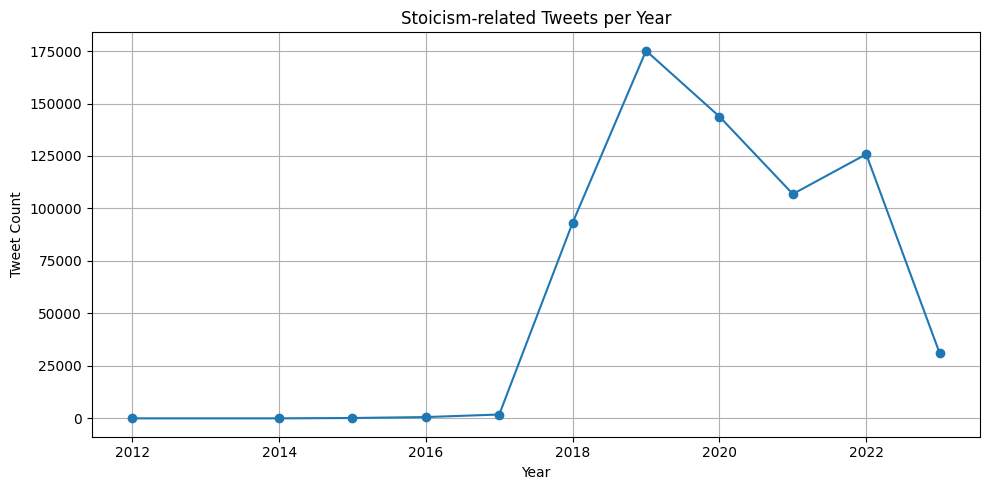

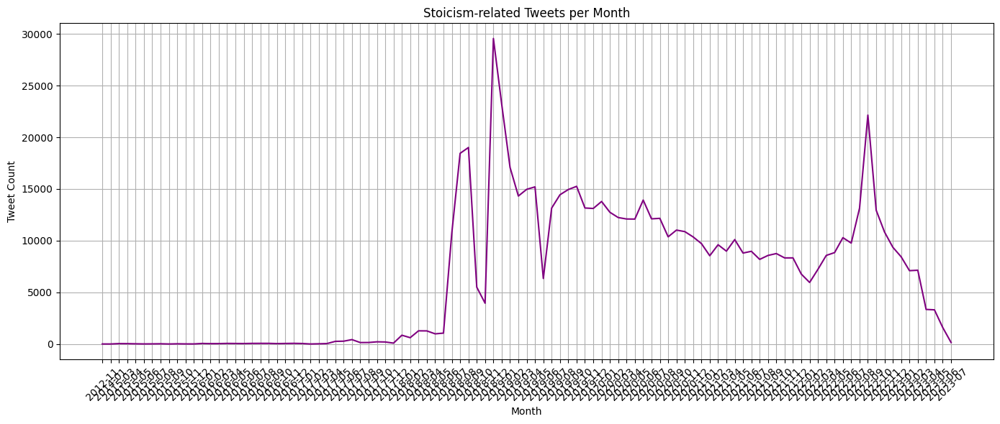

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure 'date' column is in datetime format
df_stoic["date"] = pd.to_datetime(df_stoic["date"], errors="coerce")

# Drop rows with invalid or missing dates
df_stoic = df_stoic.dropna(subset=["date"])

# Create temporal aggregation columns
df_stoic["year"] = df_stoic["date"].dt.year
df_stoic["month"] = df_stoic["date"].dt.to_period("M").astype(str)

# Tweet count by year
tweets_by_year = df_stoic.groupby("year").size().reset_index(name="tweet_count")

# Tweet count by month
tweets_by_month = df_stoic.groupby("month").size().reset_index(name="tweet_count")

# Plot — yearly trend
plt.figure(figsize=(10, 5))
plt.plot(tweets_by_year["year"], tweets_by_year["tweet_count"], marker="o")
plt.title("Stoicism-related Tweets per Year")
plt.xlabel("Year")
plt.ylabel("Tweet Count")
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot — monthly trend
plt.figure(figsize=(14, 6))
plt.plot(tweets_by_month["month"], tweets_by_month["tweet_count"], color="purple")
plt.title("Stoicism-related Tweets per Month")
plt.xlabel("Month")
plt.ylabel("Tweet Count")
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
##💻Block 2C — Root Word Frequency

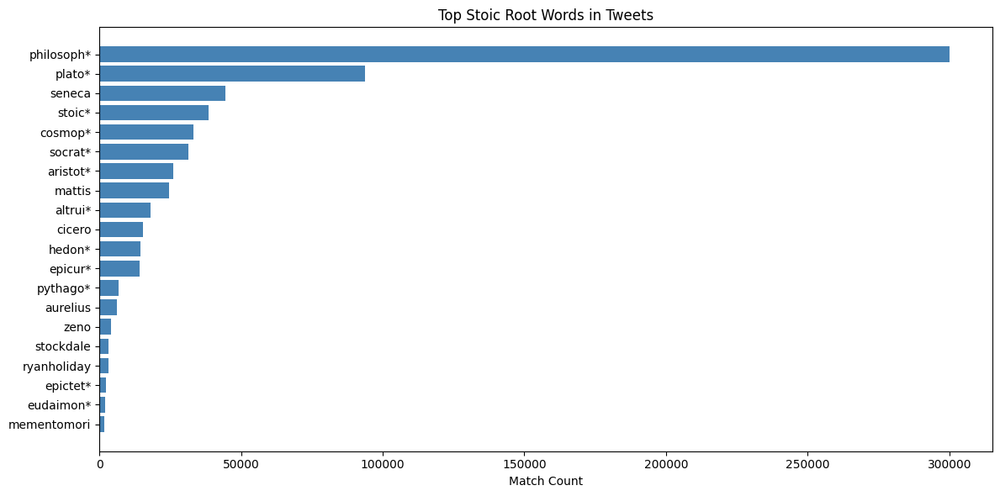

In [ ]:
import re
import pandas as pd
import unidecode
from collections import Counter
import matplotlib.pyplot as plt

# Root words from Devika's list
root_words = [
    "altrui*", "aristot*", "cosmop*", "epictet*", "epicur*", "eudaimon*", "hedon*", "philosoph*",
    "plato*", "pythago*", "socrat*", "stioc*", "stoic*", "amorfati", "aurelius", "chrysippus",
    "cicero", "cleanthes", "commongood", "dichotomyofcontrol", "diogenes", "hadot", "humandignity",
    "humanworth", "jordanpeterson", "mattis", "mementomori", "moralinjury", "moralaction",
    "moralprogress", "moralpurpose", "musoniusrufus", "nussbaum", "peripatetic", "pigliucci",
    "ryanholiday", "seneca", "stockdale", "timferriss", "zeno"
]

# Normalize and prepare regex patterns
compiled_patterns = {}
for word in root_words:
    if word.endswith("*"):
        base = re.escape(word[:-1])
        pattern = re.compile(rf"\b{base}\w*\b", re.IGNORECASE)
    else:
        pattern = re.compile(rf"\b{re.escape(word)}\b", re.IGNORECASE)
    compiled_patterns[word] = pattern

# Normalize text: lowercase + remove accents
df_stoic["text_norm"] = df_stoic["text"].astype(str).str.lower().map(unidecode.unidecode)

# Count matches
match_counts = Counter()
for text in df_stoic["text_norm"]:
    for root, pattern in compiled_patterns.items():
        if pattern.search(text):
            match_counts[root] += 1

# Convert to DataFrame
df_counts = pd.DataFrame(match_counts.items(), columns=["root_word", "count"]).sort_values(by="count", ascending=False)

# Plot top 20
top_n = 20
plt.figure(figsize=(12, 6))
plt.barh(df_counts.head(top_n)["root_word"][::-1], df_counts.head(top_n)["count"][::-1], color="steelblue")
plt.title("Top Stoic Root Words in Tweets")
plt.xlabel("Match Count")
plt.tight_layout()
plt.show()

# Optional: export
# df_counts.to_csv("root_word_frequency.csv", index=False)

In [ ]:
##💻Block 2D — Most Active Users

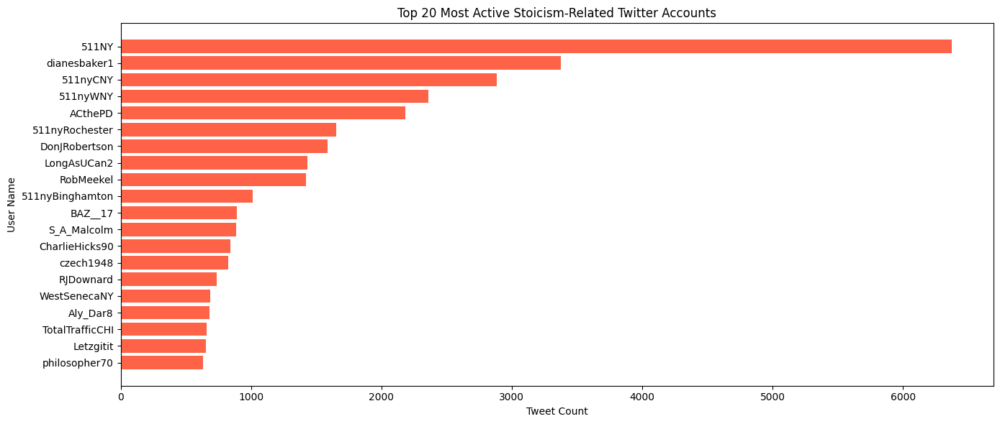

In [ ]:
# Count tweets by user
user_counts = df_stoic.groupby("user_name").size().reset_index(name="tweet_count")

# Sort by tweet count (descending order)
user_counts_sorted = user_counts.sort_values(by="tweet_count", ascending=False)

# Top 20 most active users
top_20_users = user_counts_sorted.head(20)

# Plot the top 20 users
plt.figure(figsize=(14, 6))
plt.barh(top_20_users["user_name"][::-1], top_20_users["tweet_count"][::-1], color="tomato")
plt.title("Top 20 Most Active Stoicism-Related Twitter Accounts")
plt.xlabel("Tweet Count")
plt.ylabel("User Name")
plt.tight_layout()
plt.show()

# Optional: Export the user data
# user_counts_sorted.to_csv("user_activity_counts.csv", index=False)

In [ ]:
##💻 Code: Message Frequency by Country

In [ ]:
import pandas as pd
from geopy.distance import geodesic

# Load the country coordinates CSV from GitHub
url = "https://gist.githubusercontent.com/metal3d/5b925077e66194551df949de64e910f6/raw/c5f20a037409d96958553e2eb6b8251265c6fd63/country-coord.csv"
country_coords = pd.read_csv(url)

# Function to extract country from place (using raw if place is missing)
def extract_country_from_place_or_coords(row):
    # Check if place data exists
    if pd.notna(row['place']):
        # Use the place data if available
        place = row['place'].lower()

        # A list of known country names to check against
        known_countries = [
            "united states", "canada", "brazil", "germany", "france", "spain", "italy", "united kingdom",
            "australia", "india", "south africa", "mexico", "japan", "china", "argentina", "colombia", "japan"
            # Add more countries as needed
        ]

        # Search for the country in the place string
        for country in known_countries:
            if country in place:
                return country.title()  # Return the country name with title case
        return "Unknown"  # If no match is found in the place, return "Unknown"

    # If place is missing, use coordinates (latitude, longitude)
    lat, lon = row['latitude'], row['longitude']
    return get_country_from_coords(lat, lon)

# Function to map a tweet's coordinates to a country using raw data (if no place is available)
def get_country_from_coords(tweet_lat, tweet_lon):
    if pd.isna(tweet_lat) or pd.isna(tweet_lon):  # Check for NaN values
        return "Unknown"

    closest_country = None
    min_distance = float('inf')  # Initialize with a very large distance

    for _, row in country_coords.iterrows():
        country_lat = row['Latitude (average)']  # Use correct column names
        country_lon = row['Longitude (average)']  # Use correct column names
        country_name = row['Country']

        # Calculate distance from tweet's coordinates to country coordinates
        distance = geodesic((tweet_lat, tweet_lon), (country_lat, country_lon)).km

        # If it's the closest, update the country and minimum distance
        if distance < min_distance:
            closest_country = country_name
            min_distance = distance

    return closest_country

# Apply the function to the DataFrame to get countries
df_stoic['country'] = df_stoic.apply(extract_country_from_place_or_coords, axis=1)

# Count the number of tweets per country
country_counts = df_stoic['country'].value_counts().reset_index()
country_counts.columns = ['Country', 'Tweet Count']

# Display the top countries
print("Top countries by tweet count:")
print(country_counts.head(10))

# Optionally, export to CSV
country_counts.to_csv("tweets_by_country.csv", index=False)

Top countries by tweet count:
          Country  Tweet Count
0         Unknown       627099
1           India        23419
2    South Africa        10732
3          France         3706
4       Australia         3256
5         Germany         2309
6  United Kingdom         2157
7           Spain         1559
8        Colombia         1038
9       Argentina          776


In [ ]:
import pandas as pd
from geopy.distance import geodesic
import time

# URL do arquivo raw com as coordenadas dos países no GitHub
url = "https://gist.githubusercontent.com/metal3d/5b925077e66194551df949de64e910f6/raw/c5f20a037409d96958553e2eb6b8251265c6fd63/country-coord.csv"
country_coords = pd.read_csv(url)

# Check the columns to ensure we're using the correct names
print("Columns in the country coordinates data:")
print(country_coords.columns)  # This will show the actual column names

# Function to get the country based on coordinates (latitude, longitude) from GitHub raw file
def get_country_from_coords(lat, lon):
    if pd.isna(lat) or pd.isna(lon):  # Check for NaN values in coordinates
        return "Unknown"

    closest_country = None
    min_distance = float('inf')  # Initialize with a very large distance

    for _, row in country_coords.iterrows():
        country_lat = row['Latitude (average)']  # Use correct column names
        country_lon = row['Longitude (average)']  # Use correct column names
        country_name = row['Country']

        # Calculate distance from tweet's coordinates to country coordinates
        distance = geodesic((lat, lon), (country_lat, country_lon)).km

        # If it's the closest, update the country and minimum distance
        if distance < min_distance:
            closest_country = country_name
            min_distance = distance

    return closest_country

# Filter the tweets with 'Unknown' country
unknown_tweets = df_stoic[df_stoic['country'] == "Unknown"]

# Process the entire dataset by applying the function to 'Unknown' tweets
unknown_tweets['country'] = unknown_tweets.apply(lambda row: get_country_from_coords(row['latitude'], row['longitude']), axis=1)

# Count the number of tweets per country in the "Unknown" category after resolving with coordinates
country_counts_unknown = unknown_tweets['country'].value_counts().reset_index()
country_counts_unknown.columns = ['Country', 'Tweet Count']

# Display the resolved countries for 'Unknown' tweets
print("Resolved countries for all 'Unknown' tweets:")
print(country_counts_unknown)

# Optionally, export the resolved 'Unknown' tweets
unknown_tweets.to_csv("resolved_unknown_tweets_full.csv", index=False)

Columns in the country coordinates data:
Index(['Country', 'Alpha-2 code', 'Alpha-3 code', 'Numeric code',
       'Latitude (average)', 'Longitude (average)'],
      dtype='object')
Resolved countries for all 'Unknown' tweets:
                    Country  Tweet Count
0             United States       235643
1                   Bermuda        95598
2            United Kingdom        32874
3                   Bahamas        31152
4                  Guernsey        26722
..                      ...          ...
228                 Vanuatu            2
229  Svalbard and Jan Mayen            1
230              Montserrat            1
231                   Palau            1
232            Cook Islands            1

[233 rows x 2 columns]


In [ ]:
##💻 Code for Temporal Analysis (Tweet Count over Time)

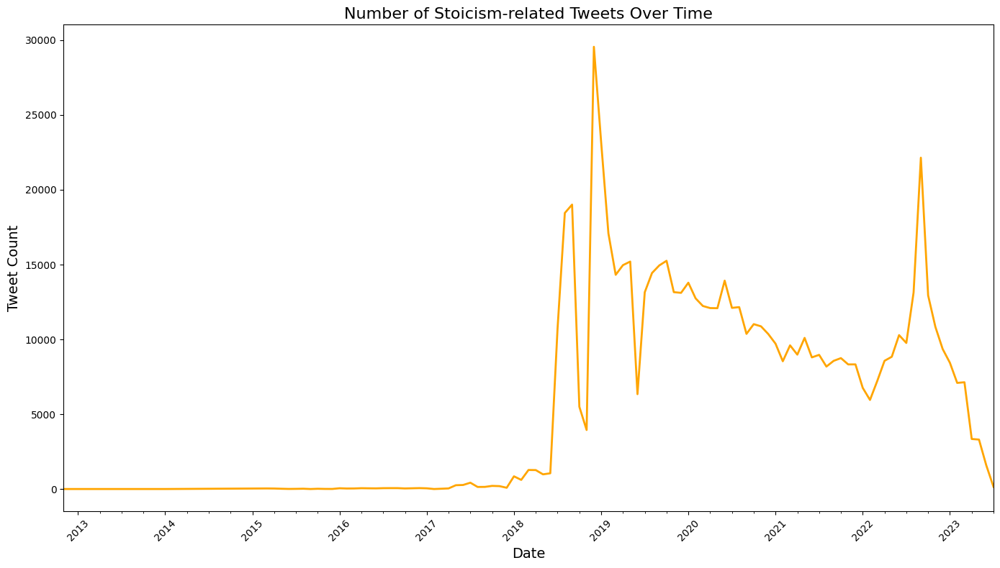

In [ ]:
import matplotlib.pyplot as plt

# Ensure 'date' column is in datetime format
df_stoic['date'] = pd.to_datetime(df_stoic['date'])

# Group by year and month to get tweet count over time
df_stoic['year_month'] = df_stoic['date'].dt.to_period('M')  # Group by Year-Month
tweets_per_month = df_stoic.groupby('year_month').size()

# Plot the number of tweets over time (monthly)
plt.figure(figsize=(14, 8))
tweets_per_month.plot(kind='line', color='orange', linewidth=2)
plt.title('Number of Stoicism-related Tweets Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Tweet Count', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
##💻 Code for Geographical Visualization (Tweets on a Map)

In [ ]:
# Ensure that latitude and longitude are numeric
df_stoic['latitude'] = pd.to_numeric(df_stoic['latitude'], errors='coerce')
df_stoic['longitude'] = pd.to_numeric(df_stoic['longitude'], errors='coerce')

# Remove rows with missing (NaN) latitude/longitude
df_stoic_clean = df_stoic.dropna(subset=['latitude', 'longitude'])

# Now, calculate the mean latitude and longitude for the map centering
mean_lat = df_stoic_clean['latitude'].mean()
mean_lon = df_stoic_clean['longitude'].mean()

# Create a base map centered around the mean latitude and longitude
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=2)

# Filter out rows with missing latitude/longitude
valid_tweets = df_stoic_clean.dropna(subset=['latitude', 'longitude'])

# Create a list of coordinates for the heatmap
heat_data = valid_tweets[['latitude', 'longitude']].values.tolist()

# Add a heatmap layer
HeatMap(heat_data).add_to(m)

# Save the map as an HTML file to be viewed in a browser
m.save("tweets_heatmap.html")

# Optionally, display the map inline (if running in a Jupyter notebook)
m

  Sentiment  Tweet Count
0  Positive       331226
1   Neutral       236658
2  Negative       110614


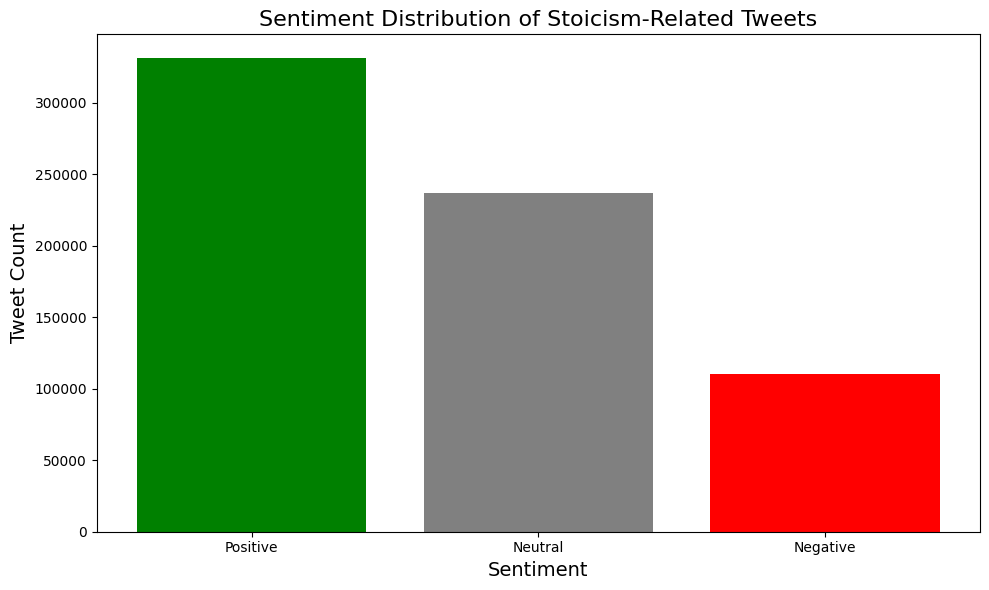

In [ ]:
from textblob import TextBlob

# Function to get sentiment polarity
def get_sentiment(text):
    # Create a TextBlob object and calculate the sentiment polarity
    blob = TextBlob(text)
    return blob.sentiment.polarity

# Apply sentiment analysis to the 'text' column
df_stoic['sentiment'] = df_stoic['text'].apply(get_sentiment)

# Classify the sentiment as Positive, Neutral, or Negative based on the polarity score
df_stoic['sentiment_label'] = df_stoic['sentiment'].apply(
    lambda x: 'Positive' if x > 0 else ('Negative' if x < 0 else 'Neutral')
)

# Count sentiment occurrences
sentiment_counts = df_stoic['sentiment_label'].value_counts().reset_index()
sentiment_counts.columns = ['Sentiment', 'Tweet Count']

# Display sentiment counts
print(sentiment_counts)

# Optional: Visualize the sentiment distribution
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.bar(sentiment_counts['Sentiment'], sentiment_counts['Tweet Count'], color=['green', 'gray', 'red'])
plt.title('Sentiment Distribution of Stoicism-Related Tweets', fontsize=16)
plt.xlabel('Sentiment', fontsize=14)
plt.ylabel('Tweet Count', fontsize=14)
plt.tight_layout()
plt.show()

# Optionally, export sentiment results
df_stoic[['date', 'text', 'sentiment', 'sentiment_label']].to_csv("tweets_sentiment.csv", index=False)

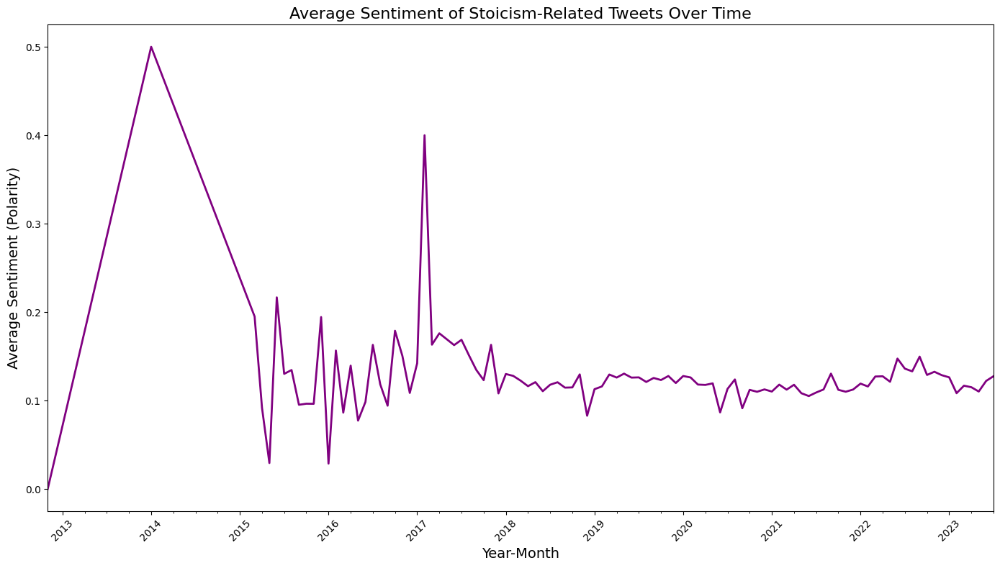

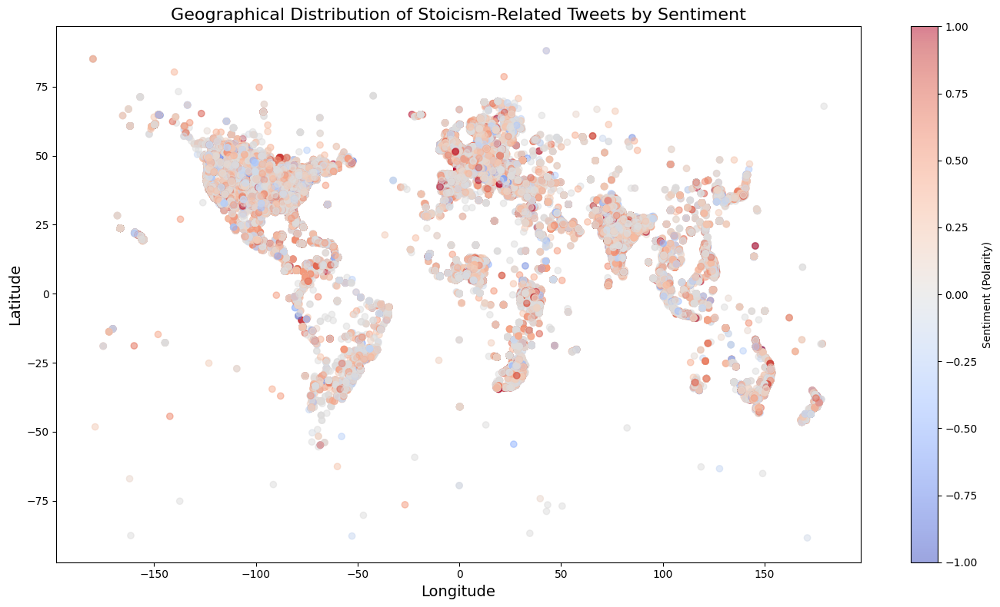

In [ ]:
import matplotlib.pyplot as plt

# Group by year and month, calculate mean sentiment by month
df_stoic['year_month'] = df_stoic['date'].dt.to_period('M')
monthly_sentiment = df_stoic.groupby('year_month')['sentiment'].mean()

# Plot the sentiment trend over time
plt.figure(figsize=(14, 8))
monthly_sentiment.plot(kind='line', color='purple', linewidth=2)
plt.title('Average Sentiment of Stoicism-Related Tweets Over Time', fontsize=16)
plt.xlabel('Year-Month', fontsize=14)
plt.ylabel('Average Sentiment (Polarity)', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Optional: Plot sentiment against geographical coordinates (latitude and longitude)
plt.figure(figsize=(14, 8))
plt.scatter(df_stoic['longitude'], df_stoic['latitude'], c=df_stoic['sentiment'], cmap='coolwarm', alpha=0.5)
plt.colorbar(label='Sentiment (Polarity)')
plt.title('Geographical Distribution of Stoicism-Related Tweets by Sentiment', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)
plt.tight_layout()
plt.show()

In [ ]:
##Correlation between volume of tweets and sentiment

<Figure size 1400x800 with 0 Axes>

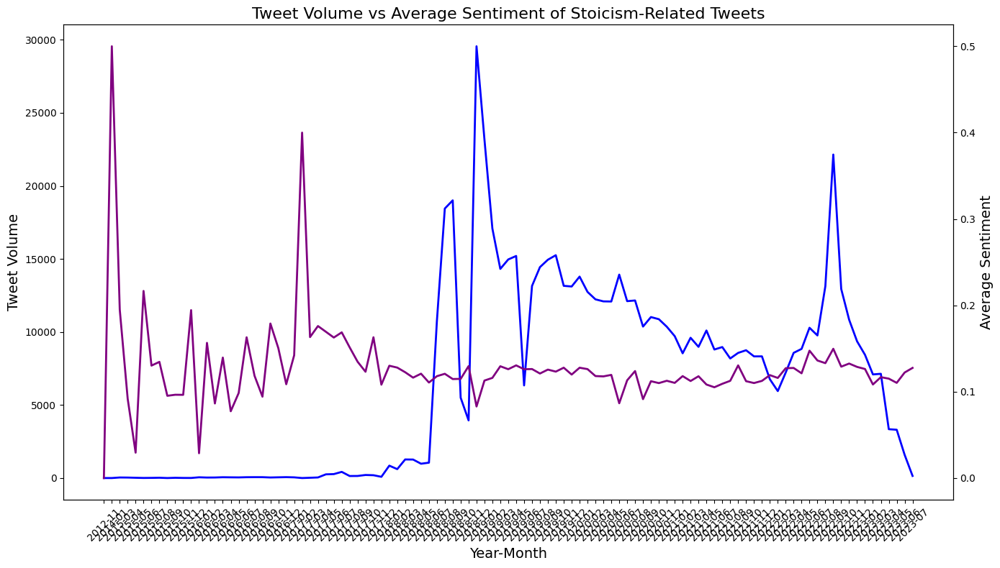

Correlation between tweet volume and average sentiment: -0.18
P-value: 0.07128
The correlation is not statistically significant.


In [ ]:
import scipy.stats as stats

# Group by year and month, calculate tweet volume and average sentiment
monthly_data = df_stoic.groupby('year_month').agg(
    tweet_count=('sentiment', 'size'),
    average_sentiment=('sentiment', 'mean')
).reset_index()

# Plot Volume of Tweets vs Average Sentiment
plt.figure(figsize=(14, 8))

# Create a dual-axis plot
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot the tweet volume
ax1.set_xlabel('Year-Month', fontsize=14)
ax1.set_ylabel('Tweet Volume', fontsize=14)
ax1.plot(monthly_data['year_month'].astype(str), monthly_data['tweet_count'], color='blue', label='Tweet Volume', linewidth=2)
ax1.tick_params(axis='x', rotation=45)

# Create a second y-axis for sentiment
ax2 = ax1.twinx()
ax2.set_ylabel('Average Sentiment', fontsize=14)
ax2.plot(monthly_data['year_month'].astype(str), monthly_data['average_sentiment'], color='purple', label='Average Sentiment', linewidth=2)

# Title and layout adjustments
plt.title('Tweet Volume vs Average Sentiment of Stoicism-Related Tweets', fontsize=16)
fig.tight_layout()

# Show the plot
plt.show()

# Calculate correlation and p-value between tweet volume and average sentiment
corr, p_value = stats.pearsonr(monthly_data['tweet_count'], monthly_data['average_sentiment'])
print(f"Correlation between tweet volume and average sentiment: {corr:.2f}")
print(f"P-value: {p_value:.5f}")

# Interpretation of p-value
if p_value < 0.05:
    print("The correlation is statistically significant.")
else:
    print("The correlation is not statistically significant.")

In [ ]:
# Verifique novamente os tweets "Unknown"
unknown_tweets = df_stoic[df_stoic['country'] == "Unknown"]

# Verifique quantos tweets ainda estão com "Unknown"
print(f"Number of 'Unknown' tweets before update: {unknown_tweets.shape[0]}")

# Process the 'Unknown' tweets and update their country by coordinates
unknown_tweets['country'] = unknown_tweets.apply(lambda row: get_country_from_coords(row['latitude'], row['longitude']), axis=1)

# Check if the "Unknown" tweets are now updated
print(f"Number of 'Unknown' tweets after update: {unknown_tweets.shape[0]}")

# Update the original dataframe with the resolved countries
df_stoic.update(unknown_tweets)

# Recalculate tweet counts and sentiment by country
country_data = df_stoic.groupby('country').agg(
    tweet_count=('sentiment', 'size'),
    average_sentiment=('sentiment', 'mean')
).reset_index()

# Sort the data by tweet count in descending order
country_data_sorted = country_data.sort_values(by="tweet_count", ascending=False)

# Display the top countries
print(country_data_sorted.head(20))

# Optionally, export the table to CSV for the paper
country_data_sorted.to_csv("tweets_by_country_for_paper_updated.csv", index=False)

Number of 'Unknown' tweets before update: 627099
